In [1]:
# reloads all sourced file before running called functions; avoids having to restart kernel for every modification
%load_ext autoreload
%autoreload 2

%matplotlib inline

In [2]:
PATH = ''

In [3]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
from matplotlib.patches import Polygon
from scipy.spatial import ConvexHull
from matplotlib.colors import to_rgba
import matplotlib.pyplot as plt
import seaborn as sns
from concave_hull import ConcaveHull
sns.set_style('whitegrid')

import pickle
import os
import sys
sys.path.append('../')
from miscellanea import np_to_pd, Simulator, barplot_diagnostics, coverage_diagnostics_branch, diagnostics_2D, hpd_region
from tqdm import tqdm

In [4]:
from qr_algorithms.complete_list import classifier_cde_dict
from qr_utils.qr_functions import train_qr_algo
import torch

In [5]:
from pyro import distributions as pdist
from sbi.inference.base import infer, simulate_for_sbi
from sbi.simulators.simutils import simulate_in_batches
from sbi.utils import MultipleIndependent
import sbibm
from sbibm.algorithms import snpe
from sbibm.visualisation import fig_posterior
sbibm.get_available_tasks()

['lotka_volterra',
 'gaussian_mixture',
 'gaussian_linear_uniform',
 'two_moons',
 'bernoulli_glm',
 'sir',
 'gaussian_linear',
 'slcp',
 'slcp_distractors',
 'bernoulli_glm_raw']

In [6]:
B = 100_000
B_PRIME = 10_000
B_DOUBLE_PRIME = 10_000
N_SAMPLES_POSTERIOR = 50_000

## Task

In [7]:
task = sbibm.get_task("gaussian_mixture")

#### Generate data

In [8]:
prior_dist = MultipleIndependent(dists=[pdist.Uniform(low=task.prior_params['low'][0]*torch.ones(1), high=task.prior_params['high'][0]*torch.ones(1)),
                                        pdist.Uniform(low=task.prior_params['low'][0]*torch.ones(1), high=task.prior_params['high'][0]*torch.ones(1))])
prior = task.get_prior()
simulator = task.get_simulator()

###### True posterior

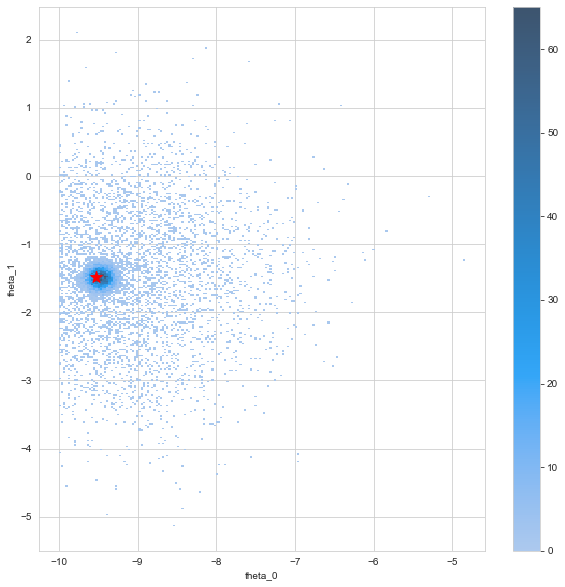

In [24]:
t_post_obs = 1
r_post = task.get_reference_posterior_samples(num_observation=t_post_obs)

plt.figure(figsize=(10, 10))
sns.histplot(data=np_to_pd(r_post, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', cbar=True, kde=False)
plt.scatter(x=task.get_true_parameters(num_observation=t_post_obs)[0][0], y=task.get_true_parameters(num_observation=t_post_obs)[0][1], marker='*', color='red', s=150)

###### Check simulated data

Running 100000 simulations.:   0%|          | 0/100000 [00:00<?, ?it/s]

<AxesSubplot:xlabel='x_0', ylabel='x_1'>

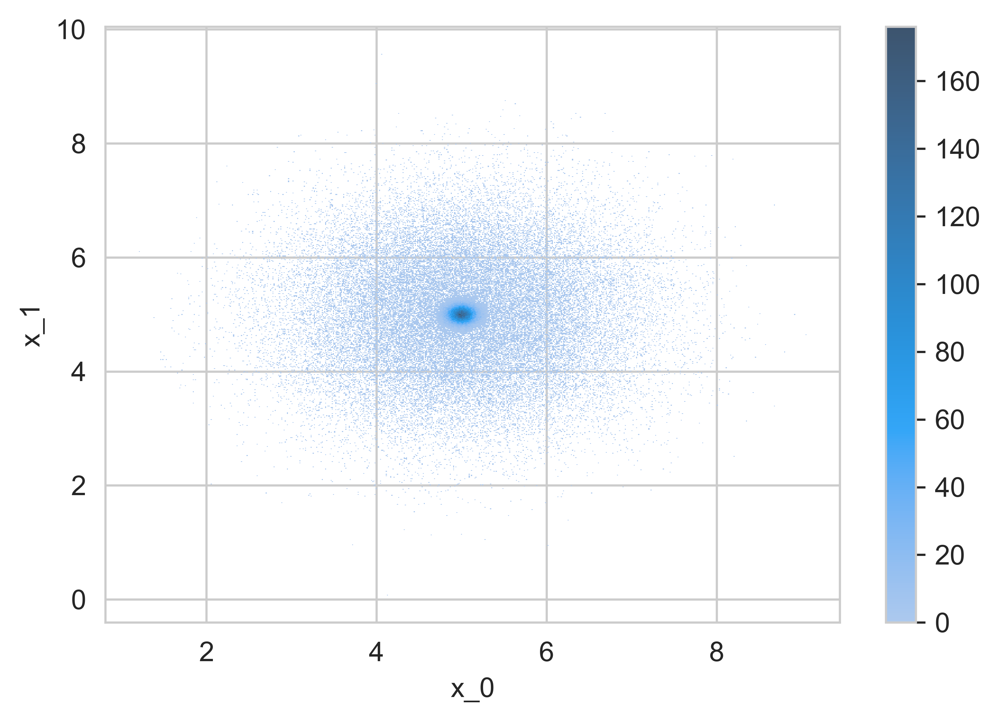

In [87]:
sns.histplot(data=np_to_pd(simulate_in_batches(simulator=simulator, theta=torch.Tensor([[5, 5]]).repeat_interleave(100_000, dim=0)).numpy(), ['x_0', 'x_1']), 
             x='x_0', y='x_1', cbar=True, kde=False)

###### B' simulations

Running 10000 simulations.:   0%|          | 0/10000 [00:00<?, ?it/s]

torch.Size([10000, 2]) torch.Size([10000, 2])


<AxesSubplot:xlabel='x_0', ylabel='x_1'>

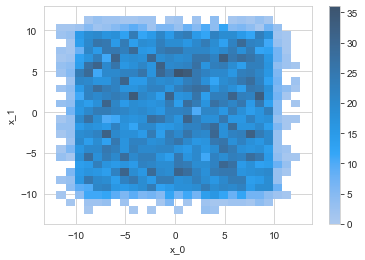

In [9]:
b_prime_theta, b_prime_x = simulate_for_sbi(simulator=simulator, proposal=prior_dist, num_simulations=B_PRIME)
print(b_prime_theta.shape, b_prime_x.shape, flush=True)
sns.histplot(data=np_to_pd(b_prime_x, ['x_0', 'x_1']), x='x_0', y='x_1', cbar=True)

###### B'' simulations

Running 10000 simulations.:   0%|          | 0/10000 [00:00<?, ?it/s]

torch.Size([10000, 2]) torch.Size([10000, 2])


<AxesSubplot:xlabel='x_0', ylabel='x_1'>

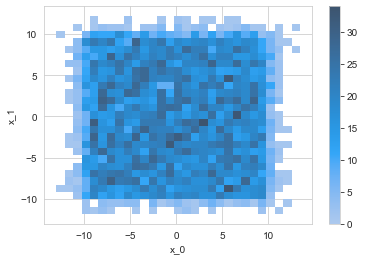

In [10]:
b_double_prime_theta, b_double_prime_x = simulate_for_sbi(simulator=simulator, proposal=prior_dist, num_simulations=B_DOUBLE_PRIME)
print(b_double_prime_theta.shape, b_double_prime_x.shape, flush=True)
sns.histplot(data=np_to_pd(b_double_prime_x, ['x_0', 'x_1']), x='x_0', y='x_1', cbar=True)

## Train NPE

In [11]:
posterior = infer(simulator=simulator, prior=prior_dist, method='SNPE', num_simulations=B)

Running 100000 simulations.:   0%|          | 0/100000 [00:00<?, ?it/s]

Neural network successfully converged after 70 epochs.


Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

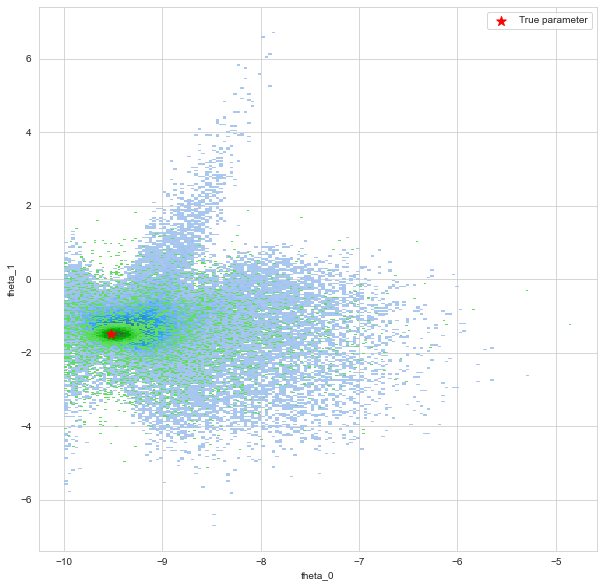

In [12]:
posterior_samples_obs1 = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=task.get_observation(num_observation=1))

# estimated
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
estimated_hist = sns.histplot(data=np_to_pd(posterior_samples_obs1, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', cbar=False, kde=False, ax=ax, stat='density')
estimated_hist.legend(labels=['Estimated Posterior'], loc='upper right')
plt.scatter(x=task.get_true_parameters(num_observation=1)[0][0], y=task.get_true_parameters(num_observation=1)[0][1], marker='*', color='red', s=100, label='True parameter', zorder=2)

# true
r_post = task.get_reference_posterior_samples(num_observation=1)
true_hist = sns.histplot(data=np_to_pd(r_post, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', cbar=False, kde=False, color='green', label='True Posterior', ax=ax, stat='density')
true_hist.legend(labels=['True Posterior'], loc='upper right')
ax.legend()
plt.show()

## Quantile Regression

In [13]:
posterior_means_qr = []
posterior_vars_qr = []
for i in tqdm(range(B_PRIME)):
    posterior_samples_qr = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=b_prime_x[i, :])
    posterior_means_qr.append(torch.mean(posterior_samples_qr, dim=0))
    posterior_vars_qr.append(torch.cov(torch.transpose(posterior_samples_qr, 0, 1)))

  0%|                                                                                                                                                                                                            | 0/10000 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                                                                    | 1/10000 [00:00<43:46,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                                                                    | 2/10000 [00:00<43:43,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                                                                    | 3/10000 [00:00<43:03,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                                                                    | 4/10000 [00:01<43:09,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                                                                    | 5/10000 [00:01<42:57,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|                                                                                                                                                                                                    | 6/10000 [00:01<42:51,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                                                                   | 7/10000 [00:01<42:40,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                                                                   | 8/10000 [00:02<42:20,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                                                                   | 9/10000 [00:02<42:30,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                                                                  | 10/10000 [00:02<42:22,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                                                                  | 11/10000 [00:02<42:24,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▏                                                                                                                                                                                                  | 12/10000 [00:03<42:15,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                                                                  | 13/10000 [00:03<42:14,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                                                                  | 14/10000 [00:03<41:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                                                                  | 15/10000 [00:03<41:53,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                                                                  | 16/10000 [00:04<41:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                                                                  | 17/10000 [00:04<43:10,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                                                                  | 18/10000 [00:04<44:49,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▎                                                                                                                                                                                                  | 19/10000 [00:04<44:01,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                                                                  | 20/10000 [00:05<43:33,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                                                                  | 21/10000 [00:05<43:09,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                                                                  | 22/10000 [00:05<42:45,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                                                                  | 23/10000 [00:05<42:30,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                                                                  | 24/10000 [00:06<42:19,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▍                                                                                                                                                                                                  | 25/10000 [00:06<42:21,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                                                                                  | 26/10000 [00:06<42:16,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                                                                                  | 27/10000 [00:06<41:54,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                                                                                  | 28/10000 [00:07<41:46,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                                                                                  | 29/10000 [00:07<41:46,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                                                                                  | 30/10000 [00:07<41:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                                                                                  | 31/10000 [00:07<41:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▌                                                                                                                                                                                                  | 32/10000 [00:08<41:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                                                                                  | 33/10000 [00:08<41:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                                                                                  | 34/10000 [00:08<41:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                                                                                  | 35/10000 [00:08<41:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                                                                                  | 36/10000 [00:09<41:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                                                                                  | 37/10000 [00:09<41:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▋                                                                                                                                                                                                  | 38/10000 [00:09<41:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▊                                                                                                                                                                                                  | 39/10000 [00:09<41:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▊                                                                                                                                                                                                  | 40/10000 [00:10<41:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▊                                                                                                                                                                                                  | 41/10000 [00:10<41:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▊                                                                                                                                                                                                  | 42/10000 [00:10<41:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▊                                                                                                                                                                                                  | 43/10000 [00:10<41:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▊                                                                                                                                                                                                  | 44/10000 [00:11<41:13,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▉                                                                                                                                                                                                  | 45/10000 [00:11<41:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▉                                                                                                                                                                                                  | 46/10000 [00:11<41:26,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▉                                                                                                                                                                                                  | 47/10000 [00:11<41:37,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▉                                                                                                                                                                                                  | 48/10000 [00:12<41:29,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▉                                                                                                                                                                                                  | 49/10000 [00:12<42:50,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  0%|▉                                                                                                                                                                                                  | 50/10000 [00:12<43:48,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|▉                                                                                                                                                                                                  | 51/10000 [00:12<44:08,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                                                                                  | 52/10000 [00:13<44:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                                                                                  | 53/10000 [00:13<44:08,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                                                                                  | 54/10000 [00:13<43:22,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                                                                                  | 55/10000 [00:14<42:40,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                                                                                  | 56/10000 [00:14<42:56,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█                                                                                                                                                                                                  | 57/10000 [00:14<42:33,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                                                                                 | 58/10000 [00:14<42:17,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                                                                                 | 59/10000 [00:15<42:22,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                                                                                 | 60/10000 [00:15<43:27,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                                                                                 | 61/10000 [00:15<43:21,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                                                                                 | 62/10000 [00:15<42:54,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                                                                                 | 63/10000 [00:16<42:16,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▏                                                                                                                                                                                                 | 64/10000 [00:16<41:55,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                                                                                 | 65/10000 [00:16<41:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                                                                                 | 66/10000 [00:16<41:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                                                                                 | 67/10000 [00:17<41:10,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                                                                                 | 68/10000 [00:17<41:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                                                                                 | 69/10000 [00:17<41:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▎                                                                                                                                                                                                 | 70/10000 [00:17<41:14,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                                                                                 | 71/10000 [00:18<41:14,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                                                                                 | 72/10000 [00:18<41:07,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                                                                                 | 73/10000 [00:18<41:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                                                                                 | 74/10000 [00:18<43:15,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                                                                                 | 75/10000 [00:19<42:32,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▍                                                                                                                                                                                                 | 76/10000 [00:19<42:09,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                                                                                 | 77/10000 [00:19<41:50,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                                                                                 | 78/10000 [00:19<41:59,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                                                                                 | 79/10000 [00:20<41:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                                                                                 | 80/10000 [00:20<41:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                                                                                 | 81/10000 [00:20<41:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                                                                                 | 82/10000 [00:20<44:47,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▌                                                                                                                                                                                                 | 83/10000 [00:21<45:51,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                                                                                 | 84/10000 [00:21<45:31,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                                                                                 | 85/10000 [00:21<45:12,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                                                                                 | 86/10000 [00:22<47:10,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                                                                                 | 87/10000 [00:22<45:34,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                                                                                 | 88/10000 [00:22<44:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▋                                                                                                                                                                                                 | 89/10000 [00:22<43:18,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                                                                                 | 90/10000 [00:23<43:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                                                                                 | 91/10000 [00:23<43:25,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                                                                                 | 92/10000 [00:23<42:53,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                                                                                 | 93/10000 [00:23<42:31,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                                                                                 | 94/10000 [00:24<42:13,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                                                                                 | 95/10000 [00:24<43:20,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▊                                                                                                                                                                                                 | 96/10000 [00:24<43:14,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                                                                                 | 97/10000 [00:24<45:54,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                                                                                 | 98/10000 [00:25<45:17,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                                                                                 | 99/10000 [00:25<44:35,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                                                                                | 100/10000 [00:25<44:11,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                                                                                | 101/10000 [00:26<43:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                                                                                | 102/10000 [00:26<43:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|█▉                                                                                                                                                                                                | 103/10000 [00:26<43:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                                                                                | 104/10000 [00:26<43:23,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                                                                                | 105/10000 [00:27<43:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                                                                                | 106/10000 [00:27<44:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                                                                                | 107/10000 [00:27<43:28,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                                                                                | 108/10000 [00:27<42:55,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██                                                                                                                                                                                                | 109/10000 [00:28<43:15,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                                                                               | 110/10000 [00:28<42:55,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                                                                               | 111/10000 [00:28<43:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                                                                               | 112/10000 [00:28<43:16,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                                                                               | 113/10000 [00:29<42:45,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                                                                               | 114/10000 [00:29<42:16,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▏                                                                                                                                                                                               | 115/10000 [00:29<41:54,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▎                                                                                                                                                                                               | 116/10000 [00:29<41:42,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▎                                                                                                                                                                                               | 117/10000 [00:30<41:43,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▎                                                                                                                                                                                               | 118/10000 [00:30<41:39,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▎                                                                                                                                                                                               | 119/10000 [00:30<41:42,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▎                                                                                                                                                                                               | 120/10000 [00:30<41:36,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▎                                                                                                                                                                                               | 121/10000 [00:31<41:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▎                                                                                                                                                                                               | 122/10000 [00:31<41:16,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▍                                                                                                                                                                                               | 123/10000 [00:31<41:14,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▍                                                                                                                                                                                               | 124/10000 [00:31<41:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▍                                                                                                                                                                                               | 125/10000 [00:32<44:59,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▍                                                                                                                                                                                               | 126/10000 [00:32<43:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▍                                                                                                                                                                                               | 127/10000 [00:32<43:10,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▍                                                                                                                                                                                               | 128/10000 [00:32<42:36,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▌                                                                                                                                                                                               | 129/10000 [00:33<42:01,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▌                                                                                                                                                                                               | 130/10000 [00:33<41:42,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▌                                                                                                                                                                                               | 131/10000 [00:33<41:27,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▌                                                                                                                                                                                               | 132/10000 [00:33<41:17,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▌                                                                                                                                                                                               | 133/10000 [00:34<41:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▌                                                                                                                                                                                               | 134/10000 [00:34<41:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▌                                                                                                                                                                                               | 135/10000 [00:34<41:08,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▋                                                                                                                                                                                               | 136/10000 [00:34<41:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▋                                                                                                                                                                                               | 137/10000 [00:35<40:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▋                                                                                                                                                                                               | 138/10000 [00:35<40:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▋                                                                                                                                                                                               | 139/10000 [00:35<40:59,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▋                                                                                                                                                                                               | 140/10000 [00:36<42:54,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▋                                                                                                                                                                                               | 141/10000 [00:36<42:31,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▊                                                                                                                                                                                               | 142/10000 [00:36<42:09,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▊                                                                                                                                                                                               | 143/10000 [00:36<42:00,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▊                                                                                                                                                                                               | 144/10000 [00:37<41:48,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▊                                                                                                                                                                                               | 145/10000 [00:37<41:38,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▊                                                                                                                                                                                               | 146/10000 [00:37<41:39,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▊                                                                                                                                                                                               | 147/10000 [00:37<41:29,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▊                                                                                                                                                                                               | 148/10000 [00:38<41:28,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  1%|██▉                                                                                                                                                                                               | 149/10000 [00:38<41:27,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                                                                               | 150/10000 [00:38<43:24,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                                                                               | 151/10000 [00:38<42:47,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                                                                               | 152/10000 [00:39<42:20,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                                                                               | 153/10000 [00:39<42:06,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|██▉                                                                                                                                                                                               | 154/10000 [00:39<41:59,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                                                                               | 155/10000 [00:39<41:48,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                                                                               | 156/10000 [00:40<41:33,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                                                                               | 157/10000 [00:40<41:27,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                                                                               | 158/10000 [00:40<41:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                                                                               | 159/10000 [00:40<41:16,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                                                                               | 160/10000 [00:41<41:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███                                                                                                                                                                                               | 161/10000 [00:41<41:12,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                                                                              | 162/10000 [00:41<41:07,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                                                                              | 163/10000 [00:41<41:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                                                                              | 164/10000 [00:42<40:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                                                                              | 165/10000 [00:42<40:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                                                                              | 166/10000 [00:42<40:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▏                                                                                                                                                                                              | 167/10000 [00:42<40:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                                                                              | 168/10000 [00:43<41:05,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                                                                              | 169/10000 [00:43<40:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                                                                              | 170/10000 [00:43<40:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                                                                              | 171/10000 [00:43<40:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                                                                              | 172/10000 [00:44<40:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▎                                                                                                                                                                                              | 173/10000 [00:44<40:46,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                                                                              | 174/10000 [00:44<40:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                                                                              | 175/10000 [00:44<40:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                                                                              | 176/10000 [00:45<40:50,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                                                                              | 177/10000 [00:45<40:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                                                                              | 178/10000 [00:45<40:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                                                                              | 179/10000 [00:45<40:53,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▍                                                                                                                                                                                              | 180/10000 [00:46<42:52,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                                                                              | 181/10000 [00:46<42:16,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                                                                              | 182/10000 [00:46<41:50,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                                                                              | 183/10000 [00:46<41:41,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                                                                              | 184/10000 [00:47<41:20,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                                                                              | 185/10000 [00:47<41:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▌                                                                                                                                                                                              | 186/10000 [00:47<41:06,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▋                                                                                                                                                                                              | 187/10000 [00:47<41:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▋                                                                                                                                                                                              | 188/10000 [00:48<40:55,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▋                                                                                                                                                                                              | 189/10000 [00:48<40:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▋                                                                                                                                                                                              | 190/10000 [00:48<40:34,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▋                                                                                                                                                                                              | 191/10000 [00:48<40:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▋                                                                                                                                                                                              | 192/10000 [00:49<40:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▋                                                                                                                                                                                              | 193/10000 [00:49<40:23,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▊                                                                                                                                                                                              | 194/10000 [00:49<40:33,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▊                                                                                                                                                                                              | 195/10000 [00:49<40:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▊                                                                                                                                                                                              | 196/10000 [00:50<40:52,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▊                                                                                                                                                                                              | 197/10000 [00:50<41:00,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▊                                                                                                                                                                                              | 198/10000 [00:50<40:51,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▊                                                                                                                                                                                              | 199/10000 [00:50<40:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▉                                                                                                                                                                                              | 200/10000 [00:51<40:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▉                                                                                                                                                                                              | 201/10000 [00:51<40:45,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▉                                                                                                                                                                                              | 202/10000 [00:51<40:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▉                                                                                                                                                                                              | 203/10000 [00:51<40:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▉                                                                                                                                                                                              | 204/10000 [00:52<40:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▉                                                                                                                                                                                              | 205/10000 [00:52<40:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|███▉                                                                                                                                                                                              | 206/10000 [00:52<40:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████                                                                                                                                                                                              | 207/10000 [00:52<40:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████                                                                                                                                                                                              | 208/10000 [00:53<40:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████                                                                                                                                                                                              | 209/10000 [00:53<40:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████                                                                                                                                                                                              | 210/10000 [00:53<40:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████                                                                                                                                                                                              | 211/10000 [00:53<40:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████                                                                                                                                                                                              | 212/10000 [00:54<40:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▏                                                                                                                                                                                             | 213/10000 [00:54<40:26,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▏                                                                                                                                                                                             | 214/10000 [00:54<40:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▏                                                                                                                                                                                             | 215/10000 [00:54<40:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▏                                                                                                                                                                                             | 216/10000 [00:55<40:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▏                                                                                                                                                                                             | 217/10000 [00:55<40:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▏                                                                                                                                                                                             | 218/10000 [00:55<40:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▏                                                                                                                                                                                             | 219/10000 [00:55<40:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▎                                                                                                                                                                                             | 220/10000 [00:56<40:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▎                                                                                                                                                                                             | 221/10000 [00:56<40:33,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▎                                                                                                                                                                                             | 222/10000 [00:56<48:24,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▎                                                                                                                                                                                             | 223/10000 [00:56<46:06,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▎                                                                                                                                                                                             | 224/10000 [00:57<44:26,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▎                                                                                                                                                                                             | 225/10000 [00:57<43:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▍                                                                                                                                                                                             | 226/10000 [00:57<42:26,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▍                                                                                                                                                                                             | 227/10000 [00:57<41:52,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▍                                                                                                                                                                                             | 228/10000 [00:58<41:30,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▍                                                                                                                                                                                             | 229/10000 [00:58<41:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▍                                                                                                                                                                                             | 230/10000 [00:58<41:00,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▍                                                                                                                                                                                             | 231/10000 [00:58<40:54,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▌                                                                                                                                                                                             | 232/10000 [00:59<40:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▌                                                                                                                                                                                             | 233/10000 [00:59<40:42,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▌                                                                                                                                                                                             | 234/10000 [00:59<38:42,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▌                                                                                                                                                                                             | 235/10000 [00:59<39:22,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▌                                                                                                                                                                                             | 236/10000 [01:00<39:53,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▌                                                                                                                                                                                             | 237/10000 [01:00<40:02,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▌                                                                                                                                                                                             | 238/10000 [01:00<40:10,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▋                                                                                                                                                                                             | 239/10000 [01:00<40:12,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▋                                                                                                                                                                                             | 240/10000 [01:01<40:18,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▋                                                                                                                                                                                             | 241/10000 [01:01<40:23,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▋                                                                                                                                                                                             | 242/10000 [01:01<40:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▋                                                                                                                                                                                             | 243/10000 [01:01<40:14,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▋                                                                                                                                                                                             | 244/10000 [01:02<40:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▊                                                                                                                                                                                             | 245/10000 [01:02<40:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▊                                                                                                                                                                                             | 246/10000 [01:02<40:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▊                                                                                                                                                                                             | 247/10000 [01:02<40:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▊                                                                                                                                                                                             | 248/10000 [01:03<40:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▊                                                                                                                                                                                             | 249/10000 [01:03<40:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  2%|████▊                                                                                                                                                                                             | 250/10000 [01:03<40:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▊                                                                                                                                                                                             | 251/10000 [01:03<40:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                                                                             | 252/10000 [01:04<40:18,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                                                                             | 253/10000 [01:04<40:14,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                                                                             | 254/10000 [01:04<40:10,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                                                                             | 255/10000 [01:04<40:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                                                                             | 256/10000 [01:05<40:17,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|████▉                                                                                                                                                                                             | 257/10000 [01:05<40:14,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████                                                                                                                                                                                             | 258/10000 [01:05<42:12,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████                                                                                                                                                                                             | 259/10000 [01:05<41:40,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████                                                                                                                                                                                             | 260/10000 [01:06<41:22,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████                                                                                                                                                                                             | 261/10000 [01:06<41:06,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████                                                                                                                                                                                             | 262/10000 [01:06<40:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████                                                                                                                                                                                             | 263/10000 [01:06<40:39,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████                                                                                                                                                                                             | 264/10000 [01:07<40:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▏                                                                                                                                                                                            | 265/10000 [01:07<40:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▏                                                                                                                                                                                            | 266/10000 [01:07<40:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▏                                                                                                                                                                                            | 267/10000 [01:07<40:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▏                                                                                                                                                                                            | 268/10000 [01:08<40:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▏                                                                                                                                                                                            | 269/10000 [01:08<40:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▏                                                                                                                                                                                            | 270/10000 [01:08<40:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▎                                                                                                                                                                                            | 271/10000 [01:08<40:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▎                                                                                                                                                                                            | 272/10000 [01:09<40:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▎                                                                                                                                                                                            | 273/10000 [01:09<40:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▎                                                                                                                                                                                            | 274/10000 [01:09<40:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▎                                                                                                                                                                                            | 275/10000 [01:09<40:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▎                                                                                                                                                                                            | 276/10000 [01:10<40:28,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▎                                                                                                                                                                                            | 277/10000 [01:10<40:31,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▍                                                                                                                                                                                            | 278/10000 [01:10<40:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▍                                                                                                                                                                                            | 279/10000 [01:10<40:28,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▍                                                                                                                                                                                            | 280/10000 [01:11<40:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▍                                                                                                                                                                                            | 281/10000 [01:11<40:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▍                                                                                                                                                                                            | 282/10000 [01:11<40:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▍                                                                                                                                                                                            | 283/10000 [01:11<40:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▌                                                                                                                                                                                            | 284/10000 [01:12<40:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▌                                                                                                                                                                                            | 285/10000 [01:12<40:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▌                                                                                                                                                                                            | 286/10000 [01:12<40:29,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▌                                                                                                                                                                                            | 287/10000 [01:12<40:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▌                                                                                                                                                                                            | 288/10000 [01:13<40:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▌                                                                                                                                                                                            | 289/10000 [01:13<40:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▋                                                                                                                                                                                            | 290/10000 [01:13<40:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▋                                                                                                                                                                                            | 291/10000 [01:13<40:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▋                                                                                                                                                                                            | 292/10000 [01:14<40:27,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▋                                                                                                                                                                                            | 293/10000 [01:14<40:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▋                                                                                                                                                                                            | 294/10000 [01:14<40:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▋                                                                                                                                                                                            | 295/10000 [01:14<41:49,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▋                                                                                                                                                                                            | 296/10000 [01:15<41:23,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▊                                                                                                                                                                                            | 297/10000 [01:15<41:00,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▊                                                                                                                                                                                            | 298/10000 [01:15<40:53,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▊                                                                                                                                                                                            | 299/10000 [01:15<40:42,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▊                                                                                                                                                                                            | 300/10000 [01:16<40:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▊                                                                                                                                                                                            | 301/10000 [01:16<40:27,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▊                                                                                                                                                                                            | 302/10000 [01:16<40:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▉                                                                                                                                                                                            | 303/10000 [01:16<40:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▉                                                                                                                                                                                            | 304/10000 [01:17<40:06,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▉                                                                                                                                                                                            | 305/10000 [01:17<40:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▉                                                                                                                                                                                            | 306/10000 [01:17<40:07,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▉                                                                                                                                                                                            | 307/10000 [01:17<40:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▉                                                                                                                                                                                            | 308/10000 [01:18<40:05,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|█████▉                                                                                                                                                                                            | 309/10000 [01:18<42:08,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████                                                                                                                                                                                            | 310/10000 [01:18<41:35,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████                                                                                                                                                                                            | 311/10000 [01:18<41:08,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████                                                                                                                                                                                            | 312/10000 [01:19<40:52,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████                                                                                                                                                                                            | 313/10000 [01:19<40:42,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████                                                                                                                                                                                            | 314/10000 [01:19<40:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████                                                                                                                                                                                            | 315/10000 [01:19<40:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▏                                                                                                                                                                                           | 316/10000 [01:20<40:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▏                                                                                                                                                                                           | 317/10000 [01:20<40:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▏                                                                                                                                                                                           | 318/10000 [01:20<41:06,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▏                                                                                                                                                                                           | 319/10000 [01:20<40:54,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▏                                                                                                                                                                                           | 320/10000 [01:21<40:44,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▏                                                                                                                                                                                           | 321/10000 [01:21<40:39,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▏                                                                                                                                                                                           | 322/10000 [01:21<40:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▎                                                                                                                                                                                           | 323/10000 [01:21<40:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▎                                                                                                                                                                                           | 324/10000 [01:22<40:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▎                                                                                                                                                                                           | 325/10000 [01:22<40:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▎                                                                                                                                                                                           | 326/10000 [01:22<40:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▎                                                                                                                                                                                           | 327/10000 [01:23<42:07,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▎                                                                                                                                                                                           | 328/10000 [01:23<41:35,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▍                                                                                                                                                                                           | 329/10000 [01:23<41:02,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▍                                                                                                                                                                                           | 330/10000 [01:23<40:46,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▍                                                                                                                                                                                           | 331/10000 [01:24<40:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▍                                                                                                                                                                                           | 332/10000 [01:24<40:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▍                                                                                                                                                                                           | 333/10000 [01:24<40:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▍                                                                                                                                                                                           | 334/10000 [01:24<40:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▍                                                                                                                                                                                           | 335/10000 [01:25<42:14,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▌                                                                                                                                                                                           | 336/10000 [01:25<43:24,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▌                                                                                                                                                                                           | 337/10000 [01:25<43:18,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▌                                                                                                                                                                                           | 338/10000 [01:25<43:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▌                                                                                                                                                                                           | 339/10000 [01:26<42:27,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▌                                                                                                                                                                                           | 340/10000 [01:26<42:02,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▌                                                                                                                                                                                           | 341/10000 [01:26<41:34,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▋                                                                                                                                                                                           | 342/10000 [01:26<41:22,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▋                                                                                                                                                                                           | 343/10000 [01:27<41:04,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▋                                                                                                                                                                                           | 344/10000 [01:27<40:52,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▋                                                                                                                                                                                           | 345/10000 [01:27<40:36,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▋                                                                                                                                                                                           | 346/10000 [01:27<40:40,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▋                                                                                                                                                                                           | 347/10000 [01:28<40:28,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▊                                                                                                                                                                                           | 348/10000 [01:28<40:35,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  3%|██████▊                                                                                                                                                                                           | 349/10000 [01:28<40:36,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▊                                                                                                                                                                                           | 350/10000 [01:28<40:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▊                                                                                                                                                                                           | 351/10000 [01:29<40:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▊                                                                                                                                                                                           | 352/10000 [01:29<40:25,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▊                                                                                                                                                                                           | 353/10000 [01:29<40:28,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▊                                                                                                                                                                                           | 354/10000 [01:29<40:28,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▉                                                                                                                                                                                           | 355/10000 [01:30<40:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▉                                                                                                                                                                                           | 356/10000 [01:30<40:47,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▉                                                                                                                                                                                           | 357/10000 [01:30<40:43,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▉                                                                                                                                                                                           | 358/10000 [01:30<40:44,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▉                                                                                                                                                                                           | 359/10000 [01:31<40:35,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|██████▉                                                                                                                                                                                           | 360/10000 [01:31<40:26,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████                                                                                                                                                                                           | 361/10000 [01:31<40:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████                                                                                                                                                                                           | 362/10000 [01:31<40:19,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████                                                                                                                                                                                           | 363/10000 [01:32<40:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████                                                                                                                                                                                           | 364/10000 [01:32<40:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████                                                                                                                                                                                           | 365/10000 [01:32<40:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████                                                                                                                                                                                           | 366/10000 [01:32<40:27,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████                                                                                                                                                                                           | 367/10000 [01:33<40:39,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▏                                                                                                                                                                                          | 368/10000 [01:33<40:36,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▏                                                                                                                                                                                          | 369/10000 [01:33<40:34,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▏                                                                                                                                                                                          | 370/10000 [01:33<40:25,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▏                                                                                                                                                                                          | 371/10000 [01:34<40:26,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▏                                                                                                                                                                                          | 372/10000 [01:34<40:24,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▏                                                                                                                                                                                          | 373/10000 [01:34<40:23,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▎                                                                                                                                                                                          | 374/10000 [01:34<40:23,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▎                                                                                                                                                                                          | 375/10000 [01:35<40:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▎                                                                                                                                                                                          | 376/10000 [01:35<40:18,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▎                                                                                                                                                                                          | 377/10000 [01:35<40:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▎                                                                                                                                                                                          | 378/10000 [01:35<40:09,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▎                                                                                                                                                                                          | 379/10000 [01:36<40:24,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▎                                                                                                                                                                                          | 380/10000 [01:36<40:29,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▍                                                                                                                                                                                          | 381/10000 [01:36<40:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▍                                                                                                                                                                                          | 382/10000 [01:36<40:36,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▍                                                                                                                                                                                          | 383/10000 [01:37<40:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▍                                                                                                                                                                                          | 384/10000 [01:37<40:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▍                                                                                                                                                                                          | 385/10000 [01:37<40:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▍                                                                                                                                                                                          | 386/10000 [01:37<40:23,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▌                                                                                                                                                                                          | 387/10000 [01:38<40:24,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▌                                                                                                                                                                                          | 388/10000 [01:38<40:23,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▌                                                                                                                                                                                          | 389/10000 [01:38<40:13,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▌                                                                                                                                                                                          | 390/10000 [01:38<40:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▌                                                                                                                                                                                          | 391/10000 [01:39<40:17,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▌                                                                                                                                                                                          | 392/10000 [01:39<40:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▌                                                                                                                                                                                          | 393/10000 [01:39<40:06,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▋                                                                                                                                                                                          | 394/10000 [01:40<40:12,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▋                                                                                                                                                                                          | 395/10000 [01:40<40:19,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▋                                                                                                                                                                                          | 396/10000 [01:40<40:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▋                                                                                                                                                                                          | 397/10000 [01:40<40:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▋                                                                                                                                                                                          | 398/10000 [01:41<40:21,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▋                                                                                                                                                                                          | 399/10000 [01:41<40:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▊                                                                                                                                                                                          | 400/10000 [01:41<40:07,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▊                                                                                                                                                                                          | 401/10000 [01:41<40:09,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▊                                                                                                                                                                                          | 402/10000 [01:42<39:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▊                                                                                                                                                                                          | 403/10000 [01:42<40:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▊                                                                                                                                                                                          | 404/10000 [01:42<39:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▊                                                                                                                                                                                          | 405/10000 [01:42<39:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▉                                                                                                                                                                                          | 406/10000 [01:43<39:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▉                                                                                                                                                                                          | 407/10000 [01:43<39:43,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▉                                                                                                                                                                                          | 408/10000 [01:43<39:46,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▉                                                                                                                                                                                          | 409/10000 [01:43<39:42,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▉                                                                                                                                                                                          | 410/10000 [01:44<39:47,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▉                                                                                                                                                                                          | 411/10000 [01:44<39:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|███████▉                                                                                                                                                                                          | 412/10000 [01:44<39:48,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████                                                                                                                                                                                          | 413/10000 [01:44<39:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████                                                                                                                                                                                          | 414/10000 [01:45<40:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████                                                                                                                                                                                          | 415/10000 [01:45<39:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████                                                                                                                                                                                          | 416/10000 [01:45<40:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████                                                                                                                                                                                          | 417/10000 [01:45<39:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████                                                                                                                                                                                          | 418/10000 [01:46<39:50,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▏                                                                                                                                                                                         | 419/10000 [01:46<39:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▏                                                                                                                                                                                         | 420/10000 [01:46<39:39,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▏                                                                                                                                                                                         | 421/10000 [01:46<39:39,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▏                                                                                                                                                                                         | 422/10000 [01:46<39:43,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▏                                                                                                                                                                                         | 423/10000 [01:47<39:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▏                                                                                                                                                                                         | 424/10000 [01:47<39:50,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▏                                                                                                                                                                                         | 425/10000 [01:47<39:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▎                                                                                                                                                                                         | 426/10000 [01:47<39:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▎                                                                                                                                                                                         | 427/10000 [01:48<39:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▎                                                                                                                                                                                         | 428/10000 [01:48<39:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▎                                                                                                                                                                                         | 429/10000 [01:48<39:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▎                                                                                                                                                                                         | 430/10000 [01:48<39:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▎                                                                                                                                                                                         | 431/10000 [01:49<39:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▍                                                                                                                                                                                         | 432/10000 [01:49<39:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▍                                                                                                                                                                                         | 433/10000 [01:49<39:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▍                                                                                                                                                                                         | 434/10000 [01:49<39:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▍                                                                                                                                                                                         | 435/10000 [01:50<40:11,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▍                                                                                                                                                                                         | 436/10000 [01:50<40:11,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▍                                                                                                                                                                                         | 437/10000 [01:50<40:11,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▍                                                                                                                                                                                         | 438/10000 [01:50<40:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▌                                                                                                                                                                                         | 439/10000 [01:51<39:53,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▌                                                                                                                                                                                         | 440/10000 [01:51<39:51,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▌                                                                                                                                                                                         | 441/10000 [01:51<39:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▌                                                                                                                                                                                         | 442/10000 [01:51<40:01,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▌                                                                                                                                                                                         | 443/10000 [01:52<40:06,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▌                                                                                                                                                                                         | 444/10000 [01:52<40:09,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▋                                                                                                                                                                                         | 445/10000 [01:52<40:11,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▋                                                                                                                                                                                         | 446/10000 [01:53<39:58,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▋                                                                                                                                                                                         | 447/10000 [01:53<39:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▋                                                                                                                                                                                         | 448/10000 [01:53<39:50,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▋                                                                                                                                                                                         | 449/10000 [01:53<39:58,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  4%|████████▋                                                                                                                                                                                         | 450/10000 [01:54<39:50,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▋                                                                                                                                                                                         | 451/10000 [01:54<39:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                         | 452/10000 [01:54<39:48,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                         | 453/10000 [01:54<39:54,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                         | 454/10000 [01:55<39:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                         | 455/10000 [01:55<39:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                         | 456/10000 [01:55<39:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                         | 457/10000 [01:55<39:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▉                                                                                                                                                                                         | 458/10000 [01:56<39:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▉                                                                                                                                                                                         | 459/10000 [01:56<57:05,  2.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                       | 460/10000 [01:57<1:07:13,  2.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                       | 461/10000 [01:57<1:13:36,  2.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▊                                                                                                                                                                                       | 462/10000 [01:58<1:05:12,  2.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|████████▉                                                                                                                                                                                         | 463/10000 [01:58<57:55,  2.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████                                                                                                                                                                                         | 464/10000 [01:58<53:09,  2.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████                                                                                                                                                                                         | 465/10000 [01:58<49:32,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████                                                                                                                                                                                         | 466/10000 [01:59<47:29,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████                                                                                                                                                                                         | 467/10000 [01:59<48:10,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████                                                                                                                                                                                         | 468/10000 [01:59<46:06,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████                                                                                                                                                                                         | 469/10000 [01:59<44:32,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████                                                                                                                                                                                         | 470/10000 [02:00<43:23,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▏                                                                                                                                                                                        | 471/10000 [02:00<42:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▏                                                                                                                                                                                        | 472/10000 [02:00<41:37,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▏                                                                                                                                                                                        | 473/10000 [02:00<41:03,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▏                                                                                                                                                                                        | 474/10000 [02:01<40:41,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▏                                                                                                                                                                                        | 475/10000 [02:01<40:35,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▏                                                                                                                                                                                        | 476/10000 [02:01<40:24,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▎                                                                                                                                                                                        | 477/10000 [02:01<40:16,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▎                                                                                                                                                                                        | 478/10000 [02:02<40:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▎                                                                                                                                                                                        | 479/10000 [02:02<40:36,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▎                                                                                                                                                                                        | 480/10000 [02:02<40:41,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▎                                                                                                                                                                                        | 481/10000 [02:02<40:53,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▎                                                                                                                                                                                        | 482/10000 [02:03<40:43,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▎                                                                                                                                                                                        | 483/10000 [02:03<40:27,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▍                                                                                                                                                                                        | 484/10000 [02:03<40:35,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▍                                                                                                                                                                                        | 485/10000 [02:03<40:35,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▍                                                                                                                                                                                        | 486/10000 [02:04<40:33,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▍                                                                                                                                                                                        | 487/10000 [02:04<40:16,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▍                                                                                                                                                                                        | 488/10000 [02:04<40:18,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▍                                                                                                                                                                                        | 489/10000 [02:05<40:53,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▌                                                                                                                                                                                        | 490/10000 [02:05<41:08,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▌                                                                                                                                                                                        | 491/10000 [02:05<40:36,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▌                                                                                                                                                                                        | 492/10000 [02:05<40:37,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▌                                                                                                                                                                                        | 493/10000 [02:06<40:24,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▌                                                                                                                                                                                        | 494/10000 [02:06<40:56,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▌                                                                                                                                                                                        | 495/10000 [02:06<40:21,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▌                                                                                                                                                                                        | 496/10000 [02:06<40:10,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▋                                                                                                                                                                                        | 497/10000 [02:07<40:18,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▋                                                                                                                                                                                        | 498/10000 [02:07<40:15,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▋                                                                                                                                                                                        | 499/10000 [02:07<40:55,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▋                                                                                                                                                                                        | 500/10000 [02:07<41:13,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▋                                                                                                                                                                                        | 501/10000 [02:08<40:47,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▋                                                                                                                                                                                        | 502/10000 [02:08<43:46,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▊                                                                                                                                                                                        | 503/10000 [02:08<44:25,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▊                                                                                                                                                                                        | 504/10000 [02:08<43:06,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▊                                                                                                                                                                                        | 505/10000 [02:09<43:10,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▊                                                                                                                                                                                        | 506/10000 [02:09<43:53,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▊                                                                                                                                                                                        | 507/10000 [02:09<46:44,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▊                                                                                                                                                                                        | 508/10000 [02:10<46:20,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▊                                                                                                                                                                                        | 509/10000 [02:10<48:45,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▉                                                                                                                                                                                        | 510/10000 [02:10<48:36,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▉                                                                                                                                                                                        | 511/10000 [02:11<46:46,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▉                                                                                                                                                                                        | 512/10000 [02:11<46:39,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▉                                                                                                                                                                                        | 513/10000 [02:11<47:57,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▉                                                                                                                                                                                        | 514/10000 [02:11<47:20,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|█████████▉                                                                                                                                                                                        | 515/10000 [02:12<50:24,  3.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████                                                                                                                                                                                        | 516/10000 [02:12<49:12,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████                                                                                                                                                                                        | 517/10000 [02:12<46:24,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████                                                                                                                                                                                        | 518/10000 [02:13<44:33,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████                                                                                                                                                                                        | 519/10000 [02:13<43:12,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████                                                                                                                                                                                        | 520/10000 [02:13<43:01,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████                                                                                                                                                                                        | 521/10000 [02:14<55:44,  2.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████                                                                                                                                                                                      | 522/10000 [02:14<1:03:22,  2.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████                                                                                                                                                                                      | 523/10000 [02:15<1:03:43,  2.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▏                                                                                                                                                                                       | 524/10000 [02:15<59:55,  2.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▏                                                                                                                                                                                       | 525/10000 [02:15<54:01,  2.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▏                                                                                                                                                                                       | 526/10000 [02:15<49:51,  3.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▏                                                                                                                                                                                       | 527/10000 [02:16<46:52,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▏                                                                                                                                                                                       | 528/10000 [02:16<44:46,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▎                                                                                                                                                                                       | 529/10000 [02:16<43:17,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▎                                                                                                                                                                                       | 530/10000 [02:16<42:25,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▎                                                                                                                                                                                       | 531/10000 [02:17<41:39,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▎                                                                                                                                                                                       | 532/10000 [02:17<41:10,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▎                                                                                                                                                                                       | 533/10000 [02:17<40:45,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▎                                                                                                                                                                                       | 534/10000 [02:17<40:26,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▍                                                                                                                                                                                       | 535/10000 [02:18<40:30,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▍                                                                                                                                                                                       | 536/10000 [02:18<40:16,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▍                                                                                                                                                                                       | 537/10000 [02:18<40:06,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▍                                                                                                                                                                                       | 538/10000 [02:18<39:58,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▍                                                                                                                                                                                       | 539/10000 [02:19<39:59,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▍                                                                                                                                                                                       | 540/10000 [02:19<39:58,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▍                                                                                                                                                                                       | 541/10000 [02:19<40:21,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▌                                                                                                                                                                                       | 542/10000 [02:20<40:49,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▌                                                                                                                                                                                       | 543/10000 [02:20<41:29,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▌                                                                                                                                                                                       | 544/10000 [02:20<40:59,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▌                                                                                                                                                                                       | 545/10000 [02:20<40:41,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▌                                                                                                                                                                                       | 546/10000 [02:21<40:22,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▌                                                                                                                                                                                       | 547/10000 [02:21<41:05,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▋                                                                                                                                                                                       | 548/10000 [02:21<40:38,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  5%|██████████▋                                                                                                                                                                                       | 549/10000 [02:21<40:24,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▋                                                                                                                                                                                       | 550/10000 [02:22<40:17,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▋                                                                                                                                                                                       | 551/10000 [02:22<40:08,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▋                                                                                                                                                                                       | 552/10000 [02:22<40:11,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▋                                                                                                                                                                                       | 553/10000 [02:22<40:16,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▋                                                                                                                                                                                       | 554/10000 [02:23<40:05,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▊                                                                                                                                                                                       | 555/10000 [02:23<39:46,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▊                                                                                                                                                                                       | 556/10000 [02:23<39:46,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▊                                                                                                                                                                                       | 557/10000 [02:23<39:51,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▊                                                                                                                                                                                       | 558/10000 [02:24<39:58,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▊                                                                                                                                                                                       | 559/10000 [02:24<39:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▊                                                                                                                                                                                       | 560/10000 [02:24<39:49,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▉                                                                                                                                                                                       | 561/10000 [02:24<39:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▉                                                                                                                                                                                       | 562/10000 [02:25<39:51,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▉                                                                                                                                                                                       | 563/10000 [02:25<39:56,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▉                                                                                                                                                                                       | 564/10000 [02:25<39:48,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▉                                                                                                                                                                                       | 565/10000 [02:25<39:49,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▉                                                                                                                                                                                       | 566/10000 [02:26<41:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|██████████▉                                                                                                                                                                                       | 567/10000 [02:26<41:03,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████                                                                                                                                                                                       | 568/10000 [02:26<40:50,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████                                                                                                                                                                                       | 569/10000 [02:26<40:45,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████                                                                                                                                                                                       | 570/10000 [02:27<40:50,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████                                                                                                                                                                                       | 571/10000 [02:27<40:30,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████                                                                                                                                                                                       | 572/10000 [02:27<40:14,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████                                                                                                                                                                                       | 573/10000 [02:27<40:02,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▏                                                                                                                                                                                      | 574/10000 [02:28<39:57,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▏                                                                                                                                                                                      | 575/10000 [02:28<39:55,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▏                                                                                                                                                                                      | 576/10000 [02:28<41:55,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▏                                                                                                                                                                                      | 577/10000 [02:29<41:10,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▏                                                                                                                                                                                      | 578/10000 [02:29<40:42,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▏                                                                                                                                                                                      | 579/10000 [02:29<40:35,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▎                                                                                                                                                                                      | 580/10000 [02:29<42:03,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▎                                                                                                                                                                                      | 581/10000 [02:30<45:08,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▎                                                                                                                                                                                      | 582/10000 [02:30<43:47,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▎                                                                                                                                                                                      | 583/10000 [02:30<42:36,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▎                                                                                                                                                                                      | 584/10000 [02:30<41:41,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▎                                                                                                                                                                                      | 585/10000 [02:31<41:02,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▎                                                                                                                                                                                      | 586/10000 [02:31<40:37,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▍                                                                                                                                                                                      | 587/10000 [02:31<40:10,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▍                                                                                                                                                                                      | 588/10000 [02:31<39:53,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▍                                                                                                                                                                                      | 589/10000 [02:32<39:38,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▍                                                                                                                                                                                      | 590/10000 [02:32<39:38,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▍                                                                                                                                                                                      | 591/10000 [02:32<39:34,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▍                                                                                                                                                                                      | 592/10000 [02:32<39:36,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▌                                                                                                                                                                                      | 593/10000 [02:33<47:17,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▌                                                                                                                                                                                      | 594/10000 [02:33<45:39,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▌                                                                                                                                                                                      | 595/10000 [02:33<44:06,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▌                                                                                                                                                                                      | 596/10000 [02:34<42:56,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▌                                                                                                                                                                                      | 597/10000 [02:34<41:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▌                                                                                                                                                                                      | 598/10000 [02:34<41:14,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▌                                                                                                                                                                                      | 599/10000 [02:34<40:46,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▋                                                                                                                                                                                      | 600/10000 [02:35<40:21,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▋                                                                                                                                                                                      | 601/10000 [02:35<40:03,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▋                                                                                                                                                                                      | 602/10000 [02:35<40:03,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▋                                                                                                                                                                                      | 603/10000 [02:35<39:55,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▋                                                                                                                                                                                      | 604/10000 [02:36<39:42,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▋                                                                                                                                                                                      | 605/10000 [02:36<39:44,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▊                                                                                                                                                                                      | 606/10000 [02:36<39:31,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▊                                                                                                                                                                                      | 607/10000 [02:36<39:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▊                                                                                                                                                                                      | 608/10000 [02:37<40:29,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▊                                                                                                                                                                                      | 609/10000 [02:37<40:23,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▊                                                                                                                                                                                      | 610/10000 [02:37<40:13,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▊                                                                                                                                                                                      | 611/10000 [02:37<39:58,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▊                                                                                                                                                                                      | 612/10000 [02:38<39:48,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▉                                                                                                                                                                                      | 613/10000 [02:38<39:49,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▉                                                                                                                                                                                      | 614/10000 [02:38<39:45,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▉                                                                                                                                                                                      | 615/10000 [02:38<39:25,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▉                                                                                                                                                                                      | 616/10000 [02:39<39:33,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▉                                                                                                                                                                                      | 617/10000 [02:39<39:39,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|███████████▉                                                                                                                                                                                      | 618/10000 [02:39<39:34,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████                                                                                                                                                                                      | 619/10000 [02:39<39:36,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████                                                                                                                                                                                      | 620/10000 [02:40<39:48,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████                                                                                                                                                                                      | 621/10000 [02:40<39:49,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████                                                                                                                                                                                      | 622/10000 [02:40<39:50,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████                                                                                                                                                                                      | 623/10000 [02:40<39:52,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████                                                                                                                                                                                      | 624/10000 [02:41<39:48,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▏                                                                                                                                                                                     | 625/10000 [02:41<39:44,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▏                                                                                                                                                                                     | 626/10000 [02:41<39:44,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▏                                                                                                                                                                                     | 627/10000 [02:41<39:31,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▏                                                                                                                                                                                     | 628/10000 [02:42<39:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▏                                                                                                                                                                                     | 629/10000 [02:42<39:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▏                                                                                                                                                                                     | 630/10000 [02:42<39:33,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▏                                                                                                                                                                                     | 631/10000 [02:43<39:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▎                                                                                                                                                                                     | 632/10000 [02:43<39:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▎                                                                                                                                                                                     | 633/10000 [02:43<39:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▎                                                                                                                                                                                     | 634/10000 [02:43<39:54,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▎                                                                                                                                                                                     | 635/10000 [02:44<39:49,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▎                                                                                                                                                                                     | 636/10000 [02:44<39:44,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▎                                                                                                                                                                                     | 637/10000 [02:44<39:38,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▍                                                                                                                                                                                     | 638/10000 [02:44<39:48,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▍                                                                                                                                                                                     | 639/10000 [02:45<39:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▍                                                                                                                                                                                     | 640/10000 [02:45<39:41,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▍                                                                                                                                                                                     | 641/10000 [02:45<39:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▍                                                                                                                                                                                     | 642/10000 [02:45<39:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▍                                                                                                                                                                                     | 643/10000 [02:46<39:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▍                                                                                                                                                                                     | 644/10000 [02:46<40:28,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▌                                                                                                                                                                                     | 645/10000 [02:46<40:18,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▌                                                                                                                                                                                     | 646/10000 [02:46<39:56,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▌                                                                                                                                                                                     | 647/10000 [02:47<39:40,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▌                                                                                                                                                                                     | 648/10000 [02:47<39:54,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▌                                                                                                                                                                                     | 649/10000 [02:47<39:50,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  6%|████████████▌                                                                                                                                                                                     | 650/10000 [02:47<39:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▋                                                                                                                                                                                     | 651/10000 [02:48<39:24,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▋                                                                                                                                                                                     | 652/10000 [02:48<39:36,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▋                                                                                                                                                                                     | 653/10000 [02:48<47:21,  3.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▋                                                                                                                                                                                     | 654/10000 [02:49<50:35,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▋                                                                                                                                                                                     | 655/10000 [02:49<47:57,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▋                                                                                                                                                                                     | 656/10000 [02:49<45:46,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▋                                                                                                                                                                                     | 657/10000 [02:50<53:53,  2.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▊                                                                                                                                                                                     | 658/10000 [02:50<56:15,  2.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▊                                                                                                                                                                                     | 659/10000 [02:50<52:34,  2.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▊                                                                                                                                                                                     | 660/10000 [02:51<48:29,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▊                                                                                                                                                                                     | 661/10000 [02:51<45:47,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▊                                                                                                                                                                                     | 662/10000 [02:51<43:48,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▊                                                                                                                                                                                     | 663/10000 [02:51<42:25,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▉                                                                                                                                                                                     | 664/10000 [02:52<41:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▉                                                                                                                                                                                     | 665/10000 [02:52<41:00,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▉                                                                                                                                                                                     | 666/10000 [02:52<40:32,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▉                                                                                                                                                                                     | 667/10000 [02:52<40:14,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▉                                                                                                                                                                                     | 668/10000 [02:53<39:53,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▉                                                                                                                                                                                     | 669/10000 [02:53<47:27,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|████████████▉                                                                                                                                                                                     | 670/10000 [02:53<44:52,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████                                                                                                                                                                                     | 671/10000 [02:54<43:17,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████                                                                                                                                                                                     | 672/10000 [02:54<42:10,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████                                                                                                                                                                                     | 673/10000 [02:54<41:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████                                                                                                                                                                                     | 674/10000 [02:54<40:41,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████                                                                                                                                                                                     | 675/10000 [02:55<40:22,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████                                                                                                                                                                                     | 676/10000 [02:55<40:06,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▏                                                                                                                                                                                    | 677/10000 [02:55<41:36,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▏                                                                                                                                                                                    | 678/10000 [02:55<40:54,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▏                                                                                                                                                                                    | 679/10000 [02:56<40:18,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▏                                                                                                                                                                                    | 680/10000 [02:56<39:51,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▏                                                                                                                                                                                    | 681/10000 [02:56<39:53,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▏                                                                                                                                                                                    | 682/10000 [02:56<39:34,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▎                                                                                                                                                                                    | 683/10000 [02:57<39:17,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▎                                                                                                                                                                                    | 684/10000 [02:57<39:12,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▎                                                                                                                                                                                    | 685/10000 [02:57<39:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▎                                                                                                                                                                                    | 686/10000 [02:57<39:14,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▎                                                                                                                                                                                    | 687/10000 [02:58<39:05,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▎                                                                                                                                                                                    | 688/10000 [02:58<38:55,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▎                                                                                                                                                                                    | 689/10000 [02:58<38:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▍                                                                                                                                                                                    | 690/10000 [02:58<39:02,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▍                                                                                                                                                                                    | 691/10000 [02:59<39:01,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▍                                                                                                                                                                                    | 692/10000 [02:59<38:50,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▍                                                                                                                                                                                    | 693/10000 [02:59<38:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▍                                                                                                                                                                                    | 694/10000 [02:59<38:50,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▍                                                                                                                                                                                    | 695/10000 [03:00<38:48,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▌                                                                                                                                                                                    | 696/10000 [03:00<39:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▌                                                                                                                                                                                    | 697/10000 [03:00<40:05,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▌                                                                                                                                                                                    | 698/10000 [03:00<39:47,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▌                                                                                                                                                                                    | 699/10000 [03:01<39:27,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▌                                                                                                                                                                                    | 700/10000 [03:01<39:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▌                                                                                                                                                                                    | 701/10000 [03:01<39:24,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▌                                                                                                                                                                                    | 702/10000 [03:01<39:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▋                                                                                                                                                                                    | 703/10000 [03:02<39:20,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▋                                                                                                                                                                                    | 704/10000 [03:02<39:46,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▋                                                                                                                                                                                    | 705/10000 [03:02<39:42,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▋                                                                                                                                                                                    | 706/10000 [03:02<40:38,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▋                                                                                                                                                                                    | 707/10000 [03:03<40:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▋                                                                                                                                                                                    | 708/10000 [03:03<40:41,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▊                                                                                                                                                                                    | 709/10000 [03:03<40:19,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▊                                                                                                                                                                                    | 710/10000 [03:04<40:58,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▊                                                                                                                                                                                    | 711/10000 [03:04<41:26,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▊                                                                                                                                                                                    | 712/10000 [03:04<43:03,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▊                                                                                                                                                                                    | 713/10000 [03:04<42:19,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▊                                                                                                                                                                                    | 714/10000 [03:05<42:00,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▊                                                                                                                                                                                    | 715/10000 [03:05<41:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▉                                                                                                                                                                                    | 716/10000 [03:05<40:58,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▉                                                                                                                                                                                    | 717/10000 [03:05<41:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▉                                                                                                                                                                                    | 718/10000 [03:06<40:34,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▉                                                                                                                                                                                    | 719/10000 [03:06<52:54,  2.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▉                                                                                                                                                                                    | 720/10000 [03:06<48:42,  3.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|█████████████▉                                                                                                                                                                                    | 721/10000 [03:07<45:34,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████                                                                                                                                                                                    | 722/10000 [03:07<43:22,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████                                                                                                                                                                                    | 723/10000 [03:07<54:24,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████                                                                                                                                                                                    | 724/10000 [03:08<49:33,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████                                                                                                                                                                                    | 725/10000 [03:08<46:07,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████                                                                                                                                                                                    | 726/10000 [03:08<43:35,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████                                                                                                                                                                                    | 727/10000 [03:08<41:53,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████                                                                                                                                                                                    | 728/10000 [03:09<40:49,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▏                                                                                                                                                                                   | 729/10000 [03:09<40:01,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▏                                                                                                                                                                                   | 730/10000 [03:09<39:43,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▏                                                                                                                                                                                   | 731/10000 [03:09<39:32,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▏                                                                                                                                                                                   | 732/10000 [03:10<39:25,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▏                                                                                                                                                                                   | 733/10000 [03:10<39:30,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▏                                                                                                                                                                                   | 734/10000 [03:10<39:25,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▎                                                                                                                                                                                   | 735/10000 [03:10<39:25,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▎                                                                                                                                                                                   | 736/10000 [03:11<39:20,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▎                                                                                                                                                                                   | 737/10000 [03:11<39:17,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▎                                                                                                                                                                                   | 738/10000 [03:11<39:10,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▎                                                                                                                                                                                   | 739/10000 [03:11<39:11,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▎                                                                                                                                                                                   | 740/10000 [03:12<39:17,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▍                                                                                                                                                                                   | 741/10000 [03:12<39:29,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▍                                                                                                                                                                                   | 742/10000 [03:12<37:47,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▍                                                                                                                                                                                   | 743/10000 [03:12<38:09,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▍                                                                                                                                                                                   | 744/10000 [03:13<38:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▍                                                                                                                                                                                   | 745/10000 [03:13<39:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▍                                                                                                                                                                                   | 746/10000 [03:13<38:56,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▍                                                                                                                                                                                   | 747/10000 [03:13<38:56,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▌                                                                                                                                                                                   | 748/10000 [03:14<39:05,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  7%|██████████████▌                                                                                                                                                                                   | 749/10000 [03:14<39:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▌                                                                                                                                                                                   | 750/10000 [03:14<38:57,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▌                                                                                                                                                                                   | 751/10000 [03:14<38:49,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▌                                                                                                                                                                                   | 752/10000 [03:15<38:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▌                                                                                                                                                                                   | 753/10000 [03:15<38:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▋                                                                                                                                                                                   | 754/10000 [03:15<38:39,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▋                                                                                                                                                                                   | 755/10000 [03:15<38:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▋                                                                                                                                                                                   | 756/10000 [03:16<39:07,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▋                                                                                                                                                                                   | 757/10000 [03:16<38:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▋                                                                                                                                                                                   | 758/10000 [03:16<38:55,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▋                                                                                                                                                                                   | 759/10000 [03:17<38:56,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▋                                                                                                                                                                                   | 760/10000 [03:17<39:06,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▊                                                                                                                                                                                   | 761/10000 [03:17<39:09,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▊                                                                                                                                                                                   | 762/10000 [03:17<38:56,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▊                                                                                                                                                                                   | 763/10000 [03:18<38:55,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▊                                                                                                                                                                                   | 764/10000 [03:18<38:55,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▊                                                                                                                                                                                   | 765/10000 [03:18<38:54,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▊                                                                                                                                                                                   | 766/10000 [03:18<38:50,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▉                                                                                                                                                                                   | 767/10000 [03:19<38:45,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▉                                                                                                                                                                                   | 768/10000 [03:19<38:40,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▉                                                                                                                                                                                   | 769/10000 [03:19<38:42,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▉                                                                                                                                                                                   | 770/10000 [03:19<38:45,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▉                                                                                                                                                                                   | 771/10000 [03:20<38:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▉                                                                                                                                                                                   | 772/10000 [03:20<38:43,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|██████████████▉                                                                                                                                                                                   | 773/10000 [03:20<38:44,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████                                                                                                                                                                                   | 774/10000 [03:20<38:48,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████                                                                                                                                                                                   | 775/10000 [03:21<38:44,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████                                                                                                                                                                                   | 776/10000 [03:21<38:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████                                                                                                                                                                                   | 777/10000 [03:21<38:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████                                                                                                                                                                                   | 778/10000 [03:21<38:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████                                                                                                                                                                                   | 779/10000 [03:22<38:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▏                                                                                                                                                                                  | 780/10000 [03:22<38:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▏                                                                                                                                                                                  | 781/10000 [03:22<38:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▏                                                                                                                                                                                  | 782/10000 [03:22<38:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▏                                                                                                                                                                                  | 783/10000 [03:23<38:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▏                                                                                                                                                                                  | 784/10000 [03:23<38:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▏                                                                                                                                                                                  | 785/10000 [03:23<38:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▏                                                                                                                                                                                  | 786/10000 [03:23<38:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▎                                                                                                                                                                                  | 787/10000 [03:24<38:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▎                                                                                                                                                                                  | 788/10000 [03:24<38:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▎                                                                                                                                                                                  | 789/10000 [03:24<38:34,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▎                                                                                                                                                                                  | 790/10000 [03:24<38:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▎                                                                                                                                                                                  | 791/10000 [03:25<40:35,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▎                                                                                                                                                                                  | 792/10000 [03:25<40:07,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▍                                                                                                                                                                                  | 793/10000 [03:25<40:21,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▍                                                                                                                                                                                  | 794/10000 [03:25<39:57,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▍                                                                                                                                                                                  | 795/10000 [03:26<39:28,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▍                                                                                                                                                                                  | 796/10000 [03:26<39:13,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▍                                                                                                                                                                                  | 797/10000 [03:26<39:33,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▍                                                                                                                                                                                  | 798/10000 [03:26<39:24,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▌                                                                                                                                                                                  | 799/10000 [03:27<39:27,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▌                                                                                                                                                                                  | 800/10000 [03:27<39:18,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▌                                                                                                                                                                                  | 801/10000 [03:27<38:53,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▌                                                                                                                                                                                  | 802/10000 [03:27<38:44,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▌                                                                                                                                                                                  | 803/10000 [03:28<38:45,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▌                                                                                                                                                                                  | 804/10000 [03:28<38:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▌                                                                                                                                                                                  | 805/10000 [03:28<38:35,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▋                                                                                                                                                                                  | 806/10000 [03:28<38:37,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▋                                                                                                                                                                                  | 807/10000 [03:29<38:40,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▋                                                                                                                                                                                  | 808/10000 [03:29<40:36,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▋                                                                                                                                                                                  | 809/10000 [03:29<39:52,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▋                                                                                                                                                                                  | 810/10000 [03:29<39:34,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▋                                                                                                                                                                                  | 811/10000 [03:30<39:15,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▊                                                                                                                                                                                  | 812/10000 [03:30<39:53,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▊                                                                                                                                                                                  | 813/10000 [03:30<39:33,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▊                                                                                                                                                                                  | 814/10000 [03:30<39:21,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▊                                                                                                                                                                                  | 815/10000 [03:31<39:14,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▊                                                                                                                                                                                  | 816/10000 [03:31<39:03,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▊                                                                                                                                                                                  | 817/10000 [03:31<38:55,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▊                                                                                                                                                                                  | 818/10000 [03:32<39:08,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▉                                                                                                                                                                                  | 819/10000 [03:32<39:09,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▉                                                                                                                                                                                  | 820/10000 [03:32<39:00,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▉                                                                                                                                                                                  | 821/10000 [03:32<38:55,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▉                                                                                                                                                                                  | 822/10000 [03:33<38:51,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▉                                                                                                                                                                                  | 823/10000 [03:33<38:44,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|███████████████▉                                                                                                                                                                                  | 824/10000 [03:33<38:48,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████                                                                                                                                                                                  | 825/10000 [03:33<38:53,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████                                                                                                                                                                                  | 826/10000 [03:34<38:49,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████                                                                                                                                                                                  | 827/10000 [03:34<38:47,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████                                                                                                                                                                                  | 828/10000 [03:34<38:42,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████                                                                                                                                                                                  | 829/10000 [03:34<38:32,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████                                                                                                                                                                                  | 830/10000 [03:35<38:29,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████                                                                                                                                                                                  | 831/10000 [03:35<38:29,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▏                                                                                                                                                                                 | 832/10000 [03:35<38:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▏                                                                                                                                                                                 | 833/10000 [03:35<38:27,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▏                                                                                                                                                                                 | 834/10000 [03:36<40:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▏                                                                                                                                                                                 | 835/10000 [03:36<40:05,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▏                                                                                                                                                                                 | 836/10000 [03:36<39:40,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▏                                                                                                                                                                                 | 837/10000 [03:36<39:30,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▎                                                                                                                                                                                 | 838/10000 [03:37<39:16,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▎                                                                                                                                                                                 | 839/10000 [03:37<39:00,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▎                                                                                                                                                                                 | 840/10000 [03:37<38:53,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▎                                                                                                                                                                                 | 841/10000 [03:37<38:42,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▎                                                                                                                                                                                 | 842/10000 [03:38<38:40,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▎                                                                                                                                                                                 | 843/10000 [03:38<38:40,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▎                                                                                                                                                                                 | 844/10000 [03:38<38:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▍                                                                                                                                                                                 | 845/10000 [03:38<38:40,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▍                                                                                                                                                                                 | 846/10000 [03:39<40:26,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▍                                                                                                                                                                                 | 847/10000 [03:39<39:57,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▍                                                                                                                                                                                 | 848/10000 [03:39<39:35,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▍                                                                                                                                                                                 | 849/10000 [03:39<39:18,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  8%|████████████████▍                                                                                                                                                                                 | 850/10000 [03:40<38:53,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▌                                                                                                                                                                                 | 851/10000 [03:40<38:57,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▌                                                                                                                                                                                 | 852/10000 [03:40<38:50,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▌                                                                                                                                                                                 | 853/10000 [03:40<38:42,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▌                                                                                                                                                                                 | 854/10000 [03:41<38:48,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▌                                                                                                                                                                                 | 855/10000 [03:41<36:51,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▌                                                                                                                                                                                 | 856/10000 [03:41<37:24,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▋                                                                                                                                                                                 | 857/10000 [03:41<37:42,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▋                                                                                                                                                                                 | 858/10000 [03:42<37:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▋                                                                                                                                                                                 | 859/10000 [03:42<38:09,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▋                                                                                                                                                                                 | 860/10000 [03:42<38:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▋                                                                                                                                                                                 | 861/10000 [03:42<38:27,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▋                                                                                                                                                                                 | 862/10000 [03:43<38:29,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▋                                                                                                                                                                                 | 863/10000 [03:43<38:24,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▊                                                                                                                                                                                 | 864/10000 [03:43<38:26,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▊                                                                                                                                                                                 | 865/10000 [03:43<38:30,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▊                                                                                                                                                                                 | 866/10000 [03:44<38:22,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▊                                                                                                                                                                                 | 867/10000 [03:44<38:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▊                                                                                                                                                                                 | 868/10000 [03:44<38:23,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▊                                                                                                                                                                                 | 869/10000 [03:44<38:22,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▉                                                                                                                                                                                 | 870/10000 [03:45<38:23,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▉                                                                                                                                                                                 | 871/10000 [03:45<38:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▉                                                                                                                                                                                 | 872/10000 [03:45<38:23,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▉                                                                                                                                                                                 | 873/10000 [03:45<38:32,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▉                                                                                                                                                                                 | 874/10000 [03:46<38:40,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▉                                                                                                                                                                                 | 875/10000 [03:46<38:38,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|████████████████▉                                                                                                                                                                                 | 876/10000 [03:46<38:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████                                                                                                                                                                                 | 877/10000 [03:46<38:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████                                                                                                                                                                                 | 878/10000 [03:47<38:35,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████                                                                                                                                                                                 | 879/10000 [03:47<38:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████                                                                                                                                                                                 | 880/10000 [03:47<38:31,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████                                                                                                                                                                                 | 881/10000 [03:47<38:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████                                                                                                                                                                                 | 882/10000 [03:48<38:24,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▏                                                                                                                                                                                | 883/10000 [03:48<40:08,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▏                                                                                                                                                                                | 884/10000 [03:48<39:35,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▏                                                                                                                                                                                | 885/10000 [03:49<39:21,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▏                                                                                                                                                                                | 886/10000 [03:49<38:59,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▏                                                                                                                                                                                | 887/10000 [03:49<38:43,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▏                                                                                                                                                                                | 888/10000 [03:49<38:49,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▏                                                                                                                                                                                | 889/10000 [03:50<38:51,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▎                                                                                                                                                                                | 890/10000 [03:50<38:46,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▎                                                                                                                                                                                | 891/10000 [03:50<38:56,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▎                                                                                                                                                                                | 892/10000 [03:50<38:39,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▎                                                                                                                                                                                | 893/10000 [03:51<38:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▎                                                                                                                                                                                | 894/10000 [03:51<38:29,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▎                                                                                                                                                                                | 895/10000 [03:51<38:23,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▍                                                                                                                                                                                | 896/10000 [03:51<38:21,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▍                                                                                                                                                                                | 897/10000 [03:52<38:31,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▍                                                                                                                                                                                | 898/10000 [03:52<38:31,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▍                                                                                                                                                                                | 899/10000 [03:52<38:21,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▍                                                                                                                                                                                | 900/10000 [03:52<38:18,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▍                                                                                                                                                                                | 901/10000 [03:53<38:23,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▍                                                                                                                                                                                | 902/10000 [03:53<38:12,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▌                                                                                                                                                                                | 903/10000 [03:53<38:21,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▌                                                                                                                                                                                | 904/10000 [03:53<38:26,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▌                                                                                                                                                                                | 905/10000 [03:54<38:20,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▌                                                                                                                                                                                | 906/10000 [03:54<38:25,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▌                                                                                                                                                                                | 907/10000 [03:54<36:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▌                                                                                                                                                                                | 908/10000 [03:54<36:55,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▋                                                                                                                                                                                | 909/10000 [03:55<37:25,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▋                                                                                                                                                                                | 910/10000 [03:55<37:37,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▋                                                                                                                                                                                | 911/10000 [03:55<37:51,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▋                                                                                                                                                                                | 912/10000 [03:55<37:58,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▋                                                                                                                                                                                | 913/10000 [03:56<38:04,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▋                                                                                                                                                                                | 914/10000 [03:56<38:03,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▊                                                                                                                                                                                | 915/10000 [03:56<36:20,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▊                                                                                                                                                                                | 916/10000 [03:56<36:52,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▊                                                                                                                                                                                | 917/10000 [03:57<37:23,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▊                                                                                                                                                                                | 918/10000 [03:57<37:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▊                                                                                                                                                                                | 919/10000 [03:57<37:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▊                                                                                                                                                                                | 920/10000 [03:57<38:06,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▊                                                                                                                                                                                | 921/10000 [03:58<40:42,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▉                                                                                                                                                                                | 922/10000 [03:58<41:06,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▉                                                                                                                                                                                | 923/10000 [03:58<40:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▉                                                                                                                                                                                | 924/10000 [03:58<40:17,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▉                                                                                                                                                                                | 925/10000 [03:59<40:54,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▉                                                                                                                                                                                | 926/10000 [03:59<40:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|█████████████████▉                                                                                                                                                                                | 927/10000 [03:59<39:46,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████                                                                                                                                                                                | 928/10000 [03:59<39:18,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████                                                                                                                                                                                | 929/10000 [04:00<38:50,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████                                                                                                                                                                                | 930/10000 [04:00<38:36,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████                                                                                                                                                                                | 931/10000 [04:00<38:20,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████                                                                                                                                                                                | 932/10000 [04:00<38:05,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████                                                                                                                                                                                | 933/10000 [04:01<38:11,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████                                                                                                                                                                                | 934/10000 [04:01<37:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▏                                                                                                                                                                               | 935/10000 [04:01<37:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▏                                                                                                                                                                               | 936/10000 [04:01<37:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▏                                                                                                                                                                               | 937/10000 [04:02<37:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▏                                                                                                                                                                               | 938/10000 [04:02<37:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▏                                                                                                                                                                               | 939/10000 [04:02<37:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▏                                                                                                                                                                               | 940/10000 [04:02<37:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▎                                                                                                                                                                               | 941/10000 [04:03<37:42,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▎                                                                                                                                                                               | 942/10000 [04:03<39:31,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▎                                                                                                                                                                               | 943/10000 [04:03<39:00,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▎                                                                                                                                                                               | 944/10000 [04:04<38:39,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▎                                                                                                                                                                               | 945/10000 [04:04<38:21,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▎                                                                                                                                                                               | 946/10000 [04:04<38:13,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▎                                                                                                                                                                               | 947/10000 [04:04<38:11,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▍                                                                                                                                                                               | 948/10000 [04:05<38:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

  9%|██████████████████▍                                                                                                                                                                               | 949/10000 [04:05<37:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▍                                                                                                                                                                               | 950/10000 [04:05<37:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▍                                                                                                                                                                               | 951/10000 [04:05<37:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▍                                                                                                                                                                               | 952/10000 [04:06<37:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▍                                                                                                                                                                               | 953/10000 [04:06<37:54,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▌                                                                                                                                                                               | 954/10000 [04:06<37:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▌                                                                                                                                                                               | 955/10000 [04:06<37:54,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▌                                                                                                                                                                               | 956/10000 [04:07<37:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▌                                                                                                                                                                               | 957/10000 [04:07<37:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▌                                                                                                                                                                               | 958/10000 [04:07<37:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▌                                                                                                                                                                               | 959/10000 [04:07<37:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▌                                                                                                                                                                               | 960/10000 [04:08<37:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▋                                                                                                                                                                               | 961/10000 [04:08<37:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▋                                                                                                                                                                               | 962/10000 [04:08<37:43,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▋                                                                                                                                                                               | 963/10000 [04:08<37:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▋                                                                                                                                                                               | 964/10000 [04:09<37:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▋                                                                                                                                                                               | 965/10000 [04:09<39:27,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▋                                                                                                                                                                               | 966/10000 [04:09<39:00,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▊                                                                                                                                                                               | 967/10000 [04:09<38:38,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▊                                                                                                                                                                               | 968/10000 [04:10<38:20,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▊                                                                                                                                                                               | 969/10000 [04:10<38:16,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▊                                                                                                                                                                               | 970/10000 [04:10<38:13,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▊                                                                                                                                                                               | 971/10000 [04:10<38:09,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▊                                                                                                                                                                               | 972/10000 [04:11<38:06,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▉                                                                                                                                                                               | 973/10000 [04:11<37:58,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▉                                                                                                                                                                               | 974/10000 [04:11<37:58,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▉                                                                                                                                                                               | 975/10000 [04:11<37:52,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▉                                                                                                                                                                               | 976/10000 [04:12<37:55,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▉                                                                                                                                                                               | 977/10000 [04:12<37:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▉                                                                                                                                                                               | 978/10000 [04:12<37:41,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|██████████████████▉                                                                                                                                                                               | 979/10000 [04:12<39:27,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████                                                                                                                                                                               | 980/10000 [04:13<38:56,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████                                                                                                                                                                               | 981/10000 [04:13<38:28,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████                                                                                                                                                                               | 982/10000 [04:13<38:14,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████                                                                                                                                                                               | 983/10000 [04:13<37:56,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████                                                                                                                                                                               | 984/10000 [04:14<37:46,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████                                                                                                                                                                               | 985/10000 [04:14<37:43,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▏                                                                                                                                                                              | 986/10000 [04:14<37:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▏                                                                                                                                                                              | 987/10000 [04:14<37:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▏                                                                                                                                                                              | 988/10000 [04:15<37:39,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▏                                                                                                                                                                              | 989/10000 [04:15<37:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▏                                                                                                                                                                              | 990/10000 [04:15<37:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▏                                                                                                                                                                              | 991/10000 [04:15<37:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▏                                                                                                                                                                              | 992/10000 [04:16<37:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                              | 993/10000 [04:16<37:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                              | 994/10000 [04:16<37:31,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                              | 995/10000 [04:16<37:36,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                              | 996/10000 [04:17<37:31,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                              | 997/10000 [04:17<39:17,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                              | 998/10000 [04:17<38:48,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▍                                                                                                                                                                              | 999/10000 [04:17<38:21,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                             | 1000/10000 [04:18<38:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                             | 1001/10000 [04:18<37:54,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                             | 1002/10000 [04:18<37:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▎                                                                                                                                                                             | 1003/10000 [04:18<37:40,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▍                                                                                                                                                                             | 1004/10000 [04:19<37:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▍                                                                                                                                                                             | 1005/10000 [04:19<37:28,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▍                                                                                                                                                                             | 1006/10000 [04:19<37:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▍                                                                                                                                                                             | 1007/10000 [04:19<37:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▍                                                                                                                                                                             | 1008/10000 [04:20<39:08,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▍                                                                                                                                                                             | 1009/10000 [04:20<38:48,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▍                                                                                                                                                                             | 1010/10000 [04:20<38:12,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▌                                                                                                                                                                             | 1011/10000 [04:20<37:59,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▌                                                                                                                                                                             | 1012/10000 [04:21<38:24,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▌                                                                                                                                                                             | 1013/10000 [04:21<38:07,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▌                                                                                                                                                                             | 1014/10000 [04:21<37:49,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▌                                                                                                                                                                             | 1015/10000 [04:21<37:47,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▌                                                                                                                                                                             | 1016/10000 [04:22<37:38,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▋                                                                                                                                                                             | 1017/10000 [04:22<35:38,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▋                                                                                                                                                                             | 1018/10000 [04:22<36:06,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▋                                                                                                                                                                             | 1019/10000 [04:22<38:25,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▋                                                                                                                                                                             | 1020/10000 [04:23<38:04,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▋                                                                                                                                                                             | 1021/10000 [04:23<37:52,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▋                                                                                                                                                                             | 1022/10000 [04:23<37:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▋                                                                                                                                                                             | 1023/10000 [04:23<37:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▊                                                                                                                                                                             | 1024/10000 [04:24<37:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▊                                                                                                                                                                             | 1025/10000 [04:24<37:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▊                                                                                                                                                                             | 1026/10000 [04:24<37:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▊                                                                                                                                                                             | 1027/10000 [04:24<37:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▊                                                                                                                                                                             | 1028/10000 [04:25<37:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▊                                                                                                                                                                             | 1029/10000 [04:25<37:42,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▉                                                                                                                                                                             | 1030/10000 [04:25<37:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▉                                                                                                                                                                             | 1031/10000 [04:25<37:49,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▉                                                                                                                                                                             | 1032/10000 [04:26<37:39,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▉                                                                                                                                                                             | 1033/10000 [04:26<38:08,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▉                                                                                                                                                                             | 1034/10000 [04:26<37:54,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▉                                                                                                                                                                             | 1035/10000 [04:26<37:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|███████████████████▉                                                                                                                                                                             | 1036/10000 [04:27<37:28,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████                                                                                                                                                                             | 1037/10000 [04:27<37:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████                                                                                                                                                                             | 1038/10000 [04:27<37:18,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████                                                                                                                                                                             | 1039/10000 [04:27<37:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████                                                                                                                                                                             | 1040/10000 [04:28<37:12,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████                                                                                                                                                                             | 1041/10000 [04:28<37:12,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████                                                                                                                                                                             | 1042/10000 [04:28<38:57,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████▏                                                                                                                                                                            | 1043/10000 [04:29<40:12,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████▏                                                                                                                                                                            | 1044/10000 [04:29<39:14,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████▏                                                                                                                                                                            | 1045/10000 [04:29<38:36,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████▏                                                                                                                                                                            | 1046/10000 [04:29<38:07,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████▏                                                                                                                                                                            | 1047/10000 [04:30<37:49,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████▏                                                                                                                                                                            | 1048/10000 [04:30<37:30,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████▏                                                                                                                                                                            | 1049/10000 [04:30<37:27,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 10%|████████████████████▎                                                                                                                                                                            | 1050/10000 [04:30<37:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▎                                                                                                                                                                            | 1051/10000 [04:31<37:12,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▎                                                                                                                                                                            | 1052/10000 [04:31<39:05,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▎                                                                                                                                                                            | 1053/10000 [04:31<38:25,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▎                                                                                                                                                                            | 1054/10000 [04:31<41:29,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▎                                                                                                                                                                            | 1055/10000 [04:32<40:09,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▍                                                                                                                                                                            | 1056/10000 [04:32<40:58,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▍                                                                                                                                                                            | 1057/10000 [04:32<39:48,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▍                                                                                                                                                                            | 1058/10000 [04:32<39:07,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▍                                                                                                                                                                            | 1059/10000 [04:33<38:36,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▍                                                                                                                                                                            | 1060/10000 [04:33<38:07,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▍                                                                                                                                                                            | 1061/10000 [04:33<37:37,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▍                                                                                                                                                                            | 1062/10000 [04:33<37:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▌                                                                                                                                                                            | 1063/10000 [04:34<37:32,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▌                                                                                                                                                                            | 1064/10000 [04:34<37:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▌                                                                                                                                                                            | 1065/10000 [04:34<37:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▌                                                                                                                                                                            | 1066/10000 [04:34<39:06,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▌                                                                                                                                                                            | 1067/10000 [04:35<38:36,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▌                                                                                                                                                                            | 1068/10000 [04:35<38:04,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▋                                                                                                                                                                            | 1069/10000 [04:35<37:41,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▋                                                                                                                                                                            | 1070/10000 [04:35<37:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▋                                                                                                                                                                            | 1071/10000 [04:36<37:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▋                                                                                                                                                                            | 1072/10000 [04:36<37:08,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▋                                                                                                                                                                            | 1073/10000 [04:36<37:06,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▋                                                                                                                                                                            | 1074/10000 [04:36<37:02,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▋                                                                                                                                                                            | 1075/10000 [04:37<37:01,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▊                                                                                                                                                                            | 1076/10000 [04:37<37:02,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▊                                                                                                                                                                            | 1077/10000 [04:37<36:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▊                                                                                                                                                                            | 1078/10000 [04:37<36:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▊                                                                                                                                                                            | 1079/10000 [04:38<37:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▊                                                                                                                                                                            | 1080/10000 [04:38<37:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▊                                                                                                                                                                            | 1081/10000 [04:38<37:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▉                                                                                                                                                                            | 1082/10000 [04:38<37:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▉                                                                                                                                                                            | 1083/10000 [04:39<36:57,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▉                                                                                                                                                                            | 1084/10000 [04:39<37:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▉                                                                                                                                                                            | 1085/10000 [04:39<37:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▉                                                                                                                                                                            | 1086/10000 [04:39<36:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▉                                                                                                                                                                            | 1087/10000 [04:40<37:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|████████████████████▉                                                                                                                                                                            | 1088/10000 [04:40<39:03,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████                                                                                                                                                                            | 1089/10000 [04:40<38:22,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████                                                                                                                                                                            | 1090/10000 [04:40<37:57,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████                                                                                                                                                                            | 1091/10000 [04:41<37:37,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████                                                                                                                                                                            | 1092/10000 [04:41<37:37,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████                                                                                                                                                                            | 1093/10000 [04:41<37:29,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████                                                                                                                                                                            | 1094/10000 [04:41<37:19,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▏                                                                                                                                                                           | 1095/10000 [04:42<37:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▏                                                                                                                                                                           | 1096/10000 [04:42<37:09,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▏                                                                                                                                                                           | 1097/10000 [04:42<37:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▏                                                                                                                                                                           | 1098/10000 [04:42<37:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▏                                                                                                                                                                           | 1099/10000 [04:43<37:11,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▏                                                                                                                                                                           | 1100/10000 [04:43<37:05,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▏                                                                                                                                                                           | 1101/10000 [04:43<37:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▎                                                                                                                                                                           | 1102/10000 [04:43<36:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▎                                                                                                                                                                           | 1103/10000 [04:44<36:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▎                                                                                                                                                                           | 1104/10000 [04:44<36:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▎                                                                                                                                                                           | 1105/10000 [04:44<36:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▎                                                                                                                                                                           | 1106/10000 [04:44<36:48,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▎                                                                                                                                                                           | 1107/10000 [04:45<36:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▍                                                                                                                                                                           | 1108/10000 [04:45<36:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▍                                                                                                                                                                           | 1109/10000 [04:45<36:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▍                                                                                                                                                                           | 1110/10000 [04:45<36:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▍                                                                                                                                                                           | 1111/10000 [04:46<36:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▍                                                                                                                                                                           | 1112/10000 [04:46<36:49,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▍                                                                                                                                                                           | 1113/10000 [04:46<36:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▌                                                                                                                                                                           | 1114/10000 [04:46<36:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▌                                                                                                                                                                           | 1115/10000 [04:47<36:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▌                                                                                                                                                                           | 1116/10000 [04:47<36:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▌                                                                                                                                                                           | 1117/10000 [04:47<36:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▌                                                                                                                                                                           | 1118/10000 [04:47<36:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▌                                                                                                                                                                           | 1119/10000 [04:48<36:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▌                                                                                                                                                                           | 1120/10000 [04:48<36:56,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▋                                                                                                                                                                           | 1121/10000 [04:48<36:49,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▋                                                                                                                                                                           | 1122/10000 [04:48<36:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▋                                                                                                                                                                           | 1123/10000 [04:49<36:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▋                                                                                                                                                                           | 1124/10000 [04:49<36:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▋                                                                                                                                                                           | 1125/10000 [04:49<36:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▋                                                                                                                                                                           | 1126/10000 [04:49<37:00,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▊                                                                                                                                                                           | 1127/10000 [04:50<36:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▊                                                                                                                                                                           | 1128/10000 [04:50<36:50,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▊                                                                                                                                                                           | 1129/10000 [04:50<36:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▊                                                                                                                                                                           | 1130/10000 [04:50<36:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▊                                                                                                                                                                           | 1131/10000 [04:51<37:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▊                                                                                                                                                                           | 1132/10000 [04:51<36:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▊                                                                                                                                                                           | 1133/10000 [04:51<36:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▉                                                                                                                                                                           | 1134/10000 [04:51<36:50,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▉                                                                                                                                                                           | 1135/10000 [04:52<36:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▉                                                                                                                                                                           | 1136/10000 [04:52<36:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▉                                                                                                                                                                           | 1137/10000 [04:52<36:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▉                                                                                                                                                                           | 1138/10000 [04:52<36:55,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|█████████████████████▉                                                                                                                                                                           | 1139/10000 [04:53<36:48,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████                                                                                                                                                                           | 1140/10000 [04:53<36:48,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████                                                                                                                                                                           | 1141/10000 [04:53<36:52,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████                                                                                                                                                                           | 1142/10000 [04:53<36:53,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████                                                                                                                                                                           | 1143/10000 [04:54<36:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████                                                                                                                                                                           | 1144/10000 [04:54<36:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████                                                                                                                                                                           | 1145/10000 [04:54<36:48,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████                                                                                                                                                                           | 1146/10000 [04:54<36:42,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████▏                                                                                                                                                                          | 1147/10000 [04:55<36:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████▏                                                                                                                                                                          | 1148/10000 [04:55<36:51,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 11%|██████████████████████▏                                                                                                                                                                          | 1149/10000 [04:55<36:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▏                                                                                                                                                                          | 1150/10000 [04:55<36:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▏                                                                                                                                                                          | 1151/10000 [04:56<36:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▏                                                                                                                                                                          | 1152/10000 [04:56<38:40,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▎                                                                                                                                                                          | 1153/10000 [04:56<38:08,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▎                                                                                                                                                                          | 1154/10000 [04:56<37:40,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▎                                                                                                                                                                          | 1155/10000 [04:57<39:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▎                                                                                                                                                                          | 1156/10000 [04:57<38:27,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▎                                                                                                                                                                          | 1157/10000 [04:57<37:49,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▎                                                                                                                                                                          | 1158/10000 [04:58<37:36,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▎                                                                                                                                                                          | 1159/10000 [04:58<37:22,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▍                                                                                                                                                                          | 1160/10000 [04:58<42:30,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▍                                                                                                                                                                          | 1161/10000 [04:58<40:47,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▍                                                                                                                                                                          | 1162/10000 [04:59<39:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▍                                                                                                                                                                          | 1163/10000 [04:59<38:43,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▍                                                                                                                                                                          | 1164/10000 [04:59<38:11,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▍                                                                                                                                                                          | 1165/10000 [04:59<37:45,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▌                                                                                                                                                                          | 1166/10000 [05:00<37:24,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▌                                                                                                                                                                          | 1167/10000 [05:00<37:16,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▌                                                                                                                                                                          | 1168/10000 [05:00<37:25,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▌                                                                                                                                                                          | 1169/10000 [05:00<37:02,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▌                                                                                                                                                                          | 1170/10000 [05:01<36:48,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▌                                                                                                                                                                          | 1171/10000 [05:01<36:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▌                                                                                                                                                                          | 1172/10000 [05:01<36:37,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▋                                                                                                                                                                          | 1173/10000 [05:01<36:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▋                                                                                                                                                                          | 1174/10000 [05:02<36:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▋                                                                                                                                                                          | 1175/10000 [05:02<36:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▋                                                                                                                                                                          | 1176/10000 [05:02<36:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▋                                                                                                                                                                          | 1177/10000 [05:02<36:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▋                                                                                                                                                                          | 1178/10000 [05:03<36:45,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▊                                                                                                                                                                          | 1179/10000 [05:03<36:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▊                                                                                                                                                                          | 1180/10000 [05:03<36:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▊                                                                                                                                                                          | 1181/10000 [05:03<36:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▊                                                                                                                                                                          | 1182/10000 [05:04<36:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▊                                                                                                                                                                          | 1183/10000 [05:04<36:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▊                                                                                                                                                                          | 1184/10000 [05:04<36:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▊                                                                                                                                                                          | 1185/10000 [05:04<36:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▉                                                                                                                                                                          | 1186/10000 [05:05<36:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▉                                                                                                                                                                          | 1187/10000 [05:05<36:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▉                                                                                                                                                                          | 1188/10000 [05:05<36:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▉                                                                                                                                                                          | 1189/10000 [05:05<36:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▉                                                                                                                                                                          | 1190/10000 [05:06<36:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|██████████████████████▉                                                                                                                                                                          | 1191/10000 [05:06<36:36,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████                                                                                                                                                                          | 1192/10000 [05:06<36:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████                                                                                                                                                                          | 1193/10000 [05:06<36:41,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████                                                                                                                                                                          | 1194/10000 [05:07<36:41,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████                                                                                                                                                                          | 1195/10000 [05:07<36:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████                                                                                                                                                                          | 1196/10000 [05:07<36:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████                                                                                                                                                                          | 1197/10000 [05:07<36:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████                                                                                                                                                                          | 1198/10000 [05:08<36:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▏                                                                                                                                                                         | 1199/10000 [05:08<36:36,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▏                                                                                                                                                                         | 1200/10000 [05:08<36:37,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▏                                                                                                                                                                         | 1201/10000 [05:08<36:37,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▏                                                                                                                                                                         | 1202/10000 [05:09<36:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▏                                                                                                                                                                         | 1203/10000 [05:09<36:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▏                                                                                                                                                                         | 1204/10000 [05:09<36:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▎                                                                                                                                                                         | 1205/10000 [05:09<36:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▎                                                                                                                                                                         | 1206/10000 [05:10<36:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▎                                                                                                                                                                         | 1207/10000 [05:10<36:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▎                                                                                                                                                                         | 1208/10000 [05:10<36:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▎                                                                                                                                                                         | 1209/10000 [05:10<36:34,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▎                                                                                                                                                                         | 1210/10000 [05:11<36:37,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▎                                                                                                                                                                         | 1211/10000 [05:11<36:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▍                                                                                                                                                                         | 1212/10000 [05:11<36:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▍                                                                                                                                                                         | 1213/10000 [05:11<36:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▍                                                                                                                                                                         | 1214/10000 [05:12<36:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▍                                                                                                                                                                         | 1215/10000 [05:12<36:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▍                                                                                                                                                                         | 1216/10000 [05:12<36:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▍                                                                                                                                                                         | 1217/10000 [05:12<36:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▌                                                                                                                                                                         | 1218/10000 [05:13<36:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▌                                                                                                                                                                         | 1219/10000 [05:13<38:13,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▌                                                                                                                                                                         | 1220/10000 [05:13<37:48,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▌                                                                                                                                                                         | 1221/10000 [05:13<37:23,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▌                                                                                                                                                                         | 1222/10000 [05:14<37:08,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▌                                                                                                                                                                         | 1223/10000 [05:14<36:56,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▌                                                                                                                                                                         | 1224/10000 [05:14<36:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▋                                                                                                                                                                         | 1225/10000 [05:14<36:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▋                                                                                                                                                                         | 1226/10000 [05:15<36:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▋                                                                                                                                                                         | 1227/10000 [05:15<36:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▋                                                                                                                                                                         | 1228/10000 [05:15<36:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▋                                                                                                                                                                         | 1229/10000 [05:15<36:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▋                                                                                                                                                                         | 1230/10000 [05:16<36:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▊                                                                                                                                                                         | 1231/10000 [05:16<36:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▊                                                                                                                                                                         | 1232/10000 [05:16<36:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▊                                                                                                                                                                         | 1233/10000 [05:16<36:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▊                                                                                                                                                                         | 1234/10000 [05:17<36:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▊                                                                                                                                                                         | 1235/10000 [05:17<36:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▊                                                                                                                                                                         | 1236/10000 [05:17<36:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▊                                                                                                                                                                         | 1237/10000 [05:17<36:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▉                                                                                                                                                                         | 1238/10000 [05:18<36:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▉                                                                                                                                                                         | 1239/10000 [05:18<36:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▉                                                                                                                                                                         | 1240/10000 [05:18<36:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▉                                                                                                                                                                         | 1241/10000 [05:18<36:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▉                                                                                                                                                                         | 1242/10000 [05:19<36:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|███████████████████████▉                                                                                                                                                                         | 1243/10000 [05:19<36:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████████████                                                                                                                                                                         | 1244/10000 [05:19<36:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████████████                                                                                                                                                                         | 1245/10000 [05:19<36:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████████████                                                                                                                                                                         | 1246/10000 [05:20<36:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████████████                                                                                                                                                                         | 1247/10000 [05:20<36:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████████████                                                                                                                                                                         | 1248/10000 [05:20<36:30,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████████████                                                                                                                                                                         | 1249/10000 [05:20<36:26,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 12%|████████████████████████▏                                                                                                                                                                        | 1250/10000 [05:21<36:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▏                                                                                                                                                                        | 1251/10000 [05:21<36:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▏                                                                                                                                                                        | 1252/10000 [05:21<36:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▏                                                                                                                                                                        | 1253/10000 [05:21<36:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▏                                                                                                                                                                        | 1254/10000 [05:22<36:28,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▏                                                                                                                                                                        | 1255/10000 [05:22<36:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▏                                                                                                                                                                        | 1256/10000 [05:22<36:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▎                                                                                                                                                                        | 1257/10000 [05:22<36:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▎                                                                                                                                                                        | 1258/10000 [05:23<36:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▎                                                                                                                                                                        | 1259/10000 [05:23<36:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▎                                                                                                                                                                        | 1260/10000 [05:23<36:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▎                                                                                                                                                                        | 1261/10000 [05:23<36:11,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▎                                                                                                                                                                        | 1262/10000 [05:24<36:10,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▍                                                                                                                                                                        | 1263/10000 [05:24<36:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▍                                                                                                                                                                        | 1264/10000 [05:24<36:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▍                                                                                                                                                                        | 1265/10000 [05:24<36:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▍                                                                                                                                                                        | 1266/10000 [05:25<36:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▍                                                                                                                                                                        | 1267/10000 [05:25<36:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▍                                                                                                                                                                        | 1268/10000 [05:25<36:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▍                                                                                                                                                                        | 1269/10000 [05:25<37:59,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▌                                                                                                                                                                        | 1270/10000 [05:26<37:27,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▌                                                                                                                                                                        | 1271/10000 [05:26<37:05,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▌                                                                                                                                                                        | 1272/10000 [05:26<36:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▌                                                                                                                                                                        | 1273/10000 [05:26<36:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▌                                                                                                                                                                        | 1274/10000 [05:27<36:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▌                                                                                                                                                                        | 1275/10000 [05:27<36:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▋                                                                                                                                                                        | 1276/10000 [05:27<36:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▋                                                                                                                                                                        | 1277/10000 [05:27<36:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▋                                                                                                                                                                        | 1278/10000 [05:28<36:23,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▋                                                                                                                                                                        | 1279/10000 [05:28<36:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▋                                                                                                                                                                        | 1280/10000 [05:28<36:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▋                                                                                                                                                                        | 1281/10000 [05:28<36:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▋                                                                                                                                                                        | 1282/10000 [05:29<36:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▊                                                                                                                                                                        | 1283/10000 [05:29<36:10,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▊                                                                                                                                                                        | 1284/10000 [05:29<36:07,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▊                                                                                                                                                                        | 1285/10000 [05:29<36:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▊                                                                                                                                                                        | 1286/10000 [05:30<36:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▊                                                                                                                                                                        | 1287/10000 [05:30<36:14,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▊                                                                                                                                                                        | 1288/10000 [05:30<36:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▉                                                                                                                                                                        | 1289/10000 [05:30<37:20,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▉                                                                                                                                                                        | 1290/10000 [05:31<38:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▉                                                                                                                                                                        | 1291/10000 [05:31<38:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▉                                                                                                                                                                        | 1292/10000 [05:31<38:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▉                                                                                                                                                                        | 1293/10000 [05:31<37:54,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▉                                                                                                                                                                        | 1294/10000 [05:32<37:43,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|████████████████████████▉                                                                                                                                                                        | 1295/10000 [05:32<37:21,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████                                                                                                                                                                        | 1296/10000 [05:32<38:46,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████                                                                                                                                                                        | 1297/10000 [05:33<37:59,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████                                                                                                                                                                        | 1298/10000 [05:33<37:46,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████                                                                                                                                                                        | 1299/10000 [05:33<40:57,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████                                                                                                                                                                        | 1300/10000 [05:33<39:36,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████                                                                                                                                                                        | 1301/10000 [05:34<39:49,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▏                                                                                                                                                                       | 1302/10000 [05:34<38:48,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▏                                                                                                                                                                       | 1303/10000 [05:34<38:06,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▏                                                                                                                                                                       | 1304/10000 [05:34<38:53,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▏                                                                                                                                                                       | 1305/10000 [05:35<38:11,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▏                                                                                                                                                                       | 1306/10000 [05:35<37:42,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▏                                                                                                                                                                       | 1307/10000 [05:35<37:12,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▏                                                                                                                                                                       | 1308/10000 [05:35<37:09,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▎                                                                                                                                                                       | 1309/10000 [05:36<37:00,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▎                                                                                                                                                                       | 1310/10000 [05:36<36:50,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▎                                                                                                                                                                       | 1311/10000 [05:36<36:40,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▎                                                                                                                                                                       | 1312/10000 [05:36<36:40,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▎                                                                                                                                                                       | 1313/10000 [05:37<36:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▎                                                                                                                                                                       | 1314/10000 [05:37<36:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▍                                                                                                                                                                       | 1315/10000 [05:37<36:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▍                                                                                                                                                                       | 1316/10000 [05:37<36:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▍                                                                                                                                                                       | 1317/10000 [05:38<36:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▍                                                                                                                                                                       | 1318/10000 [05:38<36:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▍                                                                                                                                                                       | 1319/10000 [05:38<36:18,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▍                                                                                                                                                                       | 1320/10000 [05:38<36:12,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▍                                                                                                                                                                       | 1321/10000 [05:39<36:11,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▌                                                                                                                                                                       | 1322/10000 [05:39<36:09,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▌                                                                                                                                                                       | 1323/10000 [05:39<36:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▌                                                                                                                                                                       | 1324/10000 [05:39<36:11,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▌                                                                                                                                                                       | 1325/10000 [05:40<36:17,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▌                                                                                                                                                                       | 1326/10000 [05:40<36:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▌                                                                                                                                                                       | 1327/10000 [05:40<38:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▋                                                                                                                                                                       | 1328/10000 [05:41<37:45,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▋                                                                                                                                                                       | 1329/10000 [05:41<37:17,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▋                                                                                                                                                                       | 1330/10000 [05:41<37:00,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▋                                                                                                                                                                       | 1331/10000 [05:41<36:52,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▋                                                                                                                                                                       | 1332/10000 [05:42<36:52,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▋                                                                                                                                                                       | 1333/10000 [05:42<36:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▋                                                                                                                                                                       | 1334/10000 [05:42<36:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▊                                                                                                                                                                       | 1335/10000 [05:42<36:28,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▊                                                                                                                                                                       | 1336/10000 [05:43<36:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▊                                                                                                                                                                       | 1337/10000 [05:43<36:27,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▊                                                                                                                                                                       | 1338/10000 [05:43<36:29,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▊                                                                                                                                                                       | 1339/10000 [05:43<36:23,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▊                                                                                                                                                                       | 1340/10000 [05:44<36:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▉                                                                                                                                                                       | 1341/10000 [05:44<36:30,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▉                                                                                                                                                                       | 1342/10000 [05:44<36:17,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▉                                                                                                                                                                       | 1343/10000 [05:44<36:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▉                                                                                                                                                                       | 1344/10000 [05:45<36:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▉                                                                                                                                                                       | 1345/10000 [05:45<36:22,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▉                                                                                                                                                                       | 1346/10000 [05:45<36:41,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|█████████████████████████▉                                                                                                                                                                       | 1347/10000 [05:45<36:47,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████████████                                                                                                                                                                       | 1348/10000 [05:46<36:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 13%|██████████████████████████                                                                                                                                                                       | 1349/10000 [05:46<36:44,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████                                                                                                                                                                       | 1350/10000 [05:46<36:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████                                                                                                                                                                       | 1351/10000 [05:46<36:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████                                                                                                                                                                       | 1352/10000 [05:47<36:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████                                                                                                                                                                       | 1353/10000 [05:47<36:11,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▏                                                                                                                                                                      | 1354/10000 [05:47<36:55,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▏                                                                                                                                                                      | 1355/10000 [05:47<36:47,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▏                                                                                                                                                                      | 1356/10000 [05:48<36:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▏                                                                                                                                                                      | 1357/10000 [05:48<36:30,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▏                                                                                                                                                                      | 1358/10000 [05:48<36:21,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▏                                                                                                                                                                      | 1359/10000 [05:48<36:16,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▏                                                                                                                                                                      | 1360/10000 [05:49<36:09,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▎                                                                                                                                                                      | 1361/10000 [05:49<36:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▎                                                                                                                                                                      | 1362/10000 [05:49<36:08,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▎                                                                                                                                                                      | 1363/10000 [05:49<36:09,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▎                                                                                                                                                                      | 1364/10000 [05:50<37:57,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▎                                                                                                                                                                      | 1365/10000 [05:50<37:22,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▎                                                                                                                                                                      | 1366/10000 [05:50<41:11,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▍                                                                                                                                                                      | 1367/10000 [05:50<39:47,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▍                                                                                                                                                                      | 1368/10000 [05:51<38:42,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▍                                                                                                                                                                      | 1369/10000 [05:51<37:51,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▍                                                                                                                                                                      | 1370/10000 [05:51<37:31,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▍                                                                                                                                                                      | 1371/10000 [05:51<37:01,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▍                                                                                                                                                                      | 1372/10000 [05:52<36:45,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▍                                                                                                                                                                      | 1373/10000 [05:52<36:29,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▌                                                                                                                                                                      | 1374/10000 [05:52<36:19,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▌                                                                                                                                                                      | 1375/10000 [05:53<36:13,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▌                                                                                                                                                                      | 1376/10000 [05:53<36:05,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▌                                                                                                                                                                      | 1377/10000 [05:53<36:03,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▌                                                                                                                                                                      | 1378/10000 [05:53<35:59,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▌                                                                                                                                                                      | 1379/10000 [05:54<36:05,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▋                                                                                                                                                                      | 1380/10000 [05:54<36:06,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▋                                                                                                                                                                      | 1381/10000 [05:54<36:03,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▋                                                                                                                                                                      | 1382/10000 [05:54<36:06,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▋                                                                                                                                                                      | 1383/10000 [05:55<36:13,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▋                                                                                                                                                                      | 1384/10000 [05:55<36:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▋                                                                                                                                                                      | 1385/10000 [05:55<36:06,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▋                                                                                                                                                                      | 1386/10000 [05:55<36:03,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▊                                                                                                                                                                      | 1387/10000 [05:56<36:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▊                                                                                                                                                                      | 1388/10000 [05:56<36:03,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▊                                                                                                                                                                      | 1389/10000 [05:56<35:59,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▊                                                                                                                                                                      | 1390/10000 [05:56<35:56,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▊                                                                                                                                                                      | 1391/10000 [05:57<36:05,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▊                                                                                                                                                                      | 1392/10000 [05:57<36:03,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▉                                                                                                                                                                      | 1393/10000 [05:57<35:55,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▉                                                                                                                                                                      | 1394/10000 [05:57<37:42,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▉                                                                                                                                                                      | 1395/10000 [05:58<37:19,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▉                                                                                                                                                                      | 1396/10000 [05:58<37:04,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▉                                                                                                                                                                      | 1397/10000 [05:58<36:44,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|██████████████████████████▉                                                                                                                                                                      | 1398/10000 [05:58<36:36,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████                                                                                                                                                                      | 1399/10000 [05:59<36:24,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████                                                                                                                                                                      | 1400/10000 [05:59<42:45,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████                                                                                                                                                                      | 1401/10000 [06:00<53:31,  2.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████                                                                                                                                                                      | 1402/10000 [06:00<58:24,  2.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████                                                                                                                                                                      | 1403/10000 [06:00<55:31,  2.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████                                                                                                                                                                      | 1404/10000 [06:01<53:11,  2.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████                                                                                                                                                                      | 1405/10000 [06:01<48:05,  2.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▏                                                                                                                                                                     | 1406/10000 [06:01<44:44,  3.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▏                                                                                                                                                                     | 1407/10000 [06:01<42:31,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▏                                                                                                                                                                     | 1408/10000 [06:02<40:40,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▏                                                                                                                                                                     | 1409/10000 [06:02<39:35,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▏                                                                                                                                                                     | 1410/10000 [06:02<39:32,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▏                                                                                                                                                                     | 1411/10000 [06:02<38:15,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▎                                                                                                                                                                     | 1412/10000 [06:03<37:23,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▎                                                                                                                                                                     | 1413/10000 [06:03<36:45,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▎                                                                                                                                                                     | 1414/10000 [06:03<36:19,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▎                                                                                                                                                                     | 1415/10000 [06:03<36:18,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▎                                                                                                                                                                     | 1416/10000 [06:04<36:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▎                                                                                                                                                                     | 1417/10000 [06:04<36:12,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▎                                                                                                                                                                     | 1418/10000 [06:04<36:11,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▍                                                                                                                                                                     | 1419/10000 [06:04<36:11,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▍                                                                                                                                                                     | 1420/10000 [06:05<36:11,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▍                                                                                                                                                                     | 1421/10000 [06:05<36:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▍                                                                                                                                                                     | 1422/10000 [06:05<36:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▍                                                                                                                                                                     | 1423/10000 [06:06<37:26,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▍                                                                                                                                                                     | 1424/10000 [06:06<37:13,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▌                                                                                                                                                                     | 1425/10000 [06:06<36:51,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▌                                                                                                                                                                     | 1426/10000 [06:06<36:36,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▌                                                                                                                                                                     | 1427/10000 [06:07<36:30,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▌                                                                                                                                                                     | 1428/10000 [06:07<36:25,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▌                                                                                                                                                                     | 1429/10000 [06:07<36:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▌                                                                                                                                                                     | 1430/10000 [06:07<36:21,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▌                                                                                                                                                                     | 1431/10000 [06:08<36:15,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▋                                                                                                                                                                     | 1432/10000 [06:08<36:05,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▋                                                                                                                                                                     | 1433/10000 [06:08<36:00,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▋                                                                                                                                                                     | 1434/10000 [06:08<35:51,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▋                                                                                                                                                                     | 1435/10000 [06:09<35:51,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▋                                                                                                                                                                     | 1436/10000 [06:09<35:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▋                                                                                                                                                                     | 1437/10000 [06:09<35:54,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▊                                                                                                                                                                     | 1438/10000 [06:09<35:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▊                                                                                                                                                                     | 1439/10000 [06:10<36:05,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▊                                                                                                                                                                     | 1440/10000 [06:10<36:06,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▊                                                                                                                                                                     | 1441/10000 [06:10<36:56,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▊                                                                                                                                                                     | 1442/10000 [06:10<36:31,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▊                                                                                                                                                                     | 1443/10000 [06:11<36:11,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▊                                                                                                                                                                     | 1444/10000 [06:11<36:55,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▉                                                                                                                                                                     | 1445/10000 [06:11<36:34,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▉                                                                                                                                                                     | 1446/10000 [06:11<36:24,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▉                                                                                                                                                                     | 1447/10000 [06:12<36:13,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▉                                                                                                                                                                     | 1448/10000 [06:12<36:21,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▉                                                                                                                                                                     | 1449/10000 [06:12<36:11,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 14%|███████████████████████████▉                                                                                                                                                                     | 1450/10000 [06:12<35:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████                                                                                                                                                                     | 1451/10000 [06:13<35:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████                                                                                                                                                                     | 1452/10000 [06:13<35:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████                                                                                                                                                                     | 1453/10000 [06:13<35:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████                                                                                                                                                                     | 1454/10000 [06:13<35:32,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████                                                                                                                                                                     | 1455/10000 [06:14<35:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████                                                                                                                                                                     | 1456/10000 [06:14<35:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████                                                                                                                                                                     | 1457/10000 [06:14<35:22,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▏                                                                                                                                                                    | 1458/10000 [06:14<35:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▏                                                                                                                                                                    | 1459/10000 [06:15<36:29,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▏                                                                                                                                                                    | 1460/10000 [06:15<36:12,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▏                                                                                                                                                                    | 1461/10000 [06:15<35:57,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▏                                                                                                                                                                    | 1462/10000 [06:15<35:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▏                                                                                                                                                                    | 1463/10000 [06:16<36:29,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▎                                                                                                                                                                    | 1464/10000 [06:16<36:22,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▎                                                                                                                                                                    | 1465/10000 [06:16<36:34,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▎                                                                                                                                                                    | 1466/10000 [06:16<36:15,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▎                                                                                                                                                                    | 1467/10000 [06:17<36:32,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▎                                                                                                                                                                    | 1468/10000 [06:17<36:12,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▎                                                                                                                                                                    | 1469/10000 [06:17<36:03,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▎                                                                                                                                                                    | 1470/10000 [06:17<35:52,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▍                                                                                                                                                                    | 1471/10000 [06:18<35:59,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▍                                                                                                                                                                    | 1472/10000 [06:18<37:30,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▍                                                                                                                                                                    | 1473/10000 [06:18<36:45,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▍                                                                                                                                                                    | 1474/10000 [06:18<36:18,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▍                                                                                                                                                                    | 1475/10000 [06:19<36:01,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▍                                                                                                                                                                    | 1476/10000 [06:19<35:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▌                                                                                                                                                                    | 1477/10000 [06:19<35:44,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▌                                                                                                                                                                    | 1478/10000 [06:19<35:40,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▌                                                                                                                                                                    | 1479/10000 [06:20<35:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▌                                                                                                                                                                    | 1480/10000 [06:20<35:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▌                                                                                                                                                                    | 1481/10000 [06:20<35:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▌                                                                                                                                                                    | 1482/10000 [06:20<35:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▌                                                                                                                                                                    | 1483/10000 [06:21<35:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▋                                                                                                                                                                    | 1484/10000 [06:21<35:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▋                                                                                                                                                                    | 1485/10000 [06:21<35:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▋                                                                                                                                                                    | 1486/10000 [06:21<35:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▋                                                                                                                                                                    | 1487/10000 [06:22<35:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▋                                                                                                                                                                    | 1488/10000 [06:22<35:10,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▋                                                                                                                                                                    | 1489/10000 [06:22<35:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▊                                                                                                                                                                    | 1490/10000 [06:22<35:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▊                                                                                                                                                                    | 1491/10000 [06:23<35:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▊                                                                                                                                                                    | 1492/10000 [06:23<35:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▊                                                                                                                                                                    | 1493/10000 [06:23<35:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▊                                                                                                                                                                    | 1494/10000 [06:23<37:01,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▊                                                                                                                                                                    | 1495/10000 [06:24<36:32,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▊                                                                                                                                                                    | 1496/10000 [06:24<36:10,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▉                                                                                                                                                                    | 1497/10000 [06:24<35:52,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▉                                                                                                                                                                    | 1498/10000 [06:24<35:45,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▉                                                                                                                                                                    | 1499/10000 [06:25<35:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▉                                                                                                                                                                    | 1500/10000 [06:25<35:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▉                                                                                                                                                                    | 1501/10000 [06:25<35:26,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|████████████████████████████▉                                                                                                                                                                    | 1502/10000 [06:26<37:03,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████                                                                                                                                                                    | 1503/10000 [06:26<36:30,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████                                                                                                                                                                    | 1504/10000 [06:26<36:10,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████                                                                                                                                                                    | 1505/10000 [06:26<35:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████                                                                                                                                                                    | 1506/10000 [06:27<35:44,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████                                                                                                                                                                    | 1507/10000 [06:27<35:44,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████                                                                                                                                                                    | 1508/10000 [06:27<35:39,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████                                                                                                                                                                    | 1509/10000 [06:27<35:31,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▏                                                                                                                                                                   | 1510/10000 [06:28<35:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▏                                                                                                                                                                   | 1511/10000 [06:28<35:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▏                                                                                                                                                                   | 1512/10000 [06:28<35:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▏                                                                                                                                                                   | 1513/10000 [06:28<35:13,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▏                                                                                                                                                                   | 1514/10000 [06:29<35:08,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▏                                                                                                                                                                   | 1515/10000 [06:29<35:14,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▎                                                                                                                                                                   | 1516/10000 [06:29<35:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▎                                                                                                                                                                   | 1517/10000 [06:29<35:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▎                                                                                                                                                                   | 1518/10000 [06:30<35:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▎                                                                                                                                                                   | 1519/10000 [06:30<35:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▎                                                                                                                                                                   | 1520/10000 [06:30<35:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▎                                                                                                                                                                   | 1521/10000 [06:30<35:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▎                                                                                                                                                                   | 1522/10000 [06:31<35:07,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▍                                                                                                                                                                   | 1523/10000 [06:31<35:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▍                                                                                                                                                                   | 1524/10000 [06:31<35:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▍                                                                                                                                                                   | 1525/10000 [06:31<35:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▍                                                                                                                                                                   | 1526/10000 [06:32<35:22,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▍                                                                                                                                                                   | 1527/10000 [06:32<35:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▍                                                                                                                                                                   | 1528/10000 [06:32<35:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▌                                                                                                                                                                   | 1529/10000 [06:32<35:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▌                                                                                                                                                                   | 1530/10000 [06:33<35:12,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▌                                                                                                                                                                   | 1531/10000 [06:33<35:09,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▌                                                                                                                                                                   | 1532/10000 [06:33<35:14,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▌                                                                                                                                                                   | 1533/10000 [06:33<35:12,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▌                                                                                                                                                                   | 1534/10000 [06:34<35:08,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▋                                                                                                                                                                   | 1535/10000 [06:34<35:07,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▋                                                                                                                                                                   | 1536/10000 [06:34<33:37,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▋                                                                                                                                                                   | 1537/10000 [06:34<34:46,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▋                                                                                                                                                                   | 1538/10000 [06:34<34:51,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▋                                                                                                                                                                   | 1539/10000 [06:35<35:00,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▋                                                                                                                                                                   | 1540/10000 [06:35<35:12,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▋                                                                                                                                                                   | 1541/10000 [06:35<35:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▊                                                                                                                                                                   | 1542/10000 [06:35<35:15,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▊                                                                                                                                                                   | 1543/10000 [06:36<35:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▊                                                                                                                                                                   | 1544/10000 [06:36<35:45,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▊                                                                                                                                                                   | 1545/10000 [06:36<35:37,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▊                                                                                                                                                                   | 1546/10000 [06:37<35:40,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▊                                                                                                                                                                   | 1547/10000 [06:37<35:36,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▉                                                                                                                                                                   | 1548/10000 [06:37<35:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 15%|█████████████████████████████▉                                                                                                                                                                   | 1549/10000 [06:37<35:29,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|█████████████████████████████▉                                                                                                                                                                   | 1550/10000 [06:38<35:25,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|█████████████████████████████▉                                                                                                                                                                   | 1551/10000 [06:38<35:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|█████████████████████████████▉                                                                                                                                                                   | 1552/10000 [06:38<35:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|█████████████████████████████▉                                                                                                                                                                   | 1553/10000 [06:38<35:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|█████████████████████████████▉                                                                                                                                                                   | 1554/10000 [06:39<35:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████                                                                                                                                                                   | 1555/10000 [06:39<35:24,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████                                                                                                                                                                   | 1556/10000 [06:39<35:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████                                                                                                                                                                   | 1557/10000 [06:39<35:09,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████                                                                                                                                                                   | 1558/10000 [06:40<35:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████                                                                                                                                                                   | 1559/10000 [06:40<35:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████                                                                                                                                                                   | 1560/10000 [06:40<35:25,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▏                                                                                                                                                                  | 1561/10000 [06:40<35:19,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▏                                                                                                                                                                  | 1562/10000 [06:41<35:19,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▏                                                                                                                                                                  | 1563/10000 [06:41<35:14,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▏                                                                                                                                                                  | 1564/10000 [06:41<35:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▏                                                                                                                                                                  | 1565/10000 [06:41<34:55,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▏                                                                                                                                                                  | 1566/10000 [06:42<35:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▏                                                                                                                                                                  | 1567/10000 [06:42<35:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▎                                                                                                                                                                  | 1568/10000 [06:42<35:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▎                                                                                                                                                                  | 1569/10000 [06:42<34:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▎                                                                                                                                                                  | 1570/10000 [06:43<34:50,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▎                                                                                                                                                                  | 1571/10000 [06:43<35:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▎                                                                                                                                                                  | 1572/10000 [06:43<34:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▎                                                                                                                                                                  | 1573/10000 [06:43<34:52,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▍                                                                                                                                                                  | 1574/10000 [06:44<34:51,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▍                                                                                                                                                                  | 1575/10000 [06:44<34:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▍                                                                                                                                                                  | 1576/10000 [06:44<34:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▍                                                                                                                                                                  | 1577/10000 [06:44<35:04,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▍                                                                                                                                                                  | 1578/10000 [06:45<35:03,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▍                                                                                                                                                                  | 1579/10000 [06:45<34:59,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▍                                                                                                                                                                  | 1580/10000 [06:45<34:57,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▌                                                                                                                                                                  | 1581/10000 [06:45<34:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▌                                                                                                                                                                  | 1582/10000 [06:46<34:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▌                                                                                                                                                                  | 1583/10000 [06:46<34:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▌                                                                                                                                                                  | 1584/10000 [06:46<35:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▌                                                                                                                                                                  | 1585/10000 [06:46<35:03,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▌                                                                                                                                                                  | 1586/10000 [06:47<35:11,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▋                                                                                                                                                                  | 1587/10000 [06:47<35:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▋                                                                                                                                                                  | 1588/10000 [06:47<35:08,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▋                                                                                                                                                                  | 1589/10000 [06:47<35:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▋                                                                                                                                                                  | 1590/10000 [06:48<35:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▋                                                                                                                                                                  | 1591/10000 [06:48<34:56,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▋                                                                                                                                                                  | 1592/10000 [06:48<34:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▋                                                                                                                                                                  | 1593/10000 [06:48<34:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▊                                                                                                                                                                  | 1594/10000 [06:49<34:56,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▊                                                                                                                                                                  | 1595/10000 [06:49<34:46,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▊                                                                                                                                                                  | 1596/10000 [06:49<34:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▊                                                                                                                                                                  | 1597/10000 [06:49<34:45,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▊                                                                                                                                                                  | 1598/10000 [06:50<34:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▊                                                                                                                                                                  | 1599/10000 [06:50<34:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▉                                                                                                                                                                  | 1600/10000 [06:50<34:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▉                                                                                                                                                                  | 1601/10000 [06:50<34:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▉                                                                                                                                                                  | 1602/10000 [06:51<34:47,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▉                                                                                                                                                                  | 1603/10000 [06:51<34:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▉                                                                                                                                                                  | 1604/10000 [06:51<34:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▉                                                                                                                                                                  | 1605/10000 [06:51<34:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|██████████████████████████████▉                                                                                                                                                                  | 1606/10000 [06:52<34:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████                                                                                                                                                                  | 1607/10000 [06:52<35:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████                                                                                                                                                                  | 1608/10000 [06:52<34:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████                                                                                                                                                                  | 1609/10000 [06:52<34:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████                                                                                                                                                                  | 1610/10000 [06:53<35:45,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████                                                                                                                                                                  | 1611/10000 [06:53<35:32,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████                                                                                                                                                                  | 1612/10000 [06:53<35:24,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▏                                                                                                                                                                 | 1613/10000 [06:53<35:16,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▏                                                                                                                                                                 | 1614/10000 [06:54<35:18,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▏                                                                                                                                                                 | 1615/10000 [06:54<35:08,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▏                                                                                                                                                                 | 1616/10000 [06:54<35:04,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▏                                                                                                                                                                 | 1617/10000 [06:54<35:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▏                                                                                                                                                                 | 1618/10000 [06:55<34:53,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▏                                                                                                                                                                 | 1619/10000 [06:55<34:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▎                                                                                                                                                                 | 1620/10000 [06:55<34:53,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▎                                                                                                                                                                 | 1621/10000 [06:55<34:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▎                                                                                                                                                                 | 1622/10000 [06:56<34:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▎                                                                                                                                                                 | 1623/10000 [06:56<34:58,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▎                                                                                                                                                                 | 1624/10000 [06:56<34:59,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▎                                                                                                                                                                 | 1625/10000 [06:56<35:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▍                                                                                                                                                                 | 1626/10000 [06:57<35:12,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▍                                                                                                                                                                 | 1627/10000 [06:57<35:35,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▍                                                                                                                                                                 | 1628/10000 [06:57<35:53,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▍                                                                                                                                                                 | 1629/10000 [06:57<36:19,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▍                                                                                                                                                                 | 1630/10000 [06:58<36:28,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▍                                                                                                                                                                 | 1631/10000 [06:58<36:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▍                                                                                                                                                                 | 1632/10000 [06:58<37:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▌                                                                                                                                                                 | 1633/10000 [06:58<37:32,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▌                                                                                                                                                                 | 1634/10000 [06:59<37:49,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▌                                                                                                                                                                 | 1635/10000 [06:59<37:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▌                                                                                                                                                                 | 1636/10000 [06:59<37:38,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▌                                                                                                                                                                 | 1637/10000 [06:59<37:22,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▌                                                                                                                                                                 | 1638/10000 [07:00<37:39,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▋                                                                                                                                                                 | 1639/10000 [07:00<38:32,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▋                                                                                                                                                                 | 1640/10000 [07:00<39:47,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▋                                                                                                                                                                 | 1641/10000 [07:01<39:06,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▋                                                                                                                                                                 | 1642/10000 [07:01<39:08,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▋                                                                                                                                                                 | 1643/10000 [07:01<38:28,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▋                                                                                                                                                                 | 1644/10000 [07:01<37:46,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▋                                                                                                                                                                 | 1645/10000 [07:02<37:30,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▊                                                                                                                                                                 | 1646/10000 [07:02<37:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▊                                                                                                                                                                 | 1647/10000 [07:02<37:21,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▊                                                                                                                                                                 | 1648/10000 [07:02<37:22,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▊                                                                                                                                                                 | 1649/10000 [07:03<37:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 16%|███████████████████████████████▊                                                                                                                                                                 | 1650/10000 [07:03<37:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████████████▊                                                                                                                                                                 | 1651/10000 [07:03<37:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████████████▉                                                                                                                                                                 | 1652/10000 [07:04<37:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████████████▉                                                                                                                                                                 | 1653/10000 [07:04<36:57,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████████████▉                                                                                                                                                                 | 1654/10000 [07:04<36:58,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████████████▉                                                                                                                                                                 | 1655/10000 [07:04<36:57,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████████████▉                                                                                                                                                                 | 1656/10000 [07:05<36:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████████████▉                                                                                                                                                                 | 1657/10000 [07:05<37:25,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|███████████████████████████████▉                                                                                                                                                                 | 1658/10000 [07:05<37:20,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████                                                                                                                                                                 | 1659/10000 [07:05<37:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████                                                                                                                                                                 | 1660/10000 [07:06<37:10,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████                                                                                                                                                                 | 1661/10000 [07:06<38:27,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████                                                                                                                                                                 | 1662/10000 [07:06<37:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████                                                                                                                                                                 | 1663/10000 [07:06<36:27,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████                                                                                                                                                                 | 1664/10000 [07:07<36:13,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▏                                                                                                                                                                | 1665/10000 [07:07<36:04,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▏                                                                                                                                                                | 1666/10000 [07:07<35:50,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▏                                                                                                                                                                | 1667/10000 [07:08<35:33,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▏                                                                                                                                                                | 1668/10000 [07:08<35:09,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▏                                                                                                                                                                | 1669/10000 [07:08<35:54,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▏                                                                                                                                                                | 1670/10000 [07:08<35:29,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▎                                                                                                                                                                | 1671/10000 [07:09<36:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▎                                                                                                                                                                | 1672/10000 [07:09<36:06,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▎                                                                                                                                                                | 1673/10000 [07:09<36:24,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▎                                                                                                                                                                | 1674/10000 [07:09<36:17,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▎                                                                                                                                                                | 1675/10000 [07:10<36:21,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▎                                                                                                                                                                | 1676/10000 [07:10<36:17,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▎                                                                                                                                                                | 1677/10000 [07:10<36:02,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▍                                                                                                                                                                | 1678/10000 [07:10<36:18,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▍                                                                                                                                                                | 1679/10000 [07:11<36:20,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▍                                                                                                                                                                | 1680/10000 [07:11<36:15,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▍                                                                                                                                                                | 1681/10000 [07:11<35:45,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▍                                                                                                                                                                | 1682/10000 [07:11<35:39,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▍                                                                                                                                                                | 1683/10000 [07:12<35:20,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▌                                                                                                                                                                | 1684/10000 [07:12<35:08,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▌                                                                                                                                                                | 1685/10000 [07:12<34:55,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▌                                                                                                                                                                | 1686/10000 [07:12<34:54,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▌                                                                                                                                                                | 1687/10000 [07:13<34:46,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▌                                                                                                                                                                | 1688/10000 [07:13<34:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▌                                                                                                                                                                | 1689/10000 [07:13<34:44,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▌                                                                                                                                                                | 1690/10000 [07:13<34:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▋                                                                                                                                                                | 1691/10000 [07:14<34:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▋                                                                                                                                                                | 1692/10000 [07:14<34:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▋                                                                                                                                                                | 1693/10000 [07:14<34:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▋                                                                                                                                                                | 1694/10000 [07:14<34:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▋                                                                                                                                                                | 1695/10000 [07:15<34:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▋                                                                                                                                                                | 1696/10000 [07:15<34:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▊                                                                                                                                                                | 1697/10000 [07:15<34:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▊                                                                                                                                                                | 1698/10000 [07:15<34:56,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▊                                                                                                                                                                | 1699/10000 [07:16<34:50,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▊                                                                                                                                                                | 1700/10000 [07:16<34:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▊                                                                                                                                                                | 1701/10000 [07:16<34:37,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▊                                                                                                                                                                | 1702/10000 [07:16<34:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▊                                                                                                                                                                | 1703/10000 [07:17<34:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▉                                                                                                                                                                | 1704/10000 [07:17<34:58,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▉                                                                                                                                                                | 1705/10000 [07:17<34:52,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▉                                                                                                                                                                | 1706/10000 [07:17<34:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▉                                                                                                                                                                | 1707/10000 [07:18<34:43,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▉                                                                                                                                                                | 1708/10000 [07:18<34:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|████████████████████████████████▉                                                                                                                                                                | 1709/10000 [07:18<34:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████                                                                                                                                                                | 1710/10000 [07:18<34:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████                                                                                                                                                                | 1711/10000 [07:19<34:17,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████                                                                                                                                                                | 1712/10000 [07:19<34:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████                                                                                                                                                                | 1713/10000 [07:19<34:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████                                                                                                                                                                | 1714/10000 [07:19<34:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████                                                                                                                                                                | 1715/10000 [07:20<34:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████                                                                                                                                                                | 1716/10000 [07:20<34:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▏                                                                                                                                                               | 1717/10000 [07:20<34:36,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▏                                                                                                                                                               | 1718/10000 [07:20<34:38,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▏                                                                                                                                                               | 1719/10000 [07:21<34:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▏                                                                                                                                                               | 1720/10000 [07:21<34:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▏                                                                                                                                                               | 1721/10000 [07:21<34:33,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▏                                                                                                                                                               | 1722/10000 [07:21<34:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▎                                                                                                                                                               | 1723/10000 [07:22<34:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▎                                                                                                                                                               | 1724/10000 [07:22<34:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▎                                                                                                                                                               | 1725/10000 [07:22<34:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▎                                                                                                                                                               | 1726/10000 [07:22<34:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▎                                                                                                                                                               | 1727/10000 [07:23<34:02,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▎                                                                                                                                                               | 1728/10000 [07:23<34:10,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▎                                                                                                                                                               | 1729/10000 [07:23<34:26,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▍                                                                                                                                                               | 1730/10000 [07:23<34:28,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▍                                                                                                                                                               | 1731/10000 [07:24<34:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▍                                                                                                                                                               | 1732/10000 [07:24<34:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▍                                                                                                                                                               | 1733/10000 [07:24<34:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▍                                                                                                                                                               | 1734/10000 [07:24<34:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▍                                                                                                                                                               | 1735/10000 [07:25<34:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▌                                                                                                                                                               | 1736/10000 [07:25<34:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▌                                                                                                                                                               | 1737/10000 [07:25<34:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▌                                                                                                                                                               | 1738/10000 [07:25<34:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▌                                                                                                                                                               | 1739/10000 [07:26<34:46,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▌                                                                                                                                                               | 1740/10000 [07:26<34:46,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▌                                                                                                                                                               | 1741/10000 [07:26<34:47,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▌                                                                                                                                                               | 1742/10000 [07:26<34:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▋                                                                                                                                                               | 1743/10000 [07:27<34:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▋                                                                                                                                                               | 1744/10000 [07:27<34:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▋                                                                                                                                                               | 1745/10000 [07:27<34:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▋                                                                                                                                                               | 1746/10000 [07:27<34:42,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▋                                                                                                                                                               | 1747/10000 [07:28<35:04,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▋                                                                                                                                                               | 1748/10000 [07:28<34:52,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 17%|█████████████████████████████████▊                                                                                                                                                               | 1749/10000 [07:28<34:46,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▊                                                                                                                                                               | 1750/10000 [07:28<34:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▊                                                                                                                                                               | 1751/10000 [07:29<34:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▊                                                                                                                                                               | 1752/10000 [07:29<34:26,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▊                                                                                                                                                               | 1753/10000 [07:29<34:26,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▊                                                                                                                                                               | 1754/10000 [07:29<34:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▊                                                                                                                                                               | 1755/10000 [07:30<34:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▉                                                                                                                                                               | 1756/10000 [07:30<34:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▉                                                                                                                                                               | 1757/10000 [07:30<34:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▉                                                                                                                                                               | 1758/10000 [07:30<34:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▉                                                                                                                                                               | 1759/10000 [07:31<34:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▉                                                                                                                                                               | 1760/10000 [07:31<34:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|█████████████████████████████████▉                                                                                                                                                               | 1761/10000 [07:31<34:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████                                                                                                                                                               | 1762/10000 [07:31<34:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████                                                                                                                                                               | 1763/10000 [07:32<34:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████                                                                                                                                                               | 1764/10000 [07:32<34:18,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████                                                                                                                                                               | 1765/10000 [07:32<34:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████                                                                                                                                                               | 1766/10000 [07:32<34:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████                                                                                                                                                               | 1767/10000 [07:33<34:23,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████                                                                                                                                                               | 1768/10000 [07:33<34:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▏                                                                                                                                                              | 1769/10000 [07:33<34:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▏                                                                                                                                                              | 1770/10000 [07:33<34:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▏                                                                                                                                                              | 1771/10000 [07:34<34:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▏                                                                                                                                                              | 1772/10000 [07:34<34:29,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▏                                                                                                                                                              | 1773/10000 [07:34<34:29,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▏                                                                                                                                                              | 1774/10000 [07:34<34:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▎                                                                                                                                                              | 1775/10000 [07:35<34:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▎                                                                                                                                                              | 1776/10000 [07:35<34:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▎                                                                                                                                                              | 1777/10000 [07:35<34:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▎                                                                                                                                                              | 1778/10000 [07:35<34:28,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▎                                                                                                                                                              | 1779/10000 [07:36<34:34,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▎                                                                                                                                                              | 1780/10000 [07:36<34:39,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▎                                                                                                                                                              | 1781/10000 [07:36<34:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▍                                                                                                                                                              | 1782/10000 [07:36<34:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▍                                                                                                                                                              | 1783/10000 [07:37<34:25,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▍                                                                                                                                                              | 1784/10000 [07:37<34:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▍                                                                                                                                                              | 1785/10000 [07:37<34:29,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▍                                                                                                                                                              | 1786/10000 [07:37<34:31,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▍                                                                                                                                                              | 1787/10000 [07:38<34:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▌                                                                                                                                                              | 1788/10000 [07:38<34:29,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▌                                                                                                                                                              | 1789/10000 [07:38<34:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▌                                                                                                                                                              | 1790/10000 [07:38<34:33,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▌                                                                                                                                                              | 1791/10000 [07:39<32:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▌                                                                                                                                                              | 1792/10000 [07:39<33:15,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▌                                                                                                                                                              | 1793/10000 [07:39<31:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▌                                                                                                                                                              | 1794/10000 [07:39<32:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▋                                                                                                                                                              | 1795/10000 [07:40<33:01,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▋                                                                                                                                                              | 1796/10000 [07:40<33:35,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▋                                                                                                                                                              | 1797/10000 [07:40<33:46,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▋                                                                                                                                                              | 1798/10000 [07:40<33:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▋                                                                                                                                                              | 1799/10000 [07:41<34:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▋                                                                                                                                                              | 1800/10000 [07:41<36:03,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▊                                                                                                                                                              | 1801/10000 [07:41<35:33,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▊                                                                                                                                                              | 1802/10000 [07:41<35:48,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▊                                                                                                                                                              | 1803/10000 [07:42<36:24,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▊                                                                                                                                                              | 1804/10000 [07:42<36:23,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▊                                                                                                                                                              | 1805/10000 [07:42<36:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▊                                                                                                                                                              | 1806/10000 [07:43<35:46,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▉                                                                                                                                                              | 1807/10000 [07:43<35:50,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▉                                                                                                                                                              | 1808/10000 [07:43<35:37,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▉                                                                                                                                                              | 1809/10000 [07:43<35:32,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▉                                                                                                                                                              | 1810/10000 [07:44<35:53,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▉                                                                                                                                                              | 1811/10000 [07:44<35:28,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▉                                                                                                                                                              | 1812/10000 [07:44<35:07,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|██████████████████████████████████▉                                                                                                                                                              | 1813/10000 [07:44<35:01,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████                                                                                                                                                              | 1814/10000 [07:45<34:42,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████                                                                                                                                                              | 1815/10000 [07:45<34:49,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████                                                                                                                                                              | 1816/10000 [07:45<35:35,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████                                                                                                                                                              | 1817/10000 [07:45<35:13,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████                                                                                                                                                              | 1818/10000 [07:46<34:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████                                                                                                                                                              | 1819/10000 [07:46<34:37,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▏                                                                                                                                                             | 1820/10000 [07:46<34:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▏                                                                                                                                                             | 1821/10000 [07:46<34:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▏                                                                                                                                                             | 1822/10000 [07:47<34:23,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▏                                                                                                                                                             | 1823/10000 [07:47<34:30,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▏                                                                                                                                                             | 1824/10000 [07:47<34:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▏                                                                                                                                                             | 1825/10000 [07:47<34:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▏                                                                                                                                                             | 1826/10000 [07:48<34:34,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▎                                                                                                                                                             | 1827/10000 [07:48<34:41,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▎                                                                                                                                                             | 1828/10000 [07:48<35:08,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▎                                                                                                                                                             | 1829/10000 [07:48<35:06,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▎                                                                                                                                                             | 1830/10000 [07:49<35:14,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▎                                                                                                                                                             | 1831/10000 [07:49<35:20,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▎                                                                                                                                                             | 1832/10000 [07:49<35:15,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▍                                                                                                                                                             | 1833/10000 [07:49<35:21,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▍                                                                                                                                                             | 1834/10000 [07:50<35:11,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▍                                                                                                                                                             | 1835/10000 [07:50<35:18,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▍                                                                                                                                                             | 1836/10000 [07:50<35:28,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▍                                                                                                                                                             | 1837/10000 [07:51<35:30,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▍                                                                                                                                                             | 1838/10000 [07:51<37:20,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▍                                                                                                                                                             | 1839/10000 [07:51<36:44,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▌                                                                                                                                                             | 1840/10000 [07:51<36:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▌                                                                                                                                                             | 1841/10000 [07:52<36:29,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▌                                                                                                                                                             | 1842/10000 [07:52<36:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▌                                                                                                                                                             | 1843/10000 [07:52<35:33,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▌                                                                                                                                                             | 1844/10000 [07:52<35:14,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▌                                                                                                                                                             | 1845/10000 [07:53<35:05,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▋                                                                                                                                                             | 1846/10000 [07:53<34:52,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▋                                                                                                                                                             | 1847/10000 [07:53<34:39,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▋                                                                                                                                                             | 1848/10000 [07:53<34:31,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▋                                                                                                                                                             | 1849/10000 [07:54<34:27,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 18%|███████████████████████████████████▋                                                                                                                                                             | 1850/10000 [07:54<34:27,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▋                                                                                                                                                             | 1851/10000 [07:54<36:13,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▋                                                                                                                                                             | 1852/10000 [07:54<35:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▊                                                                                                                                                             | 1853/10000 [07:55<35:40,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▊                                                                                                                                                             | 1854/10000 [07:55<35:22,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▊                                                                                                                                                             | 1855/10000 [07:55<34:58,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▊                                                                                                                                                             | 1856/10000 [07:55<34:45,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▊                                                                                                                                                             | 1857/10000 [07:56<34:22,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▊                                                                                                                                                             | 1858/10000 [07:56<34:22,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▉                                                                                                                                                             | 1859/10000 [07:56<34:09,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▉                                                                                                                                                             | 1860/10000 [07:56<33:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▉                                                                                                                                                             | 1861/10000 [07:57<50:25,  2.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▉                                                                                                                                                             | 1862/10000 [07:57<45:33,  2.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▉                                                                                                                                                             | 1863/10000 [07:58<42:04,  3.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▉                                                                                                                                                             | 1864/10000 [07:58<39:38,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|███████████████████████████████████▉                                                                                                                                                             | 1865/10000 [07:58<38:06,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████                                                                                                                                                             | 1866/10000 [07:58<38:17,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████                                                                                                                                                             | 1867/10000 [07:59<37:14,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████                                                                                                                                                             | 1868/10000 [07:59<37:22,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████                                                                                                                                                             | 1869/10000 [07:59<36:48,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████                                                                                                                                                             | 1870/10000 [07:59<36:41,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████                                                                                                                                                             | 1871/10000 [08:00<36:16,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▏                                                                                                                                                            | 1872/10000 [08:00<35:44,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▏                                                                                                                                                            | 1873/10000 [08:00<35:18,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▏                                                                                                                                                            | 1874/10000 [08:00<35:02,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▏                                                                                                                                                            | 1875/10000 [08:01<36:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▏                                                                                                                                                            | 1876/10000 [08:01<38:07,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▏                                                                                                                                                            | 1877/10000 [08:01<37:53,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▏                                                                                                                                                            | 1878/10000 [08:02<37:34,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▎                                                                                                                                                            | 1879/10000 [08:02<37:03,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▎                                                                                                                                                            | 1880/10000 [08:02<37:05,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▎                                                                                                                                                            | 1881/10000 [08:02<36:37,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▎                                                                                                                                                            | 1882/10000 [08:03<35:46,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▎                                                                                                                                                            | 1883/10000 [08:03<35:05,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▎                                                                                                                                                            | 1884/10000 [08:03<34:59,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▍                                                                                                                                                            | 1885/10000 [08:03<34:42,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▍                                                                                                                                                            | 1886/10000 [08:04<34:23,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▍                                                                                                                                                            | 1887/10000 [08:04<33:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▍                                                                                                                                                            | 1888/10000 [08:04<33:55,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▍                                                                                                                                                            | 1889/10000 [08:04<33:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▍                                                                                                                                                            | 1890/10000 [08:05<32:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▍                                                                                                                                                            | 1891/10000 [08:05<32:34,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▌                                                                                                                                                            | 1892/10000 [08:05<32:54,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▌                                                                                                                                                            | 1893/10000 [08:05<33:22,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▌                                                                                                                                                            | 1894/10000 [08:06<33:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▌                                                                                                                                                            | 1895/10000 [08:06<33:28,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▌                                                                                                                                                            | 1896/10000 [08:06<33:33,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▌                                                                                                                                                            | 1897/10000 [08:06<33:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▋                                                                                                                                                            | 1898/10000 [08:07<33:27,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▋                                                                                                                                                            | 1899/10000 [08:07<35:12,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▋                                                                                                                                                            | 1900/10000 [08:07<34:49,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▋                                                                                                                                                            | 1901/10000 [08:07<34:20,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▋                                                                                                                                                            | 1902/10000 [08:08<34:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▋                                                                                                                                                            | 1903/10000 [08:08<35:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▋                                                                                                                                                            | 1904/10000 [08:08<35:07,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▊                                                                                                                                                            | 1905/10000 [08:08<34:39,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▊                                                                                                                                                            | 1906/10000 [08:09<34:20,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▊                                                                                                                                                            | 1907/10000 [08:09<34:10,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▊                                                                                                                                                            | 1908/10000 [08:09<34:11,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▊                                                                                                                                                            | 1909/10000 [08:09<34:16,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▊                                                                                                                                                            | 1910/10000 [08:10<34:40,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▉                                                                                                                                                            | 1911/10000 [08:10<34:23,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▉                                                                                                                                                            | 1912/10000 [08:10<34:22,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▉                                                                                                                                                            | 1913/10000 [08:11<34:11,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▉                                                                                                                                                            | 1914/10000 [08:11<34:12,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▉                                                                                                                                                            | 1915/10000 [08:11<34:34,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▉                                                                                                                                                            | 1916/10000 [08:11<34:17,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|████████████████████████████████████▉                                                                                                                                                            | 1917/10000 [08:12<34:02,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████                                                                                                                                                            | 1918/10000 [08:12<33:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████                                                                                                                                                            | 1919/10000 [08:12<33:54,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████                                                                                                                                                            | 1920/10000 [08:12<33:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████                                                                                                                                                            | 1921/10000 [08:13<33:44,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████                                                                                                                                                            | 1922/10000 [08:13<33:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████                                                                                                                                                            | 1923/10000 [08:13<33:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▏                                                                                                                                                           | 1924/10000 [08:13<33:32,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▏                                                                                                                                                           | 1925/10000 [08:14<33:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▏                                                                                                                                                           | 1926/10000 [08:14<33:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▏                                                                                                                                                           | 1927/10000 [08:14<33:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▏                                                                                                                                                           | 1928/10000 [08:14<33:37,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▏                                                                                                                                                           | 1929/10000 [08:15<33:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▏                                                                                                                                                           | 1930/10000 [08:15<33:34,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▎                                                                                                                                                           | 1931/10000 [08:15<33:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▎                                                                                                                                                           | 1932/10000 [08:15<33:41,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▎                                                                                                                                                           | 1933/10000 [08:16<34:00,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▎                                                                                                                                                           | 1934/10000 [08:16<34:07,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▎                                                                                                                                                           | 1935/10000 [08:16<34:28,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▎                                                                                                                                                           | 1936/10000 [08:16<34:44,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▍                                                                                                                                                           | 1937/10000 [08:17<34:22,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▍                                                                                                                                                           | 1938/10000 [08:17<33:59,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▍                                                                                                                                                           | 1939/10000 [08:17<34:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▍                                                                                                                                                           | 1940/10000 [08:17<33:56,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▍                                                                                                                                                           | 1941/10000 [08:18<33:51,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▍                                                                                                                                                           | 1942/10000 [08:18<33:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▍                                                                                                                                                           | 1943/10000 [08:18<33:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▌                                                                                                                                                           | 1944/10000 [08:18<33:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▌                                                                                                                                                           | 1945/10000 [08:19<33:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▌                                                                                                                                                           | 1946/10000 [08:19<33:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▌                                                                                                                                                           | 1947/10000 [08:19<33:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▌                                                                                                                                                           | 1948/10000 [08:19<33:31,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 19%|█████████████████████████████████████▌                                                                                                                                                           | 1949/10000 [08:20<33:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▋                                                                                                                                                           | 1950/10000 [08:20<33:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▋                                                                                                                                                           | 1951/10000 [08:20<33:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▋                                                                                                                                                           | 1952/10000 [08:20<33:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▋                                                                                                                                                           | 1953/10000 [08:21<33:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▋                                                                                                                                                           | 1954/10000 [08:21<33:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▋                                                                                                                                                           | 1955/10000 [08:21<38:11,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▊                                                                                                                                                           | 1956/10000 [08:21<36:46,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▊                                                                                                                                                           | 1957/10000 [08:22<35:46,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▊                                                                                                                                                           | 1958/10000 [08:22<35:01,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▊                                                                                                                                                           | 1959/10000 [08:22<34:42,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▊                                                                                                                                                           | 1960/10000 [08:22<34:15,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▊                                                                                                                                                           | 1961/10000 [08:23<34:01,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▊                                                                                                                                                           | 1962/10000 [08:23<33:48,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▉                                                                                                                                                           | 1963/10000 [08:23<33:44,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▉                                                                                                                                                           | 1964/10000 [08:23<33:42,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▉                                                                                                                                                           | 1965/10000 [08:24<35:14,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▉                                                                                                                                                           | 1966/10000 [08:24<34:40,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▉                                                                                                                                                           | 1967/10000 [08:24<34:16,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|█████████████████████████████████████▉                                                                                                                                                           | 1968/10000 [08:24<33:57,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████                                                                                                                                                           | 1969/10000 [08:25<33:51,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████                                                                                                                                                           | 1970/10000 [08:25<35:17,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████                                                                                                                                                           | 1971/10000 [08:25<34:42,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████                                                                                                                                                           | 1972/10000 [08:25<34:12,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████                                                                                                                                                           | 1973/10000 [08:26<34:01,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████                                                                                                                                                           | 1974/10000 [08:26<33:43,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████                                                                                                                                                           | 1975/10000 [08:26<33:40,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▏                                                                                                                                                          | 1976/10000 [08:26<33:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▏                                                                                                                                                          | 1977/10000 [08:27<33:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▏                                                                                                                                                          | 1978/10000 [08:27<33:34,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▏                                                                                                                                                          | 1979/10000 [08:27<33:40,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▏                                                                                                                                                          | 1980/10000 [08:28<33:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▏                                                                                                                                                          | 1981/10000 [08:28<33:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▎                                                                                                                                                          | 1982/10000 [08:28<34:58,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▎                                                                                                                                                          | 1983/10000 [08:28<34:23,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▎                                                                                                                                                          | 1984/10000 [08:29<34:10,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▎                                                                                                                                                          | 1985/10000 [08:29<33:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▎                                                                                                                                                          | 1986/10000 [08:29<33:39,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▎                                                                                                                                                          | 1987/10000 [08:29<33:30,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▎                                                                                                                                                          | 1988/10000 [08:30<33:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▍                                                                                                                                                          | 1989/10000 [08:30<34:23,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▍                                                                                                                                                          | 1990/10000 [08:30<34:04,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▍                                                                                                                                                          | 1991/10000 [08:30<33:51,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▍                                                                                                                                                          | 1992/10000 [08:31<33:44,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▍                                                                                                                                                          | 1993/10000 [08:31<34:16,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▍                                                                                                                                                          | 1994/10000 [08:31<33:58,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▌                                                                                                                                                          | 1995/10000 [08:31<33:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▌                                                                                                                                                          | 1996/10000 [08:32<33:54,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▌                                                                                                                                                          | 1997/10000 [08:32<33:49,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▌                                                                                                                                                          | 1998/10000 [08:32<33:44,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▌                                                                                                                                                          | 1999/10000 [08:32<34:34,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▌                                                                                                                                                          | 2000/10000 [08:33<34:06,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▌                                                                                                                                                          | 2001/10000 [08:33<33:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▋                                                                                                                                                          | 2002/10000 [08:33<33:34,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▋                                                                                                                                                          | 2003/10000 [08:33<33:46,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▋                                                                                                                                                          | 2004/10000 [08:34<33:31,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▋                                                                                                                                                          | 2005/10000 [08:34<33:23,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▋                                                                                                                                                          | 2006/10000 [08:34<33:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▋                                                                                                                                                          | 2007/10000 [08:34<33:54,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▊                                                                                                                                                          | 2008/10000 [08:35<34:02,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▊                                                                                                                                                          | 2009/10000 [08:35<33:45,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▊                                                                                                                                                          | 2010/10000 [08:35<34:02,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▊                                                                                                                                                          | 2011/10000 [08:35<33:52,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▊                                                                                                                                                          | 2012/10000 [08:36<33:35,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▊                                                                                                                                                          | 2013/10000 [08:36<35:32,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▊                                                                                                                                                          | 2014/10000 [08:36<35:28,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▉                                                                                                                                                          | 2015/10000 [08:36<34:58,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▉                                                                                                                                                          | 2016/10000 [08:37<34:36,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▉                                                                                                                                                          | 2017/10000 [08:37<34:10,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▉                                                                                                                                                          | 2018/10000 [08:37<33:50,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▉                                                                                                                                                          | 2019/10000 [08:37<33:48,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|██████████████████████████████████████▉                                                                                                                                                          | 2020/10000 [08:38<33:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████                                                                                                                                                          | 2021/10000 [08:38<33:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████                                                                                                                                                          | 2022/10000 [08:38<33:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████                                                                                                                                                          | 2023/10000 [08:38<33:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████                                                                                                                                                          | 2024/10000 [08:39<33:12,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████                                                                                                                                                          | 2025/10000 [08:39<33:12,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████                                                                                                                                                          | 2026/10000 [08:39<33:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████                                                                                                                                                          | 2027/10000 [08:39<33:06,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▏                                                                                                                                                         | 2028/10000 [08:40<33:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▏                                                                                                                                                         | 2029/10000 [08:40<33:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▏                                                                                                                                                         | 2030/10000 [08:40<33:11,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▏                                                                                                                                                         | 2031/10000 [08:40<33:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▏                                                                                                                                                         | 2032/10000 [08:41<33:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▏                                                                                                                                                         | 2033/10000 [08:41<33:43,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▎                                                                                                                                                         | 2034/10000 [08:41<33:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▎                                                                                                                                                         | 2035/10000 [08:41<33:16,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▎                                                                                                                                                         | 2036/10000 [08:42<33:08,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▎                                                                                                                                                         | 2037/10000 [08:42<34:43,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▎                                                                                                                                                         | 2038/10000 [08:42<34:28,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▎                                                                                                                                                         | 2039/10000 [08:42<34:01,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▎                                                                                                                                                         | 2040/10000 [08:43<33:49,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▍                                                                                                                                                         | 2041/10000 [08:43<33:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▍                                                                                                                                                         | 2042/10000 [08:43<33:19,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▍                                                                                                                                                         | 2043/10000 [08:43<33:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▍                                                                                                                                                         | 2044/10000 [08:44<33:06,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▍                                                                                                                                                         | 2045/10000 [08:44<33:14,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▍                                                                                                                                                         | 2046/10000 [08:44<33:06,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▌                                                                                                                                                         | 2047/10000 [08:44<33:08,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▌                                                                                                                                                         | 2048/10000 [08:45<34:45,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▌                                                                                                                                                         | 2049/10000 [08:45<34:12,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 20%|███████████████████████████████████████▌                                                                                                                                                         | 2050/10000 [08:45<33:49,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▌                                                                                                                                                         | 2051/10000 [08:46<33:39,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▌                                                                                                                                                         | 2052/10000 [08:46<33:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▌                                                                                                                                                         | 2053/10000 [08:46<33:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▋                                                                                                                                                         | 2054/10000 [08:46<33:13,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▋                                                                                                                                                         | 2055/10000 [08:47<33:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▋                                                                                                                                                         | 2056/10000 [08:47<33:19,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▋                                                                                                                                                         | 2057/10000 [08:47<33:08,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▋                                                                                                                                                         | 2058/10000 [08:47<33:04,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▋                                                                                                                                                         | 2059/10000 [08:48<32:59,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▊                                                                                                                                                         | 2060/10000 [08:48<33:24,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▊                                                                                                                                                         | 2061/10000 [08:48<33:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▊                                                                                                                                                         | 2062/10000 [08:48<33:06,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▊                                                                                                                                                         | 2063/10000 [08:49<33:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▊                                                                                                                                                         | 2064/10000 [08:49<32:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▊                                                                                                                                                         | 2065/10000 [08:49<32:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▊                                                                                                                                                         | 2066/10000 [08:49<32:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▉                                                                                                                                                         | 2067/10000 [08:50<33:05,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▉                                                                                                                                                         | 2068/10000 [08:50<33:05,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▉                                                                                                                                                         | 2069/10000 [08:50<32:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▉                                                                                                                                                         | 2070/10000 [08:50<32:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▉                                                                                                                                                         | 2071/10000 [08:51<32:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|███████████████████████████████████████▉                                                                                                                                                         | 2072/10000 [08:51<32:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████                                                                                                                                                         | 2073/10000 [08:51<32:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████                                                                                                                                                         | 2074/10000 [08:51<32:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████                                                                                                                                                         | 2075/10000 [08:52<32:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████                                                                                                                                                         | 2076/10000 [08:52<32:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████                                                                                                                                                         | 2077/10000 [08:52<32:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████                                                                                                                                                         | 2078/10000 [08:52<32:56,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████                                                                                                                                                         | 2079/10000 [08:53<34:43,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▏                                                                                                                                                        | 2080/10000 [08:53<34:15,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▏                                                                                                                                                        | 2081/10000 [08:53<34:04,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▏                                                                                                                                                        | 2082/10000 [08:53<33:43,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▏                                                                                                                                                        | 2083/10000 [08:54<33:26,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▏                                                                                                                                                        | 2084/10000 [08:54<33:13,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▏                                                                                                                                                        | 2085/10000 [08:54<33:10,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▎                                                                                                                                                        | 2086/10000 [08:54<33:10,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▎                                                                                                                                                        | 2087/10000 [08:55<34:36,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▎                                                                                                                                                        | 2088/10000 [08:55<34:01,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▎                                                                                                                                                        | 2089/10000 [08:55<33:37,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▎                                                                                                                                                        | 2090/10000 [08:55<33:24,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▎                                                                                                                                                        | 2091/10000 [08:56<33:14,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▍                                                                                                                                                        | 2092/10000 [08:56<33:09,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▍                                                                                                                                                        | 2093/10000 [08:56<32:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▍                                                                                                                                                        | 2094/10000 [08:56<32:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▍                                                                                                                                                        | 2095/10000 [08:57<32:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▍                                                                                                                                                        | 2096/10000 [08:57<32:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▍                                                                                                                                                        | 2097/10000 [08:57<32:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▍                                                                                                                                                        | 2098/10000 [08:57<32:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▌                                                                                                                                                        | 2099/10000 [08:58<32:58,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▌                                                                                                                                                        | 2100/10000 [08:58<32:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▌                                                                                                                                                        | 2101/10000 [08:58<32:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▌                                                                                                                                                        | 2102/10000 [08:58<32:58,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▌                                                                                                                                                        | 2103/10000 [08:59<32:59,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▌                                                                                                                                                        | 2104/10000 [08:59<32:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▋                                                                                                                                                        | 2105/10000 [08:59<32:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▋                                                                                                                                                        | 2106/10000 [08:59<32:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▋                                                                                                                                                        | 2107/10000 [09:00<32:39,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▋                                                                                                                                                        | 2108/10000 [09:00<32:52,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▋                                                                                                                                                        | 2109/10000 [09:00<32:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▋                                                                                                                                                        | 2110/10000 [09:00<32:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▋                                                                                                                                                        | 2111/10000 [09:01<32:45,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▊                                                                                                                                                        | 2112/10000 [09:01<32:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▊                                                                                                                                                        | 2113/10000 [09:01<35:53,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▊                                                                                                                                                        | 2114/10000 [09:01<34:55,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▊                                                                                                                                                        | 2115/10000 [09:02<34:15,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▊                                                                                                                                                        | 2116/10000 [09:02<33:51,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▊                                                                                                                                                        | 2117/10000 [09:02<33:38,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▉                                                                                                                                                        | 2118/10000 [09:02<33:27,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▉                                                                                                                                                        | 2119/10000 [09:03<33:18,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▉                                                                                                                                                        | 2120/10000 [09:03<33:06,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▉                                                                                                                                                        | 2121/10000 [09:03<32:58,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▉                                                                                                                                                        | 2122/10000 [09:03<32:54,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▉                                                                                                                                                        | 2123/10000 [09:04<32:51,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|████████████████████████████████████████▉                                                                                                                                                        | 2124/10000 [09:04<32:48,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████                                                                                                                                                        | 2125/10000 [09:04<32:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████                                                                                                                                                        | 2126/10000 [09:04<32:42,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████                                                                                                                                                        | 2127/10000 [09:05<32:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████                                                                                                                                                        | 2128/10000 [09:05<32:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████                                                                                                                                                        | 2129/10000 [09:05<32:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████                                                                                                                                                        | 2130/10000 [09:05<32:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▏                                                                                                                                                       | 2131/10000 [09:06<32:33,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▏                                                                                                                                                       | 2132/10000 [09:06<32:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▏                                                                                                                                                       | 2133/10000 [09:06<32:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▏                                                                                                                                                       | 2134/10000 [09:06<32:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▏                                                                                                                                                       | 2135/10000 [09:07<32:42,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▏                                                                                                                                                       | 2136/10000 [09:07<32:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▏                                                                                                                                                       | 2137/10000 [09:07<32:44,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▎                                                                                                                                                       | 2138/10000 [09:07<32:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▎                                                                                                                                                       | 2139/10000 [09:08<32:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▎                                                                                                                                                       | 2140/10000 [09:08<32:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▎                                                                                                                                                       | 2141/10000 [09:08<32:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▎                                                                                                                                                       | 2142/10000 [09:08<32:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▎                                                                                                                                                       | 2143/10000 [09:09<32:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▍                                                                                                                                                       | 2144/10000 [09:09<34:11,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▍                                                                                                                                                       | 2145/10000 [09:09<33:38,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▍                                                                                                                                                       | 2146/10000 [09:09<33:28,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▍                                                                                                                                                       | 2147/10000 [09:10<33:21,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▍                                                                                                                                                       | 2148/10000 [09:10<33:13,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 21%|█████████████████████████████████████████▍                                                                                                                                                       | 2149/10000 [09:10<32:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▍                                                                                                                                                       | 2150/10000 [09:10<32:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▌                                                                                                                                                       | 2151/10000 [09:11<32:47,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▌                                                                                                                                                       | 2152/10000 [09:11<32:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▌                                                                                                                                                       | 2153/10000 [09:11<32:36,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▌                                                                                                                                                       | 2154/10000 [09:11<32:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▌                                                                                                                                                       | 2155/10000 [09:12<32:37,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▌                                                                                                                                                       | 2156/10000 [09:12<32:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▋                                                                                                                                                       | 2157/10000 [09:12<32:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▋                                                                                                                                                       | 2158/10000 [09:12<32:41,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▋                                                                                                                                                       | 2159/10000 [09:13<32:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▋                                                                                                                                                       | 2160/10000 [09:13<32:36,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▋                                                                                                                                                       | 2161/10000 [09:13<32:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▋                                                                                                                                                       | 2162/10000 [09:13<32:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▋                                                                                                                                                       | 2163/10000 [09:14<32:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▊                                                                                                                                                       | 2164/10000 [09:14<32:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▊                                                                                                                                                       | 2165/10000 [09:14<32:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▊                                                                                                                                                       | 2166/10000 [09:14<32:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▊                                                                                                                                                       | 2167/10000 [09:15<32:25,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▊                                                                                                                                                       | 2168/10000 [09:15<32:18,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▊                                                                                                                                                       | 2169/10000 [09:15<32:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▉                                                                                                                                                       | 2170/10000 [09:15<32:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▉                                                                                                                                                       | 2171/10000 [09:16<32:23,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▉                                                                                                                                                       | 2172/10000 [09:16<32:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▉                                                                                                                                                       | 2173/10000 [09:16<32:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▉                                                                                                                                                       | 2174/10000 [09:16<32:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▉                                                                                                                                                       | 2175/10000 [09:17<32:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|█████████████████████████████████████████▉                                                                                                                                                       | 2176/10000 [09:17<32:16,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████                                                                                                                                                       | 2177/10000 [09:17<32:14,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████                                                                                                                                                       | 2178/10000 [09:17<32:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████                                                                                                                                                       | 2179/10000 [09:18<32:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████                                                                                                                                                       | 2180/10000 [09:18<32:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████                                                                                                                                                       | 2181/10000 [09:18<32:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████                                                                                                                                                       | 2182/10000 [09:18<32:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▏                                                                                                                                                      | 2183/10000 [09:19<32:13,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▏                                                                                                                                                      | 2184/10000 [09:19<32:14,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▏                                                                                                                                                      | 2185/10000 [09:19<32:18,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▏                                                                                                                                                      | 2186/10000 [09:19<32:12,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▏                                                                                                                                                      | 2187/10000 [09:20<32:13,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▏                                                                                                                                                      | 2188/10000 [09:20<32:15,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▏                                                                                                                                                      | 2189/10000 [09:20<32:13,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▎                                                                                                                                                      | 2190/10000 [09:20<32:13,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▎                                                                                                                                                      | 2191/10000 [09:21<32:13,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▎                                                                                                                                                      | 2192/10000 [09:21<32:11,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▎                                                                                                                                                      | 2193/10000 [09:21<32:12,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▎                                                                                                                                                      | 2194/10000 [09:21<32:13,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▎                                                                                                                                                      | 2195/10000 [09:22<32:12,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▍                                                                                                                                                      | 2196/10000 [09:22<32:07,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▍                                                                                                                                                      | 2197/10000 [09:22<32:05,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▍                                                                                                                                                      | 2198/10000 [09:22<32:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▍                                                                                                                                                      | 2199/10000 [09:23<32:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▍                                                                                                                                                      | 2200/10000 [09:23<32:17,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▍                                                                                                                                                      | 2201/10000 [09:23<32:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▍                                                                                                                                                      | 2202/10000 [09:23<32:17,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▌                                                                                                                                                      | 2203/10000 [09:24<32:08,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▌                                                                                                                                                      | 2204/10000 [09:24<32:06,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▌                                                                                                                                                      | 2205/10000 [09:24<32:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▌                                                                                                                                                      | 2206/10000 [09:24<33:47,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▌                                                                                                                                                      | 2207/10000 [09:25<33:19,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▌                                                                                                                                                      | 2208/10000 [09:25<32:58,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▋                                                                                                                                                      | 2209/10000 [09:25<32:50,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▋                                                                                                                                                      | 2210/10000 [09:25<34:13,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▋                                                                                                                                                      | 2211/10000 [09:26<33:39,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▋                                                                                                                                                      | 2212/10000 [09:26<33:13,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▋                                                                                                                                                      | 2213/10000 [09:26<32:54,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▋                                                                                                                                                      | 2214/10000 [09:26<32:42,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▋                                                                                                                                                      | 2215/10000 [09:27<32:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▊                                                                                                                                                      | 2216/10000 [09:27<32:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▊                                                                                                                                                      | 2217/10000 [09:27<32:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▊                                                                                                                                                      | 2218/10000 [09:27<32:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▊                                                                                                                                                      | 2219/10000 [09:28<32:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▊                                                                                                                                                      | 2220/10000 [09:28<32:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▊                                                                                                                                                      | 2221/10000 [09:28<32:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▉                                                                                                                                                      | 2222/10000 [09:28<32:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▉                                                                                                                                                      | 2223/10000 [09:29<32:10,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▉                                                                                                                                                      | 2224/10000 [09:29<32:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▉                                                                                                                                                      | 2225/10000 [09:29<32:08,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▉                                                                                                                                                      | 2226/10000 [09:29<32:09,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|██████████████████████████████████████████▉                                                                                                                                                      | 2227/10000 [09:30<32:04,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████                                                                                                                                                      | 2228/10000 [09:30<32:04,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████                                                                                                                                                      | 2229/10000 [09:30<32:04,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████                                                                                                                                                      | 2230/10000 [09:30<32:08,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████                                                                                                                                                      | 2231/10000 [09:31<32:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████                                                                                                                                                      | 2232/10000 [09:31<32:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████                                                                                                                                                      | 2233/10000 [09:31<32:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████                                                                                                                                                      | 2234/10000 [09:31<32:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▏                                                                                                                                                     | 2235/10000 [09:32<32:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▏                                                                                                                                                     | 2236/10000 [09:32<32:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▏                                                                                                                                                     | 2237/10000 [09:32<32:23,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▏                                                                                                                                                     | 2238/10000 [09:32<32:23,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▏                                                                                                                                                     | 2239/10000 [09:33<32:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▏                                                                                                                                                     | 2240/10000 [09:33<32:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▎                                                                                                                                                     | 2241/10000 [09:33<32:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▎                                                                                                                                                     | 2242/10000 [09:33<32:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▎                                                                                                                                                     | 2243/10000 [09:34<32:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▎                                                                                                                                                     | 2244/10000 [09:34<32:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▎                                                                                                                                                     | 2245/10000 [09:34<33:37,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▎                                                                                                                                                     | 2246/10000 [09:34<33:06,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▎                                                                                                                                                     | 2247/10000 [09:35<32:49,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▍                                                                                                                                                     | 2248/10000 [09:35<32:36,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▍                                                                                                                                                     | 2249/10000 [09:35<32:25,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 22%|███████████████████████████████████████████▍                                                                                                                                                     | 2250/10000 [09:35<32:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▍                                                                                                                                                     | 2251/10000 [09:36<32:29,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▍                                                                                                                                                     | 2252/10000 [09:36<39:07,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▍                                                                                                                                                     | 2253/10000 [09:36<37:06,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▌                                                                                                                                                     | 2254/10000 [09:37<35:53,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▌                                                                                                                                                     | 2255/10000 [09:37<34:50,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▌                                                                                                                                                     | 2256/10000 [09:37<34:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▌                                                                                                                                                     | 2257/10000 [09:37<33:35,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▌                                                                                                                                                     | 2258/10000 [09:38<33:11,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▌                                                                                                                                                     | 2259/10000 [09:38<32:53,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▌                                                                                                                                                     | 2260/10000 [09:38<32:47,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▋                                                                                                                                                     | 2261/10000 [09:38<32:41,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▋                                                                                                                                                     | 2262/10000 [09:39<32:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▋                                                                                                                                                     | 2263/10000 [09:39<32:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▋                                                                                                                                                     | 2264/10000 [09:39<32:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▋                                                                                                                                                     | 2265/10000 [09:39<32:23,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▋                                                                                                                                                     | 2266/10000 [09:40<32:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▊                                                                                                                                                     | 2267/10000 [09:40<32:12,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▊                                                                                                                                                     | 2268/10000 [09:40<32:10,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▊                                                                                                                                                     | 2269/10000 [09:40<32:11,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▊                                                                                                                                                     | 2270/10000 [09:41<32:03,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▊                                                                                                                                                     | 2271/10000 [09:41<32:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▊                                                                                                                                                     | 2272/10000 [09:41<32:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▊                                                                                                                                                     | 2273/10000 [09:41<32:03,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▉                                                                                                                                                     | 2274/10000 [09:42<32:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▉                                                                                                                                                     | 2275/10000 [09:42<32:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▉                                                                                                                                                     | 2276/10000 [09:42<31:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▉                                                                                                                                                     | 2277/10000 [09:42<32:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▉                                                                                                                                                     | 2278/10000 [09:43<32:11,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|███████████████████████████████████████████▉                                                                                                                                                     | 2279/10000 [09:43<32:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████                                                                                                                                                     | 2280/10000 [09:43<32:02,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████                                                                                                                                                     | 2281/10000 [09:43<32:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████                                                                                                                                                     | 2282/10000 [09:44<31:58,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████                                                                                                                                                     | 2283/10000 [09:44<31:50,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████                                                                                                                                                     | 2284/10000 [09:44<31:51,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████                                                                                                                                                     | 2285/10000 [09:44<31:48,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████                                                                                                                                                     | 2286/10000 [09:45<31:48,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▏                                                                                                                                                    | 2287/10000 [09:45<31:48,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▏                                                                                                                                                    | 2288/10000 [09:45<31:49,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▏                                                                                                                                                    | 2289/10000 [09:45<31:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▏                                                                                                                                                    | 2290/10000 [09:46<31:50,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▏                                                                                                                                                    | 2291/10000 [09:46<31:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▏                                                                                                                                                    | 2292/10000 [09:46<31:52,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▎                                                                                                                                                    | 2293/10000 [09:46<31:52,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▎                                                                                                                                                    | 2294/10000 [09:47<31:49,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▎                                                                                                                                                    | 2295/10000 [09:47<31:51,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▎                                                                                                                                                    | 2296/10000 [09:47<31:50,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▎                                                                                                                                                    | 2297/10000 [09:47<33:23,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▎                                                                                                                                                    | 2298/10000 [09:48<34:38,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▎                                                                                                                                                    | 2299/10000 [09:48<33:41,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▍                                                                                                                                                    | 2300/10000 [09:48<33:07,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▍                                                                                                                                                    | 2301/10000 [09:48<32:47,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▍                                                                                                                                                    | 2302/10000 [09:49<32:28,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▍                                                                                                                                                    | 2303/10000 [09:49<32:11,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▍                                                                                                                                                    | 2304/10000 [09:49<32:03,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▍                                                                                                                                                    | 2305/10000 [09:49<32:06,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▌                                                                                                                                                    | 2306/10000 [09:50<32:06,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▌                                                                                                                                                    | 2307/10000 [09:50<31:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▌                                                                                                                                                    | 2308/10000 [09:50<32:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▌                                                                                                                                                    | 2309/10000 [09:50<31:59,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▌                                                                                                                                                    | 2310/10000 [09:51<31:56,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▌                                                                                                                                                    | 2311/10000 [09:51<31:50,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▌                                                                                                                                                    | 2312/10000 [09:51<31:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▋                                                                                                                                                    | 2313/10000 [09:51<31:48,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▋                                                                                                                                                    | 2314/10000 [09:52<31:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▋                                                                                                                                                    | 2315/10000 [09:52<31:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▋                                                                                                                                                    | 2316/10000 [09:52<31:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▋                                                                                                                                                    | 2317/10000 [09:52<32:31,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▋                                                                                                                                                    | 2318/10000 [09:53<32:21,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▊                                                                                                                                                    | 2319/10000 [09:53<32:13,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▊                                                                                                                                                    | 2320/10000 [09:53<32:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▊                                                                                                                                                    | 2321/10000 [09:53<32:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▊                                                                                                                                                    | 2322/10000 [09:54<32:04,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▊                                                                                                                                                    | 2323/10000 [09:54<32:00,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▊                                                                                                                                                    | 2324/10000 [09:54<32:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▊                                                                                                                                                    | 2325/10000 [09:54<32:05,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▉                                                                                                                                                    | 2326/10000 [09:55<32:08,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▉                                                                                                                                                    | 2327/10000 [09:55<32:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▉                                                                                                                                                    | 2328/10000 [09:55<31:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▉                                                                                                                                                    | 2329/10000 [09:55<32:04,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▉                                                                                                                                                    | 2330/10000 [09:56<32:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|████████████████████████████████████████████▉                                                                                                                                                    | 2331/10000 [09:56<31:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████                                                                                                                                                    | 2332/10000 [09:56<31:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████                                                                                                                                                    | 2333/10000 [09:56<31:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████                                                                                                                                                    | 2334/10000 [09:57<31:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████                                                                                                                                                    | 2335/10000 [09:57<31:47,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████                                                                                                                                                    | 2336/10000 [09:57<31:45,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████                                                                                                                                                    | 2337/10000 [09:57<31:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████                                                                                                                                                    | 2338/10000 [09:58<31:36,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▏                                                                                                                                                   | 2339/10000 [09:58<36:21,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▏                                                                                                                                                   | 2340/10000 [09:58<35:01,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▏                                                                                                                                                   | 2341/10000 [09:58<33:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▏                                                                                                                                                   | 2342/10000 [09:59<33:14,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▏                                                                                                                                                   | 2343/10000 [09:59<32:40,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▏                                                                                                                                                   | 2344/10000 [09:59<32:24,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▎                                                                                                                                                   | 2345/10000 [09:59<32:15,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▎                                                                                                                                                   | 2346/10000 [10:00<42:16,  3.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▎                                                                                                                                                   | 2347/10000 [10:00<47:27,  2.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▎                                                                                                                                                   | 2348/10000 [10:01<50:21,  2.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 23%|█████████████████████████████████████████████▎                                                                                                                                                   | 2349/10000 [10:01<47:20,  2.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▎                                                                                                                                                   | 2350/10000 [10:01<42:36,  2.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▎                                                                                                                                                   | 2351/10000 [10:02<39:40,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▍                                                                                                                                                   | 2352/10000 [10:02<37:42,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▍                                                                                                                                                   | 2353/10000 [10:02<38:26,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▍                                                                                                                                                   | 2354/10000 [10:03<38:12,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▍                                                                                                                                                   | 2355/10000 [10:03<37:08,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▍                                                                                                                                                   | 2356/10000 [10:03<36:27,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▍                                                                                                                                                   | 2357/10000 [10:03<36:21,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▌                                                                                                                                                   | 2358/10000 [10:04<36:35,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▌                                                                                                                                                   | 2359/10000 [10:04<35:12,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▌                                                                                                                                                   | 2360/10000 [10:04<34:01,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▌                                                                                                                                                   | 2361/10000 [10:04<33:19,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▌                                                                                                                                                   | 2362/10000 [10:05<32:50,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▌                                                                                                                                                   | 2363/10000 [10:05<32:32,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▋                                                                                                                                                   | 2364/10000 [10:05<32:21,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▋                                                                                                                                                   | 2365/10000 [10:05<32:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▋                                                                                                                                                   | 2366/10000 [10:06<31:47,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▋                                                                                                                                                   | 2367/10000 [10:06<31:50,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▋                                                                                                                                                   | 2368/10000 [10:06<32:19,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▋                                                                                                                                                   | 2369/10000 [10:06<32:27,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▋                                                                                                                                                   | 2370/10000 [10:07<32:26,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▊                                                                                                                                                   | 2371/10000 [10:07<32:22,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▊                                                                                                                                                   | 2372/10000 [10:07<32:24,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▊                                                                                                                                                   | 2373/10000 [10:07<32:25,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▊                                                                                                                                                   | 2374/10000 [10:08<33:10,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▊                                                                                                                                                   | 2375/10000 [10:08<32:48,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▊                                                                                                                                                   | 2376/10000 [10:08<32:29,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▉                                                                                                                                                   | 2377/10000 [10:09<32:17,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▉                                                                                                                                                   | 2378/10000 [10:09<31:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▉                                                                                                                                                   | 2379/10000 [10:09<31:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▉                                                                                                                                                   | 2380/10000 [10:09<31:44,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▉                                                                                                                                                   | 2381/10000 [10:10<31:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▉                                                                                                                                                   | 2382/10000 [10:10<31:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|█████████████████████████████████████████████▉                                                                                                                                                   | 2383/10000 [10:10<31:42,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████                                                                                                                                                   | 2384/10000 [10:10<31:47,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████                                                                                                                                                   | 2385/10000 [10:11<31:45,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████                                                                                                                                                   | 2386/10000 [10:11<33:07,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████                                                                                                                                                   | 2387/10000 [10:11<32:33,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████                                                                                                                                                   | 2388/10000 [10:11<32:12,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████                                                                                                                                                   | 2389/10000 [10:12<31:57,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▏                                                                                                                                                  | 2390/10000 [10:12<31:42,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▏                                                                                                                                                  | 2391/10000 [10:12<31:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▏                                                                                                                                                  | 2392/10000 [10:12<31:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▏                                                                                                                                                  | 2393/10000 [10:13<31:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▏                                                                                                                                                  | 2394/10000 [10:13<31:18,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▏                                                                                                                                                  | 2395/10000 [10:13<31:19,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▏                                                                                                                                                  | 2396/10000 [10:13<31:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▎                                                                                                                                                  | 2397/10000 [10:14<31:37,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▎                                                                                                                                                  | 2398/10000 [10:14<31:52,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▎                                                                                                                                                  | 2399/10000 [10:14<31:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▎                                                                                                                                                  | 2400/10000 [10:14<33:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▎                                                                                                                                                  | 2401/10000 [10:15<33:07,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▎                                                                                                                                                  | 2402/10000 [10:15<32:42,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▍                                                                                                                                                  | 2403/10000 [10:15<32:21,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▍                                                                                                                                                  | 2404/10000 [10:15<32:12,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▍                                                                                                                                                  | 2405/10000 [10:16<32:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▍                                                                                                                                                  | 2406/10000 [10:16<32:00,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▍                                                                                                                                                  | 2407/10000 [10:16<31:52,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▍                                                                                                                                                  | 2408/10000 [10:16<31:52,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▍                                                                                                                                                  | 2409/10000 [10:17<31:55,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▌                                                                                                                                                  | 2410/10000 [10:17<32:00,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▌                                                                                                                                                  | 2411/10000 [10:17<31:55,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▌                                                                                                                                                  | 2412/10000 [10:17<31:57,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▌                                                                                                                                                  | 2413/10000 [10:18<31:54,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▌                                                                                                                                                  | 2414/10000 [10:18<31:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▌                                                                                                                                                  | 2415/10000 [10:18<31:41,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▋                                                                                                                                                  | 2416/10000 [10:18<31:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▋                                                                                                                                                  | 2417/10000 [10:19<31:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▋                                                                                                                                                  | 2418/10000 [10:19<33:20,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▋                                                                                                                                                  | 2419/10000 [10:19<32:47,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▋                                                                                                                                                  | 2420/10000 [10:19<32:30,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▋                                                                                                                                                  | 2421/10000 [10:20<32:18,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▋                                                                                                                                                  | 2422/10000 [10:20<32:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▊                                                                                                                                                  | 2423/10000 [10:20<31:53,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▊                                                                                                                                                  | 2424/10000 [10:20<31:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▊                                                                                                                                                  | 2425/10000 [10:21<31:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▊                                                                                                                                                  | 2426/10000 [10:21<31:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▊                                                                                                                                                  | 2427/10000 [10:21<31:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▊                                                                                                                                                  | 2428/10000 [10:21<31:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▉                                                                                                                                                  | 2429/10000 [10:22<31:49,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▉                                                                                                                                                  | 2430/10000 [10:22<31:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▉                                                                                                                                                  | 2431/10000 [10:22<31:46,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▉                                                                                                                                                  | 2432/10000 [10:22<31:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▉                                                                                                                                                  | 2433/10000 [10:23<31:44,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▉                                                                                                                                                  | 2434/10000 [10:23<31:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|██████████████████████████████████████████████▉                                                                                                                                                  | 2435/10000 [10:23<31:31,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████                                                                                                                                                  | 2436/10000 [10:23<32:01,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████                                                                                                                                                  | 2437/10000 [10:24<31:57,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████                                                                                                                                                  | 2438/10000 [10:24<31:56,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████                                                                                                                                                  | 2439/10000 [10:24<31:52,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████                                                                                                                                                  | 2440/10000 [10:24<32:03,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████                                                                                                                                                  | 2441/10000 [10:25<32:00,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▏                                                                                                                                                 | 2442/10000 [10:25<31:55,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▏                                                                                                                                                 | 2443/10000 [10:25<31:51,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▏                                                                                                                                                 | 2444/10000 [10:25<31:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▏                                                                                                                                                 | 2445/10000 [10:26<33:34,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▏                                                                                                                                                 | 2446/10000 [10:26<33:08,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▏                                                                                                                                                 | 2447/10000 [10:26<32:55,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▏                                                                                                                                                 | 2448/10000 [10:26<32:32,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▎                                                                                                                                                 | 2449/10000 [10:27<32:17,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 24%|███████████████████████████████████████████████▎                                                                                                                                                 | 2450/10000 [10:27<32:07,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▎                                                                                                                                                 | 2451/10000 [10:27<32:00,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▎                                                                                                                                                 | 2452/10000 [10:28<31:46,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▎                                                                                                                                                 | 2453/10000 [10:28<31:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▎                                                                                                                                                 | 2454/10000 [10:28<31:42,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▍                                                                                                                                                 | 2455/10000 [10:28<31:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▍                                                                                                                                                 | 2456/10000 [10:29<31:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▍                                                                                                                                                 | 2457/10000 [10:29<31:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▍                                                                                                                                                 | 2458/10000 [10:29<31:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▍                                                                                                                                                 | 2459/10000 [10:29<31:42,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▍                                                                                                                                                 | 2460/10000 [10:30<31:40,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▍                                                                                                                                                 | 2461/10000 [10:30<31:37,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▌                                                                                                                                                 | 2462/10000 [10:30<31:41,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▌                                                                                                                                                 | 2463/10000 [10:30<31:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▌                                                                                                                                                 | 2464/10000 [10:31<31:31,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▌                                                                                                                                                 | 2465/10000 [10:31<31:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▌                                                                                                                                                 | 2466/10000 [10:31<31:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▌                                                                                                                                                 | 2467/10000 [10:31<31:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▋                                                                                                                                                 | 2468/10000 [10:32<31:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▋                                                                                                                                                 | 2469/10000 [10:32<31:41,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▋                                                                                                                                                 | 2470/10000 [10:32<31:39,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▋                                                                                                                                                 | 2471/10000 [10:32<31:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▋                                                                                                                                                 | 2472/10000 [10:33<31:28,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▋                                                                                                                                                 | 2473/10000 [10:33<31:31,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▋                                                                                                                                                 | 2474/10000 [10:33<31:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▊                                                                                                                                                 | 2475/10000 [10:33<35:13,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▊                                                                                                                                                 | 2476/10000 [10:34<34:05,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▊                                                                                                                                                 | 2477/10000 [10:34<33:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▊                                                                                                                                                 | 2478/10000 [10:34<33:17,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▊                                                                                                                                                 | 2479/10000 [10:34<34:58,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▊                                                                                                                                                 | 2480/10000 [10:35<34:08,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▉                                                                                                                                                 | 2481/10000 [10:35<33:25,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▉                                                                                                                                                 | 2482/10000 [10:35<40:05,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▉                                                                                                                                                 | 2483/10000 [10:36<38:58,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▉                                                                                                                                                 | 2484/10000 [10:36<37:52,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▉                                                                                                                                                 | 2485/10000 [10:36<36:47,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▉                                                                                                                                                 | 2486/10000 [10:37<36:01,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|███████████████████████████████████████████████▉                                                                                                                                                 | 2487/10000 [10:37<35:01,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████                                                                                                                                                 | 2488/10000 [10:37<34:41,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████                                                                                                                                                 | 2489/10000 [10:37<33:38,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████                                                                                                                                                 | 2490/10000 [10:38<32:51,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████                                                                                                                                                 | 2491/10000 [10:38<32:23,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████                                                                                                                                                 | 2492/10000 [10:38<31:59,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████                                                                                                                                                 | 2493/10000 [10:38<31:44,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▏                                                                                                                                                | 2494/10000 [10:39<31:35,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▏                                                                                                                                                | 2495/10000 [10:39<31:39,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▏                                                                                                                                                | 2496/10000 [10:39<31:44,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▏                                                                                                                                                | 2497/10000 [10:39<31:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▏                                                                                                                                                | 2498/10000 [10:40<31:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▏                                                                                                                                                | 2499/10000 [10:40<31:52,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▎                                                                                                                                                | 2500/10000 [10:40<31:55,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▎                                                                                                                                                | 2501/10000 [10:40<31:58,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▎                                                                                                                                                | 2502/10000 [10:41<31:53,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▎                                                                                                                                                | 2503/10000 [10:41<33:29,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▎                                                                                                                                                | 2504/10000 [10:41<33:14,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▎                                                                                                                                                | 2505/10000 [10:41<32:55,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▎                                                                                                                                                | 2506/10000 [10:42<32:36,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▍                                                                                                                                                | 2507/10000 [10:42<33:14,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▍                                                                                                                                                | 2508/10000 [10:42<32:55,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▍                                                                                                                                                | 2509/10000 [10:42<32:40,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▍                                                                                                                                                | 2510/10000 [10:43<33:16,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▍                                                                                                                                                | 2511/10000 [10:43<33:05,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▍                                                                                                                                                | 2512/10000 [10:43<32:48,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▌                                                                                                                                                | 2513/10000 [10:44<32:33,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▌                                                                                                                                                | 2514/10000 [10:44<33:49,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▌                                                                                                                                                | 2515/10000 [10:44<33:15,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▌                                                                                                                                                | 2516/10000 [10:44<32:39,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▌                                                                                                                                                | 2517/10000 [10:45<32:16,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▌                                                                                                                                                | 2518/10000 [10:45<32:05,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▌                                                                                                                                                | 2519/10000 [10:45<31:54,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▋                                                                                                                                                | 2520/10000 [10:45<31:41,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▋                                                                                                                                                | 2521/10000 [10:46<31:37,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▋                                                                                                                                                | 2522/10000 [10:46<33:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▋                                                                                                                                                | 2523/10000 [10:46<32:45,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▋                                                                                                                                                | 2524/10000 [10:46<33:57,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▋                                                                                                                                                | 2525/10000 [10:47<33:18,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▊                                                                                                                                                | 2526/10000 [10:47<32:37,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▊                                                                                                                                                | 2527/10000 [10:47<32:13,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▊                                                                                                                                                | 2528/10000 [10:47<31:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▊                                                                                                                                                | 2529/10000 [10:48<31:46,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▊                                                                                                                                                | 2530/10000 [10:48<31:43,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▊                                                                                                                                                | 2531/10000 [10:48<31:28,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▊                                                                                                                                                | 2532/10000 [10:48<31:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▉                                                                                                                                                | 2533/10000 [10:49<31:23,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▉                                                                                                                                                | 2534/10000 [10:49<31:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▉                                                                                                                                                | 2535/10000 [10:49<31:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▉                                                                                                                                                | 2536/10000 [10:49<31:27,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▉                                                                                                                                                | 2537/10000 [10:50<31:56,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|████████████████████████████████████████████████▉                                                                                                                                                | 2538/10000 [10:50<31:55,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████                                                                                                                                                | 2539/10000 [10:50<31:46,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████                                                                                                                                                | 2540/10000 [10:50<31:33,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████                                                                                                                                                | 2541/10000 [10:51<31:50,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████                                                                                                                                                | 2542/10000 [10:51<31:43,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████                                                                                                                                                | 2543/10000 [10:51<31:37,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████                                                                                                                                                | 2544/10000 [10:52<31:59,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████                                                                                                                                                | 2545/10000 [10:52<32:22,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████▏                                                                                                                                               | 2546/10000 [10:52<32:16,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████▏                                                                                                                                               | 2547/10000 [10:52<32:24,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████▏                                                                                                                                               | 2548/10000 [10:53<32:14,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 25%|█████████████████████████████████████████████████▏                                                                                                                                               | 2549/10000 [10:53<32:40,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▏                                                                                                                                               | 2550/10000 [10:53<32:29,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▏                                                                                                                                               | 2551/10000 [10:53<32:01,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▎                                                                                                                                               | 2552/10000 [10:54<32:31,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▎                                                                                                                                               | 2553/10000 [10:54<32:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▎                                                                                                                                               | 2554/10000 [10:54<33:43,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▎                                                                                                                                               | 2555/10000 [10:55<37:32,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▎                                                                                                                                               | 2556/10000 [10:55<37:13,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▎                                                                                                                                               | 2557/10000 [10:55<36:47,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▎                                                                                                                                               | 2558/10000 [10:55<36:31,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▍                                                                                                                                               | 2559/10000 [10:56<37:08,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▍                                                                                                                                               | 2560/10000 [10:56<37:09,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▍                                                                                                                                               | 2561/10000 [10:56<36:43,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▍                                                                                                                                               | 2562/10000 [10:57<35:56,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▍                                                                                                                                               | 2563/10000 [10:57<35:06,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▍                                                                                                                                               | 2564/10000 [10:57<35:05,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▌                                                                                                                                               | 2565/10000 [10:57<35:01,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▌                                                                                                                                               | 2566/10000 [10:58<34:58,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▌                                                                                                                                               | 2567/10000 [10:58<36:48,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▌                                                                                                                                               | 2568/10000 [10:58<40:14,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▌                                                                                                                                               | 2569/10000 [10:59<41:12,  3.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▌                                                                                                                                               | 2570/10000 [10:59<41:04,  3.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▌                                                                                                                                               | 2571/10000 [10:59<39:30,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▋                                                                                                                                               | 2572/10000 [11:00<37:52,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▋                                                                                                                                               | 2573/10000 [11:00<38:07,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▋                                                                                                                                               | 2574/10000 [11:00<37:45,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▋                                                                                                                                               | 2575/10000 [11:01<36:45,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▋                                                                                                                                               | 2576/10000 [11:01<35:10,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▋                                                                                                                                               | 2577/10000 [11:01<34:29,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▊                                                                                                                                               | 2578/10000 [11:01<34:28,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▊                                                                                                                                               | 2579/10000 [11:02<34:08,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▊                                                                                                                                               | 2580/10000 [11:02<33:30,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▊                                                                                                                                               | 2581/10000 [11:02<34:29,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▊                                                                                                                                               | 2582/10000 [11:03<37:27,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▊                                                                                                                                               | 2583/10000 [11:03<35:33,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▊                                                                                                                                               | 2584/10000 [11:03<34:43,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▉                                                                                                                                               | 2585/10000 [11:03<33:50,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▉                                                                                                                                               | 2586/10000 [11:04<33:58,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▉                                                                                                                                               | 2587/10000 [11:04<33:57,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▉                                                                                                                                               | 2588/10000 [11:04<33:57,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▉                                                                                                                                               | 2589/10000 [11:04<34:49,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|█████████████████████████████████████████████████▉                                                                                                                                               | 2590/10000 [11:05<36:11,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████                                                                                                                                               | 2591/10000 [11:05<36:29,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████                                                                                                                                               | 2592/10000 [11:05<36:29,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████                                                                                                                                               | 2593/10000 [11:06<36:48,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████                                                                                                                                               | 2594/10000 [11:06<36:20,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████                                                                                                                                               | 2595/10000 [11:06<35:54,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████                                                                                                                                               | 2596/10000 [11:07<36:15,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████                                                                                                                                               | 2597/10000 [11:07<35:26,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▏                                                                                                                                              | 2598/10000 [11:07<35:01,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▏                                                                                                                                              | 2599/10000 [11:07<34:20,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▏                                                                                                                                              | 2600/10000 [11:08<34:56,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▏                                                                                                                                              | 2601/10000 [11:08<35:18,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▏                                                                                                                                              | 2602/10000 [11:08<36:01,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▏                                                                                                                                              | 2603/10000 [11:09<35:26,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▎                                                                                                                                              | 2604/10000 [11:09<36:49,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▎                                                                                                                                              | 2605/10000 [11:09<36:26,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▎                                                                                                                                              | 2606/10000 [11:09<35:33,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▎                                                                                                                                              | 2607/10000 [11:10<35:00,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▎                                                                                                                                              | 2608/10000 [11:10<35:08,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▎                                                                                                                                              | 2609/10000 [11:10<34:13,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▎                                                                                                                                              | 2610/10000 [11:10<33:09,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▍                                                                                                                                              | 2611/10000 [11:11<33:11,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▍                                                                                                                                              | 2612/10000 [11:11<33:33,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▍                                                                                                                                              | 2613/10000 [11:11<34:36,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▍                                                                                                                                              | 2614/10000 [11:12<35:01,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▍                                                                                                                                              | 2615/10000 [11:12<34:52,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▍                                                                                                                                              | 2616/10000 [11:12<34:42,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▌                                                                                                                                              | 2617/10000 [11:12<35:01,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▌                                                                                                                                              | 2618/10000 [11:13<35:38,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▌                                                                                                                                              | 2619/10000 [11:13<36:32,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▌                                                                                                                                              | 2620/10000 [11:13<35:42,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▌                                                                                                                                              | 2621/10000 [11:14<40:52,  3.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▌                                                                                                                                              | 2622/10000 [11:14<39:55,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▌                                                                                                                                              | 2623/10000 [11:14<39:09,  3.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▋                                                                                                                                              | 2624/10000 [11:15<38:04,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▋                                                                                                                                              | 2625/10000 [11:15<36:44,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▋                                                                                                                                              | 2626/10000 [11:15<35:13,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▋                                                                                                                                              | 2627/10000 [11:15<34:06,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▋                                                                                                                                              | 2628/10000 [11:16<34:56,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▋                                                                                                                                              | 2629/10000 [11:16<38:26,  3.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▊                                                                                                                                              | 2630/10000 [11:16<37:32,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▊                                                                                                                                              | 2631/10000 [11:17<37:13,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▊                                                                                                                                              | 2632/10000 [11:17<36:59,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▊                                                                                                                                              | 2633/10000 [11:17<36:50,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▊                                                                                                                                              | 2634/10000 [11:18<37:04,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▊                                                                                                                                              | 2635/10000 [11:18<35:35,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▊                                                                                                                                              | 2636/10000 [11:18<34:20,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▉                                                                                                                                              | 2637/10000 [11:18<33:20,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▉                                                                                                                                              | 2638/10000 [11:19<32:31,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▉                                                                                                                                              | 2639/10000 [11:19<32:05,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▉                                                                                                                                              | 2640/10000 [11:19<31:44,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▉                                                                                                                                              | 2641/10000 [11:19<31:22,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|██████████████████████████████████████████████████▉                                                                                                                                              | 2642/10000 [11:20<31:15,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|███████████████████████████████████████████████████                                                                                                                                              | 2643/10000 [11:20<31:00,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|███████████████████████████████████████████████████                                                                                                                                              | 2644/10000 [11:20<30:51,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|███████████████████████████████████████████████████                                                                                                                                              | 2645/10000 [11:20<30:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|███████████████████████████████████████████████████                                                                                                                                              | 2646/10000 [11:21<30:52,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|███████████████████████████████████████████████████                                                                                                                                              | 2647/10000 [11:21<30:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|███████████████████████████████████████████████████                                                                                                                                              | 2648/10000 [11:21<30:44,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|███████████████████████████████████████████████████▏                                                                                                                                             | 2649/10000 [11:21<31:20,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 26%|███████████████████████████████████████████████████▏                                                                                                                                             | 2650/10000 [11:22<31:35,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▏                                                                                                                                             | 2651/10000 [11:22<31:48,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▏                                                                                                                                             | 2652/10000 [11:22<31:41,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▏                                                                                                                                             | 2653/10000 [11:22<31:31,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▏                                                                                                                                             | 2654/10000 [11:23<32:32,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▏                                                                                                                                             | 2655/10000 [11:23<32:18,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▎                                                                                                                                             | 2656/10000 [11:23<31:56,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▎                                                                                                                                             | 2657/10000 [11:24<31:50,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▎                                                                                                                                             | 2658/10000 [11:24<32:18,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▎                                                                                                                                             | 2659/10000 [11:24<32:37,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▎                                                                                                                                             | 2660/10000 [11:24<32:34,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▎                                                                                                                                             | 2661/10000 [11:25<33:13,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▍                                                                                                                                             | 2662/10000 [11:25<32:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▍                                                                                                                                             | 2663/10000 [11:25<32:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▍                                                                                                                                             | 2664/10000 [11:25<33:15,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▍                                                                                                                                             | 2665/10000 [11:26<34:28,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▍                                                                                                                                             | 2666/10000 [11:26<33:30,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▍                                                                                                                                             | 2667/10000 [11:26<33:49,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▍                                                                                                                                             | 2668/10000 [11:27<33:12,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▌                                                                                                                                             | 2669/10000 [11:27<32:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▌                                                                                                                                             | 2670/10000 [11:27<32:53,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▌                                                                                                                                             | 2671/10000 [11:27<32:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▌                                                                                                                                             | 2672/10000 [11:28<32:36,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▌                                                                                                                                             | 2673/10000 [11:28<32:20,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▌                                                                                                                                             | 2674/10000 [11:28<32:18,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▋                                                                                                                                             | 2675/10000 [11:28<31:43,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▋                                                                                                                                             | 2676/10000 [11:29<31:31,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▋                                                                                                                                             | 2677/10000 [11:29<31:46,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▋                                                                                                                                             | 2678/10000 [11:29<32:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▋                                                                                                                                             | 2679/10000 [11:29<32:23,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▋                                                                                                                                             | 2680/10000 [11:30<32:03,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▋                                                                                                                                             | 2681/10000 [11:30<31:44,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▊                                                                                                                                             | 2682/10000 [11:30<31:24,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▊                                                                                                                                             | 2683/10000 [11:30<31:10,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▊                                                                                                                                             | 2684/10000 [11:31<31:05,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▊                                                                                                                                             | 2685/10000 [11:31<30:51,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▊                                                                                                                                             | 2686/10000 [11:31<30:53,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▊                                                                                                                                             | 2687/10000 [11:31<31:29,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▉                                                                                                                                             | 2688/10000 [11:32<32:29,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▉                                                                                                                                             | 2689/10000 [11:32<32:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▉                                                                                                                                             | 2690/10000 [11:32<32:08,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▉                                                                                                                                             | 2691/10000 [11:33<31:41,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▉                                                                                                                                             | 2692/10000 [11:33<32:42,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▉                                                                                                                                             | 2693/10000 [11:33<32:02,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|███████████████████████████████████████████████████▉                                                                                                                                             | 2694/10000 [11:33<31:33,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████                                                                                                                                             | 2695/10000 [11:34<32:20,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████                                                                                                                                             | 2696/10000 [11:34<32:14,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████                                                                                                                                             | 2697/10000 [11:34<32:08,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████                                                                                                                                             | 2698/10000 [11:34<32:46,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████                                                                                                                                             | 2699/10000 [11:35<32:48,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████                                                                                                                                             | 2700/10000 [11:35<33:21,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▏                                                                                                                                            | 2701/10000 [11:35<32:52,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▏                                                                                                                                            | 2702/10000 [11:35<32:30,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▏                                                                                                                                            | 2703/10000 [11:36<32:12,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▏                                                                                                                                            | 2704/10000 [11:36<31:39,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▏                                                                                                                                            | 2705/10000 [11:36<31:17,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▏                                                                                                                                            | 2706/10000 [11:37<32:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▏                                                                                                                                            | 2707/10000 [11:37<32:03,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▎                                                                                                                                            | 2708/10000 [11:37<31:45,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▎                                                                                                                                            | 2709/10000 [11:37<31:31,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▎                                                                                                                                            | 2710/10000 [11:38<31:10,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▎                                                                                                                                            | 2711/10000 [11:38<30:56,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▎                                                                                                                                            | 2712/10000 [11:38<30:46,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▎                                                                                                                                            | 2713/10000 [11:38<29:09,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▍                                                                                                                                            | 2714/10000 [11:39<29:32,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▍                                                                                                                                            | 2715/10000 [11:39<29:41,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▍                                                                                                                                            | 2716/10000 [11:39<29:51,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▍                                                                                                                                            | 2717/10000 [11:39<29:55,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▍                                                                                                                                            | 2718/10000 [11:40<30:03,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▍                                                                                                                                            | 2719/10000 [11:40<30:00,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▍                                                                                                                                            | 2720/10000 [11:40<30:46,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▌                                                                                                                                            | 2721/10000 [11:40<30:38,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▌                                                                                                                                            | 2722/10000 [11:41<30:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▌                                                                                                                                            | 2723/10000 [11:41<30:45,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▌                                                                                                                                            | 2724/10000 [11:41<30:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▌                                                                                                                                            | 2725/10000 [11:41<30:22,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▌                                                                                                                                            | 2726/10000 [11:42<30:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▋                                                                                                                                            | 2727/10000 [11:42<30:14,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▋                                                                                                                                            | 2728/10000 [11:42<30:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▋                                                                                                                                            | 2729/10000 [11:42<30:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▋                                                                                                                                            | 2730/10000 [11:43<30:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▋                                                                                                                                            | 2731/10000 [11:43<30:03,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▋                                                                                                                                            | 2732/10000 [11:43<30:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▋                                                                                                                                            | 2733/10000 [11:43<30:11,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▊                                                                                                                                            | 2734/10000 [11:44<30:07,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▊                                                                                                                                            | 2735/10000 [11:44<30:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▊                                                                                                                                            | 2736/10000 [11:44<30:58,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▊                                                                                                                                            | 2737/10000 [11:44<31:46,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▊                                                                                                                                            | 2738/10000 [11:45<32:40,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▊                                                                                                                                            | 2739/10000 [11:45<33:17,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▉                                                                                                                                            | 2740/10000 [11:45<33:39,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▉                                                                                                                                            | 2741/10000 [11:45<33:32,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▉                                                                                                                                            | 2742/10000 [11:46<32:57,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▉                                                                                                                                            | 2743/10000 [11:46<32:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▉                                                                                                                                            | 2744/10000 [11:46<31:23,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▉                                                                                                                                            | 2745/10000 [11:46<31:15,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|████████████████████████████████████████████████████▉                                                                                                                                            | 2746/10000 [11:47<31:01,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████████████████████                                                                                                                                            | 2747/10000 [11:47<31:24,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████████████████████                                                                                                                                            | 2748/10000 [11:47<32:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 27%|█████████████████████████████████████████████████████                                                                                                                                            | 2749/10000 [11:47<30:03,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████                                                                                                                                            | 2750/10000 [11:48<30:24,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████                                                                                                                                            | 2751/10000 [11:48<31:24,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████                                                                                                                                            | 2752/10000 [11:48<31:20,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▏                                                                                                                                           | 2753/10000 [11:49<30:59,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▏                                                                                                                                           | 2754/10000 [11:49<30:47,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▏                                                                                                                                           | 2755/10000 [11:49<30:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▏                                                                                                                                           | 2756/10000 [11:49<31:24,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▏                                                                                                                                           | 2757/10000 [11:50<31:11,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▏                                                                                                                                           | 2758/10000 [11:50<31:18,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▏                                                                                                                                           | 2759/10000 [11:50<31:08,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▎                                                                                                                                           | 2760/10000 [11:50<31:52,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▎                                                                                                                                           | 2761/10000 [11:51<31:28,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▎                                                                                                                                           | 2762/10000 [11:51<31:25,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▎                                                                                                                                           | 2763/10000 [11:51<30:58,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▎                                                                                                                                           | 2764/10000 [11:51<30:40,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▎                                                                                                                                           | 2765/10000 [11:52<30:24,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▍                                                                                                                                           | 2766/10000 [11:52<30:18,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▍                                                                                                                                           | 2767/10000 [11:52<30:39,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▍                                                                                                                                           | 2768/10000 [11:52<31:08,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▍                                                                                                                                           | 2769/10000 [11:53<30:52,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▍                                                                                                                                           | 2770/10000 [11:53<30:49,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▍                                                                                                                                           | 2771/10000 [11:53<30:53,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▍                                                                                                                                           | 2772/10000 [11:53<30:39,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▌                                                                                                                                           | 2773/10000 [11:54<30:22,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▌                                                                                                                                           | 2774/10000 [11:54<30:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▌                                                                                                                                           | 2775/10000 [11:54<30:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▌                                                                                                                                           | 2776/10000 [11:54<30:04,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▌                                                                                                                                           | 2777/10000 [11:55<30:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▌                                                                                                                                           | 2778/10000 [11:55<30:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▋                                                                                                                                           | 2779/10000 [11:55<30:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▋                                                                                                                                           | 2780/10000 [11:55<29:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▋                                                                                                                                           | 2781/10000 [11:56<29:57,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▋                                                                                                                                           | 2782/10000 [11:56<29:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▋                                                                                                                                           | 2783/10000 [11:56<29:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▋                                                                                                                                           | 2784/10000 [11:56<29:52,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▊                                                                                                                                           | 2785/10000 [11:57<30:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▊                                                                                                                                           | 2786/10000 [11:57<29:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▊                                                                                                                                           | 2787/10000 [11:57<29:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▊                                                                                                                                           | 2788/10000 [11:57<29:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▊                                                                                                                                           | 2789/10000 [11:58<29:48,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▊                                                                                                                                           | 2790/10000 [11:58<29:50,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▊                                                                                                                                           | 2791/10000 [11:58<29:47,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▉                                                                                                                                           | 2792/10000 [11:58<29:45,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▉                                                                                                                                           | 2793/10000 [11:59<29:46,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▉                                                                                                                                           | 2794/10000 [11:59<29:47,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▉                                                                                                                                           | 2795/10000 [11:59<32:39,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▉                                                                                                                                           | 2796/10000 [11:59<31:42,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|█████████████████████████████████████████████████████▉                                                                                                                                           | 2797/10000 [12:00<31:22,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████                                                                                                                                           | 2798/10000 [12:00<30:49,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████                                                                                                                                           | 2799/10000 [12:00<30:29,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████                                                                                                                                           | 2800/10000 [12:00<30:15,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████                                                                                                                                           | 2801/10000 [12:01<30:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████                                                                                                                                           | 2802/10000 [12:01<29:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████                                                                                                                                           | 2803/10000 [12:01<29:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████                                                                                                                                           | 2804/10000 [12:01<29:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▏                                                                                                                                          | 2805/10000 [12:02<29:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▏                                                                                                                                          | 2806/10000 [12:02<29:47,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▏                                                                                                                                          | 2807/10000 [12:02<29:38,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▏                                                                                                                                          | 2808/10000 [12:02<29:39,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▏                                                                                                                                          | 2809/10000 [12:03<29:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▏                                                                                                                                          | 2810/10000 [12:03<30:05,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▎                                                                                                                                          | 2811/10000 [12:03<30:06,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▎                                                                                                                                          | 2812/10000 [12:03<30:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▎                                                                                                                                          | 2813/10000 [12:04<29:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▎                                                                                                                                          | 2814/10000 [12:04<31:06,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▎                                                                                                                                          | 2815/10000 [12:04<32:22,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▎                                                                                                                                          | 2816/10000 [12:05<31:54,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▎                                                                                                                                          | 2817/10000 [12:05<32:04,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▍                                                                                                                                          | 2818/10000 [12:05<31:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▍                                                                                                                                          | 2819/10000 [12:05<34:30,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▍                                                                                                                                          | 2820/10000 [12:06<45:41,  2.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▍                                                                                                                                          | 2821/10000 [12:07<51:08,  2.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▍                                                                                                                                          | 2822/10000 [12:07<46:53,  2.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▍                                                                                                                                          | 2823/10000 [12:07<42:35,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▌                                                                                                                                          | 2824/10000 [12:07<38:41,  3.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▌                                                                                                                                          | 2825/10000 [12:08<35:52,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▌                                                                                                                                          | 2826/10000 [12:08<33:56,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▌                                                                                                                                          | 2827/10000 [12:08<32:40,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▌                                                                                                                                          | 2828/10000 [12:08<31:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▌                                                                                                                                          | 2829/10000 [12:09<31:14,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▌                                                                                                                                          | 2830/10000 [12:09<30:46,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▋                                                                                                                                          | 2831/10000 [12:09<30:23,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▋                                                                                                                                          | 2832/10000 [12:09<30:11,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▋                                                                                                                                          | 2833/10000 [12:10<30:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▋                                                                                                                                          | 2834/10000 [12:10<29:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▋                                                                                                                                          | 2835/10000 [12:10<30:05,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▋                                                                                                                                          | 2836/10000 [12:10<30:09,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▊                                                                                                                                          | 2837/10000 [12:11<30:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▊                                                                                                                                          | 2838/10000 [12:11<30:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▊                                                                                                                                          | 2839/10000 [12:11<30:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▊                                                                                                                                          | 2840/10000 [12:11<29:55,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▊                                                                                                                                          | 2841/10000 [12:12<29:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▊                                                                                                                                          | 2842/10000 [12:12<29:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▊                                                                                                                                          | 2843/10000 [12:12<29:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▉                                                                                                                                          | 2844/10000 [12:12<29:45,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▉                                                                                                                                          | 2845/10000 [12:13<29:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▉                                                                                                                                          | 2846/10000 [12:13<29:35,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▉                                                                                                                                          | 2847/10000 [12:13<29:34,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▉                                                                                                                                          | 2848/10000 [12:13<29:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|██████████████████████████████████████████████████████▉                                                                                                                                          | 2849/10000 [12:14<29:31,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 28%|███████████████████████████████████████████████████████                                                                                                                                          | 2850/10000 [12:14<29:33,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████                                                                                                                                          | 2851/10000 [12:14<29:48,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████                                                                                                                                          | 2852/10000 [12:14<29:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████                                                                                                                                          | 2853/10000 [12:15<29:54,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████                                                                                                                                          | 2854/10000 [12:15<30:01,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████                                                                                                                                          | 2855/10000 [12:15<31:01,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████                                                                                                                                          | 2856/10000 [12:15<30:39,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▏                                                                                                                                         | 2857/10000 [12:16<30:15,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▏                                                                                                                                         | 2858/10000 [12:16<29:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▏                                                                                                                                         | 2859/10000 [12:16<29:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▏                                                                                                                                         | 2860/10000 [12:16<29:47,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▏                                                                                                                                         | 2861/10000 [12:17<29:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▏                                                                                                                                         | 2862/10000 [12:17<29:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▎                                                                                                                                         | 2863/10000 [12:17<29:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▎                                                                                                                                         | 2864/10000 [12:17<29:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▎                                                                                                                                         | 2865/10000 [12:18<29:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▎                                                                                                                                         | 2866/10000 [12:18<29:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▎                                                                                                                                         | 2867/10000 [12:18<30:04,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▎                                                                                                                                         | 2868/10000 [12:18<29:57,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▎                                                                                                                                         | 2869/10000 [12:19<29:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▍                                                                                                                                         | 2870/10000 [12:19<29:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▍                                                                                                                                         | 2871/10000 [12:19<29:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▍                                                                                                                                         | 2872/10000 [12:19<29:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▍                                                                                                                                         | 2873/10000 [12:20<29:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▍                                                                                                                                         | 2874/10000 [12:20<29:57,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▍                                                                                                                                         | 2875/10000 [12:20<30:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▌                                                                                                                                         | 2876/10000 [12:20<29:58,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▌                                                                                                                                         | 2877/10000 [12:21<30:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▌                                                                                                                                         | 2878/10000 [12:21<30:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▌                                                                                                                                         | 2879/10000 [12:21<29:57,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▌                                                                                                                                         | 2880/10000 [12:21<30:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▌                                                                                                                                         | 2881/10000 [12:22<30:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▌                                                                                                                                         | 2882/10000 [12:22<29:52,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▋                                                                                                                                         | 2883/10000 [12:22<29:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▋                                                                                                                                         | 2884/10000 [12:22<29:41,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▋                                                                                                                                         | 2885/10000 [12:23<29:47,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▋                                                                                                                                         | 2886/10000 [12:23<29:46,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▋                                                                                                                                         | 2887/10000 [12:23<29:44,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▋                                                                                                                                         | 2888/10000 [12:23<29:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▊                                                                                                                                         | 2889/10000 [12:24<29:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▊                                                                                                                                         | 2890/10000 [12:24<29:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▊                                                                                                                                         | 2891/10000 [12:24<29:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▊                                                                                                                                         | 2892/10000 [12:24<29:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▊                                                                                                                                         | 2893/10000 [12:25<29:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▊                                                                                                                                         | 2894/10000 [12:25<29:37,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▊                                                                                                                                         | 2895/10000 [12:25<29:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▉                                                                                                                                         | 2896/10000 [12:25<29:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▉                                                                                                                                         | 2897/10000 [12:26<29:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▉                                                                                                                                         | 2898/10000 [12:26<29:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▉                                                                                                                                         | 2899/10000 [12:26<29:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▉                                                                                                                                         | 2900/10000 [12:26<29:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|███████████████████████████████████████████████████████▉                                                                                                                                         | 2901/10000 [12:27<29:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████                                                                                                                                         | 2902/10000 [12:27<29:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████                                                                                                                                         | 2903/10000 [12:27<29:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████                                                                                                                                         | 2904/10000 [12:27<29:37,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████                                                                                                                                         | 2905/10000 [12:28<29:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████                                                                                                                                         | 2906/10000 [12:28<31:01,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████                                                                                                                                         | 2907/10000 [12:28<30:37,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████                                                                                                                                         | 2908/10000 [12:28<30:22,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▏                                                                                                                                        | 2909/10000 [12:29<30:04,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▏                                                                                                                                        | 2910/10000 [12:29<29:53,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▏                                                                                                                                        | 2911/10000 [12:29<29:43,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▏                                                                                                                                        | 2912/10000 [12:29<29:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▏                                                                                                                                        | 2913/10000 [12:30<29:36,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▏                                                                                                                                        | 2914/10000 [12:30<29:36,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▎                                                                                                                                        | 2915/10000 [12:30<29:36,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▎                                                                                                                                        | 2916/10000 [12:30<31:06,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▎                                                                                                                                        | 2917/10000 [12:31<30:39,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▎                                                                                                                                        | 2918/10000 [12:31<30:21,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▎                                                                                                                                        | 2919/10000 [12:31<30:06,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▎                                                                                                                                        | 2920/10000 [12:31<30:01,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▍                                                                                                                                        | 2921/10000 [12:32<30:09,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▍                                                                                                                                        | 2922/10000 [12:32<32:06,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▍                                                                                                                                        | 2923/10000 [12:32<31:21,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▍                                                                                                                                        | 2924/10000 [12:33<30:51,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▍                                                                                                                                        | 2925/10000 [12:33<30:24,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▍                                                                                                                                        | 2926/10000 [12:33<30:16,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▍                                                                                                                                        | 2927/10000 [12:33<30:03,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▌                                                                                                                                        | 2928/10000 [12:34<29:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▌                                                                                                                                        | 2929/10000 [12:34<29:51,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▌                                                                                                                                        | 2930/10000 [12:34<29:48,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▌                                                                                                                                        | 2931/10000 [12:34<29:46,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▌                                                                                                                                        | 2932/10000 [12:35<29:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▌                                                                                                                                        | 2933/10000 [12:35<29:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▋                                                                                                                                        | 2934/10000 [12:35<29:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▋                                                                                                                                        | 2935/10000 [12:35<29:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▋                                                                                                                                        | 2936/10000 [12:36<29:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▋                                                                                                                                        | 2937/10000 [12:36<29:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▋                                                                                                                                        | 2938/10000 [12:36<29:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▋                                                                                                                                        | 2939/10000 [12:36<29:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▋                                                                                                                                        | 2940/10000 [12:37<29:28,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▊                                                                                                                                        | 2941/10000 [12:37<29:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▊                                                                                                                                        | 2942/10000 [12:37<29:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▊                                                                                                                                        | 2943/10000 [12:37<29:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▊                                                                                                                                        | 2944/10000 [12:38<29:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▊                                                                                                                                        | 2945/10000 [12:38<29:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▊                                                                                                                                        | 2946/10000 [12:38<29:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▉                                                                                                                                        | 2947/10000 [12:38<29:13,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▉                                                                                                                                        | 2948/10000 [12:39<29:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 29%|████████████████████████████████████████████████████████▉                                                                                                                                        | 2949/10000 [12:39<29:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|████████████████████████████████████████████████████████▉                                                                                                                                        | 2950/10000 [12:39<29:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|████████████████████████████████████████████████████████▉                                                                                                                                        | 2951/10000 [12:39<29:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|████████████████████████████████████████████████████████▉                                                                                                                                        | 2952/10000 [12:40<29:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|████████████████████████████████████████████████████████▉                                                                                                                                        | 2953/10000 [12:40<29:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████                                                                                                                                        | 2954/10000 [12:40<29:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████                                                                                                                                        | 2955/10000 [12:40<29:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████                                                                                                                                        | 2956/10000 [12:41<29:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████                                                                                                                                        | 2957/10000 [12:41<29:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████                                                                                                                                        | 2958/10000 [12:41<29:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████                                                                                                                                        | 2959/10000 [12:41<29:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▏                                                                                                                                       | 2960/10000 [12:42<29:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▏                                                                                                                                       | 2961/10000 [12:42<29:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▏                                                                                                                                       | 2962/10000 [12:42<29:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▏                                                                                                                                       | 2963/10000 [12:42<29:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▏                                                                                                                                       | 2964/10000 [12:43<29:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▏                                                                                                                                       | 2965/10000 [12:43<29:23,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▏                                                                                                                                       | 2966/10000 [12:43<29:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▎                                                                                                                                       | 2967/10000 [12:43<29:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▎                                                                                                                                       | 2968/10000 [12:44<29:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▎                                                                                                                                       | 2969/10000 [12:44<29:08,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▎                                                                                                                                       | 2970/10000 [12:44<29:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▎                                                                                                                                       | 2971/10000 [12:44<29:01,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▎                                                                                                                                       | 2972/10000 [12:45<29:03,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▍                                                                                                                                       | 2973/10000 [12:45<28:57,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▍                                                                                                                                       | 2974/10000 [12:45<29:00,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▍                                                                                                                                       | 2975/10000 [12:45<28:53,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▍                                                                                                                                       | 2976/10000 [12:46<28:54,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▍                                                                                                                                       | 2977/10000 [12:46<28:55,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▍                                                                                                                                       | 2978/10000 [12:46<29:03,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▍                                                                                                                                       | 2979/10000 [12:46<29:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▌                                                                                                                                       | 2980/10000 [12:47<29:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▌                                                                                                                                       | 2981/10000 [12:47<29:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▌                                                                                                                                       | 2982/10000 [12:47<29:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▌                                                                                                                                       | 2983/10000 [12:47<29:08,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▌                                                                                                                                       | 2984/10000 [12:48<29:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▌                                                                                                                                       | 2985/10000 [12:48<29:03,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▋                                                                                                                                       | 2986/10000 [12:48<29:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▋                                                                                                                                       | 2987/10000 [12:48<29:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▋                                                                                                                                       | 2988/10000 [12:49<29:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▋                                                                                                                                       | 2989/10000 [12:49<29:08,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▋                                                                                                                                       | 2990/10000 [12:49<29:05,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▋                                                                                                                                       | 2991/10000 [12:49<29:00,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▋                                                                                                                                       | 2992/10000 [12:50<29:07,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▊                                                                                                                                       | 2993/10000 [12:50<29:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▊                                                                                                                                       | 2994/10000 [12:50<29:02,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▊                                                                                                                                       | 2995/10000 [12:50<28:57,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▊                                                                                                                                       | 2996/10000 [12:51<28:56,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▊                                                                                                                                       | 2997/10000 [12:51<29:01,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▊                                                                                                                                       | 2998/10000 [12:51<29:32,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▉                                                                                                                                       | 2999/10000 [12:51<29:51,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▉                                                                                                                                       | 3000/10000 [12:52<29:34,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▉                                                                                                                                       | 3001/10000 [12:52<29:39,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▉                                                                                                                                       | 3002/10000 [12:52<29:51,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▉                                                                                                                                       | 3003/10000 [12:52<29:40,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▉                                                                                                                                       | 3004/10000 [12:53<29:26,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|█████████████████████████████████████████████████████████▉                                                                                                                                       | 3005/10000 [12:53<29:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████                                                                                                                                       | 3006/10000 [12:53<29:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████                                                                                                                                       | 3007/10000 [12:53<29:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████                                                                                                                                       | 3008/10000 [12:54<29:10,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████                                                                                                                                       | 3009/10000 [12:54<29:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████                                                                                                                                       | 3010/10000 [12:54<29:28,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████                                                                                                                                       | 3011/10000 [12:54<29:18,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▏                                                                                                                                      | 3012/10000 [12:55<29:18,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▏                                                                                                                                      | 3013/10000 [12:55<29:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▏                                                                                                                                      | 3014/10000 [12:55<29:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▏                                                                                                                                      | 3015/10000 [12:55<29:28,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▏                                                                                                                                      | 3016/10000 [12:56<29:39,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▏                                                                                                                                      | 3017/10000 [12:56<29:42,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▏                                                                                                                                      | 3018/10000 [12:56<29:37,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▎                                                                                                                                      | 3019/10000 [12:56<29:24,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▎                                                                                                                                      | 3020/10000 [12:57<29:19,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▎                                                                                                                                      | 3021/10000 [12:57<29:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▎                                                                                                                                      | 3022/10000 [12:57<28:59,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▎                                                                                                                                      | 3023/10000 [12:57<28:52,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▎                                                                                                                                      | 3024/10000 [12:58<28:51,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▍                                                                                                                                      | 3025/10000 [12:58<28:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▍                                                                                                                                      | 3026/10000 [12:58<28:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▍                                                                                                                                      | 3027/10000 [12:58<28:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▍                                                                                                                                      | 3028/10000 [12:59<28:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▍                                                                                                                                      | 3029/10000 [12:59<28:50,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▍                                                                                                                                      | 3030/10000 [12:59<28:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▍                                                                                                                                      | 3031/10000 [12:59<28:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▌                                                                                                                                      | 3032/10000 [13:00<28:53,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▌                                                                                                                                      | 3033/10000 [13:00<28:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▌                                                                                                                                      | 3034/10000 [13:00<28:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▌                                                                                                                                      | 3035/10000 [13:00<28:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▌                                                                                                                                      | 3036/10000 [13:01<28:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▌                                                                                                                                      | 3037/10000 [13:01<29:04,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▋                                                                                                                                      | 3038/10000 [13:01<29:31,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▋                                                                                                                                      | 3039/10000 [13:01<29:24,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▋                                                                                                                                      | 3040/10000 [13:02<32:07,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▋                                                                                                                                      | 3041/10000 [13:02<31:10,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▋                                                                                                                                      | 3042/10000 [13:02<30:23,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▋                                                                                                                                      | 3043/10000 [13:02<29:48,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▋                                                                                                                                      | 3044/10000 [13:03<29:27,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▊                                                                                                                                      | 3045/10000 [13:03<29:17,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▊                                                                                                                                      | 3046/10000 [13:03<29:08,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▊                                                                                                                                      | 3047/10000 [13:03<29:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▊                                                                                                                                      | 3048/10000 [13:04<28:52,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▊                                                                                                                                      | 3049/10000 [13:04<28:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 30%|██████████████████████████████████████████████████████████▊                                                                                                                                      | 3050/10000 [13:04<29:09,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|██████████████████████████████████████████████████████████▉                                                                                                                                      | 3051/10000 [13:04<29:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|██████████████████████████████████████████████████████████▉                                                                                                                                      | 3052/10000 [13:05<28:47,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|██████████████████████████████████████████████████████████▉                                                                                                                                      | 3053/10000 [13:05<28:40,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|██████████████████████████████████████████████████████████▉                                                                                                                                      | 3054/10000 [13:05<28:34,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|██████████████████████████████████████████████████████████▉                                                                                                                                      | 3055/10000 [13:05<28:30,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|██████████████████████████████████████████████████████████▉                                                                                                                                      | 3056/10000 [13:06<28:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████                                                                                                                                      | 3057/10000 [13:06<28:23,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████                                                                                                                                      | 3058/10000 [13:06<28:29,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████                                                                                                                                      | 3059/10000 [13:06<28:31,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████                                                                                                                                      | 3060/10000 [13:07<28:19,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████                                                                                                                                      | 3061/10000 [13:07<28:20,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████                                                                                                                                      | 3062/10000 [13:07<28:11,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████                                                                                                                                      | 3063/10000 [13:07<29:32,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▏                                                                                                                                     | 3064/10000 [13:08<29:06,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▏                                                                                                                                     | 3065/10000 [13:08<29:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▏                                                                                                                                     | 3066/10000 [13:08<29:09,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▏                                                                                                                                     | 3067/10000 [13:08<29:11,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▏                                                                                                                                     | 3068/10000 [13:09<28:48,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▏                                                                                                                                     | 3069/10000 [13:09<28:35,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▎                                                                                                                                     | 3070/10000 [13:09<28:19,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▎                                                                                                                                     | 3071/10000 [13:09<28:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▎                                                                                                                                     | 3072/10000 [13:10<28:19,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▎                                                                                                                                     | 3073/10000 [13:10<28:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▎                                                                                                                                     | 3074/10000 [13:10<28:06,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▎                                                                                                                                     | 3075/10000 [13:10<28:01,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▎                                                                                                                                     | 3076/10000 [13:11<28:14,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▍                                                                                                                                     | 3077/10000 [13:11<28:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▍                                                                                                                                     | 3078/10000 [13:11<28:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▍                                                                                                                                     | 3079/10000 [13:11<28:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▍                                                                                                                                     | 3080/10000 [13:12<28:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▍                                                                                                                                     | 3081/10000 [13:12<28:42,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▍                                                                                                                                     | 3082/10000 [13:12<28:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▌                                                                                                                                     | 3083/10000 [13:12<28:42,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▌                                                                                                                                     | 3084/10000 [13:13<28:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▌                                                                                                                                     | 3085/10000 [13:13<28:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▌                                                                                                                                     | 3086/10000 [13:13<28:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▌                                                                                                                                     | 3087/10000 [13:13<28:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▌                                                                                                                                     | 3088/10000 [13:14<28:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▌                                                                                                                                     | 3089/10000 [13:14<28:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▋                                                                                                                                     | 3090/10000 [13:14<28:35,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▋                                                                                                                                     | 3091/10000 [13:14<28:35,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▋                                                                                                                                     | 3092/10000 [13:15<28:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▋                                                                                                                                     | 3093/10000 [13:15<28:26,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▋                                                                                                                                     | 3094/10000 [13:15<28:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▋                                                                                                                                     | 3095/10000 [13:15<28:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▊                                                                                                                                     | 3096/10000 [13:16<28:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▊                                                                                                                                     | 3097/10000 [13:16<28:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▊                                                                                                                                     | 3098/10000 [13:16<28:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▊                                                                                                                                     | 3099/10000 [13:16<28:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▊                                                                                                                                     | 3100/10000 [13:17<28:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▊                                                                                                                                     | 3101/10000 [13:17<28:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▊                                                                                                                                     | 3102/10000 [13:17<28:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▉                                                                                                                                     | 3103/10000 [13:17<28:42,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▉                                                                                                                                     | 3104/10000 [13:18<29:59,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▉                                                                                                                                     | 3105/10000 [13:18<29:32,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▉                                                                                                                                     | 3106/10000 [13:18<29:11,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▉                                                                                                                                     | 3107/10000 [13:18<29:02,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|███████████████████████████████████████████████████████████▉                                                                                                                                     | 3108/10000 [13:19<28:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████                                                                                                                                     | 3109/10000 [13:19<28:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████                                                                                                                                     | 3110/10000 [13:19<28:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████                                                                                                                                     | 3111/10000 [13:19<28:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████                                                                                                                                     | 3112/10000 [13:20<28:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████                                                                                                                                     | 3113/10000 [13:20<28:33,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████                                                                                                                                     | 3114/10000 [13:20<29:56,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████                                                                                                                                     | 3115/10000 [13:20<29:32,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▏                                                                                                                                    | 3116/10000 [13:21<29:18,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▏                                                                                                                                    | 3117/10000 [13:21<29:03,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▏                                                                                                                                    | 3118/10000 [13:21<28:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▏                                                                                                                                    | 3119/10000 [13:21<28:48,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▏                                                                                                                                    | 3120/10000 [13:22<30:06,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▏                                                                                                                                    | 3121/10000 [13:22<29:39,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▎                                                                                                                                    | 3122/10000 [13:22<32:03,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▎                                                                                                                                    | 3123/10000 [13:22<31:00,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▎                                                                                                                                    | 3124/10000 [13:23<30:13,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▎                                                                                                                                    | 3125/10000 [13:23<29:42,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▎                                                                                                                                    | 3126/10000 [13:23<29:18,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▎                                                                                                                                    | 3127/10000 [13:23<29:00,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▎                                                                                                                                    | 3128/10000 [13:24<28:51,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▍                                                                                                                                    | 3129/10000 [13:24<28:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▍                                                                                                                                    | 3130/10000 [13:24<28:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▍                                                                                                                                    | 3131/10000 [13:24<28:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▍                                                                                                                                    | 3132/10000 [13:25<28:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▍                                                                                                                                    | 3133/10000 [13:25<28:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▍                                                                                                                                    | 3134/10000 [13:25<28:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▌                                                                                                                                    | 3135/10000 [13:25<28:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▌                                                                                                                                    | 3136/10000 [13:26<28:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▌                                                                                                                                    | 3137/10000 [13:26<28:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▌                                                                                                                                    | 3138/10000 [13:26<32:54,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▌                                                                                                                                    | 3139/10000 [13:27<38:13,  2.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▌                                                                                                                                    | 3140/10000 [13:27<36:36,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▌                                                                                                                                    | 3141/10000 [13:27<34:56,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▋                                                                                                                                    | 3142/10000 [13:28<32:59,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▋                                                                                                                                    | 3143/10000 [13:28<31:36,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▋                                                                                                                                    | 3144/10000 [13:28<30:45,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▋                                                                                                                                    | 3145/10000 [13:28<30:03,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▋                                                                                                                                    | 3146/10000 [13:29<29:32,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▋                                                                                                                                    | 3147/10000 [13:29<29:11,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▊                                                                                                                                    | 3148/10000 [13:29<28:54,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 31%|████████████████████████████████████████████████████████████▊                                                                                                                                    | 3149/10000 [13:29<28:45,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▊                                                                                                                                    | 3150/10000 [13:30<29:34,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▊                                                                                                                                    | 3151/10000 [13:30<29:27,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▊                                                                                                                                    | 3152/10000 [13:30<29:12,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▊                                                                                                                                    | 3153/10000 [13:30<29:01,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▊                                                                                                                                    | 3154/10000 [13:31<28:58,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▉                                                                                                                                    | 3155/10000 [13:31<28:47,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▉                                                                                                                                    | 3156/10000 [13:31<28:39,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▉                                                                                                                                    | 3157/10000 [13:31<28:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▉                                                                                                                                    | 3158/10000 [13:32<28:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▉                                                                                                                                    | 3159/10000 [13:32<28:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|████████████████████████████████████████████████████████████▉                                                                                                                                    | 3160/10000 [13:32<28:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████                                                                                                                                    | 3161/10000 [13:32<28:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████                                                                                                                                    | 3162/10000 [13:33<28:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████                                                                                                                                    | 3163/10000 [13:33<28:11,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████                                                                                                                                    | 3164/10000 [13:33<28:10,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████                                                                                                                                    | 3165/10000 [13:33<28:17,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████                                                                                                                                    | 3166/10000 [13:34<28:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████                                                                                                                                    | 3167/10000 [13:34<28:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▏                                                                                                                                   | 3168/10000 [13:34<28:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▏                                                                                                                                   | 3169/10000 [13:34<28:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▏                                                                                                                                   | 3170/10000 [13:35<28:34,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▏                                                                                                                                   | 3171/10000 [13:35<28:34,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▏                                                                                                                                   | 3172/10000 [13:35<28:30,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▏                                                                                                                                   | 3173/10000 [13:35<28:54,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▎                                                                                                                                   | 3174/10000 [13:36<28:46,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▎                                                                                                                                   | 3175/10000 [13:36<28:50,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▎                                                                                                                                   | 3176/10000 [13:36<28:42,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▎                                                                                                                                   | 3177/10000 [13:36<28:34,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▎                                                                                                                                   | 3178/10000 [13:37<30:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▎                                                                                                                                   | 3179/10000 [13:37<29:37,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▎                                                                                                                                   | 3180/10000 [13:37<30:15,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▍                                                                                                                                   | 3181/10000 [13:37<30:23,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▍                                                                                                                                   | 3182/10000 [13:38<29:47,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▍                                                                                                                                   | 3183/10000 [13:38<29:24,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▍                                                                                                                                   | 3184/10000 [13:38<29:11,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▍                                                                                                                                   | 3185/10000 [13:38<28:58,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▍                                                                                                                                   | 3186/10000 [13:39<29:01,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▌                                                                                                                                   | 3187/10000 [13:39<28:59,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▌                                                                                                                                   | 3188/10000 [13:39<28:54,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▌                                                                                                                                   | 3189/10000 [13:39<28:44,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▌                                                                                                                                   | 3190/10000 [13:40<28:39,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▌                                                                                                                                   | 3191/10000 [13:40<28:58,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▌                                                                                                                                   | 3192/10000 [13:40<28:50,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▌                                                                                                                                   | 3193/10000 [13:40<28:44,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▋                                                                                                                                   | 3194/10000 [13:41<28:41,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▋                                                                                                                                   | 3195/10000 [13:41<29:17,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▋                                                                                                                                   | 3196/10000 [13:41<29:05,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▋                                                                                                                                   | 3197/10000 [13:41<28:48,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▋                                                                                                                                   | 3198/10000 [13:42<28:41,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▋                                                                                                                                   | 3199/10000 [13:42<29:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▊                                                                                                                                   | 3200/10000 [13:42<29:31,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▊                                                                                                                                   | 3201/10000 [13:43<29:12,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▊                                                                                                                                   | 3202/10000 [13:43<30:20,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▊                                                                                                                                   | 3203/10000 [13:43<29:45,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▊                                                                                                                                   | 3204/10000 [13:43<29:22,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▊                                                                                                                                   | 3205/10000 [13:44<29:03,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▉                                                                                                                                   | 3206/10000 [13:44<29:02,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▉                                                                                                                                   | 3207/10000 [13:44<28:47,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▉                                                                                                                                   | 3208/10000 [13:44<28:32,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▉                                                                                                                                   | 3209/10000 [13:45<28:25,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▉                                                                                                                                   | 3210/10000 [13:45<28:25,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▉                                                                                                                                   | 3211/10000 [13:45<29:10,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|█████████████████████████████████████████████████████████████▉                                                                                                                                   | 3212/10000 [13:45<29:14,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████                                                                                                                                   | 3213/10000 [13:46<29:05,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████                                                                                                                                   | 3214/10000 [13:46<28:53,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████                                                                                                                                   | 3215/10000 [13:46<29:03,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████                                                                                                                                   | 3216/10000 [13:46<28:50,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████                                                                                                                                   | 3217/10000 [13:47<28:38,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████                                                                                                                                   | 3218/10000 [13:47<28:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▏                                                                                                                                  | 3219/10000 [13:47<28:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▏                                                                                                                                  | 3220/10000 [13:47<28:12,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▏                                                                                                                                  | 3221/10000 [13:48<28:26,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▏                                                                                                                                  | 3222/10000 [13:48<28:38,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▏                                                                                                                                  | 3223/10000 [13:48<28:29,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▏                                                                                                                                  | 3224/10000 [13:48<29:00,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▏                                                                                                                                  | 3225/10000 [13:49<28:53,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▎                                                                                                                                  | 3226/10000 [13:49<29:06,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▎                                                                                                                                  | 3227/10000 [13:49<28:46,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▎                                                                                                                                  | 3228/10000 [13:49<28:48,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▎                                                                                                                                  | 3229/10000 [13:50<28:40,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▎                                                                                                                                  | 3230/10000 [13:50<28:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▎                                                                                                                                  | 3231/10000 [13:50<29:07,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▍                                                                                                                                  | 3232/10000 [13:50<28:52,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▍                                                                                                                                  | 3233/10000 [13:51<28:44,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▍                                                                                                                                  | 3234/10000 [13:51<28:39,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▍                                                                                                                                  | 3235/10000 [13:51<28:31,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▍                                                                                                                                  | 3236/10000 [13:51<28:48,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▍                                                                                                                                  | 3237/10000 [13:52<28:54,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▍                                                                                                                                  | 3238/10000 [13:52<29:05,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▌                                                                                                                                  | 3239/10000 [13:52<30:54,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▌                                                                                                                                  | 3240/10000 [13:53<31:43,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▌                                                                                                                                  | 3241/10000 [13:53<30:47,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▌                                                                                                                                  | 3242/10000 [13:53<30:08,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▌                                                                                                                                  | 3243/10000 [13:53<29:32,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▌                                                                                                                                  | 3244/10000 [13:54<29:01,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▋                                                                                                                                  | 3245/10000 [13:54<29:28,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▋                                                                                                                                  | 3246/10000 [13:54<29:08,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▋                                                                                                                                  | 3247/10000 [13:54<28:44,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▋                                                                                                                                  | 3248/10000 [13:55<28:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▋                                                                                                                                  | 3249/10000 [13:55<28:26,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 32%|██████████████████████████████████████████████████████████████▋                                                                                                                                  | 3250/10000 [13:55<28:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▋                                                                                                                                  | 3251/10000 [13:55<28:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▊                                                                                                                                  | 3252/10000 [13:56<28:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▊                                                                                                                                  | 3253/10000 [13:56<28:18,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▊                                                                                                                                  | 3254/10000 [13:56<28:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▊                                                                                                                                  | 3255/10000 [13:56<28:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▊                                                                                                                                  | 3256/10000 [13:57<28:22,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▊                                                                                                                                  | 3257/10000 [13:57<28:18,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                  | 3258/10000 [13:57<28:16,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                  | 3259/10000 [13:57<28:13,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                  | 3260/10000 [13:58<28:06,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                  | 3261/10000 [13:58<28:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                  | 3262/10000 [13:58<28:11,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                  | 3263/10000 [13:58<28:11,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|██████████████████████████████████████████████████████████████▉                                                                                                                                  | 3264/10000 [13:59<28:07,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████                                                                                                                                  | 3265/10000 [13:59<28:10,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████                                                                                                                                  | 3266/10000 [13:59<28:14,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████                                                                                                                                  | 3267/10000 [13:59<28:06,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████                                                                                                                                  | 3268/10000 [14:00<28:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████                                                                                                                                  | 3269/10000 [14:00<28:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████                                                                                                                                  | 3270/10000 [14:00<27:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▏                                                                                                                                 | 3271/10000 [14:00<30:42,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▏                                                                                                                                 | 3272/10000 [14:01<29:55,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▏                                                                                                                                 | 3273/10000 [14:01<29:29,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▏                                                                                                                                 | 3274/10000 [14:01<29:26,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▏                                                                                                                                 | 3275/10000 [14:01<29:00,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▏                                                                                                                                 | 3276/10000 [14:02<29:05,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▏                                                                                                                                 | 3277/10000 [14:02<28:50,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▎                                                                                                                                 | 3278/10000 [14:02<28:34,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▎                                                                                                                                 | 3279/10000 [14:02<28:23,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▎                                                                                                                                 | 3280/10000 [14:03<28:16,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▎                                                                                                                                 | 3281/10000 [14:03<28:12,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▎                                                                                                                                 | 3282/10000 [14:03<28:10,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▎                                                                                                                                 | 3283/10000 [14:04<28:22,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▍                                                                                                                                 | 3284/10000 [14:04<28:30,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▍                                                                                                                                 | 3285/10000 [14:04<28:11,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▍                                                                                                                                 | 3286/10000 [14:04<28:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▍                                                                                                                                 | 3287/10000 [14:05<28:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▍                                                                                                                                 | 3288/10000 [14:05<27:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▍                                                                                                                                 | 3289/10000 [14:05<29:09,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▍                                                                                                                                 | 3290/10000 [14:05<28:50,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▌                                                                                                                                 | 3291/10000 [14:06<30:18,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▌                                                                                                                                 | 3292/10000 [14:06<32:57,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▌                                                                                                                                 | 3293/10000 [14:06<34:02,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▌                                                                                                                                 | 3294/10000 [14:07<32:40,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▌                                                                                                                                 | 3295/10000 [14:07<31:32,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▌                                                                                                                                 | 3296/10000 [14:07<33:26,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▋                                                                                                                                 | 3297/10000 [14:07<32:32,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▋                                                                                                                                 | 3298/10000 [14:08<32:09,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▋                                                                                                                                 | 3299/10000 [14:08<30:58,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▋                                                                                                                                 | 3300/10000 [14:08<30:09,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▋                                                                                                                                 | 3301/10000 [14:08<29:34,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▋                                                                                                                                 | 3302/10000 [14:09<29:20,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▋                                                                                                                                 | 3303/10000 [14:09<29:01,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▊                                                                                                                                 | 3304/10000 [14:09<28:35,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▊                                                                                                                                 | 3305/10000 [14:09<28:22,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▊                                                                                                                                 | 3306/10000 [14:10<28:20,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▊                                                                                                                                 | 3307/10000 [14:10<28:28,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▊                                                                                                                                 | 3308/10000 [14:10<28:30,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▊                                                                                                                                 | 3309/10000 [14:10<28:27,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▉                                                                                                                                 | 3310/10000 [14:11<28:56,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▉                                                                                                                                 | 3311/10000 [14:11<28:54,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▉                                                                                                                                 | 3312/10000 [14:11<28:39,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▉                                                                                                                                 | 3313/10000 [14:12<28:18,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▉                                                                                                                                 | 3314/10000 [14:12<28:22,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▉                                                                                                                                 | 3315/10000 [14:12<28:28,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|███████████████████████████████████████████████████████████████▉                                                                                                                                 | 3316/10000 [14:12<28:21,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████                                                                                                                                 | 3317/10000 [14:13<28:16,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████                                                                                                                                 | 3318/10000 [14:13<28:09,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████                                                                                                                                 | 3319/10000 [14:13<28:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████                                                                                                                                 | 3320/10000 [14:13<28:00,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████                                                                                                                                 | 3321/10000 [14:14<27:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████                                                                                                                                 | 3322/10000 [14:14<27:58,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▏                                                                                                                                | 3323/10000 [14:14<28:01,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▏                                                                                                                                | 3324/10000 [14:14<27:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▏                                                                                                                                | 3325/10000 [14:15<27:57,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▏                                                                                                                                | 3326/10000 [14:15<28:24,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▏                                                                                                                                | 3327/10000 [14:15<28:29,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▏                                                                                                                                | 3328/10000 [14:15<28:21,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▏                                                                                                                                | 3329/10000 [14:16<35:11,  3.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▎                                                                                                                                | 3330/10000 [14:16<33:04,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▎                                                                                                                                | 3331/10000 [14:16<31:34,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▎                                                                                                                                | 3332/10000 [14:17<31:06,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▎                                                                                                                                | 3333/10000 [14:17<30:16,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▎                                                                                                                                | 3334/10000 [14:17<30:22,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▎                                                                                                                                | 3335/10000 [14:17<31:28,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▍                                                                                                                                | 3336/10000 [14:18<31:34,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▍                                                                                                                                | 3337/10000 [14:18<35:52,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▍                                                                                                                                | 3338/10000 [14:18<34:56,  3.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▍                                                                                                                                | 3339/10000 [14:19<34:31,  3.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▍                                                                                                                                | 3340/10000 [14:19<33:21,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▍                                                                                                                                | 3341/10000 [14:19<32:30,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▌                                                                                                                                | 3342/10000 [14:19<31:19,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▌                                                                                                                                | 3343/10000 [14:20<30:56,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▌                                                                                                                                | 3344/10000 [14:20<30:45,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▌                                                                                                                                | 3345/10000 [14:20<30:04,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▌                                                                                                                                | 3346/10000 [14:21<30:00,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▌                                                                                                                                | 3347/10000 [14:21<29:20,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▌                                                                                                                                | 3348/10000 [14:21<29:08,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 33%|████████████████████████████████████████████████████████████████▋                                                                                                                                | 3349/10000 [14:21<29:03,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▋                                                                                                                                | 3350/10000 [14:22<29:05,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▋                                                                                                                                | 3351/10000 [14:22<28:47,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▋                                                                                                                                | 3352/10000 [14:22<28:29,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▋                                                                                                                                | 3353/10000 [14:22<28:20,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▋                                                                                                                                | 3354/10000 [14:23<28:10,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▊                                                                                                                                | 3355/10000 [14:23<28:27,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▊                                                                                                                                | 3356/10000 [14:23<28:52,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▊                                                                                                                                | 3357/10000 [14:23<29:02,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▊                                                                                                                                | 3358/10000 [14:24<28:56,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▊                                                                                                                                | 3359/10000 [14:24<28:37,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▊                                                                                                                                | 3360/10000 [14:24<28:16,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▊                                                                                                                                | 3361/10000 [14:24<28:11,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▉                                                                                                                                | 3362/10000 [14:25<28:05,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▉                                                                                                                                | 3363/10000 [14:25<28:03,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▉                                                                                                                                | 3364/10000 [14:25<28:02,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▉                                                                                                                                | 3365/10000 [14:25<28:02,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▉                                                                                                                                | 3366/10000 [14:26<27:52,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|████████████████████████████████████████████████████████████████▉                                                                                                                                | 3367/10000 [14:26<27:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████                                                                                                                                | 3368/10000 [14:26<27:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████                                                                                                                                | 3369/10000 [14:26<27:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████                                                                                                                                | 3370/10000 [14:27<28:23,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████                                                                                                                                | 3371/10000 [14:27<28:18,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████                                                                                                                                | 3372/10000 [14:27<28:50,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████                                                                                                                                | 3373/10000 [14:28<30:26,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████                                                                                                                                | 3374/10000 [14:28<31:10,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▏                                                                                                                               | 3375/10000 [14:28<30:10,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▏                                                                                                                               | 3376/10000 [14:28<29:26,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▏                                                                                                                               | 3377/10000 [14:29<28:54,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▏                                                                                                                               | 3378/10000 [14:29<28:29,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▏                                                                                                                               | 3379/10000 [14:29<28:19,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▏                                                                                                                               | 3380/10000 [14:29<28:26,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▎                                                                                                                               | 3381/10000 [14:30<29:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▎                                                                                                                               | 3382/10000 [14:30<29:33,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▎                                                                                                                               | 3383/10000 [14:30<29:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▎                                                                                                                               | 3384/10000 [14:30<29:28,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▎                                                                                                                               | 3385/10000 [14:31<30:05,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▎                                                                                                                               | 3386/10000 [14:31<29:27,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▎                                                                                                                               | 3387/10000 [14:31<29:24,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▍                                                                                                                               | 3388/10000 [14:31<28:54,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▍                                                                                                                               | 3389/10000 [14:32<29:07,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▍                                                                                                                               | 3390/10000 [14:32<29:23,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▍                                                                                                                               | 3391/10000 [14:32<29:20,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▍                                                                                                                               | 3392/10000 [14:33<29:25,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▍                                                                                                                               | 3393/10000 [14:33<29:07,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▌                                                                                                                               | 3394/10000 [14:33<28:55,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▌                                                                                                                               | 3395/10000 [14:33<28:45,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▌                                                                                                                               | 3396/10000 [14:34<28:30,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▌                                                                                                                               | 3397/10000 [14:34<28:29,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▌                                                                                                                               | 3398/10000 [14:34<28:20,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▌                                                                                                                               | 3399/10000 [14:34<28:09,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▌                                                                                                                               | 3400/10000 [14:35<28:10,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▋                                                                                                                               | 3401/10000 [14:35<27:52,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▋                                                                                                                               | 3402/10000 [14:35<27:47,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▋                                                                                                                               | 3403/10000 [14:35<28:14,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▋                                                                                                                               | 3404/10000 [14:36<28:56,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▋                                                                                                                               | 3405/10000 [14:36<28:51,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▋                                                                                                                               | 3406/10000 [14:36<28:55,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                               | 3407/10000 [14:36<29:03,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                               | 3408/10000 [14:37<28:56,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                               | 3409/10000 [14:37<28:47,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                               | 3410/10000 [14:37<28:25,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                               | 3411/10000 [14:37<28:08,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                               | 3412/10000 [14:38<28:19,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▊                                                                                                                               | 3413/10000 [14:38<28:11,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▉                                                                                                                               | 3414/10000 [14:38<27:51,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▉                                                                                                                               | 3415/10000 [14:38<27:41,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▉                                                                                                                               | 3416/10000 [14:39<27:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▉                                                                                                                               | 3417/10000 [14:39<27:36,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▉                                                                                                                               | 3418/10000 [14:39<28:13,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|█████████████████████████████████████████████████████████████████▉                                                                                                                               | 3419/10000 [14:40<27:59,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████                                                                                                                               | 3420/10000 [14:40<28:01,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████                                                                                                                               | 3421/10000 [14:40<28:02,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████                                                                                                                               | 3422/10000 [14:40<27:49,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████                                                                                                                               | 3423/10000 [14:41<27:45,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████                                                                                                                               | 3424/10000 [14:41<28:20,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████                                                                                                                               | 3425/10000 [14:41<29:03,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████                                                                                                                               | 3426/10000 [14:41<29:17,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▏                                                                                                                              | 3427/10000 [14:42<28:41,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▏                                                                                                                              | 3428/10000 [14:42<28:31,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▏                                                                                                                              | 3429/10000 [14:42<28:11,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▏                                                                                                                              | 3430/10000 [14:42<28:05,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▏                                                                                                                              | 3431/10000 [14:43<27:56,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▏                                                                                                                              | 3432/10000 [14:43<28:29,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▎                                                                                                                              | 3433/10000 [14:43<28:57,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▎                                                                                                                              | 3434/10000 [14:43<29:26,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▎                                                                                                                              | 3435/10000 [14:44<28:58,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▎                                                                                                                              | 3436/10000 [14:44<28:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▎                                                                                                                              | 3437/10000 [14:44<29:18,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▎                                                                                                                              | 3438/10000 [14:44<28:49,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▎                                                                                                                              | 3439/10000 [14:45<28:43,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▍                                                                                                                              | 3440/10000 [14:45<29:09,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▍                                                                                                                              | 3441/10000 [14:45<29:33,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▍                                                                                                                              | 3442/10000 [14:46<28:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▍                                                                                                                              | 3443/10000 [14:46<28:48,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▍                                                                                                                              | 3444/10000 [14:46<29:13,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▍                                                                                                                              | 3445/10000 [14:46<29:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▌                                                                                                                              | 3446/10000 [14:47<29:50,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▌                                                                                                                              | 3447/10000 [14:47<29:47,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▌                                                                                                                              | 3448/10000 [14:47<29:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▌                                                                                                                              | 3449/10000 [14:47<28:40,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 34%|██████████████████████████████████████████████████████████████████▌                                                                                                                              | 3450/10000 [14:48<28:18,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▌                                                                                                                              | 3451/10000 [14:48<28:11,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▌                                                                                                                              | 3452/10000 [14:48<27:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▋                                                                                                                              | 3453/10000 [14:48<27:56,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▋                                                                                                                              | 3454/10000 [14:49<28:06,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▋                                                                                                                              | 3455/10000 [14:49<28:00,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▋                                                                                                                              | 3456/10000 [14:49<28:05,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▋                                                                                                                              | 3457/10000 [14:49<28:01,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▋                                                                                                                              | 3458/10000 [14:50<28:18,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▊                                                                                                                              | 3459/10000 [14:50<28:41,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▊                                                                                                                              | 3460/10000 [14:50<28:29,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▊                                                                                                                              | 3461/10000 [14:51<28:16,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▊                                                                                                                              | 3462/10000 [14:51<28:00,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▊                                                                                                                              | 3463/10000 [14:51<27:49,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▊                                                                                                                              | 3464/10000 [14:51<27:49,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▊                                                                                                                              | 3465/10000 [14:52<27:53,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▉                                                                                                                              | 3466/10000 [14:52<27:42,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▉                                                                                                                              | 3467/10000 [14:52<27:41,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▉                                                                                                                              | 3468/10000 [14:52<27:55,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▉                                                                                                                              | 3469/10000 [14:53<27:55,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▉                                                                                                                              | 3470/10000 [14:53<27:46,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|██████████████████████████████████████████████████████████████████▉                                                                                                                              | 3471/10000 [14:53<27:37,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████                                                                                                                              | 3472/10000 [14:53<27:58,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████                                                                                                                              | 3473/10000 [14:54<28:16,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████                                                                                                                              | 3474/10000 [14:54<28:27,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████                                                                                                                              | 3475/10000 [14:54<28:37,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████                                                                                                                              | 3476/10000 [14:54<28:42,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████                                                                                                                              | 3477/10000 [14:55<29:15,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▏                                                                                                                             | 3478/10000 [14:55<29:24,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▏                                                                                                                             | 3479/10000 [14:55<32:30,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▏                                                                                                                             | 3480/10000 [14:56<31:38,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▏                                                                                                                             | 3481/10000 [14:56<30:59,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▏                                                                                                                             | 3482/10000 [14:56<30:15,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▏                                                                                                                             | 3483/10000 [14:56<29:47,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▏                                                                                                                             | 3484/10000 [14:57<30:01,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▎                                                                                                                             | 3485/10000 [14:57<30:11,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▎                                                                                                                             | 3486/10000 [14:57<30:28,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▎                                                                                                                             | 3487/10000 [14:57<30:10,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▎                                                                                                                             | 3488/10000 [14:58<29:47,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▎                                                                                                                             | 3489/10000 [14:58<29:51,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▎                                                                                                                             | 3490/10000 [14:58<30:35,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▍                                                                                                                             | 3491/10000 [14:59<30:25,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▍                                                                                                                             | 3492/10000 [14:59<30:00,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▍                                                                                                                             | 3493/10000 [14:59<29:40,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▍                                                                                                                             | 3494/10000 [14:59<29:27,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▍                                                                                                                             | 3495/10000 [15:00<29:16,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▍                                                                                                                             | 3496/10000 [15:00<29:06,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▍                                                                                                                             | 3497/10000 [15:00<28:53,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▌                                                                                                                             | 3498/10000 [15:00<28:59,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▌                                                                                                                             | 3499/10000 [15:01<28:57,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▌                                                                                                                             | 3500/10000 [15:01<28:54,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▌                                                                                                                             | 3501/10000 [15:01<28:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▌                                                                                                                             | 3502/10000 [15:02<28:40,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▌                                                                                                                             | 3503/10000 [15:02<28:35,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                             | 3504/10000 [15:02<28:34,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                             | 3505/10000 [15:02<28:35,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                             | 3506/10000 [15:03<28:30,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                             | 3507/10000 [15:03<28:36,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                             | 3508/10000 [15:03<28:31,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                             | 3509/10000 [15:03<28:29,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▋                                                                                                                             | 3510/10000 [15:04<28:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▊                                                                                                                             | 3511/10000 [15:04<29:44,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▊                                                                                                                             | 3512/10000 [15:04<30:13,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▊                                                                                                                             | 3513/10000 [15:05<30:26,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▊                                                                                                                             | 3514/10000 [15:05<30:38,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▊                                                                                                                             | 3515/10000 [15:05<30:46,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▊                                                                                                                             | 3516/10000 [15:05<30:37,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▉                                                                                                                             | 3517/10000 [15:06<30:29,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▉                                                                                                                             | 3518/10000 [15:06<30:42,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▉                                                                                                                             | 3519/10000 [15:06<30:28,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▉                                                                                                                             | 3520/10000 [15:07<30:43,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▉                                                                                                                             | 3521/10000 [15:07<30:11,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▉                                                                                                                             | 3522/10000 [15:07<30:06,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|███████████████████████████████████████████████████████████████████▉                                                                                                                             | 3523/10000 [15:07<29:58,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████                                                                                                                             | 3524/10000 [15:08<30:13,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████                                                                                                                             | 3525/10000 [15:08<30:31,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████                                                                                                                             | 3526/10000 [15:08<30:55,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████                                                                                                                             | 3527/10000 [15:08<30:46,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████                                                                                                                             | 3528/10000 [15:09<30:17,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████                                                                                                                             | 3529/10000 [15:09<30:29,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▏                                                                                                                            | 3530/10000 [15:09<31:28,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▏                                                                                                                            | 3531/10000 [15:10<32:09,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▏                                                                                                                            | 3532/10000 [15:10<31:28,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▏                                                                                                                            | 3533/10000 [15:10<30:41,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▏                                                                                                                            | 3534/10000 [15:10<30:28,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▏                                                                                                                            | 3535/10000 [15:11<30:26,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▏                                                                                                                            | 3536/10000 [15:11<29:01,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▎                                                                                                                            | 3537/10000 [15:11<29:14,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▎                                                                                                                            | 3538/10000 [15:12<29:32,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▎                                                                                                                            | 3539/10000 [15:12<29:21,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▎                                                                                                                            | 3540/10000 [15:12<29:06,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▎                                                                                                                            | 3541/10000 [15:12<28:59,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▎                                                                                                                            | 3542/10000 [15:13<28:52,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▍                                                                                                                            | 3543/10000 [15:13<28:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▍                                                                                                                            | 3544/10000 [15:13<28:54,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▍                                                                                                                            | 3545/10000 [15:13<28:55,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▍                                                                                                                            | 3546/10000 [15:14<30:42,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▍                                                                                                                            | 3547/10000 [15:14<31:16,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▍                                                                                                                            | 3548/10000 [15:14<31:52,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 35%|████████████████████████████████████████████████████████████████████▍                                                                                                                            | 3549/10000 [15:15<31:48,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▌                                                                                                                            | 3550/10000 [15:15<32:00,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▌                                                                                                                            | 3551/10000 [15:15<31:11,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▌                                                                                                                            | 3552/10000 [15:16<30:38,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▌                                                                                                                            | 3553/10000 [15:16<29:57,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▌                                                                                                                            | 3554/10000 [15:16<30:32,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▌                                                                                                                            | 3555/10000 [15:16<30:28,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▋                                                                                                                            | 3556/10000 [15:17<30:50,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▋                                                                                                                            | 3557/10000 [15:17<30:16,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▋                                                                                                                            | 3558/10000 [15:17<30:59,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▋                                                                                                                            | 3559/10000 [15:18<30:56,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▋                                                                                                                            | 3560/10000 [15:18<30:17,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▋                                                                                                                            | 3561/10000 [15:18<29:58,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▋                                                                                                                            | 3562/10000 [15:18<29:41,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▊                                                                                                                            | 3563/10000 [15:19<29:26,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▊                                                                                                                            | 3564/10000 [15:19<30:57,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▊                                                                                                                            | 3565/10000 [15:19<31:11,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▊                                                                                                                            | 3566/10000 [15:19<30:27,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▊                                                                                                                            | 3567/10000 [15:20<29:52,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▊                                                                                                                            | 3568/10000 [15:20<29:38,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                            | 3569/10000 [15:20<29:22,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                            | 3570/10000 [15:21<29:16,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                            | 3571/10000 [15:21<29:08,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                            | 3572/10000 [15:21<29:14,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                            | 3573/10000 [15:21<29:02,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                            | 3574/10000 [15:22<28:51,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|████████████████████████████████████████████████████████████████████▉                                                                                                                            | 3575/10000 [15:22<28:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████                                                                                                                            | 3576/10000 [15:22<28:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████                                                                                                                            | 3577/10000 [15:22<28:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████                                                                                                                            | 3578/10000 [15:23<28:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████                                                                                                                            | 3579/10000 [15:23<28:39,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████                                                                                                                            | 3580/10000 [15:23<28:31,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████                                                                                                                            | 3581/10000 [15:24<28:32,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▏                                                                                                                           | 3582/10000 [15:24<28:33,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▏                                                                                                                           | 3583/10000 [15:24<28:35,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▏                                                                                                                           | 3584/10000 [15:24<28:36,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▏                                                                                                                           | 3585/10000 [15:25<28:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▏                                                                                                                           | 3586/10000 [15:25<28:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▏                                                                                                                           | 3587/10000 [15:25<28:34,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▏                                                                                                                           | 3588/10000 [15:25<28:34,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▎                                                                                                                           | 3589/10000 [15:26<28:32,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▎                                                                                                                           | 3590/10000 [15:26<28:33,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▎                                                                                                                           | 3591/10000 [15:26<28:33,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▎                                                                                                                           | 3592/10000 [15:26<28:38,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▎                                                                                                                           | 3593/10000 [15:27<28:38,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▎                                                                                                                           | 3594/10000 [15:27<28:35,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▍                                                                                                                           | 3595/10000 [15:27<29:59,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▍                                                                                                                           | 3596/10000 [15:28<29:40,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▍                                                                                                                           | 3597/10000 [15:28<29:24,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▍                                                                                                                           | 3598/10000 [15:28<29:12,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▍                                                                                                                           | 3599/10000 [15:28<29:01,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▍                                                                                                                           | 3600/10000 [15:29<28:51,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▍                                                                                                                           | 3601/10000 [15:29<28:49,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▌                                                                                                                           | 3602/10000 [15:29<28:43,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▌                                                                                                                           | 3603/10000 [15:29<28:32,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▌                                                                                                                           | 3604/10000 [15:30<28:41,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▌                                                                                                                           | 3605/10000 [15:30<28:34,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▌                                                                                                                           | 3606/10000 [15:30<28:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▌                                                                                                                           | 3607/10000 [15:31<28:24,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▋                                                                                                                           | 3608/10000 [15:31<28:21,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▋                                                                                                                           | 3609/10000 [15:31<28:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▋                                                                                                                           | 3610/10000 [15:31<28:11,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▋                                                                                                                           | 3611/10000 [15:32<28:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▋                                                                                                                           | 3612/10000 [15:32<28:08,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▋                                                                                                                           | 3613/10000 [15:32<28:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▊                                                                                                                           | 3614/10000 [15:32<28:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▊                                                                                                                           | 3615/10000 [15:33<28:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▊                                                                                                                           | 3616/10000 [15:33<28:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▊                                                                                                                           | 3617/10000 [15:33<28:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▊                                                                                                                           | 3618/10000 [15:33<28:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▊                                                                                                                           | 3619/10000 [15:34<28:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▊                                                                                                                           | 3620/10000 [15:34<28:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▉                                                                                                                           | 3621/10000 [15:34<28:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▉                                                                                                                           | 3622/10000 [15:34<28:19,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▉                                                                                                                           | 3623/10000 [15:35<28:19,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▉                                                                                                                           | 3624/10000 [15:35<28:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▉                                                                                                                           | 3625/10000 [15:35<28:41,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|█████████████████████████████████████████████████████████████████████▉                                                                                                                           | 3626/10000 [15:36<28:46,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████                                                                                                                           | 3627/10000 [15:36<28:41,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████                                                                                                                           | 3628/10000 [15:36<28:36,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████                                                                                                                           | 3629/10000 [15:36<28:45,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████                                                                                                                           | 3630/10000 [15:37<28:45,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████                                                                                                                           | 3631/10000 [15:37<28:38,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████                                                                                                                           | 3632/10000 [15:37<29:58,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████                                                                                                                           | 3633/10000 [15:38<29:42,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▏                                                                                                                          | 3634/10000 [15:38<30:50,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▏                                                                                                                          | 3635/10000 [15:38<30:22,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▏                                                                                                                          | 3636/10000 [15:38<30:00,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▏                                                                                                                          | 3637/10000 [15:39<29:34,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▏                                                                                                                          | 3638/10000 [15:39<29:12,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▏                                                                                                                          | 3639/10000 [15:39<28:57,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▎                                                                                                                          | 3640/10000 [15:39<28:48,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▎                                                                                                                          | 3641/10000 [15:40<28:47,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▎                                                                                                                          | 3642/10000 [15:40<29:10,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▎                                                                                                                          | 3643/10000 [15:40<28:54,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▎                                                                                                                          | 3644/10000 [15:41<28:45,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▎                                                                                                                          | 3645/10000 [15:41<28:46,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▎                                                                                                                          | 3646/10000 [15:41<28:59,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▍                                                                                                                          | 3647/10000 [15:41<28:48,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▍                                                                                                                          | 3648/10000 [15:42<28:47,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▍                                                                                                                          | 3649/10000 [15:42<28:31,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 36%|██████████████████████████████████████████████████████████████████████▍                                                                                                                          | 3650/10000 [15:42<28:46,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▍                                                                                                                          | 3651/10000 [15:42<28:44,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▍                                                                                                                          | 3652/10000 [15:43<28:55,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▌                                                                                                                          | 3653/10000 [15:43<28:55,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▌                                                                                                                          | 3654/10000 [15:43<28:51,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▌                                                                                                                          | 3655/10000 [15:44<28:57,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▌                                                                                                                          | 3656/10000 [15:44<28:46,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▌                                                                                                                          | 3657/10000 [15:44<28:40,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▌                                                                                                                          | 3658/10000 [15:44<29:54,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▌                                                                                                                          | 3659/10000 [15:45<29:22,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▋                                                                                                                          | 3660/10000 [15:45<29:02,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▋                                                                                                                          | 3661/10000 [15:45<28:46,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▋                                                                                                                          | 3662/10000 [15:45<28:39,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▋                                                                                                                          | 3663/10000 [15:46<28:28,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▋                                                                                                                          | 3664/10000 [15:46<28:24,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▋                                                                                                                          | 3665/10000 [15:46<28:26,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▊                                                                                                                          | 3666/10000 [15:47<28:27,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▊                                                                                                                          | 3667/10000 [15:47<28:23,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▊                                                                                                                          | 3668/10000 [15:47<28:24,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▊                                                                                                                          | 3669/10000 [15:47<28:23,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▊                                                                                                                          | 3670/10000 [15:48<28:10,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▊                                                                                                                          | 3671/10000 [15:48<28:26,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▊                                                                                                                          | 3672/10000 [15:48<28:22,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▉                                                                                                                          | 3673/10000 [15:48<28:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▉                                                                                                                          | 3674/10000 [15:49<28:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▉                                                                                                                          | 3675/10000 [15:49<28:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▉                                                                                                                          | 3676/10000 [15:49<28:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▉                                                                                                                          | 3677/10000 [15:49<28:08,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|██████████████████████████████████████████████████████████████████████▉                                                                                                                          | 3678/10000 [15:50<28:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████                                                                                                                          | 3679/10000 [15:50<28:00,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████                                                                                                                          | 3680/10000 [15:50<27:58,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████                                                                                                                          | 3681/10000 [15:51<27:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████                                                                                                                          | 3682/10000 [15:51<27:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████                                                                                                                          | 3683/10000 [15:51<27:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████                                                                                                                          | 3684/10000 [15:51<27:52,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████                                                                                                                          | 3685/10000 [15:52<27:57,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▏                                                                                                                         | 3686/10000 [15:52<27:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▏                                                                                                                         | 3687/10000 [15:52<27:46,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▏                                                                                                                         | 3688/10000 [15:52<27:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▏                                                                                                                         | 3689/10000 [15:53<27:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▏                                                                                                                         | 3690/10000 [15:53<27:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▏                                                                                                                         | 3691/10000 [15:53<27:52,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▎                                                                                                                         | 3692/10000 [15:53<27:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▎                                                                                                                         | 3693/10000 [15:54<27:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▎                                                                                                                         | 3694/10000 [15:54<27:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▎                                                                                                                         | 3695/10000 [15:54<27:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▎                                                                                                                         | 3696/10000 [15:55<27:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▎                                                                                                                         | 3697/10000 [15:55<27:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▎                                                                                                                         | 3698/10000 [15:55<30:26,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▍                                                                                                                         | 3699/10000 [15:55<29:41,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▍                                                                                                                         | 3700/10000 [15:56<29:08,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▍                                                                                                                         | 3701/10000 [15:56<28:42,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▍                                                                                                                         | 3702/10000 [15:56<28:30,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▍                                                                                                                         | 3703/10000 [15:56<28:16,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▍                                                                                                                         | 3704/10000 [15:57<28:17,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                         | 3705/10000 [15:57<28:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                         | 3706/10000 [15:57<29:19,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                         | 3707/10000 [15:58<28:49,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                         | 3708/10000 [15:58<28:33,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                         | 3709/10000 [15:58<28:19,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                         | 3710/10000 [15:58<28:03,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▌                                                                                                                         | 3711/10000 [15:59<27:52,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▋                                                                                                                         | 3712/10000 [15:59<27:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▋                                                                                                                         | 3713/10000 [15:59<27:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▋                                                                                                                         | 3714/10000 [15:59<27:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▋                                                                                                                         | 3715/10000 [16:00<27:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▋                                                                                                                         | 3716/10000 [16:00<27:44,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▋                                                                                                                         | 3717/10000 [16:00<27:43,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▊                                                                                                                         | 3718/10000 [16:00<27:40,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▊                                                                                                                         | 3719/10000 [16:01<27:39,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▊                                                                                                                         | 3720/10000 [16:01<29:00,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▊                                                                                                                         | 3721/10000 [16:01<28:30,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▊                                                                                                                         | 3722/10000 [16:02<28:10,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▊                                                                                                                         | 3723/10000 [16:02<28:02,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▊                                                                                                                         | 3724/10000 [16:02<28:00,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▉                                                                                                                         | 3725/10000 [16:02<27:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▉                                                                                                                         | 3726/10000 [16:03<27:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▉                                                                                                                         | 3727/10000 [16:03<27:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▉                                                                                                                         | 3728/10000 [16:03<27:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▉                                                                                                                         | 3729/10000 [16:03<27:40,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|███████████████████████████████████████████████████████████████████████▉                                                                                                                         | 3730/10000 [16:04<27:34,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████                                                                                                                         | 3731/10000 [16:04<27:39,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████                                                                                                                         | 3732/10000 [16:04<27:41,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████                                                                                                                         | 3733/10000 [16:04<27:39,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████                                                                                                                         | 3734/10000 [16:05<27:38,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████                                                                                                                         | 3735/10000 [16:05<27:34,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████                                                                                                                         | 3736/10000 [16:05<27:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████                                                                                                                         | 3737/10000 [16:06<27:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▏                                                                                                                        | 3738/10000 [16:06<27:45,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▏                                                                                                                        | 3739/10000 [16:06<27:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▏                                                                                                                        | 3740/10000 [16:06<27:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▏                                                                                                                        | 3741/10000 [16:07<27:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▏                                                                                                                        | 3742/10000 [16:07<27:58,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▏                                                                                                                        | 3743/10000 [16:07<27:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▎                                                                                                                        | 3744/10000 [16:07<27:49,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▎                                                                                                                        | 3745/10000 [16:08<27:43,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▎                                                                                                                        | 3746/10000 [16:08<29:13,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▎                                                                                                                        | 3747/10000 [16:08<29:45,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▎                                                                                                                        | 3748/10000 [16:09<29:01,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 37%|████████████████████████████████████████████████████████████████████████▎                                                                                                                        | 3749/10000 [16:09<29:05,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 3750/10000 [16:09<28:51,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 3751/10000 [16:09<28:57,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 3752/10000 [16:10<42:08,  2.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 3753/10000 [16:11<43:34,  2.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 3754/10000 [16:11<42:46,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 3755/10000 [16:11<39:00,  2.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 3756/10000 [16:11<35:25,  2.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▌                                                                                                                        | 3757/10000 [16:12<32:59,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▌                                                                                                                        | 3758/10000 [16:12<31:47,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▌                                                                                                                        | 3759/10000 [16:12<30:27,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▌                                                                                                                        | 3760/10000 [16:13<29:30,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▌                                                                                                                        | 3761/10000 [16:13<28:54,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▌                                                                                                                        | 3762/10000 [16:13<28:40,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▋                                                                                                                        | 3763/10000 [16:13<28:26,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▋                                                                                                                        | 3764/10000 [16:14<28:09,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▋                                                                                                                        | 3765/10000 [16:14<28:10,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▋                                                                                                                        | 3766/10000 [16:14<27:57,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▋                                                                                                                        | 3767/10000 [16:14<27:48,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▋                                                                                                                        | 3768/10000 [16:15<27:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▋                                                                                                                        | 3769/10000 [16:15<29:08,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▊                                                                                                                        | 3770/10000 [16:15<28:40,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▊                                                                                                                        | 3771/10000 [16:16<28:22,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▊                                                                                                                        | 3772/10000 [16:16<28:07,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▊                                                                                                                        | 3773/10000 [16:16<28:00,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▊                                                                                                                        | 3774/10000 [16:16<27:53,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▊                                                                                                                        | 3775/10000 [16:17<27:58,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▉                                                                                                                        | 3776/10000 [16:17<27:53,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▉                                                                                                                        | 3777/10000 [16:17<27:48,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▉                                                                                                                        | 3778/10000 [16:17<27:40,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▉                                                                                                                        | 3779/10000 [16:18<27:38,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▉                                                                                                                        | 3780/10000 [16:18<28:19,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▉                                                                                                                        | 3781/10000 [16:18<28:03,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|████████████████████████████████████████████████████████████████████████▉                                                                                                                        | 3782/10000 [16:18<27:56,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████                                                                                                                        | 3783/10000 [16:19<27:53,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████                                                                                                                        | 3784/10000 [16:19<28:29,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████                                                                                                                        | 3785/10000 [16:19<29:51,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████                                                                                                                        | 3786/10000 [16:20<34:42,  2.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████                                                                                                                        | 3787/10000 [16:20<39:27,  2.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████                                                                                                                        | 3788/10000 [16:21<39:06,  2.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▏                                                                                                                       | 3789/10000 [16:21<42:35,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▏                                                                                                                       | 3790/10000 [16:22<47:56,  2.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▏                                                                                                                       | 3791/10000 [16:22<43:41,  2.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▏                                                                                                                       | 3792/10000 [16:22<38:50,  2.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▏                                                                                                                       | 3793/10000 [16:23<35:35,  2.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▏                                                                                                                       | 3794/10000 [16:23<33:44,  3.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▏                                                                                                                       | 3795/10000 [16:23<32:07,  3.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▎                                                                                                                       | 3796/10000 [16:23<31:50,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▎                                                                                                                       | 3797/10000 [16:24<31:54,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▎                                                                                                                       | 3798/10000 [16:24<30:41,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▎                                                                                                                       | 3799/10000 [16:24<30:27,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▎                                                                                                                       | 3800/10000 [16:25<32:57,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▎                                                                                                                       | 3801/10000 [16:25<32:00,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 3802/10000 [16:25<30:41,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 3803/10000 [16:26<30:00,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 3804/10000 [16:26<29:24,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 3805/10000 [16:26<28:55,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 3806/10000 [16:26<28:57,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 3807/10000 [16:27<30:00,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▍                                                                                                                       | 3808/10000 [16:27<29:20,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▌                                                                                                                       | 3809/10000 [16:27<28:42,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▌                                                                                                                       | 3810/10000 [16:27<28:23,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▌                                                                                                                       | 3811/10000 [16:28<27:56,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▌                                                                                                                       | 3812/10000 [16:28<27:37,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▌                                                                                                                       | 3813/10000 [16:28<27:30,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▌                                                                                                                       | 3814/10000 [16:29<27:28,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                       | 3815/10000 [16:29<27:29,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                       | 3816/10000 [16:29<27:53,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                       | 3817/10000 [16:29<27:43,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                       | 3818/10000 [16:30<28:39,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                       | 3819/10000 [16:30<29:49,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                       | 3820/10000 [16:30<29:08,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▋                                                                                                                       | 3821/10000 [16:30<28:41,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▊                                                                                                                       | 3822/10000 [16:31<28:38,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▊                                                                                                                       | 3823/10000 [16:31<28:27,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▊                                                                                                                       | 3824/10000 [16:31<28:09,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▊                                                                                                                       | 3825/10000 [16:32<28:41,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▊                                                                                                                       | 3826/10000 [16:32<29:29,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▊                                                                                                                       | 3827/10000 [16:32<28:52,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                       | 3828/10000 [16:32<28:42,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                       | 3829/10000 [16:33<29:31,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                       | 3830/10000 [16:33<30:17,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                       | 3831/10000 [16:33<30:39,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                       | 3832/10000 [16:34<30:24,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                       | 3833/10000 [16:34<30:33,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                       | 3834/10000 [16:34<29:42,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████                                                                                                                       | 3835/10000 [16:34<29:02,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████                                                                                                                       | 3836/10000 [16:35<29:40,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████                                                                                                                       | 3837/10000 [16:35<29:14,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████                                                                                                                       | 3838/10000 [16:35<28:52,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████                                                                                                                       | 3839/10000 [16:36<29:34,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████                                                                                                                       | 3840/10000 [16:36<29:03,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 3841/10000 [16:36<28:41,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 3842/10000 [16:36<29:07,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 3843/10000 [16:37<30:35,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 3844/10000 [16:37<30:03,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 3845/10000 [16:37<29:11,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 3846/10000 [16:38<28:51,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 3847/10000 [16:38<28:22,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▎                                                                                                                      | 3848/10000 [16:38<28:06,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▎                                                                                                                      | 3849/10000 [16:38<27:58,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 38%|██████████████████████████████████████████████████████████████████████████▎                                                                                                                      | 3850/10000 [16:39<29:05,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▎                                                                                                                      | 3851/10000 [16:39<28:44,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▎                                                                                                                      | 3852/10000 [16:39<28:15,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▎                                                                                                                      | 3853/10000 [16:40<28:02,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 3854/10000 [16:40<27:48,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 3855/10000 [16:40<27:45,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 3856/10000 [16:40<28:59,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 3857/10000 [16:41<29:24,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 3858/10000 [16:41<30:12,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 3859/10000 [16:41<29:49,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 3860/10000 [16:42<29:44,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 3861/10000 [16:42<29:05,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 3862/10000 [16:42<28:42,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 3863/10000 [16:42<30:49,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 3864/10000 [16:43<29:46,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 3865/10000 [16:43<28:59,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 3866/10000 [16:43<28:22,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                      | 3867/10000 [16:44<27:55,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                      | 3868/10000 [16:44<27:35,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                      | 3869/10000 [16:44<27:27,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                      | 3870/10000 [16:44<27:20,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                      | 3871/10000 [16:45<27:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                      | 3872/10000 [16:45<27:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▋                                                                                                                      | 3873/10000 [16:45<27:03,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                      | 3874/10000 [16:45<26:56,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                      | 3875/10000 [16:46<27:01,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                      | 3876/10000 [16:46<26:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                      | 3877/10000 [16:46<26:55,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                      | 3878/10000 [16:46<26:56,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                      | 3879/10000 [16:47<27:05,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▉                                                                                                                      | 3880/10000 [16:47<27:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▉                                                                                                                      | 3881/10000 [16:47<27:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▉                                                                                                                      | 3882/10000 [16:48<27:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▉                                                                                                                      | 3883/10000 [16:48<27:09,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▉                                                                                                                      | 3884/10000 [16:48<27:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▉                                                                                                                      | 3885/10000 [16:48<27:09,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|██████████████████████████████████████████████████████████████████████████▉                                                                                                                      | 3886/10000 [16:49<27:32,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████                                                                                                                      | 3887/10000 [16:49<28:11,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████                                                                                                                      | 3888/10000 [16:49<27:56,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████                                                                                                                      | 3889/10000 [16:49<27:51,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████                                                                                                                      | 3890/10000 [16:50<27:37,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████                                                                                                                      | 3891/10000 [16:50<27:29,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████                                                                                                                      | 3892/10000 [16:50<27:25,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▏                                                                                                                     | 3893/10000 [16:50<27:21,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▏                                                                                                                     | 3894/10000 [16:51<27:26,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▏                                                                                                                     | 3895/10000 [16:51<27:22,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▏                                                                                                                     | 3896/10000 [16:51<27:20,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▏                                                                                                                     | 3897/10000 [16:52<27:21,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▏                                                                                                                     | 3898/10000 [16:52<27:21,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▎                                                                                                                     | 3899/10000 [16:52<27:19,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▎                                                                                                                     | 3900/10000 [16:52<27:15,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▎                                                                                                                     | 3901/10000 [16:53<27:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▎                                                                                                                     | 3902/10000 [16:53<27:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▎                                                                                                                     | 3903/10000 [16:53<27:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▎                                                                                                                     | 3904/10000 [16:53<27:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▎                                                                                                                     | 3905/10000 [16:54<27:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 3906/10000 [16:54<27:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 3907/10000 [16:54<28:05,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 3908/10000 [16:55<28:01,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 3909/10000 [16:55<27:42,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 3910/10000 [16:55<27:37,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 3911/10000 [16:55<27:23,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▌                                                                                                                     | 3912/10000 [16:56<27:18,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▌                                                                                                                     | 3913/10000 [16:56<27:19,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▌                                                                                                                     | 3914/10000 [16:56<27:18,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▌                                                                                                                     | 3915/10000 [16:56<27:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▌                                                                                                                     | 3916/10000 [16:57<27:15,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▌                                                                                                                     | 3917/10000 [16:57<27:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▌                                                                                                                     | 3918/10000 [16:57<27:07,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                     | 3919/10000 [16:57<27:01,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                     | 3920/10000 [16:58<27:03,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                     | 3921/10000 [16:58<27:04,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                     | 3922/10000 [16:58<26:58,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                     | 3923/10000 [16:59<26:59,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                     | 3924/10000 [16:59<26:58,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 3925/10000 [16:59<27:01,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 3926/10000 [16:59<27:01,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 3927/10000 [17:00<27:01,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 3928/10000 [17:00<26:58,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 3929/10000 [17:00<26:59,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 3930/10000 [17:00<25:35,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 3931/10000 [17:01<25:59,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▉                                                                                                                     | 3932/10000 [17:01<26:17,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▉                                                                                                                     | 3933/10000 [17:01<26:31,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▉                                                                                                                     | 3934/10000 [17:01<26:30,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▉                                                                                                                     | 3935/10000 [17:02<26:35,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▉                                                                                                                     | 3936/10000 [17:02<26:44,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|███████████████████████████████████████████████████████████████████████████▉                                                                                                                     | 3937/10000 [17:02<26:41,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████                                                                                                                     | 3938/10000 [17:02<26:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████                                                                                                                     | 3939/10000 [17:03<26:52,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████                                                                                                                     | 3940/10000 [17:03<26:56,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████                                                                                                                     | 3941/10000 [17:03<26:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████                                                                                                                     | 3942/10000 [17:04<27:00,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████                                                                                                                     | 3943/10000 [17:04<26:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████                                                                                                                     | 3944/10000 [17:04<26:54,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 3945/10000 [17:04<26:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 3946/10000 [17:05<26:56,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 3947/10000 [17:05<27:00,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 3948/10000 [17:05<26:54,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 39%|████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 3949/10000 [17:05<26:55,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 3950/10000 [17:06<26:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▎                                                                                                                    | 3951/10000 [17:06<26:53,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▎                                                                                                                    | 3952/10000 [17:06<26:51,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▎                                                                                                                    | 3953/10000 [17:07<26:56,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▎                                                                                                                    | 3954/10000 [17:07<26:56,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▎                                                                                                                    | 3955/10000 [17:07<26:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▎                                                                                                                    | 3956/10000 [17:07<26:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▎                                                                                                                    | 3957/10000 [17:08<26:56,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 3958/10000 [17:08<26:58,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 3959/10000 [17:08<26:53,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 3960/10000 [17:08<26:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 3961/10000 [17:09<26:58,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 3962/10000 [17:09<27:03,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▍                                                                                                                    | 3963/10000 [17:09<26:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                    | 3964/10000 [17:09<26:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                    | 3965/10000 [17:10<26:52,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                    | 3966/10000 [17:10<26:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                    | 3967/10000 [17:10<26:54,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                    | 3968/10000 [17:11<26:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                    | 3969/10000 [17:11<26:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                    | 3970/10000 [17:11<26:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 3971/10000 [17:11<27:01,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 3972/10000 [17:12<26:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 3973/10000 [17:12<26:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 3974/10000 [17:12<27:00,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 3975/10000 [17:12<26:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 3976/10000 [17:13<27:00,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▊                                                                                                                    | 3977/10000 [17:13<26:59,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▊                                                                                                                    | 3978/10000 [17:13<26:57,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▊                                                                                                                    | 3979/10000 [17:13<26:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▊                                                                                                                    | 3980/10000 [17:14<26:52,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▊                                                                                                                    | 3981/10000 [17:14<26:48,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▊                                                                                                                    | 3982/10000 [17:14<26:49,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▊                                                                                                                    | 3983/10000 [17:15<26:51,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▉                                                                                                                    | 3984/10000 [17:15<26:49,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▉                                                                                                                    | 3985/10000 [17:15<26:52,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▉                                                                                                                    | 3986/10000 [17:15<26:49,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▉                                                                                                                    | 3987/10000 [17:16<26:50,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▉                                                                                                                    | 3988/10000 [17:16<26:45,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|████████████████████████████████████████████████████████████████████████████▉                                                                                                                    | 3989/10000 [17:16<26:47,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████                                                                                                                    | 3990/10000 [17:16<27:59,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████                                                                                                                    | 3991/10000 [17:17<27:46,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████                                                                                                                    | 3992/10000 [17:17<27:28,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████                                                                                                                    | 3993/10000 [17:17<27:20,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████                                                                                                                    | 3994/10000 [17:18<27:11,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████                                                                                                                    | 3995/10000 [17:18<27:02,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████                                                                                                                    | 3996/10000 [17:18<26:57,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▏                                                                                                                   | 3997/10000 [17:18<26:53,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▏                                                                                                                   | 3998/10000 [17:19<26:51,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▏                                                                                                                   | 3999/10000 [17:19<26:51,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▏                                                                                                                   | 4000/10000 [17:19<26:51,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▏                                                                                                                   | 4001/10000 [17:19<26:48,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▏                                                                                                                   | 4002/10000 [17:20<28:04,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 4003/10000 [17:20<27:42,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 4004/10000 [17:20<27:23,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 4005/10000 [17:21<27:12,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 4006/10000 [17:21<27:04,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 4007/10000 [17:21<26:54,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 4008/10000 [17:21<26:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▎                                                                                                                   | 4009/10000 [17:22<26:52,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 4010/10000 [17:22<26:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 4011/10000 [17:22<26:44,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 4012/10000 [17:22<26:46,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 4013/10000 [17:23<26:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 4014/10000 [17:23<26:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 4015/10000 [17:23<26:46,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▌                                                                                                                   | 4016/10000 [17:23<26:44,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▌                                                                                                                   | 4017/10000 [17:24<26:40,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▌                                                                                                                   | 4018/10000 [17:24<26:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▌                                                                                                                   | 4019/10000 [17:24<26:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▌                                                                                                                   | 4020/10000 [17:25<26:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▌                                                                                                                   | 4021/10000 [17:25<26:35,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▌                                                                                                                   | 4022/10000 [17:25<26:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                   | 4023/10000 [17:25<26:40,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                   | 4024/10000 [17:26<26:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                   | 4025/10000 [17:26<26:41,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                   | 4026/10000 [17:26<26:38,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                   | 4027/10000 [17:26<26:38,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                   | 4028/10000 [17:27<26:36,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▊                                                                                                                   | 4029/10000 [17:27<26:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▊                                                                                                                   | 4030/10000 [17:27<26:35,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▊                                                                                                                   | 4031/10000 [17:27<26:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▊                                                                                                                   | 4032/10000 [17:28<26:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▊                                                                                                                   | 4033/10000 [17:28<26:36,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▊                                                                                                                   | 4034/10000 [17:28<26:30,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                   | 4035/10000 [17:29<26:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                   | 4036/10000 [17:29<26:29,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                   | 4037/10000 [17:29<26:25,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                   | 4038/10000 [17:29<26:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                   | 4039/10000 [17:30<26:17,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                   | 4040/10000 [17:30<26:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                   | 4041/10000 [17:30<26:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████                                                                                                                   | 4042/10000 [17:30<26:12,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████                                                                                                                   | 4043/10000 [17:31<26:10,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████                                                                                                                   | 4044/10000 [17:31<26:12,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████                                                                                                                   | 4045/10000 [17:31<26:10,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████                                                                                                                   | 4046/10000 [17:31<26:04,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████                                                                                                                   | 4047/10000 [17:32<26:00,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████▏                                                                                                                  | 4048/10000 [17:32<26:03,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████▏                                                                                                                  | 4049/10000 [17:32<26:04,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 40%|██████████████████████████████████████████████████████████████████████████████▏                                                                                                                  | 4050/10000 [17:32<26:06,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▏                                                                                                                  | 4051/10000 [17:33<26:02,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▏                                                                                                                  | 4052/10000 [17:33<26:03,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▏                                                                                                                  | 4053/10000 [17:33<26:11,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▏                                                                                                                  | 4054/10000 [17:34<26:07,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 4055/10000 [17:34<26:09,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 4056/10000 [17:34<26:07,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 4057/10000 [17:34<26:06,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 4058/10000 [17:35<26:06,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 4059/10000 [17:35<26:08,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▎                                                                                                                  | 4060/10000 [17:35<26:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▍                                                                                                                  | 4061/10000 [17:35<26:45,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▍                                                                                                                  | 4062/10000 [17:36<26:33,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▍                                                                                                                  | 4063/10000 [17:36<26:24,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▍                                                                                                                  | 4064/10000 [17:36<26:20,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▍                                                                                                                  | 4065/10000 [17:36<26:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▍                                                                                                                  | 4066/10000 [17:37<26:23,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▍                                                                                                                  | 4067/10000 [17:37<26:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                  | 4068/10000 [17:37<26:12,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                  | 4069/10000 [17:38<26:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                  | 4070/10000 [17:38<26:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                  | 4071/10000 [17:38<26:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                  | 4072/10000 [17:38<26:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                  | 4073/10000 [17:39<26:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 4074/10000 [17:39<26:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 4075/10000 [17:39<26:04,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 4076/10000 [17:39<26:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 4077/10000 [17:40<26:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 4078/10000 [17:40<26:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 4079/10000 [17:40<26:07,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 4080/10000 [17:40<26:16,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▊                                                                                                                  | 4081/10000 [17:41<26:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▊                                                                                                                  | 4082/10000 [17:41<26:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▊                                                                                                                  | 4083/10000 [17:41<26:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▊                                                                                                                  | 4084/10000 [17:42<26:07,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▊                                                                                                                  | 4085/10000 [17:42<26:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▊                                                                                                                  | 4086/10000 [17:42<26:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▉                                                                                                                  | 4087/10000 [17:42<26:01,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▉                                                                                                                  | 4088/10000 [17:43<26:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▉                                                                                                                  | 4089/10000 [17:43<26:01,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▉                                                                                                                  | 4090/10000 [17:43<26:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▉                                                                                                                  | 4091/10000 [17:43<26:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▉                                                                                                                  | 4092/10000 [17:44<26:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|██████████████████████████████████████████████████████████████████████████████▉                                                                                                                  | 4093/10000 [17:44<26:05,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████                                                                                                                  | 4094/10000 [17:44<26:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████                                                                                                                  | 4095/10000 [17:44<26:02,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████                                                                                                                  | 4096/10000 [17:45<27:17,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████                                                                                                                  | 4097/10000 [17:45<26:57,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████                                                                                                                  | 4098/10000 [17:45<26:40,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████                                                                                                                  | 4099/10000 [17:46<26:29,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                                 | 4100/10000 [17:46<26:15,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                                 | 4101/10000 [17:46<26:08,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                                 | 4102/10000 [17:46<25:55,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                                 | 4103/10000 [17:47<25:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                                 | 4104/10000 [17:47<25:55,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                                 | 4105/10000 [17:47<25:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                                 | 4106/10000 [17:47<25:57,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 4107/10000 [17:48<30:41,  3.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 4108/10000 [17:48<33:11,  2.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 4109/10000 [17:49<32:57,  2.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 4110/10000 [17:49<32:06,  3.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 4111/10000 [17:49<30:23,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 4112/10000 [17:49<29:12,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▍                                                                                                                 | 4113/10000 [17:50<28:18,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▍                                                                                                                 | 4114/10000 [17:50<27:32,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▍                                                                                                                 | 4115/10000 [17:50<26:56,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▍                                                                                                                 | 4116/10000 [17:50<26:39,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▍                                                                                                                 | 4117/10000 [17:51<26:26,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▍                                                                                                                 | 4118/10000 [17:51<26:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▍                                                                                                                 | 4119/10000 [17:51<26:12,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▌                                                                                                                 | 4120/10000 [17:51<26:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▌                                                                                                                 | 4121/10000 [17:52<26:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▌                                                                                                                 | 4122/10000 [17:52<25:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▌                                                                                                                 | 4123/10000 [17:52<25:51,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▌                                                                                                                 | 4124/10000 [17:53<25:50,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▌                                                                                                                 | 4125/10000 [17:53<25:50,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                 | 4126/10000 [17:53<25:50,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                 | 4127/10000 [17:53<25:50,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                 | 4128/10000 [17:54<25:52,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                 | 4129/10000 [17:54<25:49,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                 | 4130/10000 [17:54<25:45,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                 | 4131/10000 [17:54<25:47,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                 | 4132/10000 [17:55<27:04,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▊                                                                                                                 | 4133/10000 [17:55<26:42,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▊                                                                                                                 | 4134/10000 [17:55<26:25,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▊                                                                                                                 | 4135/10000 [17:55<26:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▊                                                                                                                 | 4136/10000 [17:56<26:07,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▊                                                                                                                 | 4137/10000 [17:56<26:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▊                                                                                                                 | 4138/10000 [17:56<26:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 4139/10000 [17:57<26:00,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 4140/10000 [17:57<26:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 4141/10000 [17:57<25:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 4142/10000 [17:57<25:58,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 4143/10000 [17:58<25:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 4144/10000 [17:58<25:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                 | 4145/10000 [17:58<25:55,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|████████████████████████████████████████████████████████████████████████████████                                                                                                                 | 4146/10000 [17:58<25:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|████████████████████████████████████████████████████████████████████████████████                                                                                                                 | 4147/10000 [17:59<25:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|████████████████████████████████████████████████████████████████████████████████                                                                                                                 | 4148/10000 [17:59<25:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 41%|████████████████████████████████████████████████████████████████████████████████                                                                                                                 | 4149/10000 [17:59<25:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████                                                                                                                 | 4150/10000 [17:59<25:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████                                                                                                                 | 4151/10000 [18:00<25:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▏                                                                                                                | 4152/10000 [18:00<25:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▏                                                                                                                | 4153/10000 [18:00<25:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▏                                                                                                                | 4154/10000 [18:01<25:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▏                                                                                                                | 4155/10000 [18:01<25:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▏                                                                                                                | 4156/10000 [18:01<25:44,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▏                                                                                                                | 4157/10000 [18:01<25:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▏                                                                                                                | 4158/10000 [18:02<25:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 4159/10000 [18:02<25:58,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 4160/10000 [18:02<25:58,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 4161/10000 [18:02<26:01,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 4162/10000 [18:03<25:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 4163/10000 [18:03<25:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▎                                                                                                                | 4164/10000 [18:03<25:50,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▍                                                                                                                | 4165/10000 [18:03<26:13,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▍                                                                                                                | 4166/10000 [18:04<26:03,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▍                                                                                                                | 4167/10000 [18:04<26:28,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▍                                                                                                                | 4168/10000 [18:04<26:46,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▍                                                                                                                | 4169/10000 [18:05<27:05,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▍                                                                                                                | 4170/10000 [18:05<27:55,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 4171/10000 [18:05<28:01,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 4172/10000 [18:05<27:31,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 4173/10000 [18:06<27:07,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 4174/10000 [18:06<26:50,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 4175/10000 [18:06<26:44,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 4176/10000 [18:07<26:50,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▌                                                                                                                | 4177/10000 [18:07<28:18,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                | 4178/10000 [18:07<27:25,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                | 4179/10000 [18:07<27:13,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                | 4180/10000 [18:08<27:16,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                | 4181/10000 [18:08<26:46,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                | 4182/10000 [18:08<26:22,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▋                                                                                                                | 4183/10000 [18:08<26:05,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▊                                                                                                                | 4184/10000 [18:09<25:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▊                                                                                                                | 4185/10000 [18:09<25:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▊                                                                                                                | 4186/10000 [18:09<25:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▊                                                                                                                | 4187/10000 [18:10<25:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▊                                                                                                                | 4188/10000 [18:10<25:48,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▊                                                                                                                | 4189/10000 [18:10<27:19,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▊                                                                                                                | 4190/10000 [18:10<27:40,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▉                                                                                                                | 4191/10000 [18:11<27:40,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▉                                                                                                                | 4192/10000 [18:11<27:23,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▉                                                                                                                | 4193/10000 [18:11<27:19,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▉                                                                                                                | 4194/10000 [18:12<27:45,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▉                                                                                                                | 4195/10000 [18:12<27:19,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|████████████████████████████████████████████████████████████████████████████████▉                                                                                                                | 4196/10000 [18:12<26:50,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████                                                                                                                | 4197/10000 [18:12<26:41,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████                                                                                                                | 4198/10000 [18:13<26:29,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████                                                                                                                | 4199/10000 [18:13<26:36,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████                                                                                                                | 4200/10000 [18:13<26:11,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████                                                                                                                | 4201/10000 [18:13<26:43,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████                                                                                                                | 4202/10000 [18:14<26:15,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████                                                                                                                | 4203/10000 [18:14<26:18,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 4204/10000 [18:14<26:06,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 4205/10000 [18:15<26:15,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 4206/10000 [18:15<26:21,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 4207/10000 [18:15<26:10,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 4208/10000 [18:15<25:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 4209/10000 [18:16<26:10,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 4210/10000 [18:16<25:58,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 4211/10000 [18:16<25:58,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 4212/10000 [18:16<26:20,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 4213/10000 [18:17<26:38,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 4214/10000 [18:17<27:37,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 4215/10000 [18:17<27:02,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                                               | 4216/10000 [18:18<26:39,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                                               | 4217/10000 [18:18<26:26,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                                               | 4218/10000 [18:18<26:12,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                                               | 4219/10000 [18:18<26:03,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                                               | 4220/10000 [18:19<26:02,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                                               | 4221/10000 [18:19<25:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                                               | 4222/10000 [18:19<25:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                               | 4223/10000 [18:19<26:03,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                               | 4224/10000 [18:20<26:10,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                               | 4225/10000 [18:20<26:20,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                               | 4226/10000 [18:20<26:21,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                               | 4227/10000 [18:21<26:20,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                               | 4228/10000 [18:21<26:09,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                               | 4229/10000 [18:21<26:01,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                                               | 4230/10000 [18:21<25:51,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                                               | 4231/10000 [18:22<26:05,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                                               | 4232/10000 [18:22<26:00,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                                               | 4233/10000 [18:22<28:13,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                                               | 4234/10000 [18:23<27:31,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                                               | 4235/10000 [18:23<27:03,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 4236/10000 [18:23<26:42,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 4237/10000 [18:23<26:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 4238/10000 [18:24<26:24,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 4239/10000 [18:24<26:15,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 4240/10000 [18:24<25:58,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 4241/10000 [18:24<25:52,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                               | 4242/10000 [18:25<25:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                                               | 4243/10000 [18:25<25:34,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                                               | 4244/10000 [18:25<25:31,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                                               | 4245/10000 [18:25<25:28,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                                               | 4246/10000 [18:26<25:28,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                                               | 4247/10000 [18:26<25:29,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                                               | 4248/10000 [18:26<25:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████████████████████████████                                                                                                               | 4249/10000 [18:27<25:30,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 42%|██████████████████████████████████████████████████████████████████████████████████                                                                                                               | 4250/10000 [18:27<26:01,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████                                                                                                               | 4251/10000 [18:27<26:56,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████                                                                                                               | 4252/10000 [18:27<27:21,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████                                                                                                               | 4253/10000 [18:28<27:13,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████                                                                                                               | 4254/10000 [18:28<26:39,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████                                                                                                               | 4255/10000 [18:28<26:15,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                                              | 4256/10000 [18:28<26:00,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                                              | 4257/10000 [18:29<25:45,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                                              | 4258/10000 [18:29<25:48,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                                              | 4259/10000 [18:29<25:52,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                                              | 4260/10000 [18:30<25:55,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                                              | 4261/10000 [18:30<25:56,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 4262/10000 [18:30<25:56,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 4263/10000 [18:30<26:37,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 4264/10000 [18:31<27:28,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 4265/10000 [18:31<27:26,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 4266/10000 [18:31<27:03,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 4267/10000 [18:32<26:29,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 4268/10000 [18:32<26:04,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                              | 4269/10000 [18:32<25:51,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                              | 4270/10000 [18:32<25:45,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                              | 4271/10000 [18:33<26:08,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                              | 4272/10000 [18:33<25:59,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                              | 4273/10000 [18:33<25:49,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                              | 4274/10000 [18:33<25:45,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                              | 4275/10000 [18:34<25:43,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                              | 4276/10000 [18:34<25:48,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                              | 4277/10000 [18:34<25:45,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                              | 4278/10000 [18:34<25:37,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                              | 4279/10000 [18:35<26:00,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                              | 4280/10000 [18:35<26:02,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                                              | 4281/10000 [18:35<25:58,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                                              | 4282/10000 [18:36<25:53,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                                              | 4283/10000 [18:36<26:13,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                                              | 4284/10000 [18:36<25:59,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                                              | 4285/10000 [18:36<25:46,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                                              | 4286/10000 [18:37<25:58,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                                              | 4287/10000 [18:37<25:45,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                                              | 4288/10000 [18:37<25:43,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                                              | 4289/10000 [18:37<25:38,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                                              | 4290/10000 [18:38<25:47,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                                              | 4291/10000 [18:38<25:41,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                                              | 4292/10000 [18:38<25:41,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                                              | 4293/10000 [18:39<25:36,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                                              | 4294/10000 [18:39<25:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                                              | 4295/10000 [18:39<25:27,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                                              | 4296/10000 [18:39<25:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                                              | 4297/10000 [18:40<25:26,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                                              | 4298/10000 [18:40<25:21,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                                              | 4299/10000 [18:40<25:19,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                                              | 4300/10000 [18:40<25:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████                                                                                                              | 4301/10000 [18:41<25:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████                                                                                                              | 4302/10000 [18:41<25:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████                                                                                                              | 4303/10000 [18:41<25:13,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████                                                                                                              | 4304/10000 [18:41<25:12,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████                                                                                                              | 4305/10000 [18:42<25:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████                                                                                                              | 4306/10000 [18:42<25:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 4307/10000 [18:42<25:07,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 4308/10000 [18:43<25:07,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 4309/10000 [18:43<25:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 4310/10000 [18:43<25:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 4311/10000 [18:43<25:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 4312/10000 [18:44<25:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 4313/10000 [18:44<25:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                             | 4314/10000 [18:44<25:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                             | 4315/10000 [18:44<25:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                             | 4316/10000 [18:45<25:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                             | 4317/10000 [18:45<25:00,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                             | 4318/10000 [18:45<25:03,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                             | 4319/10000 [18:45<25:02,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                                             | 4320/10000 [18:46<25:21,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                                             | 4321/10000 [18:46<25:14,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                                             | 4322/10000 [18:46<25:12,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                                             | 4323/10000 [18:47<25:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                                             | 4324/10000 [18:47<25:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                                             | 4325/10000 [18:47<25:08,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                                             | 4326/10000 [18:47<25:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                             | 4327/10000 [18:48<25:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                             | 4328/10000 [18:48<25:08,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                             | 4329/10000 [18:48<25:10,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                             | 4330/10000 [18:48<25:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                             | 4331/10000 [18:49<25:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                             | 4332/10000 [18:49<25:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                             | 4333/10000 [18:49<25:00,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                             | 4334/10000 [18:49<25:02,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                             | 4335/10000 [18:50<25:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                             | 4336/10000 [18:50<24:57,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                             | 4337/10000 [18:50<24:55,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                             | 4338/10000 [18:51<25:37,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                                             | 4339/10000 [18:51<25:36,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                                             | 4340/10000 [18:51<25:28,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                                             | 4341/10000 [18:51<25:32,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                                             | 4342/10000 [18:52<25:37,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                                             | 4343/10000 [18:52<25:42,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                                             | 4344/10000 [18:52<25:33,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                                             | 4345/10000 [18:52<25:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                                             | 4346/10000 [18:53<25:09,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                                             | 4347/10000 [18:53<25:10,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                                             | 4348/10000 [18:53<25:09,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 43%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                                             | 4349/10000 [18:53<25:12,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                                             | 4350/10000 [18:54<25:09,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                                             | 4351/10000 [18:54<25:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                                             | 4352/10000 [18:54<25:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████                                                                                                             | 4353/10000 [18:55<25:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████                                                                                                             | 4354/10000 [18:55<25:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████                                                                                                             | 4355/10000 [18:55<25:11,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████                                                                                                             | 4356/10000 [18:55<25:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████                                                                                                             | 4357/10000 [18:56<25:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████                                                                                                             | 4358/10000 [18:56<24:58,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 4359/10000 [18:56<24:58,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 4360/10000 [18:56<24:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 4361/10000 [18:57<24:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 4362/10000 [18:57<24:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 4363/10000 [18:57<24:52,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 4364/10000 [18:58<27:18,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▏                                                                                                            | 4365/10000 [18:58<26:36,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▎                                                                                                            | 4366/10000 [18:58<26:08,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▎                                                                                                            | 4367/10000 [18:58<25:48,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▎                                                                                                            | 4368/10000 [18:59<25:40,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▎                                                                                                            | 4369/10000 [18:59<25:26,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▎                                                                                                            | 4370/10000 [18:59<25:13,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▎                                                                                                            | 4371/10000 [18:59<25:08,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 4372/10000 [19:00<24:57,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 4373/10000 [19:00<24:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 4374/10000 [19:00<24:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 4375/10000 [19:00<24:52,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 4376/10000 [19:01<24:52,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 4377/10000 [19:01<24:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▍                                                                                                            | 4378/10000 [19:01<26:04,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                            | 4379/10000 [19:02<25:37,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                            | 4380/10000 [19:02<25:21,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                            | 4381/10000 [19:02<25:15,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                            | 4382/10000 [19:02<25:05,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                            | 4383/10000 [19:03<24:59,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▌                                                                                                            | 4384/10000 [19:03<24:55,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▋                                                                                                            | 4385/10000 [19:03<24:53,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▋                                                                                                            | 4386/10000 [19:03<24:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▋                                                                                                            | 4387/10000 [19:04<24:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▋                                                                                                            | 4388/10000 [19:04<24:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▋                                                                                                            | 4389/10000 [19:04<24:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▋                                                                                                            | 4390/10000 [19:04<24:50,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▋                                                                                                            | 4391/10000 [19:05<24:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                                            | 4392/10000 [19:05<24:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                                            | 4393/10000 [19:05<24:44,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                                            | 4394/10000 [19:06<24:52,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                                            | 4395/10000 [19:06<24:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                                            | 4396/10000 [19:06<24:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                                            | 4397/10000 [19:06<24:44,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                            | 4398/10000 [19:07<24:43,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                            | 4399/10000 [19:07<24:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                            | 4400/10000 [19:07<24:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                            | 4401/10000 [19:07<24:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                            | 4402/10000 [19:08<24:41,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                            | 4403/10000 [19:08<24:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                            | 4404/10000 [19:08<24:42,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████                                                                                                            | 4405/10000 [19:08<24:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████                                                                                                            | 4406/10000 [19:09<24:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████                                                                                                            | 4407/10000 [19:09<25:11,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████                                                                                                            | 4408/10000 [19:09<25:07,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████                                                                                                            | 4409/10000 [19:10<25:04,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████                                                                                                            | 4410/10000 [19:10<24:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 4411/10000 [19:10<25:04,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 4412/10000 [19:10<24:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 4413/10000 [19:11<24:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 4414/10000 [19:11<25:03,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 4415/10000 [19:11<25:12,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 4416/10000 [19:11<25:13,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                                           | 4417/10000 [19:12<25:10,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                                           | 4418/10000 [19:12<25:02,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                                           | 4419/10000 [19:12<25:23,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                                           | 4420/10000 [19:13<25:09,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                                           | 4421/10000 [19:13<24:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                                           | 4422/10000 [19:13<24:53,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                                           | 4423/10000 [19:13<24:51,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                                                           | 4424/10000 [19:14<24:47,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                                                           | 4425/10000 [19:14<24:41,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                                                           | 4426/10000 [19:14<24:34,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                                                           | 4427/10000 [19:14<24:30,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                                                           | 4428/10000 [19:15<24:34,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                                                           | 4429/10000 [19:15<24:32,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                                                           | 4430/10000 [19:15<24:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                           | 4431/10000 [19:15<24:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                           | 4432/10000 [19:16<24:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                           | 4433/10000 [19:16<24:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                           | 4434/10000 [19:16<24:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                           | 4435/10000 [19:16<24:34,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                           | 4436/10000 [19:17<24:43,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 4437/10000 [19:17<24:45,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 4438/10000 [19:17<24:46,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 4439/10000 [19:18<24:43,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 4440/10000 [19:18<24:44,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 4441/10000 [19:18<24:40,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 4442/10000 [19:18<24:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                                                           | 4443/10000 [19:19<24:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                                                           | 4444/10000 [19:19<24:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                                                           | 4445/10000 [19:19<24:35,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                                                           | 4446/10000 [19:19<24:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                                                           | 4447/10000 [19:20<24:37,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                                                           | 4448/10000 [19:20<24:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                                                           | 4449/10000 [19:20<24:31,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 44%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                                                           | 4450/10000 [19:20<24:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                                                           | 4451/10000 [19:21<24:53,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                                                           | 4452/10000 [19:21<24:43,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                                                           | 4453/10000 [19:21<24:34,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                                                           | 4454/10000 [19:22<24:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                                                           | 4455/10000 [19:22<24:33,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████                                                                                                           | 4456/10000 [19:22<24:31,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████                                                                                                           | 4457/10000 [19:22<24:42,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████                                                                                                           | 4458/10000 [19:23<24:44,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████                                                                                                           | 4459/10000 [19:23<24:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████                                                                                                           | 4460/10000 [19:23<24:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████                                                                                                           | 4461/10000 [19:23<24:38,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████                                                                                                           | 4462/10000 [19:24<25:13,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 4463/10000 [19:24<24:59,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 4464/10000 [19:24<24:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 4465/10000 [19:25<24:44,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 4466/10000 [19:25<24:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 4467/10000 [19:25<24:36,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 4468/10000 [19:25<24:33,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 4469/10000 [19:26<24:30,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 4470/10000 [19:26<24:33,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 4471/10000 [19:26<24:32,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 4472/10000 [19:26<24:31,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 4473/10000 [19:27<24:29,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 4474/10000 [19:27<24:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 4475/10000 [19:27<24:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                                                          | 4476/10000 [19:27<24:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                                                          | 4477/10000 [19:28<24:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                                                          | 4478/10000 [19:28<24:26,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                                                          | 4479/10000 [19:28<24:30,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                                                          | 4480/10000 [19:28<24:30,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                                                          | 4481/10000 [19:29<24:29,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                          | 4482/10000 [19:29<24:29,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                          | 4483/10000 [19:29<24:28,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                          | 4484/10000 [19:30<24:28,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                          | 4485/10000 [19:30<24:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                          | 4486/10000 [19:30<24:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                          | 4487/10000 [19:30<24:19,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                                          | 4488/10000 [19:31<24:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                                                          | 4489/10000 [19:31<24:19,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                                                          | 4490/10000 [19:31<24:19,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                                                          | 4491/10000 [19:31<24:15,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                                                          | 4492/10000 [19:32<24:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                                                          | 4493/10000 [19:32<24:18,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                                                          | 4494/10000 [19:32<25:29,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                                                          | 4495/10000 [19:33<25:11,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                                                          | 4496/10000 [19:33<24:57,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                                                          | 4497/10000 [19:33<24:46,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                                                          | 4498/10000 [19:33<24:38,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                                                          | 4499/10000 [19:34<24:35,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                                                          | 4500/10000 [19:34<24:28,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                                                          | 4501/10000 [19:34<24:28,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 4502/10000 [19:34<25:38,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 4503/10000 [19:35<25:15,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 4504/10000 [19:35<25:01,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 4505/10000 [19:35<25:57,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 4506/10000 [19:36<26:39,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 4507/10000 [19:36<25:55,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████                                                                                                          | 4508/10000 [19:36<25:26,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████                                                                                                          | 4509/10000 [19:36<25:07,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████                                                                                                          | 4510/10000 [19:37<24:57,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████                                                                                                          | 4511/10000 [19:37<24:39,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████                                                                                                          | 4512/10000 [19:37<24:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████                                                                                                          | 4513/10000 [19:37<24:26,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████                                                                                                          | 4514/10000 [19:38<24:21,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 4515/10000 [19:38<24:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 4516/10000 [19:38<24:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 4517/10000 [19:38<24:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 4518/10000 [19:39<24:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 4519/10000 [19:39<24:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 4520/10000 [19:39<24:44,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                         | 4521/10000 [19:40<24:43,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                         | 4522/10000 [19:40<24:42,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                         | 4523/10000 [19:40<23:22,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                         | 4524/10000 [19:40<24:40,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                         | 4525/10000 [19:41<24:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                         | 4526/10000 [19:41<24:23,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                         | 4527/10000 [19:41<24:15,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                                                         | 4528/10000 [19:41<24:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                                                         | 4529/10000 [19:42<24:14,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                                                         | 4530/10000 [19:42<24:13,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                                                         | 4531/10000 [19:42<24:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                                                         | 4532/10000 [19:42<24:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                                                         | 4533/10000 [19:43<24:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                         | 4534/10000 [19:43<24:18,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                         | 4535/10000 [19:43<24:28,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                         | 4536/10000 [19:44<24:23,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                         | 4537/10000 [19:44<24:19,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                         | 4538/10000 [19:44<24:16,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                         | 4539/10000 [19:44<24:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                         | 4540/10000 [19:45<24:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                                                         | 4541/10000 [19:45<24:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                                                         | 4542/10000 [19:45<24:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                                                         | 4543/10000 [19:45<24:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                                                         | 4544/10000 [19:46<24:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                                                         | 4545/10000 [19:46<24:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                                                         | 4546/10000 [19:46<24:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                                                         | 4547/10000 [19:46<24:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                                                         | 4548/10000 [19:47<24:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 45%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                                                         | 4549/10000 [19:47<24:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                                                         | 4550/10000 [19:47<24:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                                                         | 4551/10000 [19:48<24:05,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                                                         | 4552/10000 [19:48<24:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                                                         | 4553/10000 [19:48<24:16,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                         | 4554/10000 [19:48<25:21,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                         | 4555/10000 [19:49<25:01,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                         | 4556/10000 [19:49<24:41,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                         | 4557/10000 [19:49<24:25,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                         | 4558/10000 [19:49<24:22,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                         | 4559/10000 [19:50<24:12,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████                                                                                                         | 4560/10000 [19:50<24:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████                                                                                                         | 4561/10000 [19:50<24:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████                                                                                                         | 4562/10000 [19:51<24:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████                                                                                                         | 4563/10000 [19:51<24:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████                                                                                                         | 4564/10000 [19:51<24:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████                                                                                                         | 4565/10000 [19:51<24:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████                                                                                                         | 4566/10000 [19:52<24:03,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 4567/10000 [19:52<24:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 4568/10000 [19:52<24:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 4569/10000 [19:52<24:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 4570/10000 [19:53<23:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 4571/10000 [19:53<23:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                        | 4572/10000 [19:53<23:57,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 4573/10000 [19:53<23:58,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 4574/10000 [19:54<23:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 4575/10000 [19:54<23:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 4576/10000 [19:54<23:58,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 4577/10000 [19:55<25:08,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 4578/10000 [19:55<24:41,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 4579/10000 [19:55<24:28,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                        | 4580/10000 [19:55<24:22,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                        | 4581/10000 [19:56<24:15,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                        | 4582/10000 [19:56<24:07,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                        | 4583/10000 [19:56<23:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                        | 4584/10000 [19:56<23:58,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                        | 4585/10000 [19:57<24:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                        | 4586/10000 [19:57<24:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                        | 4587/10000 [19:57<23:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                        | 4588/10000 [19:57<23:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                        | 4589/10000 [19:58<23:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                        | 4590/10000 [19:58<23:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                        | 4591/10000 [19:58<23:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                        | 4592/10000 [19:59<23:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                        | 4593/10000 [19:59<23:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                        | 4594/10000 [19:59<23:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                        | 4595/10000 [19:59<23:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                        | 4596/10000 [20:00<23:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                        | 4597/10000 [20:00<23:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                        | 4598/10000 [20:00<23:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                        | 4599/10000 [20:00<23:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                        | 4600/10000 [20:01<23:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                        | 4601/10000 [20:01<23:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                        | 4602/10000 [20:01<23:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                        | 4603/10000 [20:01<23:44,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                        | 4604/10000 [20:02<23:45,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 4605/10000 [20:02<23:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 4606/10000 [20:02<23:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 4607/10000 [20:02<23:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 4608/10000 [20:03<23:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 4609/10000 [20:03<23:43,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 4610/10000 [20:03<23:43,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 4611/10000 [20:04<23:43,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████                                                                                                        | 4612/10000 [20:04<23:46,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████                                                                                                        | 4613/10000 [20:04<23:44,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████                                                                                                        | 4614/10000 [20:04<23:44,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████                                                                                                        | 4615/10000 [20:05<23:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████                                                                                                        | 4616/10000 [20:05<23:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████                                                                                                        | 4617/10000 [20:05<23:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 4618/10000 [20:05<23:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 4619/10000 [20:06<23:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 4620/10000 [20:06<23:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 4621/10000 [20:06<23:52,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 4622/10000 [20:06<23:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 4623/10000 [20:07<23:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 4624/10000 [20:07<23:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                       | 4625/10000 [20:07<23:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                       | 4626/10000 [20:08<23:44,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                       | 4627/10000 [20:08<23:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                       | 4628/10000 [20:08<23:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                       | 4629/10000 [20:08<23:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                       | 4630/10000 [20:09<23:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                       | 4631/10000 [20:09<23:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                       | 4632/10000 [20:09<23:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                       | 4633/10000 [20:09<23:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                       | 4634/10000 [20:10<23:41,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                       | 4635/10000 [20:10<23:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                       | 4636/10000 [20:10<23:45,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                       | 4637/10000 [20:10<23:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                       | 4638/10000 [20:11<23:44,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                       | 4639/10000 [20:11<23:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                       | 4640/10000 [20:11<23:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                       | 4641/10000 [20:12<23:45,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                       | 4642/10000 [20:12<23:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                       | 4643/10000 [20:12<24:57,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                       | 4644/10000 [20:12<25:06,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                       | 4645/10000 [20:13<25:07,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                       | 4646/10000 [20:13<24:55,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                       | 4647/10000 [20:13<25:05,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                       | 4648/10000 [20:14<26:29,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                       | 4649/10000 [20:14<32:30,  2.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 46%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                       | 4650/10000 [20:14<33:48,  2.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                       | 4651/10000 [20:15<31:21,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                       | 4652/10000 [20:15<29:00,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                       | 4653/10000 [20:15<29:24,  3.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                       | 4654/10000 [20:16<27:29,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                       | 4655/10000 [20:16<26:20,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                       | 4656/10000 [20:16<25:34,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                       | 4657/10000 [20:16<26:18,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                       | 4658/10000 [20:17<25:41,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                       | 4659/10000 [20:17<25:22,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                       | 4660/10000 [20:17<24:51,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                       | 4661/10000 [20:18<24:30,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                       | 4662/10000 [20:18<24:17,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                       | 4663/10000 [20:18<24:06,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 4664/10000 [20:18<23:57,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 4665/10000 [20:19<23:49,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 4666/10000 [20:19<23:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 4667/10000 [20:19<24:52,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 4668/10000 [20:19<24:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 4669/10000 [20:20<24:24,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 4670/10000 [20:20<24:09,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 4671/10000 [20:20<23:59,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 4672/10000 [20:21<23:50,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 4673/10000 [20:21<23:49,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 4674/10000 [20:21<24:21,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 4675/10000 [20:21<24:16,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                      | 4676/10000 [20:22<24:44,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                      | 4677/10000 [20:22<24:19,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                      | 4678/10000 [20:22<24:30,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                      | 4679/10000 [20:22<24:26,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                      | 4680/10000 [20:23<24:11,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                      | 4681/10000 [20:23<24:42,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                      | 4682/10000 [20:23<24:19,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                      | 4683/10000 [20:24<24:24,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                      | 4684/10000 [20:24<24:03,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                      | 4685/10000 [20:24<23:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                      | 4686/10000 [20:24<23:52,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                      | 4687/10000 [20:25<23:50,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                      | 4688/10000 [20:25<23:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                      | 4689/10000 [20:25<23:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                      | 4690/10000 [20:25<23:45,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                      | 4691/10000 [20:26<23:37,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                      | 4692/10000 [20:26<31:29,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                      | 4693/10000 [20:27<30:20,  2.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                      | 4694/10000 [20:27<28:19,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                      | 4695/10000 [20:27<26:56,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                      | 4696/10000 [20:27<25:57,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                      | 4697/10000 [20:28<25:13,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                      | 4698/10000 [20:28<24:43,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                      | 4699/10000 [20:28<24:20,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                      | 4700/10000 [20:28<24:07,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                      | 4701/10000 [20:29<24:00,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                      | 4702/10000 [20:29<23:55,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                      | 4703/10000 [20:29<23:51,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                      | 4704/10000 [20:30<23:48,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                      | 4705/10000 [20:30<23:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                      | 4706/10000 [20:30<23:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                      | 4707/10000 [20:30<23:45,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                      | 4708/10000 [20:31<23:43,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                      | 4709/10000 [20:31<23:40,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                      | 4710/10000 [20:31<23:35,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                      | 4711/10000 [20:31<23:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                      | 4712/10000 [20:32<23:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                      | 4713/10000 [20:32<23:32,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                      | 4714/10000 [20:32<23:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                      | 4715/10000 [20:32<23:37,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 4716/10000 [20:33<24:49,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 4717/10000 [20:33<24:30,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 4718/10000 [20:33<24:24,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 4719/10000 [20:34<24:09,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 4720/10000 [20:34<24:01,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 4721/10000 [20:34<23:54,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                     | 4722/10000 [20:34<24:56,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                     | 4723/10000 [20:35<24:32,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                     | 4724/10000 [20:35<24:15,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                     | 4725/10000 [20:35<24:01,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                     | 4726/10000 [20:36<23:51,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                     | 4727/10000 [20:36<24:51,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                     | 4728/10000 [20:36<24:28,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                     | 4729/10000 [20:36<24:12,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                     | 4730/10000 [20:37<24:07,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                     | 4731/10000 [20:37<23:57,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                     | 4732/10000 [20:37<23:57,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                     | 4733/10000 [20:37<23:44,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                     | 4734/10000 [20:38<24:02,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 4735/10000 [20:38<24:07,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 4736/10000 [20:38<24:12,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 4737/10000 [20:39<23:58,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 4738/10000 [20:39<23:45,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 4739/10000 [20:39<23:39,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 4740/10000 [20:39<23:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 4741/10000 [20:40<23:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 4742/10000 [20:40<23:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 4743/10000 [20:40<23:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 4744/10000 [20:40<23:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 4745/10000 [20:41<23:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 4746/10000 [20:41<24:36,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 4747/10000 [20:41<24:10,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                     | 4748/10000 [20:42<23:53,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 47%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                     | 4749/10000 [20:42<23:44,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                     | 4750/10000 [20:42<23:38,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                     | 4751/10000 [20:42<23:35,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                     | 4752/10000 [20:43<23:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                     | 4753/10000 [20:43<23:26,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                     | 4754/10000 [20:43<23:25,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                     | 4755/10000 [20:43<23:27,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                     | 4756/10000 [20:44<23:29,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                     | 4757/10000 [20:44<23:24,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                     | 4758/10000 [20:44<23:23,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                     | 4759/10000 [20:44<23:22,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                     | 4760/10000 [20:45<24:28,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                     | 4761/10000 [20:45<24:10,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                     | 4762/10000 [20:45<23:56,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                     | 4763/10000 [20:46<23:44,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                     | 4764/10000 [20:46<23:40,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                     | 4765/10000 [20:46<23:31,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                     | 4766/10000 [20:46<23:24,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 4767/10000 [20:47<23:27,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 4768/10000 [20:47<23:31,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 4769/10000 [20:47<23:28,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 4770/10000 [20:47<23:26,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 4771/10000 [20:48<23:13,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 4772/10000 [20:48<23:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████                                                                                                     | 4773/10000 [20:48<23:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                    | 4774/10000 [20:49<23:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                    | 4775/10000 [20:49<23:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                    | 4776/10000 [20:49<23:02,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                    | 4777/10000 [20:49<22:58,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                    | 4778/10000 [20:50<23:01,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                    | 4779/10000 [20:50<23:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                    | 4780/10000 [20:50<23:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                    | 4781/10000 [20:50<23:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                    | 4782/10000 [20:51<23:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                    | 4783/10000 [20:51<23:02,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                    | 4784/10000 [20:51<23:00,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                    | 4785/10000 [20:51<23:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                    | 4786/10000 [20:52<23:23,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                    | 4787/10000 [20:52<23:15,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                    | 4788/10000 [20:52<23:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                    | 4789/10000 [20:52<23:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                    | 4790/10000 [20:53<23:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                    | 4791/10000 [20:53<23:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                    | 4792/10000 [20:53<25:16,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                    | 4793/10000 [20:54<24:38,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                    | 4794/10000 [20:54<24:08,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                    | 4795/10000 [20:54<23:48,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                    | 4796/10000 [20:54<23:30,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                    | 4797/10000 [20:55<23:23,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                    | 4798/10000 [20:55<23:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                    | 4799/10000 [20:55<23:09,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 4800/10000 [20:55<23:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 4801/10000 [20:56<23:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 4802/10000 [20:56<23:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 4803/10000 [20:56<22:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 4804/10000 [20:57<21:50,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 4805/10000 [20:57<22:16,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                    | 4806/10000 [20:57<22:27,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                    | 4807/10000 [20:57<22:37,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                    | 4808/10000 [20:58<22:41,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                    | 4809/10000 [20:58<22:43,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                    | 4810/10000 [20:58<22:48,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                    | 4811/10000 [20:58<22:47,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                    | 4812/10000 [20:59<23:02,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                    | 4813/10000 [20:59<23:26,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                    | 4814/10000 [20:59<23:39,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                    | 4815/10000 [21:00<24:32,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                    | 4816/10000 [21:00<24:11,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                    | 4817/10000 [21:00<23:51,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                    | 4818/10000 [21:00<23:40,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 4819/10000 [21:01<23:33,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 4820/10000 [21:01<23:29,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 4821/10000 [21:01<23:18,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 4822/10000 [21:01<23:07,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 4823/10000 [21:02<23:20,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 4824/10000 [21:02<23:10,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                                                    | 4825/10000 [21:02<23:02,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                   | 4826/10000 [21:02<22:58,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                   | 4827/10000 [21:03<22:58,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                   | 4828/10000 [21:03<22:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                   | 4829/10000 [21:03<22:55,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                   | 4830/10000 [21:04<22:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                   | 4831/10000 [21:04<22:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                   | 4832/10000 [21:04<22:52,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                   | 4833/10000 [21:04<22:56,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                   | 4834/10000 [21:05<22:56,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                   | 4835/10000 [21:05<23:01,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                   | 4836/10000 [21:05<23:12,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                   | 4837/10000 [21:05<23:18,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                   | 4838/10000 [21:06<24:09,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                   | 4839/10000 [21:06<24:01,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                   | 4840/10000 [21:06<23:50,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                   | 4841/10000 [21:07<24:08,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                   | 4842/10000 [21:07<24:11,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                   | 4843/10000 [21:07<24:09,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                   | 4844/10000 [21:07<24:29,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                   | 4845/10000 [21:08<24:37,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                   | 4846/10000 [21:08<24:15,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                   | 4847/10000 [21:08<24:03,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                   | 4848/10000 [21:09<23:50,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                   | 4849/10000 [21:09<23:43,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 48%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                   | 4850/10000 [21:09<23:36,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                   | 4851/10000 [21:09<23:31,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                   | 4852/10000 [21:10<23:19,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                   | 4853/10000 [21:10<24:19,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                   | 4854/10000 [21:10<24:57,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                   | 4855/10000 [21:10<24:28,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                   | 4856/10000 [21:11<24:40,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                   | 4857/10000 [21:11<25:28,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                   | 4858/10000 [21:11<24:45,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                   | 4859/10000 [21:12<25:22,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                   | 4860/10000 [21:12<24:42,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                   | 4861/10000 [21:12<24:11,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                   | 4862/10000 [21:12<23:47,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                   | 4863/10000 [21:13<23:33,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 4864/10000 [21:13<23:19,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 4865/10000 [21:13<23:13,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 4866/10000 [21:14<23:04,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 4867/10000 [21:14<23:02,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 4868/10000 [21:14<22:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 4869/10000 [21:14<22:59,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                   | 4870/10000 [21:15<23:00,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 4871/10000 [21:15<23:00,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 4872/10000 [21:15<22:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 4873/10000 [21:15<22:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 4874/10000 [21:16<23:01,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 4875/10000 [21:16<22:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 4876/10000 [21:16<24:05,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                  | 4877/10000 [21:17<23:42,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                  | 4878/10000 [21:17<23:32,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                  | 4879/10000 [21:17<23:19,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                  | 4880/10000 [21:17<23:15,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                  | 4881/10000 [21:18<23:08,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                  | 4882/10000 [21:18<23:05,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                  | 4883/10000 [21:18<22:59,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                  | 4884/10000 [21:18<23:00,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                  | 4885/10000 [21:19<22:55,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                  | 4886/10000 [21:19<22:58,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                  | 4887/10000 [21:19<22:54,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                  | 4888/10000 [21:20<22:55,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                  | 4889/10000 [21:20<22:56,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 4890/10000 [21:20<22:50,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 4891/10000 [21:20<22:49,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 4892/10000 [21:21<23:11,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 4893/10000 [21:21<23:43,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 4894/10000 [21:21<23:21,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 4895/10000 [21:21<23:09,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 4896/10000 [21:22<22:58,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                  | 4897/10000 [21:22<22:49,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                  | 4898/10000 [21:22<22:44,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                  | 4899/10000 [21:22<22:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                  | 4900/10000 [21:23<22:38,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                  | 4901/10000 [21:23<22:36,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                  | 4902/10000 [21:23<22:34,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                  | 4903/10000 [21:24<22:31,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                  | 4904/10000 [21:24<21:22,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                  | 4905/10000 [21:24<21:46,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                  | 4906/10000 [21:24<22:00,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                  | 4907/10000 [21:25<22:09,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                  | 4908/10000 [21:25<22:13,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                  | 4909/10000 [21:25<22:08,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                  | 4910/10000 [21:25<22:17,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                  | 4911/10000 [21:26<22:19,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                  | 4912/10000 [21:26<22:22,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                  | 4913/10000 [21:26<22:27,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                  | 4914/10000 [21:26<22:26,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                  | 4915/10000 [21:27<22:29,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                  | 4916/10000 [21:27<22:29,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                  | 4917/10000 [21:27<22:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                  | 4918/10000 [21:27<22:25,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                  | 4919/10000 [21:28<22:25,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                  | 4920/10000 [21:28<22:25,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                  | 4921/10000 [21:28<22:29,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                  | 4922/10000 [21:29<22:24,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 4923/10000 [21:29<22:23,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 4924/10000 [21:29<22:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 4925/10000 [21:29<22:26,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 4926/10000 [21:30<22:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 4927/10000 [21:30<22:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                                                  | 4928/10000 [21:30<22:23,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                 | 4929/10000 [21:30<22:23,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                 | 4930/10000 [21:31<22:23,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                 | 4931/10000 [21:31<22:23,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                 | 4932/10000 [21:31<22:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                 | 4933/10000 [21:31<22:19,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                 | 4934/10000 [21:32<22:19,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                 | 4935/10000 [21:32<22:19,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                 | 4936/10000 [21:32<22:18,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                 | 4937/10000 [21:33<22:18,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                 | 4938/10000 [21:33<22:20,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                 | 4939/10000 [21:33<22:18,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                 | 4940/10000 [21:33<22:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                 | 4941/10000 [21:34<22:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                 | 4942/10000 [21:34<22:23,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                 | 4943/10000 [21:34<22:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                 | 4944/10000 [21:34<22:19,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                 | 4945/10000 [21:35<22:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                 | 4946/10000 [21:35<22:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                 | 4947/10000 [21:35<22:13,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                 | 4948/10000 [21:35<22:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 49%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                 | 4949/10000 [21:36<22:10,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                 | 4950/10000 [21:36<22:13,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                 | 4951/10000 [21:36<22:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                 | 4952/10000 [21:36<22:14,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                 | 4953/10000 [21:37<22:17,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                 | 4954/10000 [21:37<22:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                 | 4955/10000 [21:37<22:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                 | 4956/10000 [21:38<22:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                 | 4957/10000 [21:38<22:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                 | 4958/10000 [21:38<22:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                 | 4959/10000 [21:38<22:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                 | 4960/10000 [21:39<22:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                 | 4961/10000 [21:39<22:12,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 4962/10000 [21:39<22:08,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 4963/10000 [21:39<22:11,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 4964/10000 [21:40<22:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 4965/10000 [21:40<22:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 4966/10000 [21:40<22:09,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 4967/10000 [21:40<22:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 4968/10000 [21:41<22:11,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 4969/10000 [21:41<22:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 4970/10000 [21:41<22:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 4971/10000 [21:42<22:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 4972/10000 [21:42<22:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 4973/10000 [21:42<22:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 4974/10000 [21:42<23:12,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                 | 4975/10000 [21:43<22:56,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                 | 4976/10000 [21:43<22:41,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                 | 4977/10000 [21:43<22:35,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                 | 4978/10000 [21:43<22:27,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                 | 4979/10000 [21:44<22:24,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                 | 4980/10000 [21:44<22:21,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                | 4981/10000 [21:44<22:19,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                | 4982/10000 [21:44<22:16,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                | 4983/10000 [21:45<22:14,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                | 4984/10000 [21:45<23:20,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                | 4985/10000 [21:45<22:58,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                | 4986/10000 [21:46<22:41,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                | 4987/10000 [21:46<22:34,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                | 4988/10000 [21:46<22:29,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                | 4989/10000 [21:46<22:22,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                | 4990/10000 [21:47<22:20,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                | 4991/10000 [21:47<22:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                | 4992/10000 [21:47<22:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                | 4993/10000 [21:47<22:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                | 4994/10000 [21:48<22:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                | 4995/10000 [21:48<22:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                | 4996/10000 [21:48<22:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                | 4997/10000 [21:48<22:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                | 4998/10000 [21:49<22:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                | 4999/10000 [21:49<22:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 5000/10000 [21:49<22:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 5001/10000 [21:50<22:12,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 5002/10000 [21:50<22:13,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 5003/10000 [21:50<22:11,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 5004/10000 [21:50<22:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 5005/10000 [21:51<22:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 5006/10000 [21:51<22:13,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                | 5007/10000 [21:51<22:20,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                | 5008/10000 [21:51<22:24,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                | 5009/10000 [21:52<22:50,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                | 5010/10000 [21:52<22:37,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                | 5011/10000 [21:52<22:24,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                | 5012/10000 [21:53<22:20,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                | 5013/10000 [21:53<22:20,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                | 5014/10000 [21:53<22:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                | 5015/10000 [21:53<22:10,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                | 5016/10000 [21:54<22:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                | 5017/10000 [21:54<22:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                | 5018/10000 [21:54<22:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                | 5019/10000 [21:54<22:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 5020/10000 [21:55<22:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 5021/10000 [21:55<22:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 5022/10000 [21:55<22:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 5023/10000 [21:55<21:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 5024/10000 [21:56<22:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                | 5025/10000 [21:56<22:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                | 5026/10000 [21:56<21:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                | 5027/10000 [21:57<22:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                | 5028/10000 [21:57<22:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                | 5029/10000 [21:57<22:23,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                | 5030/10000 [21:57<22:18,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                | 5031/10000 [21:58<22:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                | 5032/10000 [21:58<22:11,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                               | 5033/10000 [21:58<22:16,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                               | 5034/10000 [21:58<22:21,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                               | 5035/10000 [21:59<22:24,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                               | 5036/10000 [21:59<22:27,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                               | 5037/10000 [21:59<22:29,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                               | 5038/10000 [21:59<22:34,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                               | 5039/10000 [22:00<22:25,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                               | 5040/10000 [22:00<22:18,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                               | 5041/10000 [22:00<22:34,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                               | 5042/10000 [22:01<23:20,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                               | 5043/10000 [22:01<23:21,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                               | 5044/10000 [22:01<23:01,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                               | 5045/10000 [22:01<22:02,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                               | 5046/10000 [22:02<22:09,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                               | 5047/10000 [22:02<22:07,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                               | 5048/10000 [22:02<22:09,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                               | 5049/10000 [22:02<22:07,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 50%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                               | 5050/10000 [22:03<22:11,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                               | 5051/10000 [22:03<22:20,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                               | 5052/10000 [22:03<22:18,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                               | 5053/10000 [22:04<22:20,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                               | 5054/10000 [22:04<22:14,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                               | 5055/10000 [22:04<22:17,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                               | 5056/10000 [22:04<22:19,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                               | 5057/10000 [22:05<22:29,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                               | 5058/10000 [22:05<22:45,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                               | 5059/10000 [22:05<23:00,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                               | 5060/10000 [22:05<21:44,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                               | 5061/10000 [22:06<22:37,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                               | 5062/10000 [22:06<22:39,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                               | 5063/10000 [22:06<22:31,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                               | 5064/10000 [22:07<22:32,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 5065/10000 [22:07<22:37,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 5066/10000 [22:07<22:59,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 5067/10000 [22:07<23:01,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 5068/10000 [22:08<22:54,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 5069/10000 [22:08<22:36,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 5070/10000 [22:08<22:53,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                               | 5071/10000 [22:09<22:36,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 5072/10000 [22:09<22:43,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 5073/10000 [22:09<22:44,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 5074/10000 [22:09<22:46,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 5075/10000 [22:10<22:33,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 5076/10000 [22:10<22:33,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                               | 5077/10000 [22:10<22:33,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 5078/10000 [22:10<22:42,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 5079/10000 [22:11<22:32,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 5080/10000 [22:11<22:23,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 5081/10000 [22:11<22:12,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 5082/10000 [22:12<23:09,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 5083/10000 [22:12<22:44,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 5084/10000 [22:12<22:27,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 5085/10000 [22:12<22:18,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 5086/10000 [22:13<22:09,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 5087/10000 [22:13<22:08,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 5088/10000 [22:13<22:10,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 5089/10000 [22:13<22:07,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 5090/10000 [22:14<22:22,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                              | 5091/10000 [22:14<23:25,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                              | 5092/10000 [22:14<24:03,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                              | 5093/10000 [22:15<23:33,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                              | 5094/10000 [22:15<23:15,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                              | 5095/10000 [22:15<23:11,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                              | 5096/10000 [22:15<23:26,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                              | 5097/10000 [22:16<23:12,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 5098/10000 [22:16<22:51,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 5099/10000 [22:16<22:35,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 5100/10000 [22:17<22:26,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 5101/10000 [22:17<22:22,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 5102/10000 [22:17<22:14,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 5103/10000 [22:17<22:08,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                              | 5104/10000 [22:18<21:59,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                              | 5105/10000 [22:18<21:48,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                              | 5106/10000 [22:18<21:41,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                              | 5107/10000 [22:18<21:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                              | 5108/10000 [22:19<21:55,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                              | 5109/10000 [22:19<21:59,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                              | 5110/10000 [22:19<21:54,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                              | 5111/10000 [22:20<22:00,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                              | 5112/10000 [22:20<21:58,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                              | 5113/10000 [22:20<21:59,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                              | 5114/10000 [22:20<21:57,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                              | 5115/10000 [22:21<22:11,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                              | 5116/10000 [22:21<21:58,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                              | 5117/10000 [22:21<22:00,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                              | 5118/10000 [22:21<21:58,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                              | 5119/10000 [22:22<22:05,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                              | 5120/10000 [22:22<22:03,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                              | 5121/10000 [22:22<21:59,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                              | 5122/10000 [22:23<21:58,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                              | 5123/10000 [22:23<22:05,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 5124/10000 [22:23<22:01,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 5125/10000 [22:23<22:58,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 5126/10000 [22:24<22:36,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 5127/10000 [22:24<22:24,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 5128/10000 [22:24<22:16,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 5129/10000 [22:24<22:07,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                                              | 5130/10000 [22:25<22:01,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                                              | 5131/10000 [22:25<21:55,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                                              | 5132/10000 [22:25<21:54,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                                              | 5133/10000 [22:26<21:50,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                                              | 5134/10000 [22:26<21:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                                              | 5135/10000 [22:26<21:49,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                                              | 5136/10000 [22:26<21:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                             | 5137/10000 [22:27<21:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                             | 5138/10000 [22:27<21:49,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                             | 5139/10000 [22:27<21:46,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                             | 5140/10000 [22:27<21:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                             | 5141/10000 [22:28<22:02,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                             | 5142/10000 [22:28<21:56,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                             | 5143/10000 [22:28<21:47,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                             | 5144/10000 [22:28<21:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                             | 5145/10000 [22:29<21:46,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                             | 5146/10000 [22:29<21:47,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                             | 5147/10000 [22:29<21:46,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                             | 5148/10000 [22:30<21:43,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 51%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                             | 5149/10000 [22:30<21:42,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                             | 5150/10000 [22:30<21:42,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                             | 5151/10000 [22:30<21:42,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                             | 5152/10000 [22:31<21:41,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                             | 5153/10000 [22:31<21:40,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                             | 5154/10000 [22:31<22:45,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                             | 5155/10000 [22:32<23:25,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                             | 5156/10000 [22:32<22:57,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                             | 5157/10000 [22:32<22:32,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                             | 5158/10000 [22:32<22:20,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                             | 5159/10000 [22:33<22:10,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                             | 5160/10000 [22:33<21:58,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                             | 5161/10000 [22:33<21:51,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 5162/10000 [22:33<21:47,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 5163/10000 [22:34<21:46,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 5164/10000 [22:34<21:45,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 5165/10000 [22:34<21:39,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 5166/10000 [22:34<21:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 5167/10000 [22:35<21:30,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 5168/10000 [22:35<21:34,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                             | 5169/10000 [22:35<21:35,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                             | 5170/10000 [22:36<21:35,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                             | 5171/10000 [22:36<21:37,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                             | 5172/10000 [22:36<21:36,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                             | 5173/10000 [22:36<21:37,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                             | 5174/10000 [22:37<21:40,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 5175/10000 [22:37<21:36,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 5176/10000 [22:37<21:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 5177/10000 [22:37<21:36,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 5178/10000 [22:38<21:28,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 5179/10000 [22:38<21:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 5180/10000 [22:38<21:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 5181/10000 [22:38<21:34,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                             | 5182/10000 [22:39<21:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                             | 5183/10000 [22:39<21:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                             | 5184/10000 [22:39<21:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                             | 5185/10000 [22:40<21:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                             | 5186/10000 [22:40<21:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                             | 5187/10000 [22:40<21:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                            | 5188/10000 [22:40<21:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                            | 5189/10000 [22:41<21:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                            | 5190/10000 [22:41<21:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                            | 5191/10000 [22:41<21:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                            | 5192/10000 [22:41<21:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                            | 5193/10000 [22:42<21:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                            | 5194/10000 [22:42<21:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                            | 5195/10000 [22:42<21:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                            | 5196/10000 [22:43<21:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                            | 5197/10000 [22:43<21:52,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                            | 5198/10000 [22:43<21:48,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                            | 5199/10000 [22:43<21:51,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                            | 5200/10000 [22:44<21:47,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                            | 5201/10000 [22:44<21:44,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                            | 5202/10000 [22:44<21:38,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                            | 5203/10000 [22:44<21:34,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                            | 5204/10000 [22:45<21:30,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                            | 5205/10000 [22:45<21:21,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                            | 5206/10000 [22:45<21:14,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                            | 5207/10000 [22:45<21:18,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                            | 5208/10000 [22:46<21:19,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                            | 5209/10000 [22:46<21:18,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                            | 5210/10000 [22:46<21:22,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                            | 5211/10000 [22:47<21:23,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                            | 5212/10000 [22:47<21:23,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                            | 5213/10000 [22:47<21:21,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                            | 5214/10000 [22:47<21:26,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                            | 5215/10000 [22:48<21:28,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                            | 5216/10000 [22:48<21:21,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                            | 5217/10000 [22:48<21:23,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                            | 5218/10000 [22:48<21:25,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                            | 5219/10000 [22:49<21:19,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                            | 5220/10000 [22:49<21:19,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                            | 5221/10000 [22:49<21:23,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                            | 5222/10000 [22:50<21:27,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                            | 5223/10000 [22:50<21:25,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                            | 5224/10000 [22:50<21:23,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                            | 5225/10000 [22:50<21:22,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                            | 5226/10000 [22:51<22:24,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 5227/10000 [22:51<22:03,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 5228/10000 [22:51<21:54,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 5229/10000 [22:51<21:39,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 5230/10000 [22:52<21:34,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 5231/10000 [22:52<21:27,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 5232/10000 [22:52<23:27,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                            | 5233/10000 [22:53<23:50,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                            | 5234/10000 [22:53<23:08,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                            | 5235/10000 [22:53<22:29,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                            | 5236/10000 [22:53<22:09,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                            | 5237/10000 [22:54<21:56,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                            | 5238/10000 [22:54<21:44,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                            | 5239/10000 [22:54<21:32,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                           | 5240/10000 [22:55<21:21,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                           | 5241/10000 [22:55<21:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                           | 5242/10000 [22:55<21:12,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                           | 5243/10000 [22:55<21:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                           | 5244/10000 [22:56<21:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                           | 5245/10000 [22:56<21:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                           | 5246/10000 [22:56<21:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                           | 5247/10000 [22:56<21:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                           | 5248/10000 [22:57<21:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                           | 5249/10000 [22:57<21:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 52%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                           | 5250/10000 [22:57<21:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                           | 5251/10000 [22:57<21:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                           | 5252/10000 [22:58<21:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                           | 5253/10000 [22:58<20:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                           | 5254/10000 [22:58<21:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                           | 5255/10000 [22:58<21:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                           | 5256/10000 [22:59<21:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                           | 5257/10000 [22:59<21:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                           | 5258/10000 [22:59<21:00,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                           | 5259/10000 [23:00<21:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                           | 5260/10000 [23:00<21:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                           | 5261/10000 [23:00<21:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                           | 5262/10000 [23:00<20:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                           | 5263/10000 [23:01<20:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                           | 5264/10000 [23:01<20:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                           | 5265/10000 [23:01<20:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                           | 5266/10000 [23:01<20:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                           | 5267/10000 [23:02<20:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                           | 5268/10000 [23:02<20:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                           | 5269/10000 [23:02<20:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                           | 5270/10000 [23:02<20:59,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                           | 5271/10000 [23:03<20:57,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                           | 5272/10000 [23:03<20:57,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 5273/10000 [23:03<20:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 5274/10000 [23:04<20:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 5275/10000 [23:04<20:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 5276/10000 [23:04<20:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 5277/10000 [23:04<20:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                           | 5278/10000 [23:05<20:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                           | 5279/10000 [23:05<20:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                           | 5280/10000 [23:05<20:46,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                           | 5281/10000 [23:05<20:42,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                           | 5282/10000 [23:06<20:36,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                           | 5283/10000 [23:06<20:31,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                           | 5284/10000 [23:06<20:28,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                           | 5285/10000 [23:06<20:34,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                           | 5286/10000 [23:07<20:38,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                           | 5287/10000 [23:07<20:41,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                           | 5288/10000 [23:07<20:36,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                           | 5289/10000 [23:07<20:29,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                           | 5290/10000 [23:08<20:41,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                           | 5291/10000 [23:08<20:43,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                          | 5292/10000 [23:08<20:35,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                          | 5293/10000 [23:09<20:37,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                          | 5294/10000 [23:09<20:42,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                          | 5295/10000 [23:09<20:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                          | 5296/10000 [23:09<20:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                          | 5297/10000 [23:10<20:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 5298/10000 [23:10<20:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 5299/10000 [23:10<20:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 5300/10000 [23:10<20:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 5301/10000 [23:11<20:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 5302/10000 [23:11<20:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 5303/10000 [23:11<20:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 5304/10000 [23:11<20:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                          | 5305/10000 [23:12<20:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                          | 5306/10000 [23:12<20:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                          | 5307/10000 [23:12<20:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                          | 5308/10000 [23:13<20:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                          | 5309/10000 [23:13<20:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                          | 5310/10000 [23:13<20:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                          | 5311/10000 [23:13<20:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                          | 5312/10000 [23:14<20:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                          | 5313/10000 [23:14<20:49,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                          | 5314/10000 [23:14<20:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                          | 5315/10000 [23:14<20:48,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                          | 5316/10000 [23:15<20:45,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                          | 5317/10000 [23:15<20:44,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                          | 5318/10000 [23:15<20:38,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                          | 5319/10000 [23:15<20:37,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                          | 5320/10000 [23:16<20:36,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                          | 5321/10000 [23:16<20:38,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                          | 5322/10000 [23:16<20:44,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                          | 5323/10000 [23:17<20:39,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 5324/10000 [23:17<20:47,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 5325/10000 [23:17<20:48,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 5326/10000 [23:17<20:47,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 5327/10000 [23:18<20:46,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 5328/10000 [23:18<20:42,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 5329/10000 [23:18<20:42,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                          | 5330/10000 [23:18<20:40,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 5331/10000 [23:19<20:41,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 5332/10000 [23:19<20:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 5333/10000 [23:19<20:33,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 5334/10000 [23:19<20:35,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 5335/10000 [23:20<20:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 5336/10000 [23:20<20:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                          | 5337/10000 [23:20<20:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                          | 5338/10000 [23:20<20:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                          | 5339/10000 [23:21<20:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                          | 5340/10000 [23:21<20:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                          | 5341/10000 [23:21<20:36,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                          | 5342/10000 [23:22<20:34,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                          | 5343/10000 [23:22<20:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 5344/10000 [23:22<19:36,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 5345/10000 [23:22<19:55,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 5346/10000 [23:23<20:09,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 5347/10000 [23:23<20:10,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 5348/10000 [23:23<20:19,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 53%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 5349/10000 [23:23<20:25,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                         | 5350/10000 [23:24<20:26,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                         | 5351/10000 [23:24<20:25,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                         | 5352/10000 [23:24<20:26,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                         | 5353/10000 [23:24<20:29,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                         | 5354/10000 [23:25<20:28,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                         | 5355/10000 [23:25<20:29,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                         | 5356/10000 [23:25<20:30,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                         | 5357/10000 [23:25<20:34,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                         | 5358/10000 [23:26<20:35,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                         | 5359/10000 [23:26<20:33,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                         | 5360/10000 [23:26<20:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                         | 5361/10000 [23:27<20:29,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                         | 5362/10000 [23:27<20:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                         | 5363/10000 [23:27<20:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                         | 5364/10000 [23:27<20:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                         | 5365/10000 [23:28<20:27,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                         | 5366/10000 [23:28<20:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                         | 5367/10000 [23:28<20:27,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                         | 5368/10000 [23:28<20:25,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                         | 5369/10000 [23:29<20:27,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                         | 5370/10000 [23:29<20:26,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                         | 5371/10000 [23:29<20:26,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                         | 5372/10000 [23:29<20:24,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                         | 5373/10000 [23:30<20:25,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                         | 5374/10000 [23:30<20:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                         | 5375/10000 [23:30<20:28,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 5376/10000 [23:31<20:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 5377/10000 [23:31<20:24,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 5378/10000 [23:31<20:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 5379/10000 [23:31<20:20,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 5380/10000 [23:32<20:37,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 5381/10000 [23:32<20:37,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 5382/10000 [23:32<20:33,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                         | 5383/10000 [23:32<20:34,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                         | 5384/10000 [23:33<20:29,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                         | 5385/10000 [23:33<20:26,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                         | 5386/10000 [23:33<20:23,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                         | 5387/10000 [23:33<20:25,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                         | 5388/10000 [23:34<20:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                         | 5389/10000 [23:34<20:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                         | 5390/10000 [23:34<20:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                         | 5391/10000 [23:35<20:26,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                         | 5392/10000 [23:35<20:23,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                         | 5393/10000 [23:35<20:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                         | 5394/10000 [23:35<20:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                         | 5395/10000 [23:36<20:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                        | 5396/10000 [23:36<20:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                        | 5397/10000 [23:36<20:23,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                        | 5398/10000 [23:36<20:25,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                        | 5399/10000 [23:37<20:29,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                        | 5400/10000 [23:37<20:26,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                        | 5401/10000 [23:37<20:22,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                        | 5402/10000 [23:37<20:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                        | 5403/10000 [23:38<20:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                        | 5404/10000 [23:38<20:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                        | 5405/10000 [23:38<20:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                        | 5406/10000 [23:39<20:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                        | 5407/10000 [23:39<20:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                        | 5408/10000 [23:39<20:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                        | 5409/10000 [23:39<20:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                        | 5410/10000 [23:40<20:14,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                        | 5411/10000 [23:40<20:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                        | 5412/10000 [23:40<20:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                        | 5413/10000 [23:40<20:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                        | 5414/10000 [23:41<20:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                        | 5415/10000 [23:41<20:17,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                        | 5416/10000 [23:41<20:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                        | 5417/10000 [23:41<20:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                        | 5418/10000 [23:42<20:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                        | 5419/10000 [23:42<20:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                        | 5420/10000 [23:42<20:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                        | 5421/10000 [23:42<20:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                        | 5422/10000 [23:43<21:17,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                        | 5423/10000 [23:43<20:58,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                        | 5424/10000 [23:43<20:43,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                        | 5425/10000 [23:44<21:34,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                        | 5426/10000 [23:44<21:06,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                        | 5427/10000 [23:44<20:53,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 5428/10000 [23:44<20:43,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 5429/10000 [23:45<20:32,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 5430/10000 [23:45<21:29,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 5431/10000 [23:45<21:09,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 5432/10000 [23:46<20:54,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 5433/10000 [23:46<20:37,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                        | 5434/10000 [23:46<20:26,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                        | 5435/10000 [23:46<20:23,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                        | 5436/10000 [23:47<20:22,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                        | 5437/10000 [23:47<20:17,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                        | 5438/10000 [23:47<20:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                        | 5439/10000 [23:47<20:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                        | 5440/10000 [23:48<20:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 5441/10000 [23:48<20:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 5442/10000 [23:48<20:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 5443/10000 [23:48<20:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 5444/10000 [23:49<20:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 5445/10000 [23:49<20:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 5446/10000 [23:49<20:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                       | 5447/10000 [23:50<20:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                       | 5448/10000 [23:50<20:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 54%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                       | 5449/10000 [23:50<20:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                       | 5450/10000 [23:50<20:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                       | 5451/10000 [23:51<20:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                       | 5452/10000 [23:51<20:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                       | 5453/10000 [23:51<19:11,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                       | 5454/10000 [23:51<19:29,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                       | 5455/10000 [23:52<19:44,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                       | 5456/10000 [23:52<19:53,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                       | 5457/10000 [23:52<19:54,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                       | 5458/10000 [23:52<19:58,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                       | 5459/10000 [23:53<20:00,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 5460/10000 [23:53<21:04,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 5461/10000 [23:53<20:44,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 5462/10000 [23:54<20:32,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 5463/10000 [23:54<20:24,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 5464/10000 [23:54<23:11,  3.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 5465/10000 [23:54<22:17,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 5466/10000 [23:55<21:34,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 5467/10000 [23:55<21:17,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 5468/10000 [23:55<21:02,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 5469/10000 [23:56<21:00,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 5470/10000 [23:56<20:41,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 5471/10000 [23:56<20:28,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 5472/10000 [23:56<20:19,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 5473/10000 [23:57<20:18,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 5474/10000 [23:57<20:24,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 5475/10000 [23:57<20:31,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 5476/10000 [23:57<20:32,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 5477/10000 [23:58<20:26,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 5478/10000 [23:58<20:18,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                       | 5479/10000 [23:58<20:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 5480/10000 [23:58<20:09,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 5481/10000 [23:59<20:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 5482/10000 [23:59<20:09,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 5483/10000 [23:59<20:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 5484/10000 [24:00<20:00,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 5485/10000 [24:00<19:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                       | 5486/10000 [24:00<20:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                       | 5487/10000 [24:00<19:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                       | 5488/10000 [24:01<20:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                       | 5489/10000 [24:01<20:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                       | 5490/10000 [24:01<20:01,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                       | 5491/10000 [24:01<19:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                       | 5492/10000 [24:02<19:57,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                       | 5493/10000 [24:02<19:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                       | 5494/10000 [24:02<20:00,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                       | 5495/10000 [24:02<19:59,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                       | 5496/10000 [24:03<21:12,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                       | 5497/10000 [24:03<20:53,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                       | 5498/10000 [24:03<20:35,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                      | 5499/10000 [24:04<20:24,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                      | 5500/10000 [24:04<20:20,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                      | 5501/10000 [24:04<20:09,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                      | 5502/10000 [24:04<20:06,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                      | 5503/10000 [24:05<20:01,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                      | 5504/10000 [24:05<20:00,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                      | 5505/10000 [24:05<20:00,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                      | 5506/10000 [24:05<19:57,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                      | 5507/10000 [24:06<19:55,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                      | 5508/10000 [24:06<19:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                      | 5509/10000 [24:06<19:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                      | 5510/10000 [24:07<19:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                      | 5511/10000 [24:07<19:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                      | 5512/10000 [24:07<19:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                      | 5513/10000 [24:07<19:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                      | 5514/10000 [24:08<19:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                      | 5515/10000 [24:08<19:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                      | 5516/10000 [24:08<18:53,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                      | 5517/10000 [24:08<19:09,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                      | 5518/10000 [24:09<19:26,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 5519/10000 [24:09<19:41,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 5520/10000 [24:09<19:50,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 5521/10000 [24:09<19:59,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 5522/10000 [24:10<19:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 5523/10000 [24:10<20:01,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 5524/10000 [24:10<19:59,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                      | 5525/10000 [24:10<20:03,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                      | 5526/10000 [24:11<20:08,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                      | 5527/10000 [24:11<20:06,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                      | 5528/10000 [24:11<20:01,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                      | 5529/10000 [24:12<20:03,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                      | 5530/10000 [24:12<20:03,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                      | 5531/10000 [24:12<19:58,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 5532/10000 [24:12<19:59,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 5533/10000 [24:13<20:00,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 5534/10000 [24:13<20:02,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 5535/10000 [24:13<20:02,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 5536/10000 [24:13<19:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                      | 5537/10000 [24:14<19:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                      | 5538/10000 [24:14<19:49,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                      | 5539/10000 [24:14<19:51,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                      | 5540/10000 [24:15<20:15,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                      | 5541/10000 [24:15<20:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                      | 5542/10000 [24:15<20:40,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                      | 5543/10000 [24:15<20:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                      | 5544/10000 [24:16<20:23,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                      | 5545/10000 [24:16<22:21,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                      | 5546/10000 [24:16<26:42,  2.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                      | 5547/10000 [24:17<30:33,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                      | 5548/10000 [24:18<32:04,  2.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 55%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                      | 5549/10000 [24:18<30:28,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                      | 5550/10000 [24:18<27:44,  2.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                     | 5551/10000 [24:18<26:07,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                     | 5552/10000 [24:19<24:18,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                     | 5553/10000 [24:19<23:06,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                     | 5554/10000 [24:19<22:12,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                     | 5555/10000 [24:20<21:32,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                     | 5556/10000 [24:20<21:02,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                     | 5557/10000 [24:20<20:44,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                     | 5558/10000 [24:20<20:28,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                     | 5559/10000 [24:21<20:12,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                     | 5560/10000 [24:21<19:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                     | 5561/10000 [24:21<19:45,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                     | 5562/10000 [24:21<19:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                     | 5563/10000 [24:22<19:40,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 5564/10000 [24:22<19:40,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 5565/10000 [24:22<19:40,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 5566/10000 [24:22<19:46,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 5567/10000 [24:23<19:52,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 5568/10000 [24:23<19:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 5569/10000 [24:23<19:54,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 5570/10000 [24:24<19:53,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 5571/10000 [24:24<19:48,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 5572/10000 [24:24<19:44,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 5573/10000 [24:24<19:45,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 5574/10000 [24:25<19:43,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 5575/10000 [24:25<19:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 5576/10000 [24:25<19:37,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 5577/10000 [24:25<19:34,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 5578/10000 [24:26<19:34,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 5579/10000 [24:26<19:33,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 5580/10000 [24:26<22:45,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 5581/10000 [24:27<24:54,  2.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                     | 5582/10000 [24:27<23:59,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                     | 5583/10000 [24:27<22:42,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                     | 5584/10000 [24:28<23:56,  3.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                     | 5585/10000 [24:28<29:01,  2.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                     | 5586/10000 [24:29<26:59,  2.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                     | 5587/10000 [24:29<24:43,  2.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                     | 5588/10000 [24:29<26:34,  2.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                     | 5589/10000 [24:30<28:14,  2.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                     | 5590/10000 [24:30<26:13,  2.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                     | 5591/10000 [24:30<24:14,  3.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                     | 5592/10000 [24:30<22:49,  3.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                     | 5593/10000 [24:31<21:47,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                     | 5594/10000 [24:31<21:09,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                     | 5595/10000 [24:31<20:38,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                     | 5596/10000 [24:32<20:13,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                     | 5597/10000 [24:32<21:53,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                     | 5598/10000 [24:32<21:10,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                     | 5599/10000 [24:32<20:37,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                     | 5600/10000 [24:33<20:18,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                     | 5601/10000 [24:33<20:02,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                     | 5602/10000 [24:33<19:49,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                    | 5603/10000 [24:33<19:43,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                    | 5604/10000 [24:34<19:37,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                    | 5605/10000 [24:34<19:32,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                    | 5606/10000 [24:34<19:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                    | 5607/10000 [24:35<25:03,  2.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                    | 5608/10000 [24:35<23:22,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 5609/10000 [24:35<22:11,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 5610/10000 [24:36<22:21,  3.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 5611/10000 [24:36<21:29,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 5612/10000 [24:36<20:51,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 5613/10000 [24:36<20:27,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 5614/10000 [24:37<20:12,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 5615/10000 [24:37<19:58,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 5616/10000 [24:37<19:46,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 5617/10000 [24:38<19:39,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 5618/10000 [24:38<19:32,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 5619/10000 [24:38<19:25,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 5620/10000 [24:38<19:23,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                    | 5621/10000 [24:39<19:16,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                    | 5622/10000 [24:39<19:18,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                    | 5623/10000 [24:39<19:18,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                    | 5624/10000 [24:39<19:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                    | 5625/10000 [24:40<19:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                    | 5626/10000 [24:40<19:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                    | 5627/10000 [24:40<19:17,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                    | 5628/10000 [24:40<19:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 5629/10000 [24:41<19:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 5630/10000 [24:41<19:20,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 5631/10000 [24:41<19:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 5632/10000 [24:41<19:14,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 5633/10000 [24:42<19:12,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                    | 5634/10000 [24:42<19:13,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                    | 5635/10000 [24:42<19:11,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                    | 5636/10000 [24:43<19:10,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                    | 5637/10000 [24:43<19:14,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                    | 5638/10000 [24:43<19:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                    | 5639/10000 [24:43<19:17,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                    | 5640/10000 [24:44<19:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                    | 5641/10000 [24:44<19:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                    | 5642/10000 [24:44<19:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                    | 5643/10000 [24:44<19:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                    | 5644/10000 [24:45<19:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                    | 5645/10000 [24:45<19:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                    | 5646/10000 [24:45<19:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                    | 5647/10000 [24:45<19:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                    | 5648/10000 [24:46<19:12,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                    | 5649/10000 [24:46<19:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 56%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                    | 5650/10000 [24:46<19:11,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                    | 5651/10000 [24:47<19:11,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                    | 5652/10000 [24:47<19:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                    | 5653/10000 [24:47<19:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                    | 5654/10000 [24:47<19:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 5655/10000 [24:48<19:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 5656/10000 [24:48<19:13,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 5657/10000 [24:48<19:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 5658/10000 [24:48<19:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 5659/10000 [24:49<19:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 5660/10000 [24:49<19:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 5661/10000 [24:49<19:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 5662/10000 [24:49<18:20,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 5663/10000 [24:50<18:34,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 5664/10000 [24:50<18:47,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 5665/10000 [24:50<18:56,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 5666/10000 [24:50<19:02,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 5667/10000 [24:51<19:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 5668/10000 [24:51<19:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 5669/10000 [24:51<19:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 5670/10000 [24:52<19:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 5671/10000 [24:52<19:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 5672/10000 [24:52<19:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 5673/10000 [24:52<19:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 5674/10000 [24:53<19:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 5675/10000 [24:53<19:03,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 5676/10000 [24:53<19:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 5677/10000 [24:53<19:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 5678/10000 [24:54<19:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 5679/10000 [24:54<20:00,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 5680/10000 [24:54<19:43,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 5681/10000 [24:54<19:32,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 5682/10000 [24:55<19:23,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 5683/10000 [24:55<19:18,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 5684/10000 [24:55<19:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 5685/10000 [24:56<19:13,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 5686/10000 [24:56<19:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 5687/10000 [24:56<19:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 5688/10000 [24:56<19:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 5689/10000 [24:57<19:13,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 5690/10000 [24:57<19:10,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 5691/10000 [24:57<19:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 5692/10000 [24:57<19:02,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 5693/10000 [24:58<19:03,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 5694/10000 [24:58<19:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 5695/10000 [24:58<19:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 5696/10000 [24:58<19:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 5697/10000 [24:59<19:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 5698/10000 [24:59<19:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 5699/10000 [24:59<19:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 5700/10000 [25:00<19:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 5701/10000 [25:00<19:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 5702/10000 [25:00<19:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 5703/10000 [25:00<19:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 5704/10000 [25:01<18:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 5705/10000 [25:01<18:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 5706/10000 [25:01<18:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 5707/10000 [25:01<18:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 5708/10000 [25:02<18:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 5709/10000 [25:02<19:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 5710/10000 [25:02<19:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 5711/10000 [25:02<19:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 5712/10000 [25:03<19:02,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 5713/10000 [25:03<19:06,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 5714/10000 [25:03<19:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 5715/10000 [25:04<19:17,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 5716/10000 [25:04<19:19,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 5717/10000 [25:04<19:21,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 5718/10000 [25:04<19:16,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 5719/10000 [25:05<19:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 5720/10000 [25:05<19:01,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 5721/10000 [25:05<22:38,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 5722/10000 [25:06<21:31,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 5723/10000 [25:06<20:39,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 5724/10000 [25:06<20:05,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 5725/10000 [25:06<19:44,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 5726/10000 [25:07<19:28,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 5727/10000 [25:07<19:17,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 5728/10000 [25:07<19:09,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 5729/10000 [25:07<19:05,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 5730/10000 [25:08<18:57,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 5731/10000 [25:08<18:57,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 5732/10000 [25:08<18:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 5733/10000 [25:08<18:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 5734/10000 [25:09<18:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 5735/10000 [25:09<18:46,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 5736/10000 [25:09<18:46,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 5737/10000 [25:10<18:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 5738/10000 [25:10<18:44,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 5739/10000 [25:10<18:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 5740/10000 [25:10<18:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 5741/10000 [25:11<18:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 5742/10000 [25:11<18:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 5743/10000 [25:11<18:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 5744/10000 [25:11<18:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 5745/10000 [25:12<18:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 5746/10000 [25:12<18:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 5747/10000 [25:12<18:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 5748/10000 [25:12<18:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 5749/10000 [25:13<18:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 5750/10000 [25:13<18:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 5751/10000 [25:13<18:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                  | 5752/10000 [25:14<18:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                  | 5753/10000 [25:14<18:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                  | 5754/10000 [25:14<18:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                  | 5755/10000 [25:14<18:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                  | 5756/10000 [25:15<18:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                  | 5757/10000 [25:15<18:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 5758/10000 [25:15<18:49,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 5759/10000 [25:15<18:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 5760/10000 [25:16<18:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 5761/10000 [25:16<18:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 5762/10000 [25:16<18:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 5763/10000 [25:16<18:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 5764/10000 [25:17<18:49,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 5765/10000 [25:17<18:49,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 5766/10000 [25:17<18:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 5767/10000 [25:18<18:45,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 5768/10000 [25:18<18:44,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 5769/10000 [25:18<18:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 5770/10000 [25:18<18:43,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 5771/10000 [25:19<18:40,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 5772/10000 [25:19<18:42,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 5773/10000 [25:19<18:41,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 5774/10000 [25:19<18:40,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 5775/10000 [25:20<18:41,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 5776/10000 [25:20<18:35,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 5777/10000 [25:20<18:33,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 5778/10000 [25:20<18:32,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 5779/10000 [25:21<18:35,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 5780/10000 [25:21<18:37,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 5781/10000 [25:21<18:39,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 5782/10000 [25:22<20:30,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 5783/10000 [25:22<19:56,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 5784/10000 [25:22<19:31,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 5785/10000 [25:22<19:15,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 5786/10000 [25:23<20:02,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 5787/10000 [25:23<19:39,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 5788/10000 [25:23<19:22,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 5789/10000 [25:23<19:09,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 5790/10000 [25:24<19:04,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 5791/10000 [25:24<18:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 5792/10000 [25:24<18:46,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 5793/10000 [25:25<18:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 5794/10000 [25:25<18:40,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 5795/10000 [25:25<18:40,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 5796/10000 [25:25<18:40,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 5797/10000 [25:26<20:27,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 5798/10000 [25:26<20:50,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 5799/10000 [25:26<20:09,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 5800/10000 [25:27<19:43,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 5801/10000 [25:27<19:22,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 5802/10000 [25:27<19:09,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 5803/10000 [25:27<18:58,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                 | 5804/10000 [25:28<18:46,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                 | 5805/10000 [25:28<18:42,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                 | 5806/10000 [25:28<18:39,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                 | 5807/10000 [25:28<18:35,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                 | 5808/10000 [25:29<18:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                 | 5809/10000 [25:29<18:33,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 5810/10000 [25:29<18:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 5811/10000 [25:29<18:29,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 5812/10000 [25:30<18:31,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 5813/10000 [25:30<18:26,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 5814/10000 [25:30<18:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 5815/10000 [25:31<18:27,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 5816/10000 [25:31<18:26,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                | 5817/10000 [25:31<18:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                | 5818/10000 [25:31<18:27,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                | 5819/10000 [25:32<18:26,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                | 5820/10000 [25:32<18:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                | 5821/10000 [25:32<18:26,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                | 5822/10000 [25:32<18:55,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                | 5823/10000 [25:33<17:54,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                | 5824/10000 [25:33<18:03,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                | 5825/10000 [25:33<18:08,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                | 5826/10000 [25:33<18:13,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                | 5827/10000 [25:34<18:15,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                | 5828/10000 [25:34<18:16,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                | 5829/10000 [25:34<18:16,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                | 5830/10000 [25:34<18:18,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                | 5831/10000 [25:35<18:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                | 5832/10000 [25:35<18:23,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                | 5833/10000 [25:35<18:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                | 5834/10000 [25:36<18:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                | 5835/10000 [25:36<18:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 5836/10000 [25:36<18:23,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 5837/10000 [25:36<18:21,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 5838/10000 [25:37<18:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 5839/10000 [25:37<18:25,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 5840/10000 [25:37<18:35,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 5841/10000 [25:37<18:35,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 5842/10000 [25:38<18:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 5843/10000 [25:38<18:33,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 5844/10000 [25:38<18:32,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 5845/10000 [25:38<18:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 5846/10000 [25:39<18:25,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 5847/10000 [25:39<18:24,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 5848/10000 [25:39<18:23,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                | 5849/10000 [25:40<18:22,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                | 5850/10000 [25:40<18:23,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                | 5851/10000 [25:40<18:17,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                | 5852/10000 [25:40<18:14,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                | 5853/10000 [25:41<18:12,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                | 5854/10000 [25:41<18:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                | 5855/10000 [25:41<18:21,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                | 5856/10000 [25:41<18:40,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                | 5857/10000 [25:42<18:35,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                | 5858/10000 [25:42<18:40,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                | 5859/10000 [25:42<18:37,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                | 5860/10000 [25:42<18:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                | 5861/10000 [25:43<18:41,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 5862/10000 [25:43<18:48,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 5863/10000 [25:43<18:58,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 5864/10000 [25:44<18:55,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 5865/10000 [25:44<18:40,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 5866/10000 [25:44<18:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 5867/10000 [25:44<18:23,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 5868/10000 [25:45<18:20,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 5869/10000 [25:45<18:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 5870/10000 [25:45<18:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 5871/10000 [25:45<18:20,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 5872/10000 [25:46<18:22,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 5873/10000 [25:46<18:22,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 5874/10000 [25:46<18:47,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 5875/10000 [25:47<19:16,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 5876/10000 [25:47<19:00,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 5877/10000 [25:47<18:43,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 5878/10000 [25:47<18:32,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 5879/10000 [25:48<18:24,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 5880/10000 [25:48<18:20,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 5881/10000 [25:48<18:18,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 5882/10000 [25:48<18:13,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 5883/10000 [25:49<18:12,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 5884/10000 [25:49<18:10,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 5885/10000 [25:49<18:07,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 5886/10000 [25:49<18:13,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 5887/10000 [25:50<18:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 5888/10000 [25:50<18:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 5889/10000 [25:50<18:03,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 5890/10000 [25:50<18:03,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 5891/10000 [25:51<18:03,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 5892/10000 [25:51<18:04,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 5893/10000 [25:51<18:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 5894/10000 [25:52<18:02,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 5895/10000 [25:52<18:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 5896/10000 [25:52<18:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 5897/10000 [25:52<18:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 5898/10000 [25:53<18:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 5899/10000 [25:53<18:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 5900/10000 [25:53<18:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 5901/10000 [25:53<18:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 5902/10000 [25:54<18:02,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 5903/10000 [25:54<18:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 5904/10000 [25:54<18:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 5905/10000 [25:54<18:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 5906/10000 [25:55<18:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                               | 5907/10000 [25:55<18:02,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                               | 5908/10000 [25:55<18:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                               | 5909/10000 [25:56<18:05,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                               | 5910/10000 [25:56<18:03,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                               | 5911/10000 [25:56<18:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                               | 5912/10000 [25:56<18:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                               | 5913/10000 [25:57<18:10,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 5914/10000 [25:57<18:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 5915/10000 [25:57<18:09,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 5916/10000 [25:57<18:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 5917/10000 [25:58<18:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 5918/10000 [25:58<18:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 5919/10000 [25:58<18:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 5920/10000 [25:58<18:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 5921/10000 [25:59<18:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 5922/10000 [25:59<18:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 5923/10000 [25:59<17:57,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 5924/10000 [26:00<17:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 5925/10000 [26:00<17:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 5926/10000 [26:00<17:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 5927/10000 [26:00<18:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 5928/10000 [26:01<18:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 5929/10000 [26:01<18:08,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 5930/10000 [26:01<18:27,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 5931/10000 [26:01<18:14,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 5932/10000 [26:02<18:08,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 5933/10000 [26:02<18:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 5934/10000 [26:02<18:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 5935/10000 [26:02<18:00,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 5936/10000 [26:03<17:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 5937/10000 [26:03<17:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 5938/10000 [26:03<17:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 5939/10000 [26:04<17:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 5940/10000 [26:04<17:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 5941/10000 [26:04<17:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 5942/10000 [26:04<17:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 5943/10000 [26:05<17:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 5944/10000 [26:05<17:52,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 5945/10000 [26:05<17:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 5946/10000 [26:05<17:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 5947/10000 [26:06<17:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 5948/10000 [26:06<17:52,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 5949/10000 [26:06<17:49,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 5950/10000 [26:06<17:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 5951/10000 [26:07<18:39,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 5952/10000 [26:07<18:26,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 5953/10000 [26:07<18:15,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 5954/10000 [26:08<18:05,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 5955/10000 [26:08<17:57,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 5956/10000 [26:08<17:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 5957/10000 [26:08<17:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 5958/10000 [26:09<17:46,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 5959/10000 [26:09<17:47,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 5960/10000 [26:09<17:47,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 5961/10000 [26:09<17:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 5962/10000 [26:10<17:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 5963/10000 [26:10<17:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 5964/10000 [26:10<17:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 5965/10000 [26:10<17:55,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 5966/10000 [26:11<17:55,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 5967/10000 [26:11<17:54,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 5968/10000 [26:11<17:59,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 5969/10000 [26:12<18:18,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 5970/10000 [26:12<18:23,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 5971/10000 [26:12<19:51,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 5972/10000 [26:12<19:20,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 5973/10000 [26:13<18:59,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 5974/10000 [26:13<18:39,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 5975/10000 [26:13<18:28,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 5976/10000 [26:13<18:30,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 5977/10000 [26:14<18:27,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 5978/10000 [26:14<19:10,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 5979/10000 [26:14<18:45,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 5980/10000 [26:15<18:24,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 5981/10000 [26:15<18:10,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 5982/10000 [26:15<17:59,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 5983/10000 [26:15<17:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 5984/10000 [26:16<17:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 5985/10000 [26:16<17:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 5986/10000 [26:16<17:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 5987/10000 [26:16<17:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 5988/10000 [26:17<17:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 5989/10000 [26:17<17:41,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 5990/10000 [26:17<17:41,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 5991/10000 [26:18<17:37,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 5992/10000 [26:18<17:39,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 5993/10000 [26:18<17:53,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 5994/10000 [26:18<18:53,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 5995/10000 [26:19<18:37,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 5996/10000 [26:19<19:36,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 5997/10000 [26:19<19:49,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 5998/10000 [26:20<19:22,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 5999/10000 [26:20<19:00,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 6000/10000 [26:20<19:19,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 6001/10000 [26:20<19:08,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 6002/10000 [26:21<19:04,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 6003/10000 [26:21<18:53,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 6004/10000 [26:21<18:32,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 6005/10000 [26:21<18:19,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 6006/10000 [26:22<18:05,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 6007/10000 [26:22<17:57,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 6008/10000 [26:22<17:50,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 6009/10000 [26:23<17:51,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 6010/10000 [26:23<17:50,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                             | 6011/10000 [26:23<17:47,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                             | 6012/10000 [26:23<17:59,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                             | 6013/10000 [26:24<18:07,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                             | 6014/10000 [26:24<18:02,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                             | 6015/10000 [26:24<17:58,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                             | 6016/10000 [26:24<17:50,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 6017/10000 [26:25<17:50,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 6018/10000 [26:25<18:08,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 6019/10000 [26:25<18:15,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 6020/10000 [26:26<18:13,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 6021/10000 [26:26<18:11,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 6022/10000 [26:26<18:16,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 6023/10000 [26:26<18:16,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 6024/10000 [26:27<18:43,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 6025/10000 [26:27<19:00,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 6026/10000 [26:27<18:46,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 6027/10000 [26:28<18:33,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 6028/10000 [26:28<18:28,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 6029/10000 [26:28<18:21,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 6030/10000 [26:28<18:20,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 6031/10000 [26:29<18:27,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 6032/10000 [26:29<18:17,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 6033/10000 [26:29<18:13,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 6034/10000 [26:29<18:17,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 6035/10000 [26:30<18:14,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 6036/10000 [26:30<18:11,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 6037/10000 [26:30<18:06,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 6038/10000 [26:31<18:06,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 6039/10000 [26:31<18:06,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 6040/10000 [26:31<19:00,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 6041/10000 [26:31<18:44,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 6042/10000 [26:32<18:31,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 6043/10000 [26:32<18:17,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 6044/10000 [26:32<18:07,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 6045/10000 [26:33<18:20,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 6046/10000 [26:33<18:31,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 6047/10000 [26:33<18:40,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 6048/10000 [26:33<19:02,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 6049/10000 [26:34<19:18,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 6050/10000 [26:34<19:41,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 6051/10000 [26:34<19:49,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 6052/10000 [26:35<19:18,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 6053/10000 [26:35<18:49,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 6054/10000 [26:35<18:37,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 6055/10000 [26:35<18:43,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 6056/10000 [26:36<18:43,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 6057/10000 [26:36<18:18,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 6058/10000 [26:36<18:05,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 6059/10000 [26:37<18:02,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 6060/10000 [26:37<18:00,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 6061/10000 [26:37<18:01,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 6062/10000 [26:37<18:00,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                            | 6063/10000 [26:38<17:50,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                            | 6064/10000 [26:38<17:48,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                            | 6065/10000 [26:38<17:42,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                            | 6066/10000 [26:38<17:38,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                            | 6067/10000 [26:39<17:32,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                            | 6068/10000 [26:39<17:32,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 6069/10000 [26:39<17:29,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 6070/10000 [26:39<17:30,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 6071/10000 [26:40<17:30,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 6072/10000 [26:40<17:28,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 6073/10000 [26:40<17:28,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 6074/10000 [26:41<17:22,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 6075/10000 [26:41<17:25,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 6076/10000 [26:41<17:39,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 6077/10000 [26:41<17:43,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 6078/10000 [26:42<17:57,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 6079/10000 [26:42<18:12,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 6080/10000 [26:42<18:08,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 6081/10000 [26:42<18:05,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 6082/10000 [26:43<17:56,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 6083/10000 [26:43<17:54,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 6084/10000 [26:43<18:00,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 6085/10000 [26:44<18:04,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 6086/10000 [26:44<18:00,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 6087/10000 [26:44<17:54,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 6088/10000 [26:44<17:57,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 6089/10000 [26:45<17:58,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 6090/10000 [26:45<18:05,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 6091/10000 [26:45<17:55,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 6092/10000 [26:46<17:49,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 6093/10000 [26:46<17:47,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 6094/10000 [26:46<17:47,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 6095/10000 [26:46<18:05,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 6096/10000 [26:47<19:02,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 6097/10000 [26:47<18:32,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 6098/10000 [26:47<18:16,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 6099/10000 [26:47<18:07,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 6100/10000 [26:48<17:56,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 6101/10000 [26:48<18:34,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 6102/10000 [26:48<18:12,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 6103/10000 [26:49<17:55,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 6104/10000 [26:49<17:47,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 6105/10000 [26:49<17:36,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 6106/10000 [26:49<17:35,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 6107/10000 [26:50<17:42,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 6108/10000 [26:50<17:37,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 6109/10000 [26:50<17:32,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 6110/10000 [26:50<17:28,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 6111/10000 [26:51<17:29,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 6112/10000 [26:51<17:42,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 6113/10000 [26:51<17:36,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                           | 6114/10000 [26:52<17:29,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                           | 6115/10000 [26:52<17:23,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                           | 6116/10000 [26:52<17:30,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                           | 6117/10000 [26:52<17:25,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                           | 6118/10000 [26:53<17:18,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                           | 6119/10000 [26:53<17:18,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                           | 6120/10000 [26:53<17:18,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 6121/10000 [26:53<17:18,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 6122/10000 [26:54<17:18,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 6123/10000 [26:54<17:19,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 6124/10000 [26:54<17:16,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 6125/10000 [26:55<17:16,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 6126/10000 [26:55<17:15,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 6127/10000 [26:55<17:36,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 6128/10000 [26:55<17:31,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 6129/10000 [26:56<17:26,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 6130/10000 [26:56<17:19,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 6131/10000 [26:56<17:18,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 6132/10000 [26:56<17:18,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 6133/10000 [26:57<17:19,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 6134/10000 [26:57<17:15,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 6135/10000 [26:57<17:10,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 6136/10000 [26:57<17:08,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 6137/10000 [26:58<17:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 6138/10000 [26:58<17:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 6139/10000 [26:58<17:15,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 6140/10000 [26:59<17:12,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 6141/10000 [26:59<17:33,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 6142/10000 [26:59<17:26,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 6143/10000 [26:59<17:23,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 6144/10000 [27:00<17:20,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 6145/10000 [27:00<17:16,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 6146/10000 [27:00<17:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 6147/10000 [27:00<17:10,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 6148/10000 [27:01<17:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 6149/10000 [27:01<17:05,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 6150/10000 [27:01<17:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 6151/10000 [27:01<17:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 6152/10000 [27:02<17:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 6153/10000 [27:02<17:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 6154/10000 [27:02<17:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 6155/10000 [27:03<17:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 6156/10000 [27:03<17:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 6157/10000 [27:03<17:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 6158/10000 [27:03<17:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 6159/10000 [27:04<17:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 6160/10000 [27:04<17:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 6161/10000 [27:04<17:00,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 6162/10000 [27:04<17:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 6163/10000 [27:05<17:01,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 6164/10000 [27:05<17:06,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 6165/10000 [27:05<17:07,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 6166/10000 [27:05<17:07,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 6167/10000 [27:06<17:11,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 6168/10000 [27:06<17:10,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 6169/10000 [27:06<17:10,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 6170/10000 [27:07<17:12,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 6171/10000 [27:07<17:10,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 6172/10000 [27:07<17:13,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 6173/10000 [27:07<17:10,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 6174/10000 [27:08<17:08,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 6175/10000 [27:08<17:17,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 6176/10000 [27:08<17:24,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 6177/10000 [27:08<17:28,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 6178/10000 [27:09<17:52,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 6179/10000 [27:09<17:45,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 6180/10000 [27:09<17:30,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 6181/10000 [27:10<17:26,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 6182/10000 [27:10<17:27,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 6183/10000 [27:10<17:26,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 6184/10000 [27:10<17:28,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 6185/10000 [27:11<17:26,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 6186/10000 [27:11<17:27,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 6187/10000 [27:11<17:25,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 6188/10000 [27:12<17:47,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 6189/10000 [27:12<17:42,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 6190/10000 [27:12<17:28,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 6191/10000 [27:12<17:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 6192/10000 [27:13<17:29,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 6193/10000 [27:13<17:30,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 6194/10000 [27:13<17:42,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 6195/10000 [27:13<17:44,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 6196/10000 [27:14<17:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 6197/10000 [27:14<17:17,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 6198/10000 [27:14<17:13,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 6199/10000 [27:15<17:08,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 6200/10000 [27:15<17:04,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 6201/10000 [27:15<16:59,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 6202/10000 [27:15<16:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 6203/10000 [27:16<16:56,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 6204/10000 [27:16<16:54,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 6205/10000 [27:16<16:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 6206/10000 [27:16<16:53,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 6207/10000 [27:17<16:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 6208/10000 [27:17<16:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 6209/10000 [27:17<16:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 6210/10000 [27:17<16:59,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 6211/10000 [27:18<16:57,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 6212/10000 [27:18<16:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 6213/10000 [27:18<16:51,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 6214/10000 [27:19<16:52,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 6215/10000 [27:19<16:52,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 6216/10000 [27:19<16:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 6217/10000 [27:19<16:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                         | 6218/10000 [27:20<16:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                         | 6219/10000 [27:20<16:50,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                         | 6220/10000 [27:20<16:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                         | 6221/10000 [27:20<16:57,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                         | 6222/10000 [27:21<16:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                         | 6223/10000 [27:21<16:59,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                         | 6224/10000 [27:21<16:55,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 6225/10000 [27:22<16:57,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 6226/10000 [27:22<16:57,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 6227/10000 [27:22<16:56,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 6228/10000 [27:22<17:45,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 6229/10000 [27:23<17:30,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 6230/10000 [27:23<17:18,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 6231/10000 [27:23<17:13,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 6232/10000 [27:23<17:07,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 6233/10000 [27:24<17:50,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 6234/10000 [27:24<17:31,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 6235/10000 [27:24<17:18,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 6236/10000 [27:25<17:14,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 6237/10000 [27:25<17:10,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 6238/10000 [27:25<17:03,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 6239/10000 [27:25<16:58,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 6240/10000 [27:26<16:56,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 6241/10000 [27:26<17:44,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 6242/10000 [27:26<17:25,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 6243/10000 [27:26<17:12,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 6244/10000 [27:27<17:05,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 6245/10000 [27:27<18:41,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 6246/10000 [27:27<18:10,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 6247/10000 [27:28<17:48,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 6248/10000 [27:28<17:35,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 6249/10000 [27:28<17:27,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 6250/10000 [27:28<17:32,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 6251/10000 [27:29<17:27,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 6252/10000 [27:29<17:24,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 6253/10000 [27:29<17:20,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 6254/10000 [27:30<17:14,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 6255/10000 [27:30<17:06,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 6256/10000 [27:30<16:58,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 6257/10000 [27:30<16:54,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 6258/10000 [27:31<16:51,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 6259/10000 [27:31<16:44,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 6260/10000 [27:31<16:56,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 6261/10000 [27:31<17:00,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 6262/10000 [27:32<16:58,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 6263/10000 [27:32<16:59,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 6264/10000 [27:32<16:57,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 6265/10000 [27:33<16:53,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 6266/10000 [27:33<16:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 6267/10000 [27:33<16:46,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 6268/10000 [27:33<16:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 6269/10000 [27:34<16:45,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 6270/10000 [27:34<16:40,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 6271/10000 [27:34<15:53,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 6272/10000 [27:34<16:08,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 6273/10000 [27:35<16:17,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 6274/10000 [27:35<17:14,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 6275/10000 [27:35<17:03,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 6276/10000 [27:36<16:56,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 6277/10000 [27:36<17:41,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 6278/10000 [27:36<17:25,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 6279/10000 [27:36<17:14,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 6280/10000 [27:37<17:11,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 6281/10000 [27:37<17:01,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 6282/10000 [27:37<16:55,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 6283/10000 [27:37<16:53,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 6284/10000 [27:38<16:48,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 6285/10000 [27:38<16:43,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 6286/10000 [27:38<16:40,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 6287/10000 [27:39<16:41,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 6288/10000 [27:39<16:42,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 6289/10000 [27:39<16:42,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 6290/10000 [27:39<16:43,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 6291/10000 [27:40<16:40,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 6292/10000 [27:40<16:37,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 6293/10000 [27:40<16:38,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 6294/10000 [27:40<17:28,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 6295/10000 [27:41<17:12,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 6296/10000 [27:41<17:02,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 6297/10000 [27:41<16:55,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 6298/10000 [27:42<16:52,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 6299/10000 [27:42<16:48,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 6300/10000 [27:42<16:42,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 6301/10000 [27:42<16:40,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 6302/10000 [27:43<16:39,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 6303/10000 [27:43<16:38,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 6304/10000 [27:43<16:34,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 6305/10000 [27:43<16:34,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 6306/10000 [27:44<16:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 6307/10000 [27:44<16:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 6308/10000 [27:44<16:36,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 6309/10000 [27:45<16:36,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 6310/10000 [27:45<17:21,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 6311/10000 [27:45<17:05,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 6312/10000 [27:45<16:55,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 6313/10000 [27:46<16:45,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 6314/10000 [27:46<16:40,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 6315/10000 [27:46<17:23,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 6316/10000 [27:46<17:07,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 6317/10000 [27:47<16:56,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 6318/10000 [27:47<16:48,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 6319/10000 [27:47<16:43,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 6320/10000 [27:48<16:35,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 6321/10000 [27:48<16:31,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 6322/10000 [27:48<16:29,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 6323/10000 [27:48<16:26,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 6324/10000 [27:49<16:28,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 6325/10000 [27:49<16:26,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 6326/10000 [27:49<16:29,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 6327/10000 [27:49<16:42,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 6328/10000 [27:50<16:39,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 6329/10000 [27:50<16:36,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 6330/10000 [27:50<16:33,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 6331/10000 [27:51<16:46,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 6332/10000 [27:51<16:41,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 6333/10000 [27:51<16:47,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 6334/10000 [27:51<16:37,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 6335/10000 [27:52<16:30,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 6336/10000 [27:52<16:29,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 6337/10000 [27:52<16:25,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 6338/10000 [27:52<16:20,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 6339/10000 [27:53<16:20,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 6340/10000 [27:53<16:18,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 6341/10000 [27:53<16:17,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 6342/10000 [27:53<16:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 6343/10000 [27:54<16:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 6344/10000 [27:54<16:13,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 6345/10000 [27:54<16:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 6346/10000 [27:55<16:21,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 6347/10000 [27:55<16:19,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 6348/10000 [27:55<16:28,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 6349/10000 [27:55<16:23,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 6350/10000 [27:56<16:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 6351/10000 [27:56<16:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 6352/10000 [27:56<16:14,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 6353/10000 [27:56<16:12,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 6354/10000 [27:57<16:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 6355/10000 [27:57<16:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 6356/10000 [27:57<16:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 6357/10000 [27:57<16:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 6358/10000 [27:58<16:11,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 6359/10000 [27:58<16:10,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 6360/10000 [27:58<16:08,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 6361/10000 [27:59<16:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 6362/10000 [27:59<16:05,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 6363/10000 [27:59<16:05,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 6364/10000 [27:59<16:08,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 6365/10000 [28:00<16:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 6366/10000 [28:00<16:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 6367/10000 [28:00<17:41,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 6368/10000 [28:01<17:10,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 6369/10000 [28:01<16:53,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 6370/10000 [28:01<16:39,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 6371/10000 [28:01<16:32,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 6372/10000 [28:02<16:27,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 6373/10000 [28:02<22:47,  2.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 6374/10000 [28:02<20:53,  2.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 6375/10000 [28:03<19:28,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 6376/10000 [28:03<18:34,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 6377/10000 [28:03<17:51,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 6378/10000 [28:04<17:31,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 6379/10000 [28:04<17:28,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 6380/10000 [28:04<17:07,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 6381/10000 [28:04<16:48,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 6382/10000 [28:05<16:40,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 6383/10000 [28:05<16:44,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 6384/10000 [28:05<16:27,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 6385/10000 [28:05<16:29,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 6386/10000 [28:06<16:24,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 6387/10000 [28:06<16:19,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 6388/10000 [28:06<16:17,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 6389/10000 [28:07<16:15,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 6390/10000 [28:07<16:15,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 6391/10000 [28:07<16:13,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 6392/10000 [28:07<16:13,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 6393/10000 [28:08<16:14,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 6394/10000 [28:08<16:12,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 6395/10000 [28:08<16:09,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 6396/10000 [28:08<16:09,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 6397/10000 [28:09<16:05,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 6398/10000 [28:09<16:06,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 6399/10000 [28:09<16:05,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 6400/10000 [28:10<16:07,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 6401/10000 [28:10<16:10,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 6402/10000 [28:10<16:07,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 6403/10000 [28:10<16:12,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 6404/10000 [28:11<16:23,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 6405/10000 [28:11<16:14,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 6406/10000 [28:11<16:07,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 6407/10000 [28:11<16:11,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 6408/10000 [28:12<16:06,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 6409/10000 [28:12<16:10,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 6410/10000 [28:12<16:06,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 6411/10000 [28:12<16:09,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 6412/10000 [28:13<16:02,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 6413/10000 [28:13<15:59,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 6414/10000 [28:13<15:55,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 6415/10000 [28:14<15:52,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 6416/10000 [28:14<15:52,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 6417/10000 [28:14<15:53,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 6418/10000 [28:14<15:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 6419/10000 [28:15<15:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 6420/10000 [28:15<15:50,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 6421/10000 [28:15<15:50,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 6422/10000 [28:15<15:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 6423/10000 [28:16<15:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 6424/10000 [28:16<15:50,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 6425/10000 [28:16<15:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 6426/10000 [28:16<15:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 6427/10000 [28:17<15:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 6428/10000 [28:17<15:53,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 6429/10000 [28:17<15:53,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 6430/10000 [28:18<15:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 6431/10000 [28:18<15:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 6432/10000 [28:18<15:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 6433/10000 [28:18<15:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 6434/10000 [28:19<15:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 6435/10000 [28:19<15:48,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 6436/10000 [28:19<15:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 6437/10000 [28:19<15:57,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 6438/10000 [28:20<15:53,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 6439/10000 [28:20<15:52,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 6440/10000 [28:20<15:52,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 6441/10000 [28:20<15:54,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 6442/10000 [28:21<15:53,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 6443/10000 [28:21<19:01,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 6444/10000 [28:22<22:54,  2.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 6445/10000 [28:22<25:41,  2.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 6446/10000 [28:23<25:38,  2.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 6447/10000 [28:23<23:44,  2.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 6448/10000 [28:23<21:44,  2.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 6449/10000 [28:24<20:37,  2.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 6450/10000 [28:24<20:04,  2.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 6451/10000 [28:24<18:47,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 6452/10000 [28:24<17:57,  3.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 6453/10000 [28:25<17:21,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 6454/10000 [28:25<16:57,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 6455/10000 [28:25<16:35,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 6456/10000 [28:26<16:24,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 6457/10000 [28:26<16:07,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 6458/10000 [28:26<15:59,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 6459/10000 [28:26<15:53,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 6460/10000 [28:27<15:54,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 6461/10000 [28:27<15:53,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 6462/10000 [28:27<16:01,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 6463/10000 [28:27<15:55,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 6464/10000 [28:28<15:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 6465/10000 [28:28<15:45,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 6466/10000 [28:28<15:56,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 6467/10000 [28:28<15:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 6468/10000 [28:29<15:44,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 6469/10000 [28:29<15:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 6470/10000 [28:29<15:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 6471/10000 [28:30<15:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 6472/10000 [28:30<15:36,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 6473/10000 [28:30<15:33,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 6474/10000 [28:30<15:35,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 6475/10000 [28:31<15:36,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 6476/10000 [28:31<15:36,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 6477/10000 [28:31<15:37,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 6478/10000 [28:31<15:33,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 6479/10000 [28:32<15:32,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 6480/10000 [28:32<15:32,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 6481/10000 [28:32<15:28,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 6482/10000 [28:32<15:29,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 6483/10000 [28:33<15:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 6484/10000 [28:33<15:35,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 6485/10000 [28:33<15:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 6486/10000 [28:34<15:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 6487/10000 [28:34<15:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 6488/10000 [28:34<15:31,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 6489/10000 [28:34<15:29,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 6490/10000 [28:35<17:02,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 6491/10000 [28:35<16:44,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 6492/10000 [28:35<16:19,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 6493/10000 [28:35<16:05,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 6494/10000 [28:36<15:52,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 6495/10000 [28:36<15:43,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 6496/10000 [28:36<15:40,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 6497/10000 [28:37<15:45,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 6498/10000 [28:37<15:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 6499/10000 [28:37<15:38,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 6500/10000 [28:37<15:35,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 6501/10000 [28:38<15:36,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 6502/10000 [28:38<15:35,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 6503/10000 [28:38<15:39,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 6504/10000 [28:38<15:34,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 6505/10000 [28:39<15:29,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 6506/10000 [28:39<15:28,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 6507/10000 [28:39<15:27,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 6508/10000 [28:39<15:28,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 6509/10000 [28:40<15:24,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 6510/10000 [28:40<15:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 6511/10000 [28:40<15:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 6512/10000 [28:41<15:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 6513/10000 [28:41<15:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 6514/10000 [28:41<15:23,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 6515/10000 [28:41<15:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 6516/10000 [28:42<15:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 6517/10000 [28:42<15:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 6518/10000 [28:42<15:30,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 6519/10000 [28:42<15:26,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 6520/10000 [28:43<15:24,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 6521/10000 [28:43<15:24,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 6522/10000 [28:43<15:24,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 6523/10000 [28:43<15:25,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 6524/10000 [28:44<15:24,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 6525/10000 [28:44<15:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 6526/10000 [28:44<15:28,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 6527/10000 [28:45<15:26,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 6528/10000 [28:45<15:23,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 6529/10000 [28:45<15:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 6530/10000 [28:45<15:23,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 6531/10000 [28:46<15:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 6532/10000 [28:46<15:17,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 6533/10000 [28:46<15:15,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 6534/10000 [28:46<15:13,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 6535/10000 [28:47<15:15,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 6536/10000 [28:47<15:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 6537/10000 [28:47<15:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 6538/10000 [28:47<15:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 6539/10000 [28:48<15:21,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 6540/10000 [28:48<15:22,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 6541/10000 [28:48<15:20,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 6542/10000 [28:49<15:17,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 6543/10000 [28:49<15:14,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 6544/10000 [28:49<15:13,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 6545/10000 [28:49<15:14,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 6546/10000 [28:50<15:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 6547/10000 [28:50<15:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 6548/10000 [28:50<15:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 6549/10000 [28:50<15:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 6550/10000 [28:51<15:13,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 6551/10000 [28:51<15:12,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 6552/10000 [28:51<15:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 6553/10000 [28:51<15:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 6554/10000 [28:52<15:19,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 6555/10000 [28:52<15:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 6556/10000 [28:52<15:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 6557/10000 [28:52<15:15,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 6558/10000 [28:53<15:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 6559/10000 [28:53<15:08,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 6560/10000 [28:53<15:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 6561/10000 [28:54<15:08,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 6562/10000 [28:54<15:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 6563/10000 [28:54<15:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 6564/10000 [28:54<15:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 6565/10000 [28:55<15:09,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 6566/10000 [28:55<15:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 6567/10000 [28:55<15:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 6568/10000 [28:55<15:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 6569/10000 [28:56<15:08,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 6570/10000 [28:56<15:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 6571/10000 [28:56<15:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 6572/10000 [28:56<15:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 6573/10000 [28:57<15:14,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 6574/10000 [28:57<15:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 6575/10000 [28:57<15:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 6576/10000 [28:58<15:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 6577/10000 [28:58<15:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 6578/10000 [28:58<15:15,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 6579/10000 [28:58<15:17,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 6580/10000 [28:59<15:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 6581/10000 [28:59<15:14,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 6582/10000 [28:59<15:11,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 6583/10000 [28:59<15:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 6584/10000 [29:00<15:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 6585/10000 [29:00<15:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 6586/10000 [29:00<15:02,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 6587/10000 [29:00<15:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 6588/10000 [29:01<15:04,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 6589/10000 [29:01<15:03,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 6590/10000 [29:01<15:03,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 6591/10000 [29:02<14:59,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 6592/10000 [29:02<15:46,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 6593/10000 [29:02<15:36,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 6594/10000 [29:02<15:24,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 6595/10000 [29:03<17:32,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 6596/10000 [29:03<16:44,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 6597/10000 [29:03<16:13,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 6598/10000 [29:04<15:52,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 6599/10000 [29:04<15:44,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 6600/10000 [29:04<15:34,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 6601/10000 [29:04<15:25,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 6602/10000 [29:05<15:17,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 6603/10000 [29:05<15:12,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 6604/10000 [29:05<15:08,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 6605/10000 [29:05<15:50,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 6606/10000 [29:06<15:35,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 6607/10000 [29:06<15:26,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 6608/10000 [29:06<15:16,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 6609/10000 [29:07<15:08,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 6610/10000 [29:07<15:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 6611/10000 [29:07<15:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 6612/10000 [29:07<14:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 6613/10000 [29:08<14:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 6614/10000 [29:08<15:00,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 6615/10000 [29:08<14:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 6616/10000 [29:08<14:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 6617/10000 [29:09<14:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 6618/10000 [29:09<14:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 6619/10000 [29:09<14:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 6620/10000 [29:09<14:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 6621/10000 [29:10<15:02,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 6622/10000 [29:10<15:22,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 6623/10000 [29:10<15:14,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 6624/10000 [29:11<15:06,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 6625/10000 [29:11<15:02,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 6626/10000 [29:11<15:00,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 6627/10000 [29:11<14:59,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 6628/10000 [29:12<14:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 6629/10000 [29:12<14:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 6630/10000 [29:12<14:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 6631/10000 [29:12<15:35,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 6632/10000 [29:13<15:20,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 6633/10000 [29:13<15:11,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 6634/10000 [29:13<15:05,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 6635/10000 [29:13<14:59,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 6636/10000 [29:14<14:56,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 6637/10000 [29:14<15:00,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 6638/10000 [29:14<14:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 6639/10000 [29:15<14:57,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 6640/10000 [29:15<14:52,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 6641/10000 [29:15<14:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 6642/10000 [29:15<14:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 6643/10000 [29:16<14:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 6644/10000 [29:16<14:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 6645/10000 [29:16<14:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 6646/10000 [29:16<14:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 6647/10000 [29:17<15:34,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 6648/10000 [29:17<15:18,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 6649/10000 [29:17<15:10,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 6650/10000 [29:17<15:03,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 6651/10000 [29:18<15:00,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 6652/10000 [29:18<14:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 6653/10000 [29:18<14:52,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 6654/10000 [29:19<14:51,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 6655/10000 [29:19<14:51,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 6656/10000 [29:19<14:50,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 6657/10000 [29:19<14:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 6658/10000 [29:20<14:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 6659/10000 [29:20<14:51,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 6660/10000 [29:20<14:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 6661/10000 [29:20<14:51,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 6662/10000 [29:21<14:49,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 6663/10000 [29:21<15:04,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 6664/10000 [29:21<15:17,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 6665/10000 [29:22<15:14,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 6666/10000 [29:22<15:09,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 6667/10000 [29:22<15:13,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 6668/10000 [29:23<18:39,  2.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 6669/10000 [29:23<17:28,  3.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 6670/10000 [29:23<16:39,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 6671/10000 [29:23<16:03,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 6672/10000 [29:24<15:39,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 6673/10000 [29:24<15:19,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 6674/10000 [29:24<15:09,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 6675/10000 [29:24<15:00,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 6676/10000 [29:25<14:54,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 6677/10000 [29:25<14:53,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 6678/10000 [29:25<14:48,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 6679/10000 [29:25<14:46,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 6680/10000 [29:26<14:45,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 6681/10000 [29:26<14:45,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 6682/10000 [29:26<15:25,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 6683/10000 [29:27<15:13,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 6684/10000 [29:27<15:03,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 6685/10000 [29:27<14:56,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 6686/10000 [29:27<14:48,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 6687/10000 [29:28<14:48,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 6688/10000 [29:28<14:48,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 6689/10000 [29:28<14:43,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 6690/10000 [29:28<14:41,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 6691/10000 [29:29<14:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 6692/10000 [29:29<14:42,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 6693/10000 [29:29<14:40,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 6694/10000 [29:30<14:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 6695/10000 [29:30<14:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 6696/10000 [29:30<14:37,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 6697/10000 [29:30<14:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 6698/10000 [29:31<14:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 6699/10000 [29:31<14:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 6700/10000 [29:31<14:49,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 6701/10000 [29:31<14:56,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 6702/10000 [29:32<14:52,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 6703/10000 [29:32<14:59,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 6704/10000 [29:32<15:04,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 6705/10000 [29:32<14:59,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 6706/10000 [29:33<14:51,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 6707/10000 [29:33<14:45,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 6708/10000 [29:33<14:41,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 6709/10000 [29:34<14:46,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 6710/10000 [29:34<14:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 6711/10000 [29:34<14:50,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 6712/10000 [29:34<14:49,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 6713/10000 [29:35<15:31,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 6714/10000 [29:35<15:20,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 6715/10000 [29:35<15:11,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 6716/10000 [29:35<15:04,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 6717/10000 [29:36<14:58,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 6718/10000 [29:36<14:52,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 6719/10000 [29:36<14:48,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 6720/10000 [29:37<14:52,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 6721/10000 [29:37<14:47,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 6722/10000 [29:37<14:46,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 6723/10000 [29:37<15:26,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 6724/10000 [29:38<16:38,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 6725/10000 [29:38<16:00,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 6726/10000 [29:38<16:18,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 6727/10000 [29:39<15:49,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 6728/10000 [29:39<15:30,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 6729/10000 [29:39<15:14,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 6730/10000 [29:39<15:03,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 6731/10000 [29:40<14:55,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 6732/10000 [29:40<14:49,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 6733/10000 [29:40<14:46,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 6734/10000 [29:41<14:45,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 6735/10000 [29:41<14:43,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 6736/10000 [29:41<14:42,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 6737/10000 [29:41<14:39,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 6738/10000 [29:42<14:48,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 6739/10000 [29:42<14:57,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 6740/10000 [29:42<14:56,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 6741/10000 [29:42<14:52,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 6742/10000 [29:43<14:46,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 6743/10000 [29:43<14:43,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 6744/10000 [29:43<14:37,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 6745/10000 [29:43<14:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 6746/10000 [29:44<14:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 6747/10000 [29:44<14:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 6748/10000 [29:44<14:30,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 6749/10000 [29:45<14:29,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 6750/10000 [29:45<14:27,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 6751/10000 [29:45<14:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 6752/10000 [29:45<14:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 6753/10000 [29:46<15:15,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 6754/10000 [29:46<15:00,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 6755/10000 [29:46<14:52,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 6756/10000 [29:46<14:42,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 6757/10000 [29:47<14:38,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 6758/10000 [29:47<14:33,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 6759/10000 [29:47<14:33,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 6760/10000 [29:48<14:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 6761/10000 [29:48<14:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 6762/10000 [29:48<14:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 6763/10000 [29:48<14:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 6764/10000 [29:49<14:32,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 6765/10000 [29:49<14:32,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 6766/10000 [29:49<14:32,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 6767/10000 [29:49<14:34,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 6768/10000 [29:50<14:33,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 6769/10000 [29:50<14:31,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 6770/10000 [29:50<14:29,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 6771/10000 [29:51<14:26,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 6772/10000 [29:51<14:28,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 6773/10000 [29:51<14:25,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 6774/10000 [29:51<14:25,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 6775/10000 [29:52<14:30,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 6776/10000 [29:52<14:30,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 6777/10000 [29:52<14:28,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 6778/10000 [29:52<14:27,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 6779/10000 [29:53<14:35,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 6780/10000 [29:53<14:28,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 6781/10000 [29:53<14:27,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 6782/10000 [29:53<14:27,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 6783/10000 [29:54<14:26,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 6784/10000 [29:54<14:21,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 6785/10000 [29:54<14:27,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 6786/10000 [29:55<14:26,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 6787/10000 [29:55<14:26,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 6788/10000 [29:55<14:20,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 6789/10000 [29:55<14:18,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 6790/10000 [29:56<15:06,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 6791/10000 [29:56<15:10,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 6792/10000 [29:56<15:02,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 6793/10000 [29:57<14:55,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 6794/10000 [29:57<14:56,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 6795/10000 [29:57<14:55,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 6796/10000 [29:57<14:54,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 6797/10000 [29:58<14:48,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 6798/10000 [29:58<14:44,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 6799/10000 [29:58<14:36,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 6800/10000 [29:58<14:36,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 6801/10000 [29:59<14:31,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 6802/10000 [29:59<14:27,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 6803/10000 [29:59<14:23,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 6804/10000 [30:00<14:23,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 6805/10000 [30:00<14:20,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 6806/10000 [30:00<14:20,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 6807/10000 [30:00<14:21,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 6808/10000 [30:01<14:21,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 6809/10000 [30:01<14:21,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 6810/10000 [30:01<14:21,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 6811/10000 [30:01<14:17,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 6812/10000 [30:02<14:15,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 6813/10000 [30:02<14:12,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 6814/10000 [30:02<14:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 6815/10000 [30:02<14:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 6816/10000 [30:03<14:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 6817/10000 [30:03<14:15,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 6818/10000 [30:03<14:18,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 6819/10000 [30:04<14:16,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 6820/10000 [30:04<14:18,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 6821/10000 [30:04<14:18,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 6822/10000 [30:04<14:18,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 6823/10000 [30:05<14:16,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 6824/10000 [30:05<14:17,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 6825/10000 [30:05<14:16,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 6826/10000 [30:05<14:11,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 6827/10000 [30:06<14:13,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 6828/10000 [30:06<14:12,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 6829/10000 [30:06<14:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 6830/10000 [30:07<14:09,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 6831/10000 [30:07<14:09,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 6832/10000 [30:07<14:09,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 6833/10000 [30:07<14:08,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 6834/10000 [30:08<14:20,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 6835/10000 [30:08<14:27,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 6836/10000 [30:08<14:21,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 6837/10000 [30:08<14:21,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 6838/10000 [30:09<14:16,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 6839/10000 [30:09<14:15,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 6840/10000 [30:09<14:17,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 6841/10000 [30:09<14:11,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 6842/10000 [30:10<14:09,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 6843/10000 [30:10<14:06,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 6844/10000 [30:10<14:07,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 6845/10000 [30:11<14:49,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 6846/10000 [30:11<14:35,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 6847/10000 [30:11<14:26,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 6848/10000 [30:11<14:20,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 6849/10000 [30:12<14:14,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 6850/10000 [30:12<14:11,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 6851/10000 [30:12<14:04,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 6852/10000 [30:12<14:03,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 6853/10000 [30:13<14:05,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 6854/10000 [30:13<14:04,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 6855/10000 [30:13<14:12,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 6856/10000 [30:14<14:20,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 6857/10000 [30:14<14:16,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 6858/10000 [30:14<14:17,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 6859/10000 [30:14<14:15,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 6860/10000 [30:15<14:37,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 6861/10000 [30:15<14:37,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 6862/10000 [30:15<14:31,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 6863/10000 [30:16<14:28,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 6864/10000 [30:16<14:21,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 6865/10000 [30:16<14:18,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 6866/10000 [30:16<14:14,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 6867/10000 [30:17<14:24,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 6868/10000 [30:17<14:17,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 6869/10000 [30:17<14:17,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 6870/10000 [30:17<14:22,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 6871/10000 [30:18<14:15,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 6872/10000 [30:18<14:13,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 6873/10000 [30:18<14:10,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 6874/10000 [30:19<14:07,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 6875/10000 [30:19<14:07,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 6876/10000 [30:19<14:06,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 6877/10000 [30:19<14:06,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 6878/10000 [30:20<14:04,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 6879/10000 [30:20<14:02,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 6880/10000 [30:20<14:01,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 6881/10000 [30:20<14:00,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 6882/10000 [30:21<13:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 6883/10000 [30:21<14:09,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 6884/10000 [30:21<14:41,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 6885/10000 [30:22<14:55,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 6886/10000 [30:22<15:12,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 6887/10000 [30:22<16:16,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 6888/10000 [30:22<15:38,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 6889/10000 [30:23<15:11,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 6890/10000 [30:23<14:46,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 6891/10000 [30:23<14:33,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 6892/10000 [30:24<15:01,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 6893/10000 [30:24<14:56,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 6894/10000 [30:24<15:30,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 6895/10000 [30:25<15:25,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 6896/10000 [30:25<15:09,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 6897/10000 [30:25<15:00,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 6898/10000 [30:25<14:42,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 6899/10000 [30:26<14:35,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 6900/10000 [30:26<14:32,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 6901/10000 [30:26<14:17,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 6902/10000 [30:26<14:08,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 6903/10000 [30:27<14:02,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 6904/10000 [30:27<14:00,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 6905/10000 [30:27<14:02,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 6906/10000 [30:28<13:53,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 6907/10000 [30:28<13:53,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 6908/10000 [30:28<13:50,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 6909/10000 [30:28<13:51,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 6910/10000 [30:29<13:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 6911/10000 [30:29<13:51,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 6912/10000 [30:29<13:55,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 6913/10000 [30:29<13:54,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 6914/10000 [30:30<13:51,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 6915/10000 [30:30<13:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 6916/10000 [30:30<13:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 6917/10000 [30:30<13:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 6918/10000 [30:31<13:50,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 6919/10000 [30:31<13:50,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 6920/10000 [30:31<13:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 6921/10000 [30:32<13:44,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 6922/10000 [30:32<13:43,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 6923/10000 [30:32<13:42,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 6924/10000 [30:32<13:42,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 6925/10000 [30:33<13:42,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 6926/10000 [30:33<13:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 6927/10000 [30:33<13:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 6928/10000 [30:33<13:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 6929/10000 [30:34<13:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 6930/10000 [30:34<13:40,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 6931/10000 [30:34<13:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 6932/10000 [30:34<13:42,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 6933/10000 [30:35<13:42,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 6934/10000 [30:35<13:42,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 6935/10000 [30:35<13:42,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 6936/10000 [30:36<13:41,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 6937/10000 [30:36<13:45,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 6938/10000 [30:36<13:54,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 6939/10000 [30:36<13:46,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 6940/10000 [30:37<13:47,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 6941/10000 [30:37<13:45,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 6942/10000 [30:37<13:47,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 6943/10000 [30:37<13:43,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 6944/10000 [30:38<13:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 6945/10000 [30:38<13:43,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 6946/10000 [30:38<13:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 6947/10000 [30:39<13:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 6948/10000 [30:39<13:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 6949/10000 [30:39<13:32,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 6950/10000 [30:39<13:36,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 6951/10000 [30:40<13:38,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 6952/10000 [30:40<13:35,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 6953/10000 [30:40<14:18,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 6954/10000 [30:40<14:04,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 6955/10000 [30:41<13:56,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 6956/10000 [30:41<13:49,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 6957/10000 [30:41<13:44,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 6958/10000 [30:42<13:40,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 6959/10000 [30:42<13:39,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 6960/10000 [30:42<13:39,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 6961/10000 [30:42<13:38,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 6962/10000 [30:43<13:38,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 6963/10000 [30:43<13:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 6964/10000 [30:43<13:36,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 6965/10000 [30:43<13:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 6966/10000 [30:44<13:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 6967/10000 [30:44<13:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 6968/10000 [30:44<13:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 6969/10000 [30:44<13:34,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 6970/10000 [30:45<13:34,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 6971/10000 [30:45<13:34,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 6972/10000 [30:45<13:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 6973/10000 [30:46<13:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 6974/10000 [30:46<13:34,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 6975/10000 [30:46<13:34,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 6976/10000 [30:46<13:35,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 6977/10000 [30:47<13:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 6978/10000 [30:47<13:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 6979/10000 [30:47<13:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 6980/10000 [30:47<13:33,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 6981/10000 [30:48<13:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 6982/10000 [30:48<13:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 6983/10000 [30:48<13:28,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 6984/10000 [30:49<13:29,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 6985/10000 [30:49<13:40,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 6986/10000 [30:49<15:49,  3.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 6987/10000 [30:50<16:24,  3.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 6988/10000 [30:50<16:05,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 6989/10000 [30:50<16:11,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 6990/10000 [30:51<16:02,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 6991/10000 [30:51<15:25,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 6992/10000 [30:51<14:55,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 6993/10000 [30:51<14:44,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 6994/10000 [30:52<14:22,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 6995/10000 [30:52<14:08,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 6996/10000 [30:52<14:01,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 6997/10000 [30:52<13:50,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 6998/10000 [30:53<13:47,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 6999/10000 [30:53<14:19,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 7000/10000 [30:53<14:03,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 7001/10000 [30:54<13:52,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 7002/10000 [30:54<13:43,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 7003/10000 [30:54<13:34,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 7004/10000 [30:54<13:29,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 7005/10000 [30:55<13:31,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 7006/10000 [30:55<13:31,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 7007/10000 [30:55<13:35,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 7008/10000 [30:55<13:43,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 7009/10000 [30:56<13:43,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 7010/10000 [30:56<13:44,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 7011/10000 [30:56<13:44,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 7012/10000 [30:57<13:47,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 7013/10000 [30:57<13:43,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 7014/10000 [30:57<13:51,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 7015/10000 [30:57<13:41,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 7016/10000 [30:58<13:37,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 7017/10000 [30:58<13:32,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 7018/10000 [30:58<13:43,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 7019/10000 [30:58<13:48,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 7020/10000 [30:59<13:38,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 7021/10000 [30:59<13:38,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 7022/10000 [30:59<13:37,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 7023/10000 [31:00<13:30,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 7024/10000 [31:00<13:27,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 7025/10000 [31:00<14:07,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 7026/10000 [31:00<14:01,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 7027/10000 [31:01<13:52,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 7028/10000 [31:01<13:46,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 7029/10000 [31:01<13:38,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 7030/10000 [31:02<13:57,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 7031/10000 [31:02<13:41,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 7032/10000 [31:02<13:37,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 7033/10000 [31:02<13:35,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 7034/10000 [31:03<13:28,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 7035/10000 [31:03<13:24,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 7036/10000 [31:03<13:21,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 7037/10000 [31:03<13:21,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 7038/10000 [31:04<13:19,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 7039/10000 [31:04<13:18,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 7040/10000 [31:04<13:16,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 7041/10000 [31:05<13:16,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 7042/10000 [31:05<14:32,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 7043/10000 [31:05<14:06,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 7044/10000 [31:05<13:48,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 7045/10000 [31:06<13:34,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 7046/10000 [31:06<13:23,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 7047/10000 [31:06<13:16,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 7048/10000 [31:06<13:12,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 7049/10000 [31:07<13:11,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 7050/10000 [31:07<13:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 7051/10000 [31:07<13:06,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 7052/10000 [31:08<13:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 7053/10000 [31:08<13:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 7054/10000 [31:08<13:02,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 7055/10000 [31:08<13:03,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 7056/10000 [31:09<13:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 7057/10000 [31:09<13:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 7058/10000 [31:09<12:59,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 7059/10000 [31:09<12:58,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 7060/10000 [31:10<12:58,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 7061/10000 [31:10<12:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 7062/10000 [31:10<12:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 7063/10000 [31:10<12:57,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 7064/10000 [31:11<12:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 7065/10000 [31:11<12:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 7066/10000 [31:11<12:57,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 7067/10000 [31:11<12:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 7068/10000 [31:12<12:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 7069/10000 [31:12<12:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 7070/10000 [31:12<12:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 7071/10000 [31:13<12:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 7072/10000 [31:13<12:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 7073/10000 [31:13<12:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 7074/10000 [31:13<12:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 7075/10000 [31:14<12:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 7076/10000 [31:14<12:52,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 7077/10000 [31:14<12:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 7078/10000 [31:14<12:52,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 7079/10000 [31:15<12:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 7080/10000 [31:15<12:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 7081/10000 [31:15<12:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 7082/10000 [31:15<12:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 7083/10000 [31:16<12:50,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 7084/10000 [31:16<12:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 7085/10000 [31:16<12:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 7086/10000 [31:17<12:48,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 7087/10000 [31:17<12:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 7088/10000 [31:17<12:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 7089/10000 [31:17<12:53,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 7090/10000 [31:18<12:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 7091/10000 [31:18<12:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 7092/10000 [31:18<12:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 7093/10000 [31:18<12:53,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 7094/10000 [31:19<12:52,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 7095/10000 [31:19<12:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 7096/10000 [31:19<12:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 7097/10000 [31:19<12:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 7098/10000 [31:20<12:52,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 7099/10000 [31:20<12:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 7100/10000 [31:20<12:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 7101/10000 [31:21<12:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 7102/10000 [31:21<12:52,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 7103/10000 [31:21<12:53,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 7104/10000 [31:21<12:53,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 7105/10000 [31:22<12:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 7106/10000 [31:22<12:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 7107/10000 [31:22<12:49,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 7108/10000 [31:22<12:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 7109/10000 [31:23<12:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 7110/10000 [31:23<12:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 7111/10000 [31:23<12:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 7112/10000 [31:23<12:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 7113/10000 [31:24<12:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 7114/10000 [31:24<12:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 7115/10000 [31:24<12:47,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 7116/10000 [31:25<12:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 7117/10000 [31:25<12:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 7118/10000 [31:25<12:45,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 7119/10000 [31:25<12:45,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 7120/10000 [31:26<12:47,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 7121/10000 [31:26<12:46,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 7122/10000 [31:26<12:43,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 7123/10000 [31:26<12:40,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 7124/10000 [31:27<12:41,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 7125/10000 [31:27<12:39,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 7126/10000 [31:27<12:41,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 7127/10000 [31:27<12:41,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 7128/10000 [31:28<12:41,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 7129/10000 [31:28<12:41,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 7130/10000 [31:28<12:40,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 7131/10000 [31:28<12:40,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 7132/10000 [31:29<12:41,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 7133/10000 [31:29<12:40,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 7134/10000 [31:29<12:42,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 7135/10000 [31:30<12:44,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 7136/10000 [31:30<12:43,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 7137/10000 [31:30<12:42,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 7138/10000 [31:30<12:45,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 7139/10000 [31:31<12:44,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 7140/10000 [31:31<12:46,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 7141/10000 [31:31<12:45,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 7142/10000 [31:31<12:45,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 7143/10000 [31:32<12:49,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 7144/10000 [31:32<12:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 7145/10000 [31:32<12:47,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 7146/10000 [31:32<12:44,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 7147/10000 [31:33<12:46,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 7148/10000 [31:33<12:46,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 7149/10000 [31:33<12:46,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 7150/10000 [31:34<12:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 7151/10000 [31:34<12:42,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 7152/10000 [31:34<12:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 7153/10000 [31:34<12:42,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 7154/10000 [31:35<12:42,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 7155/10000 [31:35<12:42,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 7156/10000 [31:35<12:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 7157/10000 [31:35<12:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 7158/10000 [31:36<12:37,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 7159/10000 [31:36<12:38,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 7160/10000 [31:36<12:38,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 7161/10000 [31:37<12:40,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 7162/10000 [31:37<12:38,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 7163/10000 [31:37<12:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 7164/10000 [31:37<12:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 7165/10000 [31:38<12:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 7166/10000 [31:38<12:37,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 7167/10000 [31:38<12:39,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 7168/10000 [31:38<12:45,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 7169/10000 [31:39<12:46,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 7170/10000 [31:39<12:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 7171/10000 [31:39<12:47,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 7172/10000 [31:39<12:50,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 7173/10000 [31:40<12:47,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 7174/10000 [31:40<12:56,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 7175/10000 [31:40<12:55,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 7176/10000 [31:41<13:02,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 7177/10000 [31:41<13:03,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 7178/10000 [31:41<12:56,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 7179/10000 [31:41<12:51,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 7180/10000 [31:42<12:48,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 7181/10000 [31:42<12:46,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 7182/10000 [31:42<13:00,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 7183/10000 [31:43<13:06,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 7184/10000 [31:43<13:00,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 7185/10000 [31:43<13:00,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 7186/10000 [31:43<13:23,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 7187/10000 [31:44<13:07,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 7188/10000 [31:44<12:58,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 7189/10000 [31:44<13:03,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 7190/10000 [31:45<14:05,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 7191/10000 [31:45<13:44,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 7192/10000 [31:45<13:30,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 7193/10000 [31:45<13:15,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 7194/10000 [31:46<13:03,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 7195/10000 [31:46<12:55,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 7196/10000 [31:46<12:50,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 7197/10000 [31:46<13:01,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 7198/10000 [31:47<13:30,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 7199/10000 [31:47<14:23,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 7200/10000 [31:47<14:05,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 7201/10000 [31:48<13:39,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 7202/10000 [31:48<13:19,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 7203/10000 [31:48<13:08,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 7204/10000 [31:49<13:00,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 7205/10000 [31:49<12:49,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 7206/10000 [31:49<14:07,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 7207/10000 [31:49<13:41,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 7208/10000 [31:50<13:20,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 7209/10000 [31:50<13:14,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 7210/10000 [31:50<13:27,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 7211/10000 [31:51<13:16,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 7212/10000 [31:51<13:15,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 7213/10000 [31:51<13:06,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 7214/10000 [31:51<12:55,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 7215/10000 [31:52<13:06,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 7216/10000 [31:52<13:01,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 7217/10000 [31:52<13:01,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 7218/10000 [31:52<12:52,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 7219/10000 [31:53<12:43,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 7220/10000 [31:53<12:38,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 7221/10000 [31:53<12:35,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 7222/10000 [31:54<12:33,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 7223/10000 [31:54<12:36,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 7224/10000 [31:54<12:37,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 7225/10000 [31:54<12:39,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 7226/10000 [31:55<12:36,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 7227/10000 [31:55<12:42,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 7228/10000 [31:55<12:42,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 7229/10000 [31:55<12:43,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 7230/10000 [31:56<12:45,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 7231/10000 [31:56<12:40,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 7232/10000 [31:56<12:38,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 7233/10000 [31:57<12:36,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 7234/10000 [31:57<12:31,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 7235/10000 [31:57<12:32,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 7236/10000 [31:57<12:31,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 7237/10000 [31:58<12:49,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 7238/10000 [31:58<12:50,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 7239/10000 [31:58<12:48,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 7240/10000 [31:59<12:47,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 7241/10000 [31:59<12:43,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 7242/10000 [31:59<12:42,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 7243/10000 [31:59<12:37,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 7244/10000 [32:00<12:30,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 7245/10000 [32:00<12:31,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 7246/10000 [32:00<12:27,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 7247/10000 [32:00<12:24,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 7248/10000 [32:01<12:24,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 7249/10000 [32:01<12:23,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 7250/10000 [32:01<12:22,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 7251/10000 [32:02<12:20,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 7252/10000 [32:02<12:22,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 7253/10000 [32:02<12:20,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 7254/10000 [32:02<12:17,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 7255/10000 [32:03<12:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 7256/10000 [32:03<12:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 7257/10000 [32:03<12:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 7258/10000 [32:03<12:13,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 7259/10000 [32:04<12:17,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 7260/10000 [32:04<12:16,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 7261/10000 [32:04<12:15,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 7262/10000 [32:04<12:17,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 7263/10000 [32:05<12:14,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 7264/10000 [32:05<12:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 7265/10000 [32:05<12:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 7266/10000 [32:06<12:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 7267/10000 [32:06<12:11,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 7268/10000 [32:06<12:11,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 7269/10000 [32:06<12:12,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 7270/10000 [32:07<12:11,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 7271/10000 [32:07<12:10,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 7272/10000 [32:07<12:11,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 7273/10000 [32:07<12:13,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 7274/10000 [32:08<12:12,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 7275/10000 [32:08<12:11,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 7276/10000 [32:08<12:11,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 7277/10000 [32:08<12:08,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 7278/10000 [32:09<12:07,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 7279/10000 [32:09<12:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 7280/10000 [32:09<12:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 7281/10000 [32:10<12:06,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 7282/10000 [32:10<12:07,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 7283/10000 [32:10<12:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 7284/10000 [32:10<12:08,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 7285/10000 [32:11<12:08,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 7286/10000 [32:11<12:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 7287/10000 [32:11<12:04,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 7288/10000 [32:11<12:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 7289/10000 [32:12<12:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 7290/10000 [32:12<12:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 7291/10000 [32:12<12:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 7292/10000 [32:12<12:01,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 7293/10000 [32:13<11:59,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 7294/10000 [32:13<11:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 7295/10000 [32:13<11:53,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 7296/10000 [32:14<11:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 7297/10000 [32:14<11:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 7298/10000 [32:14<11:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 7299/10000 [32:14<11:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 7300/10000 [32:15<11:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 7301/10000 [32:15<11:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 7302/10000 [32:15<11:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 7303/10000 [32:15<11:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 7304/10000 [32:16<11:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 7305/10000 [32:16<11:54,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 7306/10000 [32:16<11:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 7307/10000 [32:16<11:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 7308/10000 [32:17<11:56,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 7309/10000 [32:17<11:55,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 7310/10000 [32:17<11:53,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 7311/10000 [32:18<11:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 7312/10000 [32:18<11:52,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 7313/10000 [32:18<11:51,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 7314/10000 [32:18<11:51,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 7315/10000 [32:19<11:49,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 7316/10000 [32:19<11:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 7317/10000 [32:19<11:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 7318/10000 [32:19<11:50,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 7319/10000 [32:20<11:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 7320/10000 [32:20<11:47,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 7321/10000 [32:20<11:47,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 7322/10000 [32:20<11:47,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 7323/10000 [32:21<11:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 7324/10000 [32:21<11:48,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 7325/10000 [32:21<11:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 7326/10000 [32:21<11:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 7327/10000 [32:22<11:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 7328/10000 [32:22<11:47,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 7329/10000 [32:22<11:46,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 7330/10000 [32:23<11:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 7331/10000 [32:23<11:46,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 7332/10000 [32:23<11:46,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 7333/10000 [32:23<11:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 7334/10000 [32:24<11:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 7335/10000 [32:24<12:20,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 7336/10000 [32:24<12:08,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 7337/10000 [32:24<12:03,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 7338/10000 [32:25<12:31,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 7339/10000 [32:25<12:17,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 7340/10000 [32:25<12:06,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 7341/10000 [32:26<12:00,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 7342/10000 [32:26<11:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 7343/10000 [32:26<16:42,  2.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 7344/10000 [32:27<20:20,  2.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 7345/10000 [32:28<20:45,  2.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 7346/10000 [32:28<18:58,  2.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 7347/10000 [32:28<16:57,  2.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 7348/10000 [32:28<15:45,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 7349/10000 [32:29<14:35,  3.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 7350/10000 [32:29<13:49,  3.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 7351/10000 [32:29<13:11,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 7352/10000 [32:30<12:44,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 7353/10000 [32:30<12:26,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 7354/10000 [32:30<12:50,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 7355/10000 [32:30<12:24,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 7356/10000 [32:31<12:08,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 7357/10000 [32:31<12:38,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 7358/10000 [32:31<12:24,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 7359/10000 [32:32<12:11,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 7360/10000 [32:32<12:04,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 7361/10000 [32:32<11:56,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 7362/10000 [32:32<11:51,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 7363/10000 [32:33<11:50,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 7364/10000 [32:33<11:50,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 7365/10000 [32:33<11:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 7366/10000 [32:33<11:45,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 7367/10000 [32:34<11:41,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 7368/10000 [32:34<11:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 7369/10000 [32:34<11:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 7370/10000 [32:34<11:42,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 7371/10000 [32:35<11:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 7372/10000 [32:35<11:43,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 7373/10000 [32:35<11:40,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 7374/10000 [32:36<11:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 7375/10000 [32:36<11:38,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 7376/10000 [32:36<12:23,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 7377/10000 [32:37<14:53,  2.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 7378/10000 [32:37<15:24,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 7379/10000 [32:37<14:22,  3.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 7380/10000 [32:38<13:51,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 7381/10000 [32:38<15:58,  2.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 7382/10000 [32:38<16:20,  2.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 7383/10000 [32:39<15:01,  2.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 7384/10000 [32:39<14:01,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 7385/10000 [32:39<13:18,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 7386/10000 [32:39<12:44,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 7387/10000 [32:40<12:22,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 7388/10000 [32:40<11:33,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 7389/10000 [32:40<11:33,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 7390/10000 [32:40<11:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 7391/10000 [32:41<11:34,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 7392/10000 [32:41<11:33,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 7393/10000 [32:41<11:32,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 7394/10000 [32:42<11:34,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 7395/10000 [32:42<11:32,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 7396/10000 [32:42<11:32,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 7397/10000 [32:42<11:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 7398/10000 [32:43<11:30,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 7399/10000 [32:43<11:31,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 7400/10000 [32:43<11:34,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 7401/10000 [32:43<11:32,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 7402/10000 [32:44<11:33,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 7403/10000 [32:44<11:31,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 7404/10000 [32:44<11:35,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 7405/10000 [32:44<11:34,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 7406/10000 [32:45<11:31,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 7407/10000 [32:45<11:31,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 7408/10000 [32:45<11:29,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 7409/10000 [32:46<11:42,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 7410/10000 [32:46<11:42,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 7411/10000 [32:46<11:37,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 7412/10000 [32:46<11:35,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 7413/10000 [32:47<11:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 7414/10000 [32:47<11:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 7415/10000 [32:47<11:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 7416/10000 [32:47<11:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 7417/10000 [32:48<11:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 7418/10000 [32:48<11:33,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 7419/10000 [32:48<11:31,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 7420/10000 [32:49<11:30,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 7421/10000 [32:49<11:30,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 7422/10000 [32:49<11:29,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 7423/10000 [32:49<11:27,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 7424/10000 [32:50<11:36,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 7425/10000 [32:50<11:34,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 7426/10000 [32:50<11:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 7427/10000 [32:50<11:32,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 7428/10000 [32:51<11:32,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 7429/10000 [32:51<11:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 7430/10000 [32:51<11:31,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 7431/10000 [32:51<11:30,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 7432/10000 [32:52<11:30,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 7433/10000 [32:52<11:29,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 7434/10000 [32:52<11:27,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 7435/10000 [32:53<11:28,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 7436/10000 [32:53<11:28,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 7437/10000 [32:53<11:27,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 7438/10000 [32:53<11:25,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 7439/10000 [32:54<11:27,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 7440/10000 [32:54<11:24,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 7441/10000 [32:54<11:24,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 7442/10000 [32:54<11:24,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 7443/10000 [32:55<11:40,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 7444/10000 [32:55<11:37,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 7445/10000 [32:55<11:53,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 7446/10000 [32:56<11:47,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 7447/10000 [32:56<11:39,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 7448/10000 [32:56<11:37,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 7449/10000 [32:56<11:34,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 7450/10000 [32:57<11:35,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 7451/10000 [32:57<11:31,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 7452/10000 [32:57<11:28,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 7453/10000 [32:57<11:25,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 7454/10000 [32:58<11:28,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 7455/10000 [32:58<11:27,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 7456/10000 [32:58<11:26,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 7457/10000 [32:59<12:36,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 7458/10000 [32:59<12:15,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 7459/10000 [32:59<12:04,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 7460/10000 [32:59<12:43,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 7461/10000 [33:00<12:25,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 7462/10000 [33:00<12:18,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 7463/10000 [33:00<12:04,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 7464/10000 [33:01<11:58,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 7465/10000 [33:01<11:41,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 7466/10000 [33:01<11:55,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 7467/10000 [33:01<11:53,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 7468/10000 [33:02<11:44,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 7469/10000 [33:02<11:38,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 7470/10000 [33:02<11:32,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 7471/10000 [33:03<11:26,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 7472/10000 [33:03<11:23,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 7473/10000 [33:03<11:21,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 7474/10000 [33:03<11:20,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 7475/10000 [33:04<11:18,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 7476/10000 [33:04<11:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 7477/10000 [33:04<11:16,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 7478/10000 [33:04<11:14,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 7479/10000 [33:05<11:15,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 7480/10000 [33:05<11:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 7481/10000 [33:05<11:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 7482/10000 [33:05<11:04,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 7483/10000 [33:06<11:34,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 7484/10000 [33:06<11:19,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 7485/10000 [33:06<11:12,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 7486/10000 [33:07<11:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 7487/10000 [33:07<11:02,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 7488/10000 [33:07<11:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 7489/10000 [33:07<11:05,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 7490/10000 [33:08<11:09,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 7491/10000 [33:08<11:42,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 7492/10000 [33:08<11:38,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 7493/10000 [33:08<12:07,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 7494/10000 [33:09<11:59,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 7495/10000 [33:09<11:51,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 7496/10000 [33:09<11:41,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 7497/10000 [33:10<11:35,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 7498/10000 [33:10<11:29,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 7499/10000 [33:10<11:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 7500/10000 [33:10<11:35,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 7501/10000 [33:11<11:31,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 7502/10000 [33:11<11:24,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 7503/10000 [33:11<11:18,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 7504/10000 [33:11<11:15,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 7505/10000 [33:12<11:13,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 7506/10000 [33:12<11:11,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 7507/10000 [33:12<11:09,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 7508/10000 [33:13<11:08,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 7509/10000 [33:13<11:10,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 7510/10000 [33:13<11:08,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 7511/10000 [33:13<11:11,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 7512/10000 [33:14<11:10,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 7513/10000 [33:14<11:08,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 7514/10000 [33:14<11:07,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 7515/10000 [33:14<11:08,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 7516/10000 [33:15<11:08,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 7517/10000 [33:15<11:07,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 7518/10000 [33:15<11:05,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 7519/10000 [33:16<11:04,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 7520/10000 [33:16<11:03,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 7521/10000 [33:16<11:03,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 7522/10000 [33:16<11:04,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 7523/10000 [33:17<11:06,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 7524/10000 [33:17<11:07,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 7525/10000 [33:17<11:04,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 7526/10000 [33:17<11:06,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 7527/10000 [33:18<11:08,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 7528/10000 [33:18<11:10,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 7529/10000 [33:18<11:07,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 7530/10000 [33:18<11:06,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 7531/10000 [33:19<11:07,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 7532/10000 [33:19<11:07,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 7533/10000 [33:19<11:06,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 7534/10000 [33:20<11:04,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 7535/10000 [33:20<11:02,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 7536/10000 [33:20<11:04,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 7537/10000 [33:20<11:03,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 7538/10000 [33:21<11:02,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 7539/10000 [33:21<10:26,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 7540/10000 [33:21<10:40,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 7541/10000 [33:21<10:46,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 7542/10000 [33:22<10:50,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 7543/10000 [33:22<10:55,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 7544/10000 [33:22<10:59,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 7545/10000 [33:22<10:58,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 7546/10000 [33:23<10:59,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 7547/10000 [33:23<10:59,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 7548/10000 [33:23<10:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 7549/10000 [33:24<10:57,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 7550/10000 [33:24<10:56,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 7551/10000 [33:24<10:55,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 7552/10000 [33:24<10:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 7553/10000 [33:25<10:54,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 7554/10000 [33:25<10:54,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 7555/10000 [33:25<10:54,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 7556/10000 [33:25<10:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 7557/10000 [33:26<10:55,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 7558/10000 [33:26<10:54,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 7559/10000 [33:26<10:53,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 7560/10000 [33:26<10:52,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 7561/10000 [33:27<10:53,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 7562/10000 [33:27<10:53,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 7563/10000 [33:27<10:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 7564/10000 [33:28<10:55,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 7565/10000 [33:28<10:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 7566/10000 [33:28<10:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 7567/10000 [33:28<10:53,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 7568/10000 [33:29<10:55,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 7569/10000 [33:29<11:33,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 7570/10000 [33:29<11:20,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 7571/10000 [33:30<11:10,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 7572/10000 [33:30<11:09,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 7573/10000 [33:30<11:04,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 7574/10000 [33:30<10:58,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 7575/10000 [33:31<11:00,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 7576/10000 [33:31<12:15,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 7577/10000 [33:31<12:04,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 7578/10000 [33:32<11:42,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 7579/10000 [33:32<11:26,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 7580/10000 [33:32<11:14,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 7581/10000 [33:32<11:29,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 7582/10000 [33:33<11:19,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 7583/10000 [33:33<11:11,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 7584/10000 [33:33<11:03,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 7585/10000 [33:33<10:59,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 7586/10000 [33:34<10:57,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 7587/10000 [33:34<11:28,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 7588/10000 [33:34<11:16,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 7589/10000 [33:35<11:07,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 7590/10000 [33:35<11:01,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 7591/10000 [33:35<11:01,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 7592/10000 [33:35<10:56,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 7593/10000 [33:36<10:53,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 7594/10000 [33:36<10:51,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 7595/10000 [33:36<10:49,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 7596/10000 [33:36<10:48,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 7597/10000 [33:37<10:46,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 7598/10000 [33:37<10:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 7599/10000 [33:37<10:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 7600/10000 [33:38<10:43,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 7601/10000 [33:38<10:44,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 7602/10000 [33:38<10:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 7603/10000 [33:38<10:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 7604/10000 [33:39<10:41,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 7605/10000 [33:39<10:41,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 7606/10000 [33:39<10:38,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 7607/10000 [33:39<10:37,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 7608/10000 [33:40<10:35,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 7609/10000 [33:40<10:35,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 7610/10000 [33:40<11:35,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 7611/10000 [33:41<11:18,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 7612/10000 [33:41<11:35,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 7613/10000 [33:41<11:17,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 7614/10000 [33:41<11:04,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 7615/10000 [33:42<10:56,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 7616/10000 [33:42<10:51,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 7617/10000 [33:42<10:47,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 7618/10000 [33:42<10:46,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 7619/10000 [33:43<10:43,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 7620/10000 [33:43<10:42,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 7621/10000 [33:43<10:40,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 7622/10000 [33:44<10:35,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 7623/10000 [33:44<10:35,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 7624/10000 [33:44<10:36,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 7625/10000 [33:44<10:03,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 7626/10000 [33:45<10:12,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 7627/10000 [33:45<10:19,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 7628/10000 [33:45<10:24,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 7629/10000 [33:45<10:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 7630/10000 [33:46<10:30,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 7631/10000 [33:46<10:31,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 7632/10000 [33:46<10:02,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 7633/10000 [33:46<10:10,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 7634/10000 [33:47<10:18,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 7635/10000 [33:47<10:22,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 7636/10000 [33:47<10:23,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 7637/10000 [33:47<10:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 7638/10000 [33:48<10:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 7639/10000 [33:48<10:30,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 7640/10000 [33:48<10:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 7641/10000 [33:49<10:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 7642/10000 [33:49<11:03,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 7643/10000 [33:49<10:53,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 7644/10000 [33:49<10:49,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 7645/10000 [33:50<10:46,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 7646/10000 [33:50<10:58,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 7647/10000 [33:50<11:27,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 7648/10000 [33:51<11:10,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 7649/10000 [33:51<11:30,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 7650/10000 [33:51<11:12,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 7651/10000 [33:51<11:00,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 7652/10000 [33:52<10:51,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 7653/10000 [33:52<10:45,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 7654/10000 [33:52<10:39,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 7655/10000 [33:52<10:35,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 7656/10000 [33:53<10:32,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 7657/10000 [33:53<10:27,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 7658/10000 [33:53<10:25,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 7659/10000 [33:54<10:24,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 7660/10000 [33:54<10:21,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 7661/10000 [33:54<10:21,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 7662/10000 [33:54<10:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 7663/10000 [33:55<10:21,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 7664/10000 [33:55<10:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 7665/10000 [33:55<10:20,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 7666/10000 [33:55<10:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 7667/10000 [33:56<10:17,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 7668/10000 [33:56<10:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 7669/10000 [33:56<10:16,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 7670/10000 [33:56<10:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 7671/10000 [33:57<10:20,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 7672/10000 [33:57<10:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 7673/10000 [33:57<10:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 7674/10000 [33:57<10:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 7675/10000 [33:58<10:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 7676/10000 [33:58<10:19,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 7677/10000 [33:58<10:18,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 7678/10000 [33:59<10:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 7679/10000 [33:59<10:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 7680/10000 [33:59<10:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 7681/10000 [33:59<10:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 7682/10000 [34:00<10:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 7683/10000 [34:00<10:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 7684/10000 [34:00<10:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 7685/10000 [34:00<10:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 7686/10000 [34:01<10:44,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 7687/10000 [34:01<10:35,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 7688/10000 [34:01<10:27,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 7689/10000 [34:02<10:18,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 7690/10000 [34:02<10:16,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 7691/10000 [34:02<10:15,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 7692/10000 [34:02<10:14,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 7693/10000 [34:03<10:12,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 7694/10000 [34:03<10:11,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 7695/10000 [34:03<10:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 7696/10000 [34:03<10:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 7697/10000 [34:04<10:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 7698/10000 [34:04<10:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 7699/10000 [34:04<10:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 7700/10000 [34:04<10:10,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 7701/10000 [34:05<10:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 7702/10000 [34:05<10:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 7703/10000 [34:05<10:09,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 7704/10000 [34:06<10:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 7705/10000 [34:06<10:12,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 7706/10000 [34:06<10:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 7707/10000 [34:06<10:15,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 7708/10000 [34:07<10:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 7709/10000 [34:07<10:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 7710/10000 [34:07<10:14,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 7711/10000 [34:07<10:14,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 7712/10000 [34:08<10:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 7713/10000 [34:08<10:12,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 7714/10000 [34:08<10:13,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 7715/10000 [34:08<10:13,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 7716/10000 [34:09<10:12,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 7717/10000 [34:09<10:13,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 7718/10000 [34:09<10:14,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 7719/10000 [34:10<10:13,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 7720/10000 [34:10<10:13,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 7721/10000 [34:10<10:12,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 7722/10000 [34:10<10:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 7723/10000 [34:11<10:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 7724/10000 [34:11<10:09,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 7725/10000 [34:11<10:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 7726/10000 [34:11<10:05,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 7727/10000 [34:12<10:04,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 7728/10000 [34:12<10:03,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 7729/10000 [34:12<10:02,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 7730/10000 [34:12<10:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 7731/10000 [34:13<10:31,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 7732/10000 [34:13<10:20,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 7733/10000 [34:13<10:13,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 7734/10000 [34:14<10:08,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 7735/10000 [34:14<10:05,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 7736/10000 [34:14<10:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 7737/10000 [34:14<10:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 7738/10000 [34:15<09:58,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 7739/10000 [34:15<09:59,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 7740/10000 [34:15<10:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 7741/10000 [34:15<09:58,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 7742/10000 [34:16<09:57,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 7743/10000 [34:16<09:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 7744/10000 [34:16<09:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 7745/10000 [34:16<09:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 7746/10000 [34:17<09:58,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 7747/10000 [34:17<09:57,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 7748/10000 [34:17<09:58,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 7749/10000 [34:18<09:56,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 7750/10000 [34:18<09:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 7751/10000 [34:18<09:55,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 7752/10000 [34:18<09:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 7753/10000 [34:19<09:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 7754/10000 [34:19<09:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 7755/10000 [34:19<09:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 7756/10000 [34:19<09:54,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 7757/10000 [34:20<09:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 7758/10000 [34:20<09:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 7759/10000 [34:20<09:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 7760/10000 [34:20<09:56,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 7761/10000 [34:21<09:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 7762/10000 [34:21<09:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 7763/10000 [34:21<09:58,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 7764/10000 [34:22<09:57,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 7765/10000 [34:22<09:57,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 7766/10000 [34:22<09:57,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 7767/10000 [34:22<09:57,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 7768/10000 [34:23<10:26,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 7769/10000 [34:23<10:18,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 7770/10000 [34:23<10:11,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 7771/10000 [34:23<10:05,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 7772/10000 [34:24<10:00,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 7773/10000 [34:24<09:58,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 7774/10000 [34:24<09:54,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 7775/10000 [34:24<09:53,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 7776/10000 [34:25<09:51,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 7777/10000 [34:25<09:50,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 7778/10000 [34:25<09:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7779/10000 [34:26<09:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7780/10000 [34:26<09:49,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7781/10000 [34:26<09:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7782/10000 [34:26<09:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7783/10000 [34:27<09:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7784/10000 [34:27<09:46,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7785/10000 [34:27<09:47,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7786/10000 [34:27<09:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7787/10000 [34:28<09:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7788/10000 [34:28<09:46,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7789/10000 [34:28<09:44,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7790/10000 [34:28<09:43,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7791/10000 [34:29<09:42,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7792/10000 [34:29<10:18,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7793/10000 [34:29<10:32,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7794/10000 [34:30<11:19,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7795/10000 [34:30<11:05,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7796/10000 [34:30<10:46,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7797/10000 [34:31<10:47,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7798/10000 [34:31<10:41,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7799/10000 [34:31<10:30,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7800/10000 [34:31<10:15,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7801/10000 [34:32<10:05,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7802/10000 [34:32<09:59,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7803/10000 [34:32<09:53,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7804/10000 [34:32<09:47,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7805/10000 [34:33<09:45,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7806/10000 [34:33<09:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7807/10000 [34:33<09:51,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7808/10000 [34:34<09:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7809/10000 [34:34<09:49,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7810/10000 [34:34<09:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7811/10000 [34:34<09:44,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7812/10000 [34:35<09:42,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7813/10000 [34:35<09:40,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7814/10000 [34:35<09:39,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7815/10000 [34:35<09:39,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7816/10000 [34:36<09:39,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7817/10000 [34:36<09:40,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7818/10000 [34:36<09:40,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7819/10000 [34:36<09:39,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7820/10000 [34:37<09:41,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7821/10000 [34:37<09:38,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7822/10000 [34:37<09:37,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7823/10000 [34:38<09:36,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7824/10000 [34:38<09:41,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7825/10000 [34:38<09:57,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7826/10000 [34:38<10:00,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7827/10000 [34:39<10:20,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7828/10000 [34:39<10:23,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7829/10000 [34:39<10:17,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7830/10000 [34:39<10:09,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7831/10000 [34:40<10:03,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7832/10000 [34:40<09:58,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7833/10000 [34:40<09:54,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7834/10000 [34:41<09:51,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7835/10000 [34:41<09:48,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7836/10000 [34:41<09:49,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7837/10000 [34:41<09:53,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7838/10000 [34:42<09:49,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7839/10000 [34:42<09:47,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7840/10000 [34:42<09:44,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7841/10000 [34:42<09:43,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7842/10000 [34:43<09:44,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7843/10000 [34:43<09:43,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7844/10000 [34:43<09:52,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7845/10000 [34:44<09:59,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7846/10000 [34:44<11:10,  3.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7847/10000 [34:44<10:54,  3.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7848/10000 [34:45<10:41,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7849/10000 [34:45<10:40,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7850/10000 [34:45<10:26,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7851/10000 [34:45<10:16,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7852/10000 [34:46<10:02,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7853/10000 [34:46<10:03,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7854/10000 [34:46<09:53,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7855/10000 [34:46<09:47,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7856/10000 [34:47<09:41,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7857/10000 [34:47<09:37,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7858/10000 [34:47<09:37,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7859/10000 [34:48<09:34,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7860/10000 [34:48<09:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7861/10000 [34:48<09:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7862/10000 [34:48<09:32,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7863/10000 [34:49<09:30,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7864/10000 [34:49<09:27,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7865/10000 [34:49<09:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7866/10000 [34:49<09:26,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7867/10000 [34:50<09:25,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7868/10000 [34:50<09:25,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7869/10000 [34:50<09:27,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7870/10000 [34:50<09:27,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7871/10000 [34:51<09:28,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7872/10000 [34:51<09:27,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7873/10000 [34:51<09:25,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7874/10000 [34:52<09:53,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7875/10000 [34:52<09:43,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7876/10000 [34:52<09:37,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7877/10000 [34:52<09:34,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7878/10000 [34:53<09:31,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7879/10000 [34:53<09:30,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7880/10000 [34:53<09:27,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7881/10000 [34:53<09:25,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7882/10000 [34:54<09:23,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7883/10000 [34:54<09:24,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7884/10000 [34:54<09:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7885/10000 [34:55<09:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7886/10000 [34:55<09:22,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7887/10000 [34:55<09:22,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7888/10000 [34:55<09:22,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7889/10000 [34:56<09:21,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7890/10000 [34:56<09:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7891/10000 [34:56<09:19,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7892/10000 [34:56<09:20,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7893/10000 [34:57<09:23,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7894/10000 [34:57<09:23,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7895/10000 [34:57<09:22,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7896/10000 [34:57<09:21,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7897/10000 [34:58<09:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7898/10000 [34:58<09:19,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7899/10000 [34:58<09:18,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7900/10000 [34:58<09:17,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7901/10000 [34:59<09:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7902/10000 [34:59<09:17,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7903/10000 [34:59<09:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7904/10000 [35:00<09:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7905/10000 [35:00<09:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7906/10000 [35:00<09:16,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7907/10000 [35:00<09:15,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7908/10000 [35:01<09:15,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7909/10000 [35:01<09:16,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7910/10000 [35:01<09:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7911/10000 [35:01<09:12,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7912/10000 [35:02<09:14,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7913/10000 [35:02<09:14,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7914/10000 [35:02<09:14,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7915/10000 [35:02<09:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7916/10000 [35:03<09:11,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7917/10000 [35:03<09:12,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7918/10000 [35:03<09:12,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7919/10000 [35:04<09:13,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7920/10000 [35:04<09:13,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7921/10000 [35:04<09:13,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7922/10000 [35:04<09:13,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7923/10000 [35:05<09:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7924/10000 [35:05<09:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7925/10000 [35:05<09:12,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7926/10000 [35:05<09:12,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7927/10000 [35:06<09:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7928/10000 [35:06<09:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7929/10000 [35:06<09:11,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7930/10000 [35:06<09:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7931/10000 [35:07<09:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7932/10000 [35:07<09:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7933/10000 [35:07<09:08,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7934/10000 [35:08<09:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7935/10000 [35:08<09:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7936/10000 [35:08<09:09,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7937/10000 [35:08<09:07,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7938/10000 [35:09<09:06,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7939/10000 [35:09<09:06,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7940/10000 [35:09<08:57,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7941/10000 [35:09<08:48,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7942/10000 [35:10<09:07,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7943/10000 [35:10<08:55,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7944/10000 [35:10<08:48,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7945/10000 [35:10<08:43,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7946/10000 [35:11<08:38,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7947/10000 [35:11<08:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7948/10000 [35:11<08:33,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7949/10000 [35:11<08:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7950/10000 [35:12<08:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7951/10000 [35:12<08:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7952/10000 [35:12<08:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7953/10000 [35:12<08:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7954/10000 [35:13<08:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7955/10000 [35:13<08:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7956/10000 [35:13<08:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7957/10000 [35:13<08:39,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7958/10000 [35:14<08:35,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7959/10000 [35:14<08:34,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7960/10000 [35:14<08:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7961/10000 [35:14<08:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7962/10000 [35:15<08:30,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7963/10000 [35:15<08:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7964/10000 [35:15<08:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7965/10000 [35:15<08:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7966/10000 [35:16<08:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7967/10000 [35:16<08:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7968/10000 [35:16<08:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7969/10000 [35:16<08:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7970/10000 [35:17<08:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7971/10000 [35:17<08:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7972/10000 [35:17<08:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7973/10000 [35:17<08:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7974/10000 [35:18<08:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7975/10000 [35:18<08:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7976/10000 [35:18<08:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7977/10000 [35:18<08:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7978/10000 [35:19<09:00,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7979/10000 [35:19<09:04,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7980/10000 [35:19<08:56,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7981/10000 [35:19<08:55,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7982/10000 [35:20<09:17,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7983/10000 [35:20<09:06,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7984/10000 [35:20<08:53,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7985/10000 [35:21<08:42,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7986/10000 [35:21<08:39,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7987/10000 [35:21<08:34,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7988/10000 [35:21<08:32,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7989/10000 [35:22<08:29,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7990/10000 [35:22<08:53,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7991/10000 [35:22<08:44,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7992/10000 [35:22<08:37,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7993/10000 [35:23<08:34,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7994/10000 [35:23<08:32,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7995/10000 [35:23<08:30,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7996/10000 [35:23<08:27,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7997/10000 [35:24<08:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7998/10000 [35:24<08:22,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7999/10000 [35:24<08:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 8000/10000 [35:24<08:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 8001/10000 [35:25<08:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 8002/10000 [35:25<08:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 8003/10000 [35:25<08:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 8004/10000 [35:25<08:22,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 8005/10000 [35:26<08:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 8006/10000 [35:26<08:21,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 8007/10000 [35:26<08:18,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 8008/10000 [35:26<08:18,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 8009/10000 [35:27<08:18,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 8010/10000 [35:27<08:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 8011/10000 [35:27<08:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 8012/10000 [35:27<08:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 8013/10000 [35:28<08:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 8014/10000 [35:28<08:41,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 8015/10000 [35:28<08:36,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 8016/10000 [35:28<08:29,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 8017/10000 [35:29<08:25,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 8018/10000 [35:29<08:22,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 8019/10000 [35:29<08:20,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 8020/10000 [35:29<08:20,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 8021/10000 [35:30<08:20,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 8022/10000 [35:30<08:17,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 8023/10000 [35:30<08:17,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 8024/10000 [35:30<08:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 8025/10000 [35:31<08:14,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 8026/10000 [35:31<08:11,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 8027/10000 [35:31<08:11,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 8028/10000 [35:31<08:10,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 8029/10000 [35:32<08:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 8030/10000 [35:32<08:18,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 8031/10000 [35:32<08:15,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 8032/10000 [35:32<08:15,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 8033/10000 [35:33<08:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 8034/10000 [35:33<08:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 8035/10000 [35:33<08:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 8036/10000 [35:33<08:11,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 8037/10000 [35:34<08:10,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 8038/10000 [35:34<08:09,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 8039/10000 [35:34<08:09,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 8040/10000 [35:34<08:11,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 8041/10000 [35:35<08:12,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 8042/10000 [35:35<08:09,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 8043/10000 [35:35<08:05,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 8044/10000 [35:35<08:03,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 8045/10000 [35:36<08:01,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 8046/10000 [35:36<08:02,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 8047/10000 [35:36<08:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 8048/10000 [35:36<08:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 8049/10000 [35:37<08:09,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 8050/10000 [35:37<08:07,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 8051/10000 [35:37<08:32,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 8052/10000 [35:37<08:28,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 8053/10000 [35:38<08:25,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 8054/10000 [35:38<08:19,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 8055/10000 [35:38<08:17,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 8056/10000 [35:38<08:16,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 8057/10000 [35:39<08:15,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 8058/10000 [35:39<08:09,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 8059/10000 [35:39<08:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 8060/10000 [35:39<08:06,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 8061/10000 [35:40<08:18,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 8062/10000 [35:40<08:16,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 8063/10000 [35:40<08:20,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 8064/10000 [35:41<08:19,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 8065/10000 [35:41<08:14,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 8066/10000 [35:41<08:16,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 8067/10000 [35:41<08:11,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 8068/10000 [35:42<08:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 8069/10000 [35:42<08:05,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 8070/10000 [35:42<08:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 8071/10000 [35:42<08:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 8072/10000 [35:43<08:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 8073/10000 [35:43<08:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 8074/10000 [35:43<08:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 8075/10000 [35:43<08:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 8076/10000 [35:44<08:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 8077/10000 [35:44<08:05,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 8078/10000 [35:44<08:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 8079/10000 [35:44<08:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 8080/10000 [35:45<08:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 8081/10000 [35:45<08:01,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 8082/10000 [35:45<08:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 8083/10000 [35:45<08:00,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 8084/10000 [35:46<08:01,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 8085/10000 [35:46<07:59,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 8086/10000 [35:46<07:59,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 8087/10000 [35:46<08:22,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 8088/10000 [35:47<08:15,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 8089/10000 [35:47<08:09,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 8090/10000 [35:47<08:06,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 8091/10000 [35:47<08:03,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 8092/10000 [35:48<08:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 8093/10000 [35:48<08:02,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 8094/10000 [35:48<07:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 8095/10000 [35:48<07:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 8096/10000 [35:49<07:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 8097/10000 [35:49<07:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 8098/10000 [35:49<07:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 8099/10000 [35:49<07:57,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 8100/10000 [35:50<07:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 8101/10000 [35:50<08:00,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 8102/10000 [35:50<07:59,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 8103/10000 [35:50<07:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 8104/10000 [35:51<07:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 8105/10000 [35:51<07:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 8106/10000 [35:51<07:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 8107/10000 [35:51<07:54,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 8108/10000 [35:52<07:55,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 8109/10000 [35:52<07:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 8110/10000 [35:52<07:55,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 8111/10000 [35:52<07:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 8112/10000 [35:53<07:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 8113/10000 [35:53<07:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 8114/10000 [35:53<07:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 8115/10000 [35:53<07:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 8116/10000 [35:54<07:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 8117/10000 [35:54<07:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 8118/10000 [35:54<07:53,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 8119/10000 [35:54<07:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 8120/10000 [35:55<07:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 8121/10000 [35:55<07:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 8122/10000 [35:55<07:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 8123/10000 [35:55<07:48,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 8124/10000 [35:56<07:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 8125/10000 [35:56<07:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 8126/10000 [35:56<07:47,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 8127/10000 [35:56<07:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 8128/10000 [35:57<07:52,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 8129/10000 [35:57<07:50,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 8130/10000 [35:57<07:47,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 8131/10000 [35:57<07:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 8132/10000 [35:58<07:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 8133/10000 [35:58<07:50,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 8134/10000 [35:58<07:50,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 8135/10000 [35:58<07:50,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 8136/10000 [35:59<07:51,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 8137/10000 [35:59<07:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 8138/10000 [35:59<07:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 8139/10000 [35:59<07:49,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 8140/10000 [36:00<07:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 8141/10000 [36:00<07:47,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 8142/10000 [36:00<07:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 8143/10000 [36:00<07:47,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 8144/10000 [36:01<07:46,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 8145/10000 [36:01<07:47,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 8146/10000 [36:01<07:47,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 8147/10000 [36:01<07:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 8148/10000 [36:02<07:44,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 8149/10000 [36:02<07:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 8150/10000 [36:02<07:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 8151/10000 [36:02<07:42,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 8152/10000 [36:03<07:43,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 8153/10000 [36:03<07:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 8154/10000 [36:03<07:43,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 8155/10000 [36:03<07:42,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 8156/10000 [36:04<07:41,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 8157/10000 [36:04<07:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 8158/10000 [36:04<07:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 8159/10000 [36:04<07:40,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 8160/10000 [36:05<07:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 8161/10000 [36:05<07:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 8162/10000 [36:05<07:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 8163/10000 [36:05<07:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 8164/10000 [36:06<07:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 8165/10000 [36:06<07:39,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 8166/10000 [36:06<07:40,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 8167/10000 [36:06<08:01,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 8168/10000 [36:07<07:56,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 8169/10000 [36:07<07:52,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 8170/10000 [36:07<07:46,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 8171/10000 [36:07<08:02,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 8172/10000 [36:08<07:56,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 8173/10000 [36:08<07:56,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 8174/10000 [36:08<07:50,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 8175/10000 [36:08<07:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 8176/10000 [36:09<07:43,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 8177/10000 [36:09<07:40,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 8178/10000 [36:09<07:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 8179/10000 [36:09<07:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 8180/10000 [36:10<07:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 8181/10000 [36:10<07:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 8182/10000 [36:10<07:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 8183/10000 [36:10<07:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 8184/10000 [36:11<07:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 8185/10000 [36:11<07:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 8186/10000 [36:11<07:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 8187/10000 [36:11<07:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 8188/10000 [36:12<07:34,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 8189/10000 [36:12<07:33,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 8190/10000 [36:12<07:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 8191/10000 [36:12<07:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 8192/10000 [36:13<07:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 8193/10000 [36:13<07:32,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 8194/10000 [36:13<07:31,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 8195/10000 [36:13<07:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 8196/10000 [36:14<07:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 8197/10000 [36:14<07:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 8198/10000 [36:14<07:34,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 8199/10000 [36:14<07:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 8200/10000 [36:15<07:31,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 8201/10000 [36:15<07:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 8202/10000 [36:15<07:30,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 8203/10000 [36:15<07:29,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 8204/10000 [36:16<07:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 8205/10000 [36:16<07:32,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 8206/10000 [36:16<07:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 8207/10000 [36:16<07:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 8208/10000 [36:17<07:43,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 8209/10000 [36:17<07:40,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 8210/10000 [36:17<07:35,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 8211/10000 [36:18<07:34,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 8212/10000 [36:18<07:31,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 8213/10000 [36:18<07:40,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 8214/10000 [36:18<07:38,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 8215/10000 [36:19<07:36,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 8216/10000 [36:19<07:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 8217/10000 [36:19<07:34,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 8218/10000 [36:19<07:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 8219/10000 [36:20<07:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 8220/10000 [36:20<07:29,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 8221/10000 [36:20<07:27,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 8222/10000 [36:20<07:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 8223/10000 [36:21<07:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 8224/10000 [36:21<07:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 8225/10000 [36:21<07:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 8226/10000 [36:21<07:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 8227/10000 [36:22<07:31,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 8228/10000 [36:22<07:36,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 8229/10000 [36:22<07:39,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 8230/10000 [36:22<07:37,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 8231/10000 [36:23<07:32,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 8232/10000 [36:23<07:32,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 8233/10000 [36:23<07:28,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 8234/10000 [36:23<07:22,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 8235/10000 [36:24<07:22,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 8236/10000 [36:24<07:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 8237/10000 [36:24<07:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 8238/10000 [36:24<07:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 8239/10000 [36:25<07:28,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 8240/10000 [36:25<07:31,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 8241/10000 [36:25<07:28,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 8242/10000 [36:25<07:23,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 8243/10000 [36:26<07:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 8244/10000 [36:26<07:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 8245/10000 [36:26<07:18,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 8246/10000 [36:26<08:01,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 8247/10000 [36:27<07:48,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 8248/10000 [36:27<07:39,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 8249/10000 [36:27<07:34,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 8250/10000 [36:27<07:29,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 8251/10000 [36:28<07:25,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 8252/10000 [36:28<07:21,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 8253/10000 [36:28<07:19,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 8254/10000 [36:28<07:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 8255/10000 [36:29<10:05,  2.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 8256/10000 [36:29<09:13,  3.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 8257/10000 [36:30<08:38,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 8258/10000 [36:30<08:22,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 8259/10000 [36:30<08:04,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 8260/10000 [36:30<07:49,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 8261/10000 [36:31<07:38,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 8262/10000 [36:31<07:30,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 8263/10000 [36:31<07:26,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 8264/10000 [36:31<07:23,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 8265/10000 [36:32<07:27,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 8266/10000 [36:32<07:29,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 8267/10000 [36:32<10:01,  2.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 8268/10000 [36:33<12:25,  2.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 8269/10000 [36:34<13:47,  2.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 8270/10000 [36:34<12:36,  2.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 8271/10000 [36:34<11:09,  2.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 8272/10000 [36:34<10:04,  2.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 8273/10000 [36:35<09:26,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 8274/10000 [36:35<09:01,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 8275/10000 [36:35<08:30,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 8276/10000 [36:36<08:39,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 8277/10000 [36:36<08:20,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 8278/10000 [36:36<08:16,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 8279/10000 [36:36<07:58,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 8280/10000 [36:37<07:53,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 8281/10000 [36:37<07:39,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 8282/10000 [36:37<07:30,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 8283/10000 [36:37<07:22,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 8284/10000 [36:38<07:18,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 8285/10000 [36:38<07:15,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 8286/10000 [36:38<07:13,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 8287/10000 [36:38<07:14,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 8288/10000 [36:39<07:14,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 8289/10000 [36:39<07:12,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 8290/10000 [36:39<07:22,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 8291/10000 [36:39<07:17,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 8292/10000 [36:40<07:18,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 8293/10000 [36:40<07:34,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 8294/10000 [36:40<07:47,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 8295/10000 [36:41<07:50,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 8296/10000 [36:41<07:38,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 8297/10000 [36:41<07:31,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 8298/10000 [36:41<07:21,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 8299/10000 [36:42<07:14,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 8300/10000 [36:42<07:10,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 8301/10000 [36:42<07:07,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 8302/10000 [36:42<07:06,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 8303/10000 [36:43<07:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 8304/10000 [36:43<07:10,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 8305/10000 [36:43<07:08,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 8306/10000 [36:43<07:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 8307/10000 [36:44<07:06,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 8308/10000 [36:44<07:11,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 8309/10000 [36:44<07:07,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 8310/10000 [36:44<07:28,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 8311/10000 [36:45<07:40,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 8312/10000 [36:45<07:40,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 8313/10000 [36:45<07:28,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 8314/10000 [36:45<07:22,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 8315/10000 [36:46<07:15,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 8316/10000 [36:46<07:13,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 8317/10000 [36:46<07:07,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 8318/10000 [36:46<07:05,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 8319/10000 [36:47<07:03,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 8320/10000 [36:47<07:00,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 8321/10000 [36:47<07:00,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 8322/10000 [36:47<07:00,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 8323/10000 [36:48<07:00,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 8324/10000 [36:48<07:00,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 8325/10000 [36:48<06:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 8326/10000 [36:48<06:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 8327/10000 [36:49<07:01,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 8328/10000 [36:49<07:02,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 8329/10000 [36:49<06:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 8330/10000 [36:49<06:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 8331/10000 [36:50<07:17,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 8332/10000 [36:50<07:09,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 8333/10000 [36:50<07:04,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 8334/10000 [36:50<07:00,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 8335/10000 [36:51<06:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 8336/10000 [36:51<06:58,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 8337/10000 [36:51<06:56,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 8338/10000 [36:51<06:57,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 8339/10000 [36:52<06:57,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 8340/10000 [36:52<06:55,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 8341/10000 [36:52<06:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 8342/10000 [36:52<06:55,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 8343/10000 [36:53<06:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 8344/10000 [36:53<06:55,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 8345/10000 [36:53<06:58,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 8346/10000 [36:54<06:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 8347/10000 [36:54<06:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 8348/10000 [36:54<06:55,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 8349/10000 [36:54<06:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 8350/10000 [36:55<06:54,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 8351/10000 [36:55<06:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 8352/10000 [36:55<06:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 8353/10000 [36:55<06:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 8354/10000 [36:56<06:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 8355/10000 [36:56<06:54,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 8356/10000 [36:56<06:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 8357/10000 [36:56<06:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 8358/10000 [36:57<06:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 8359/10000 [36:57<06:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 8360/10000 [36:57<06:52,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 8361/10000 [36:57<06:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 8362/10000 [36:58<06:50,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 8363/10000 [36:58<06:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 8364/10000 [36:58<06:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 8365/10000 [36:58<06:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 8366/10000 [36:59<06:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 8367/10000 [36:59<06:50,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 8368/10000 [36:59<06:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 8369/10000 [36:59<06:49,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 8370/10000 [37:00<06:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 8371/10000 [37:00<06:47,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 8372/10000 [37:00<06:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 8373/10000 [37:00<06:50,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 8374/10000 [37:01<06:49,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 8375/10000 [37:01<06:48,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 8376/10000 [37:01<06:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 8377/10000 [37:01<06:45,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 8378/10000 [37:02<06:49,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 8379/10000 [37:02<06:47,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 8380/10000 [37:02<06:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 8381/10000 [37:02<06:44,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 8382/10000 [37:03<06:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 8383/10000 [37:03<06:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 8384/10000 [37:03<06:46,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 8385/10000 [37:03<06:45,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 8386/10000 [37:04<06:42,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 8387/10000 [37:04<06:45,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 8388/10000 [37:04<06:44,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 8389/10000 [37:04<06:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 8390/10000 [37:05<06:51,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 8391/10000 [37:05<06:55,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 8392/10000 [37:05<07:05,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 8393/10000 [37:05<07:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 8394/10000 [37:06<07:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 8395/10000 [37:06<07:04,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 8396/10000 [37:06<07:02,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 8397/10000 [37:06<06:59,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 8398/10000 [37:07<07:06,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 8399/10000 [37:07<07:07,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 8400/10000 [37:07<07:12,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 8401/10000 [37:08<07:25,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 8402/10000 [37:08<07:23,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 8403/10000 [37:08<07:11,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 8404/10000 [37:08<07:01,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 8405/10000 [37:09<06:54,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 8406/10000 [37:09<06:56,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 8407/10000 [37:09<07:17,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 8408/10000 [37:10<08:00,  3.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 8409/10000 [37:10<07:34,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 8410/10000 [37:10<07:16,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 8411/10000 [37:10<07:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 8412/10000 [37:11<06:53,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 8413/10000 [37:11<06:47,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 8414/10000 [37:11<06:44,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 8415/10000 [37:11<06:40,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 8416/10000 [37:12<06:38,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 8417/10000 [37:12<06:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 8418/10000 [37:12<06:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 8419/10000 [37:12<06:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 8420/10000 [37:13<06:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 8421/10000 [37:13<06:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 8422/10000 [37:13<06:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 8423/10000 [37:13<06:35,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 8424/10000 [37:14<06:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 8425/10000 [37:14<06:34,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 8426/10000 [37:14<06:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 8427/10000 [37:14<06:34,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 8428/10000 [37:15<06:33,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 8429/10000 [37:15<06:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 8430/10000 [37:15<06:31,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 8431/10000 [37:15<06:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 8432/10000 [37:16<06:33,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 8433/10000 [37:16<06:34,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 8434/10000 [37:16<06:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 8435/10000 [37:16<06:34,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 8436/10000 [37:17<06:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 8437/10000 [37:17<06:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 8438/10000 [37:17<06:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 8439/10000 [37:17<06:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 8440/10000 [37:18<06:31,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 8441/10000 [37:18<06:29,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 8442/10000 [37:18<06:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 8443/10000 [37:18<06:28,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 8444/10000 [37:19<06:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 8445/10000 [37:19<06:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 8446/10000 [37:19<06:30,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 8447/10000 [37:19<06:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 8448/10000 [37:20<06:32,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 8449/10000 [37:20<06:34,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 8450/10000 [37:20<06:35,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 8451/10000 [37:20<06:34,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 8452/10000 [37:21<06:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 8453/10000 [37:21<06:28,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 8454/10000 [37:21<06:28,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 8455/10000 [37:21<06:32,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 8456/10000 [37:22<06:42,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 8457/10000 [37:22<06:59,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 8458/10000 [37:22<06:48,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 8459/10000 [37:22<06:41,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 8460/10000 [37:23<06:34,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 8461/10000 [37:23<06:36,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 8462/10000 [37:23<06:36,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 8463/10000 [37:23<06:38,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 8464/10000 [37:24<10:00,  2.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 8465/10000 [37:24<08:55,  2.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 8466/10000 [37:25<08:22,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 8467/10000 [37:25<07:46,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 8468/10000 [37:25<07:22,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 8469/10000 [37:25<07:07,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 8470/10000 [37:26<06:53,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 8471/10000 [37:26<06:43,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 8472/10000 [37:26<06:35,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 8473/10000 [37:26<06:30,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 8474/10000 [37:27<06:26,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 8475/10000 [37:27<06:25,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 8476/10000 [37:27<06:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 8477/10000 [37:27<06:22,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 8478/10000 [37:28<06:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 8479/10000 [37:28<06:25,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 8480/10000 [37:28<06:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 8481/10000 [37:28<06:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 8482/10000 [37:29<06:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 8483/10000 [37:29<06:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 8484/10000 [37:29<06:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 8485/10000 [37:29<06:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 8486/10000 [37:30<06:15,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 8487/10000 [37:30<06:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 8488/10000 [37:30<06:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 8489/10000 [37:30<06:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 8490/10000 [37:31<06:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 8491/10000 [37:31<06:32,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 8492/10000 [37:31<06:26,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 8493/10000 [37:31<06:21,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 8494/10000 [37:32<06:20,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 8495/10000 [37:32<06:36,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 8496/10000 [37:32<06:29,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 8497/10000 [37:32<06:23,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 8498/10000 [37:33<06:20,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 8499/10000 [37:33<06:19,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 8500/10000 [37:33<06:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 8501/10000 [37:33<06:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 8502/10000 [37:34<06:31,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 8503/10000 [37:34<06:43,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 8504/10000 [37:34<06:32,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 8505/10000 [37:35<06:26,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 8506/10000 [37:35<06:20,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 8507/10000 [37:35<06:16,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 8508/10000 [37:35<06:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 8509/10000 [37:35<06:11,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 8510/10000 [37:36<06:09,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 8511/10000 [37:36<06:08,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 8512/10000 [37:36<06:07,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 8513/10000 [37:36<06:08,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 8514/10000 [37:37<06:08,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 8515/10000 [37:37<06:08,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 8516/10000 [37:37<06:09,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8517/10000 [37:37<06:09,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8518/10000 [37:38<06:08,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8519/10000 [37:38<06:06,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8520/10000 [37:38<06:06,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8521/10000 [37:38<06:06,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8522/10000 [37:39<06:05,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8523/10000 [37:39<06:06,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8524/10000 [37:39<06:05,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8525/10000 [37:39<06:04,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8526/10000 [37:40<06:04,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8527/10000 [37:40<06:04,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8528/10000 [37:40<06:05,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8529/10000 [37:40<06:03,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8530/10000 [37:41<06:04,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8531/10000 [37:41<06:02,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8532/10000 [37:41<06:04,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8533/10000 [37:41<06:02,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8534/10000 [37:42<06:02,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8535/10000 [37:42<06:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8536/10000 [37:42<06:03,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8537/10000 [37:42<06:03,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8538/10000 [37:43<06:02,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8539/10000 [37:43<06:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8540/10000 [37:43<06:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8541/10000 [37:43<06:24,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8542/10000 [37:44<06:22,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8543/10000 [37:44<06:19,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8544/10000 [37:44<06:14,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8545/10000 [37:44<06:10,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8546/10000 [37:45<06:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8547/10000 [37:45<06:05,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8548/10000 [37:45<06:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8549/10000 [37:45<06:01,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8550/10000 [37:46<06:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8551/10000 [37:46<06:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8552/10000 [37:46<05:59,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8553/10000 [37:46<06:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8554/10000 [37:47<05:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8555/10000 [37:47<06:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8556/10000 [37:47<06:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8557/10000 [37:47<06:03,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8558/10000 [37:48<06:03,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8559/10000 [37:48<06:02,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8560/10000 [37:48<06:03,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8561/10000 [37:49<06:02,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8562/10000 [37:49<06:01,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8563/10000 [37:49<06:01,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8564/10000 [37:49<06:01,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8565/10000 [37:50<06:03,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8566/10000 [37:50<06:02,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8567/10000 [37:50<06:01,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8568/10000 [37:50<05:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8569/10000 [37:51<05:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8570/10000 [37:51<05:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8571/10000 [37:51<05:57,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8572/10000 [37:51<05:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8573/10000 [37:52<05:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8574/10000 [37:52<05:57,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8575/10000 [37:52<05:57,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8576/10000 [37:52<05:55,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8577/10000 [37:53<06:12,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8578/10000 [37:53<06:08,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8579/10000 [37:53<06:06,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8580/10000 [37:53<06:05,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8581/10000 [37:54<06:04,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8582/10000 [37:54<06:02,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8583/10000 [37:54<06:01,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8584/10000 [37:54<05:59,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8585/10000 [37:55<05:58,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8586/10000 [37:55<05:57,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8587/10000 [37:55<05:54,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8588/10000 [37:55<05:53,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8589/10000 [37:56<06:11,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8590/10000 [37:56<06:05,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8591/10000 [37:56<06:01,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8592/10000 [37:56<06:15,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8593/10000 [37:57<06:09,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8594/10000 [37:57<06:02,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8595/10000 [37:57<05:59,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8596/10000 [37:57<05:56,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8597/10000 [37:58<05:56,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8598/10000 [37:58<05:54,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8599/10000 [37:58<05:50,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8600/10000 [37:58<05:50,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8601/10000 [37:59<06:07,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8602/10000 [37:59<06:03,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8603/10000 [37:59<05:57,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8604/10000 [37:59<05:53,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8605/10000 [38:00<05:53,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8606/10000 [38:00<05:52,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8607/10000 [38:00<05:52,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8608/10000 [38:00<05:51,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8609/10000 [38:01<05:50,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8610/10000 [38:01<05:49,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8611/10000 [38:01<05:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8612/10000 [38:01<05:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8613/10000 [38:02<05:47,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8614/10000 [38:02<05:48,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8615/10000 [38:02<05:49,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8616/10000 [38:02<05:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8617/10000 [38:03<05:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8618/10000 [38:03<05:46,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8619/10000 [38:03<05:45,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8620/10000 [38:03<05:45,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8621/10000 [38:04<05:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8622/10000 [38:04<05:42,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8623/10000 [38:04<05:43,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8624/10000 [38:04<05:43,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8625/10000 [38:05<05:44,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8626/10000 [38:05<05:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8627/10000 [38:05<05:45,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8628/10000 [38:05<05:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8629/10000 [38:06<05:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8630/10000 [38:06<05:32,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8631/10000 [38:06<05:35,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8632/10000 [38:06<05:37,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8633/10000 [38:07<05:37,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8634/10000 [38:07<05:36,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8635/10000 [38:07<05:36,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8636/10000 [38:07<05:35,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8637/10000 [38:08<05:38,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8638/10000 [38:08<05:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8639/10000 [38:08<05:37,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8640/10000 [38:08<05:37,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8641/10000 [38:09<05:37,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8642/10000 [38:09<05:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8643/10000 [38:09<05:37,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8644/10000 [38:09<05:52,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8645/10000 [38:10<05:49,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8646/10000 [38:10<05:46,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8647/10000 [38:10<05:43,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8648/10000 [38:10<05:39,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8649/10000 [38:11<05:37,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8650/10000 [38:11<05:36,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8651/10000 [38:11<05:36,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8652/10000 [38:11<05:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8653/10000 [38:12<05:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8654/10000 [38:12<05:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8655/10000 [38:12<05:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8656/10000 [38:12<05:32,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8657/10000 [38:13<05:33,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8658/10000 [38:13<05:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8659/10000 [38:13<05:32,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8660/10000 [38:13<05:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8661/10000 [38:14<05:32,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8662/10000 [38:14<05:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8663/10000 [38:14<05:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8664/10000 [38:14<05:28,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8665/10000 [38:15<05:28,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8666/10000 [38:15<05:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8667/10000 [38:15<05:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8668/10000 [38:15<05:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8669/10000 [38:16<05:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8670/10000 [38:16<05:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8671/10000 [38:16<05:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8672/10000 [38:16<05:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8673/10000 [38:17<05:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8674/10000 [38:17<05:31,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8675/10000 [38:17<05:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8676/10000 [38:17<05:30,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8677/10000 [38:18<05:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8678/10000 [38:18<05:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8679/10000 [38:18<05:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8680/10000 [38:18<05:26,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8681/10000 [38:19<05:27,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8682/10000 [38:19<05:26,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8683/10000 [38:19<05:25,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8684/10000 [38:19<05:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8685/10000 [38:20<05:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8686/10000 [38:20<05:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8687/10000 [38:20<05:59,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8688/10000 [38:20<05:50,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8689/10000 [38:21<05:43,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8690/10000 [38:21<05:38,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8691/10000 [38:21<05:34,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8692/10000 [38:21<05:30,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8693/10000 [38:22<05:29,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8694/10000 [38:22<05:28,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8695/10000 [38:22<05:26,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8696/10000 [38:22<05:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8697/10000 [38:23<05:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8698/10000 [38:23<05:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8699/10000 [38:23<05:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8700/10000 [38:23<05:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8701/10000 [38:24<05:38,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8702/10000 [38:24<05:33,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8703/10000 [38:24<05:30,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8704/10000 [38:24<05:27,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8705/10000 [38:25<05:25,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8706/10000 [38:25<05:23,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8707/10000 [38:25<06:24,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8708/10000 [38:26<06:05,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8709/10000 [38:26<05:52,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8710/10000 [38:26<05:42,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8711/10000 [38:26<05:36,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8712/10000 [38:27<05:32,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8713/10000 [38:27<05:43,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8714/10000 [38:27<05:35,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8715/10000 [38:27<05:31,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8716/10000 [38:28<05:27,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8717/10000 [38:28<05:25,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8718/10000 [38:28<05:23,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8719/10000 [38:28<05:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8720/10000 [38:29<05:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8721/10000 [38:29<05:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8722/10000 [38:29<05:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8723/10000 [38:29<05:09,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8724/10000 [38:30<05:12,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8725/10000 [38:30<05:13,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8726/10000 [38:30<05:14,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8727/10000 [38:30<05:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8728/10000 [38:31<05:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8729/10000 [38:31<05:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8730/10000 [38:31<05:31,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8731/10000 [38:31<05:24,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8732/10000 [38:32<05:23,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8733/10000 [38:32<05:21,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8734/10000 [38:32<05:19,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8735/10000 [38:32<05:17,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8736/10000 [38:33<05:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8737/10000 [38:33<05:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8738/10000 [38:33<05:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8739/10000 [38:33<05:27,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8740/10000 [38:34<05:21,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8741/10000 [38:34<05:18,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8742/10000 [38:34<05:17,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8743/10000 [38:34<05:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8744/10000 [38:35<05:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8745/10000 [38:35<05:22,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8746/10000 [38:35<05:57,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8747/10000 [38:36<06:06,  3.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8748/10000 [38:36<05:57,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8749/10000 [38:36<05:45,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8750/10000 [38:36<05:49,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8751/10000 [38:37<05:41,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8752/10000 [38:37<05:37,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8753/10000 [38:37<05:39,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8754/10000 [38:37<05:34,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8755/10000 [38:38<05:26,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8756/10000 [38:38<05:36,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8757/10000 [38:38<05:27,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8758/10000 [38:39<05:25,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8759/10000 [38:39<05:23,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8760/10000 [38:39<05:23,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8761/10000 [38:39<05:17,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8762/10000 [38:40<05:31,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8763/10000 [38:40<05:23,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8764/10000 [38:40<05:20,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8765/10000 [38:40<05:16,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8766/10000 [38:41<05:13,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8767/10000 [38:41<05:10,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8768/10000 [38:41<05:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8769/10000 [38:41<05:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8770/10000 [38:42<05:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8771/10000 [38:42<05:10,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8772/10000 [38:42<05:08,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8773/10000 [38:42<05:06,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8774/10000 [38:43<05:35,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8775/10000 [38:43<05:26,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8776/10000 [38:43<05:21,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8777/10000 [38:43<05:30,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8778/10000 [38:44<05:22,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8779/10000 [38:44<05:17,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8780/10000 [38:44<05:12,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8781/10000 [38:44<05:10,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8782/10000 [38:45<05:08,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8783/10000 [38:45<05:06,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8784/10000 [38:45<05:05,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8785/10000 [38:45<05:08,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8786/10000 [38:46<05:07,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8787/10000 [38:46<05:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8788/10000 [38:46<05:14,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8789/10000 [38:46<05:14,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8790/10000 [38:47<05:12,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8791/10000 [38:47<05:11,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8792/10000 [38:47<05:10,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8793/10000 [38:47<05:07,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8794/10000 [38:48<05:07,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8795/10000 [38:48<05:05,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8796/10000 [38:48<05:03,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8797/10000 [38:49<05:02,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8798/10000 [38:49<05:00,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8799/10000 [38:49<05:01,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8800/10000 [38:49<05:01,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8801/10000 [38:50<05:01,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8802/10000 [38:50<05:15,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8803/10000 [38:50<05:10,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8804/10000 [38:50<05:07,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8805/10000 [38:51<05:05,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8806/10000 [38:51<05:04,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8807/10000 [38:51<05:17,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8808/10000 [38:51<05:11,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8809/10000 [38:52<05:07,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8810/10000 [38:52<05:05,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8811/10000 [38:52<05:02,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8812/10000 [38:52<05:00,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8813/10000 [38:53<04:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8814/10000 [38:53<04:59,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8815/10000 [38:53<04:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8816/10000 [38:53<04:58,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8817/10000 [38:54<04:57,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8818/10000 [38:54<04:56,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8819/10000 [38:54<04:54,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8820/10000 [38:54<04:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8821/10000 [38:55<05:08,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8822/10000 [38:55<05:07,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8823/10000 [38:55<05:10,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8824/10000 [38:55<05:24,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8825/10000 [38:56<05:14,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8826/10000 [38:56<05:08,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8827/10000 [38:56<05:03,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8828/10000 [38:56<05:00,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8829/10000 [38:57<05:00,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8830/10000 [38:57<05:25,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8831/10000 [38:57<05:16,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8832/10000 [38:58<05:07,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8833/10000 [38:58<05:02,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8834/10000 [38:58<04:59,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8835/10000 [38:58<04:57,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8836/10000 [38:59<04:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8837/10000 [38:59<04:55,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8838/10000 [38:59<05:00,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8839/10000 [38:59<05:00,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8840/10000 [39:00<04:58,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8841/10000 [39:00<04:55,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8842/10000 [39:00<04:53,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8843/10000 [39:00<04:51,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8844/10000 [39:01<04:50,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8845/10000 [39:01<04:53,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8846/10000 [39:01<04:51,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8847/10000 [39:01<04:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8848/10000 [39:02<04:48,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8849/10000 [39:02<04:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8850/10000 [39:02<04:48,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8851/10000 [39:02<04:47,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8852/10000 [39:03<04:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8853/10000 [39:03<04:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8854/10000 [39:03<04:45,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8855/10000 [39:03<04:49,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8856/10000 [39:04<04:49,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8857/10000 [39:04<04:49,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8858/10000 [39:04<04:47,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8859/10000 [39:05<05:35,  3.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8860/10000 [39:05<05:23,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8861/10000 [39:05<05:12,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8862/10000 [39:05<05:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8863/10000 [39:06<05:12,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8864/10000 [39:06<05:03,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8865/10000 [39:06<04:57,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8866/10000 [39:06<04:53,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8867/10000 [39:07<04:49,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8868/10000 [39:07<04:46,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8869/10000 [39:07<04:45,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8870/10000 [39:07<04:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8871/10000 [39:08<04:44,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8872/10000 [39:08<04:54,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8873/10000 [39:08<04:56,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8874/10000 [39:08<04:56,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8875/10000 [39:09<04:56,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8876/10000 [39:09<04:53,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8877/10000 [39:09<05:01,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8878/10000 [39:09<04:55,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8879/10000 [39:10<04:48,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8880/10000 [39:10<04:45,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8881/10000 [39:10<04:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8882/10000 [39:10<04:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8883/10000 [39:11<04:37,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8884/10000 [39:11<04:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8885/10000 [39:11<04:35,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8886/10000 [39:11<04:34,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8887/10000 [39:12<04:33,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8888/10000 [39:12<04:32,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8889/10000 [39:12<04:30,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8890/10000 [39:12<04:30,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8891/10000 [39:13<04:30,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8892/10000 [39:13<04:31,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8893/10000 [39:13<04:30,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8894/10000 [39:13<04:30,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8895/10000 [39:14<04:29,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8896/10000 [39:14<04:32,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8897/10000 [39:14<04:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8898/10000 [39:14<04:33,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8899/10000 [39:15<04:34,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8900/10000 [39:15<04:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8901/10000 [39:15<04:35,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8902/10000 [39:15<04:34,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8903/10000 [39:16<04:34,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8904/10000 [39:16<04:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8905/10000 [39:16<04:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8906/10000 [39:16<04:32,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8907/10000 [39:17<04:33,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8908/10000 [39:17<04:35,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8909/10000 [39:17<04:35,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8910/10000 [39:17<04:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8911/10000 [39:18<04:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8912/10000 [39:18<04:33,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8913/10000 [39:18<04:36,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8914/10000 [39:18<04:34,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8915/10000 [39:19<04:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8916/10000 [39:19<04:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8917/10000 [39:19<04:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8918/10000 [39:19<04:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8919/10000 [39:20<04:30,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8920/10000 [39:20<04:29,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8921/10000 [39:20<04:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8922/10000 [39:20<04:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8923/10000 [39:21<04:29,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8924/10000 [39:21<04:41,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8925/10000 [39:21<04:38,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8926/10000 [39:21<04:48,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8927/10000 [39:22<04:55,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8928/10000 [39:22<04:47,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8929/10000 [39:22<04:40,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8930/10000 [39:22<04:37,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8931/10000 [39:23<04:34,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8932/10000 [39:23<04:32,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8933/10000 [39:23<04:30,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8934/10000 [39:23<04:28,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8935/10000 [39:24<04:27,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8936/10000 [39:24<04:27,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8937/10000 [39:24<04:27,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8938/10000 [39:24<04:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8939/10000 [39:25<04:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8940/10000 [39:25<04:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8941/10000 [39:25<04:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8942/10000 [39:25<04:25,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8943/10000 [39:26<04:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8944/10000 [39:26<04:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8945/10000 [39:26<04:24,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8946/10000 [39:26<04:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8947/10000 [39:27<04:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8948/10000 [39:27<04:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8949/10000 [39:27<04:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8950/10000 [39:27<04:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8951/10000 [39:28<04:22,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8952/10000 [39:28<04:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8953/10000 [39:28<04:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8954/10000 [39:28<04:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8955/10000 [39:29<04:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8956/10000 [39:29<04:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8957/10000 [39:29<04:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8958/10000 [39:29<04:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8959/10000 [39:30<04:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8960/10000 [39:30<04:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8961/10000 [39:30<04:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8962/10000 [39:30<04:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8963/10000 [39:31<04:19,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8964/10000 [39:31<04:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8965/10000 [39:31<04:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8966/10000 [39:32<04:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8967/10000 [39:32<04:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8968/10000 [39:32<04:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8969/10000 [39:32<04:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8970/10000 [39:33<04:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8971/10000 [39:33<04:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8972/10000 [39:33<04:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8973/10000 [39:33<04:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8974/10000 [39:33<04:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8975/10000 [39:34<04:15,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8976/10000 [39:34<04:14,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8977/10000 [39:34<04:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8978/10000 [39:34<04:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8979/10000 [39:35<04:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8980/10000 [39:35<04:13,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8981/10000 [39:35<04:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8982/10000 [39:35<04:15,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8983/10000 [39:36<04:14,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8984/10000 [39:36<04:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8985/10000 [39:36<04:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8986/10000 [39:36<04:13,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8987/10000 [39:37<04:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8988/10000 [39:37<04:13,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8989/10000 [39:37<04:13,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8990/10000 [39:37<04:12,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8991/10000 [39:38<04:17,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8992/10000 [39:38<04:18,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8993/10000 [39:38<04:18,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8994/10000 [39:39<04:19,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8995/10000 [39:39<04:19,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8996/10000 [39:39<04:16,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8997/10000 [39:39<04:14,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8998/10000 [39:40<04:14,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8999/10000 [39:40<04:20,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 9000/10000 [39:40<04:24,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 9001/10000 [39:40<04:21,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 9002/10000 [39:41<04:43,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 9003/10000 [39:41<04:34,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 9004/10000 [39:41<04:32,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 9005/10000 [39:41<04:29,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 9006/10000 [39:42<04:23,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 9007/10000 [39:42<04:22,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 9008/10000 [39:42<04:18,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 9009/10000 [39:43<04:19,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 9010/10000 [39:43<04:15,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 9011/10000 [39:43<04:12,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 9012/10000 [39:43<04:10,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 9013/10000 [39:44<04:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 9014/10000 [39:44<04:05,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 9015/10000 [39:44<04:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 9016/10000 [39:44<04:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 9017/10000 [39:44<04:03,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 9018/10000 [39:45<04:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 9019/10000 [39:45<04:03,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 9020/10000 [39:45<04:02,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 9021/10000 [39:45<04:01,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 9022/10000 [39:46<04:01,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 9023/10000 [39:46<04:02,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 9024/10000 [39:46<04:02,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 9025/10000 [39:46<04:03,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 9026/10000 [39:47<04:03,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 9027/10000 [39:47<04:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 9028/10000 [39:47<04:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 9029/10000 [39:47<04:06,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 9030/10000 [39:48<04:04,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 9031/10000 [39:48<04:03,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 9032/10000 [39:48<04:02,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 9033/10000 [39:48<04:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 9034/10000 [39:49<04:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 9035/10000 [39:49<03:59,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 9036/10000 [39:49<03:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 9037/10000 [39:49<03:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 9038/10000 [39:50<03:58,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 9039/10000 [39:50<03:58,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 9040/10000 [39:50<03:58,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 9041/10000 [39:50<03:57,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 9042/10000 [39:51<03:57,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 9043/10000 [39:51<03:57,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 9044/10000 [39:51<03:56,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 9045/10000 [39:51<03:56,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 9046/10000 [39:52<03:56,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 9047/10000 [39:52<03:56,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 9048/10000 [39:52<03:56,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 9049/10000 [39:52<03:55,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 9050/10000 [39:53<03:55,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 9051/10000 [39:53<03:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 9052/10000 [39:53<03:55,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 9053/10000 [39:53<03:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 9054/10000 [39:54<03:56,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 9055/10000 [39:54<03:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 9056/10000 [39:54<03:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 9057/10000 [39:54<03:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 9058/10000 [39:55<03:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 9059/10000 [39:55<03:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 9060/10000 [39:55<03:54,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 9061/10000 [39:56<04:27,  3.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 9062/10000 [39:56<04:17,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 9063/10000 [39:56<04:10,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 9064/10000 [39:56<04:05,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 9065/10000 [39:57<04:01,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 9066/10000 [39:57<04:00,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 9067/10000 [39:57<03:57,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 9068/10000 [39:57<03:55,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 9069/10000 [39:58<03:53,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 9070/10000 [39:58<03:53,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 9071/10000 [39:58<03:52,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 9072/10000 [39:58<03:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 9073/10000 [39:59<03:51,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 9074/10000 [39:59<03:50,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 9075/10000 [39:59<03:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 9076/10000 [39:59<03:49,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 9077/10000 [40:00<03:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 9078/10000 [40:00<03:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 9079/10000 [40:00<03:48,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 9080/10000 [40:00<03:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 9081/10000 [40:01<03:47,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 9082/10000 [40:01<03:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 9083/10000 [40:01<03:46,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 9084/10000 [40:01<03:46,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 9085/10000 [40:02<03:46,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 9086/10000 [40:02<03:46,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 9087/10000 [40:02<03:46,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 9088/10000 [40:02<03:46,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 9089/10000 [40:03<03:46,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 9090/10000 [40:03<03:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 9091/10000 [40:03<03:45,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 9092/10000 [40:03<03:45,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 9093/10000 [40:04<03:44,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 9094/10000 [40:04<03:44,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 9095/10000 [40:04<03:45,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 9096/10000 [40:04<03:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 9097/10000 [40:05<03:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 9098/10000 [40:05<03:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 9099/10000 [40:05<03:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 9100/10000 [40:05<03:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 9101/10000 [40:06<03:42,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 9102/10000 [40:06<03:42,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 9103/10000 [40:06<03:42,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 9104/10000 [40:06<03:42,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 9105/10000 [40:06<03:41,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 9106/10000 [40:07<03:41,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 9107/10000 [40:07<03:41,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 9108/10000 [40:07<03:41,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 9109/10000 [40:07<03:40,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 9110/10000 [40:08<03:41,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 9111/10000 [40:08<03:40,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 9112/10000 [40:08<03:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 9113/10000 [40:08<03:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 9114/10000 [40:09<03:39,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 9115/10000 [40:09<03:39,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 9116/10000 [40:09<03:38,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 9117/10000 [40:09<03:38,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 9118/10000 [40:10<03:37,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 9119/10000 [40:10<03:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 9120/10000 [40:10<03:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 9121/10000 [40:10<03:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 9122/10000 [40:11<03:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 9123/10000 [40:11<03:37,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 9124/10000 [40:11<03:37,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 9125/10000 [40:11<03:36,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 9126/10000 [40:12<03:36,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 9127/10000 [40:12<03:36,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 9128/10000 [40:12<03:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 9129/10000 [40:12<03:35,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 9130/10000 [40:13<03:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 9131/10000 [40:13<03:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 9132/10000 [40:13<03:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 9133/10000 [40:13<03:36,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 9134/10000 [40:14<03:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 9135/10000 [40:14<03:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 9136/10000 [40:14<03:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 9137/10000 [40:14<03:34,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 9138/10000 [40:15<03:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 9139/10000 [40:15<03:33,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 9140/10000 [40:15<03:33,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 9141/10000 [40:15<03:23,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 9142/10000 [40:16<03:26,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 9143/10000 [40:16<03:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 9144/10000 [40:16<03:29,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 9145/10000 [40:16<03:28,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 9146/10000 [40:17<03:29,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 9147/10000 [40:17<03:30,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 9148/10000 [40:17<03:30,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 9149/10000 [40:17<03:29,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 9150/10000 [40:18<03:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 9151/10000 [40:18<03:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 9152/10000 [40:18<03:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 9153/10000 [40:18<03:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 9154/10000 [40:19<03:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 9155/10000 [40:19<03:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 9156/10000 [40:19<03:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 9157/10000 [40:19<03:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 9158/10000 [40:20<03:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 9159/10000 [40:20<03:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 9160/10000 [40:20<03:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 9161/10000 [40:20<03:38,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 9162/10000 [40:21<03:34,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 9163/10000 [40:21<03:32,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 9164/10000 [40:21<03:31,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 9165/10000 [40:21<03:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 9166/10000 [40:22<03:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 9167/10000 [40:22<03:28,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 9168/10000 [40:22<03:28,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 9169/10000 [40:22<03:27,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 9170/10000 [40:23<03:26,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 9171/10000 [40:23<03:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 9172/10000 [40:23<03:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 9173/10000 [40:23<03:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 9174/10000 [40:24<03:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 9175/10000 [40:24<03:26,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 9176/10000 [40:24<03:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 9177/10000 [40:24<03:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 9178/10000 [40:25<03:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 9179/10000 [40:25<03:22,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 9180/10000 [40:25<03:32,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 9181/10000 [40:25<03:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 9182/10000 [40:26<03:26,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 9183/10000 [40:26<03:24,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 9184/10000 [40:26<03:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 9185/10000 [40:26<03:22,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 9186/10000 [40:27<03:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 9187/10000 [40:27<03:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 9188/10000 [40:27<03:21,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 9189/10000 [40:27<03:20,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 9190/10000 [40:28<03:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 9191/10000 [40:28<03:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 9192/10000 [40:28<03:20,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 9193/10000 [40:28<03:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 9194/10000 [40:29<03:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 9195/10000 [40:29<03:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 9196/10000 [40:29<03:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 9197/10000 [40:29<03:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 9198/10000 [40:30<03:18,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 9199/10000 [40:30<03:18,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 9200/10000 [40:30<03:17,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 9201/10000 [40:30<03:17,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 9202/10000 [40:31<03:17,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 9203/10000 [40:31<03:16,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 9204/10000 [40:31<03:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 9205/10000 [40:31<03:15,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 9206/10000 [40:32<03:15,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 9207/10000 [40:32<03:15,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 9208/10000 [40:32<03:16,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 9209/10000 [40:32<03:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 9210/10000 [40:33<03:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 9211/10000 [40:33<03:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 9212/10000 [40:33<03:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 9213/10000 [40:33<03:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 9214/10000 [40:34<03:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 9215/10000 [40:34<03:17,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 9216/10000 [40:34<03:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 9217/10000 [40:34<03:19,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 9218/10000 [40:35<03:24,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 9219/10000 [40:35<03:25,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 9220/10000 [40:35<03:23,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 9221/10000 [40:35<03:22,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 9222/10000 [40:36<03:23,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 9223/10000 [40:36<03:22,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 9224/10000 [40:36<03:19,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 9225/10000 [40:36<03:17,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 9226/10000 [40:37<03:20,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 9227/10000 [40:37<03:18,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 9228/10000 [40:37<03:17,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 9229/10000 [40:37<03:16,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 9230/10000 [40:38<03:15,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 9231/10000 [40:38<03:47,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 9232/10000 [40:39<04:54,  2.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 9233/10000 [40:39<05:44,  2.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 9234/10000 [40:40<06:05,  2.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 9235/10000 [40:40<05:38,  2.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 9236/10000 [40:40<04:58,  2.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 9237/10000 [40:41<04:28,  2.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 9238/10000 [40:41<04:18,  2.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 9239/10000 [40:41<04:00,  3.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 9240/10000 [40:42<03:46,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 9241/10000 [40:42<03:38,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 9242/10000 [40:42<03:38,  3.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 9243/10000 [40:42<03:30,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 9244/10000 [40:43<03:28,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 9245/10000 [40:43<03:21,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 9246/10000 [40:43<03:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 9247/10000 [40:43<03:15,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 9248/10000 [40:44<03:12,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 9249/10000 [40:44<03:10,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 9250/10000 [40:44<03:11,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 9251/10000 [40:44<03:09,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 9252/10000 [40:45<03:09,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 9253/10000 [40:45<03:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 9254/10000 [40:45<03:07,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 9255/10000 [40:45<03:06,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9256/10000 [40:46<03:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9257/10000 [40:46<03:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9258/10000 [40:46<03:06,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9259/10000 [40:46<03:08,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9260/10000 [40:47<03:06,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9261/10000 [40:47<03:04,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9262/10000 [40:47<03:03,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9263/10000 [40:47<03:02,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9264/10000 [40:48<03:02,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9265/10000 [40:48<03:01,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9266/10000 [40:48<03:01,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9267/10000 [40:48<03:01,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9268/10000 [40:49<03:50,  3.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9269/10000 [40:49<04:19,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9270/10000 [40:50<04:03,  2.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9271/10000 [40:50<03:45,  3.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9272/10000 [40:50<04:26,  2.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9273/10000 [40:51<04:39,  2.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9274/10000 [40:51<04:19,  2.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9275/10000 [40:51<03:59,  3.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9276/10000 [40:52<03:51,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9277/10000 [40:52<03:35,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9278/10000 [40:52<03:24,  3.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9279/10000 [40:52<03:16,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9280/10000 [40:53<03:19,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9281/10000 [40:53<03:13,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9282/10000 [40:53<03:08,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9283/10000 [40:53<03:04,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9284/10000 [40:54<03:03,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9285/10000 [40:54<03:01,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9286/10000 [40:54<02:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9287/10000 [40:54<02:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9288/10000 [40:55<02:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9289/10000 [40:55<02:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9290/10000 [40:55<02:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9291/10000 [40:55<02:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9292/10000 [40:56<02:55,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9293/10000 [40:56<02:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9294/10000 [40:56<02:55,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9295/10000 [40:56<02:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9296/10000 [40:57<02:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9297/10000 [40:57<02:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9298/10000 [40:57<02:54,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9299/10000 [40:57<03:02,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9300/10000 [40:58<02:59,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9301/10000 [40:58<02:58,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9302/10000 [40:58<02:57,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9303/10000 [40:58<02:55,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9304/10000 [40:59<02:54,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9305/10000 [40:59<02:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9306/10000 [40:59<02:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9307/10000 [40:59<02:52,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9308/10000 [41:00<02:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9309/10000 [41:00<02:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9310/10000 [41:00<02:50,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9311/10000 [41:00<02:50,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9312/10000 [41:01<02:51,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9313/10000 [41:01<02:50,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9314/10000 [41:01<02:50,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9315/10000 [41:01<02:49,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9316/10000 [41:02<02:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9317/10000 [41:02<02:49,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9318/10000 [41:02<02:49,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9319/10000 [41:02<02:49,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9320/10000 [41:03<02:49,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9321/10000 [41:03<02:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9322/10000 [41:03<02:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9323/10000 [41:03<02:48,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9324/10000 [41:04<02:47,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9325/10000 [41:04<02:56,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9326/10000 [41:04<02:53,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9327/10000 [41:04<02:50,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9328/10000 [41:05<02:49,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9329/10000 [41:05<02:56,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9330/10000 [41:05<02:52,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9331/10000 [41:05<02:51,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9332/10000 [41:06<02:49,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9333/10000 [41:06<02:48,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9334/10000 [41:06<02:47,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9335/10000 [41:06<02:46,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9336/10000 [41:07<02:45,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9337/10000 [41:07<02:45,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9338/10000 [41:07<02:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9339/10000 [41:07<02:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9340/10000 [41:08<02:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9341/10000 [41:08<02:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9342/10000 [41:08<02:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9343/10000 [41:08<02:43,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9344/10000 [41:09<02:59,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9345/10000 [41:09<02:53,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9346/10000 [41:09<02:50,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9347/10000 [41:09<02:47,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9348/10000 [41:10<02:45,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9349/10000 [41:10<02:44,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9350/10000 [41:10<02:44,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9351/10000 [41:11<02:55,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9352/10000 [41:11<02:55,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9353/10000 [41:11<02:53,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9354/10000 [41:11<02:54,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9355/10000 [41:12<02:49,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9356/10000 [41:12<02:47,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9357/10000 [41:12<02:49,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9358/10000 [41:12<02:47,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9359/10000 [41:13<02:49,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9360/10000 [41:13<02:46,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9361/10000 [41:13<02:44,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9362/10000 [41:13<02:42,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9363/10000 [41:14<02:41,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9364/10000 [41:14<02:39,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9365/10000 [41:14<02:39,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9366/10000 [41:14<02:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9367/10000 [41:15<02:39,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9368/10000 [41:15<02:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9369/10000 [41:15<02:37,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9370/10000 [41:15<02:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9371/10000 [41:16<02:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9372/10000 [41:16<02:36,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9373/10000 [41:16<02:35,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9374/10000 [41:16<02:34,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9375/10000 [41:17<02:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9376/10000 [41:17<02:35,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9377/10000 [41:17<02:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9378/10000 [41:17<02:38,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9379/10000 [41:18<02:41,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9380/10000 [41:18<02:39,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9381/10000 [41:18<02:37,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9382/10000 [41:18<02:36,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9383/10000 [41:19<02:42,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9384/10000 [41:19<02:41,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9385/10000 [41:19<02:38,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9386/10000 [41:19<02:36,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9387/10000 [41:20<02:35,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9388/10000 [41:20<02:34,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9389/10000 [41:20<02:33,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9390/10000 [41:20<02:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9391/10000 [41:21<02:32,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9392/10000 [41:21<02:32,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9393/10000 [41:21<02:31,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9394/10000 [41:21<02:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9395/10000 [41:22<02:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9396/10000 [41:22<02:30,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9397/10000 [41:22<02:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9398/10000 [41:22<02:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9399/10000 [41:23<02:29,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9400/10000 [41:23<02:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9401/10000 [41:23<02:28,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9402/10000 [41:23<02:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9403/10000 [41:24<02:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9404/10000 [41:24<02:28,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9405/10000 [41:24<02:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9406/10000 [41:24<02:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9407/10000 [41:25<02:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9408/10000 [41:25<02:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9409/10000 [41:25<02:27,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9410/10000 [41:25<02:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9411/10000 [41:26<02:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9412/10000 [41:26<02:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9413/10000 [41:26<02:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9414/10000 [41:26<02:26,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9415/10000 [41:27<02:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9416/10000 [41:27<02:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9417/10000 [41:27<02:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9418/10000 [41:27<02:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9419/10000 [41:28<02:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9420/10000 [41:28<02:31,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9421/10000 [41:28<02:29,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9422/10000 [41:28<02:26,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9423/10000 [41:29<02:25,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9424/10000 [41:29<02:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9425/10000 [41:29<02:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9426/10000 [41:29<02:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9427/10000 [41:30<02:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9428/10000 [41:30<02:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9429/10000 [41:30<02:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9430/10000 [41:30<02:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9431/10000 [41:31<02:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9432/10000 [41:31<02:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9433/10000 [41:31<02:21,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9434/10000 [41:31<02:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9435/10000 [41:32<02:29,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9436/10000 [41:32<02:26,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9437/10000 [41:32<02:23,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9438/10000 [41:33<02:22,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9439/10000 [41:33<02:21,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9440/10000 [41:33<02:20,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9441/10000 [41:33<02:20,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9442/10000 [41:34<02:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9443/10000 [41:34<02:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9444/10000 [41:34<02:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9445/10000 [41:34<02:18,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9446/10000 [41:34<02:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9447/10000 [41:35<02:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9448/10000 [41:35<02:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9449/10000 [41:35<02:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9450/10000 [41:35<02:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9451/10000 [41:36<02:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9452/10000 [41:36<02:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9453/10000 [41:36<02:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9454/10000 [41:36<02:17,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9455/10000 [41:37<02:17,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9456/10000 [41:37<02:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9457/10000 [41:37<02:16,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9458/10000 [41:38<02:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9459/10000 [41:38<03:00,  2.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9460/10000 [41:38<02:46,  3.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9461/10000 [41:39<02:36,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9462/10000 [41:39<02:29,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9463/10000 [41:39<02:26,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9464/10000 [41:39<02:22,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9465/10000 [41:40<02:19,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9466/10000 [41:40<02:17,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9467/10000 [41:40<02:16,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9468/10000 [41:40<02:15,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9469/10000 [41:41<02:13,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9470/10000 [41:41<02:13,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9471/10000 [41:41<02:12,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9472/10000 [41:41<02:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9473/10000 [41:42<02:12,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9474/10000 [41:42<02:12,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9475/10000 [41:42<02:11,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9476/10000 [41:42<02:10,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9477/10000 [41:43<02:11,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9478/10000 [41:43<02:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9479/10000 [41:43<02:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9480/10000 [41:43<02:09,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9481/10000 [41:44<02:08,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9482/10000 [41:44<02:09,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9483/10000 [41:44<02:09,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9484/10000 [41:44<02:08,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9485/10000 [41:45<02:08,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9486/10000 [41:45<02:08,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9487/10000 [41:45<02:07,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9488/10000 [41:45<02:07,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9489/10000 [41:45<02:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9490/10000 [41:46<02:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9491/10000 [41:46<02:03,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9492/10000 [41:46<02:04,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9493/10000 [41:46<02:05,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9494/10000 [41:47<02:04,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9495/10000 [41:47<02:05,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9496/10000 [41:47<02:05,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9497/10000 [41:47<02:05,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9498/10000 [41:48<02:05,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9499/10000 [41:48<02:05,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9500/10000 [41:48<02:04,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9501/10000 [41:48<02:04,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9502/10000 [41:49<02:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9503/10000 [41:49<02:04,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9504/10000 [41:49<02:04,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9505/10000 [41:49<02:04,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9506/10000 [41:50<02:04,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9507/10000 [41:50<02:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9508/10000 [41:50<02:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9509/10000 [41:50<02:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9510/10000 [41:51<02:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9511/10000 [41:51<02:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9512/10000 [41:51<02:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9513/10000 [41:51<02:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9514/10000 [41:52<02:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9515/10000 [41:52<02:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9516/10000 [41:52<02:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9517/10000 [41:52<01:59,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9518/10000 [41:53<02:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9519/10000 [41:53<01:59,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9520/10000 [41:53<01:59,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9521/10000 [41:53<01:58,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9522/10000 [41:54<01:59,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9523/10000 [41:54<01:58,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9524/10000 [41:54<01:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9525/10000 [41:54<01:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9526/10000 [41:55<02:05,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9527/10000 [41:55<02:02,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9528/10000 [41:55<02:02,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9529/10000 [41:56<02:01,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9530/10000 [41:56<02:00,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9531/10000 [41:56<01:58,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9532/10000 [41:56<01:59,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9533/10000 [41:57<02:04,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9534/10000 [41:57<02:02,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9535/10000 [41:57<02:00,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9536/10000 [41:57<02:00,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9537/10000 [41:58<01:59,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9538/10000 [41:58<01:58,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9539/10000 [41:58<01:57,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9540/10000 [41:58<02:09,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9541/10000 [41:59<02:04,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9542/10000 [41:59<02:01,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9543/10000 [41:59<01:58,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9544/10000 [41:59<01:57,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9545/10000 [42:00<01:55,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9546/10000 [42:00<01:57,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9547/10000 [42:00<02:09,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9548/10000 [42:01<02:04,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9549/10000 [42:01<02:00,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9550/10000 [42:01<02:02,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9551/10000 [42:01<02:13,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9552/10000 [42:02<02:08,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9553/10000 [42:02<02:05,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9554/10000 [42:02<02:02,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9555/10000 [42:02<01:58,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9556/10000 [42:03<01:55,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9557/10000 [42:03<01:52,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9558/10000 [42:03<01:51,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9559/10000 [42:03<01:50,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9560/10000 [42:04<01:49,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9561/10000 [42:04<01:48,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9562/10000 [42:04<01:47,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9563/10000 [42:04<01:47,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9564/10000 [42:05<01:46,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9565/10000 [42:05<01:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9566/10000 [42:05<01:46,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9567/10000 [42:05<01:45,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9568/10000 [42:06<01:44,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9569/10000 [42:06<01:44,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9570/10000 [42:06<01:44,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9571/10000 [42:06<01:43,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9572/10000 [42:07<01:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9573/10000 [42:07<01:44,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9574/10000 [42:07<01:44,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9575/10000 [42:07<01:44,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9576/10000 [42:08<01:45,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9577/10000 [42:08<01:44,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9578/10000 [42:08<01:44,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9579/10000 [42:08<01:45,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9580/10000 [42:09<01:44,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9581/10000 [42:09<01:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9582/10000 [42:09<01:44,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9583/10000 [42:09<01:43,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9584/10000 [42:10<01:43,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9585/10000 [42:10<01:43,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9586/10000 [42:10<01:43,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9587/10000 [42:10<01:43,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9588/10000 [42:11<01:42,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9589/10000 [42:11<01:42,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9590/10000 [42:11<01:41,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9591/10000 [42:11<01:41,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9592/10000 [42:12<01:40,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9593/10000 [42:12<01:40,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9594/10000 [42:12<01:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9595/10000 [42:12<01:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9596/10000 [42:13<01:41,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9597/10000 [42:13<01:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9598/10000 [42:13<01:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9599/10000 [42:13<01:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9600/10000 [42:14<01:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9601/10000 [42:14<01:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9602/10000 [42:14<01:39,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9603/10000 [42:14<01:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9604/10000 [42:15<01:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9605/10000 [42:15<01:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9606/10000 [42:15<01:38,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9607/10000 [42:15<01:38,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9608/10000 [42:16<01:37,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9609/10000 [42:16<01:37,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9610/10000 [42:16<01:37,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9611/10000 [42:16<01:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9612/10000 [42:17<01:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9613/10000 [42:17<01:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9614/10000 [42:17<01:36,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9615/10000 [42:17<01:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9616/10000 [42:18<01:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9617/10000 [42:18<01:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9618/10000 [42:18<01:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9619/10000 [42:18<01:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9620/10000 [42:19<01:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9621/10000 [42:19<01:34,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9622/10000 [42:19<01:33,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9623/10000 [42:19<01:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9624/10000 [42:20<01:33,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9625/10000 [42:20<01:33,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9626/10000 [42:20<01:33,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9627/10000 [42:20<01:32,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9628/10000 [42:21<01:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9629/10000 [42:21<01:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9630/10000 [42:21<01:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9631/10000 [42:21<01:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9632/10000 [42:22<01:31,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9633/10000 [42:22<01:31,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9634/10000 [42:22<01:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9635/10000 [42:22<01:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9636/10000 [42:23<01:30,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9637/10000 [42:23<01:29,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9638/10000 [42:23<01:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9639/10000 [42:23<01:33,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9640/10000 [42:24<01:32,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9641/10000 [42:24<01:31,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9642/10000 [42:24<01:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9643/10000 [42:24<01:29,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9644/10000 [42:25<01:29,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9645/10000 [42:25<01:28,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9646/10000 [42:25<01:28,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9647/10000 [42:25<01:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9648/10000 [42:26<01:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9649/10000 [42:26<01:27,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9650/10000 [42:26<01:31,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9651/10000 [42:26<01:29,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9652/10000 [42:27<01:28,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9653/10000 [42:27<01:27,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9654/10000 [42:27<01:26,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9655/10000 [42:27<01:26,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9656/10000 [42:28<01:26,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9657/10000 [42:28<01:25,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9658/10000 [42:28<01:24,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9659/10000 [42:28<01:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9660/10000 [42:29<01:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9661/10000 [42:29<01:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9662/10000 [42:29<01:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9663/10000 [42:29<01:23,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9664/10000 [42:30<01:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9665/10000 [42:30<01:23,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9666/10000 [42:30<01:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9667/10000 [42:30<01:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9668/10000 [42:31<01:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9669/10000 [42:31<01:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9670/10000 [42:31<01:22,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9671/10000 [42:31<01:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9672/10000 [42:32<01:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9673/10000 [42:32<01:21,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9674/10000 [42:32<01:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9675/10000 [42:32<01:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9676/10000 [42:33<01:20,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9677/10000 [42:33<01:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9678/10000 [42:33<01:20,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9679/10000 [42:33<01:20,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9680/10000 [42:34<01:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9681/10000 [42:34<01:18,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9682/10000 [42:34<01:18,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9683/10000 [42:34<01:18,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9684/10000 [42:35<01:18,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9685/10000 [42:35<01:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9686/10000 [42:35<01:18,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9687/10000 [42:35<01:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9688/10000 [42:36<01:17,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9689/10000 [42:36<01:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9690/10000 [42:36<01:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9691/10000 [42:36<01:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9692/10000 [42:37<01:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9693/10000 [42:37<01:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9694/10000 [42:37<01:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9695/10000 [42:37<01:16,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9696/10000 [42:38<01:15,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9697/10000 [42:38<01:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9698/10000 [42:38<01:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9699/10000 [42:38<01:15,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9700/10000 [42:39<01:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9701/10000 [42:39<01:14,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9702/10000 [42:39<01:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9703/10000 [42:39<01:13,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9704/10000 [42:40<01:13,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9705/10000 [42:40<01:13,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9706/10000 [42:40<01:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9707/10000 [42:40<01:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9708/10000 [42:41<01:12,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9709/10000 [42:41<01:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9710/10000 [42:41<01:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9711/10000 [42:41<01:10,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9712/10000 [42:42<01:10,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9713/10000 [42:42<01:10,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9714/10000 [42:42<01:17,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9715/10000 [42:42<01:18,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9716/10000 [42:43<01:17,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9717/10000 [42:43<01:16,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9718/10000 [42:43<01:17,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9719/10000 [42:43<01:17,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9720/10000 [42:44<01:16,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9721/10000 [42:44<01:16,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9722/10000 [42:44<01:15,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9723/10000 [42:45<01:13,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9724/10000 [42:45<01:11,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9725/10000 [42:45<01:10,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9726/10000 [42:45<01:09,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9727/10000 [42:46<01:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9728/10000 [42:46<01:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9729/10000 [42:46<01:08,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9730/10000 [42:46<01:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9731/10000 [42:47<01:07,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9732/10000 [42:47<01:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9733/10000 [42:47<01:06,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9734/10000 [42:47<01:06,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9735/10000 [42:48<01:06,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9736/10000 [42:48<01:05,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9737/10000 [42:48<01:05,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9738/10000 [42:48<01:04,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9739/10000 [42:49<01:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9740/10000 [42:49<01:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9741/10000 [42:49<01:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9742/10000 [42:49<01:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9743/10000 [42:50<01:04,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9744/10000 [42:50<01:04,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9745/10000 [42:50<01:07,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9746/10000 [42:50<01:05,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9747/10000 [42:51<01:07,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9748/10000 [42:51<01:06,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9749/10000 [42:51<01:04,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9750/10000 [42:51<01:03,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9751/10000 [42:52<01:03,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9752/10000 [42:52<01:02,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9753/10000 [42:52<01:01,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9754/10000 [42:52<01:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9755/10000 [42:53<01:01,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9756/10000 [42:53<01:00,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9757/10000 [42:53<01:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9758/10000 [42:53<01:00,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9759/10000 [42:54<01:00,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9760/10000 [42:54<00:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9761/10000 [42:54<00:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9762/10000 [42:54<00:59,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9763/10000 [42:55<00:59,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9764/10000 [42:55<00:58,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9765/10000 [42:55<00:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9766/10000 [42:55<00:58,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9767/10000 [42:56<00:58,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9768/10000 [42:56<00:57,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9769/10000 [42:56<00:57,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9770/10000 [42:56<00:56,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9771/10000 [42:57<00:57,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9772/10000 [42:57<00:56,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9773/10000 [42:57<00:56,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9774/10000 [42:57<00:56,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9775/10000 [42:58<00:55,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9776/10000 [42:58<00:55,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9777/10000 [42:58<00:55,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9778/10000 [42:58<00:55,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9779/10000 [42:59<00:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9780/10000 [42:59<00:54,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9781/10000 [42:59<00:56,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9782/10000 [42:59<00:55,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9783/10000 [43:00<00:54,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9784/10000 [43:00<00:54,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9785/10000 [43:00<00:53,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9786/10000 [43:00<00:53,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9787/10000 [43:01<00:53,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9788/10000 [43:01<00:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9789/10000 [43:01<00:52,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9790/10000 [43:02<01:07,  3.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9791/10000 [43:02<01:02,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9792/10000 [43:02<00:59,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9793/10000 [43:02<00:56,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9794/10000 [43:03<00:54,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9795/10000 [43:03<00:53,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9796/10000 [43:03<00:52,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9797/10000 [43:03<00:51,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9798/10000 [43:04<00:51,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9799/10000 [43:04<00:50,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9800/10000 [43:04<00:50,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9801/10000 [43:04<00:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9802/10000 [43:05<00:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9803/10000 [43:05<00:49,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9804/10000 [43:05<00:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9805/10000 [43:05<00:48,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9806/10000 [43:06<00:47,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9807/10000 [43:06<00:47,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9808/10000 [43:06<00:47,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9809/10000 [43:06<00:47,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9810/10000 [43:07<00:46,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9811/10000 [43:07<00:46,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9812/10000 [43:07<00:45,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9813/10000 [43:07<00:45,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9814/10000 [43:07<00:45,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9815/10000 [43:08<00:44,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9816/10000 [43:08<00:44,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9817/10000 [43:08<00:44,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9818/10000 [43:08<00:44,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9819/10000 [43:09<00:46,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9820/10000 [43:09<00:45,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9821/10000 [43:09<00:45,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9822/10000 [43:10<00:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9823/10000 [43:10<00:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9824/10000 [43:10<00:44,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9825/10000 [43:10<00:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9826/10000 [43:11<00:43,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9827/10000 [43:11<00:45,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9828/10000 [43:11<00:44,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9829/10000 [43:11<00:43,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9830/10000 [43:12<00:43,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9831/10000 [43:12<00:42,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9832/10000 [43:12<00:42,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9833/10000 [43:12<00:41,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9834/10000 [43:13<00:41,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9835/10000 [43:13<00:41,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9836/10000 [43:13<00:40,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9837/10000 [43:13<00:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9838/10000 [43:14<00:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9839/10000 [43:14<00:40,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9840/10000 [43:14<00:39,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9841/10000 [43:14<00:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9842/10000 [43:15<00:39,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9843/10000 [43:15<00:38,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9844/10000 [43:15<00:38,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9845/10000 [43:15<00:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9846/10000 [43:16<00:38,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9847/10000 [43:16<00:38,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9848/10000 [43:16<00:38,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9849/10000 [43:16<00:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9850/10000 [43:17<00:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9851/10000 [43:17<00:37,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9852/10000 [43:17<00:37,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9853/10000 [43:17<00:36,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9854/10000 [43:18<00:36,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9855/10000 [43:18<00:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9856/10000 [43:18<00:36,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9857/10000 [43:18<00:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9858/10000 [43:19<00:35,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9859/10000 [43:19<00:35,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9860/10000 [43:19<00:34,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9861/10000 [43:19<00:34,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9862/10000 [43:20<00:37,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9863/10000 [43:20<00:36,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9864/10000 [43:20<00:35,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9865/10000 [43:20<00:36,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9866/10000 [43:21<00:36,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9867/10000 [43:21<00:35,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9868/10000 [43:21<00:34,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9869/10000 [43:21<00:33,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9870/10000 [43:22<00:33,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9871/10000 [43:22<00:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9872/10000 [43:22<00:32,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9873/10000 [43:22<00:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9874/10000 [43:23<00:33,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9875/10000 [43:23<00:32,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9876/10000 [43:23<00:31,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9877/10000 [43:23<00:31,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9878/10000 [43:24<00:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9879/10000 [43:24<00:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9880/10000 [43:24<00:30,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9881/10000 [43:24<00:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9882/10000 [43:25<00:30,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9883/10000 [43:25<00:30,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9884/10000 [43:25<00:30,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9885/10000 [43:26<00:29,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9886/10000 [43:26<00:29,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9887/10000 [43:26<00:28,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9888/10000 [43:26<00:28,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9889/10000 [43:27<00:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9890/10000 [43:27<00:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9891/10000 [43:27<00:27,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9892/10000 [43:27<00:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9893/10000 [43:28<00:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9894/10000 [43:28<00:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9895/10000 [43:28<00:26,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9896/10000 [43:28<00:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9897/10000 [43:29<00:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9898/10000 [43:29<00:25,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9899/10000 [43:29<00:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9900/10000 [43:29<00:24,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9901/10000 [43:30<00:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9902/10000 [43:30<00:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9903/10000 [43:30<00:24,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9904/10000 [43:30<00:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9905/10000 [43:31<00:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9906/10000 [43:31<00:23,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9907/10000 [43:31<00:23,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9908/10000 [43:31<00:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9909/10000 [43:31<00:22,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9910/10000 [43:32<00:24,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9911/10000 [43:32<00:23,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9912/10000 [43:32<00:22,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9913/10000 [43:33<00:22,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9914/10000 [43:33<00:21,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9915/10000 [43:33<00:21,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9916/10000 [43:33<00:21,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9917/10000 [43:34<00:20,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9918/10000 [43:34<00:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9919/10000 [43:34<00:20,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9920/10000 [43:34<00:19,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9921/10000 [43:35<00:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9922/10000 [43:35<00:19,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9923/10000 [43:35<00:20,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9924/10000 [43:35<00:19,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9925/10000 [43:36<00:19,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9926/10000 [43:36<00:18,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9927/10000 [43:36<00:18,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9928/10000 [43:36<00:17,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9929/10000 [43:37<00:17,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9930/10000 [43:37<00:17,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9931/10000 [43:37<00:17,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9932/10000 [43:37<00:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9933/10000 [43:38<00:16,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9934/10000 [43:38<00:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9935/10000 [43:38<00:16,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9936/10000 [43:38<00:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9937/10000 [43:39<00:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9938/10000 [43:39<00:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9939/10000 [43:39<00:15,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9940/10000 [43:39<00:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9941/10000 [43:40<00:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9942/10000 [43:40<00:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9943/10000 [43:40<00:14,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9944/10000 [43:40<00:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9945/10000 [43:41<00:13,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9946/10000 [43:41<00:13,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9947/10000 [43:41<00:13,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9948/10000 [43:41<00:12,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9949/10000 [43:42<00:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9950/10000 [43:42<00:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9951/10000 [43:42<00:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9952/10000 [43:42<00:11,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9953/10000 [43:43<00:11,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9954/10000 [43:43<00:11,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9955/10000 [43:43<00:11,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9956/10000 [43:43<00:11,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9957/10000 [43:44<00:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9958/10000 [43:44<00:10,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9959/10000 [43:44<00:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9960/10000 [43:44<00:10,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9961/10000 [43:45<00:09,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9962/10000 [43:45<00:09,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9963/10000 [43:45<00:09,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9964/10000 [43:45<00:09,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9965/10000 [43:46<00:08,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9966/10000 [43:46<00:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9967/10000 [43:46<00:08,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9968/10000 [43:46<00:08,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9969/10000 [43:47<00:07,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9970/10000 [43:47<00:07,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9971/10000 [43:47<00:07,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9972/10000 [43:47<00:06,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9973/10000 [43:48<00:06,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9974/10000 [43:48<00:06,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9975/10000 [43:48<00:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9976/10000 [43:48<00:05,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9977/10000 [43:49<00:05,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9978/10000 [43:49<00:05,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9979/10000 [43:49<00:05,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9980/10000 [43:49<00:04,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9981/10000 [43:50<00:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9982/10000 [43:50<00:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9983/10000 [43:50<00:04,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9984/10000 [43:50<00:03,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9985/10000 [43:51<00:03,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9986/10000 [43:51<00:03,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9987/10000 [43:51<00:03,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9988/10000 [43:51<00:03,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9989/10000 [43:52<00:02,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9990/10000 [43:52<00:02,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9991/10000 [43:52<00:02,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9992/10000 [43:52<00:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9993/10000 [43:53<00:01,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9994/10000 [43:53<00:01,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9995/10000 [43:53<00:01,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9996/10000 [43:53<00:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9997/10000 [43:54<00:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9998/10000 [43:54<00:00,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9999/10000 [43:54<00:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [43:54<00:00,  3.80it/s]


$\tau^{\text{Waldo}} = (\mathbb{E}[\mathbf{\theta}|\mathbf{x}] - \theta_0)^T \Sigma^{-1} (\mathbb{E}[\mathbf{\theta}|\mathbf{x}] - \theta_0)$

In [14]:
qr_statistics = np.array([
    torch.matmul(
        torch.matmul(torch.t(torch.subtract(posterior_means_qr[i].reshape(-1, 1), b_prime_theta[i, :].reshape(-1, 1))),
                     torch.linalg.inv(posterior_vars_qr[i])),
        torch.subtract(posterior_means_qr[i].reshape(-1, 1), b_prime_theta[i, :].reshape(-1, 1))).item()
    for i in tqdm(range(B_PRIME), desc='Computing QR statistics...')
])
qr_statistics.shape

Computing QR statistics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:00<00:00, 43607.00it/s]


(10000,)

In [15]:
simulator_lf2i = Simulator(d=2, observed_dims=2, param_grid_min=-10, param_grid_max=10, grid_sample_size=100)
simulator_lf2i.grid_sample_size, simulator_lf2i.param_grid.shape

(10000, (10000, 2))

##### 95%

In [16]:
CONFIDENCE_LEVEL = 0.95

In [17]:
#learner_kwargs = {'max_depth': 1, 'n_estimators': 1000}
#qr_XGB, predicted_cutoffs_xgb = train_qr_algo(model_obj=simulator_lf2i, alpha=CONFIDENCE_LEVEL,
#                                              theta_mat=b_prime_theta, stats_mat=qr_statistics,
#                                              algo_name='xgb', learner_kwargs=learner_kwargs, pytorch_kwargs=None,
#                                              prediction_grid=simulator_lf2i.param_grid)

learner_kwargs = {'epochs': 1000, 'batch_size': 50}
pytorch_kwargs = {'neur_shapes': (128, 128, 128)}
qr_nn, predicted_cutoffs_nn = train_qr_algo(model_obj=simulator_lf2i, alpha=CONFIDENCE_LEVEL,
                                                                       theta_mat=b_prime_theta.numpy(), stats_mat=qr_statistics,
                                                                       algo_name='pytorch', learner_kwargs=learner_kwargs, pytorch_kwargs=pytorch_kwargs,
                                                                       prediction_grid=simulator_lf2i.param_grid, nn_dropout=0.0)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [01:17<00:00, 12.92it/s]


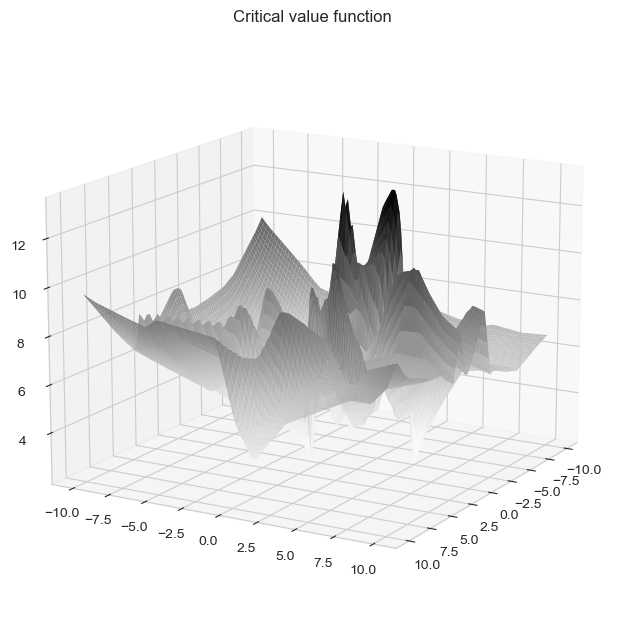

In [18]:
mpl.rcParams['figure.dpi'] = 100
X, Y = np.meshgrid(np.linspace(-10, 10, 100), np.linspace(-10, 10, 100))

fig = plt.figure(1, figsize=(12, 8))
ax = plt.axes(projection='3d')
ax.plot_surface(X, Y, predicted_cutoffs_nn.reshape(X.shape), rstride=1, cstride=1,
                cmap='Greys', edgecolor='none')
ax.set_title('Critical value function')
ax.view_init(elev=15, azim=30)

##### 68.3%

In [ ]:
CONFIDENCE_LEVEL = 0.683

In [ ]:
#learner_kwargs = {'max_depth': 1, 'n_estimators': 1000}
#qr_XGB68, predicted_cutoffs_xgb68 = train_qr_algo(model_obj=simulator_lf2i, alpha=CONFIDENCE_LEVEL,
#                                              theta_mat=b_prime_theta, stats_mat=qr_statistics,
#                                              algo_name='xgb', learner_kwargs=learner_kwargs, pytorch_kwargs=None,
#                                              prediction_grid=simulator_lf2i.param_grid)

learner_kwargs = {'epochs': 500, 'batch_size': 100}
pytorch_kwargs = {'neur_shapes': (32, 32)}
qr_nn68, predicted_cutoffs_nn68 = train_qr_algo(model_obj=simulator_lf2i, alpha=CONFIDENCE_LEVEL,
                                                                       theta_mat=b_prime_theta.numpy(), stats_mat=qr_statistics,
                                                                       algo_name='pytorch', learner_kwargs=learner_kwargs, pytorch_kwargs=pytorch_kwargs,
                                                                       prediction_grid=simulator_lf2i.param_grid)

In [ ]:
X, Y = np.meshgrid(np.linspace(-10, 10, 100), np.linspace(-10, 10, 100))

fig = plt.figure(1, figsize=(12, 8))
ax = plt.axes(projection='3d')
ax.plot_surface(X, Y, predicted_cutoffs_nn68.reshape(X.shape), rstride=1, cstride=1,
                cmap='viridis', edgecolor='none')
ax.set_title('Critical value function')
ax.view_init(elev=15, azim=30)

## Diagnostics

### Confidence sets

In [143]:
posterior_means_diagnostics = []
posterior_vars_diagnostics = []
for i in tqdm(range(B_DOUBLE_PRIME), desc='Computing posterior quantities for diagnostics...'):
    posterior_samples_diagnostics = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=b_double_prime_x[i, :])
    posterior_means_diagnostics.append(torch.mean(posterior_samples_diagnostics, dim=0))
    posterior_vars_diagnostics.append(torch.cov(torch.transpose(posterior_samples_diagnostics, 0, 1)))

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                          | 0/10000 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                  | 1/10000 [00:00<42:07,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                  | 2/10000 [00:00<40:09,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                  | 3/10000 [00:00<39:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                  | 4/10000 [00:00<38:52,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                  | 5/10000 [00:01<38:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                  | 6/10000 [00:01<38:35,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                  | 7/10000 [00:01<38:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|                                                                                                                                                  | 8/10000 [00:01<38:36,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                 | 9/10000 [00:02<38:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                | 10/10000 [00:02<38:51,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                | 11/10000 [00:02<38:29,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                | 12/10000 [00:02<38:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                | 13/10000 [00:03<38:50,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                | 14/10000 [00:03<38:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                | 15/10000 [00:03<38:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                | 16/10000 [00:03<38:28,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▏                                                                                                                                                | 17/10000 [00:03<38:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                                                                                | 18/10000 [00:04<37:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                                                                                | 19/10000 [00:04<37:26,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                                                                                | 20/10000 [00:04<37:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                                                                                | 21/10000 [00:04<37:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                                                                                | 22/10000 [00:05<36:57,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                                                                                | 23/10000 [00:05<36:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                                                                                | 24/10000 [00:05<36:44,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▎                                                                                                                                                | 25/10000 [00:05<36:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 26/10000 [00:05<36:48,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 27/10000 [00:06<36:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 28/10000 [00:06<37:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 29/10000 [00:06<37:05,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 30/10000 [00:06<36:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 31/10000 [00:07<36:51,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 32/10000 [00:07<36:48,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 33/10000 [00:07<36:41,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▍                                                                                                                                                | 34/10000 [00:07<36:55,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 35/10000 [00:07<37:02,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 36/10000 [00:08<37:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 37/10000 [00:08<37:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 38/10000 [00:08<36:44,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 39/10000 [00:08<36:32,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 40/10000 [00:09<36:35,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 41/10000 [00:09<36:24,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 42/10000 [00:09<36:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▌                                                                                                                                                | 43/10000 [00:09<36:20,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▋                                                                                                                                                | 44/10000 [00:09<36:19,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▋                                                                                                                                                | 45/10000 [00:10<36:21,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▋                                                                                                                                                | 46/10000 [00:10<36:14,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▋                                                                                                                                                | 47/10000 [00:10<36:07,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▋                                                                                                                                                | 48/10000 [00:10<35:58,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▋                                                                                                                                                | 49/10000 [00:11<35:59,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   0%|▋                                                                                                                                                | 50/10000 [00:11<36:06,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▋                                                                                                                                                | 51/10000 [00:11<36:00,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 52/10000 [00:11<37:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 53/10000 [00:11<37:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 54/10000 [00:12<36:58,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 55/10000 [00:12<36:36,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 56/10000 [00:12<36:28,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 57/10000 [00:12<36:18,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 58/10000 [00:12<36:13,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 59/10000 [00:13<36:15,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▊                                                                                                                                                | 60/10000 [00:13<36:09,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                                                                                | 61/10000 [00:13<36:08,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                                                                                | 62/10000 [00:13<36:04,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                                                                                | 63/10000 [00:14<36:06,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                                                                                | 64/10000 [00:14<36:12,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                                                                                | 65/10000 [00:14<37:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                                                                                | 66/10000 [00:14<37:16,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                                                                                | 67/10000 [00:14<37:04,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|▉                                                                                                                                                | 68/10000 [00:15<36:35,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 69/10000 [00:15<36:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 70/10000 [00:15<36:17,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 71/10000 [00:15<36:08,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 72/10000 [00:16<36:14,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 73/10000 [00:16<36:14,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 74/10000 [00:16<36:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 75/10000 [00:16<36:09,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 76/10000 [00:16<36:08,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█                                                                                                                                                | 77/10000 [00:17<36:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 78/10000 [00:17<36:18,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 79/10000 [00:17<36:18,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 80/10000 [00:17<36:11,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 81/10000 [00:18<36:15,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 82/10000 [00:18<36:14,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 83/10000 [00:18<36:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 84/10000 [00:18<36:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 85/10000 [00:18<36:06,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▏                                                                                                                                               | 86/10000 [00:19<36:06,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                                                                               | 87/10000 [00:19<36:04,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                                                                               | 88/10000 [00:19<36:05,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                                                                               | 89/10000 [00:19<36:02,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                                                                               | 90/10000 [00:20<35:56,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                                                                               | 91/10000 [00:20<35:58,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                                                                               | 92/10000 [00:20<35:58,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                                                                               | 93/10000 [00:20<35:56,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▎                                                                                                                                               | 94/10000 [00:20<35:51,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                               | 95/10000 [00:21<35:51,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                               | 96/10000 [00:21<35:50,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                               | 97/10000 [00:21<35:46,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                               | 98/10000 [00:21<35:48,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                               | 99/10000 [00:22<37:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                              | 100/10000 [00:22<37:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                              | 101/10000 [00:22<36:45,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                              | 102/10000 [00:22<36:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                              | 103/10000 [00:22<36:22,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▍                                                                                                                                              | 104/10000 [00:23<36:15,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▌                                                                                                                                              | 105/10000 [00:23<36:15,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▌                                                                                                                                              | 106/10000 [00:23<36:12,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▌                                                                                                                                              | 107/10000 [00:23<36:03,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▌                                                                                                                                              | 108/10000 [00:23<36:02,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▌                                                                                                                                              | 109/10000 [00:24<35:54,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▌                                                                                                                                              | 110/10000 [00:24<35:53,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▌                                                                                                                                              | 111/10000 [00:24<35:51,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▌                                                                                                                                              | 112/10000 [00:24<35:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 113/10000 [00:25<35:54,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 114/10000 [00:25<36:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 115/10000 [00:25<36:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 116/10000 [00:25<37:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 117/10000 [00:25<37:11,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 118/10000 [00:26<36:59,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 119/10000 [00:26<36:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 120/10000 [00:26<36:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▋                                                                                                                                              | 121/10000 [00:26<36:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 122/10000 [00:27<36:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 123/10000 [00:27<36:05,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 124/10000 [00:27<36:02,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 125/10000 [00:27<36:01,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 126/10000 [00:27<36:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 127/10000 [00:28<36:07,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 128/10000 [00:28<36:05,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 129/10000 [00:28<36:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▊                                                                                                                                              | 130/10000 [00:28<35:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▉                                                                                                                                              | 131/10000 [00:29<35:58,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▉                                                                                                                                              | 132/10000 [00:29<34:13,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▉                                                                                                                                              | 133/10000 [00:29<34:40,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▉                                                                                                                                              | 134/10000 [00:29<35:01,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▉                                                                                                                                              | 135/10000 [00:29<35:22,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▉                                                                                                                                              | 136/10000 [00:30<35:24,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▉                                                                                                                                              | 137/10000 [00:30<35:32,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|█▉                                                                                                                                              | 138/10000 [00:30<35:36,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 139/10000 [00:30<35:48,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 140/10000 [00:30<35:58,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 141/10000 [00:31<36:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 142/10000 [00:31<35:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 143/10000 [00:31<35:47,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 144/10000 [00:31<35:52,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 145/10000 [00:32<36:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 146/10000 [00:32<36:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██                                                                                                                                              | 147/10000 [00:32<36:04,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██▏                                                                                                                                             | 148/10000 [00:32<36:01,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   1%|██▏                                                                                                                                             | 149/10000 [00:32<35:55,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                                                                             | 150/10000 [00:33<35:54,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                                                                             | 151/10000 [00:33<36:01,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                                                                             | 152/10000 [00:33<34:18,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                                                                             | 153/10000 [00:33<35:00,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                                                                             | 154/10000 [00:34<35:07,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                                                                             | 155/10000 [00:34<35:28,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▏                                                                                                                                             | 156/10000 [00:34<35:39,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                                                                             | 157/10000 [00:34<35:46,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                                                                             | 158/10000 [00:34<35:46,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                                                                             | 159/10000 [00:35<36:09,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                                                                             | 160/10000 [00:35<36:08,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                                                                             | 161/10000 [00:35<36:04,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                                                                             | 162/10000 [00:35<36:08,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                                                                             | 163/10000 [00:35<36:04,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▎                                                                                                                                             | 164/10000 [00:36<36:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 165/10000 [00:36<36:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 166/10000 [00:36<36:19,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 167/10000 [00:36<36:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 168/10000 [00:37<36:26,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 169/10000 [00:37<36:26,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 170/10000 [00:37<36:07,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 171/10000 [00:37<36:05,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 172/10000 [00:37<36:06,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▍                                                                                                                                             | 173/10000 [00:38<36:10,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 174/10000 [00:38<36:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 175/10000 [00:38<37:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 176/10000 [00:38<37:03,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 177/10000 [00:39<35:10,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 178/10000 [00:39<35:43,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 179/10000 [00:39<36:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 180/10000 [00:39<34:15,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 181/10000 [00:39<35:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▌                                                                                                                                             | 182/10000 [00:40<37:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▋                                                                                                                                             | 183/10000 [00:40<37:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▋                                                                                                                                             | 184/10000 [00:40<37:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▋                                                                                                                                             | 185/10000 [00:40<37:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▋                                                                                                                                             | 186/10000 [00:41<37:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▋                                                                                                                                             | 187/10000 [00:41<37:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▋                                                                                                                                             | 188/10000 [00:41<36:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▋                                                                                                                                             | 189/10000 [00:41<36:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▋                                                                                                                                             | 190/10000 [00:42<36:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 191/10000 [00:42<36:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 192/10000 [00:42<36:10,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 193/10000 [00:42<35:55,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 194/10000 [00:42<35:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 195/10000 [00:43<35:32,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 196/10000 [00:43<35:42,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 197/10000 [00:43<35:52,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 198/10000 [00:43<35:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▊                                                                                                                                             | 199/10000 [00:43<36:03,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 200/10000 [00:44<36:10,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 201/10000 [00:44<36:41,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 202/10000 [00:44<36:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 203/10000 [00:44<36:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 204/10000 [00:45<36:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 205/10000 [00:45<36:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 206/10000 [00:45<36:11,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 207/10000 [00:45<41:15,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|██▉                                                                                                                                             | 208/10000 [00:46<39:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 209/10000 [00:46<38:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 210/10000 [00:46<37:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 211/10000 [00:46<35:20,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 212/10000 [00:46<35:41,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 213/10000 [00:47<35:43,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 214/10000 [00:47<35:50,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 215/10000 [00:47<39:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 216/10000 [00:47<38:18,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███                                                                                                                                             | 217/10000 [00:48<37:26,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▏                                                                                                                                            | 218/10000 [00:48<36:53,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▏                                                                                                                                            | 219/10000 [00:48<36:33,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▏                                                                                                                                            | 220/10000 [00:48<36:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▏                                                                                                                                            | 221/10000 [00:49<38:09,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▏                                                                                                                                            | 222/10000 [00:49<37:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▏                                                                                                                                            | 223/10000 [00:49<36:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▏                                                                                                                                            | 224/10000 [00:49<36:32,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▏                                                                                                                                            | 225/10000 [00:49<36:15,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 226/10000 [00:50<36:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 227/10000 [00:50<36:01,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 228/10000 [00:50<35:52,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 229/10000 [00:50<35:36,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 230/10000 [00:50<35:33,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 231/10000 [00:51<35:32,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 232/10000 [00:51<35:26,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 233/10000 [00:51<35:38,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▎                                                                                                                                            | 234/10000 [00:51<35:35,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 235/10000 [00:52<35:38,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 236/10000 [00:52<36:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 237/10000 [00:52<36:25,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 238/10000 [00:52<36:27,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 239/10000 [00:52<36:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 240/10000 [00:53<36:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 241/10000 [00:53<36:15,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 242/10000 [00:53<36:03,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▍                                                                                                                                            | 243/10000 [00:53<35:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▌                                                                                                                                            | 244/10000 [00:54<35:53,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▌                                                                                                                                            | 245/10000 [00:54<35:54,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▌                                                                                                                                            | 246/10000 [00:54<35:49,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▌                                                                                                                                            | 247/10000 [00:54<35:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▌                                                                                                                                            | 248/10000 [00:54<35:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▌                                                                                                                                            | 249/10000 [00:55<36:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   2%|███▌                                                                                                                                            | 250/10000 [00:55<35:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▌                                                                                                                                            | 251/10000 [00:55<35:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 252/10000 [00:55<35:46,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 253/10000 [00:56<35:49,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 254/10000 [00:56<35:49,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 255/10000 [00:56<35:44,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 256/10000 [00:56<42:36,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 257/10000 [00:57<40:29,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 258/10000 [00:57<39:02,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 259/10000 [00:57<38:03,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▋                                                                                                                                            | 260/10000 [00:57<37:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 261/10000 [00:57<34:58,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 262/10000 [00:58<35:10,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 263/10000 [00:58<35:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 264/10000 [00:58<35:29,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 265/10000 [00:58<35:36,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 266/10000 [00:59<35:42,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 267/10000 [00:59<36:19,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 268/10000 [00:59<36:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▊                                                                                                                                            | 269/10000 [00:59<36:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▉                                                                                                                                            | 270/10000 [00:59<36:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▉                                                                                                                                            | 271/10000 [01:00<35:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▉                                                                                                                                            | 272/10000 [01:00<35:48,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▉                                                                                                                                            | 273/10000 [01:00<35:48,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▉                                                                                                                                            | 274/10000 [01:00<35:42,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▉                                                                                                                                            | 275/10000 [01:01<35:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▉                                                                                                                                            | 276/10000 [01:01<35:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|███▉                                                                                                                                            | 277/10000 [01:01<35:38,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 278/10000 [01:01<35:37,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 279/10000 [01:01<35:36,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 280/10000 [01:02<33:51,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 281/10000 [01:02<34:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 282/10000 [01:02<35:13,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 283/10000 [01:02<35:17,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 284/10000 [01:02<35:11,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 285/10000 [01:03<35:34,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████                                                                                                                                            | 286/10000 [01:03<35:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 287/10000 [01:03<35:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 288/10000 [01:03<35:48,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 289/10000 [01:04<35:40,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 290/10000 [01:04<35:40,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 291/10000 [01:04<35:32,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 292/10000 [01:04<35:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 293/10000 [01:04<35:38,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 294/10000 [01:05<35:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▏                                                                                                                                           | 295/10000 [01:05<35:34,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▎                                                                                                                                           | 296/10000 [01:05<39:00,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▎                                                                                                                                           | 297/10000 [01:05<38:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▎                                                                                                                                           | 298/10000 [01:06<37:32,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▎                                                                                                                                           | 299/10000 [01:06<42:26,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▎                                                                                                                                           | 300/10000 [01:06<40:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▎                                                                                                                                           | 301/10000 [01:06<38:59,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▎                                                                                                                                           | 302/10000 [01:07<38:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▎                                                                                                                                           | 303/10000 [01:07<37:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 304/10000 [01:07<38:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 305/10000 [01:07<37:44,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 306/10000 [01:08<37:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 307/10000 [01:08<37:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 308/10000 [01:08<36:44,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 309/10000 [01:08<36:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 310/10000 [01:08<36:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 311/10000 [01:09<36:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▍                                                                                                                                           | 312/10000 [01:09<36:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 313/10000 [01:09<36:17,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 314/10000 [01:09<36:12,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 315/10000 [01:10<36:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 316/10000 [01:10<35:55,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 317/10000 [01:10<35:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 318/10000 [01:10<35:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 319/10000 [01:10<35:46,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 320/10000 [01:11<35:32,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▌                                                                                                                                           | 321/10000 [01:11<35:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▋                                                                                                                                           | 322/10000 [01:11<35:26,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▋                                                                                                                                           | 323/10000 [01:11<35:15,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▋                                                                                                                                           | 324/10000 [01:12<35:10,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▋                                                                                                                                           | 325/10000 [01:12<35:19,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▋                                                                                                                                           | 326/10000 [01:12<35:26,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▋                                                                                                                                           | 327/10000 [01:12<35:22,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▋                                                                                                                                           | 328/10000 [01:12<35:28,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▋                                                                                                                                           | 329/10000 [01:13<35:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 330/10000 [01:13<35:54,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 331/10000 [01:13<40:51,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 332/10000 [01:13<39:08,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 333/10000 [01:14<38:04,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 334/10000 [01:14<37:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 335/10000 [01:14<36:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 336/10000 [01:14<36:55,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 337/10000 [01:15<36:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▊                                                                                                                                           | 338/10000 [01:15<36:21,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 339/10000 [01:15<36:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 340/10000 [01:15<36:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 341/10000 [01:16<38:31,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 342/10000 [01:16<37:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 343/10000 [01:16<36:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 344/10000 [01:16<36:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 345/10000 [01:16<36:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 346/10000 [01:17<36:25,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|████▉                                                                                                                                           | 347/10000 [01:17<36:09,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|█████                                                                                                                                           | 348/10000 [01:17<35:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   3%|█████                                                                                                                                           | 349/10000 [01:17<35:52,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████                                                                                                                                           | 350/10000 [01:18<35:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████                                                                                                                                           | 351/10000 [01:18<35:31,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████                                                                                                                                           | 352/10000 [01:18<35:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████                                                                                                                                           | 353/10000 [01:18<35:13,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████                                                                                                                                           | 354/10000 [01:18<36:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████                                                                                                                                           | 355/10000 [01:19<36:01,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 356/10000 [01:19<35:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 357/10000 [01:19<35:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 358/10000 [01:19<35:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 359/10000 [01:19<35:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 360/10000 [01:20<33:28,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 361/10000 [01:20<34:11,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 362/10000 [01:20<34:40,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 363/10000 [01:20<35:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▏                                                                                                                                          | 364/10000 [01:21<35:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 365/10000 [01:21<35:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 366/10000 [01:21<36:03,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 367/10000 [01:21<35:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 368/10000 [01:21<36:02,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 369/10000 [01:22<36:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 370/10000 [01:22<36:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 371/10000 [01:22<36:01,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 372/10000 [01:22<35:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▎                                                                                                                                          | 373/10000 [01:23<36:01,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                          | 374/10000 [01:23<35:51,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                          | 375/10000 [01:23<35:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                          | 376/10000 [01:23<35:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                          | 377/10000 [01:23<35:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                          | 378/10000 [01:24<35:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                          | 379/10000 [01:24<35:39,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                          | 380/10000 [01:24<35:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                          | 381/10000 [01:24<35:36,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▌                                                                                                                                          | 382/10000 [01:25<35:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▌                                                                                                                                          | 383/10000 [01:25<36:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▌                                                                                                                                          | 384/10000 [01:25<42:15,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▌                                                                                                                                          | 385/10000 [01:26<57:28,  2.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▍                                                                                                                                        | 386/10000 [01:26<1:00:31,  2.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▌                                                                                                                                          | 387/10000 [01:26<56:12,  2.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▌                                                                                                                                          | 388/10000 [01:27<51:10,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▌                                                                                                                                          | 389/10000 [01:27<50:58,  3.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▌                                                                                                                                          | 390/10000 [01:27<46:31,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 391/10000 [01:28<43:30,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 392/10000 [01:28<41:22,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 393/10000 [01:28<39:43,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 394/10000 [01:28<38:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 395/10000 [01:28<39:16,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 396/10000 [01:29<38:06,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 397/10000 [01:29<37:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 398/10000 [01:29<36:53,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▋                                                                                                                                          | 399/10000 [01:29<36:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▊                                                                                                                                          | 400/10000 [01:30<36:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▊                                                                                                                                          | 401/10000 [01:30<36:53,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▊                                                                                                                                          | 402/10000 [01:30<39:33,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▊                                                                                                                                          | 403/10000 [01:30<39:45,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▊                                                                                                                                          | 404/10000 [01:31<39:32,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▊                                                                                                                                          | 405/10000 [01:31<39:15,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▊                                                                                                                                          | 406/10000 [01:31<38:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▊                                                                                                                                          | 407/10000 [01:31<38:01,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 408/10000 [01:32<37:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 409/10000 [01:32<37:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 410/10000 [01:32<36:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 411/10000 [01:32<36:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 412/10000 [01:32<35:49,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 413/10000 [01:33<35:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 414/10000 [01:33<35:22,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 415/10000 [01:33<35:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|█████▉                                                                                                                                          | 416/10000 [01:33<35:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 417/10000 [01:33<35:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 418/10000 [01:34<33:51,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 419/10000 [01:34<34:16,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 420/10000 [01:34<34:35,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 421/10000 [01:34<34:44,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 422/10000 [01:35<35:08,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 423/10000 [01:35<35:11,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 424/10000 [01:35<35:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████                                                                                                                                          | 425/10000 [01:35<37:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 426/10000 [01:35<36:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 427/10000 [01:36<36:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 428/10000 [01:36<36:51,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 429/10000 [01:36<37:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 430/10000 [01:36<36:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 431/10000 [01:37<36:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 432/10000 [01:37<34:45,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 433/10000 [01:37<35:12,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▏                                                                                                                                         | 434/10000 [01:37<35:31,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▎                                                                                                                                         | 435/10000 [01:38<37:52,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▎                                                                                                                                         | 436/10000 [01:38<35:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▎                                                                                                                                         | 437/10000 [01:38<36:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▎                                                                                                                                         | 438/10000 [01:38<36:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▎                                                                                                                                         | 439/10000 [01:38<36:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▎                                                                                                                                         | 440/10000 [01:39<37:42,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▎                                                                                                                                         | 441/10000 [01:39<37:15,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▎                                                                                                                                         | 442/10000 [01:39<37:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▍                                                                                                                                         | 443/10000 [01:39<37:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▍                                                                                                                                         | 444/10000 [01:40<39:24,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▍                                                                                                                                         | 445/10000 [01:40<38:28,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▍                                                                                                                                         | 446/10000 [01:40<37:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▍                                                                                                                                         | 447/10000 [01:40<36:48,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▍                                                                                                                                         | 448/10000 [01:41<36:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▍                                                                                                                                         | 449/10000 [01:41<35:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   4%|██████▍                                                                                                                                         | 450/10000 [01:41<35:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▍                                                                                                                                         | 451/10000 [01:41<35:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 452/10000 [01:41<35:23,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 453/10000 [01:42<35:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 454/10000 [01:42<35:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 455/10000 [01:42<35:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 456/10000 [01:42<34:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 457/10000 [01:43<34:52,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 458/10000 [01:43<34:48,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 459/10000 [01:43<34:45,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▌                                                                                                                                         | 460/10000 [01:43<34:38,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▋                                                                                                                                         | 461/10000 [01:43<35:10,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▋                                                                                                                                         | 462/10000 [01:44<35:06,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▋                                                                                                                                         | 463/10000 [01:44<35:07,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▋                                                                                                                                         | 464/10000 [01:44<34:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▋                                                                                                                                         | 465/10000 [01:44<34:47,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▋                                                                                                                                         | 466/10000 [01:45<34:42,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▋                                                                                                                                         | 467/10000 [01:45<34:44,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▋                                                                                                                                         | 468/10000 [01:45<34:44,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 469/10000 [01:45<34:44,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 470/10000 [01:45<33:02,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 471/10000 [01:46<33:28,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 472/10000 [01:46<33:49,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 473/10000 [01:46<34:03,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 474/10000 [01:46<34:13,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 475/10000 [01:46<34:16,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 476/10000 [01:47<34:22,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▊                                                                                                                                         | 477/10000 [01:47<34:23,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 478/10000 [01:47<34:25,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 479/10000 [01:47<34:29,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 480/10000 [01:48<34:28,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 481/10000 [01:48<34:30,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 482/10000 [01:48<34:34,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 483/10000 [01:48<34:32,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 484/10000 [01:48<34:36,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 485/10000 [01:49<34:35,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|██████▉                                                                                                                                         | 486/10000 [01:49<34:32,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████                                                                                                                                         | 487/10000 [01:49<34:35,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████                                                                                                                                         | 488/10000 [01:49<34:35,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████                                                                                                                                         | 489/10000 [01:50<34:33,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████                                                                                                                                         | 490/10000 [01:50<34:34,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████                                                                                                                                         | 491/10000 [01:50<36:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████                                                                                                                                         | 492/10000 [01:50<35:51,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████                                                                                                                                         | 493/10000 [01:50<35:27,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████                                                                                                                                         | 494/10000 [01:51<35:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 495/10000 [01:51<34:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 496/10000 [01:51<34:48,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 497/10000 [01:51<34:38,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 498/10000 [01:52<34:37,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 499/10000 [01:52<34:32,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 500/10000 [01:52<34:36,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 501/10000 [01:52<34:31,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 502/10000 [01:52<34:27,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▏                                                                                                                                        | 503/10000 [01:53<34:27,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 504/10000 [01:53<34:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 505/10000 [01:53<34:24,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 506/10000 [01:53<34:19,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 507/10000 [01:53<34:24,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 508/10000 [01:54<34:27,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 509/10000 [01:54<34:35,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 510/10000 [01:54<34:34,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 511/10000 [01:54<34:32,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▎                                                                                                                                        | 512/10000 [01:55<34:33,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▍                                                                                                                                        | 513/10000 [01:55<34:36,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▍                                                                                                                                        | 514/10000 [01:55<34:33,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▍                                                                                                                                        | 515/10000 [01:55<34:38,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▍                                                                                                                                        | 516/10000 [01:55<34:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▍                                                                                                                                        | 517/10000 [01:56<34:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▍                                                                                                                                        | 518/10000 [01:56<34:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▍                                                                                                                                        | 519/10000 [01:56<34:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▍                                                                                                                                        | 520/10000 [01:56<34:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 521/10000 [01:57<34:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 522/10000 [01:57<34:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 523/10000 [01:57<34:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 524/10000 [01:57<34:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 525/10000 [01:57<34:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 526/10000 [01:58<34:31,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 527/10000 [01:58<34:30,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 528/10000 [01:58<34:31,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▌                                                                                                                                        | 529/10000 [01:58<34:31,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 530/10000 [01:58<34:27,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 531/10000 [01:59<34:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 532/10000 [01:59<34:18,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 533/10000 [01:59<34:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 534/10000 [01:59<34:18,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 535/10000 [02:00<34:15,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 536/10000 [02:00<34:17,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 537/10000 [02:00<34:13,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▋                                                                                                                                        | 538/10000 [02:00<34:15,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▊                                                                                                                                        | 539/10000 [02:00<34:12,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▊                                                                                                                                        | 540/10000 [02:01<34:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▊                                                                                                                                        | 541/10000 [02:01<34:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▊                                                                                                                                        | 542/10000 [02:01<34:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▊                                                                                                                                        | 543/10000 [02:01<34:26,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▊                                                                                                                                        | 544/10000 [02:02<34:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▊                                                                                                                                        | 545/10000 [02:02<34:21,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▊                                                                                                                                        | 546/10000 [02:02<34:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▉                                                                                                                                        | 547/10000 [02:02<34:15,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▉                                                                                                                                        | 548/10000 [02:02<34:21,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   5%|███████▉                                                                                                                                        | 549/10000 [02:03<34:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|███████▉                                                                                                                                        | 550/10000 [02:03<34:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|███████▉                                                                                                                                        | 551/10000 [02:03<34:20,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|███████▉                                                                                                                                        | 552/10000 [02:03<37:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|███████▉                                                                                                                                        | 553/10000 [02:04<36:38,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|███████▉                                                                                                                                        | 554/10000 [02:04<39:22,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|███████▉                                                                                                                                        | 555/10000 [02:04<37:52,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 556/10000 [02:04<36:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 557/10000 [02:05<36:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 558/10000 [02:05<35:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 559/10000 [02:05<34:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 560/10000 [02:05<34:47,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 561/10000 [02:05<34:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 562/10000 [02:06<32:53,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 563/10000 [02:06<33:16,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████                                                                                                                                        | 564/10000 [02:06<33:30,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▏                                                                                                                                       | 565/10000 [02:06<33:41,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▏                                                                                                                                       | 566/10000 [02:06<33:50,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▏                                                                                                                                       | 567/10000 [02:07<34:01,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▏                                                                                                                                       | 568/10000 [02:07<34:07,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▏                                                                                                                                       | 569/10000 [02:07<34:09,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▏                                                                                                                                       | 570/10000 [02:07<34:16,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▏                                                                                                                                       | 571/10000 [02:07<32:33,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▏                                                                                                                                       | 572/10000 [02:08<33:09,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 573/10000 [02:08<33:25,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 574/10000 [02:08<33:35,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 575/10000 [02:08<33:42,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 576/10000 [02:09<33:51,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 577/10000 [02:09<33:56,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 578/10000 [02:09<34:02,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 579/10000 [02:09<34:01,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 580/10000 [02:09<34:04,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▎                                                                                                                                       | 581/10000 [02:10<34:09,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 582/10000 [02:10<34:12,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 583/10000 [02:10<34:11,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 584/10000 [02:10<34:11,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 585/10000 [02:11<34:14,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 586/10000 [02:11<34:17,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 587/10000 [02:11<34:14,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 588/10000 [02:11<34:09,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 589/10000 [02:11<34:09,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▍                                                                                                                                       | 590/10000 [02:12<34:04,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▌                                                                                                                                       | 591/10000 [02:12<34:04,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▌                                                                                                                                       | 592/10000 [02:12<34:03,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▌                                                                                                                                       | 593/10000 [02:12<32:25,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▌                                                                                                                                       | 594/10000 [02:12<32:56,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▌                                                                                                                                       | 595/10000 [02:13<33:20,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▌                                                                                                                                       | 596/10000 [02:13<33:36,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▌                                                                                                                                       | 597/10000 [02:13<33:47,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▌                                                                                                                                       | 598/10000 [02:13<33:53,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 599/10000 [02:14<33:55,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 600/10000 [02:14<37:14,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 601/10000 [02:14<36:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 602/10000 [02:14<39:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 603/10000 [02:15<37:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 604/10000 [02:15<36:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 605/10000 [02:15<35:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 606/10000 [02:15<35:16,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▋                                                                                                                                       | 607/10000 [02:15<34:54,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 608/10000 [02:16<34:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 609/10000 [02:16<34:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 610/10000 [02:16<34:44,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 611/10000 [02:16<34:29,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 612/10000 [02:17<34:25,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 613/10000 [02:17<34:19,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 614/10000 [02:17<34:15,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 615/10000 [02:17<37:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▊                                                                                                                                       | 616/10000 [02:17<36:27,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▉                                                                                                                                       | 617/10000 [02:18<35:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▉                                                                                                                                       | 618/10000 [02:18<35:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▉                                                                                                                                       | 619/10000 [02:18<36:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▉                                                                                                                                       | 620/10000 [02:18<35:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▉                                                                                                                                       | 621/10000 [02:19<35:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▉                                                                                                                                       | 622/10000 [02:19<35:00,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▉                                                                                                                                       | 623/10000 [02:19<36:23,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|████████▉                                                                                                                                       | 624/10000 [02:19<35:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 625/10000 [02:20<36:57,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 626/10000 [02:20<36:01,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 627/10000 [02:20<35:22,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 628/10000 [02:20<35:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 629/10000 [02:20<34:51,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 630/10000 [02:21<34:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 631/10000 [02:21<34:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 632/10000 [02:21<34:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████                                                                                                                                       | 633/10000 [02:21<34:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 634/10000 [02:22<34:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 635/10000 [02:22<34:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 636/10000 [02:22<34:01,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 637/10000 [02:22<34:01,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 638/10000 [02:22<33:57,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 639/10000 [02:23<33:59,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 640/10000 [02:23<34:03,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 641/10000 [02:23<34:05,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▏                                                                                                                                      | 642/10000 [02:23<34:01,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▎                                                                                                                                      | 643/10000 [02:23<34:03,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▎                                                                                                                                      | 644/10000 [02:24<34:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▎                                                                                                                                      | 645/10000 [02:24<32:23,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▎                                                                                                                                      | 646/10000 [02:24<34:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▎                                                                                                                                      | 647/10000 [02:24<34:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▎                                                                                                                                      | 648/10000 [02:25<34:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▎                                                                                                                                      | 649/10000 [02:25<34:11,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   6%|█████████▎                                                                                                                                      | 650/10000 [02:25<34:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▎                                                                                                                                      | 651/10000 [02:25<34:05,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▍                                                                                                                                      | 652/10000 [02:25<34:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▍                                                                                                                                      | 653/10000 [02:26<34:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▍                                                                                                                                      | 654/10000 [02:26<33:56,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▍                                                                                                                                      | 655/10000 [02:26<33:53,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▍                                                                                                                                      | 656/10000 [02:26<33:57,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▍                                                                                                                                      | 657/10000 [02:27<33:50,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▍                                                                                                                                      | 658/10000 [02:27<33:47,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▍                                                                                                                                      | 659/10000 [02:27<33:52,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 660/10000 [02:27<33:53,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 661/10000 [02:27<32:13,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 662/10000 [02:28<32:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 663/10000 [02:28<33:11,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 664/10000 [02:28<33:22,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 665/10000 [02:28<31:54,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 666/10000 [02:28<32:32,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 667/10000 [02:29<32:56,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▌                                                                                                                                      | 668/10000 [02:29<33:13,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 669/10000 [02:29<33:21,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 670/10000 [02:29<33:28,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 671/10000 [02:29<31:52,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 672/10000 [02:30<32:24,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 673/10000 [02:30<32:51,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 674/10000 [02:30<34:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 675/10000 [02:30<34:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 676/10000 [02:31<34:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▋                                                                                                                                      | 677/10000 [02:31<34:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▊                                                                                                                                      | 678/10000 [02:31<34:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▊                                                                                                                                      | 679/10000 [02:31<34:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▊                                                                                                                                      | 680/10000 [02:31<33:55,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▊                                                                                                                                      | 681/10000 [02:32<33:51,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▊                                                                                                                                      | 682/10000 [02:32<33:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▊                                                                                                                                      | 683/10000 [02:32<33:52,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▊                                                                                                                                      | 684/10000 [02:32<33:58,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▊                                                                                                                                      | 685/10000 [02:33<33:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 686/10000 [02:33<33:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 687/10000 [02:33<34:02,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 688/10000 [02:33<33:58,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 689/10000 [02:33<33:53,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 690/10000 [02:34<33:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 691/10000 [02:34<33:58,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 692/10000 [02:34<33:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 693/10000 [02:34<33:53,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|█████████▉                                                                                                                                      | 694/10000 [02:35<37:19,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 695/10000 [02:35<36:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 696/10000 [02:35<35:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 697/10000 [02:35<34:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 698/10000 [02:35<34:33,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 699/10000 [02:36<34:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 700/10000 [02:36<34:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 701/10000 [02:36<34:06,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 702/10000 [02:36<33:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████                                                                                                                                      | 703/10000 [02:37<33:48,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▏                                                                                                                                     | 704/10000 [02:37<33:51,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▏                                                                                                                                     | 705/10000 [02:37<33:52,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▏                                                                                                                                     | 706/10000 [02:37<33:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▏                                                                                                                                     | 707/10000 [02:37<33:44,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▏                                                                                                                                     | 708/10000 [02:38<33:39,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▏                                                                                                                                     | 709/10000 [02:38<33:41,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▏                                                                                                                                     | 710/10000 [02:38<33:37,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▏                                                                                                                                     | 711/10000 [02:38<33:38,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 712/10000 [02:39<33:42,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 713/10000 [02:39<33:44,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 714/10000 [02:39<32:07,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 715/10000 [02:39<32:35,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 716/10000 [02:39<32:54,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 717/10000 [02:40<33:10,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 718/10000 [02:40<33:22,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 719/10000 [02:40<33:29,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▎                                                                                                                                     | 720/10000 [02:40<33:36,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 721/10000 [02:40<34:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 722/10000 [02:41<35:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 723/10000 [02:41<35:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 724/10000 [02:41<34:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 725/10000 [02:41<35:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 726/10000 [02:42<34:40,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 727/10000 [02:42<34:27,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 728/10000 [02:42<34:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▍                                                                                                                                     | 729/10000 [02:42<34:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▌                                                                                                                                     | 730/10000 [02:43<37:18,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▌                                                                                                                                     | 731/10000 [02:43<34:36,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▌                                                                                                                                     | 732/10000 [02:43<34:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▌                                                                                                                                     | 733/10000 [02:43<32:28,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▌                                                                                                                                     | 734/10000 [02:43<32:39,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▌                                                                                                                                     | 735/10000 [02:44<32:58,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▌                                                                                                                                     | 736/10000 [02:44<33:23,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▌                                                                                                                                     | 737/10000 [02:44<33:26,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 738/10000 [02:44<33:28,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 739/10000 [02:44<33:37,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 740/10000 [02:45<33:39,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 741/10000 [02:45<33:34,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 742/10000 [02:45<33:31,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 743/10000 [02:45<33:29,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 744/10000 [02:46<33:46,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 745/10000 [02:46<33:53,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▋                                                                                                                                     | 746/10000 [02:46<33:53,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▊                                                                                                                                     | 747/10000 [02:46<33:53,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▊                                                                                                                                     | 748/10000 [02:46<33:53,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   7%|██████████▊                                                                                                                                     | 749/10000 [02:47<35:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▊                                                                                                                                     | 750/10000 [02:47<34:53,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▊                                                                                                                                     | 751/10000 [02:47<34:29,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▊                                                                                                                                     | 752/10000 [02:47<34:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▊                                                                                                                                     | 753/10000 [02:48<34:03,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▊                                                                                                                                     | 754/10000 [02:48<33:54,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▊                                                                                                                                     | 755/10000 [02:48<33:51,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▉                                                                                                                                     | 756/10000 [02:48<33:49,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▉                                                                                                                                     | 757/10000 [02:48<33:43,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▉                                                                                                                                     | 758/10000 [02:49<33:43,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▉                                                                                                                                     | 759/10000 [02:49<33:40,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▉                                                                                                                                     | 760/10000 [02:49<33:45,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▉                                                                                                                                     | 761/10000 [02:49<33:41,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▉                                                                                                                                     | 762/10000 [02:50<33:39,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|██████████▉                                                                                                                                     | 763/10000 [02:50<33:35,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 764/10000 [02:50<33:29,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 765/10000 [02:50<35:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 766/10000 [02:50<36:21,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 767/10000 [02:51<35:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 768/10000 [02:51<34:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 769/10000 [02:51<34:29,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 770/10000 [02:51<34:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 771/10000 [02:52<33:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████                                                                                                                                     | 772/10000 [02:52<33:57,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 773/10000 [02:52<33:49,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 774/10000 [02:52<33:44,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 775/10000 [02:52<33:34,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 776/10000 [02:53<33:37,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 777/10000 [02:53<33:31,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 778/10000 [02:53<33:27,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 779/10000 [02:53<33:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 780/10000 [02:54<35:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▏                                                                                                                                    | 781/10000 [02:54<34:36,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▎                                                                                                                                    | 782/10000 [02:54<34:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▎                                                                                                                                    | 783/10000 [02:54<34:02,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▎                                                                                                                                    | 784/10000 [02:54<33:58,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▎                                                                                                                                    | 785/10000 [02:55<33:55,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▎                                                                                                                                    | 786/10000 [02:55<33:49,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▎                                                                                                                                    | 787/10000 [02:55<33:41,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▎                                                                                                                                    | 788/10000 [02:55<33:40,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▎                                                                                                                                    | 789/10000 [02:55<33:31,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 790/10000 [02:56<33:27,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 791/10000 [02:56<33:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 792/10000 [02:56<33:29,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 793/10000 [02:56<33:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 794/10000 [02:57<33:18,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 795/10000 [02:57<33:21,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 796/10000 [02:57<33:19,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 797/10000 [02:57<33:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▍                                                                                                                                    | 798/10000 [02:57<33:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 799/10000 [02:58<33:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 800/10000 [02:58<33:32,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 801/10000 [02:58<33:38,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 802/10000 [02:58<33:34,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 803/10000 [02:59<33:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 804/10000 [02:59<33:21,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 805/10000 [02:59<33:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 806/10000 [02:59<33:16,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▌                                                                                                                                    | 807/10000 [02:59<33:18,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▋                                                                                                                                    | 808/10000 [03:00<33:13,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▋                                                                                                                                    | 809/10000 [03:00<34:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▋                                                                                                                                    | 810/10000 [03:00<34:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▋                                                                                                                                    | 811/10000 [03:00<34:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▋                                                                                                                                    | 812/10000 [03:01<32:20,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▋                                                                                                                                    | 813/10000 [03:01<31:02,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▋                                                                                                                                    | 814/10000 [03:01<35:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▋                                                                                                                                    | 815/10000 [03:01<34:28,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 816/10000 [03:01<34:07,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 817/10000 [03:02<35:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 818/10000 [03:02<34:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 819/10000 [03:02<34:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 820/10000 [03:02<34:09,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 821/10000 [03:03<33:52,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 822/10000 [03:03<33:43,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 823/10000 [03:03<33:36,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▊                                                                                                                                    | 824/10000 [03:03<33:32,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 825/10000 [03:03<33:28,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 826/10000 [03:04<33:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 827/10000 [03:04<33:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 828/10000 [03:04<33:18,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 829/10000 [03:04<33:16,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 830/10000 [03:05<33:19,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 831/10000 [03:05<33:13,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 832/10000 [03:05<33:14,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|███████████▉                                                                                                                                    | 833/10000 [03:05<33:12,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 834/10000 [03:05<33:11,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 835/10000 [03:06<31:50,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 836/10000 [03:06<32:15,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 837/10000 [03:06<32:33,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 838/10000 [03:06<32:51,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 839/10000 [03:06<33:04,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 840/10000 [03:07<34:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 841/10000 [03:07<34:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████                                                                                                                                    | 842/10000 [03:07<33:51,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████▏                                                                                                                                   | 843/10000 [03:07<33:38,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████▏                                                                                                                                   | 844/10000 [03:08<33:32,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████▏                                                                                                                                   | 845/10000 [03:08<33:29,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████▏                                                                                                                                   | 846/10000 [03:08<33:27,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████▏                                                                                                                                   | 847/10000 [03:08<33:23,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████▏                                                                                                                                   | 848/10000 [03:08<33:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████▏                                                                                                                                   | 849/10000 [03:09<33:19,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   8%|████████████▏                                                                                                                                   | 850/10000 [03:09<33:24,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 851/10000 [03:09<33:28,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 852/10000 [03:09<33:21,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 853/10000 [03:10<33:28,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 854/10000 [03:10<33:28,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 855/10000 [03:10<33:21,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 856/10000 [03:10<33:28,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 857/10000 [03:10<33:27,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 858/10000 [03:11<33:24,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▎                                                                                                                                   | 859/10000 [03:11<33:24,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 860/10000 [03:11<33:18,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 861/10000 [03:11<33:15,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 862/10000 [03:11<33:10,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 863/10000 [03:12<33:13,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 864/10000 [03:12<33:14,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 865/10000 [03:12<33:12,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 866/10000 [03:12<31:31,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 867/10000 [03:13<31:58,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▍                                                                                                                                   | 868/10000 [03:13<32:35,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▌                                                                                                                                   | 869/10000 [03:13<32:45,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▌                                                                                                                                   | 870/10000 [03:13<32:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▌                                                                                                                                   | 871/10000 [03:13<33:00,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▌                                                                                                                                   | 872/10000 [03:14<37:55,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▌                                                                                                                                   | 873/10000 [03:14<36:36,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▌                                                                                                                                   | 874/10000 [03:14<35:34,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▌                                                                                                                                   | 875/10000 [03:14<34:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▌                                                                                                                                   | 876/10000 [03:15<38:58,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 877/10000 [03:15<37:10,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 878/10000 [03:15<35:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 879/10000 [03:15<35:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 880/10000 [03:16<34:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 881/10000 [03:16<33:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 882/10000 [03:16<33:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 883/10000 [03:16<33:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 884/10000 [03:16<33:19,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▋                                                                                                                                   | 885/10000 [03:17<33:18,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 886/10000 [03:17<33:11,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 887/10000 [03:17<34:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 888/10000 [03:17<34:20,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 889/10000 [03:18<33:55,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 890/10000 [03:18<33:38,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 891/10000 [03:18<33:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 892/10000 [03:18<33:23,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 893/10000 [03:18<33:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▊                                                                                                                                   | 894/10000 [03:19<33:18,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▉                                                                                                                                   | 895/10000 [03:19<33:11,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▉                                                                                                                                   | 896/10000 [03:19<32:58,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▉                                                                                                                                   | 897/10000 [03:19<32:53,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▉                                                                                                                                   | 898/10000 [03:20<32:50,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▉                                                                                                                                   | 899/10000 [03:20<32:50,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▉                                                                                                                                   | 900/10000 [03:20<32:49,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▉                                                                                                                                   | 901/10000 [03:20<32:52,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|████████████▉                                                                                                                                   | 902/10000 [03:20<32:49,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 903/10000 [03:21<32:47,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 904/10000 [03:21<32:45,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 905/10000 [03:21<32:38,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 906/10000 [03:21<32:37,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 907/10000 [03:21<32:32,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 908/10000 [03:22<32:33,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 909/10000 [03:22<32:31,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 910/10000 [03:22<32:29,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████                                                                                                                                   | 911/10000 [03:22<32:30,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 912/10000 [03:23<32:41,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 913/10000 [03:23<37:31,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 914/10000 [03:23<36:07,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 915/10000 [03:23<35:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 916/10000 [03:24<34:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 917/10000 [03:24<34:02,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 918/10000 [03:24<33:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 919/10000 [03:24<33:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▏                                                                                                                                  | 920/10000 [03:24<35:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▎                                                                                                                                  | 921/10000 [03:25<34:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▎                                                                                                                                  | 922/10000 [03:25<33:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▎                                                                                                                                  | 923/10000 [03:25<33:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▎                                                                                                                                  | 924/10000 [03:25<33:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▎                                                                                                                                  | 925/10000 [03:26<33:14,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▎                                                                                                                                  | 926/10000 [03:26<33:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▎                                                                                                                                  | 927/10000 [03:26<33:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▎                                                                                                                                  | 928/10000 [03:26<33:01,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 929/10000 [03:26<32:55,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 930/10000 [03:27<33:00,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 931/10000 [03:27<33:00,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 932/10000 [03:27<32:58,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 933/10000 [03:27<32:55,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 934/10000 [03:27<32:54,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 935/10000 [03:28<32:58,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 936/10000 [03:28<32:56,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▍                                                                                                                                  | 937/10000 [03:28<32:59,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 938/10000 [03:28<32:56,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 939/10000 [03:29<32:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 940/10000 [03:29<32:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 941/10000 [03:29<32:58,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 942/10000 [03:29<33:08,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 943/10000 [03:29<33:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 944/10000 [03:30<33:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 945/10000 [03:30<33:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▌                                                                                                                                  | 946/10000 [03:30<33:04,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▋                                                                                                                                  | 947/10000 [03:30<32:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▋                                                                                                                                  | 948/10000 [03:31<33:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:   9%|█████████████▋                                                                                                                                  | 949/10000 [03:31<33:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▋                                                                                                                                  | 950/10000 [03:31<33:01,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▋                                                                                                                                  | 951/10000 [03:31<31:21,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▋                                                                                                                                  | 952/10000 [03:31<31:42,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▋                                                                                                                                  | 953/10000 [03:32<32:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▋                                                                                                                                  | 954/10000 [03:32<32:15,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 955/10000 [03:32<32:26,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 956/10000 [03:32<32:34,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 957/10000 [03:32<32:37,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 958/10000 [03:33<32:38,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 959/10000 [03:33<32:41,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 960/10000 [03:33<32:49,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 961/10000 [03:33<32:52,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 962/10000 [03:34<32:49,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▊                                                                                                                                  | 963/10000 [03:34<32:48,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 964/10000 [03:34<32:46,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 965/10000 [03:34<32:41,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 966/10000 [03:34<32:53,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 967/10000 [03:35<34:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 968/10000 [03:35<35:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 969/10000 [03:35<34:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 970/10000 [03:35<34:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 971/10000 [03:36<33:46,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|█████████████▉                                                                                                                                  | 972/10000 [03:36<33:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████                                                                                                                                  | 973/10000 [03:36<33:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████                                                                                                                                  | 974/10000 [03:36<33:08,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████                                                                                                                                  | 975/10000 [03:36<32:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████                                                                                                                                  | 976/10000 [03:37<32:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████                                                                                                                                  | 977/10000 [03:37<32:54,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████                                                                                                                                  | 978/10000 [03:37<32:52,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████                                                                                                                                  | 979/10000 [03:37<32:47,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████                                                                                                                                  | 980/10000 [03:38<32:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 981/10000 [03:38<32:52,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 982/10000 [03:38<32:54,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 983/10000 [03:38<32:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 984/10000 [03:38<32:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 985/10000 [03:39<32:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 986/10000 [03:39<32:44,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 987/10000 [03:39<32:46,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 988/10000 [03:39<32:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▏                                                                                                                                 | 989/10000 [03:40<32:43,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 990/10000 [03:40<32:42,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 991/10000 [03:40<32:38,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 992/10000 [03:40<32:42,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 993/10000 [03:40<32:40,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 994/10000 [03:41<32:38,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 995/10000 [03:41<31:05,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 996/10000 [03:41<31:38,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 997/10000 [03:41<35:04,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                 | 998/10000 [03:42<34:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                 | 999/10000 [03:42<33:46,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                | 1000/10000 [03:42<33:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                | 1001/10000 [03:42<33:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                | 1002/10000 [03:42<33:01,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                | 1003/10000 [03:43<33:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                | 1004/10000 [03:43<32:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▎                                                                                                                                | 1005/10000 [03:43<32:52,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                | 1006/10000 [03:43<32:44,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                | 1007/10000 [03:43<32:41,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                | 1008/10000 [03:44<32:39,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                | 1009/10000 [03:44<32:40,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                | 1010/10000 [03:44<32:45,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                | 1011/10000 [03:44<35:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                | 1012/10000 [03:45<34:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▍                                                                                                                                | 1013/10000 [03:45<34:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1014/10000 [03:45<32:08,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1015/10000 [03:45<32:16,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1016/10000 [03:45<32:27,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1017/10000 [03:46<32:38,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1018/10000 [03:46<32:39,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1019/10000 [03:46<32:41,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1020/10000 [03:46<32:36,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1021/10000 [03:47<32:35,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▌                                                                                                                                | 1022/10000 [03:47<32:35,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1023/10000 [03:47<32:31,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1024/10000 [03:47<32:33,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1025/10000 [03:47<32:29,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1026/10000 [03:48<32:34,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1027/10000 [03:48<32:30,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1028/10000 [03:48<32:32,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1029/10000 [03:48<34:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1030/10000 [03:49<33:42,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▋                                                                                                                                | 1031/10000 [03:49<33:17,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1032/10000 [03:49<33:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1033/10000 [03:49<33:03,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1034/10000 [03:49<32:55,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1035/10000 [03:50<32:45,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1036/10000 [03:50<32:41,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1037/10000 [03:50<32:42,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1038/10000 [03:50<32:38,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1039/10000 [03:51<32:34,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▊                                                                                                                                | 1040/10000 [03:51<32:29,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▉                                                                                                                                | 1041/10000 [03:51<32:28,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▉                                                                                                                                | 1042/10000 [03:51<32:26,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▉                                                                                                                                | 1043/10000 [03:51<32:30,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▉                                                                                                                                | 1044/10000 [03:52<32:30,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▉                                                                                                                                | 1045/10000 [03:52<32:29,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▉                                                                                                                                | 1046/10000 [03:52<32:23,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▉                                                                                                                                | 1047/10000 [03:52<32:24,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|██████████████▉                                                                                                                                | 1048/10000 [03:52<32:27,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|███████████████                                                                                                                                | 1049/10000 [03:53<33:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  10%|███████████████                                                                                                                                | 1050/10000 [03:53<35:02,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████                                                                                                                                | 1051/10000 [03:53<38:50,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████                                                                                                                                | 1052/10000 [03:54<38:08,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████                                                                                                                                | 1053/10000 [03:54<36:51,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████                                                                                                                                | 1054/10000 [03:54<36:51,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████                                                                                                                                | 1055/10000 [03:54<35:47,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████                                                                                                                                | 1056/10000 [03:55<36:34,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████                                                                                                                                | 1057/10000 [03:55<35:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1058/10000 [03:55<35:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1059/10000 [03:55<34:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1060/10000 [03:55<33:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1061/10000 [03:56<33:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1062/10000 [03:56<33:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1063/10000 [03:56<33:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1064/10000 [03:56<32:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1065/10000 [03:57<32:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                               | 1066/10000 [03:57<32:48,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1067/10000 [03:57<32:56,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1068/10000 [03:57<32:34,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1069/10000 [03:57<32:35,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1070/10000 [03:58<32:48,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1071/10000 [03:58<32:50,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1072/10000 [03:58<32:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1073/10000 [03:58<33:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1074/10000 [03:58<32:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                               | 1075/10000 [03:59<32:52,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                               | 1076/10000 [03:59<32:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                               | 1077/10000 [03:59<32:35,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                               | 1078/10000 [03:59<32:38,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                               | 1079/10000 [04:00<32:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                               | 1080/10000 [04:00<32:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                               | 1081/10000 [04:00<32:12,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                            | 1082/10000 [05:55<85:55:30, 34.69s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                            | 1083/10000 [05:56<60:29:53, 24.42s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                            | 1084/10000 [05:56<42:31:07, 17.17s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                            | 1085/10000 [05:56<30:02:21, 12.13s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                            | 1086/10000 [05:57<21:20:11,  8.62s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                            | 1087/10000 [05:57<15:07:23,  6.11s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▏                                                                                                                            | 1088/10000 [05:57<10:45:42,  4.35s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                             | 1089/10000 [05:57<7:43:34,  3.12s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▎                                                                                                                             | 1090/10000 [05:58<5:37:48,  2.27s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                             | 1091/10000 [05:58<4:07:36,  1.67s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                             | 1092/10000 [05:58<3:04:02,  1.24s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                             | 1093/10000 [05:58<2:18:44,  1.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                             | 1094/10000 [05:59<1:47:36,  1.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                             | 1095/10000 [05:59<1:25:23,  1.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                             | 1096/10000 [05:59<1:09:53,  2.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▍                                                                                                                             | 1097/10000 [05:59<1:00:25,  2.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▋                                                                                                                               | 1098/10000 [06:00<52:53,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▋                                                                                                                               | 1099/10000 [06:00<46:59,  3.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▋                                                                                                                               | 1100/10000 [06:00<42:52,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▋                                                                                                                               | 1101/10000 [06:00<39:56,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1102/10000 [06:00<38:02,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1103/10000 [06:01<36:33,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1104/10000 [06:01<35:35,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1105/10000 [06:01<34:53,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1106/10000 [06:01<36:33,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1107/10000 [06:02<35:39,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1108/10000 [06:02<35:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1109/10000 [06:02<34:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▊                                                                                                                               | 1110/10000 [06:02<33:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▉                                                                                                                               | 1111/10000 [06:03<34:58,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▉                                                                                                                               | 1112/10000 [06:03<35:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▉                                                                                                                               | 1113/10000 [06:03<35:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▉                                                                                                                               | 1114/10000 [06:03<37:26,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▉                                                                                                                               | 1115/10000 [06:04<37:32,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▉                                                                                                                               | 1116/10000 [06:04<36:22,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▉                                                                                                                               | 1117/10000 [06:04<35:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|███████████████▉                                                                                                                               | 1118/10000 [06:04<34:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1119/10000 [06:05<34:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1120/10000 [06:05<33:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1121/10000 [06:05<33:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1122/10000 [06:05<33:29,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1123/10000 [06:05<33:17,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1124/10000 [06:06<31:43,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1125/10000 [06:06<30:16,  4.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1126/10000 [06:06<30:45,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████                                                                                                                               | 1127/10000 [06:06<31:24,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1128/10000 [06:06<31:47,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1129/10000 [06:07<32:42,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1130/10000 [06:07<33:16,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1131/10000 [06:07<33:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1132/10000 [06:07<36:08,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1133/10000 [06:08<36:25,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1134/10000 [06:08<36:41,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1135/10000 [06:08<36:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▏                                                                                                                              | 1136/10000 [06:08<37:16,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1137/10000 [06:09<41:13,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1138/10000 [06:09<44:16,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1139/10000 [06:09<41:48,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1140/10000 [06:10<39:23,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1141/10000 [06:10<37:21,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1142/10000 [06:10<37:29,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1143/10000 [06:10<38:54,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1144/10000 [06:11<46:25,  3.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▎                                                                                                                              | 1145/10000 [06:11<54:58,  2.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▍                                                                                                                              | 1146/10000 [06:12<56:00,  2.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▍                                                                                                                              | 1147/10000 [06:12<56:28,  2.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▍                                                                                                                              | 1148/10000 [06:12<52:50,  2.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  11%|████████████████▍                                                                                                                              | 1149/10000 [06:13<53:49,  2.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▍                                                                                                                              | 1150/10000 [06:13<55:08,  2.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▍                                                                                                                              | 1151/10000 [06:13<50:09,  2.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▍                                                                                                                              | 1152/10000 [06:14<46:14,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▍                                                                                                                              | 1153/10000 [06:14<42:08,  3.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1154/10000 [06:14<39:21,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1155/10000 [06:14<41:46,  3.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1156/10000 [06:15<39:58,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1157/10000 [06:15<37:55,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1158/10000 [06:15<36:14,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1159/10000 [06:15<38:06,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1160/10000 [06:16<37:07,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1161/10000 [06:16<36:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▌                                                                                                                              | 1162/10000 [06:16<35:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1163/10000 [06:16<34:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1164/10000 [06:17<34:08,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1165/10000 [06:17<33:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1166/10000 [06:17<33:18,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1167/10000 [06:17<32:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1168/10000 [06:17<32:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1169/10000 [06:18<32:56,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1170/10000 [06:18<32:53,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▋                                                                                                                              | 1171/10000 [06:18<32:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1172/10000 [06:18<32:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1173/10000 [06:19<32:29,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1174/10000 [06:19<32:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1175/10000 [06:19<32:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1176/10000 [06:19<32:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1177/10000 [06:19<32:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1178/10000 [06:20<32:26,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1179/10000 [06:20<32:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▊                                                                                                                              | 1180/10000 [06:20<32:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▉                                                                                                                              | 1181/10000 [06:20<32:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▉                                                                                                                              | 1182/10000 [06:21<32:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▉                                                                                                                              | 1183/10000 [06:21<32:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▉                                                                                                                              | 1184/10000 [06:21<32:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▉                                                                                                                              | 1185/10000 [06:21<30:53,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▉                                                                                                                              | 1186/10000 [06:21<31:24,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▉                                                                                                                              | 1187/10000 [06:22<32:40,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|████████████████▉                                                                                                                              | 1188/10000 [06:22<32:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1189/10000 [06:22<32:18,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1190/10000 [06:22<30:42,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1191/10000 [06:22<31:07,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1192/10000 [06:23<31:26,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1193/10000 [06:23<31:43,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1194/10000 [06:23<32:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1195/10000 [06:23<32:39,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1196/10000 [06:24<32:39,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████                                                                                                                              | 1197/10000 [06:24<31:09,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1198/10000 [06:24<31:30,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1199/10000 [06:24<31:32,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1200/10000 [06:24<31:43,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1201/10000 [06:25<31:58,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1202/10000 [06:25<30:23,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1203/10000 [06:25<32:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1204/10000 [06:25<32:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1205/10000 [06:26<32:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▏                                                                                                                             | 1206/10000 [06:26<32:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1207/10000 [06:26<32:47,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1208/10000 [06:26<32:44,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1209/10000 [06:26<32:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1210/10000 [06:27<32:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1211/10000 [06:27<32:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1212/10000 [06:27<32:18,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1213/10000 [06:27<32:16,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1214/10000 [06:28<32:12,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▎                                                                                                                             | 1215/10000 [06:28<32:18,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▍                                                                                                                             | 1216/10000 [06:28<32:20,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▍                                                                                                                             | 1217/10000 [06:28<35:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▍                                                                                                                             | 1218/10000 [06:28<34:41,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▍                                                                                                                             | 1219/10000 [06:29<33:56,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▍                                                                                                                             | 1220/10000 [06:29<33:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▍                                                                                                                             | 1221/10000 [06:29<33:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▍                                                                                                                             | 1222/10000 [06:29<32:57,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▍                                                                                                                             | 1223/10000 [06:30<32:47,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1224/10000 [06:30<32:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1225/10000 [06:30<32:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1226/10000 [06:30<32:25,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1227/10000 [06:30<32:22,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1228/10000 [06:31<32:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1229/10000 [06:31<32:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1230/10000 [06:31<32:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1231/10000 [06:31<32:22,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▌                                                                                                                             | 1232/10000 [06:32<32:25,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1233/10000 [06:32<32:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1234/10000 [06:32<32:06,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1235/10000 [06:32<32:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1236/10000 [06:32<32:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1237/10000 [06:33<32:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1238/10000 [06:33<32:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1239/10000 [06:33<30:35,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1240/10000 [06:33<30:56,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▋                                                                                                                             | 1241/10000 [06:34<31:20,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▊                                                                                                                             | 1242/10000 [06:34<31:40,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▊                                                                                                                             | 1243/10000 [06:34<31:47,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▊                                                                                                                             | 1244/10000 [06:34<31:51,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▊                                                                                                                             | 1245/10000 [06:34<30:24,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▊                                                                                                                             | 1246/10000 [06:35<30:54,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▊                                                                                                                             | 1247/10000 [06:35<31:29,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▊                                                                                                                             | 1248/10000 [06:35<31:46,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▊                                                                                                                             | 1249/10000 [06:35<31:48,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  12%|█████████████████▉                                                                                                                             | 1250/10000 [06:35<31:49,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|█████████████████▉                                                                                                                             | 1251/10000 [06:36<31:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|█████████████████▉                                                                                                                             | 1252/10000 [06:36<33:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|█████████████████▉                                                                                                                             | 1253/10000 [06:36<33:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|█████████████████▉                                                                                                                             | 1254/10000 [06:36<33:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|█████████████████▉                                                                                                                             | 1255/10000 [06:37<33:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|█████████████████▉                                                                                                                             | 1256/10000 [06:37<33:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|█████████████████▉                                                                                                                             | 1257/10000 [06:37<33:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|█████████████████▉                                                                                                                             | 1258/10000 [06:37<32:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1259/10000 [06:38<32:54,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1260/10000 [06:38<32:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1261/10000 [06:38<32:23,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1262/10000 [06:38<32:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1263/10000 [06:38<32:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1264/10000 [06:39<32:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1265/10000 [06:39<32:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1266/10000 [06:39<32:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████                                                                                                                             | 1267/10000 [06:39<32:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1268/10000 [06:40<32:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1269/10000 [06:40<32:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1270/10000 [06:40<32:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1271/10000 [06:40<32:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1272/10000 [06:40<32:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1273/10000 [06:41<32:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1274/10000 [06:41<32:07,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1275/10000 [06:41<32:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▏                                                                                                                            | 1276/10000 [06:41<31:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▎                                                                                                                            | 1277/10000 [06:42<31:40,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▎                                                                                                                            | 1278/10000 [06:42<31:34,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▎                                                                                                                            | 1279/10000 [06:42<31:33,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▎                                                                                                                            | 1280/10000 [06:42<31:32,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▎                                                                                                                            | 1281/10000 [06:42<33:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▎                                                                                                                            | 1282/10000 [06:43<33:21,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▎                                                                                                                            | 1283/10000 [06:43<33:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▎                                                                                                                            | 1284/10000 [06:43<32:38,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1285/10000 [06:43<32:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1286/10000 [06:44<32:22,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1287/10000 [06:44<32:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1288/10000 [06:44<32:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1289/10000 [06:44<32:10,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1290/10000 [06:44<32:08,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1291/10000 [06:45<32:04,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1292/10000 [06:45<34:23,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▍                                                                                                                            | 1293/10000 [06:45<33:33,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1294/10000 [06:45<33:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1295/10000 [06:46<32:42,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1296/10000 [06:46<35:42,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1297/10000 [06:46<34:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1298/10000 [06:46<33:53,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1299/10000 [06:47<33:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1300/10000 [06:47<32:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1301/10000 [06:47<31:05,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▌                                                                                                                            | 1302/10000 [06:47<29:44,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1303/10000 [06:47<30:21,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1304/10000 [06:48<30:48,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1305/10000 [06:48<34:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1306/10000 [06:48<33:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1307/10000 [06:48<32:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1308/10000 [06:48<32:29,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1309/10000 [06:49<32:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1310/10000 [06:49<32:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▋                                                                                                                            | 1311/10000 [06:49<32:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▊                                                                                                                            | 1312/10000 [06:49<32:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▊                                                                                                                            | 1313/10000 [06:50<32:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▊                                                                                                                            | 1314/10000 [06:50<31:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▊                                                                                                                            | 1315/10000 [06:50<31:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▊                                                                                                                            | 1316/10000 [06:50<32:15,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▊                                                                                                                            | 1317/10000 [06:50<32:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▊                                                                                                                            | 1318/10000 [06:51<31:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▊                                                                                                                            | 1319/10000 [06:51<36:30,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1320/10000 [06:51<35:03,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1321/10000 [06:51<34:05,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1322/10000 [06:52<31:49,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1323/10000 [06:52<31:50,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1324/10000 [06:52<31:43,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1325/10000 [06:52<31:44,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1326/10000 [06:53<31:43,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1327/10000 [06:53<32:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|██████████████████▉                                                                                                                            | 1328/10000 [06:53<34:02,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1329/10000 [06:53<33:35,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1330/10000 [06:53<33:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1331/10000 [06:54<32:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1332/10000 [06:54<33:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1333/10000 [06:54<32:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1334/10000 [06:54<32:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1335/10000 [06:55<32:19,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1336/10000 [06:55<33:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████                                                                                                                            | 1337/10000 [06:55<33:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1338/10000 [06:55<33:44,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1339/10000 [06:56<33:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1340/10000 [06:56<32:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1341/10000 [06:56<32:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1342/10000 [06:56<32:20,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1343/10000 [06:56<32:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1344/10000 [06:57<33:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1345/10000 [06:57<33:47,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▏                                                                                                                           | 1346/10000 [06:57<33:47,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▎                                                                                                                           | 1347/10000 [06:57<33:44,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▎                                                                                                                           | 1348/10000 [06:58<33:40,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  13%|███████████████████▎                                                                                                                           | 1349/10000 [06:58<34:18,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▎                                                                                                                           | 1350/10000 [06:58<33:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▎                                                                                                                           | 1351/10000 [06:58<33:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▎                                                                                                                           | 1352/10000 [06:59<32:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▎                                                                                                                           | 1353/10000 [06:59<35:15,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▎                                                                                                                           | 1354/10000 [06:59<34:28,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1355/10000 [06:59<33:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1356/10000 [06:59<33:08,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1357/10000 [07:00<32:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1358/10000 [07:00<32:26,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1359/10000 [07:00<32:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1360/10000 [07:00<32:22,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1361/10000 [07:01<32:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1362/10000 [07:01<37:57,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▍                                                                                                                           | 1363/10000 [07:01<37:49,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1364/10000 [07:01<36:45,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1365/10000 [07:02<35:16,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1366/10000 [07:02<34:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1367/10000 [07:02<33:37,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1368/10000 [07:02<32:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1369/10000 [07:03<32:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1370/10000 [07:03<32:20,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1371/10000 [07:03<32:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▌                                                                                                                           | 1372/10000 [07:03<32:00,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1373/10000 [07:03<31:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1374/10000 [07:04<31:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1375/10000 [07:04<31:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1376/10000 [07:04<31:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1377/10000 [07:04<33:25,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1378/10000 [07:05<32:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1379/10000 [07:05<32:45,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1380/10000 [07:05<32:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▋                                                                                                                           | 1381/10000 [07:05<32:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▊                                                                                                                           | 1382/10000 [07:05<31:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▊                                                                                                                           | 1383/10000 [07:06<31:48,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▊                                                                                                                           | 1384/10000 [07:06<31:37,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▊                                                                                                                           | 1385/10000 [07:06<31:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▊                                                                                                                           | 1386/10000 [07:06<31:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▊                                                                                                                           | 1387/10000 [07:07<31:30,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▊                                                                                                                           | 1388/10000 [07:07<31:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▊                                                                                                                           | 1389/10000 [07:07<31:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1390/10000 [07:07<31:52,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1391/10000 [07:07<31:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1392/10000 [07:08<31:43,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1393/10000 [07:08<31:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1394/10000 [07:08<31:46,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1395/10000 [07:08<31:39,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1396/10000 [07:09<31:35,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1397/10000 [07:09<31:35,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|███████████████████▉                                                                                                                           | 1398/10000 [07:09<31:35,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1399/10000 [07:09<31:39,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1400/10000 [07:09<31:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1401/10000 [07:10<31:58,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1402/10000 [07:10<31:48,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1403/10000 [07:10<31:43,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1404/10000 [07:10<31:49,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1405/10000 [07:11<31:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1406/10000 [07:11<31:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████                                                                                                                           | 1407/10000 [07:11<31:37,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1408/10000 [07:11<31:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1409/10000 [07:11<31:42,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1410/10000 [07:12<32:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1411/10000 [07:12<33:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1412/10000 [07:12<32:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1413/10000 [07:12<32:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1414/10000 [07:13<32:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1415/10000 [07:13<32:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▏                                                                                                                          | 1416/10000 [07:13<32:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▎                                                                                                                          | 1417/10000 [07:13<33:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▎                                                                                                                          | 1418/10000 [07:14<34:02,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▎                                                                                                                          | 1419/10000 [07:14<33:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▎                                                                                                                          | 1420/10000 [07:14<34:44,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▎                                                                                                                          | 1421/10000 [07:14<34:01,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▎                                                                                                                          | 1422/10000 [07:14<33:12,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▎                                                                                                                          | 1423/10000 [07:15<32:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▎                                                                                                                          | 1424/10000 [07:15<32:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1425/10000 [07:15<32:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1426/10000 [07:15<32:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1427/10000 [07:16<32:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1428/10000 [07:16<31:15,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1429/10000 [07:16<31:23,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1430/10000 [07:16<31:31,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1431/10000 [07:16<31:37,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1432/10000 [07:17<31:37,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▍                                                                                                                          | 1433/10000 [07:17<31:28,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1434/10000 [07:17<31:24,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1435/10000 [07:18<37:27,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1436/10000 [07:18<35:37,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1437/10000 [07:18<34:20,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1438/10000 [07:18<33:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1439/10000 [07:18<32:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1440/10000 [07:19<32:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1441/10000 [07:19<32:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▌                                                                                                                          | 1442/10000 [07:19<31:52,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▋                                                                                                                          | 1443/10000 [07:19<31:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▋                                                                                                                          | 1444/10000 [07:20<32:13,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▋                                                                                                                          | 1445/10000 [07:20<33:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▋                                                                                                                          | 1446/10000 [07:20<33:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▋                                                                                                                          | 1447/10000 [07:20<32:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▋                                                                                                                          | 1448/10000 [07:20<32:13,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▋                                                                                                                          | 1449/10000 [07:21<32:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  14%|████████████████████▋                                                                                                                          | 1450/10000 [07:21<32:05,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▋                                                                                                                          | 1451/10000 [07:21<32:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▊                                                                                                                          | 1452/10000 [07:21<32:22,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▊                                                                                                                          | 1453/10000 [07:22<32:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▊                                                                                                                          | 1454/10000 [07:22<32:36,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▊                                                                                                                          | 1455/10000 [07:22<32:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▊                                                                                                                          | 1456/10000 [07:22<34:12,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▊                                                                                                                          | 1457/10000 [07:23<33:45,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▊                                                                                                                          | 1458/10000 [07:23<34:13,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▊                                                                                                                          | 1459/10000 [07:23<33:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1460/10000 [07:23<33:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1461/10000 [07:23<31:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1462/10000 [07:24<31:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1463/10000 [07:24<31:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1464/10000 [07:24<31:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1465/10000 [07:24<31:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1466/10000 [07:24<29:51,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1467/10000 [07:25<30:28,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|████████████████████▉                                                                                                                          | 1468/10000 [07:25<31:22,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1469/10000 [07:25<31:38,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1470/10000 [07:25<31:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1471/10000 [07:26<30:32,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1472/10000 [07:26<30:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1473/10000 [07:26<30:52,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1474/10000 [07:26<31:04,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1475/10000 [07:26<31:01,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1476/10000 [07:27<31:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████                                                                                                                          | 1477/10000 [07:27<31:26,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1478/10000 [07:27<31:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1479/10000 [07:27<31:21,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1480/10000 [07:28<31:20,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1481/10000 [07:28<31:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1482/10000 [07:28<31:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1483/10000 [07:28<34:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1484/10000 [07:29<34:58,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1485/10000 [07:29<33:53,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▏                                                                                                                         | 1486/10000 [07:29<33:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▎                                                                                                                         | 1487/10000 [07:29<32:34,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▎                                                                                                                         | 1488/10000 [07:29<32:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▎                                                                                                                         | 1489/10000 [07:30<32:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▎                                                                                                                         | 1490/10000 [07:30<32:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▎                                                                                                                         | 1491/10000 [07:30<31:46,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▎                                                                                                                         | 1492/10000 [07:30<31:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▎                                                                                                                         | 1493/10000 [07:31<31:27,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▎                                                                                                                         | 1494/10000 [07:31<31:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1495/10000 [07:31<31:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1496/10000 [07:31<31:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1497/10000 [07:31<31:49,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1498/10000 [07:32<31:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1499/10000 [07:32<31:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1500/10000 [07:32<31:47,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1501/10000 [07:32<31:51,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1502/10000 [07:33<31:35,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▍                                                                                                                         | 1503/10000 [07:33<31:23,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1504/10000 [07:33<31:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1505/10000 [07:33<31:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1506/10000 [07:34<35:27,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1507/10000 [07:34<34:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1508/10000 [07:34<34:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1509/10000 [07:34<33:25,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1510/10000 [07:34<33:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1511/10000 [07:35<32:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▌                                                                                                                         | 1512/10000 [07:35<32:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▋                                                                                                                         | 1513/10000 [07:35<32:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▋                                                                                                                         | 1514/10000 [07:35<32:30,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▋                                                                                                                         | 1515/10000 [07:36<32:34,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▋                                                                                                                         | 1516/10000 [07:36<32:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▋                                                                                                                         | 1517/10000 [07:36<32:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▋                                                                                                                         | 1518/10000 [07:36<32:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▋                                                                                                                         | 1519/10000 [07:37<32:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▋                                                                                                                         | 1520/10000 [07:37<32:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1521/10000 [07:37<32:29,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1522/10000 [07:37<32:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1523/10000 [07:37<31:49,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1524/10000 [07:38<31:43,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1525/10000 [07:38<31:41,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1526/10000 [07:38<32:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1527/10000 [07:38<31:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1528/10000 [07:39<31:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▊                                                                                                                         | 1529/10000 [07:39<31:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1530/10000 [07:39<31:30,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1531/10000 [07:39<31:32,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1532/10000 [07:39<31:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1533/10000 [07:40<31:20,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1534/10000 [07:40<31:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1535/10000 [07:40<31:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1536/10000 [07:40<31:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1537/10000 [07:41<31:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|█████████████████████▉                                                                                                                         | 1538/10000 [07:41<31:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1539/10000 [07:41<31:10,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1540/10000 [07:41<31:01,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1541/10000 [07:41<30:55,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1542/10000 [07:42<30:54,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1543/10000 [07:42<30:59,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1544/10000 [07:42<30:55,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1545/10000 [07:42<30:52,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1546/10000 [07:43<30:48,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████                                                                                                                         | 1547/10000 [07:43<32:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████▏                                                                                                                        | 1548/10000 [07:43<31:36,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  15%|██████████████████████▏                                                                                                                        | 1549/10000 [07:43<31:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▏                                                                                                                        | 1550/10000 [07:43<31:09,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▏                                                                                                                        | 1551/10000 [07:44<31:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▏                                                                                                                        | 1552/10000 [07:44<31:06,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▏                                                                                                                        | 1553/10000 [07:44<31:01,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▏                                                                                                                        | 1554/10000 [07:44<31:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▏                                                                                                                        | 1555/10000 [07:45<30:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1556/10000 [07:45<31:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1557/10000 [07:45<31:28,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1558/10000 [07:45<32:57,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1559/10000 [07:45<32:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1560/10000 [07:46<31:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1561/10000 [07:46<31:25,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1562/10000 [07:46<31:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1563/10000 [07:46<31:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▎                                                                                                                        | 1564/10000 [07:47<31:01,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1565/10000 [07:47<30:53,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1566/10000 [07:47<30:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1567/10000 [07:47<30:52,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1568/10000 [07:47<30:48,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1569/10000 [07:48<30:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1570/10000 [07:48<30:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1571/10000 [07:48<30:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1572/10000 [07:48<30:53,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▍                                                                                                                        | 1573/10000 [07:49<32:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1574/10000 [07:49<31:56,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1575/10000 [07:49<31:33,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1576/10000 [07:49<31:23,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1577/10000 [07:49<31:09,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1578/10000 [07:50<30:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1579/10000 [07:50<30:53,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1580/10000 [07:50<29:16,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1581/10000 [07:50<29:46,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▌                                                                                                                        | 1582/10000 [07:50<30:03,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▋                                                                                                                        | 1583/10000 [07:51<30:17,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▋                                                                                                                        | 1584/10000 [07:51<30:25,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▋                                                                                                                        | 1585/10000 [07:51<30:27,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▋                                                                                                                        | 1586/10000 [07:51<30:25,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▋                                                                                                                        | 1587/10000 [07:52<30:25,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▋                                                                                                                        | 1588/10000 [07:52<30:30,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▋                                                                                                                        | 1589/10000 [07:52<30:34,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▋                                                                                                                        | 1590/10000 [07:52<30:36,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1591/10000 [07:52<30:33,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1592/10000 [07:53<30:33,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1593/10000 [07:53<30:35,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1594/10000 [07:53<30:36,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1595/10000 [07:53<30:35,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1596/10000 [07:54<30:36,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1597/10000 [07:54<30:30,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1598/10000 [07:54<30:29,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▊                                                                                                                        | 1599/10000 [07:54<30:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1600/10000 [07:54<30:30,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1601/10000 [07:55<30:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1602/10000 [07:55<30:55,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1603/10000 [07:55<30:51,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1604/10000 [07:55<30:48,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1605/10000 [07:56<30:45,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1606/10000 [07:56<30:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1607/10000 [07:56<30:40,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|██████████████████████▉                                                                                                                        | 1608/10000 [07:56<30:36,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1609/10000 [07:56<30:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1610/10000 [07:57<30:30,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1611/10000 [07:57<30:38,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1612/10000 [07:57<30:41,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1613/10000 [07:57<30:33,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1614/10000 [07:57<30:32,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1615/10000 [07:58<30:26,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1616/10000 [07:58<30:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████                                                                                                                        | 1617/10000 [07:58<30:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▏                                                                                                                       | 1618/10000 [07:58<30:21,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▏                                                                                                                       | 1619/10000 [07:59<30:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▏                                                                                                                       | 1620/10000 [07:59<30:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▏                                                                                                                       | 1621/10000 [07:59<30:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▏                                                                                                                       | 1622/10000 [07:59<30:29,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▏                                                                                                                       | 1623/10000 [07:59<30:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▏                                                                                                                       | 1624/10000 [08:00<30:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▏                                                                                                                       | 1625/10000 [08:00<30:18,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1626/10000 [08:00<30:18,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1627/10000 [08:00<30:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1628/10000 [08:00<28:58,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1629/10000 [08:01<29:22,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1630/10000 [08:01<29:46,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1631/10000 [08:01<29:59,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1632/10000 [08:01<30:04,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1633/10000 [08:02<28:51,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▎                                                                                                                       | 1634/10000 [08:02<29:22,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1635/10000 [08:02<29:39,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1636/10000 [08:02<29:50,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1637/10000 [08:02<29:58,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1638/10000 [08:03<30:02,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1639/10000 [08:03<30:07,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1640/10000 [08:03<30:08,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1641/10000 [08:03<30:12,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1642/10000 [08:04<30:09,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▍                                                                                                                       | 1643/10000 [08:04<30:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▌                                                                                                                       | 1644/10000 [08:04<30:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▌                                                                                                                       | 1645/10000 [08:04<30:28,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▌                                                                                                                       | 1646/10000 [08:04<30:30,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▌                                                                                                                       | 1647/10000 [08:05<30:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▌                                                                                                                       | 1648/10000 [08:05<30:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▌                                                                                                                       | 1649/10000 [08:05<30:33,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  16%|███████████████████████▌                                                                                                                       | 1650/10000 [08:05<30:33,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▌                                                                                                                       | 1651/10000 [08:05<30:29,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▌                                                                                                                       | 1652/10000 [08:06<30:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▋                                                                                                                       | 1653/10000 [08:06<30:18,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▋                                                                                                                       | 1654/10000 [08:06<30:13,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▋                                                                                                                       | 1655/10000 [08:06<30:10,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▋                                                                                                                       | 1656/10000 [08:07<30:17,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▋                                                                                                                       | 1657/10000 [08:07<30:20,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▋                                                                                                                       | 1658/10000 [08:07<30:19,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▋                                                                                                                       | 1659/10000 [08:07<30:18,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▋                                                                                                                       | 1660/10000 [08:07<30:19,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1661/10000 [08:08<30:14,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1662/10000 [08:08<30:10,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1663/10000 [08:08<30:43,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1664/10000 [08:08<30:32,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1665/10000 [08:09<30:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1666/10000 [08:09<30:22,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1667/10000 [08:09<28:58,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1668/10000 [08:09<29:23,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▊                                                                                                                       | 1669/10000 [08:09<29:33,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1670/10000 [08:10<29:46,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1671/10000 [08:10<29:51,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1672/10000 [08:10<30:04,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1673/10000 [08:10<28:38,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1674/10000 [08:10<29:03,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1675/10000 [08:11<29:20,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1676/10000 [08:11<29:35,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1677/10000 [08:11<29:48,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|███████████████████████▉                                                                                                                       | 1678/10000 [08:11<30:08,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1679/10000 [08:11<28:39,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1680/10000 [08:12<29:05,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1681/10000 [08:12<29:25,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1682/10000 [08:12<29:44,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1683/10000 [08:12<29:52,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1684/10000 [08:13<30:09,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1685/10000 [08:13<30:13,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1686/10000 [08:13<30:21,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████                                                                                                                       | 1687/10000 [08:13<31:53,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▏                                                                                                                      | 1688/10000 [08:14<32:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▏                                                                                                                      | 1689/10000 [08:14<32:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▏                                                                                                                      | 1690/10000 [08:14<32:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▏                                                                                                                      | 1691/10000 [08:14<31:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▏                                                                                                                      | 1692/10000 [08:14<31:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▏                                                                                                                      | 1693/10000 [08:15<31:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▏                                                                                                                      | 1694/10000 [08:15<31:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▏                                                                                                                      | 1695/10000 [08:15<32:34,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1696/10000 [08:15<31:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1697/10000 [08:16<31:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1698/10000 [08:16<31:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1699/10000 [08:16<31:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1700/10000 [08:16<31:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1701/10000 [08:16<30:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1702/10000 [08:17<30:36,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1703/10000 [08:17<30:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▎                                                                                                                      | 1704/10000 [08:17<30:29,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1705/10000 [08:17<30:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1706/10000 [08:18<30:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1707/10000 [08:18<30:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1708/10000 [08:18<30:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1709/10000 [08:18<31:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1710/10000 [08:18<31:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1711/10000 [08:19<30:51,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1712/10000 [08:19<30:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▍                                                                                                                      | 1713/10000 [08:19<29:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1714/10000 [08:19<29:27,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1715/10000 [08:20<29:37,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1716/10000 [08:20<29:42,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1717/10000 [08:20<29:47,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1718/10000 [08:20<29:52,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1719/10000 [08:20<30:14,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1720/10000 [08:21<30:08,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1721/10000 [08:21<30:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▌                                                                                                                      | 1722/10000 [08:21<30:09,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▋                                                                                                                      | 1723/10000 [08:21<30:14,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▋                                                                                                                      | 1724/10000 [08:21<30:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▋                                                                                                                      | 1725/10000 [08:22<30:15,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▋                                                                                                                      | 1726/10000 [08:22<30:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▋                                                                                                                      | 1727/10000 [08:22<30:15,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▋                                                                                                                      | 1728/10000 [08:22<31:48,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▋                                                                                                                      | 1729/10000 [08:23<31:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▋                                                                                                                      | 1730/10000 [08:23<32:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1731/10000 [08:23<31:43,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1732/10000 [08:23<31:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1733/10000 [08:24<30:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1734/10000 [08:24<30:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1735/10000 [08:24<31:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1736/10000 [08:24<31:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1737/10000 [08:24<30:52,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1738/10000 [08:25<30:39,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▊                                                                                                                      | 1739/10000 [08:25<30:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1740/10000 [08:25<30:28,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1741/10000 [08:25<30:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1742/10000 [08:26<30:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1743/10000 [08:26<30:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1744/10000 [08:26<30:11,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1745/10000 [08:26<30:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1746/10000 [08:26<30:11,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1747/10000 [08:27<30:11,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|████████████████████████▉                                                                                                                      | 1748/10000 [08:27<30:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  17%|█████████████████████████                                                                                                                      | 1749/10000 [08:27<30:07,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████                                                                                                                      | 1750/10000 [08:27<30:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████                                                                                                                      | 1751/10000 [08:28<30:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████                                                                                                                      | 1752/10000 [08:28<30:05,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████                                                                                                                      | 1753/10000 [08:28<30:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████                                                                                                                      | 1754/10000 [08:28<30:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████                                                                                                                      | 1755/10000 [08:28<30:04,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████                                                                                                                      | 1756/10000 [08:29<30:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1757/10000 [08:29<30:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1758/10000 [08:29<30:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1759/10000 [08:29<30:13,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1760/10000 [08:30<31:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1761/10000 [08:30<31:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1762/10000 [08:30<31:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1763/10000 [08:30<30:48,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1764/10000 [08:30<31:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▏                                                                                                                     | 1765/10000 [08:31<31:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1766/10000 [08:31<30:46,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1767/10000 [08:31<30:30,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1768/10000 [08:31<30:28,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1769/10000 [08:32<30:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1770/10000 [08:32<31:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1771/10000 [08:32<31:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1772/10000 [08:32<31:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1773/10000 [08:32<30:48,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▎                                                                                                                     | 1774/10000 [08:33<30:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1775/10000 [08:33<31:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1776/10000 [08:33<31:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1777/10000 [08:33<30:53,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1778/10000 [08:34<30:37,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1779/10000 [08:34<30:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1780/10000 [08:34<30:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1781/10000 [08:34<30:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1782/10000 [08:34<30:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▍                                                                                                                     | 1783/10000 [08:35<30:11,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▌                                                                                                                     | 1784/10000 [08:35<30:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▌                                                                                                                     | 1785/10000 [08:35<30:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▌                                                                                                                     | 1786/10000 [08:35<30:12,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▌                                                                                                                     | 1787/10000 [08:36<30:09,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▌                                                                                                                     | 1788/10000 [08:36<30:00,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▌                                                                                                                     | 1789/10000 [08:36<31:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▌                                                                                                                     | 1790/10000 [08:36<31:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▌                                                                                                                     | 1791/10000 [08:36<30:46,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1792/10000 [08:37<30:32,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1793/10000 [08:37<31:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1794/10000 [08:37<30:09,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1795/10000 [08:37<30:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1796/10000 [08:38<30:32,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1797/10000 [08:38<31:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1798/10000 [08:38<31:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1799/10000 [08:38<31:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▋                                                                                                                     | 1800/10000 [08:39<31:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1801/10000 [08:39<30:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1802/10000 [08:39<30:37,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1803/10000 [08:39<29:13,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1804/10000 [08:39<29:37,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1805/10000 [08:40<29:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1806/10000 [08:40<29:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1807/10000 [08:40<30:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1808/10000 [08:40<29:53,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▊                                                                                                                     | 1809/10000 [08:40<29:55,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1810/10000 [08:41<30:05,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1811/10000 [08:41<30:04,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1812/10000 [08:41<30:06,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1813/10000 [08:41<30:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1814/10000 [08:42<30:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1815/10000 [08:42<30:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1816/10000 [08:42<30:29,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1817/10000 [08:42<30:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|█████████████████████████▉                                                                                                                     | 1818/10000 [08:43<31:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████                                                                                                                     | 1819/10000 [08:43<29:41,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████                                                                                                                     | 1820/10000 [08:43<30:26,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████                                                                                                                     | 1821/10000 [08:43<30:27,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████                                                                                                                     | 1822/10000 [08:43<30:27,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████                                                                                                                     | 1823/10000 [08:44<30:30,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████                                                                                                                     | 1824/10000 [08:44<33:27,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████                                                                                                                     | 1825/10000 [08:44<32:46,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████                                                                                                                     | 1826/10000 [08:44<31:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1827/10000 [08:45<31:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1828/10000 [08:45<31:18,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1829/10000 [08:45<30:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1830/10000 [08:45<30:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1831/10000 [08:45<30:39,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1832/10000 [08:46<30:28,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1833/10000 [08:46<30:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1834/10000 [08:46<30:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▏                                                                                                                    | 1835/10000 [08:46<30:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1836/10000 [08:47<30:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1837/10000 [08:47<31:10,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1838/10000 [08:47<31:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1839/10000 [08:47<30:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1840/10000 [08:48<31:09,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1841/10000 [08:48<31:28,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1842/10000 [08:48<32:44,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1843/10000 [08:48<33:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▎                                                                                                                    | 1844/10000 [08:49<32:38,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▍                                                                                                                    | 1845/10000 [08:49<31:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▍                                                                                                                    | 1846/10000 [08:49<31:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▍                                                                                                                    | 1847/10000 [08:49<31:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▍                                                                                                                    | 1848/10000 [08:49<30:46,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▍                                                                                                                    | 1849/10000 [08:50<30:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  18%|██████████████████████████▍                                                                                                                    | 1850/10000 [08:50<30:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▍                                                                                                                    | 1851/10000 [08:50<30:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▍                                                                                                                    | 1852/10000 [08:50<30:46,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▍                                                                                                                    | 1853/10000 [08:51<40:25,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▌                                                                                                                    | 1854/10000 [08:51<37:58,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▌                                                                                                                    | 1855/10000 [08:51<36:00,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▌                                                                                                                    | 1856/10000 [08:51<34:15,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▌                                                                                                                    | 1857/10000 [08:52<35:24,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▌                                                                                                                    | 1858/10000 [08:52<34:52,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▌                                                                                                                    | 1859/10000 [08:52<35:14,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▌                                                                                                                    | 1860/10000 [08:52<34:04,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▌                                                                                                                    | 1861/10000 [08:53<33:19,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1862/10000 [08:53<33:29,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1863/10000 [08:53<35:31,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1864/10000 [08:53<34:19,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1865/10000 [08:54<33:38,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1866/10000 [08:54<32:45,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1867/10000 [08:54<32:48,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1868/10000 [08:54<33:14,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1869/10000 [08:55<32:38,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▋                                                                                                                    | 1870/10000 [08:55<32:14,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1871/10000 [08:55<31:27,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1872/10000 [08:55<31:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1873/10000 [08:56<32:02,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1874/10000 [08:56<31:45,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1875/10000 [08:56<31:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1876/10000 [08:56<31:38,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1877/10000 [08:57<31:41,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1878/10000 [08:57<31:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▊                                                                                                                    | 1879/10000 [08:57<30:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1880/10000 [08:57<30:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1881/10000 [08:57<30:06,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1882/10000 [08:58<30:20,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1883/10000 [08:58<30:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1884/10000 [08:58<33:38,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1885/10000 [08:58<34:00,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1886/10000 [08:59<34:03,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1887/10000 [08:59<33:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|██████████████████████████▉                                                                                                                    | 1888/10000 [08:59<32:29,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████                                                                                                                    | 1889/10000 [08:59<31:42,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████                                                                                                                    | 1890/10000 [09:00<31:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████                                                                                                                    | 1891/10000 [09:00<31:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████                                                                                                                    | 1892/10000 [09:00<30:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████                                                                                                                    | 1893/10000 [09:00<30:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████                                                                                                                    | 1894/10000 [09:01<30:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████                                                                                                                    | 1895/10000 [09:01<30:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████                                                                                                                    | 1896/10000 [09:01<30:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1897/10000 [09:01<30:16,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1898/10000 [09:01<30:24,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1899/10000 [09:02<30:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1900/10000 [09:02<30:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1901/10000 [09:02<30:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1902/10000 [09:02<30:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1903/10000 [09:03<30:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1904/10000 [09:03<30:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▏                                                                                                                   | 1905/10000 [09:03<30:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1906/10000 [09:03<30:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1907/10000 [09:03<31:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1908/10000 [09:04<32:55,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1909/10000 [09:04<32:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1910/10000 [09:04<31:20,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1911/10000 [09:04<30:49,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1912/10000 [09:05<30:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1913/10000 [09:05<30:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▎                                                                                                                   | 1914/10000 [09:05<30:30,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1915/10000 [09:05<28:51,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1916/10000 [09:06<32:13,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1917/10000 [09:06<31:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1918/10000 [09:06<31:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1919/10000 [09:06<31:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1920/10000 [09:06<30:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1921/10000 [09:07<32:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1922/10000 [09:07<33:26,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▍                                                                                                                   | 1923/10000 [09:07<32:50,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▌                                                                                                                   | 1924/10000 [09:07<32:04,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▌                                                                                                                   | 1925/10000 [09:08<31:16,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▌                                                                                                                   | 1926/10000 [09:08<30:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▌                                                                                                                   | 1927/10000 [09:08<30:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▌                                                                                                                   | 1928/10000 [09:08<30:16,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▌                                                                                                                   | 1929/10000 [09:09<28:40,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▌                                                                                                                   | 1930/10000 [09:09<29:02,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▌                                                                                                                   | 1931/10000 [09:09<29:19,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1932/10000 [09:09<29:20,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1933/10000 [09:09<29:22,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1934/10000 [09:10<29:29,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1935/10000 [09:10<29:34,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1936/10000 [09:10<29:33,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1937/10000 [09:10<29:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1938/10000 [09:10<29:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1939/10000 [09:11<29:27,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▋                                                                                                                   | 1940/10000 [09:11<29:25,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1941/10000 [09:11<29:25,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1942/10000 [09:11<29:22,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1943/10000 [09:12<29:20,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1944/10000 [09:12<29:22,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1945/10000 [09:12<29:18,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1946/10000 [09:12<27:54,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1947/10000 [09:12<28:33,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1948/10000 [09:13<28:56,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  19%|███████████████████████████▊                                                                                                                   | 1949/10000 [09:13<29:06,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1950/10000 [09:13<29:12,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1951/10000 [09:13<27:47,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1952/10000 [09:13<28:18,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1953/10000 [09:14<28:43,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1954/10000 [09:14<28:56,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1955/10000 [09:14<29:05,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1956/10000 [09:14<29:10,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1957/10000 [09:15<29:13,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|███████████████████████████▉                                                                                                                   | 1958/10000 [09:15<29:23,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████                                                                                                                   | 1959/10000 [09:15<29:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████                                                                                                                   | 1960/10000 [09:15<29:28,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████                                                                                                                   | 1961/10000 [09:15<29:24,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████                                                                                                                   | 1962/10000 [09:16<29:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████                                                                                                                   | 1963/10000 [09:16<29:25,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████                                                                                                                   | 1964/10000 [09:16<29:19,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████                                                                                                                   | 1965/10000 [09:16<29:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████                                                                                                                   | 1966/10000 [09:17<29:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1967/10000 [09:17<30:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1968/10000 [09:17<30:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1969/10000 [09:17<30:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1970/10000 [09:17<30:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1971/10000 [09:18<29:56,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1972/10000 [09:18<29:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1973/10000 [09:18<29:44,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1974/10000 [09:18<29:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▏                                                                                                                  | 1975/10000 [09:19<28:18,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1976/10000 [09:19<29:09,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1977/10000 [09:19<29:21,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1978/10000 [09:19<28:00,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1979/10000 [09:19<28:36,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1980/10000 [09:20<28:56,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1981/10000 [09:20<29:12,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1982/10000 [09:20<29:45,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1983/10000 [09:20<29:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▎                                                                                                                  | 1984/10000 [09:21<29:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1985/10000 [09:21<30:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1986/10000 [09:21<29:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1987/10000 [09:21<30:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1988/10000 [09:21<30:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1989/10000 [09:22<30:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1990/10000 [09:22<30:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1991/10000 [09:22<29:52,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1992/10000 [09:22<28:14,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▍                                                                                                                  | 1993/10000 [09:23<28:28,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▌                                                                                                                  | 1994/10000 [09:23<28:40,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▌                                                                                                                  | 1995/10000 [09:23<28:58,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▌                                                                                                                  | 1996/10000 [09:23<29:22,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▌                                                                                                                  | 1997/10000 [09:23<29:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▌                                                                                                                  | 1998/10000 [09:24<29:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▌                                                                                                                  | 1999/10000 [09:24<29:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▌                                                                                                                  | 2000/10000 [09:24<29:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▌                                                                                                                  | 2001/10000 [09:24<29:36,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2002/10000 [09:25<29:42,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2003/10000 [09:25<29:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2004/10000 [09:25<29:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2005/10000 [09:25<29:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2006/10000 [09:25<30:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2007/10000 [09:26<30:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2008/10000 [09:26<30:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2009/10000 [09:26<31:34,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▋                                                                                                                  | 2010/10000 [09:26<31:16,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2011/10000 [09:27<30:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2012/10000 [09:27<30:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2013/10000 [09:27<30:05,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2014/10000 [09:27<28:21,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2015/10000 [09:27<28:36,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2016/10000 [09:28<29:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2017/10000 [09:28<29:49,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2018/10000 [09:28<30:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▊                                                                                                                  | 2019/10000 [09:28<30:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▉                                                                                                                  | 2020/10000 [09:29<30:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▉                                                                                                                  | 2021/10000 [09:29<30:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▉                                                                                                                  | 2022/10000 [09:29<29:51,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▉                                                                                                                  | 2023/10000 [09:29<32:16,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▉                                                                                                                  | 2024/10000 [09:30<33:31,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▉                                                                                                                  | 2025/10000 [09:30<32:47,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▉                                                                                                                  | 2026/10000 [09:30<31:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|████████████████████████████▉                                                                                                                  | 2027/10000 [09:30<30:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2028/10000 [09:31<30:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2029/10000 [09:31<30:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2030/10000 [09:31<29:47,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2031/10000 [09:31<29:31,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2032/10000 [09:31<29:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2033/10000 [09:32<29:22,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2034/10000 [09:32<29:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2035/10000 [09:32<29:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████                                                                                                                  | 2036/10000 [09:32<29:17,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2037/10000 [09:33<30:38,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2038/10000 [09:33<30:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2039/10000 [09:33<29:48,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2040/10000 [09:33<29:37,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2041/10000 [09:33<29:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2042/10000 [09:34<30:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2043/10000 [09:34<30:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2044/10000 [09:34<29:55,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▏                                                                                                                 | 2045/10000 [09:34<29:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▎                                                                                                                 | 2046/10000 [09:35<29:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▎                                                                                                                 | 2047/10000 [09:35<29:28,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▎                                                                                                                 | 2048/10000 [09:35<29:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▎                                                                                                                 | 2049/10000 [09:35<29:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  20%|█████████████████████████████▎                                                                                                                 | 2050/10000 [09:35<29:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▎                                                                                                                 | 2051/10000 [09:36<29:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▎                                                                                                                 | 2052/10000 [09:36<29:08,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▎                                                                                                                 | 2053/10000 [09:36<29:02,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▎                                                                                                                 | 2054/10000 [09:36<29:02,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▍                                                                                                                 | 2055/10000 [09:37<28:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▍                                                                                                                 | 2056/10000 [09:37<28:58,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▍                                                                                                                 | 2057/10000 [09:37<28:55,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▍                                                                                                                 | 2058/10000 [09:37<28:57,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▍                                                                                                                 | 2059/10000 [09:37<28:57,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▍                                                                                                                 | 2060/10000 [09:38<28:55,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▍                                                                                                                 | 2061/10000 [09:38<28:59,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▍                                                                                                                 | 2062/10000 [09:38<28:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2063/10000 [09:38<28:54,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2064/10000 [09:38<28:52,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2065/10000 [09:39<28:51,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2066/10000 [09:39<28:53,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2067/10000 [09:39<28:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2068/10000 [09:39<28:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2069/10000 [09:40<31:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2070/10000 [09:40<30:59,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▌                                                                                                                 | 2071/10000 [09:40<30:38,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2072/10000 [09:40<30:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2073/10000 [09:41<29:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2074/10000 [09:41<29:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2075/10000 [09:41<29:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2076/10000 [09:41<29:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2077/10000 [09:41<29:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2078/10000 [09:42<29:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2079/10000 [09:42<29:05,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▋                                                                                                                 | 2080/10000 [09:42<29:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2081/10000 [09:42<30:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2082/10000 [09:43<29:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2083/10000 [09:43<29:40,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2084/10000 [09:43<29:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2085/10000 [09:43<29:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2086/10000 [09:43<29:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2087/10000 [09:44<30:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2088/10000 [09:44<30:35,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▊                                                                                                                 | 2089/10000 [09:44<30:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▉                                                                                                                 | 2090/10000 [09:44<30:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▉                                                                                                                 | 2091/10000 [09:45<30:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▉                                                                                                                 | 2092/10000 [09:45<29:39,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▉                                                                                                                 | 2093/10000 [09:45<29:30,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▉                                                                                                                 | 2094/10000 [09:45<29:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▉                                                                                                                 | 2095/10000 [09:45<29:06,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▉                                                                                                                 | 2096/10000 [09:46<29:01,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|█████████████████████████████▉                                                                                                                 | 2097/10000 [09:46<28:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2098/10000 [09:46<28:47,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2099/10000 [09:46<28:47,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2100/10000 [09:47<28:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2101/10000 [09:47<28:46,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2102/10000 [09:47<28:44,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2103/10000 [09:47<28:40,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2104/10000 [09:47<28:36,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2105/10000 [09:48<28:44,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████                                                                                                                 | 2106/10000 [09:48<28:44,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2107/10000 [09:48<28:38,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2108/10000 [09:48<28:50,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2109/10000 [09:49<28:51,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2110/10000 [09:49<29:17,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2111/10000 [09:49<29:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2112/10000 [09:49<29:28,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2113/10000 [09:49<29:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2114/10000 [09:50<29:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▏                                                                                                                | 2115/10000 [09:50<29:09,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2116/10000 [09:50<29:04,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2117/10000 [09:50<28:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2118/10000 [09:50<27:29,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2119/10000 [09:51<28:00,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2120/10000 [09:51<28:28,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2121/10000 [09:51<28:32,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2122/10000 [09:51<28:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2123/10000 [09:52<28:48,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▎                                                                                                                | 2124/10000 [09:52<29:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▍                                                                                                                | 2125/10000 [09:52<29:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▍                                                                                                                | 2126/10000 [09:52<29:23,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▍                                                                                                                | 2127/10000 [09:53<29:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▍                                                                                                                | 2128/10000 [09:53<28:02,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▍                                                                                                                | 2129/10000 [09:53<28:39,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▍                                                                                                                | 2130/10000 [09:53<28:55,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▍                                                                                                                | 2131/10000 [09:53<30:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▍                                                                                                                | 2132/10000 [09:54<30:32,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2133/10000 [09:54<30:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2134/10000 [09:54<29:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2135/10000 [09:54<29:21,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2136/10000 [09:55<29:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2137/10000 [09:55<28:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2138/10000 [09:55<28:51,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2139/10000 [09:55<28:47,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2140/10000 [09:55<28:58,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▌                                                                                                                | 2141/10000 [09:56<34:40,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▋                                                                                                                | 2142/10000 [09:56<32:56,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▋                                                                                                                | 2143/10000 [09:56<32:15,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▋                                                                                                                | 2144/10000 [09:56<31:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▋                                                                                                                | 2145/10000 [09:57<30:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▋                                                                                                                | 2146/10000 [09:57<30:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▋                                                                                                                | 2147/10000 [09:57<29:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▋                                                                                                                | 2148/10000 [09:57<29:19,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  21%|██████████████████████████████▋                                                                                                                | 2149/10000 [09:58<29:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▋                                                                                                                | 2150/10000 [09:58<28:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2151/10000 [09:58<28:48,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2152/10000 [09:58<29:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2153/10000 [09:58<29:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2154/10000 [09:59<29:22,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2155/10000 [09:59<29:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2156/10000 [09:59<29:00,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2157/10000 [09:59<28:54,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2158/10000 [10:00<28:45,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▊                                                                                                                | 2159/10000 [10:00<28:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▉                                                                                                                | 2160/10000 [10:00<28:35,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▉                                                                                                                | 2161/10000 [10:00<28:31,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▉                                                                                                                | 2162/10000 [10:00<28:30,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▉                                                                                                                | 2163/10000 [10:01<28:29,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▉                                                                                                                | 2164/10000 [10:01<28:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▉                                                                                                                | 2165/10000 [10:01<28:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▉                                                                                                                | 2166/10000 [10:01<28:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|██████████████████████████████▉                                                                                                                | 2167/10000 [10:02<28:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2168/10000 [10:02<28:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2169/10000 [10:02<28:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2170/10000 [10:02<28:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2171/10000 [10:02<28:26,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2172/10000 [10:03<28:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2173/10000 [10:03<28:27,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2174/10000 [10:03<28:21,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2175/10000 [10:03<28:22,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████                                                                                                                | 2176/10000 [10:03<28:21,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2177/10000 [10:04<28:30,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2178/10000 [10:04<28:26,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2179/10000 [10:04<28:28,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2180/10000 [10:04<28:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2181/10000 [10:05<28:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2182/10000 [10:05<28:19,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2183/10000 [10:05<28:22,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2184/10000 [10:05<28:22,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▏                                                                                                               | 2185/10000 [10:05<28:26,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2186/10000 [10:06<28:26,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2187/10000 [10:06<28:30,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2188/10000 [10:06<28:28,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2189/10000 [10:06<28:32,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2190/10000 [10:07<28:32,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2191/10000 [10:07<28:25,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2192/10000 [10:07<28:22,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2193/10000 [10:07<28:28,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▎                                                                                                               | 2194/10000 [10:07<28:29,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▍                                                                                                               | 2195/10000 [10:08<28:28,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▍                                                                                                               | 2196/10000 [10:08<28:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▍                                                                                                               | 2197/10000 [10:08<28:25,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▍                                                                                                               | 2198/10000 [10:08<28:22,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▍                                                                                                               | 2199/10000 [10:08<28:22,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▍                                                                                                               | 2200/10000 [10:09<29:12,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▍                                                                                                               | 2201/10000 [10:09<29:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▍                                                                                                               | 2202/10000 [10:09<29:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2203/10000 [10:09<29:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2204/10000 [10:10<29:14,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2205/10000 [10:10<29:25,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2206/10000 [10:10<29:22,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2207/10000 [10:10<29:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2208/10000 [10:11<29:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2209/10000 [10:11<29:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2210/10000 [10:11<30:10,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▌                                                                                                               | 2211/10000 [10:11<30:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2212/10000 [10:11<30:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2213/10000 [10:12<29:47,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2214/10000 [10:12<29:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2215/10000 [10:12<29:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2216/10000 [10:12<29:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2217/10000 [10:13<29:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2218/10000 [10:13<29:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2219/10000 [10:13<29:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▋                                                                                                               | 2220/10000 [10:13<29:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2221/10000 [10:14<30:11,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2222/10000 [10:14<31:57,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2223/10000 [10:14<31:04,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2224/10000 [10:14<30:29,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2225/10000 [10:15<30:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2226/10000 [10:15<30:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2227/10000 [10:15<29:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2228/10000 [10:15<29:51,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▊                                                                                                               | 2229/10000 [10:15<29:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▉                                                                                                               | 2230/10000 [10:16<30:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▉                                                                                                               | 2231/10000 [10:16<29:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▉                                                                                                               | 2232/10000 [10:16<29:23,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▉                                                                                                               | 2233/10000 [10:16<29:03,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▉                                                                                                               | 2234/10000 [10:17<27:26,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▉                                                                                                               | 2235/10000 [10:17<27:41,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▉                                                                                                               | 2236/10000 [10:17<27:49,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|███████████████████████████████▉                                                                                                               | 2237/10000 [10:17<27:52,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2238/10000 [10:17<27:59,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2239/10000 [10:18<28:03,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2240/10000 [10:18<26:43,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2241/10000 [10:18<27:13,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2242/10000 [10:18<27:32,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2243/10000 [10:18<27:43,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2244/10000 [10:19<27:49,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2245/10000 [10:19<27:53,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████                                                                                                               | 2246/10000 [10:19<28:11,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████▏                                                                                                              | 2247/10000 [10:19<28:35,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████▏                                                                                                              | 2248/10000 [10:20<30:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████▏                                                                                                              | 2249/10000 [10:20<29:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  22%|████████████████████████████████▏                                                                                                              | 2250/10000 [10:20<29:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▏                                                                                                              | 2251/10000 [10:20<29:25,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▏                                                                                                              | 2252/10000 [10:20<29:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▏                                                                                                              | 2253/10000 [10:21<29:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▏                                                                                                              | 2254/10000 [10:21<29:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▏                                                                                                              | 2255/10000 [10:21<29:23,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▎                                                                                                              | 2256/10000 [10:21<29:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▎                                                                                                              | 2257/10000 [10:22<29:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▎                                                                                                              | 2258/10000 [10:22<29:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▎                                                                                                              | 2259/10000 [10:22<29:00,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▎                                                                                                              | 2260/10000 [10:22<28:52,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▎                                                                                                              | 2261/10000 [10:22<28:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▎                                                                                                              | 2262/10000 [10:23<28:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▎                                                                                                              | 2263/10000 [10:23<28:21,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2264/10000 [10:23<28:21,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2265/10000 [10:23<28:22,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2266/10000 [10:24<28:27,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2267/10000 [10:24<28:49,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2268/10000 [10:24<29:04,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2269/10000 [10:24<28:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2270/10000 [10:24<28:44,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2271/10000 [10:25<28:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▍                                                                                                              | 2272/10000 [10:25<28:50,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2273/10000 [10:25<29:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2274/10000 [10:25<29:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2275/10000 [10:26<29:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2276/10000 [10:26<29:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2277/10000 [10:26<29:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2278/10000 [10:26<29:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2279/10000 [10:27<28:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2280/10000 [10:27<28:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▌                                                                                                              | 2281/10000 [10:27<28:45,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2282/10000 [10:27<28:46,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2283/10000 [10:27<28:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2284/10000 [10:28<28:19,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2285/10000 [10:28<28:15,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2286/10000 [10:28<28:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2287/10000 [10:28<28:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2288/10000 [10:29<28:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2289/10000 [10:29<28:26,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▋                                                                                                              | 2290/10000 [10:29<28:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▊                                                                                                              | 2291/10000 [10:29<28:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▊                                                                                                              | 2292/10000 [10:29<28:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▊                                                                                                              | 2293/10000 [10:30<28:30,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▊                                                                                                              | 2294/10000 [10:30<28:27,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▊                                                                                                              | 2295/10000 [10:30<27:00,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▊                                                                                                              | 2296/10000 [10:30<27:30,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▊                                                                                                              | 2297/10000 [10:30<27:52,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▊                                                                                                              | 2298/10000 [10:31<27:53,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2299/10000 [10:31<27:53,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2300/10000 [10:31<28:02,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2301/10000 [10:31<28:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2302/10000 [10:32<28:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2303/10000 [10:32<28:09,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2304/10000 [10:32<28:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2305/10000 [10:32<28:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2306/10000 [10:32<28:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|████████████████████████████████▉                                                                                                              | 2307/10000 [10:33<28:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2308/10000 [10:33<28:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2309/10000 [10:33<28:05,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2310/10000 [10:33<28:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2311/10000 [10:34<28:08,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2312/10000 [10:34<28:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2313/10000 [10:34<28:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2314/10000 [10:34<28:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2315/10000 [10:34<28:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████                                                                                                              | 2316/10000 [10:35<28:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2317/10000 [10:35<28:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2318/10000 [10:35<28:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2319/10000 [10:35<27:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2320/10000 [10:36<27:58,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2321/10000 [10:36<28:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2322/10000 [10:36<28:05,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2323/10000 [10:36<28:01,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2324/10000 [10:36<28:02,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▏                                                                                                             | 2325/10000 [10:37<28:02,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▎                                                                                                             | 2326/10000 [10:37<28:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▎                                                                                                             | 2327/10000 [10:37<28:02,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▎                                                                                                             | 2328/10000 [10:37<29:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▎                                                                                                             | 2329/10000 [10:38<29:08,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▎                                                                                                             | 2330/10000 [10:38<28:48,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▎                                                                                                             | 2331/10000 [10:38<28:41,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▎                                                                                                             | 2332/10000 [10:38<28:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▎                                                                                                             | 2333/10000 [10:39<32:53,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2334/10000 [10:39<33:37,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2335/10000 [10:39<45:07,  2.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2336/10000 [10:40<47:36,  2.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2337/10000 [10:40<48:11,  2.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2338/10000 [10:41<49:05,  2.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2339/10000 [10:41<45:09,  2.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2340/10000 [10:41<39:53,  3.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2341/10000 [10:41<36:58,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▍                                                                                                             | 2342/10000 [10:42<34:25,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▌                                                                                                             | 2343/10000 [10:42<32:33,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▌                                                                                                             | 2344/10000 [10:42<31:35,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▌                                                                                                             | 2345/10000 [10:42<30:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▌                                                                                                             | 2346/10000 [10:42<30:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▌                                                                                                             | 2347/10000 [10:43<29:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▌                                                                                                             | 2348/10000 [10:43<29:19,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  23%|█████████████████████████████████▌                                                                                                             | 2349/10000 [10:43<28:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▌                                                                                                             | 2350/10000 [10:43<28:45,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▌                                                                                                             | 2351/10000 [10:44<29:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2352/10000 [10:44<29:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2353/10000 [10:44<29:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2354/10000 [10:44<29:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2355/10000 [10:45<29:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2356/10000 [10:45<29:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2357/10000 [10:45<28:46,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2358/10000 [10:45<28:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2359/10000 [10:45<28:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▋                                                                                                             | 2360/10000 [10:46<28:25,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▊                                                                                                             | 2361/10000 [10:46<28:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▊                                                                                                             | 2362/10000 [10:46<28:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▊                                                                                                             | 2363/10000 [10:46<27:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▊                                                                                                             | 2364/10000 [10:46<27:42,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▊                                                                                                             | 2365/10000 [10:47<26:16,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▊                                                                                                             | 2366/10000 [10:47<26:40,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▊                                                                                                             | 2367/10000 [10:47<27:11,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▊                                                                                                             | 2368/10000 [10:47<26:18,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2369/10000 [10:48<26:46,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2370/10000 [10:48<27:19,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2371/10000 [10:48<28:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2372/10000 [10:48<28:46,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2373/10000 [10:48<29:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2374/10000 [10:49<29:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2375/10000 [10:49<29:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2376/10000 [10:49<36:56,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|█████████████████████████████████▉                                                                                                             | 2377/10000 [10:50<43:24,  2.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2378/10000 [10:51<59:18,  2.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2379/10000 [10:51<54:06,  2.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2380/10000 [10:51<52:35,  2.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2381/10000 [10:52<48:08,  2.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2382/10000 [10:52<49:39,  2.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2383/10000 [10:52<50:49,  2.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2384/10000 [10:53<45:40,  2.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2385/10000 [10:53<40:33,  3.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████                                                                                                             | 2386/10000 [10:53<36:58,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2387/10000 [10:53<33:05,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2388/10000 [10:54<31:37,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2389/10000 [10:54<30:59,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2390/10000 [10:54<30:13,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2391/10000 [10:54<28:12,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2392/10000 [10:54<28:20,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2393/10000 [10:55<29:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2394/10000 [10:55<29:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▏                                                                                                            | 2395/10000 [10:55<29:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▎                                                                                                            | 2396/10000 [10:55<29:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▎                                                                                                            | 2397/10000 [10:56<29:13,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▎                                                                                                            | 2398/10000 [10:56<29:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▎                                                                                                            | 2399/10000 [10:56<29:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▎                                                                                                            | 2400/10000 [10:56<28:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▎                                                                                                            | 2401/10000 [10:56<28:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▎                                                                                                            | 2402/10000 [10:57<28:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▎                                                                                                            | 2403/10000 [10:57<28:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2404/10000 [10:57<28:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2405/10000 [10:57<29:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2406/10000 [10:58<28:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2407/10000 [10:58<28:38,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2408/10000 [10:58<28:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2409/10000 [10:58<28:19,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2410/10000 [10:59<28:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2411/10000 [10:59<28:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▍                                                                                                            | 2412/10000 [10:59<28:30,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2413/10000 [10:59<28:18,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2414/10000 [10:59<28:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2415/10000 [11:00<28:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2416/10000 [11:00<28:11,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2417/10000 [11:00<28:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2418/10000 [11:00<28:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2419/10000 [11:01<28:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2420/10000 [11:01<28:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▌                                                                                                            | 2421/10000 [11:01<28:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2422/10000 [11:01<27:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2423/10000 [11:01<27:55,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2424/10000 [11:02<27:56,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2425/10000 [11:02<31:07,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2426/10000 [11:02<30:21,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2427/10000 [11:02<29:38,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2428/10000 [11:03<29:05,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2429/10000 [11:03<28:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▋                                                                                                            | 2430/10000 [11:03<30:57,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▊                                                                                                            | 2431/10000 [11:03<30:35,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▊                                                                                                            | 2432/10000 [11:04<29:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▊                                                                                                            | 2433/10000 [11:04<29:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▊                                                                                                            | 2434/10000 [11:04<29:26,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▊                                                                                                            | 2435/10000 [11:04<30:29,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▊                                                                                                            | 2436/10000 [11:05<29:48,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▊                                                                                                            | 2437/10000 [11:05<29:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▊                                                                                                            | 2438/10000 [11:05<28:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2439/10000 [11:05<28:21,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2440/10000 [11:05<28:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2441/10000 [11:06<28:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2442/10000 [11:06<28:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2443/10000 [11:06<28:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2444/10000 [11:06<28:12,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2445/10000 [11:07<28:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2446/10000 [11:07<28:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|██████████████████████████████████▉                                                                                                            | 2447/10000 [11:07<28:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|███████████████████████████████████                                                                                                            | 2448/10000 [11:07<28:24,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|███████████████████████████████████                                                                                                            | 2449/10000 [11:07<28:19,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  24%|███████████████████████████████████                                                                                                            | 2450/10000 [11:08<28:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████                                                                                                            | 2451/10000 [11:08<28:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████                                                                                                            | 2452/10000 [11:08<26:57,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████                                                                                                            | 2453/10000 [11:08<28:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████                                                                                                            | 2454/10000 [11:09<27:14,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████                                                                                                            | 2455/10000 [11:09<27:42,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████                                                                                                            | 2456/10000 [11:09<27:40,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2457/10000 [11:09<27:44,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2458/10000 [11:09<27:38,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2459/10000 [11:10<27:34,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2460/10000 [11:10<27:37,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2461/10000 [11:10<28:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2462/10000 [11:10<28:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2463/10000 [11:11<35:00,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2464/10000 [11:11<33:26,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▏                                                                                                           | 2465/10000 [11:11<32:06,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▎                                                                                                           | 2466/10000 [11:11<30:57,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▎                                                                                                           | 2467/10000 [11:12<30:17,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▎                                                                                                           | 2468/10000 [11:12<32:02,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▎                                                                                                           | 2469/10000 [11:12<31:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▎                                                                                                           | 2470/10000 [11:12<30:11,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▎                                                                                                           | 2471/10000 [11:13<30:07,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▎                                                                                                           | 2472/10000 [11:13<29:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▎                                                                                                           | 2473/10000 [11:13<28:58,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2474/10000 [11:13<30:41,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2475/10000 [11:14<29:49,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2476/10000 [11:14<29:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2477/10000 [11:14<28:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2478/10000 [11:14<28:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2479/10000 [11:14<28:14,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2480/10000 [11:15<29:26,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2481/10000 [11:15<28:53,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▍                                                                                                           | 2482/10000 [11:15<28:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2483/10000 [11:15<28:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2484/10000 [11:16<28:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2485/10000 [11:16<28:03,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2486/10000 [11:16<29:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2487/10000 [11:16<28:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2488/10000 [11:17<28:20,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2489/10000 [11:17<28:07,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2490/10000 [11:17<28:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▌                                                                                                           | 2491/10000 [11:17<28:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▋                                                                                                           | 2492/10000 [11:17<27:55,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▋                                                                                                           | 2493/10000 [11:18<28:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▋                                                                                                           | 2494/10000 [11:18<29:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▋                                                                                                           | 2495/10000 [11:18<29:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▋                                                                                                           | 2496/10000 [11:18<29:10,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▋                                                                                                           | 2497/10000 [11:19<29:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▋                                                                                                           | 2498/10000 [11:19<28:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▋                                                                                                           | 2499/10000 [11:19<28:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2500/10000 [11:19<28:57,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2501/10000 [11:20<29:32,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2502/10000 [11:20<29:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2503/10000 [11:20<28:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2504/10000 [11:20<28:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2505/10000 [11:20<28:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2506/10000 [11:21<29:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2507/10000 [11:21<28:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▊                                                                                                           | 2508/10000 [11:21<28:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2509/10000 [11:21<28:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2510/10000 [11:22<28:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2511/10000 [11:22<28:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2512/10000 [11:22<26:47,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2513/10000 [11:22<27:29,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2514/10000 [11:22<28:02,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2515/10000 [11:23<28:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2516/10000 [11:23<29:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|███████████████████████████████████▉                                                                                                           | 2517/10000 [11:23<29:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2518/10000 [11:23<29:06,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2519/10000 [11:24<29:20,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2520/10000 [11:24<29:26,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2521/10000 [11:24<29:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2522/10000 [11:24<29:09,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2523/10000 [11:25<29:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2524/10000 [11:25<28:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2525/10000 [11:25<29:57,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████                                                                                                           | 2526/10000 [11:25<29:53,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▏                                                                                                          | 2527/10000 [11:26<31:09,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▏                                                                                                          | 2528/10000 [11:26<30:35,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▏                                                                                                          | 2529/10000 [11:26<30:21,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▏                                                                                                          | 2530/10000 [11:26<29:59,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▏                                                                                                          | 2531/10000 [11:27<30:10,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▏                                                                                                          | 2532/10000 [11:27<29:28,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▏                                                                                                          | 2533/10000 [11:27<28:51,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▏                                                                                                          | 2534/10000 [11:27<28:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2535/10000 [11:27<28:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2536/10000 [11:28<28:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2537/10000 [11:28<28:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2538/10000 [11:28<28:04,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2539/10000 [11:28<27:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2540/10000 [11:29<27:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2541/10000 [11:29<27:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2542/10000 [11:29<27:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▎                                                                                                          | 2543/10000 [11:29<27:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▍                                                                                                          | 2544/10000 [11:29<27:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▍                                                                                                          | 2545/10000 [11:30<28:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▍                                                                                                          | 2546/10000 [11:30<29:50,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▍                                                                                                          | 2547/10000 [11:30<29:53,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▍                                                                                                          | 2548/10000 [11:30<29:13,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  25%|████████████████████████████████████▍                                                                                                          | 2549/10000 [11:31<28:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▍                                                                                                          | 2550/10000 [11:31<28:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▍                                                                                                          | 2551/10000 [11:31<28:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▍                                                                                                          | 2552/10000 [11:31<28:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2553/10000 [11:32<28:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2554/10000 [11:32<28:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2555/10000 [11:32<28:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2556/10000 [11:32<28:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2557/10000 [11:32<27:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2558/10000 [11:33<27:47,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2559/10000 [11:33<27:38,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2560/10000 [11:33<27:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▌                                                                                                          | 2561/10000 [11:33<27:27,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▋                                                                                                          | 2562/10000 [11:34<27:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▋                                                                                                          | 2563/10000 [11:34<27:21,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▋                                                                                                          | 2564/10000 [11:34<27:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▋                                                                                                          | 2565/10000 [11:34<27:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▋                                                                                                          | 2566/10000 [11:34<27:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▋                                                                                                          | 2567/10000 [11:35<27:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▋                                                                                                          | 2568/10000 [11:35<27:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▋                                                                                                          | 2569/10000 [11:35<25:56,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2570/10000 [11:35<26:21,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2571/10000 [11:35<26:42,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2572/10000 [11:36<27:48,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2573/10000 [11:36<29:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2574/10000 [11:36<29:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2575/10000 [11:36<29:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2576/10000 [11:37<28:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2577/10000 [11:37<29:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▊                                                                                                          | 2578/10000 [11:37<29:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2579/10000 [11:37<28:43,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2580/10000 [11:38<28:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2581/10000 [11:38<28:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2582/10000 [11:38<26:50,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2583/10000 [11:38<26:57,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2584/10000 [11:38<27:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2585/10000 [11:39<27:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2586/10000 [11:39<27:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|████████████████████████████████████▉                                                                                                          | 2587/10000 [11:39<27:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2588/10000 [11:39<27:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2589/10000 [11:40<27:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2590/10000 [11:40<27:46,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2591/10000 [11:40<27:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2592/10000 [11:40<27:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2593/10000 [11:41<27:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2594/10000 [11:41<28:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2595/10000 [11:41<27:06,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████                                                                                                          | 2596/10000 [11:41<29:48,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▏                                                                                                         | 2597/10000 [11:41<29:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▏                                                                                                         | 2598/10000 [11:42<28:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▏                                                                                                         | 2599/10000 [11:42<28:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▏                                                                                                         | 2600/10000 [11:42<28:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▏                                                                                                         | 2601/10000 [11:42<28:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▏                                                                                                         | 2602/10000 [11:43<28:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▏                                                                                                         | 2603/10000 [11:43<27:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▏                                                                                                         | 2604/10000 [11:43<27:37,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2605/10000 [11:43<27:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2606/10000 [11:43<27:45,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2607/10000 [11:44<28:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2608/10000 [11:44<27:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2609/10000 [11:44<29:04,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2610/10000 [11:44<28:32,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2611/10000 [11:45<28:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2612/10000 [11:45<28:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▎                                                                                                         | 2613/10000 [11:45<28:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2614/10000 [11:45<27:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2615/10000 [11:46<27:50,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2616/10000 [11:46<27:36,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2617/10000 [11:46<27:29,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2618/10000 [11:46<27:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2619/10000 [11:46<27:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2620/10000 [11:47<27:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2621/10000 [11:47<27:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▍                                                                                                         | 2622/10000 [11:47<27:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2623/10000 [11:47<27:38,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2624/10000 [11:48<27:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2625/10000 [11:48<27:41,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2626/10000 [11:48<27:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2627/10000 [11:48<27:32,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2628/10000 [11:48<27:27,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2629/10000 [11:49<27:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2630/10000 [11:49<27:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▌                                                                                                         | 2631/10000 [11:49<27:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▋                                                                                                         | 2632/10000 [11:49<27:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▋                                                                                                         | 2633/10000 [11:50<27:25,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▋                                                                                                         | 2634/10000 [11:50<27:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▋                                                                                                         | 2635/10000 [11:50<27:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▋                                                                                                         | 2636/10000 [11:50<27:21,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▋                                                                                                         | 2637/10000 [11:50<26:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▋                                                                                                         | 2638/10000 [11:51<26:52,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▋                                                                                                         | 2639/10000 [11:51<27:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2640/10000 [11:51<27:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2641/10000 [11:51<27:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2642/10000 [11:52<27:19,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2643/10000 [11:52<27:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2644/10000 [11:52<27:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2645/10000 [11:52<31:48,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2646/10000 [11:53<30:20,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2647/10000 [11:53<30:01,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▊                                                                                                         | 2648/10000 [11:53<30:24,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▉                                                                                                         | 2649/10000 [11:53<29:44,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  26%|█████████████████████████████████████▉                                                                                                         | 2650/10000 [11:54<29:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████████████████▉                                                                                                         | 2651/10000 [11:54<29:25,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████████████████▉                                                                                                         | 2652/10000 [11:54<28:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████████████████▉                                                                                                         | 2653/10000 [11:54<28:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████████████████▉                                                                                                         | 2654/10000 [11:54<27:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████████████████▉                                                                                                         | 2655/10000 [11:55<27:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████████████████▉                                                                                                         | 2656/10000 [11:55<27:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|█████████████████████████████████████▉                                                                                                         | 2657/10000 [11:55<27:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2658/10000 [11:55<27:26,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2659/10000 [11:56<28:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2660/10000 [11:56<28:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2661/10000 [11:56<26:35,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2662/10000 [11:56<26:44,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2663/10000 [11:56<26:47,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2664/10000 [11:57<26:57,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2665/10000 [11:57<26:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████                                                                                                         | 2666/10000 [11:57<27:15,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▏                                                                                                        | 2667/10000 [11:57<27:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▏                                                                                                        | 2668/10000 [11:58<27:10,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▏                                                                                                        | 2669/10000 [11:58<27:20,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▏                                                                                                        | 2670/10000 [11:58<27:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▏                                                                                                        | 2671/10000 [11:58<27:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▏                                                                                                        | 2672/10000 [11:58<27:02,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▏                                                                                                        | 2673/10000 [11:59<26:57,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▏                                                                                                        | 2674/10000 [11:59<27:03,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2675/10000 [11:59<27:03,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2676/10000 [11:59<28:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2677/10000 [12:00<27:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2678/10000 [12:00<27:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2679/10000 [12:00<27:18,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2680/10000 [12:00<27:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2681/10000 [12:00<27:05,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2682/10000 [12:01<27:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▎                                                                                                        | 2683/10000 [12:01<26:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2684/10000 [12:01<27:02,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2685/10000 [12:01<26:54,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2686/10000 [12:02<30:52,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2687/10000 [12:02<29:44,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2688/10000 [12:02<28:53,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2689/10000 [12:02<28:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2690/10000 [12:03<26:31,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2691/10000 [12:03<26:41,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▍                                                                                                        | 2692/10000 [12:03<26:49,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2693/10000 [12:03<26:50,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2694/10000 [12:03<26:54,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2695/10000 [12:04<28:23,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2696/10000 [12:04<28:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2697/10000 [12:04<27:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2698/10000 [12:04<28:00,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2699/10000 [12:05<27:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2700/10000 [12:05<27:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▌                                                                                                        | 2701/10000 [12:05<27:21,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▋                                                                                                        | 2702/10000 [12:05<27:16,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▋                                                                                                        | 2703/10000 [12:05<27:08,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▋                                                                                                        | 2704/10000 [12:06<26:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▋                                                                                                        | 2705/10000 [12:06<27:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▋                                                                                                        | 2706/10000 [12:06<27:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▋                                                                                                        | 2707/10000 [12:06<27:02,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▋                                                                                                        | 2708/10000 [12:07<27:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▋                                                                                                        | 2709/10000 [12:07<26:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2710/10000 [12:07<26:56,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2711/10000 [12:07<26:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2712/10000 [12:07<26:54,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2713/10000 [12:08<26:56,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2714/10000 [12:08<26:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2715/10000 [12:08<26:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2716/10000 [12:08<26:50,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2717/10000 [12:09<26:48,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▊                                                                                                        | 2718/10000 [12:09<26:45,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2719/10000 [12:09<27:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2720/10000 [12:09<27:19,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2721/10000 [12:09<27:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2722/10000 [12:10<27:15,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2723/10000 [12:10<27:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2724/10000 [12:10<27:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2725/10000 [12:10<27:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2726/10000 [12:11<27:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|██████████████████████████████████████▉                                                                                                        | 2727/10000 [12:11<27:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2728/10000 [12:11<29:12,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2729/10000 [12:11<28:55,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2730/10000 [12:12<28:35,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2731/10000 [12:12<27:18,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2732/10000 [12:12<27:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2733/10000 [12:12<27:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2734/10000 [12:12<27:00,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2735/10000 [12:13<26:59,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████                                                                                                        | 2736/10000 [12:13<26:52,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▏                                                                                                       | 2737/10000 [12:13<26:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▏                                                                                                       | 2738/10000 [12:13<26:47,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▏                                                                                                       | 2739/10000 [12:14<26:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▏                                                                                                       | 2740/10000 [12:14<26:42,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▏                                                                                                       | 2741/10000 [12:14<26:40,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▏                                                                                                       | 2742/10000 [12:14<26:41,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▏                                                                                                       | 2743/10000 [12:14<26:38,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▏                                                                                                       | 2744/10000 [12:15<26:37,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▎                                                                                                       | 2745/10000 [12:15<26:42,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▎                                                                                                       | 2746/10000 [12:15<26:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▎                                                                                                       | 2747/10000 [12:15<25:28,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▎                                                                                                       | 2748/10000 [12:16<26:09,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  27%|███████████████████████████████████████▎                                                                                                       | 2749/10000 [12:16<26:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▎                                                                                                       | 2750/10000 [12:16<26:29,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▎                                                                                                       | 2751/10000 [12:16<26:33,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▎                                                                                                       | 2752/10000 [12:16<26:33,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▎                                                                                                       | 2753/10000 [12:17<26:38,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2754/10000 [12:17<26:37,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2755/10000 [12:17<26:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2756/10000 [12:17<25:19,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2757/10000 [12:17<25:45,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2758/10000 [12:18<26:05,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2759/10000 [12:18<27:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2760/10000 [12:18<27:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2761/10000 [12:18<28:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▍                                                                                                       | 2762/10000 [12:19<27:43,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▌                                                                                                       | 2763/10000 [12:19<27:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▌                                                                                                       | 2764/10000 [12:19<25:54,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▌                                                                                                       | 2765/10000 [12:19<26:10,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▌                                                                                                       | 2766/10000 [12:19<26:22,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▌                                                                                                       | 2767/10000 [12:20<26:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▌                                                                                                       | 2768/10000 [12:20<26:23,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▌                                                                                                       | 2769/10000 [12:20<26:28,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▌                                                                                                       | 2770/10000 [12:20<26:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2771/10000 [12:21<26:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2772/10000 [12:21<26:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2773/10000 [12:21<26:37,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2774/10000 [12:21<26:34,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2775/10000 [12:21<26:35,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2776/10000 [12:22<26:35,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2777/10000 [12:22<26:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2778/10000 [12:22<26:28,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▋                                                                                                       | 2779/10000 [12:22<26:27,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2780/10000 [12:23<26:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2781/10000 [12:23<26:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2782/10000 [12:23<27:53,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2783/10000 [12:23<27:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2784/10000 [12:24<27:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2785/10000 [12:24<27:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2786/10000 [12:24<26:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2787/10000 [12:24<26:40,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▊                                                                                                       | 2788/10000 [12:24<26:35,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2789/10000 [12:25<26:35,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2790/10000 [12:25<26:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2791/10000 [12:25<26:35,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2792/10000 [12:25<26:36,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2793/10000 [12:25<26:40,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2794/10000 [12:26<26:38,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2795/10000 [12:26<26:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2796/10000 [12:26<26:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|███████████████████████████████████████▉                                                                                                       | 2797/10000 [12:26<26:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████                                                                                                       | 2798/10000 [12:27<26:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████                                                                                                       | 2799/10000 [12:27<26:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████                                                                                                       | 2800/10000 [12:27<26:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████                                                                                                       | 2801/10000 [12:27<26:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████                                                                                                       | 2802/10000 [12:27<26:25,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████                                                                                                       | 2803/10000 [12:28<26:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████                                                                                                       | 2804/10000 [12:28<26:27,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████                                                                                                       | 2805/10000 [12:28<26:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2806/10000 [12:28<26:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2807/10000 [12:29<26:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2808/10000 [12:29<26:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2809/10000 [12:29<26:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2810/10000 [12:29<26:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2811/10000 [12:29<26:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2812/10000 [12:30<27:50,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2813/10000 [12:30<27:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▏                                                                                                      | 2814/10000 [12:30<27:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2815/10000 [12:30<26:50,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2816/10000 [12:31<26:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2817/10000 [12:31<26:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2818/10000 [12:31<26:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2819/10000 [12:31<26:26,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2820/10000 [12:32<27:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2821/10000 [12:32<27:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2822/10000 [12:32<26:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▎                                                                                                      | 2823/10000 [12:32<26:43,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2824/10000 [12:32<26:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2825/10000 [12:33<26:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2826/10000 [12:33<26:21,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2827/10000 [12:33<26:17,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2828/10000 [12:33<26:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2829/10000 [12:33<26:15,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2830/10000 [12:34<26:11,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2831/10000 [12:34<26:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▍                                                                                                      | 2832/10000 [12:34<26:18,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▌                                                                                                      | 2833/10000 [12:34<26:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▌                                                                                                      | 2834/10000 [12:35<26:09,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▌                                                                                                      | 2835/10000 [12:35<26:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▌                                                                                                      | 2836/10000 [12:35<26:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▌                                                                                                      | 2837/10000 [12:35<28:46,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▌                                                                                                      | 2838/10000 [12:36<28:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▌                                                                                                      | 2839/10000 [12:36<27:31,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▌                                                                                                      | 2840/10000 [12:36<27:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2841/10000 [12:36<26:48,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2842/10000 [12:36<26:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2843/10000 [12:37<26:25,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2844/10000 [12:37<26:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2845/10000 [12:37<26:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2846/10000 [12:37<26:12,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2847/10000 [12:38<26:13,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2848/10000 [12:38<26:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▋                                                                                                      | 2849/10000 [12:38<27:34,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  28%|████████████████████████████████████████▊                                                                                                      | 2850/10000 [12:38<27:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▊                                                                                                      | 2851/10000 [12:38<26:50,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▊                                                                                                      | 2852/10000 [12:39<27:57,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▊                                                                                                      | 2853/10000 [12:39<26:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▊                                                                                                      | 2854/10000 [12:39<26:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▊                                                                                                      | 2855/10000 [12:39<26:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▊                                                                                                      | 2856/10000 [12:40<26:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▊                                                                                                      | 2857/10000 [12:40<26:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▊                                                                                                      | 2858/10000 [12:40<26:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2859/10000 [12:40<26:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2860/10000 [12:40<26:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2861/10000 [12:41<26:04,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2862/10000 [12:41<26:07,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2863/10000 [12:41<26:08,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2864/10000 [12:41<26:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2865/10000 [12:42<27:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2866/10000 [12:42<27:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|████████████████████████████████████████▉                                                                                                      | 2867/10000 [12:42<27:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████                                                                                                      | 2868/10000 [12:42<27:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████                                                                                                      | 2869/10000 [12:42<27:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████                                                                                                      | 2870/10000 [12:43<26:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████                                                                                                      | 2871/10000 [12:43<26:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████                                                                                                      | 2872/10000 [12:43<26:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████                                                                                                      | 2873/10000 [12:43<26:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████                                                                                                      | 2874/10000 [12:44<26:29,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████                                                                                                      | 2875/10000 [12:44<26:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2876/10000 [12:44<26:26,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2877/10000 [12:44<26:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2878/10000 [12:44<26:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2879/10000 [12:45<26:08,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2880/10000 [12:45<26:09,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2881/10000 [12:45<26:11,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2882/10000 [12:45<26:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2883/10000 [12:46<26:12,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▏                                                                                                     | 2884/10000 [12:46<26:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2885/10000 [12:46<26:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2886/10000 [12:46<26:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2887/10000 [12:46<26:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2888/10000 [12:47<26:10,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2889/10000 [12:47<27:22,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2890/10000 [12:47<26:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2891/10000 [12:47<26:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2892/10000 [12:48<26:27,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▎                                                                                                     | 2893/10000 [12:48<26:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2894/10000 [12:48<26:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2895/10000 [12:48<26:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2896/10000 [12:48<26:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2897/10000 [12:49<26:21,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2898/10000 [12:49<26:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2899/10000 [12:49<28:41,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2900/10000 [12:49<28:06,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2901/10000 [12:50<27:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▍                                                                                                     | 2902/10000 [12:50<27:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▌                                                                                                     | 2903/10000 [12:50<26:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▌                                                                                                     | 2904/10000 [12:50<26:36,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▌                                                                                                     | 2905/10000 [12:51<26:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▌                                                                                                     | 2906/10000 [12:51<26:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▌                                                                                                     | 2907/10000 [12:51<26:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▌                                                                                                     | 2908/10000 [12:51<25:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▌                                                                                                     | 2909/10000 [12:51<25:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▌                                                                                                     | 2910/10000 [12:52<25:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2911/10000 [12:52<25:55,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2912/10000 [12:52<24:38,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2913/10000 [12:52<24:58,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2914/10000 [12:52<25:17,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2915/10000 [12:53<26:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2916/10000 [12:53<26:14,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2917/10000 [12:53<27:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2918/10000 [12:53<26:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▋                                                                                                     | 2919/10000 [12:54<26:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2920/10000 [12:54<26:23,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2921/10000 [12:54<24:54,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2922/10000 [12:54<25:11,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2923/10000 [12:54<25:27,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2924/10000 [12:55<25:35,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2925/10000 [12:55<25:43,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2926/10000 [12:55<25:43,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2927/10000 [12:55<25:45,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▊                                                                                                     | 2928/10000 [12:56<25:53,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2929/10000 [12:56<25:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2930/10000 [12:56<28:24,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2931/10000 [12:56<27:36,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2932/10000 [12:57<27:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2933/10000 [12:57<26:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2934/10000 [12:57<26:29,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2935/10000 [12:57<26:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2936/10000 [12:57<26:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|█████████████████████████████████████████▉                                                                                                     | 2937/10000 [12:58<26:04,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████                                                                                                     | 2938/10000 [12:58<25:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████                                                                                                     | 2939/10000 [12:58<25:54,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████                                                                                                     | 2940/10000 [12:58<24:39,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████                                                                                                     | 2941/10000 [12:58<24:58,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████                                                                                                     | 2942/10000 [12:59<25:14,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████                                                                                                     | 2943/10000 [12:59<25:28,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████                                                                                                     | 2944/10000 [12:59<25:32,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████                                                                                                     | 2945/10000 [12:59<25:39,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████▏                                                                                                    | 2946/10000 [13:00<25:46,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████▏                                                                                                    | 2947/10000 [13:00<27:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████▏                                                                                                    | 2948/10000 [13:00<27:57,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  29%|██████████████████████████████████████████▏                                                                                                    | 2949/10000 [13:00<27:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▏                                                                                                    | 2950/10000 [13:01<26:54,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▏                                                                                                    | 2951/10000 [13:01<26:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▏                                                                                                    | 2952/10000 [13:01<26:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▏                                                                                                    | 2953/10000 [13:01<26:06,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▏                                                                                                    | 2954/10000 [13:01<26:00,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2955/10000 [13:02<25:55,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2956/10000 [13:02<25:48,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2957/10000 [13:02<25:17,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2958/10000 [13:02<25:28,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2959/10000 [13:02<25:26,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2960/10000 [13:03<25:32,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2961/10000 [13:03<25:34,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2962/10000 [13:03<25:37,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▎                                                                                                    | 2963/10000 [13:03<25:39,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2964/10000 [13:04<25:39,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2965/10000 [13:04<25:47,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2966/10000 [13:04<25:45,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2967/10000 [13:04<25:46,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2968/10000 [13:04<25:46,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2969/10000 [13:05<25:44,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2970/10000 [13:05<25:44,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2971/10000 [13:05<24:31,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▍                                                                                                    | 2972/10000 [13:05<23:38,  4.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▌                                                                                                    | 2973/10000 [13:05<24:32,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▌                                                                                                    | 2974/10000 [13:06<24:55,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▌                                                                                                    | 2975/10000 [13:06<25:05,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▌                                                                                                    | 2976/10000 [13:06<25:17,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▌                                                                                                    | 2977/10000 [13:06<25:21,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▌                                                                                                    | 2978/10000 [13:07<25:29,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▌                                                                                                    | 2979/10000 [13:07<25:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▌                                                                                                    | 2980/10000 [13:07<25:37,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2981/10000 [13:07<26:58,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2982/10000 [13:07<26:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2983/10000 [13:08<26:19,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2984/10000 [13:08<26:09,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2985/10000 [13:08<26:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2986/10000 [13:08<25:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2987/10000 [13:09<25:48,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2988/10000 [13:09<25:43,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▋                                                                                                    | 2989/10000 [13:09<25:39,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2990/10000 [13:09<25:37,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2991/10000 [13:09<25:35,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2992/10000 [13:10<25:39,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2993/10000 [13:10<25:39,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2994/10000 [13:10<25:44,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2995/10000 [13:10<25:42,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2996/10000 [13:11<25:39,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2997/10000 [13:11<25:41,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▊                                                                                                    | 2998/10000 [13:11<25:38,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▉                                                                                                    | 2999/10000 [13:11<25:35,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▉                                                                                                    | 3000/10000 [13:11<25:36,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▉                                                                                                    | 3001/10000 [13:12<25:35,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▉                                                                                                    | 3002/10000 [13:12<25:31,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▉                                                                                                    | 3003/10000 [13:12<25:30,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▉                                                                                                    | 3004/10000 [13:12<25:33,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▉                                                                                                    | 3005/10000 [13:13<25:36,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|██████████████████████████████████████████▉                                                                                                    | 3006/10000 [13:13<25:34,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3007/10000 [13:13<25:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3008/10000 [13:13<25:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3009/10000 [13:13<25:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3010/10000 [13:14<25:56,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3011/10000 [13:14<25:51,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3012/10000 [13:14<25:46,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3013/10000 [13:14<25:42,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3014/10000 [13:15<25:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████                                                                                                    | 3015/10000 [13:15<24:36,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3016/10000 [13:15<23:38,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3017/10000 [13:15<24:13,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3018/10000 [13:15<24:40,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3019/10000 [13:16<25:03,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3020/10000 [13:16<25:09,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3021/10000 [13:16<25:15,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3022/10000 [13:16<25:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3023/10000 [13:16<25:22,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▏                                                                                                   | 3024/10000 [13:17<25:26,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3025/10000 [13:17<25:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3026/10000 [13:17<25:30,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3027/10000 [13:17<25:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3028/10000 [13:18<25:30,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3029/10000 [13:18<25:31,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3030/10000 [13:18<25:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3031/10000 [13:18<25:24,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3032/10000 [13:18<25:23,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▎                                                                                                   | 3033/10000 [13:19<25:24,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▍                                                                                                   | 3034/10000 [13:19<25:21,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▍                                                                                                   | 3035/10000 [13:19<25:23,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▍                                                                                                   | 3036/10000 [13:19<25:22,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▍                                                                                                   | 3037/10000 [13:20<25:32,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▍                                                                                                   | 3038/10000 [13:20<25:37,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▍                                                                                                   | 3039/10000 [13:20<25:34,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▍                                                                                                   | 3040/10000 [13:20<25:32,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▍                                                                                                   | 3041/10000 [13:20<25:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3042/10000 [13:21<26:49,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3043/10000 [13:21<26:27,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3044/10000 [13:21<26:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3045/10000 [13:21<25:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3046/10000 [13:22<25:46,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3047/10000 [13:22<25:42,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3048/10000 [13:22<25:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3049/10000 [13:22<25:34,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  30%|███████████████████████████████████████████▌                                                                                                   | 3050/10000 [13:22<25:33,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3051/10000 [13:23<25:25,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3052/10000 [13:23<25:26,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3053/10000 [13:23<25:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3054/10000 [13:23<25:25,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3055/10000 [13:24<25:25,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3056/10000 [13:24<25:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3057/10000 [13:24<25:35,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3058/10000 [13:24<25:26,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▋                                                                                                   | 3059/10000 [13:24<24:11,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3060/10000 [13:25<24:33,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3061/10000 [13:25<24:44,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3062/10000 [13:25<24:52,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3063/10000 [13:25<25:02,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3064/10000 [13:25<25:12,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3065/10000 [13:26<25:13,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3066/10000 [13:26<25:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3067/10000 [13:26<25:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▊                                                                                                   | 3068/10000 [13:26<25:17,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▉                                                                                                   | 3069/10000 [13:27<25:19,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▉                                                                                                   | 3070/10000 [13:27<25:25,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▉                                                                                                   | 3071/10000 [13:27<25:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▉                                                                                                   | 3072/10000 [13:27<25:21,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▉                                                                                                   | 3073/10000 [13:27<24:05,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▉                                                                                                   | 3074/10000 [13:28<24:33,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▉                                                                                                   | 3075/10000 [13:28<24:46,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|███████████████████████████████████████████▉                                                                                                   | 3076/10000 [13:28<24:52,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3077/10000 [13:28<25:04,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3078/10000 [13:28<25:07,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3079/10000 [13:29<25:09,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3080/10000 [13:29<25:11,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3081/10000 [13:29<25:08,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3082/10000 [13:29<25:15,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3083/10000 [13:30<25:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3084/10000 [13:30<25:18,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████                                                                                                   | 3085/10000 [13:30<25:21,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3086/10000 [13:30<25:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3087/10000 [13:30<25:18,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3088/10000 [13:31<25:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3089/10000 [13:31<25:13,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3090/10000 [13:31<25:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3091/10000 [13:31<25:14,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3092/10000 [13:32<26:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3093/10000 [13:32<26:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▏                                                                                                  | 3094/10000 [13:32<25:52,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3095/10000 [13:32<25:43,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3096/10000 [13:32<25:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3097/10000 [13:33<25:28,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3098/10000 [13:33<26:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3099/10000 [13:33<25:54,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3100/10000 [13:33<25:43,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3101/10000 [13:34<25:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3102/10000 [13:34<25:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▎                                                                                                  | 3103/10000 [13:34<25:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▍                                                                                                  | 3104/10000 [13:34<25:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▍                                                                                                  | 3105/10000 [13:34<25:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▍                                                                                                  | 3106/10000 [13:35<25:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▍                                                                                                  | 3107/10000 [13:35<25:16,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▍                                                                                                  | 3108/10000 [13:35<24:03,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▍                                                                                                  | 3109/10000 [13:35<24:25,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▍                                                                                                  | 3110/10000 [13:36<24:41,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▍                                                                                                  | 3111/10000 [13:36<24:52,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3112/10000 [13:36<25:01,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3113/10000 [13:36<25:05,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3114/10000 [13:36<25:10,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3115/10000 [13:37<25:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3116/10000 [13:37<25:05,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3117/10000 [13:37<25:05,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3118/10000 [13:37<25:09,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3119/10000 [13:38<25:09,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▌                                                                                                  | 3120/10000 [13:38<25:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3121/10000 [13:38<25:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3122/10000 [13:38<25:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3123/10000 [13:38<23:56,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3124/10000 [13:39<24:16,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3125/10000 [13:39<24:29,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3126/10000 [13:39<24:42,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3127/10000 [13:39<24:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3128/10000 [13:39<24:57,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▋                                                                                                  | 3129/10000 [13:40<25:02,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3130/10000 [13:40<25:05,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3131/10000 [13:40<23:55,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3132/10000 [13:40<24:18,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3133/10000 [13:41<24:33,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3134/10000 [13:41<24:45,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3135/10000 [13:41<23:39,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3136/10000 [13:41<24:05,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3137/10000 [13:41<24:20,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▊                                                                                                  | 3138/10000 [13:42<24:34,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▉                                                                                                  | 3139/10000 [13:42<24:41,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▉                                                                                                  | 3140/10000 [13:42<24:47,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▉                                                                                                  | 3141/10000 [13:42<24:50,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▉                                                                                                  | 3142/10000 [13:42<24:54,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▉                                                                                                  | 3143/10000 [13:43<24:53,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▉                                                                                                  | 3144/10000 [13:43<24:56,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▉                                                                                                  | 3145/10000 [13:43<25:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|████████████████████████████████████████████▉                                                                                                  | 3146/10000 [13:43<26:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████████████████████                                                                                                  | 3147/10000 [13:44<25:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████████████████████                                                                                                  | 3148/10000 [13:44<25:37,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  31%|█████████████████████████████████████████████                                                                                                  | 3149/10000 [13:44<25:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████                                                                                                  | 3150/10000 [13:44<25:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████                                                                                                  | 3151/10000 [13:44<25:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████                                                                                                  | 3152/10000 [13:45<25:04,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████                                                                                                  | 3153/10000 [13:45<25:00,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████                                                                                                  | 3154/10000 [13:45<23:50,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████                                                                                                  | 3155/10000 [13:45<24:11,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3156/10000 [13:46<24:26,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3157/10000 [13:46<24:32,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3158/10000 [13:46<24:41,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3159/10000 [13:46<24:48,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3160/10000 [13:46<24:54,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3161/10000 [13:47<24:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3162/10000 [13:47<26:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3163/10000 [13:47<25:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▏                                                                                                 | 3164/10000 [13:47<25:29,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3165/10000 [13:48<25:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3166/10000 [13:48<25:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3167/10000 [13:48<25:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3168/10000 [13:48<25:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3169/10000 [13:48<25:02,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3170/10000 [13:49<24:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3171/10000 [13:49<24:56,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3172/10000 [13:49<24:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▎                                                                                                 | 3173/10000 [13:49<25:02,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▍                                                                                                 | 3174/10000 [13:50<24:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▍                                                                                                 | 3175/10000 [13:50<24:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▍                                                                                                 | 3176/10000 [13:50<24:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▍                                                                                                 | 3177/10000 [13:50<24:59,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▍                                                                                                 | 3178/10000 [13:50<24:54,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▍                                                                                                 | 3179/10000 [13:51<24:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▍                                                                                                 | 3180/10000 [13:51<23:43,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▍                                                                                                 | 3181/10000 [13:51<24:05,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3182/10000 [13:51<24:15,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3183/10000 [13:51<24:27,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3184/10000 [13:52<24:40,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3185/10000 [13:52<24:44,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3186/10000 [13:52<24:46,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3187/10000 [13:52<24:52,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3188/10000 [13:53<24:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3189/10000 [13:53<24:59,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▌                                                                                                 | 3190/10000 [13:53<24:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3191/10000 [13:53<24:56,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3192/10000 [13:53<24:56,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3193/10000 [13:54<24:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3194/10000 [13:54<24:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3195/10000 [13:54<24:50,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3196/10000 [13:54<24:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3197/10000 [13:55<25:00,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3198/10000 [13:55<25:11,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▋                                                                                                 | 3199/10000 [13:55<25:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3200/10000 [13:55<25:03,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3201/10000 [13:55<25:01,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3202/10000 [13:56<24:57,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3203/10000 [13:56<24:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3204/10000 [13:56<24:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3205/10000 [13:56<24:52,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3206/10000 [13:57<24:52,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3207/10000 [13:57<24:51,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▊                                                                                                 | 3208/10000 [13:57<24:50,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▉                                                                                                 | 3209/10000 [13:57<24:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▉                                                                                                 | 3210/10000 [13:57<24:52,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▉                                                                                                 | 3211/10000 [13:58<24:51,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▉                                                                                                 | 3212/10000 [13:58<25:26,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▉                                                                                                 | 3213/10000 [13:58<25:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▉                                                                                                 | 3214/10000 [13:58<25:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▉                                                                                                 | 3215/10000 [13:59<25:07,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|█████████████████████████████████████████████▉                                                                                                 | 3216/10000 [13:59<25:01,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3217/10000 [13:59<24:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3218/10000 [13:59<24:55,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3219/10000 [13:59<24:52,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3220/10000 [14:00<26:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3221/10000 [14:00<25:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3222/10000 [14:00<25:28,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3223/10000 [14:00<24:04,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3224/10000 [14:01<25:31,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████                                                                                                 | 3225/10000 [14:01<25:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3226/10000 [14:01<25:06,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3227/10000 [14:01<25:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3228/10000 [14:01<24:56,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3229/10000 [14:02<24:48,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3230/10000 [14:02<24:46,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3231/10000 [14:02<24:42,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3232/10000 [14:02<24:44,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3233/10000 [14:03<24:41,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▏                                                                                                | 3234/10000 [14:03<24:41,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3235/10000 [14:03<23:29,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3236/10000 [14:03<23:52,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3237/10000 [14:03<24:07,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3238/10000 [14:04<24:18,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3239/10000 [14:04<24:30,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3240/10000 [14:04<24:37,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3241/10000 [14:04<24:37,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3242/10000 [14:04<24:40,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▎                                                                                                | 3243/10000 [14:05<25:50,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▍                                                                                                | 3244/10000 [14:05<25:45,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▍                                                                                                | 3245/10000 [14:05<25:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▍                                                                                                | 3246/10000 [14:05<25:20,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▍                                                                                                | 3247/10000 [14:06<25:19,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▍                                                                                                | 3248/10000 [14:06<25:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▍                                                                                                | 3249/10000 [14:06<23:47,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  32%|██████████████████████████████████████████████▍                                                                                                | 3250/10000 [14:06<24:02,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▍                                                                                                | 3251/10000 [14:06<24:13,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3252/10000 [14:07<24:18,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3253/10000 [14:07<24:24,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3254/10000 [14:07<24:36,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3255/10000 [14:07<24:35,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3256/10000 [14:08<24:38,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3257/10000 [14:08<24:34,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3258/10000 [14:08<24:30,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3259/10000 [14:08<24:32,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▌                                                                                                | 3260/10000 [14:08<24:33,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3261/10000 [14:09<24:33,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3262/10000 [14:09<24:35,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3263/10000 [14:09<24:44,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3264/10000 [14:09<24:44,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3265/10000 [14:10<24:38,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3266/10000 [14:10<24:34,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3267/10000 [14:10<24:33,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3268/10000 [14:10<24:37,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▋                                                                                                | 3269/10000 [14:10<25:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▊                                                                                                | 3270/10000 [14:11<25:22,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▊                                                                                                | 3271/10000 [14:11<25:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▊                                                                                                | 3272/10000 [14:11<24:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▊                                                                                                | 3273/10000 [14:11<24:51,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▊                                                                                                | 3274/10000 [14:12<26:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▊                                                                                                | 3275/10000 [14:12<25:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▊                                                                                                | 3276/10000 [14:12<25:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▊                                                                                                | 3277/10000 [14:12<24:59,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3278/10000 [14:12<24:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3279/10000 [14:13<24:42,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3280/10000 [14:13<24:40,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3281/10000 [14:13<24:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3282/10000 [14:13<24:38,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3283/10000 [14:14<24:36,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3284/10000 [14:14<24:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3285/10000 [14:14<24:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|██████████████████████████████████████████████▉                                                                                                | 3286/10000 [14:14<24:34,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3287/10000 [14:14<24:30,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3288/10000 [14:15<24:28,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3289/10000 [14:15<24:36,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3290/10000 [14:15<24:37,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3291/10000 [14:15<24:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3292/10000 [14:15<24:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3293/10000 [14:16<24:29,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3294/10000 [14:16<24:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████                                                                                                | 3295/10000 [14:16<24:34,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3296/10000 [14:16<24:32,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3297/10000 [14:17<24:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3298/10000 [14:17<24:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3299/10000 [14:17<26:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3300/10000 [14:17<26:04,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3301/10000 [14:18<25:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3302/10000 [14:18<25:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3303/10000 [14:18<24:59,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▏                                                                                               | 3304/10000 [14:18<24:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▎                                                                                               | 3305/10000 [14:18<24:43,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▎                                                                                               | 3306/10000 [14:19<24:41,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▎                                                                                               | 3307/10000 [14:19<24:37,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▎                                                                                               | 3308/10000 [14:19<24:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▎                                                                                               | 3309/10000 [14:19<24:32,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▎                                                                                               | 3310/10000 [14:20<24:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▎                                                                                               | 3311/10000 [14:20<23:18,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▎                                                                                               | 3312/10000 [14:20<23:38,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3313/10000 [14:20<23:56,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3314/10000 [14:20<24:02,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3315/10000 [14:21<24:09,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3316/10000 [14:21<24:12,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3317/10000 [14:21<24:14,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3318/10000 [14:21<24:18,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3319/10000 [14:21<24:22,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3320/10000 [14:22<24:24,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▍                                                                                               | 3321/10000 [14:22<24:20,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3322/10000 [14:22<24:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3323/10000 [14:22<24:26,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3324/10000 [14:23<24:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3325/10000 [14:23<24:32,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3326/10000 [14:23<24:31,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3327/10000 [14:23<24:23,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3328/10000 [14:23<24:20,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3329/10000 [14:24<24:26,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▌                                                                                               | 3330/10000 [14:24<24:23,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3331/10000 [14:24<24:16,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3332/10000 [14:24<24:10,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3333/10000 [14:25<24:12,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3334/10000 [14:25<24:11,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3335/10000 [14:25<24:15,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3336/10000 [14:25<24:22,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3337/10000 [14:25<24:21,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3338/10000 [14:26<24:28,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▋                                                                                               | 3339/10000 [14:26<24:29,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▊                                                                                               | 3340/10000 [14:26<24:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▊                                                                                               | 3341/10000 [14:26<24:25,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▊                                                                                               | 3342/10000 [14:26<24:23,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▊                                                                                               | 3343/10000 [14:27<24:24,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▊                                                                                               | 3344/10000 [14:27<24:25,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▊                                                                                               | 3345/10000 [14:27<24:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▊                                                                                               | 3346/10000 [14:27<24:22,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▊                                                                                               | 3347/10000 [14:28<24:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▉                                                                                               | 3348/10000 [14:28<24:22,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  33%|███████████████████████████████████████████████▉                                                                                               | 3349/10000 [14:28<24:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████████████████████▉                                                                                               | 3350/10000 [14:28<24:22,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████████████████████▉                                                                                               | 3351/10000 [14:28<24:21,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████████████████████▉                                                                                               | 3352/10000 [14:29<24:15,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████████████████████▉                                                                                               | 3353/10000 [14:29<24:19,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████████████████████▉                                                                                               | 3354/10000 [14:29<24:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████████████████████▉                                                                                               | 3355/10000 [14:29<24:15,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|███████████████████████████████████████████████▉                                                                                               | 3356/10000 [14:30<24:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3357/10000 [14:30<24:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3358/10000 [14:30<24:12,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3359/10000 [14:30<24:10,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3360/10000 [14:30<24:07,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3361/10000 [14:31<24:09,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3362/10000 [14:31<24:12,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3363/10000 [14:31<24:17,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3364/10000 [14:31<24:21,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████                                                                                               | 3365/10000 [14:32<24:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3366/10000 [14:32<24:13,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3367/10000 [14:32<24:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3368/10000 [14:32<24:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3369/10000 [14:32<24:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3370/10000 [14:33<25:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3371/10000 [14:33<24:56,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3372/10000 [14:33<24:43,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3373/10000 [14:33<24:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                              | 3374/10000 [14:34<24:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▎                                                                                              | 3375/10000 [14:34<24:18,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▎                                                                                              | 3376/10000 [14:34<24:13,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▎                                                                                              | 3377/10000 [14:34<24:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▎                                                                                              | 3378/10000 [14:34<24:14,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▎                                                                                              | 3379/10000 [14:35<24:14,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▎                                                                                              | 3380/10000 [14:35<24:16,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▎                                                                                              | 3381/10000 [14:35<24:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▎                                                                                              | 3382/10000 [14:35<24:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3383/10000 [14:36<24:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3384/10000 [14:36<24:09,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3385/10000 [14:36<24:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3386/10000 [14:36<24:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3387/10000 [14:36<25:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3388/10000 [14:37<25:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3389/10000 [14:37<24:49,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3390/10000 [14:37<24:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▍                                                                                              | 3391/10000 [14:37<24:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3392/10000 [14:38<24:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3393/10000 [14:38<24:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3394/10000 [14:38<24:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3395/10000 [14:38<24:22,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3396/10000 [14:38<24:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3397/10000 [14:39<24:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3398/10000 [14:39<24:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3399/10000 [14:39<24:13,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                              | 3400/10000 [14:39<24:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3401/10000 [14:40<24:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3402/10000 [14:40<22:57,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3403/10000 [14:40<23:18,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3404/10000 [14:40<23:33,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3405/10000 [14:40<23:40,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3406/10000 [14:41<23:46,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3407/10000 [14:41<23:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3408/10000 [14:41<23:53,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                              | 3409/10000 [14:41<23:59,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▊                                                                                              | 3410/10000 [14:42<28:32,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▊                                                                                              | 3411/10000 [14:42<29:45,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▊                                                                                              | 3412/10000 [14:42<29:53,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▊                                                                                              | 3413/10000 [14:42<28:36,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▊                                                                                              | 3414/10000 [14:43<28:58,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▊                                                                                              | 3415/10000 [14:43<29:54,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▊                                                                                              | 3416/10000 [14:43<29:10,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▊                                                                                              | 3417/10000 [14:43<28:19,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3418/10000 [14:44<28:14,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3419/10000 [14:44<27:09,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3420/10000 [14:44<26:17,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3421/10000 [14:44<25:37,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3422/10000 [14:45<26:48,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3423/10000 [14:45<26:00,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3424/10000 [14:45<26:07,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3425/10000 [14:45<25:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▉                                                                                              | 3426/10000 [14:46<25:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3427/10000 [14:46<24:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3428/10000 [14:46<24:46,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3429/10000 [14:46<24:37,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3430/10000 [14:46<24:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3431/10000 [14:47<24:30,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3432/10000 [14:47<24:06,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3433/10000 [14:47<24:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3434/10000 [14:47<24:40,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████                                                                                              | 3435/10000 [14:48<24:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████▏                                                                                             | 3436/10000 [14:48<23:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████▏                                                                                             | 3437/10000 [14:48<23:45,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████▏                                                                                             | 3438/10000 [14:48<23:46,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████▏                                                                                             | 3439/10000 [14:48<23:45,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████▏                                                                                             | 3440/10000 [14:49<23:47,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████▏                                                                                             | 3441/10000 [14:49<24:05,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|█████████████████████████████████████████████████▏                                                                                             | 3442/10000 [14:49<24:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▏                                                                                           | 3443/10000 [15:11<12:05:08,  6.64s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                            | 3444/10000 [15:11<8:40:03,  4.76s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                            | 3445/10000 [15:11<6:15:03,  3.43s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                            | 3446/10000 [15:12<4:34:39,  2.51s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                            | 3447/10000 [15:12<3:20:52,  1.84s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▌                                                                                            | 3448/10000 [15:12<2:27:56,  1.35s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                            | 3449/10000 [15:12<1:51:50,  1.02s/it]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  34%|████████████████████████████████████████████████▋                                                                                            | 3450/10000 [15:13<1:25:52,  1.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|████████████████████████████████████████████████▋                                                                                            | 3451/10000 [15:13<1:08:18,  1.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▎                                                                                             | 3452/10000 [15:13<55:52,  1.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3453/10000 [15:14<48:37,  2.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3454/10000 [15:14<41:24,  2.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3455/10000 [15:14<36:12,  3.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3456/10000 [15:14<33:33,  3.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3457/10000 [15:14<30:45,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3458/10000 [15:15<29:02,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3459/10000 [15:15<27:40,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3460/10000 [15:15<26:50,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▍                                                                                             | 3461/10000 [15:15<26:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3462/10000 [15:16<25:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3463/10000 [15:16<25:13,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3464/10000 [15:16<24:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3465/10000 [15:16<24:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3466/10000 [15:16<24:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3467/10000 [15:17<24:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3468/10000 [15:17<24:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3469/10000 [15:17<24:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▌                                                                                             | 3470/10000 [15:17<24:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3471/10000 [15:18<24:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3472/10000 [15:18<24:19,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3473/10000 [15:18<24:28,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3474/10000 [15:18<24:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3475/10000 [15:18<23:02,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3476/10000 [15:19<23:31,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3477/10000 [15:19<23:35,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3478/10000 [15:19<23:40,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▋                                                                                             | 3479/10000 [15:19<23:19,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▊                                                                                             | 3480/10000 [15:20<26:03,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▊                                                                                             | 3481/10000 [15:20<25:30,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▊                                                                                             | 3482/10000 [15:20<25:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▊                                                                                             | 3483/10000 [15:20<25:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▊                                                                                             | 3484/10000 [15:21<24:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▊                                                                                             | 3485/10000 [15:21<24:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▊                                                                                             | 3486/10000 [15:21<24:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▊                                                                                             | 3487/10000 [15:21<24:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3488/10000 [15:21<24:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3489/10000 [15:22<25:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3490/10000 [15:22<24:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3491/10000 [15:22<24:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3492/10000 [15:22<24:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3493/10000 [15:23<24:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3494/10000 [15:23<25:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3495/10000 [15:23<26:15,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|█████████████████████████████████████████████████▉                                                                                             | 3496/10000 [15:23<25:45,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3497/10000 [15:24<25:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3498/10000 [15:24<26:51,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3499/10000 [15:24<26:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3500/10000 [15:24<26:34,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3501/10000 [15:25<26:26,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3502/10000 [15:25<26:27,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3503/10000 [15:25<29:44,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3504/10000 [15:26<37:49,  2.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████                                                                                             | 3505/10000 [15:26<39:15,  2.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▏                                                                                            | 3506/10000 [15:26<39:24,  2.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▏                                                                                            | 3507/10000 [15:27<40:46,  2.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▏                                                                                            | 3508/10000 [15:27<38:07,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▏                                                                                            | 3509/10000 [15:27<37:40,  2.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▏                                                                                            | 3510/10000 [15:28<35:19,  3.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▏                                                                                            | 3511/10000 [15:28<31:57,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▏                                                                                            | 3512/10000 [15:28<29:58,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▏                                                                                            | 3513/10000 [15:29<32:13,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3514/10000 [15:29<29:59,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3515/10000 [15:29<28:29,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3516/10000 [15:29<27:05,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3517/10000 [15:29<26:50,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3518/10000 [15:30<26:27,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3519/10000 [15:30<25:50,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3520/10000 [15:30<25:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3521/10000 [15:30<25:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▎                                                                                            | 3522/10000 [15:31<24:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3523/10000 [15:31<24:48,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3524/10000 [15:31<24:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3525/10000 [15:31<26:42,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3526/10000 [15:32<25:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3527/10000 [15:32<25:11,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3528/10000 [15:32<24:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3529/10000 [15:32<24:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3530/10000 [15:32<24:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▍                                                                                            | 3531/10000 [15:33<24:11,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3532/10000 [15:33<24:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3533/10000 [15:33<23:54,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3534/10000 [15:33<23:50,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3535/10000 [15:34<23:45,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3536/10000 [15:34<23:42,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3537/10000 [15:34<23:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3538/10000 [15:34<23:43,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3539/10000 [15:34<23:40,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▌                                                                                            | 3540/10000 [15:35<23:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▋                                                                                            | 3541/10000 [15:35<24:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▋                                                                                            | 3542/10000 [15:35<24:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▋                                                                                            | 3543/10000 [15:35<24:00,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▋                                                                                            | 3544/10000 [15:36<23:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▋                                                                                            | 3545/10000 [15:36<23:49,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▋                                                                                            | 3546/10000 [15:36<23:44,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▋                                                                                            | 3547/10000 [15:36<23:45,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▋                                                                                            | 3548/10000 [15:36<23:41,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  35%|██████████████████████████████████████████████████▊                                                                                            | 3549/10000 [15:37<23:45,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▊                                                                                            | 3550/10000 [15:37<23:40,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▊                                                                                            | 3551/10000 [15:37<23:36,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▊                                                                                            | 3552/10000 [15:37<23:32,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▊                                                                                            | 3553/10000 [15:37<23:32,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▊                                                                                            | 3554/10000 [15:38<23:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▊                                                                                            | 3555/10000 [15:38<23:29,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▊                                                                                            | 3556/10000 [15:38<23:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▊                                                                                            | 3557/10000 [15:38<23:22,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3558/10000 [15:39<23:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3559/10000 [15:39<23:18,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3560/10000 [15:39<22:13,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3561/10000 [15:39<22:37,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3562/10000 [15:39<22:49,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3563/10000 [15:40<23:01,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3564/10000 [15:40<25:29,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3565/10000 [15:40<24:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|██████████████████████████████████████████████████▉                                                                                            | 3566/10000 [15:41<29:09,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3567/10000 [15:41<27:35,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3568/10000 [15:41<26:25,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3569/10000 [15:41<25:36,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3570/10000 [15:41<24:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3571/10000 [15:42<24:37,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3572/10000 [15:42<24:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3573/10000 [15:42<24:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3574/10000 [15:42<23:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████                                                                                            | 3575/10000 [15:43<23:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▏                                                                                           | 3576/10000 [15:43<23:49,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▏                                                                                           | 3577/10000 [15:43<23:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▏                                                                                           | 3578/10000 [15:43<22:32,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▏                                                                                           | 3579/10000 [15:43<22:53,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▏                                                                                           | 3580/10000 [15:44<23:07,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▏                                                                                           | 3581/10000 [15:44<23:15,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▏                                                                                           | 3582/10000 [15:44<22:11,  4.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▏                                                                                           | 3583/10000 [15:44<22:35,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3584/10000 [15:44<22:54,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3585/10000 [15:45<22:59,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3586/10000 [15:45<25:36,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3587/10000 [15:45<24:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3588/10000 [15:45<24:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3589/10000 [15:46<24:11,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3590/10000 [15:46<23:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3591/10000 [15:46<23:48,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▎                                                                                           | 3592/10000 [15:46<23:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3593/10000 [15:46<23:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3594/10000 [15:47<23:36,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3595/10000 [15:47<23:32,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3596/10000 [15:47<23:29,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3597/10000 [15:47<23:31,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3598/10000 [15:48<23:33,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3599/10000 [15:48<23:32,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3600/10000 [15:48<23:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▍                                                                                           | 3601/10000 [15:48<23:37,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3602/10000 [15:48<24:45,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3603/10000 [15:49<24:22,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3604/10000 [15:49<24:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3605/10000 [15:49<23:57,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3606/10000 [15:49<23:49,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3607/10000 [15:50<23:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3608/10000 [15:50<23:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3609/10000 [15:50<23:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▌                                                                                           | 3610/10000 [15:50<23:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▋                                                                                           | 3611/10000 [15:50<23:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▋                                                                                           | 3612/10000 [15:51<23:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▋                                                                                           | 3613/10000 [15:51<23:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▋                                                                                           | 3614/10000 [15:51<23:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▋                                                                                           | 3615/10000 [15:51<23:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▋                                                                                           | 3616/10000 [15:52<23:29,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▋                                                                                           | 3617/10000 [15:52<23:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▋                                                                                           | 3618/10000 [15:52<23:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3619/10000 [15:52<23:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3620/10000 [15:52<23:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3621/10000 [15:53<23:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3622/10000 [15:53<24:43,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3623/10000 [15:53<24:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3624/10000 [15:53<24:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3625/10000 [15:54<26:14,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3626/10000 [15:54<25:29,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▊                                                                                           | 3627/10000 [15:54<24:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3628/10000 [15:54<24:26,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3629/10000 [15:55<24:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3630/10000 [15:55<23:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3631/10000 [15:55<23:51,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3632/10000 [15:55<23:46,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3633/10000 [15:55<23:41,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3634/10000 [15:56<23:39,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3635/10000 [15:56<23:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|███████████████████████████████████████████████████▉                                                                                           | 3636/10000 [15:56<23:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3637/10000 [15:56<23:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3638/10000 [15:57<23:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3639/10000 [15:57<23:26,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3640/10000 [15:57<23:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3641/10000 [15:57<23:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3642/10000 [15:57<23:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3643/10000 [15:58<23:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3644/10000 [15:58<23:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████                                                                                           | 3645/10000 [15:58<23:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████▏                                                                                          | 3646/10000 [15:58<23:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████▏                                                                                          | 3647/10000 [15:59<23:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████▏                                                                                          | 3648/10000 [15:59<24:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████▏                                                                                          | 3649/10000 [15:59<24:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  36%|████████████████████████████████████████████████████▏                                                                                          | 3650/10000 [15:59<23:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▏                                                                                          | 3651/10000 [15:59<23:48,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▏                                                                                          | 3652/10000 [16:00<23:41,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▏                                                                                          | 3653/10000 [16:00<23:43,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3654/10000 [16:00<23:46,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3655/10000 [16:00<23:42,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3656/10000 [16:01<23:44,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3657/10000 [16:01<23:39,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3658/10000 [16:01<23:39,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3659/10000 [16:01<23:39,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3660/10000 [16:01<23:42,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3661/10000 [16:02<23:36,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▎                                                                                          | 3662/10000 [16:02<23:39,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3663/10000 [16:02<23:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3664/10000 [16:02<23:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3665/10000 [16:03<23:49,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3666/10000 [16:03<23:47,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3667/10000 [16:03<23:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3668/10000 [16:03<24:17,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3669/10000 [16:04<24:36,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3670/10000 [16:04<24:42,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▍                                                                                          | 3671/10000 [16:04<24:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3672/10000 [16:04<24:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3673/10000 [16:04<23:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3674/10000 [16:05<23:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3675/10000 [16:05<23:42,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3676/10000 [16:05<23:51,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3677/10000 [16:05<23:43,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3678/10000 [16:06<23:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3679/10000 [16:06<23:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▌                                                                                          | 3680/10000 [16:06<24:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▋                                                                                          | 3681/10000 [16:06<25:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▋                                                                                          | 3682/10000 [16:07<24:58,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▋                                                                                          | 3683/10000 [16:07<24:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▋                                                                                          | 3684/10000 [16:07<24:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▋                                                                                          | 3685/10000 [16:07<24:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▋                                                                                          | 3686/10000 [16:07<22:52,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▋                                                                                          | 3687/10000 [16:08<23:04,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▋                                                                                          | 3688/10000 [16:08<24:15,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3689/10000 [16:08<23:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3690/10000 [16:08<23:40,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3691/10000 [16:09<23:31,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3692/10000 [16:09<23:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3693/10000 [16:09<25:35,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3694/10000 [16:09<24:48,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3695/10000 [16:10<24:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3696/10000 [16:10<23:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▊                                                                                          | 3697/10000 [16:10<24:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3698/10000 [16:10<24:18,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3699/10000 [16:10<25:07,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3700/10000 [16:11<24:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3701/10000 [16:11<24:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3702/10000 [16:11<24:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3703/10000 [16:11<23:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3704/10000 [16:12<23:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3705/10000 [16:12<23:39,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|████████████████████████████████████████████████████▉                                                                                          | 3706/10000 [16:12<23:32,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3707/10000 [16:12<23:32,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3708/10000 [16:12<23:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3709/10000 [16:13<23:40,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3710/10000 [16:13<23:41,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3711/10000 [16:13<23:36,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3712/10000 [16:13<23:36,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3713/10000 [16:14<23:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3714/10000 [16:14<23:43,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████                                                                                          | 3715/10000 [16:14<23:37,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▏                                                                                         | 3716/10000 [16:14<22:21,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▏                                                                                         | 3717/10000 [16:14<22:40,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▏                                                                                         | 3718/10000 [16:15<22:51,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▏                                                                                         | 3719/10000 [16:15<23:07,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▏                                                                                         | 3720/10000 [16:15<23:08,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▏                                                                                         | 3721/10000 [16:15<23:10,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▏                                                                                         | 3722/10000 [16:16<23:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▏                                                                                         | 3723/10000 [16:16<23:11,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3724/10000 [16:16<23:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3725/10000 [16:16<23:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3726/10000 [16:16<23:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3727/10000 [16:17<25:34,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3728/10000 [16:17<24:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3729/10000 [16:17<23:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3730/10000 [16:17<23:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3731/10000 [16:18<23:26,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▎                                                                                         | 3732/10000 [16:18<23:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3733/10000 [16:18<24:20,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3734/10000 [16:18<26:14,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3735/10000 [16:19<25:41,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3736/10000 [16:19<25:21,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3737/10000 [16:19<24:56,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3738/10000 [16:19<24:37,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3739/10000 [16:20<24:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3740/10000 [16:20<24:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▍                                                                                         | 3741/10000 [16:20<23:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▌                                                                                         | 3742/10000 [16:20<23:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▌                                                                                         | 3743/10000 [16:20<23:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▌                                                                                         | 3744/10000 [16:21<23:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▌                                                                                         | 3745/10000 [16:21<23:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▌                                                                                         | 3746/10000 [16:21<22:24,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▌                                                                                         | 3747/10000 [16:21<23:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▌                                                                                         | 3748/10000 [16:22<23:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  37%|█████████████████████████████████████████████████████▌                                                                                         | 3749/10000 [16:22<23:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3750/10000 [16:22<23:35,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3751/10000 [16:22<23:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3752/10000 [16:22<23:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3753/10000 [16:23<23:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3754/10000 [16:23<23:25,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3755/10000 [16:23<23:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3756/10000 [16:23<23:22,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3757/10000 [16:24<23:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▋                                                                                         | 3758/10000 [16:24<23:19,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3759/10000 [16:24<23:23,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3760/10000 [16:24<23:26,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3761/10000 [16:24<23:28,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3762/10000 [16:25<23:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3763/10000 [16:25<23:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3764/10000 [16:25<23:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3765/10000 [16:25<23:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3766/10000 [16:26<23:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▊                                                                                         | 3767/10000 [16:26<23:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3768/10000 [16:26<23:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3769/10000 [16:26<23:24,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3770/10000 [16:27<23:12,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3771/10000 [16:27<23:08,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3772/10000 [16:27<23:09,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3773/10000 [16:27<23:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3774/10000 [16:27<23:14,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3775/10000 [16:28<23:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|█████████████████████████████████████████████████████▉                                                                                         | 3776/10000 [16:28<23:08,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████                                                                                         | 3777/10000 [16:28<23:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████                                                                                         | 3778/10000 [16:28<23:07,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████                                                                                         | 3779/10000 [16:29<24:27,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████                                                                                         | 3780/10000 [16:29<24:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████                                                                                         | 3781/10000 [16:29<23:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████                                                                                         | 3782/10000 [16:29<23:28,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████                                                                                         | 3783/10000 [16:29<23:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████                                                                                         | 3784/10000 [16:30<23:07,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3785/10000 [16:30<23:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3786/10000 [16:30<23:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3787/10000 [16:30<23:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3788/10000 [16:31<24:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3789/10000 [16:31<24:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3790/10000 [16:31<25:14,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3791/10000 [16:31<24:31,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3792/10000 [16:32<24:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▏                                                                                        | 3793/10000 [16:32<23:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3794/10000 [16:32<23:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3795/10000 [16:32<23:20,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3796/10000 [16:32<23:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3797/10000 [16:33<24:10,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3798/10000 [16:33<23:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3799/10000 [16:33<23:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3800/10000 [16:33<23:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3801/10000 [16:34<23:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▎                                                                                        | 3802/10000 [16:34<22:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3803/10000 [16:34<22:56,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3804/10000 [16:34<22:54,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3805/10000 [16:34<22:50,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3806/10000 [16:35<22:49,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3807/10000 [16:35<23:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3808/10000 [16:35<23:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3809/10000 [16:35<23:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3810/10000 [16:36<23:12,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▍                                                                                        | 3811/10000 [16:36<23:10,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▌                                                                                        | 3812/10000 [16:36<23:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▌                                                                                        | 3813/10000 [16:36<23:03,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▌                                                                                        | 3814/10000 [16:37<23:02,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▌                                                                                        | 3815/10000 [16:37<23:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▌                                                                                        | 3816/10000 [16:37<23:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▌                                                                                        | 3817/10000 [16:37<23:40,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▌                                                                                        | 3818/10000 [16:37<23:38,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▌                                                                                        | 3819/10000 [16:38<23:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3820/10000 [16:38<23:17,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3821/10000 [16:38<23:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3822/10000 [16:38<23:03,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3823/10000 [16:39<22:55,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3824/10000 [16:39<22:58,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3825/10000 [16:39<22:56,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3826/10000 [16:39<22:54,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3827/10000 [16:39<21:45,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▋                                                                                        | 3828/10000 [16:40<22:04,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3829/10000 [16:40<22:19,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3830/10000 [16:40<22:24,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3831/10000 [16:40<22:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3832/10000 [16:41<22:44,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3833/10000 [16:41<23:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3834/10000 [16:41<23:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3835/10000 [16:41<22:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3836/10000 [16:41<23:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▊                                                                                        | 3837/10000 [16:42<22:05,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3838/10000 [16:42<22:19,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3839/10000 [16:42<22:26,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3840/10000 [16:42<22:38,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3841/10000 [16:43<22:44,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3842/10000 [16:43<23:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3843/10000 [16:43<23:05,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3844/10000 [16:43<26:23,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3845/10000 [16:44<25:16,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|██████████████████████████████████████████████████████▉                                                                                        | 3846/10000 [16:44<24:43,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████████████████████████                                                                                        | 3847/10000 [16:44<24:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████████████████████████                                                                                        | 3848/10000 [16:44<26:10,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████████████████████████                                                                                        | 3849/10000 [16:45<26:47,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  38%|███████████████████████████████████████████████████████                                                                                        | 3850/10000 [16:45<25:40,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████                                                                                        | 3851/10000 [16:45<25:02,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████                                                                                        | 3852/10000 [16:45<24:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████                                                                                        | 3853/10000 [16:45<23:15,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████                                                                                        | 3854/10000 [16:46<24:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3855/10000 [16:46<24:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3856/10000 [16:46<24:10,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3857/10000 [16:46<24:06,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3858/10000 [16:47<23:44,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3859/10000 [16:47<23:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3860/10000 [16:47<23:35,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3861/10000 [16:47<23:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3862/10000 [16:48<22:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▏                                                                                       | 3863/10000 [16:48<22:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3864/10000 [16:48<22:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3865/10000 [16:48<22:52,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3866/10000 [16:48<22:55,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3867/10000 [16:49<23:07,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3868/10000 [16:49<23:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3869/10000 [16:49<23:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3870/10000 [16:49<23:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3871/10000 [16:50<23:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▎                                                                                       | 3872/10000 [16:50<23:17,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3873/10000 [16:50<24:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3874/10000 [16:50<23:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3875/10000 [16:50<23:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3876/10000 [16:51<23:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3877/10000 [16:51<21:44,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3878/10000 [16:51<21:57,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3879/10000 [16:51<23:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3880/10000 [16:52<23:01,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▍                                                                                       | 3881/10000 [16:52<21:50,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▌                                                                                       | 3882/10000 [16:52<23:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▌                                                                                       | 3883/10000 [16:52<22:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▌                                                                                       | 3884/10000 [16:52<23:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▌                                                                                       | 3885/10000 [16:53<23:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▌                                                                                       | 3886/10000 [16:53<23:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▌                                                                                       | 3887/10000 [16:53<22:57,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▌                                                                                       | 3888/10000 [16:53<23:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▌                                                                                       | 3889/10000 [16:54<22:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3890/10000 [16:54<22:44,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3891/10000 [16:54<21:30,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3892/10000 [16:54<21:48,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3893/10000 [16:54<22:05,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3894/10000 [16:55<22:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3895/10000 [16:55<22:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3896/10000 [16:55<22:31,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3897/10000 [16:55<24:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▋                                                                                       | 3898/10000 [16:56<24:01,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3899/10000 [16:56<23:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3900/10000 [16:56<23:13,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3901/10000 [16:56<22:58,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3902/10000 [16:57<22:48,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3903/10000 [16:57<22:41,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3904/10000 [16:57<22:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3905/10000 [16:57<22:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3906/10000 [16:57<22:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▊                                                                                       | 3907/10000 [16:58<22:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3908/10000 [16:58<22:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3909/10000 [16:58<22:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3910/10000 [16:58<22:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3911/10000 [16:59<24:30,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3912/10000 [16:59<23:51,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3913/10000 [16:59<23:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3914/10000 [16:59<23:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3915/10000 [16:59<22:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|███████████████████████████████████████████████████████▉                                                                                       | 3916/10000 [17:00<23:30,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████                                                                                       | 3917/10000 [17:00<23:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████                                                                                       | 3918/10000 [17:00<22:48,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████                                                                                       | 3919/10000 [17:00<22:37,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████                                                                                       | 3920/10000 [17:01<22:33,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████                                                                                       | 3921/10000 [17:01<22:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████                                                                                       | 3922/10000 [17:01<22:18,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████                                                                                       | 3923/10000 [17:01<22:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████                                                                                       | 3924/10000 [17:01<22:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3925/10000 [17:02<22:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3926/10000 [17:02<22:22,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3927/10000 [17:02<23:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3928/10000 [17:02<23:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3929/10000 [17:03<22:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3930/10000 [17:03<22:44,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3931/10000 [17:03<22:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3932/10000 [17:03<22:35,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▏                                                                                      | 3933/10000 [17:04<22:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3934/10000 [17:04<22:26,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3935/10000 [17:04<22:28,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3936/10000 [17:04<22:23,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3937/10000 [17:04<22:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3938/10000 [17:05<22:22,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3939/10000 [17:05<22:50,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3940/10000 [17:05<22:02,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3941/10000 [17:05<22:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▎                                                                                      | 3942/10000 [17:06<22:30,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▍                                                                                      | 3943/10000 [17:06<22:25,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▍                                                                                      | 3944/10000 [17:06<23:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▍                                                                                      | 3945/10000 [17:06<23:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▍                                                                                      | 3946/10000 [17:06<23:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▍                                                                                      | 3947/10000 [17:07<22:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▍                                                                                      | 3948/10000 [17:07<22:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  39%|████████████████████████████████████████████████████████▍                                                                                      | 3949/10000 [17:07<22:25,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▍                                                                                      | 3950/10000 [17:07<22:30,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▍                                                                                      | 3951/10000 [17:08<22:26,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▌                                                                                      | 3952/10000 [17:08<22:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▌                                                                                      | 3953/10000 [17:08<22:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▌                                                                                      | 3954/10000 [17:08<22:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▌                                                                                      | 3955/10000 [17:08<22:11,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▌                                                                                      | 3956/10000 [17:09<22:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▌                                                                                      | 3957/10000 [17:09<21:07,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▌                                                                                      | 3958/10000 [17:09<21:26,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▌                                                                                      | 3959/10000 [17:09<21:37,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3960/10000 [17:09<21:44,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3961/10000 [17:10<21:53,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3962/10000 [17:10<21:57,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3963/10000 [17:10<21:57,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3964/10000 [17:10<22:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3965/10000 [17:11<22:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3966/10000 [17:11<22:45,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3967/10000 [17:11<22:41,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▋                                                                                      | 3968/10000 [17:11<22:31,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3969/10000 [17:11<22:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3970/10000 [17:12<22:22,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3971/10000 [17:12<22:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3972/10000 [17:12<22:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3973/10000 [17:12<22:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3974/10000 [17:13<22:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3975/10000 [17:13<22:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3976/10000 [17:13<22:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▊                                                                                      | 3977/10000 [17:13<22:26,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3978/10000 [17:13<22:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3979/10000 [17:14<22:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3980/10000 [17:14<22:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3981/10000 [17:14<22:06,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3982/10000 [17:14<22:07,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3983/10000 [17:15<22:04,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3984/10000 [17:15<22:00,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3985/10000 [17:15<21:59,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|████████████████████████████████████████████████████████▉                                                                                      | 3986/10000 [17:15<22:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████                                                                                      | 3987/10000 [17:15<21:59,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████                                                                                      | 3988/10000 [17:16<21:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████                                                                                      | 3989/10000 [17:16<22:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████                                                                                      | 3990/10000 [17:16<21:59,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████                                                                                      | 3991/10000 [17:16<22:01,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████                                                                                      | 3992/10000 [17:17<22:02,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████                                                                                      | 3993/10000 [17:17<22:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████                                                                                      | 3994/10000 [17:17<22:06,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 3995/10000 [17:17<22:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 3996/10000 [17:17<22:04,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 3997/10000 [17:18<22:08,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 3998/10000 [17:18<22:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 3999/10000 [17:18<20:59,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 4000/10000 [17:18<21:18,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 4001/10000 [17:19<21:30,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 4002/10000 [17:19<21:40,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▏                                                                                     | 4003/10000 [17:19<21:46,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4004/10000 [17:19<21:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4005/10000 [17:19<21:55,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4006/10000 [17:20<21:58,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4007/10000 [17:20<21:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4008/10000 [17:20<21:58,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4009/10000 [17:20<21:56,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4010/10000 [17:21<22:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4011/10000 [17:21<21:59,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▎                                                                                     | 4012/10000 [17:21<21:58,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▍                                                                                     | 4013/10000 [17:21<22:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▍                                                                                     | 4014/10000 [17:21<22:11,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▍                                                                                     | 4015/10000 [17:22<22:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▍                                                                                     | 4016/10000 [17:22<22:01,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▍                                                                                     | 4017/10000 [17:22<21:31,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▍                                                                                     | 4018/10000 [17:22<21:40,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▍                                                                                     | 4019/10000 [17:22<21:47,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▍                                                                                     | 4020/10000 [17:23<21:55,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4021/10000 [17:23<21:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4022/10000 [17:23<21:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4023/10000 [17:23<21:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4024/10000 [17:24<22:00,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4025/10000 [17:24<22:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4026/10000 [17:24<22:00,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4027/10000 [17:24<22:00,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4028/10000 [17:24<22:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▌                                                                                     | 4029/10000 [17:25<22:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4030/10000 [17:25<22:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4031/10000 [17:25<22:05,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4032/10000 [17:25<22:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4033/10000 [17:26<22:03,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4034/10000 [17:26<21:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4035/10000 [17:26<21:57,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4036/10000 [17:26<21:56,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4037/10000 [17:27<24:05,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▋                                                                                     | 4038/10000 [17:27<23:25,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4039/10000 [17:27<23:04,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4040/10000 [17:27<22:53,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4041/10000 [17:27<22:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4042/10000 [17:28<22:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4043/10000 [17:28<22:21,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4044/10000 [17:28<22:27,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4045/10000 [17:28<21:40,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4046/10000 [17:29<20:56,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▊                                                                                     | 4047/10000 [17:29<21:31,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▉                                                                                     | 4048/10000 [17:29<21:52,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▉                                                                                     | 4049/10000 [17:29<21:54,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  40%|█████████████████████████████████████████████████████████▉                                                                                     | 4050/10000 [17:29<21:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|█████████████████████████████████████████████████████████▉                                                                                     | 4051/10000 [17:30<23:04,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|█████████████████████████████████████████████████████████▉                                                                                     | 4052/10000 [17:30<22:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|█████████████████████████████████████████████████████████▉                                                                                     | 4053/10000 [17:30<22:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|█████████████████████████████████████████████████████████▉                                                                                     | 4054/10000 [17:30<22:26,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|█████████████████████████████████████████████████████████▉                                                                                     | 4055/10000 [17:31<22:18,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4056/10000 [17:31<22:17,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4057/10000 [17:31<22:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4058/10000 [17:31<21:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4059/10000 [17:31<21:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4060/10000 [17:32<21:53,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4061/10000 [17:32<21:46,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4062/10000 [17:32<21:43,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4063/10000 [17:32<21:40,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████                                                                                     | 4064/10000 [17:33<21:48,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4065/10000 [17:33<21:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4066/10000 [17:33<20:54,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4067/10000 [17:33<21:19,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4068/10000 [17:33<21:38,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4069/10000 [17:34<21:40,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4070/10000 [17:34<21:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4071/10000 [17:34<21:54,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4072/10000 [17:34<21:55,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▏                                                                                    | 4073/10000 [17:35<22:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4074/10000 [17:35<21:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4075/10000 [17:35<21:56,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4076/10000 [17:35<21:57,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4077/10000 [17:35<21:57,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4078/10000 [17:36<21:56,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4079/10000 [17:36<20:56,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4080/10000 [17:36<21:10,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4081/10000 [17:36<21:18,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▎                                                                                    | 4082/10000 [17:36<21:27,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▍                                                                                    | 4083/10000 [17:37<21:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▍                                                                                    | 4084/10000 [17:37<21:31,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▍                                                                                    | 4085/10000 [17:37<21:29,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▍                                                                                    | 4086/10000 [17:37<21:34,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▍                                                                                    | 4087/10000 [17:38<21:52,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▍                                                                                    | 4088/10000 [17:38<21:55,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▍                                                                                    | 4089/10000 [17:38<20:50,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▍                                                                                    | 4090/10000 [17:38<21:08,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4091/10000 [17:38<21:18,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4092/10000 [17:39<20:27,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4093/10000 [17:39<20:55,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4094/10000 [17:39<21:06,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4095/10000 [17:39<21:18,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4096/10000 [17:40<21:25,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4097/10000 [17:40<21:30,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4098/10000 [17:40<22:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▌                                                                                    | 4099/10000 [17:40<22:24,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4100/10000 [17:40<22:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4101/10000 [17:41<22:03,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4102/10000 [17:41<22:00,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4103/10000 [17:41<21:55,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4104/10000 [17:41<21:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4105/10000 [17:42<21:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4106/10000 [17:42<21:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4107/10000 [17:42<21:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▋                                                                                    | 4108/10000 [17:42<21:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4109/10000 [17:42<21:46,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4110/10000 [17:43<21:43,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4111/10000 [17:43<21:38,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4112/10000 [17:43<21:41,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4113/10000 [17:43<20:46,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4114/10000 [17:43<21:06,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4115/10000 [17:44<24:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4116/10000 [17:44<23:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▊                                                                                    | 4117/10000 [17:44<23:01,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▉                                                                                    | 4118/10000 [17:44<22:39,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▉                                                                                    | 4119/10000 [17:45<22:30,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▉                                                                                    | 4120/10000 [17:45<22:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▉                                                                                    | 4121/10000 [17:45<22:02,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▉                                                                                    | 4122/10000 [17:45<21:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▉                                                                                    | 4123/10000 [17:46<21:59,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▉                                                                                    | 4124/10000 [17:46<21:55,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|██████████████████████████████████████████████████████████▉                                                                                    | 4125/10000 [17:46<21:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4126/10000 [17:46<21:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4127/10000 [17:46<21:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4128/10000 [17:47<21:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4129/10000 [17:47<21:57,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4130/10000 [17:47<21:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4131/10000 [17:47<21:54,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4132/10000 [17:48<21:59,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4133/10000 [17:48<21:55,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████                                                                                    | 4134/10000 [17:48<21:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4135/10000 [17:48<21:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4136/10000 [17:49<21:43,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4137/10000 [17:49<22:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4138/10000 [17:49<21:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4139/10000 [17:49<21:54,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4140/10000 [17:49<21:52,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4141/10000 [17:50<21:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4142/10000 [17:50<21:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▏                                                                                   | 4143/10000 [17:50<21:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▎                                                                                   | 4144/10000 [17:50<21:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▎                                                                                   | 4145/10000 [17:51<21:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▎                                                                                   | 4146/10000 [17:51<21:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▎                                                                                   | 4147/10000 [17:51<21:42,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▎                                                                                   | 4148/10000 [17:51<21:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  41%|███████████████████████████████████████████████████████████▎                                                                                   | 4149/10000 [17:51<21:47,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▎                                                                                   | 4150/10000 [17:52<21:46,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▎                                                                                   | 4151/10000 [17:52<21:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▎                                                                                   | 4152/10000 [17:52<21:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▍                                                                                   | 4153/10000 [17:52<21:51,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▍                                                                                   | 4154/10000 [17:53<22:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▍                                                                                   | 4155/10000 [17:53<22:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▍                                                                                   | 4156/10000 [17:53<22:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▍                                                                                   | 4157/10000 [17:53<21:51,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▍                                                                                   | 4158/10000 [17:53<21:53,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▍                                                                                   | 4159/10000 [17:54<21:52,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▍                                                                                   | 4160/10000 [17:54<21:50,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4161/10000 [17:54<21:49,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4162/10000 [17:54<21:45,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4163/10000 [17:55<21:46,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4164/10000 [17:55<22:17,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4165/10000 [17:55<22:25,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4166/10000 [17:55<22:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4167/10000 [17:55<22:13,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4168/10000 [17:56<22:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▌                                                                                   | 4169/10000 [17:56<21:56,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4170/10000 [17:56<21:52,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4171/10000 [17:56<21:51,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4172/10000 [17:57<21:48,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4173/10000 [17:57<23:46,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4174/10000 [17:57<23:05,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4175/10000 [17:57<22:32,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4176/10000 [17:58<22:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4177/10000 [17:58<22:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▋                                                                                   | 4178/10000 [17:58<21:50,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4179/10000 [17:58<21:40,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4180/10000 [17:58<21:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4181/10000 [17:59<21:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4182/10000 [17:59<21:31,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4183/10000 [17:59<21:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4184/10000 [17:59<21:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4185/10000 [18:00<21:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4186/10000 [18:00<21:18,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▊                                                                                   | 4187/10000 [18:00<21:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▉                                                                                   | 4188/10000 [18:00<22:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▉                                                                                   | 4189/10000 [18:00<22:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▉                                                                                   | 4190/10000 [18:01<21:48,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▉                                                                                   | 4191/10000 [18:01<21:37,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▉                                                                                   | 4192/10000 [18:01<21:37,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▉                                                                                   | 4193/10000 [18:01<21:42,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▉                                                                                   | 4194/10000 [18:02<22:40,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|███████████████████████████████████████████████████████████▉                                                                                   | 4195/10000 [18:02<22:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4196/10000 [18:02<22:57,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4197/10000 [18:02<22:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4198/10000 [18:03<22:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4199/10000 [18:03<21:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4200/10000 [18:03<22:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4201/10000 [18:03<21:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4202/10000 [18:03<21:43,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4203/10000 [18:04<21:42,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████                                                                                   | 4204/10000 [18:04<21:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4205/10000 [18:04<21:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4206/10000 [18:04<21:28,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4207/10000 [18:05<21:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4208/10000 [18:05<21:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4209/10000 [18:05<21:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4210/10000 [18:05<21:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4211/10000 [18:05<21:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4212/10000 [18:06<21:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▏                                                                                  | 4213/10000 [18:06<21:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4214/10000 [18:06<21:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4215/10000 [18:06<21:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4216/10000 [18:07<21:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4217/10000 [18:07<21:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4218/10000 [18:07<21:23,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4219/10000 [18:07<21:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4220/10000 [18:07<21:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4221/10000 [18:08<21:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▎                                                                                  | 4222/10000 [18:08<21:23,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▍                                                                                  | 4223/10000 [18:08<21:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▍                                                                                  | 4224/10000 [18:08<21:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▍                                                                                  | 4225/10000 [18:09<22:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▍                                                                                  | 4226/10000 [18:09<21:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▍                                                                                  | 4227/10000 [18:09<21:41,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▍                                                                                  | 4228/10000 [18:09<21:33,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▍                                                                                  | 4229/10000 [18:09<21:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▍                                                                                  | 4230/10000 [18:10<21:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4231/10000 [18:10<21:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4232/10000 [18:10<21:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4233/10000 [18:10<21:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4234/10000 [18:11<21:35,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4235/10000 [18:11<21:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4236/10000 [18:11<21:32,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4237/10000 [18:11<20:38,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4238/10000 [18:11<20:48,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▌                                                                                  | 4239/10000 [18:12<19:56,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4240/10000 [18:12<20:19,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4241/10000 [18:12<20:43,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4242/10000 [18:12<20:53,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4243/10000 [18:13<21:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4244/10000 [18:13<21:04,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4245/10000 [18:13<21:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4246/10000 [18:13<21:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4247/10000 [18:13<21:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▋                                                                                  | 4248/10000 [18:14<21:24,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▊                                                                                  | 4249/10000 [18:14<21:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  42%|████████████████████████████████████████████████████████████▊                                                                                  | 4250/10000 [18:14<21:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▊                                                                                  | 4251/10000 [18:14<21:24,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▊                                                                                  | 4252/10000 [18:15<21:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▊                                                                                  | 4253/10000 [18:15<22:14,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▊                                                                                  | 4254/10000 [18:15<21:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▊                                                                                  | 4255/10000 [18:15<21:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▊                                                                                  | 4256/10000 [18:15<20:27,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4257/10000 [18:16<20:38,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4258/10000 [18:16<20:50,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4259/10000 [18:16<20:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4260/10000 [18:16<19:57,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4261/10000 [18:16<20:13,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4262/10000 [18:17<20:25,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4263/10000 [18:17<20:32,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4264/10000 [18:17<20:39,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|████████████████████████████████████████████████████████████▉                                                                                  | 4265/10000 [18:17<20:41,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4266/10000 [18:18<20:45,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4267/10000 [18:18<20:49,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4268/10000 [18:18<20:51,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4269/10000 [18:18<20:54,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4270/10000 [18:18<20:54,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4271/10000 [18:19<20:53,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4272/10000 [18:19<20:58,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4273/10000 [18:19<21:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████                                                                                  | 4274/10000 [18:19<20:40,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4275/10000 [18:20<20:44,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4276/10000 [18:20<20:49,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4277/10000 [18:20<20:49,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4278/10000 [18:20<20:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4279/10000 [18:20<20:50,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4280/10000 [18:21<20:51,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4281/10000 [18:21<20:50,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4282/10000 [18:21<20:50,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▏                                                                                 | 4283/10000 [18:21<20:50,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▎                                                                                 | 4284/10000 [18:22<20:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▎                                                                                 | 4285/10000 [18:22<20:49,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▎                                                                                 | 4286/10000 [18:22<21:03,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▎                                                                                 | 4287/10000 [18:22<21:00,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▎                                                                                 | 4288/10000 [18:22<20:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▎                                                                                 | 4289/10000 [18:23<20:57,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▎                                                                                 | 4290/10000 [18:23<20:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▎                                                                                 | 4291/10000 [18:23<19:53,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4292/10000 [18:23<20:11,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4293/10000 [18:23<20:20,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4294/10000 [18:24<20:27,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4295/10000 [18:24<21:25,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4296/10000 [18:24<21:17,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4297/10000 [18:24<21:11,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4298/10000 [18:25<21:06,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4299/10000 [18:25<21:07,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▍                                                                                 | 4300/10000 [18:25<20:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4301/10000 [18:25<20:57,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4302/10000 [18:25<20:54,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4303/10000 [18:26<20:55,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4304/10000 [18:26<20:51,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4305/10000 [18:26<20:50,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4306/10000 [18:26<20:50,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4307/10000 [18:27<20:51,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4308/10000 [18:27<20:50,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▌                                                                                 | 4309/10000 [18:27<20:50,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4310/10000 [18:27<20:48,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4311/10000 [18:27<21:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4312/10000 [18:28<21:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4313/10000 [18:28<21:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4314/10000 [18:28<21:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4315/10000 [18:28<22:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4316/10000 [18:29<23:22,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4317/10000 [18:29<22:48,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▋                                                                                 | 4318/10000 [18:29<22:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▊                                                                                 | 4319/10000 [18:29<21:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▊                                                                                 | 4320/10000 [18:30<21:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▊                                                                                 | 4321/10000 [18:30<22:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▊                                                                                 | 4322/10000 [18:30<21:49,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▊                                                                                 | 4323/10000 [18:30<21:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▊                                                                                 | 4324/10000 [18:30<21:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▊                                                                                 | 4325/10000 [18:31<21:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▊                                                                                 | 4326/10000 [18:31<21:07,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4327/10000 [18:31<21:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4328/10000 [18:31<21:20,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4329/10000 [18:32<21:12,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4330/10000 [18:32<21:09,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4331/10000 [18:32<21:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4332/10000 [18:32<21:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4333/10000 [18:32<21:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4334/10000 [18:33<21:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|█████████████████████████████████████████████████████████████▉                                                                                 | 4335/10000 [18:33<21:05,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4336/10000 [18:33<21:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4337/10000 [18:33<24:09,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4338/10000 [18:34<23:14,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4339/10000 [18:34<22:34,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4340/10000 [18:34<22:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4341/10000 [18:34<21:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4342/10000 [18:35<21:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4343/10000 [18:35<21:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████                                                                                 | 4344/10000 [18:35<21:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████▏                                                                                | 4345/10000 [18:35<21:00,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████▏                                                                                | 4346/10000 [18:35<20:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████▏                                                                                | 4347/10000 [18:36<21:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████▏                                                                                | 4348/10000 [18:36<21:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  43%|██████████████████████████████████████████████████████████████▏                                                                                | 4349/10000 [18:36<21:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▏                                                                                | 4350/10000 [18:36<21:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▏                                                                                | 4351/10000 [18:37<21:02,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▏                                                                                | 4352/10000 [18:37<25:21,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▏                                                                                | 4353/10000 [18:37<24:16,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▎                                                                                | 4354/10000 [18:37<23:26,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▎                                                                                | 4355/10000 [18:38<22:50,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▎                                                                                | 4356/10000 [18:38<22:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▎                                                                                | 4357/10000 [18:38<22:00,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▎                                                                                | 4358/10000 [18:38<21:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▎                                                                                | 4359/10000 [18:39<21:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▎                                                                                | 4360/10000 [18:39<21:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▎                                                                                | 4361/10000 [18:39<21:10,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4362/10000 [18:39<21:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4363/10000 [18:39<21:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4364/10000 [18:40<21:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4365/10000 [18:40<20:52,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4366/10000 [18:40<20:56,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4367/10000 [18:40<21:07,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4368/10000 [18:41<21:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4369/10000 [18:41<21:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▍                                                                                | 4370/10000 [18:41<21:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4371/10000 [18:41<21:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4372/10000 [18:41<20:59,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4373/10000 [18:42<21:01,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4374/10000 [18:42<21:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4375/10000 [18:42<20:09,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4376/10000 [18:42<20:26,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4377/10000 [18:43<20:37,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4378/10000 [18:43<21:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▌                                                                                | 4379/10000 [18:43<21:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4380/10000 [18:43<21:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4381/10000 [18:44<21:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4382/10000 [18:44<21:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4383/10000 [18:44<21:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4384/10000 [18:44<21:00,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4385/10000 [18:44<20:57,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4386/10000 [18:45<20:54,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4387/10000 [18:45<20:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▋                                                                                | 4388/10000 [18:45<20:02,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▊                                                                                | 4389/10000 [18:45<20:23,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▊                                                                                | 4390/10000 [18:46<21:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▊                                                                                | 4391/10000 [18:46<21:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▊                                                                                | 4392/10000 [18:46<21:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▊                                                                                | 4393/10000 [18:46<21:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▊                                                                                | 4394/10000 [18:46<21:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▊                                                                                | 4395/10000 [18:47<21:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▊                                                                                | 4396/10000 [18:47<21:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4397/10000 [18:47<21:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4398/10000 [18:47<21:44,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4399/10000 [18:48<21:24,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4400/10000 [18:48<21:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4401/10000 [18:48<21:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4402/10000 [18:48<21:08,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4403/10000 [18:48<21:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4404/10000 [18:49<21:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|██████████████████████████████████████████████████████████████▉                                                                                | 4405/10000 [18:49<21:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4406/10000 [18:49<20:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4407/10000 [18:49<20:54,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4408/10000 [18:50<20:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4409/10000 [18:50<20:49,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4410/10000 [18:50<20:56,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4411/10000 [18:50<21:03,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4412/10000 [18:51<20:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4413/10000 [18:51<20:51,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████                                                                                | 4414/10000 [18:51<21:03,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4415/10000 [18:51<20:58,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4416/10000 [18:51<20:53,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4417/10000 [18:52<20:51,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4418/10000 [18:52<20:47,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4419/10000 [18:52<20:39,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4420/10000 [18:52<20:50,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4421/10000 [18:53<21:50,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4422/10000 [18:53<21:32,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▏                                                                               | 4423/10000 [18:53<21:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▎                                                                               | 4424/10000 [18:53<21:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▎                                                                               | 4425/10000 [18:53<21:02,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▎                                                                               | 4426/10000 [18:54<21:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▎                                                                               | 4427/10000 [18:54<21:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▎                                                                               | 4428/10000 [18:54<20:59,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▎                                                                               | 4429/10000 [18:54<20:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▎                                                                               | 4430/10000 [18:55<20:47,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▎                                                                               | 4431/10000 [18:55<20:47,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4432/10000 [18:55<20:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4433/10000 [18:55<20:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4434/10000 [18:55<20:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4435/10000 [18:56<20:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4436/10000 [18:56<21:56,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4437/10000 [18:56<21:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4438/10000 [18:56<21:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4439/10000 [18:57<21:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▍                                                                               | 4440/10000 [18:57<20:53,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4441/10000 [18:57<21:46,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4442/10000 [18:57<21:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4443/10000 [18:58<21:05,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4444/10000 [18:58<20:54,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4445/10000 [18:58<20:45,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4446/10000 [18:58<20:41,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4447/10000 [18:58<20:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4448/10000 [18:59<20:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▌                                                                               | 4449/10000 [18:59<20:31,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  44%|███████████████████████████████████████████████████████████████▋                                                                               | 4450/10000 [18:59<20:31,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▋                                                                               | 4451/10000 [18:59<20:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▋                                                                               | 4452/10000 [19:00<23:26,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▋                                                                               | 4453/10000 [19:00<22:33,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▋                                                                               | 4454/10000 [19:00<28:09,  3.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▋                                                                               | 4455/10000 [19:01<32:07,  2.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▋                                                                               | 4456/10000 [19:01<33:26,  2.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▋                                                                               | 4457/10000 [19:01<31:42,  2.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▋                                                                               | 4458/10000 [19:02<30:02,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▊                                                                               | 4459/10000 [19:02<27:14,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▊                                                                               | 4460/10000 [19:02<24:11,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▊                                                                               | 4461/10000 [19:02<23:06,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▊                                                                               | 4462/10000 [19:03<22:16,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▊                                                                               | 4463/10000 [19:03<21:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▊                                                                               | 4464/10000 [19:03<21:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▊                                                                               | 4465/10000 [19:03<21:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▊                                                                               | 4466/10000 [19:03<21:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4467/10000 [19:04<20:52,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4468/10000 [19:04<22:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4469/10000 [19:04<21:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4470/10000 [19:04<21:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4471/10000 [19:05<21:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4472/10000 [19:05<20:50,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4473/10000 [19:05<20:41,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4474/10000 [19:05<20:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|███████████████████████████████████████████████████████████████▉                                                                               | 4475/10000 [19:06<20:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4476/10000 [19:06<20:31,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4477/10000 [19:06<20:26,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4478/10000 [19:06<20:49,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4479/10000 [19:06<20:58,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4480/10000 [19:07<20:06,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4481/10000 [19:07<20:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4482/10000 [19:07<20:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4483/10000 [19:07<20:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████                                                                               | 4484/10000 [19:08<21:04,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4485/10000 [19:08<20:57,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4486/10000 [19:08<20:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4487/10000 [19:08<20:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4488/10000 [19:08<20:38,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4489/10000 [19:09<20:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4490/10000 [19:09<20:36,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4491/10000 [19:09<20:36,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4492/10000 [19:09<20:37,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▏                                                                              | 4493/10000 [19:10<20:25,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▎                                                                              | 4494/10000 [19:10<20:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▎                                                                              | 4495/10000 [19:10<20:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▎                                                                              | 4496/10000 [19:10<20:13,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▎                                                                              | 4497/10000 [19:10<20:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▎                                                                              | 4498/10000 [19:11<20:27,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▎                                                                              | 4499/10000 [19:11<20:38,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▎                                                                              | 4500/10000 [19:11<20:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▎                                                                              | 4501/10000 [19:11<20:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4502/10000 [19:12<20:19,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4503/10000 [19:12<20:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4504/10000 [19:12<20:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4505/10000 [19:12<20:20,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4506/10000 [19:12<19:18,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4507/10000 [19:13<18:35,  4.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4508/10000 [19:13<19:06,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4509/10000 [19:13<19:21,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▍                                                                              | 4510/10000 [19:13<19:35,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4511/10000 [19:13<19:42,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4512/10000 [19:14<19:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4513/10000 [19:14<19:57,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4514/10000 [19:14<19:01,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4515/10000 [19:14<19:23,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4516/10000 [19:15<19:30,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4517/10000 [19:15<19:37,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4518/10000 [19:15<19:45,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▌                                                                              | 4519/10000 [19:15<18:50,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▋                                                                              | 4520/10000 [19:15<19:10,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▋                                                                              | 4521/10000 [19:16<19:25,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▋                                                                              | 4522/10000 [19:16<19:34,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▋                                                                              | 4523/10000 [19:16<19:42,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▋                                                                              | 4524/10000 [19:16<19:46,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▋                                                                              | 4525/10000 [19:16<19:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▋                                                                              | 4526/10000 [19:17<22:46,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▋                                                                              | 4527/10000 [19:17<21:55,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4528/10000 [19:17<21:19,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4529/10000 [19:18<21:57,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4530/10000 [19:18<21:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4531/10000 [19:18<20:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4532/10000 [19:18<20:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4533/10000 [19:18<20:26,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4534/10000 [19:19<20:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4535/10000 [19:19<20:14,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▊                                                                              | 4536/10000 [19:19<19:11,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4537/10000 [19:19<19:27,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4538/10000 [19:19<19:33,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4539/10000 [19:20<19:48,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4540/10000 [19:20<19:54,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4541/10000 [19:20<20:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4542/10000 [19:20<20:02,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4543/10000 [19:21<19:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4544/10000 [19:21<19:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|████████████████████████████████████████████████████████████████▉                                                                              | 4545/10000 [19:21<19:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████████████████████████████                                                                              | 4546/10000 [19:21<20:01,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████████████████████████████                                                                              | 4547/10000 [19:21<21:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████████████████████████████                                                                              | 4548/10000 [19:22<20:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  45%|█████████████████████████████████████████████████████████████████                                                                              | 4549/10000 [19:22<20:40,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████                                                                              | 4550/10000 [19:22<20:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████                                                                              | 4551/10000 [19:22<20:23,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████                                                                              | 4552/10000 [19:23<20:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████                                                                              | 4553/10000 [19:23<20:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████                                                                              | 4554/10000 [19:23<20:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▏                                                                             | 4555/10000 [19:23<20:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▏                                                                             | 4556/10000 [19:23<20:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▏                                                                             | 4557/10000 [19:24<20:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▏                                                                             | 4558/10000 [19:24<20:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▏                                                                             | 4559/10000 [19:24<20:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▏                                                                             | 4560/10000 [19:24<20:18,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▏                                                                             | 4561/10000 [19:25<20:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▏                                                                             | 4562/10000 [19:25<20:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4563/10000 [19:25<20:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4564/10000 [19:25<20:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4565/10000 [19:25<20:18,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4566/10000 [19:26<20:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4567/10000 [19:26<20:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4568/10000 [19:26<20:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4569/10000 [19:26<21:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4570/10000 [19:27<21:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▎                                                                             | 4571/10000 [19:27<20:46,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4572/10000 [19:27<20:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4573/10000 [19:27<21:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4574/10000 [19:28<20:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4575/10000 [19:28<20:37,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4576/10000 [19:28<20:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4577/10000 [19:28<20:17,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4578/10000 [19:28<20:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4579/10000 [19:29<20:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▍                                                                             | 4580/10000 [19:29<20:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4581/10000 [19:29<20:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4582/10000 [19:29<20:19,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4583/10000 [19:30<20:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4584/10000 [19:30<20:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4585/10000 [19:30<19:01,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4586/10000 [19:30<19:15,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4587/10000 [19:30<19:25,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4588/10000 [19:31<19:34,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▌                                                                             | 4589/10000 [19:31<19:43,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▋                                                                             | 4590/10000 [19:31<19:46,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▋                                                                             | 4591/10000 [19:31<19:49,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▋                                                                             | 4592/10000 [19:32<21:44,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▋                                                                             | 4593/10000 [19:32<21:27,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▋                                                                             | 4594/10000 [19:32<20:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▋                                                                             | 4595/10000 [19:32<20:41,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▋                                                                             | 4596/10000 [19:33<21:22,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▋                                                                             | 4597/10000 [19:33<20:53,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4598/10000 [19:33<20:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4599/10000 [19:33<20:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4600/10000 [19:33<20:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4601/10000 [19:34<20:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4602/10000 [19:34<20:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4603/10000 [19:34<19:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4604/10000 [19:34<19:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4605/10000 [19:35<19:50,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▊                                                                             | 4606/10000 [19:35<18:50,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4607/10000 [19:35<19:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4608/10000 [19:35<19:14,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4609/10000 [19:35<19:22,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4610/10000 [19:36<19:27,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4611/10000 [19:36<19:35,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4612/10000 [19:36<19:40,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4613/10000 [19:36<19:43,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4614/10000 [19:36<19:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|█████████████████████████████████████████████████████████████████▉                                                                             | 4615/10000 [19:37<19:46,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4616/10000 [19:37<19:52,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4617/10000 [19:37<19:54,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4618/10000 [19:37<19:51,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4619/10000 [19:38<19:50,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4620/10000 [19:38<19:54,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4621/10000 [19:38<19:51,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4622/10000 [19:38<19:48,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4623/10000 [19:39<21:41,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████                                                                             | 4624/10000 [19:39<21:07,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▏                                                                            | 4625/10000 [19:39<20:39,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▏                                                                            | 4626/10000 [19:39<20:19,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▏                                                                            | 4627/10000 [19:39<20:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▏                                                                            | 4628/10000 [19:40<19:59,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▏                                                                            | 4629/10000 [19:40<19:53,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▏                                                                            | 4630/10000 [19:40<19:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▏                                                                            | 4631/10000 [19:40<19:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▏                                                                            | 4632/10000 [19:41<19:41,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4633/10000 [19:41<19:40,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4634/10000 [19:41<19:42,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4635/10000 [19:41<19:39,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4636/10000 [19:41<19:39,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4637/10000 [19:42<19:36,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4638/10000 [19:42<19:35,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4639/10000 [19:42<19:34,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4640/10000 [19:42<19:31,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▎                                                                            | 4641/10000 [19:42<19:33,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4642/10000 [19:43<19:57,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4643/10000 [19:43<20:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4644/10000 [19:43<20:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4645/10000 [19:43<20:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4646/10000 [19:44<19:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4647/10000 [19:44<19:55,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4648/10000 [19:44<19:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4649/10000 [19:44<19:48,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  46%|██████████████████████████████████████████████████████████████████▍                                                                            | 4650/10000 [19:45<19:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4651/10000 [19:45<20:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4652/10000 [19:45<20:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4653/10000 [19:45<20:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4654/10000 [19:45<20:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4655/10000 [19:46<20:31,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4656/10000 [19:46<20:15,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4657/10000 [19:46<20:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4658/10000 [19:46<20:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▌                                                                            | 4659/10000 [19:47<20:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▋                                                                            | 4660/10000 [19:47<20:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▋                                                                            | 4661/10000 [19:47<20:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▋                                                                            | 4662/10000 [19:47<21:47,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▋                                                                            | 4663/10000 [19:48<22:19,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▋                                                                            | 4664/10000 [19:48<23:13,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▋                                                                            | 4665/10000 [19:48<23:31,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▋                                                                            | 4666/10000 [19:48<24:11,  3.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▋                                                                            | 4667/10000 [19:49<24:01,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4668/10000 [19:49<23:49,  3.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4669/10000 [19:49<22:51,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4670/10000 [19:49<23:24,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4671/10000 [19:50<26:45,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4672/10000 [19:50<24:37,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4673/10000 [19:50<23:10,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4674/10000 [19:51<22:14,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4675/10000 [19:51<21:31,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▊                                                                            | 4676/10000 [19:51<22:05,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4677/10000 [19:51<22:15,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4678/10000 [19:52<21:56,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4679/10000 [19:52<21:46,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4680/10000 [19:52<21:11,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4681/10000 [19:52<20:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4682/10000 [19:52<20:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4683/10000 [19:53<20:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4684/10000 [19:53<19:40,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|██████████████████████████████████████████████████████████████████▉                                                                            | 4685/10000 [19:53<19:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4686/10000 [19:53<19:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4687/10000 [19:54<19:49,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4688/10000 [19:54<20:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4689/10000 [19:54<20:25,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4690/10000 [19:54<19:33,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4691/10000 [19:54<19:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4692/10000 [19:55<19:44,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4693/10000 [19:55<19:46,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████                                                                            | 4694/10000 [19:55<20:44,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▏                                                                           | 4695/10000 [19:55<22:05,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▏                                                                           | 4696/10000 [19:56<22:16,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▏                                                                           | 4697/10000 [19:56<21:36,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▏                                                                           | 4698/10000 [19:56<21:33,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▏                                                                           | 4699/10000 [19:56<21:28,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▏                                                                           | 4700/10000 [19:57<21:23,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▏                                                                           | 4701/10000 [19:57<21:44,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▏                                                                           | 4702/10000 [19:57<21:30,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4703/10000 [19:57<21:18,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4704/10000 [19:58<21:26,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4705/10000 [19:58<20:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4706/10000 [19:58<20:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4707/10000 [19:58<20:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4708/10000 [19:59<20:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4709/10000 [19:59<20:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4710/10000 [19:59<20:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▎                                                                           | 4711/10000 [19:59<22:07,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4712/10000 [20:00<21:30,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4713/10000 [20:00<21:02,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4714/10000 [20:00<20:45,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4715/10000 [20:00<20:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4716/10000 [20:00<20:40,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4717/10000 [20:01<21:01,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4718/10000 [20:01<20:33,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4719/10000 [20:01<20:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▍                                                                           | 4720/10000 [20:01<20:35,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4721/10000 [20:02<20:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4722/10000 [20:02<21:20,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4723/10000 [20:02<21:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4724/10000 [20:02<21:08,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4725/10000 [20:03<20:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4726/10000 [20:03<20:33,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4727/10000 [20:03<20:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4728/10000 [20:03<19:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▌                                                                           | 4729/10000 [20:03<19:51,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▋                                                                           | 4730/10000 [20:04<19:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▋                                                                           | 4731/10000 [20:04<20:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▋                                                                           | 4732/10000 [20:04<19:10,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▋                                                                           | 4733/10000 [20:04<19:26,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▋                                                                           | 4734/10000 [20:05<19:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▋                                                                           | 4735/10000 [20:05<19:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▋                                                                           | 4736/10000 [20:05<19:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▋                                                                           | 4737/10000 [20:05<19:34,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4738/10000 [20:05<19:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4739/10000 [20:06<20:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4740/10000 [20:06<20:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4741/10000 [20:06<20:49,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4742/10000 [20:06<20:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4743/10000 [20:07<20:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4744/10000 [20:07<19:56,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4745/10000 [20:07<19:47,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▊                                                                           | 4746/10000 [20:07<19:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▉                                                                           | 4747/10000 [20:08<19:42,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▉                                                                           | 4748/10000 [20:08<19:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  47%|███████████████████████████████████████████████████████████████████▉                                                                           | 4749/10000 [20:08<19:32,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|███████████████████████████████████████████████████████████████████▉                                                                           | 4750/10000 [20:08<19:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|███████████████████████████████████████████████████████████████████▉                                                                           | 4751/10000 [20:08<19:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|███████████████████████████████████████████████████████████████████▉                                                                           | 4752/10000 [20:09<19:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|███████████████████████████████████████████████████████████████████▉                                                                           | 4753/10000 [20:09<19:26,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|███████████████████████████████████████████████████████████████████▉                                                                           | 4754/10000 [20:09<19:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|███████████████████████████████████████████████████████████████████▉                                                                           | 4755/10000 [20:09<19:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████                                                                           | 4756/10000 [20:10<19:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████                                                                           | 4757/10000 [20:10<19:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████                                                                           | 4758/10000 [20:10<19:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████                                                                           | 4759/10000 [20:10<19:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████                                                                           | 4760/10000 [20:10<19:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████                                                                           | 4761/10000 [20:11<19:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████                                                                           | 4762/10000 [20:11<19:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████                                                                           | 4763/10000 [20:11<19:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4764/10000 [20:11<19:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4765/10000 [20:12<19:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4766/10000 [20:12<19:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4767/10000 [20:12<19:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4768/10000 [20:12<20:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4769/10000 [20:12<20:02,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4770/10000 [20:13<19:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4771/10000 [20:13<19:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▏                                                                          | 4772/10000 [20:13<19:31,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4773/10000 [20:13<19:28,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4774/10000 [20:14<19:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4775/10000 [20:14<19:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4776/10000 [20:14<19:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4777/10000 [20:14<19:26,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4778/10000 [20:14<19:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4779/10000 [20:15<19:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4780/10000 [20:15<19:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▎                                                                          | 4781/10000 [20:15<19:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4782/10000 [20:15<19:10,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4783/10000 [20:16<19:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4784/10000 [20:16<19:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4785/10000 [20:16<19:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4786/10000 [20:16<19:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4787/10000 [20:16<19:21,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4788/10000 [20:17<19:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4789/10000 [20:17<19:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▍                                                                          | 4790/10000 [20:17<19:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▌                                                                          | 4791/10000 [20:17<19:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▌                                                                          | 4792/10000 [20:18<19:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▌                                                                          | 4793/10000 [20:18<19:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▌                                                                          | 4794/10000 [20:18<19:19,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▌                                                                          | 4795/10000 [20:18<19:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▌                                                                          | 4796/10000 [20:18<19:24,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▌                                                                          | 4797/10000 [20:19<19:18,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▌                                                                          | 4798/10000 [20:19<19:17,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4799/10000 [20:19<19:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4800/10000 [20:19<19:23,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4801/10000 [20:20<19:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4802/10000 [20:20<19:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4803/10000 [20:20<19:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4804/10000 [20:20<20:36,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4805/10000 [20:21<20:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4806/10000 [20:21<19:54,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▋                                                                          | 4807/10000 [20:21<19:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4808/10000 [20:21<19:35,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4809/10000 [20:21<19:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4810/10000 [20:22<19:56,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4811/10000 [20:22<19:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4812/10000 [20:22<20:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4813/10000 [20:22<20:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4814/10000 [20:23<19:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4815/10000 [20:23<19:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▊                                                                          | 4816/10000 [20:23<19:20,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4817/10000 [20:23<19:12,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4818/10000 [20:23<19:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4819/10000 [20:24<19:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4820/10000 [20:24<19:10,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4821/10000 [20:24<19:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4822/10000 [20:24<19:02,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4823/10000 [20:25<19:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4824/10000 [20:25<19:02,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|████████████████████████████████████████████████████████████████████▉                                                                          | 4825/10000 [20:25<18:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████                                                                          | 4826/10000 [20:25<19:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████                                                                          | 4827/10000 [20:25<19:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████                                                                          | 4828/10000 [20:26<19:03,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████                                                                          | 4829/10000 [20:26<19:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████                                                                          | 4830/10000 [20:26<19:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████                                                                          | 4831/10000 [20:26<19:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████                                                                          | 4832/10000 [20:27<19:01,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████                                                                          | 4833/10000 [20:27<18:58,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4834/10000 [20:27<18:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4835/10000 [20:27<24:29,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4836/10000 [20:28<22:52,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4837/10000 [20:28<21:46,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4838/10000 [20:28<22:46,  3.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4839/10000 [20:28<21:38,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4840/10000 [20:29<20:51,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4841/10000 [20:29<20:18,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▏                                                                         | 4842/10000 [20:29<19:50,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4843/10000 [20:29<19:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4844/10000 [20:29<19:24,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4845/10000 [20:30<19:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4846/10000 [20:30<19:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4847/10000 [20:30<19:02,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4848/10000 [20:30<19:03,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4849/10000 [20:31<19:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  48%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4850/10000 [20:31<19:03,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▎                                                                         | 4851/10000 [20:31<18:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4852/10000 [20:31<18:02,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4853/10000 [20:31<18:20,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4854/10000 [20:32<18:33,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4855/10000 [20:32<17:45,  4.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4856/10000 [20:32<18:08,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4857/10000 [20:32<18:23,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4858/10000 [20:33<18:31,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4859/10000 [20:33<18:37,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▍                                                                         | 4860/10000 [20:33<18:40,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▌                                                                         | 4861/10000 [20:33<18:47,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▌                                                                         | 4862/10000 [20:33<18:51,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▌                                                                         | 4863/10000 [20:34<18:52,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▌                                                                         | 4864/10000 [20:34<18:52,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▌                                                                         | 4865/10000 [20:34<18:54,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▌                                                                         | 4866/10000 [20:34<18:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▌                                                                         | 4867/10000 [20:34<18:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▌                                                                         | 4868/10000 [20:35<18:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4869/10000 [20:35<18:53,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4870/10000 [20:35<19:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4871/10000 [20:35<19:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4872/10000 [20:36<19:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4873/10000 [20:36<19:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4874/10000 [20:36<19:10,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4875/10000 [20:36<19:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4876/10000 [20:37<19:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▋                                                                         | 4877/10000 [20:37<18:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4878/10000 [20:37<20:42,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4879/10000 [20:37<20:14,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4880/10000 [20:38<21:52,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4881/10000 [20:38<21:01,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4882/10000 [20:38<20:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4883/10000 [20:38<19:52,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4884/10000 [20:38<19:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4885/10000 [20:39<19:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▊                                                                         | 4886/10000 [20:39<19:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4887/10000 [20:39<19:12,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4888/10000 [20:39<19:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4889/10000 [20:40<19:09,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4890/10000 [20:40<19:03,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4891/10000 [20:40<19:01,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4892/10000 [20:40<19:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4893/10000 [20:40<19:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4894/10000 [20:41<19:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 4895/10000 [20:41<19:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████                                                                         | 4896/10000 [20:41<19:38,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████                                                                         | 4897/10000 [20:41<19:47,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████                                                                         | 4898/10000 [20:42<18:51,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████                                                                         | 4899/10000 [20:42<19:07,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████                                                                         | 4900/10000 [20:42<19:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████                                                                         | 4901/10000 [20:42<20:10,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████                                                                         | 4902/10000 [20:43<19:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████                                                                         | 4903/10000 [20:43<19:32,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4904/10000 [20:43<19:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4905/10000 [20:43<19:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4906/10000 [20:43<19:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4907/10000 [20:44<18:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4908/10000 [20:44<18:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4909/10000 [20:44<18:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4910/10000 [20:44<18:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4911/10000 [20:45<18:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▏                                                                        | 4912/10000 [20:45<18:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4913/10000 [20:45<18:48,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4914/10000 [20:45<18:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4915/10000 [20:45<18:44,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4916/10000 [20:46<19:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4917/10000 [20:46<19:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4918/10000 [20:46<19:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4919/10000 [20:46<19:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4920/10000 [20:47<19:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▎                                                                        | 4921/10000 [20:47<19:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4922/10000 [20:47<19:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4923/10000 [20:47<19:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4924/10000 [20:47<19:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4925/10000 [20:48<19:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4926/10000 [20:48<19:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4927/10000 [20:48<19:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4928/10000 [20:48<18:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4929/10000 [20:49<18:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▍                                                                        | 4930/10000 [20:49<18:52,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▌                                                                        | 4931/10000 [20:49<18:51,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▌                                                                        | 4932/10000 [20:49<18:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▌                                                                        | 4933/10000 [20:49<18:48,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▌                                                                        | 4934/10000 [20:50<18:42,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▌                                                                        | 4935/10000 [20:50<18:46,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▌                                                                        | 4936/10000 [20:50<19:46,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▌                                                                        | 4937/10000 [20:50<19:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▌                                                                        | 4938/10000 [20:51<19:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4939/10000 [20:51<19:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4940/10000 [20:51<19:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4941/10000 [20:51<18:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4942/10000 [20:51<17:57,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4943/10000 [20:52<18:08,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4944/10000 [20:52<18:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4945/10000 [20:52<18:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4946/10000 [20:52<18:31,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 4947/10000 [20:53<18:31,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4948/10000 [20:53<18:58,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  49%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4949/10000 [20:53<19:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4950/10000 [20:53<18:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4951/10000 [20:54<18:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4952/10000 [20:54<18:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4953/10000 [20:54<18:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4954/10000 [20:54<18:33,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4955/10000 [20:54<18:34,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▊                                                                        | 4956/10000 [20:55<18:37,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4957/10000 [20:55<18:40,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4958/10000 [20:55<18:46,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4959/10000 [20:55<18:42,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4960/10000 [20:56<18:45,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4961/10000 [20:56<18:51,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4962/10000 [20:56<19:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4963/10000 [20:56<18:55,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4964/10000 [20:56<18:54,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|██████████████████████████████████████████████████████████████████████▉                                                                        | 4965/10000 [20:57<17:53,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████                                                                        | 4966/10000 [20:57<18:10,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████                                                                        | 4967/10000 [20:57<18:23,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████                                                                        | 4968/10000 [20:57<18:26,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████                                                                        | 4969/10000 [20:57<18:29,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████                                                                        | 4970/10000 [20:58<18:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████                                                                        | 4971/10000 [20:58<18:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████                                                                        | 4972/10000 [20:58<18:53,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████                                                                        | 4973/10000 [20:58<19:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4974/10000 [20:59<19:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4975/10000 [20:59<19:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4976/10000 [20:59<19:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4977/10000 [20:59<18:48,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4978/10000 [21:00<18:43,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4979/10000 [21:00<20:22,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4980/10000 [21:00<21:38,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4981/10000 [21:00<19:51,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▏                                                                       | 4982/10000 [21:01<19:38,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4983/10000 [21:01<20:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4984/10000 [21:01<19:38,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4985/10000 [21:01<19:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4986/10000 [21:01<19:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4987/10000 [21:02<19:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4988/10000 [21:02<18:47,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4989/10000 [21:02<18:42,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4990/10000 [21:02<18:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▎                                                                       | 4991/10000 [21:03<18:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▍                                                                       | 4992/10000 [21:03<18:28,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▍                                                                       | 4993/10000 [21:03<18:28,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▍                                                                       | 4994/10000 [21:03<18:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▍                                                                       | 4995/10000 [21:03<18:25,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▍                                                                       | 4996/10000 [21:04<18:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▍                                                                       | 4997/10000 [21:04<18:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▍                                                                       | 4998/10000 [21:04<18:31,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▍                                                                       | 4999/10000 [21:04<18:35,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5000/10000 [21:05<18:33,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5001/10000 [21:05<18:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5002/10000 [21:05<18:34,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5003/10000 [21:05<18:35,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5004/10000 [21:05<18:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5005/10000 [21:06<18:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5006/10000 [21:06<18:41,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5007/10000 [21:06<18:42,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 5008/10000 [21:06<18:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5009/10000 [21:07<18:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5010/10000 [21:07<18:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5011/10000 [21:07<19:28,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5012/10000 [21:07<19:14,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5013/10000 [21:08<19:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5014/10000 [21:08<20:03,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5015/10000 [21:08<19:46,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5016/10000 [21:08<19:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▋                                                                       | 5017/10000 [21:08<19:23,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5018/10000 [21:09<19:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5019/10000 [21:09<18:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5020/10000 [21:09<18:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5021/10000 [21:09<18:25,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5022/10000 [21:10<18:26,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5023/10000 [21:10<18:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5024/10000 [21:10<18:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5025/10000 [21:10<18:14,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▊                                                                       | 5026/10000 [21:10<18:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▉                                                                       | 5027/10000 [21:11<18:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▉                                                                       | 5028/10000 [21:11<18:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▉                                                                       | 5029/10000 [21:11<18:22,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▉                                                                       | 5030/10000 [21:11<18:17,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▉                                                                       | 5031/10000 [21:12<18:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▉                                                                       | 5032/10000 [21:12<18:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▉                                                                       | 5033/10000 [21:12<18:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|███████████████████████████████████████████████████████████████████████▉                                                                       | 5034/10000 [21:12<18:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5035/10000 [21:12<18:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5036/10000 [21:13<18:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5037/10000 [21:13<18:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5038/10000 [21:13<18:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5039/10000 [21:13<18:29,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5040/10000 [21:14<18:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5041/10000 [21:14<18:29,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5042/10000 [21:14<18:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████                                                                       | 5043/10000 [21:14<18:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5044/10000 [21:14<18:19,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5045/10000 [21:15<18:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5046/10000 [21:15<18:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5047/10000 [21:15<18:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5048/10000 [21:15<18:10,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5049/10000 [21:16<18:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  50%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5050/10000 [21:16<18:11,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5051/10000 [21:16<18:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▏                                                                      | 5052/10000 [21:16<18:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5053/10000 [21:16<18:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5054/10000 [21:17<18:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5055/10000 [21:17<18:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5056/10000 [21:17<18:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5057/10000 [21:17<18:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5058/10000 [21:18<19:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5059/10000 [21:18<18:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5060/10000 [21:18<18:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 5061/10000 [21:18<18:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▍                                                                      | 5062/10000 [21:18<18:26,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▍                                                                      | 5063/10000 [21:19<18:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▍                                                                      | 5064/10000 [21:19<17:29,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▍                                                                      | 5065/10000 [21:19<17:48,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▍                                                                      | 5066/10000 [21:19<18:00,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▍                                                                      | 5067/10000 [21:20<18:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▍                                                                      | 5068/10000 [21:20<18:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▍                                                                      | 5069/10000 [21:20<19:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5070/10000 [21:20<19:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5071/10000 [21:21<18:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5072/10000 [21:21<18:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5073/10000 [21:21<18:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5074/10000 [21:21<18:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5075/10000 [21:21<18:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5076/10000 [21:22<18:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5077/10000 [21:22<18:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▌                                                                      | 5078/10000 [21:22<18:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5079/10000 [21:22<18:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5080/10000 [21:23<18:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5081/10000 [21:23<18:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5082/10000 [21:23<18:21,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5083/10000 [21:23<18:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5084/10000 [21:23<18:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5085/10000 [21:24<18:12,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5086/10000 [21:24<18:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▋                                                                      | 5087/10000 [21:24<18:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5088/10000 [21:24<18:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5089/10000 [21:25<18:03,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5090/10000 [21:25<18:08,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5091/10000 [21:25<19:50,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5092/10000 [21:25<19:20,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5093/10000 [21:25<19:00,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5094/10000 [21:26<17:51,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5095/10000 [21:26<17:57,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▊                                                                      | 5096/10000 [21:26<17:59,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▉                                                                      | 5097/10000 [21:26<18:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▉                                                                      | 5098/10000 [21:27<18:04,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▉                                                                      | 5099/10000 [21:27<18:05,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▉                                                                      | 5100/10000 [21:27<18:09,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▉                                                                      | 5101/10000 [21:27<18:12,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▉                                                                      | 5102/10000 [21:27<18:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▉                                                                      | 5103/10000 [21:28<18:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|████████████████████████████████████████████████████████████████████████▉                                                                      | 5104/10000 [21:28<18:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5105/10000 [21:28<17:10,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5106/10000 [21:28<17:27,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5107/10000 [21:29<17:36,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5108/10000 [21:29<17:43,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5109/10000 [21:29<17:46,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5110/10000 [21:29<17:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5111/10000 [21:29<17:03,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5112/10000 [21:30<17:21,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████                                                                      | 5113/10000 [21:30<17:32,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5114/10000 [21:30<17:42,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5115/10000 [21:30<17:46,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5116/10000 [21:30<17:51,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5117/10000 [21:31<17:55,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5118/10000 [21:31<18:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5119/10000 [21:31<18:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5120/10000 [21:31<18:29,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5121/10000 [21:32<18:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▏                                                                     | 5122/10000 [21:32<18:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5123/10000 [21:32<18:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5124/10000 [21:32<18:18,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5125/10000 [21:33<18:18,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5126/10000 [21:33<18:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5127/10000 [21:33<18:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5128/10000 [21:33<20:34,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5129/10000 [21:34<20:06,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5130/10000 [21:34<19:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▎                                                                     | 5131/10000 [21:34<19:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▍                                                                     | 5132/10000 [21:34<18:56,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▍                                                                     | 5133/10000 [21:34<18:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▍                                                                     | 5134/10000 [21:35<18:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▍                                                                     | 5135/10000 [21:35<18:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▍                                                                     | 5136/10000 [21:35<18:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▍                                                                     | 5137/10000 [21:35<18:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▍                                                                     | 5138/10000 [21:36<18:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▍                                                                     | 5139/10000 [21:36<18:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5140/10000 [21:36<18:02,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5141/10000 [21:36<18:05,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5142/10000 [21:36<18:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5143/10000 [21:37<18:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5144/10000 [21:37<18:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5145/10000 [21:37<18:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5146/10000 [21:37<18:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5147/10000 [21:38<18:00,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▌                                                                     | 5148/10000 [21:38<17:56,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  51%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5149/10000 [21:38<17:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5150/10000 [21:38<17:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5151/10000 [21:38<17:53,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5152/10000 [21:39<17:56,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5153/10000 [21:39<17:57,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5154/10000 [21:39<17:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5155/10000 [21:39<17:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5156/10000 [21:40<17:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▋                                                                     | 5157/10000 [21:40<17:55,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5158/10000 [21:40<17:51,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5159/10000 [21:40<17:59,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5160/10000 [21:40<17:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5161/10000 [21:41<17:57,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5162/10000 [21:41<18:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5163/10000 [21:41<18:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5164/10000 [21:41<18:39,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5165/10000 [21:42<18:31,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▊                                                                     | 5166/10000 [21:42<18:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 5167/10000 [21:42<18:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 5168/10000 [21:42<18:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 5169/10000 [21:42<17:58,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 5170/10000 [21:43<17:56,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 5171/10000 [21:43<17:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 5172/10000 [21:43<17:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 5173/10000 [21:43<18:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 5174/10000 [21:44<17:53,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5175/10000 [21:44<17:59,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5176/10000 [21:44<17:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5177/10000 [21:44<17:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5178/10000 [21:44<17:55,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5179/10000 [21:45<17:56,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5180/10000 [21:45<17:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5181/10000 [21:45<17:45,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5182/10000 [21:45<19:32,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████                                                                     | 5183/10000 [21:46<19:01,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5184/10000 [21:46<18:40,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5185/10000 [21:46<18:23,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5186/10000 [21:46<18:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5187/10000 [21:47<18:04,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5188/10000 [21:47<18:09,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5189/10000 [21:47<18:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5190/10000 [21:47<17:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5191/10000 [21:47<17:53,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▏                                                                    | 5192/10000 [21:48<17:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5193/10000 [21:48<17:48,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5194/10000 [21:48<17:46,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5195/10000 [21:48<17:43,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5196/10000 [21:49<17:42,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5197/10000 [21:49<17:39,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5198/10000 [21:49<17:38,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5199/10000 [21:49<17:40,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5200/10000 [21:49<17:39,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▎                                                                    | 5201/10000 [21:50<17:41,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▍                                                                    | 5202/10000 [21:50<17:42,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▍                                                                    | 5203/10000 [21:50<17:40,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▍                                                                    | 5204/10000 [21:50<17:40,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▍                                                                    | 5205/10000 [21:51<17:40,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▍                                                                    | 5206/10000 [21:51<18:36,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▍                                                                    | 5207/10000 [21:51<18:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▍                                                                    | 5208/10000 [21:51<18:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▍                                                                    | 5209/10000 [21:51<17:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5210/10000 [21:52<17:56,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5211/10000 [21:52<17:51,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5212/10000 [21:52<17:46,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5213/10000 [21:52<17:42,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5214/10000 [21:53<17:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5215/10000 [21:53<17:43,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5216/10000 [21:53<17:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5217/10000 [21:53<17:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▌                                                                    | 5218/10000 [21:53<17:49,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5219/10000 [21:54<17:51,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5220/10000 [21:54<17:52,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5221/10000 [21:54<17:50,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5222/10000 [21:54<17:52,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5223/10000 [21:55<17:50,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5224/10000 [21:55<17:49,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5225/10000 [21:55<17:47,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5226/10000 [21:55<17:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 5227/10000 [21:55<17:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5228/10000 [21:56<17:36,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5229/10000 [21:56<17:36,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5230/10000 [21:56<17:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5231/10000 [21:56<17:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5232/10000 [21:57<19:17,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5233/10000 [21:57<18:47,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5234/10000 [21:57<18:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5235/10000 [21:57<18:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▊                                                                    | 5236/10000 [21:58<17:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▉                                                                    | 5237/10000 [21:58<17:50,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▉                                                                    | 5238/10000 [21:58<16:53,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▉                                                                    | 5239/10000 [21:58<17:04,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▉                                                                    | 5240/10000 [21:58<17:10,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▉                                                                    | 5241/10000 [21:59<17:18,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▉                                                                    | 5242/10000 [21:59<17:21,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▉                                                                    | 5243/10000 [21:59<17:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|██████████████████████████████████████████████████████████████████████████▉                                                                    | 5244/10000 [21:59<17:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|███████████████████████████████████████████████████████████████████████████                                                                    | 5245/10000 [21:59<16:36,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|███████████████████████████████████████████████████████████████████████████                                                                    | 5246/10000 [22:00<16:50,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|███████████████████████████████████████████████████████████████████████████                                                                    | 5247/10000 [22:00<22:09,  3.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|███████████████████████████████████████████████████████████████████████████                                                                    | 5248/10000 [22:00<20:46,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|███████████████████████████████████████████████████████████████████████████                                                                    | 5249/10000 [22:01<19:51,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  52%|███████████████████████████████████████████████████████████████████████████                                                                    | 5250/10000 [22:01<19:15,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████                                                                    | 5251/10000 [22:01<19:01,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████                                                                    | 5252/10000 [22:01<17:45,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████                                                                    | 5253/10000 [22:02<19:29,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5254/10000 [22:02<19:00,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5255/10000 [22:02<18:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5256/10000 [22:02<18:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5257/10000 [22:02<18:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5258/10000 [22:03<18:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5259/10000 [22:03<18:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5260/10000 [22:03<17:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5261/10000 [22:03<17:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▏                                                                   | 5262/10000 [22:04<17:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▎                                                                   | 5263/10000 [22:04<17:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▎                                                                   | 5264/10000 [22:04<17:46,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▎                                                                   | 5265/10000 [22:04<17:46,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▎                                                                   | 5266/10000 [22:04<17:41,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▎                                                                   | 5267/10000 [22:05<17:37,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▎                                                                   | 5268/10000 [22:05<17:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▎                                                                   | 5269/10000 [22:05<17:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▎                                                                   | 5270/10000 [22:05<17:25,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5271/10000 [22:06<17:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5272/10000 [22:06<17:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5273/10000 [22:06<17:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5274/10000 [22:06<17:41,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5275/10000 [22:06<18:23,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5276/10000 [22:07<18:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5277/10000 [22:07<17:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5278/10000 [22:07<17:42,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 5279/10000 [22:07<17:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5280/10000 [22:08<17:29,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5281/10000 [22:08<17:25,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5282/10000 [22:08<17:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5283/10000 [22:08<17:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5284/10000 [22:08<17:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5285/10000 [22:09<17:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5286/10000 [22:09<17:20,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5287/10000 [22:09<17:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▌                                                                   | 5288/10000 [22:09<17:14,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5289/10000 [22:10<17:11,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5290/10000 [22:10<17:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5291/10000 [22:10<17:11,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5292/10000 [22:10<17:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5293/10000 [22:10<17:14,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5294/10000 [22:11<17:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5295/10000 [22:11<17:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5296/10000 [22:11<17:12,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▋                                                                   | 5297/10000 [22:11<17:10,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▊                                                                   | 5298/10000 [22:12<17:10,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▊                                                                   | 5299/10000 [22:12<17:25,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▊                                                                   | 5300/10000 [22:12<17:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▊                                                                   | 5301/10000 [22:12<17:17,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▊                                                                   | 5302/10000 [22:12<17:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▊                                                                   | 5303/10000 [22:13<17:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▊                                                                   | 5304/10000 [22:13<17:12,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▊                                                                   | 5305/10000 [22:13<17:09,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5306/10000 [22:13<17:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5307/10000 [22:14<17:07,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5308/10000 [22:14<17:07,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5309/10000 [22:14<17:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5310/10000 [22:14<17:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5311/10000 [22:14<17:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5312/10000 [22:15<16:20,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5313/10000 [22:15<16:33,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|███████████████████████████████████████████████████████████████████████████▉                                                                   | 5314/10000 [22:15<16:44,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5315/10000 [22:15<16:49,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5316/10000 [22:15<16:03,  4.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5317/10000 [22:16<16:22,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5318/10000 [22:16<16:35,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5319/10000 [22:16<16:47,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5320/10000 [22:16<16:53,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5321/10000 [22:17<17:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5322/10000 [22:17<17:09,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████                                                                   | 5323/10000 [22:17<17:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5324/10000 [22:17<17:21,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5325/10000 [22:17<17:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5326/10000 [22:18<17:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5327/10000 [22:18<17:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5328/10000 [22:18<17:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5329/10000 [22:18<17:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5330/10000 [22:19<17:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5331/10000 [22:19<19:02,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▏                                                                  | 5332/10000 [22:19<18:34,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 5333/10000 [22:19<18:08,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 5334/10000 [22:19<17:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 5335/10000 [22:20<17:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 5336/10000 [22:20<17:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 5337/10000 [22:20<17:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 5338/10000 [22:20<17:26,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 5339/10000 [22:21<17:18,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 5340/10000 [22:21<17:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5341/10000 [22:21<17:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5342/10000 [22:21<17:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5343/10000 [22:22<17:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5344/10000 [22:22<17:28,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5345/10000 [22:22<17:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5346/10000 [22:22<17:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5347/10000 [22:22<18:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5348/10000 [22:23<18:03,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  53%|████████████████████████████████████████████████████████████████████████████▍                                                                  | 5349/10000 [22:23<17:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5350/10000 [22:23<17:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5351/10000 [22:23<17:27,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5352/10000 [22:24<17:23,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5353/10000 [22:24<17:19,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5354/10000 [22:24<17:13,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5355/10000 [22:24<17:10,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5356/10000 [22:24<17:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5357/10000 [22:25<17:20,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▌                                                                  | 5358/10000 [22:25<17:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5359/10000 [22:25<17:12,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5360/10000 [22:25<17:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5361/10000 [22:26<17:05,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5362/10000 [22:26<17:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5363/10000 [22:26<17:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5364/10000 [22:26<17:51,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5365/10000 [22:26<17:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5366/10000 [22:27<17:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▋                                                                  | 5367/10000 [22:27<17:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▊                                                                  | 5368/10000 [22:27<17:09,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▊                                                                  | 5369/10000 [22:27<17:05,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▊                                                                  | 5370/10000 [22:28<17:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▊                                                                  | 5371/10000 [22:28<17:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▊                                                                  | 5372/10000 [22:28<17:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▊                                                                  | 5373/10000 [22:28<17:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▊                                                                  | 5374/10000 [22:29<18:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▊                                                                  | 5375/10000 [22:29<18:46,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5376/10000 [22:29<18:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5377/10000 [22:29<18:04,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5378/10000 [22:29<16:57,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5379/10000 [22:30<17:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5380/10000 [22:30<17:11,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5381/10000 [22:30<17:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5382/10000 [22:30<17:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5383/10000 [22:31<17:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|████████████████████████████████████████████████████████████████████████████▉                                                                  | 5384/10000 [22:31<17:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5385/10000 [22:31<17:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5386/10000 [22:31<17:14,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5387/10000 [22:31<17:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5388/10000 [22:32<17:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5389/10000 [22:32<17:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5390/10000 [22:32<17:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5391/10000 [22:32<17:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5392/10000 [22:33<17:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 5393/10000 [22:33<16:28,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5394/10000 [22:33<16:44,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5395/10000 [22:33<16:50,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5396/10000 [22:33<16:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5397/10000 [22:34<17:52,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5398/10000 [22:34<17:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5399/10000 [22:34<17:28,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5400/10000 [22:34<17:21,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5401/10000 [22:35<17:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▏                                                                 | 5402/10000 [22:35<16:18,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▎                                                                 | 5403/10000 [22:35<16:31,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▎                                                                 | 5404/10000 [22:35<16:43,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▎                                                                 | 5405/10000 [22:35<17:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▎                                                                 | 5406/10000 [22:36<17:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▎                                                                 | 5407/10000 [22:36<17:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▎                                                                 | 5408/10000 [22:36<17:12,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▎                                                                 | 5409/10000 [22:36<17:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▎                                                                 | 5410/10000 [22:37<16:12,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5411/10000 [22:37<16:24,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5412/10000 [22:37<16:32,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5413/10000 [22:37<16:35,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5414/10000 [22:37<16:47,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5415/10000 [22:38<16:50,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5416/10000 [22:38<16:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5417/10000 [22:38<17:04,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5418/10000 [22:38<16:15,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▍                                                                 | 5419/10000 [22:39<16:33,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5420/10000 [22:39<16:41,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5421/10000 [22:39<16:01,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5422/10000 [22:39<17:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5423/10000 [22:39<17:10,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5424/10000 [22:40<17:10,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5425/10000 [22:40<17:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5426/10000 [22:40<17:08,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5427/10000 [22:40<17:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▌                                                                 | 5428/10000 [22:41<17:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5429/10000 [22:41<17:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5430/10000 [22:41<17:07,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5431/10000 [22:41<17:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5432/10000 [22:41<17:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5433/10000 [22:42<17:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5434/10000 [22:42<18:42,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5435/10000 [22:42<18:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5436/10000 [22:42<17:45,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▋                                                                 | 5437/10000 [22:43<17:32,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 5438/10000 [22:43<17:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 5439/10000 [22:43<17:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 5440/10000 [22:43<17:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 5441/10000 [22:44<17:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 5442/10000 [22:44<17:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 5443/10000 [22:44<17:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 5444/10000 [22:44<17:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 5445/10000 [22:44<16:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5446/10000 [22:45<17:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5447/10000 [22:45<17:25,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5448/10000 [22:45<17:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  54%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5449/10000 [22:45<17:02,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5450/10000 [22:46<16:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5451/10000 [22:46<16:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5452/10000 [22:46<16:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5453/10000 [22:46<16:57,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|█████████████████████████████████████████████████████████████████████████████▉                                                                 | 5454/10000 [22:46<16:56,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5455/10000 [22:47<16:56,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5456/10000 [22:47<16:57,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5457/10000 [22:47<17:59,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5458/10000 [22:47<17:47,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5459/10000 [22:48<18:34,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5460/10000 [22:48<18:40,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5461/10000 [22:48<18:17,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5462/10000 [22:48<18:04,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████                                                                 | 5463/10000 [22:49<17:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5464/10000 [22:49<17:37,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5465/10000 [22:49<17:21,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5466/10000 [22:49<17:09,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5467/10000 [22:49<17:12,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5468/10000 [22:50<17:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5469/10000 [22:50<17:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5470/10000 [22:50<17:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5471/10000 [22:50<16:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▏                                                                | 5472/10000 [22:51<17:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▎                                                                | 5473/10000 [22:51<17:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▎                                                                | 5474/10000 [22:51<16:58,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:02<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|█████████████████████████████████████████████████████████████████████████████▏                                                               | 5475/10000 [22:54<1:09:43,  1.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▎                                                                | 5476/10000 [22:54<53:58,  1.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▎                                                                | 5477/10000 [22:54<43:05,  1.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▎                                                                | 5478/10000 [22:54<35:20,  2.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▎                                                                | 5479/10000 [22:55<29:48,  2.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▎                                                                | 5480/10000 [22:55<25:52,  2.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5481/10000 [22:55<22:16,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5482/10000 [22:55<20:35,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5483/10000 [22:55<19:31,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5484/10000 [22:56<18:41,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5485/10000 [22:56<18:12,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5486/10000 [22:56<17:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5487/10000 [22:56<17:28,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5488/10000 [22:57<17:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▍                                                                | 5489/10000 [22:57<17:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5490/10000 [22:57<16:15,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5491/10000 [22:57<16:22,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5492/10000 [22:57<16:30,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5493/10000 [22:58<16:34,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5494/10000 [22:58<15:54,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5495/10000 [22:58<16:10,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5496/10000 [22:58<16:21,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5497/10000 [22:58<16:27,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▌                                                                | 5498/10000 [22:59<16:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 5499/10000 [22:59<16:26,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 5500/10000 [22:59<16:27,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 5501/10000 [22:59<16:26,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 5502/10000 [23:00<16:25,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 5503/10000 [23:00<16:39,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 5504/10000 [23:00<16:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 5505/10000 [23:00<16:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 5506/10000 [23:00<16:33,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5507/10000 [23:01<16:30,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5508/10000 [23:01<16:29,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5509/10000 [23:01<16:28,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5510/10000 [23:01<17:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5511/10000 [23:02<17:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5512/10000 [23:02<16:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5513/10000 [23:02<16:53,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5514/10000 [23:02<16:46,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▊                                                                | 5515/10000 [23:02<16:40,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5516/10000 [23:03<16:36,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5517/10000 [23:03<16:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5518/10000 [23:03<16:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5519/10000 [23:03<16:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5520/10000 [23:04<16:39,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5521/10000 [23:04<16:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5522/10000 [23:04<16:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5523/10000 [23:04<16:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|██████████████████████████████████████████████████████████████████████████████▉                                                                | 5524/10000 [23:04<16:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5525/10000 [23:05<16:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5526/10000 [23:05<16:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5527/10000 [23:05<16:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5528/10000 [23:05<16:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5529/10000 [23:06<16:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5530/10000 [23:06<16:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5531/10000 [23:06<16:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5532/10000 [23:06<16:48,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████                                                                | 5533/10000 [23:06<16:45,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▏                                                               | 5534/10000 [23:07<16:40,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▏                                                               | 5535/10000 [23:07<16:35,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▏                                                               | 5536/10000 [23:07<16:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▏                                                               | 5537/10000 [23:08<21:29,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▏                                                               | 5538/10000 [23:08<26:30,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▏                                                               | 5539/10000 [23:09<29:23,  2.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▏                                                               | 5540/10000 [23:09<29:56,  2.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▏                                                               | 5541/10000 [23:09<26:35,  2.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5542/10000 [23:10<24:57,  2.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5543/10000 [23:10<26:00,  2.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5544/10000 [23:10<25:25,  2.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5545/10000 [23:10<23:14,  3.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5546/10000 [23:11<21:28,  3.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5547/10000 [23:11<20:32,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5548/10000 [23:11<19:59,  3.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  55%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5549/10000 [23:11<19:34,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▎                                                               | 5550/10000 [23:12<18:47,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5551/10000 [23:12<18:08,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5552/10000 [23:12<17:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5553/10000 [23:12<18:03,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5554/10000 [23:13<17:39,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5555/10000 [23:13<17:22,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5556/10000 [23:13<17:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5557/10000 [23:13<17:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5558/10000 [23:14<17:01,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▍                                                               | 5559/10000 [23:14<16:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5560/10000 [23:14<17:00,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5561/10000 [23:14<16:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5562/10000 [23:14<16:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5563/10000 [23:15<16:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5564/10000 [23:15<16:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5565/10000 [23:15<16:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5566/10000 [23:15<16:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5567/10000 [23:16<16:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▌                                                               | 5568/10000 [23:16<16:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▋                                                               | 5569/10000 [23:16<16:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▋                                                               | 5570/10000 [23:16<16:35,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▋                                                               | 5571/10000 [23:16<16:34,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▋                                                               | 5572/10000 [23:17<16:34,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▋                                                               | 5573/10000 [23:17<16:37,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▋                                                               | 5574/10000 [23:17<16:37,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▋                                                               | 5575/10000 [23:17<16:34,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▋                                                               | 5576/10000 [23:18<15:53,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5577/10000 [23:18<16:01,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5578/10000 [23:18<16:04,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5579/10000 [23:18<16:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5580/10000 [23:18<16:12,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5581/10000 [23:19<16:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5582/10000 [23:19<16:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5583/10000 [23:19<16:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5584/10000 [23:19<15:26,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▊                                                               | 5585/10000 [23:20<15:44,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5586/10000 [23:20<15:54,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5587/10000 [23:20<16:02,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5588/10000 [23:20<16:04,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5589/10000 [23:20<16:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5590/10000 [23:21<16:07,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5591/10000 [23:21<16:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5592/10000 [23:21<16:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5593/10000 [23:21<16:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|███████████████████████████████████████████████████████████████████████████████▉                                                               | 5594/10000 [23:22<16:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5595/10000 [23:22<16:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5596/10000 [23:22<16:25,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5597/10000 [23:22<16:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5598/10000 [23:22<16:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5599/10000 [23:23<16:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5600/10000 [23:23<16:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5601/10000 [23:23<16:21,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5602/10000 [23:23<17:07,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████                                                               | 5603/10000 [23:24<16:56,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▏                                                              | 5604/10000 [23:24<16:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▏                                                              | 5605/10000 [23:24<16:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▏                                                              | 5606/10000 [23:24<16:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▏                                                              | 5607/10000 [23:24<16:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▏                                                              | 5608/10000 [23:25<16:27,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▏                                                              | 5609/10000 [23:25<16:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▏                                                              | 5610/10000 [23:25<16:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▏                                                              | 5611/10000 [23:25<16:20,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5612/10000 [23:26<21:00,  3.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5613/10000 [23:26<27:47,  2.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5614/10000 [23:27<27:37,  2.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5615/10000 [23:27<28:38,  2.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5616/10000 [23:28<27:29,  2.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5617/10000 [23:28<24:56,  2.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5618/10000 [23:28<23:40,  3.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5619/10000 [23:28<22:12,  3.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▎                                                              | 5620/10000 [23:29<21:13,  3.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5621/10000 [23:29<20:09,  3.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5622/10000 [23:29<19:04,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5623/10000 [23:29<18:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5624/10000 [23:30<17:46,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5625/10000 [23:30<17:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5626/10000 [23:30<16:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5627/10000 [23:30<16:42,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5628/10000 [23:30<16:30,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▍                                                              | 5629/10000 [23:31<16:24,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5630/10000 [23:31<16:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5631/10000 [23:31<16:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5632/10000 [23:31<16:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5633/10000 [23:32<16:21,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5634/10000 [23:32<16:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5635/10000 [23:32<16:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5636/10000 [23:32<17:58,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5637/10000 [23:33<17:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▌                                                              | 5638/10000 [23:33<17:02,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▋                                                              | 5639/10000 [23:33<16:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▋                                                              | 5640/10000 [23:33<15:44,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▋                                                              | 5641/10000 [23:33<15:48,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▋                                                              | 5642/10000 [23:34<15:53,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▋                                                              | 5643/10000 [23:34<16:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▋                                                              | 5644/10000 [23:34<16:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▋                                                              | 5645/10000 [23:34<16:21,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▋                                                              | 5646/10000 [23:35<16:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5647/10000 [23:35<16:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5648/10000 [23:35<16:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5649/10000 [23:35<16:06,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  56%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5650/10000 [23:35<16:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5651/10000 [23:36<16:05,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5652/10000 [23:36<16:07,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5653/10000 [23:36<16:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5654/10000 [23:36<16:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▊                                                              | 5655/10000 [23:37<16:18,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5656/10000 [23:37<17:48,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5657/10000 [23:37<17:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5658/10000 [23:37<17:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5659/10000 [23:38<16:56,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5660/10000 [23:38<16:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5661/10000 [23:38<16:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5662/10000 [23:38<16:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5663/10000 [23:38<16:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|████████████████████████████████████████████████████████████████████████████████▉                                                              | 5664/10000 [23:39<16:00,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5665/10000 [23:39<15:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5666/10000 [23:39<15:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5667/10000 [23:39<16:02,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5668/10000 [23:39<16:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5669/10000 [23:40<15:58,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5670/10000 [23:40<16:10,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5671/10000 [23:40<16:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5672/10000 [23:40<16:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████                                                              | 5673/10000 [23:41<16:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▏                                                             | 5674/10000 [23:41<16:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▏                                                             | 5675/10000 [23:41<16:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▏                                                             | 5676/10000 [23:41<15:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▏                                                             | 5677/10000 [23:41<15:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▏                                                             | 5678/10000 [23:42<15:55,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▏                                                             | 5679/10000 [23:42<15:55,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▏                                                             | 5680/10000 [23:42<15:51,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▏                                                             | 5681/10000 [23:42<15:53,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5682/10000 [23:43<15:51,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5683/10000 [23:43<15:53,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5684/10000 [23:43<15:56,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5685/10000 [23:43<15:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5686/10000 [23:43<15:55,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5687/10000 [23:44<15:55,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5688/10000 [23:44<15:53,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5689/10000 [23:44<15:53,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▎                                                             | 5690/10000 [23:44<16:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5691/10000 [23:45<16:25,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5692/10000 [23:45<16:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5693/10000 [23:45<16:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5694/10000 [23:45<16:02,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5695/10000 [23:46<15:56,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5696/10000 [23:46<15:52,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5697/10000 [23:46<16:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5698/10000 [23:46<16:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▍                                                             | 5699/10000 [23:46<15:23,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5700/10000 [23:47<15:48,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5701/10000 [23:47<15:52,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5702/10000 [23:47<15:47,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5703/10000 [23:47<15:48,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5704/10000 [23:48<15:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5705/10000 [23:48<15:48,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5706/10000 [23:48<15:47,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5707/10000 [23:48<15:44,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▌                                                             | 5708/10000 [23:48<15:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▋                                                             | 5709/10000 [23:49<15:41,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▋                                                             | 5710/10000 [23:49<15:45,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▋                                                             | 5711/10000 [23:49<15:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▋                                                             | 5712/10000 [23:49<15:41,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▋                                                             | 5713/10000 [23:49<15:39,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▋                                                             | 5714/10000 [23:50<15:39,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▋                                                             | 5715/10000 [23:50<15:53,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▋                                                             | 5716/10000 [23:50<15:56,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5717/10000 [23:50<15:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5718/10000 [23:51<15:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5719/10000 [23:51<15:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5720/10000 [23:51<15:46,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5721/10000 [23:51<15:44,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5722/10000 [23:51<15:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5723/10000 [23:52<15:49,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5724/10000 [23:52<15:49,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▊                                                             | 5725/10000 [23:52<17:26,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5726/10000 [23:52<17:00,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5727/10000 [23:53<16:39,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5728/10000 [23:53<17:08,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5729/10000 [23:53<16:40,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5730/10000 [23:53<16:23,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5731/10000 [23:54<16:09,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5732/10000 [23:54<16:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5733/10000 [23:54<15:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|█████████████████████████████████████████████████████████████████████████████████▉                                                             | 5734/10000 [23:54<16:02,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5735/10000 [23:54<16:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5736/10000 [23:55<15:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5737/10000 [23:55<15:52,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5738/10000 [23:55<15:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5739/10000 [23:55<15:41,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5740/10000 [23:56<15:40,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5741/10000 [23:56<15:40,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5742/10000 [23:56<15:40,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████                                                             | 5743/10000 [23:56<14:57,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████▏                                                            | 5744/10000 [23:56<15:11,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████▏                                                            | 5745/10000 [23:57<15:20,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████▏                                                            | 5746/10000 [23:57<15:26,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████▏                                                            | 5747/10000 [23:57<15:33,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████▏                                                            | 5748/10000 [23:57<15:33,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████▏                                                            | 5749/10000 [23:58<16:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  57%|██████████████████████████████████████████████████████████████████████████████████▏                                                            | 5750/10000 [23:58<16:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▏                                                            | 5751/10000 [23:58<18:12,  3.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5752/10000 [23:58<17:25,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5753/10000 [23:59<17:07,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5754/10000 [23:59<16:40,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5755/10000 [23:59<17:04,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5756/10000 [23:59<16:55,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5757/10000 [24:00<16:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5758/10000 [24:00<16:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5759/10000 [24:00<16:34,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▎                                                            | 5760/10000 [24:00<16:36,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5761/10000 [24:00<16:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5762/10000 [24:01<15:23,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5763/10000 [24:01<15:25,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5764/10000 [24:01<15:25,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5765/10000 [24:01<14:43,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5766/10000 [24:01<14:27,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5767/10000 [24:02<15:18,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5768/10000 [24:02<15:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▍                                                            | 5769/10000 [24:02<15:28,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▌                                                            | 5770/10000 [24:02<15:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▌                                                            | 5771/10000 [24:03<15:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▌                                                            | 5772/10000 [24:03<15:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▌                                                            | 5773/10000 [24:03<15:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▌                                                            | 5774/10000 [24:03<14:51,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▌                                                            | 5775/10000 [24:03<15:06,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▌                                                            | 5776/10000 [24:04<15:19,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▌                                                            | 5777/10000 [24:04<15:22,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5778/10000 [24:04<15:31,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5779/10000 [24:04<15:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5780/10000 [24:05<15:41,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5781/10000 [24:05<15:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5782/10000 [24:05<16:24,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5783/10000 [24:05<16:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5784/10000 [24:06<16:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5785/10000 [24:06<16:19,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▋                                                            | 5786/10000 [24:06<16:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5787/10000 [24:06<16:50,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5788/10000 [24:06<15:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5789/10000 [24:07<15:48,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5790/10000 [24:07<16:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5791/10000 [24:07<16:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5792/10000 [24:07<16:01,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5793/10000 [24:08<15:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5794/10000 [24:08<15:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▊                                                            | 5795/10000 [24:08<15:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5796/10000 [24:08<15:52,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5797/10000 [24:09<16:42,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5798/10000 [24:09<16:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5799/10000 [24:09<16:20,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5800/10000 [24:09<15:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5801/10000 [24:10<18:22,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5802/10000 [24:10<18:55,  3.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5803/10000 [24:10<18:06,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|██████████████████████████████████████████████████████████████████████████████████▉                                                            | 5804/10000 [24:10<18:10,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████                                                            | 5805/10000 [24:11<18:12,  3.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████                                                            | 5806/10000 [24:11<17:21,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████                                                            | 5807/10000 [24:11<16:54,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████                                                            | 5808/10000 [24:11<16:28,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████                                                            | 5809/10000 [24:12<17:41,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████                                                            | 5810/10000 [24:12<17:09,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████                                                            | 5811/10000 [24:12<16:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████                                                            | 5812/10000 [24:12<15:38,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5813/10000 [24:12<15:40,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5814/10000 [24:13<15:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5815/10000 [24:13<15:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5816/10000 [24:13<15:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5817/10000 [24:13<15:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5818/10000 [24:14<15:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5819/10000 [24:14<15:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5820/10000 [24:14<15:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▏                                                           | 5821/10000 [24:14<15:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5822/10000 [24:14<15:40,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5823/10000 [24:15<15:40,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5824/10000 [24:15<15:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5825/10000 [24:15<15:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5826/10000 [24:15<15:41,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5827/10000 [24:16<15:38,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5828/10000 [24:16<15:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5829/10000 [24:16<15:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▎                                                           | 5830/10000 [24:16<15:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5831/10000 [24:16<15:30,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5832/10000 [24:17<15:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5833/10000 [24:17<15:26,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5834/10000 [24:17<15:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5835/10000 [24:17<15:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5836/10000 [24:18<15:25,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5837/10000 [24:18<15:26,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5838/10000 [24:18<15:26,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▍                                                           | 5839/10000 [24:18<15:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▌                                                           | 5840/10000 [24:18<15:40,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▌                                                           | 5841/10000 [24:19<15:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▌                                                           | 5842/10000 [24:19<15:45,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▌                                                           | 5843/10000 [24:19<14:56,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▌                                                           | 5844/10000 [24:19<15:09,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▌                                                           | 5845/10000 [24:20<15:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▌                                                           | 5846/10000 [24:20<15:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▌                                                           | 5847/10000 [24:20<15:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5848/10000 [24:20<15:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5849/10000 [24:20<15:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  58%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5850/10000 [24:21<15:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5851/10000 [24:21<15:11,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5852/10000 [24:21<15:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5853/10000 [24:21<15:26,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5854/10000 [24:22<15:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5855/10000 [24:22<15:20,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▋                                                           | 5856/10000 [24:22<15:25,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5857/10000 [24:22<15:24,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5858/10000 [24:22<15:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5859/10000 [24:23<15:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5860/10000 [24:23<15:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5861/10000 [24:23<15:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5862/10000 [24:23<15:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5863/10000 [24:24<15:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5864/10000 [24:24<15:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▊                                                           | 5865/10000 [24:24<15:12,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5866/10000 [24:24<15:11,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5867/10000 [24:24<15:10,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5868/10000 [24:25<15:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5869/10000 [24:25<15:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5870/10000 [24:25<15:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5871/10000 [24:25<15:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5872/10000 [24:26<15:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5873/10000 [24:26<15:21,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|███████████████████████████████████████████████████████████████████████████████████▉                                                           | 5874/10000 [24:26<15:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████                                                           | 5875/10000 [24:26<15:56,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████                                                           | 5876/10000 [24:27<16:22,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████                                                           | 5877/10000 [24:27<16:08,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████                                                           | 5878/10000 [24:27<16:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████                                                           | 5879/10000 [24:27<15:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████                                                           | 5880/10000 [24:27<15:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████                                                           | 5881/10000 [24:28<15:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████                                                           | 5882/10000 [24:28<15:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5883/10000 [24:28<15:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5884/10000 [24:28<15:20,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5885/10000 [24:28<15:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5886/10000 [24:29<15:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5887/10000 [24:29<15:17,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5888/10000 [24:29<15:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5889/10000 [24:29<15:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5890/10000 [24:30<15:11,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▏                                                          | 5891/10000 [24:30<15:11,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5892/10000 [24:30<15:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5893/10000 [24:30<15:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5894/10000 [24:30<15:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5895/10000 [24:31<15:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5896/10000 [24:31<15:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5897/10000 [24:31<14:31,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5898/10000 [24:31<14:44,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5899/10000 [24:32<14:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▎                                                          | 5900/10000 [24:32<14:56,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5901/10000 [24:32<15:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5902/10000 [24:32<15:02,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5903/10000 [24:32<15:04,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5904/10000 [24:33<15:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5905/10000 [24:33<15:12,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5906/10000 [24:33<15:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5907/10000 [24:33<15:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5908/10000 [24:34<15:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▍                                                          | 5909/10000 [24:34<15:09,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▌                                                          | 5910/10000 [24:34<15:09,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▌                                                          | 5911/10000 [24:34<15:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▌                                                          | 5912/10000 [24:34<15:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▌                                                          | 5913/10000 [24:35<15:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▌                                                          | 5914/10000 [24:35<15:01,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▌                                                          | 5915/10000 [24:35<15:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▌                                                          | 5916/10000 [24:35<15:02,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▌                                                          | 5917/10000 [24:36<15:04,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5918/10000 [24:36<15:07,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5919/10000 [24:36<15:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5920/10000 [24:36<15:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5921/10000 [24:36<15:02,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5922/10000 [24:37<15:12,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5923/10000 [24:37<15:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5924/10000 [24:37<15:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5925/10000 [24:37<15:15,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▋                                                          | 5926/10000 [24:38<15:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5927/10000 [24:38<15:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5928/10000 [24:38<15:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5929/10000 [24:38<15:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5930/10000 [24:38<15:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5931/10000 [24:39<15:03,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5932/10000 [24:39<15:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5933/10000 [24:39<15:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5934/10000 [24:39<15:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▊                                                          | 5935/10000 [24:40<15:07,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5936/10000 [24:40<15:03,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5937/10000 [24:40<14:57,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5938/10000 [24:40<14:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5939/10000 [24:40<15:07,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5940/10000 [24:41<15:02,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5941/10000 [24:41<15:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5942/10000 [24:41<14:58,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5943/10000 [24:41<14:59,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|████████████████████████████████████████████████████████████████████████████████████▉                                                          | 5944/10000 [24:42<14:56,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|█████████████████████████████████████████████████████████████████████████████████████                                                          | 5945/10000 [24:42<15:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|█████████████████████████████████████████████████████████████████████████████████████                                                          | 5946/10000 [24:42<15:28,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|█████████████████████████████████████████████████████████████████████████████████████                                                          | 5947/10000 [24:42<15:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|█████████████████████████████████████████████████████████████████████████████████████                                                          | 5948/10000 [24:43<15:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  59%|█████████████████████████████████████████████████████████████████████████████████████                                                          | 5949/10000 [24:43<15:07,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████                                                          | 5950/10000 [24:43<15:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████                                                          | 5951/10000 [24:43<15:04,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████                                                          | 5952/10000 [24:43<15:02,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5953/10000 [24:44<14:56,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5954/10000 [24:44<14:53,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5955/10000 [24:44<14:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5956/10000 [24:44<14:54,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5957/10000 [24:45<14:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5958/10000 [24:45<15:04,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5959/10000 [24:45<15:01,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5960/10000 [24:45<15:01,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                         | 5961/10000 [24:45<15:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5962/10000 [24:46<15:00,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5963/10000 [24:46<14:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5964/10000 [24:46<15:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5965/10000 [24:46<15:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5966/10000 [24:47<15:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5967/10000 [24:47<15:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5968/10000 [24:47<15:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5969/10000 [24:47<15:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▎                                                         | 5970/10000 [24:47<15:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5971/10000 [24:48<16:03,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5972/10000 [24:48<16:13,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5973/10000 [24:48<16:06,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5974/10000 [24:48<16:02,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5975/10000 [24:49<15:05,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5976/10000 [24:49<15:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5977/10000 [24:49<15:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5978/10000 [24:49<15:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▍                                                         | 5979/10000 [24:50<15:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                         | 5980/10000 [24:50<15:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                         | 5981/10000 [24:50<15:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                         | 5982/10000 [24:50<19:52,  3.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                         | 5983/10000 [24:51<24:18,  2.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                         | 5984/10000 [24:51<26:56,  2.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                         | 5985/10000 [24:52<26:50,  2.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                         | 5986/10000 [24:52<24:20,  2.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▌                                                         | 5987/10000 [24:52<23:06,  2.89it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5988/10000 [24:53<21:34,  3.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5989/10000 [24:53<20:19,  3.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5990/10000 [24:53<18:59,  3.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5991/10000 [24:53<17:56,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5992/10000 [24:54<17:06,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5993/10000 [24:54<16:30,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5994/10000 [24:54<16:05,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5995/10000 [24:54<15:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▋                                                         | 5996/10000 [24:55<15:45,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 5997/10000 [24:55<15:43,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 5998/10000 [24:55<15:39,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 5999/10000 [24:55<15:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 6000/10000 [24:56<15:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 6001/10000 [24:56<15:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 6002/10000 [24:56<15:02,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 6003/10000 [24:56<15:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 6004/10000 [24:56<15:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▊                                                         | 6005/10000 [24:57<15:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                         | 6006/10000 [24:57<15:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                         | 6007/10000 [24:57<14:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                         | 6008/10000 [24:57<14:54,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                         | 6009/10000 [24:58<14:49,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                         | 6010/10000 [24:58<14:46,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                         | 6011/10000 [24:58<14:43,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                         | 6012/10000 [24:58<15:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|█████████████████████████████████████████████████████████████████████████████████████▉                                                         | 6013/10000 [24:58<15:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6014/10000 [24:59<15:05,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6015/10000 [24:59<14:55,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6016/10000 [24:59<14:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6017/10000 [24:59<14:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6018/10000 [25:00<14:52,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6019/10000 [25:00<14:50,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6020/10000 [25:00<14:46,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6021/10000 [25:00<14:43,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████                                                         | 6022/10000 [25:00<14:43,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6023/10000 [25:01<14:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6024/10000 [25:01<14:43,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6025/10000 [25:01<14:43,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6026/10000 [25:01<14:40,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6027/10000 [25:02<14:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6028/10000 [25:02<14:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6029/10000 [25:02<13:55,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6030/10000 [25:02<14:07,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6031/10000 [25:02<14:14,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6032/10000 [25:03<14:17,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6033/10000 [25:03<14:21,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6034/10000 [25:03<14:20,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6035/10000 [25:03<14:26,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6036/10000 [25:03<14:26,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6037/10000 [25:04<14:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6038/10000 [25:04<14:28,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6039/10000 [25:04<14:31,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▎                                                        | 6040/10000 [25:04<14:34,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▍                                                        | 6041/10000 [25:05<14:33,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▍                                                        | 6042/10000 [25:05<14:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▍                                                        | 6043/10000 [25:05<14:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▍                                                        | 6044/10000 [25:05<14:33,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▍                                                        | 6045/10000 [25:05<14:31,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▍                                                        | 6046/10000 [25:06<14:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▍                                                        | 6047/10000 [25:06<14:27,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▍                                                        | 6048/10000 [25:06<14:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6049/10000 [25:06<14:24,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  60%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6050/10000 [25:07<14:23,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6051/10000 [25:07<14:24,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6052/10000 [25:07<14:25,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6053/10000 [25:07<15:11,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6054/10000 [25:08<15:42,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6055/10000 [25:08<15:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6056/10000 [25:08<15:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▌                                                        | 6057/10000 [25:08<16:19,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6058/10000 [25:08<15:43,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6059/10000 [25:09<15:19,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6060/10000 [25:09<15:00,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6061/10000 [25:09<14:50,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6062/10000 [25:09<14:43,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6063/10000 [25:10<14:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6064/10000 [25:10<14:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6065/10000 [25:10<13:47,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▋                                                        | 6066/10000 [25:10<13:58,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6067/10000 [25:10<14:06,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6068/10000 [25:11<14:12,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6069/10000 [25:11<14:16,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6070/10000 [25:11<14:18,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6071/10000 [25:11<14:39,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6072/10000 [25:12<14:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6073/10000 [25:12<14:54,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6074/10000 [25:12<14:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                        | 6075/10000 [25:12<14:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                        | 6076/10000 [25:12<14:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                        | 6077/10000 [25:13<15:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                        | 6078/10000 [25:13<14:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                        | 6079/10000 [25:13<14:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                        | 6080/10000 [25:13<14:43,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                        | 6081/10000 [25:14<14:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                        | 6082/10000 [25:14<14:34,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|██████████████████████████████████████████████████████████████████████████████████████▉                                                        | 6083/10000 [25:14<15:16,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6084/10000 [25:14<15:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6085/10000 [25:14<14:09,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6086/10000 [25:15<14:13,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6087/10000 [25:15<14:18,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6088/10000 [25:15<14:18,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6089/10000 [25:15<14:18,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6090/10000 [25:16<14:15,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6091/10000 [25:16<14:18,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████                                                        | 6092/10000 [25:16<14:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6093/10000 [25:16<14:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6094/10000 [25:16<14:21,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6095/10000 [25:17<14:19,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6096/10000 [25:17<14:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6097/10000 [25:17<14:20,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6098/10000 [25:17<14:23,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6099/10000 [25:18<15:05,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6100/10000 [25:18<19:32,  3.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▏                                                       | 6101/10000 [25:19<23:27,  2.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6102/10000 [25:19<24:30,  2.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6103/10000 [25:19<22:51,  2.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6104/10000 [25:20<20:54,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6105/10000 [25:20<19:03,  3.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6106/10000 [25:20<17:53,  3.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6107/10000 [25:20<17:00,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6108/10000 [25:20<16:18,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6109/10000 [25:21<15:44,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▎                                                       | 6110/10000 [25:21<15:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▍                                                       | 6111/10000 [25:21<15:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▍                                                       | 6112/10000 [25:21<14:52,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▍                                                       | 6113/10000 [25:22<16:06,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▍                                                       | 6114/10000 [25:22<15:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▍                                                       | 6115/10000 [25:22<15:12,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▍                                                       | 6116/10000 [25:22<14:16,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▍                                                       | 6117/10000 [25:22<14:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▍                                                       | 6118/10000 [25:23<14:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6119/10000 [25:23<14:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6120/10000 [25:23<14:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6121/10000 [25:23<14:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6122/10000 [25:24<14:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6123/10000 [25:24<14:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6124/10000 [25:24<14:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6125/10000 [25:24<14:19,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6126/10000 [25:24<14:20,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▌                                                       | 6127/10000 [25:25<14:20,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6128/10000 [25:25<13:39,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6129/10000 [25:25<14:09,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6130/10000 [25:25<14:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6131/10000 [25:26<13:37,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6132/10000 [25:26<13:06,  4.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6133/10000 [25:26<13:25,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6134/10000 [25:26<13:41,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6135/10000 [25:26<14:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▋                                                       | 6136/10000 [25:27<14:25,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6137/10000 [25:27<14:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6138/10000 [25:27<14:23,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6139/10000 [25:27<14:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6140/10000 [25:28<14:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6141/10000 [25:28<14:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6142/10000 [25:28<14:55,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6143/10000 [25:28<14:43,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6144/10000 [25:28<14:32,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▊                                                       | 6145/10000 [25:29<14:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▉                                                       | 6146/10000 [25:29<14:18,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▉                                                       | 6147/10000 [25:29<14:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▉                                                       | 6148/10000 [25:29<14:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  61%|███████████████████████████████████████████████████████████████████████████████████████▉                                                       | 6149/10000 [25:30<14:09,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                       | 6150/10000 [25:30<14:09,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                       | 6151/10000 [25:30<14:06,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                       | 6152/10000 [25:30<14:01,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|███████████████████████████████████████████████████████████████████████████████████████▉                                                       | 6153/10000 [25:30<14:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6154/10000 [25:31<15:25,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6155/10000 [25:31<15:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6156/10000 [25:31<16:12,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6157/10000 [25:31<15:34,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6158/10000 [25:32<15:09,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6159/10000 [25:32<14:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6160/10000 [25:32<14:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6161/10000 [25:32<14:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████                                                       | 6162/10000 [25:33<14:20,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6163/10000 [25:33<14:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6164/10000 [25:33<14:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6165/10000 [25:33<14:10,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6166/10000 [25:33<14:49,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6167/10000 [25:34<14:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6168/10000 [25:34<14:27,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6169/10000 [25:34<14:21,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6170/10000 [25:34<14:18,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 6171/10000 [25:35<14:11,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6172/10000 [25:35<14:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6173/10000 [25:35<14:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6174/10000 [25:35<14:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6175/10000 [25:35<14:04,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6176/10000 [25:36<14:09,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6177/10000 [25:36<14:04,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6178/10000 [25:36<14:03,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6179/10000 [25:36<14:00,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 6180/10000 [25:37<13:56,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 6181/10000 [25:37<13:57,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 6182/10000 [25:37<13:59,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 6183/10000 [25:37<15:19,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 6184/10000 [25:38<14:57,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 6185/10000 [25:38<14:35,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 6186/10000 [25:38<14:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 6187/10000 [25:38<14:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 6188/10000 [25:38<14:11,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6189/10000 [25:39<13:27,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6190/10000 [25:39<13:00,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6191/10000 [25:39<13:21,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6192/10000 [25:39<13:33,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6193/10000 [25:39<13:43,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6194/10000 [25:40<13:54,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6195/10000 [25:40<14:02,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6196/10000 [25:40<14:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 6197/10000 [25:40<14:02,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6198/10000 [25:41<14:03,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6199/10000 [25:41<14:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6200/10000 [25:41<14:02,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6201/10000 [25:41<13:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6202/10000 [25:41<14:02,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6203/10000 [25:42<13:57,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6204/10000 [25:42<13:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6205/10000 [25:42<14:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 6206/10000 [25:42<13:58,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6207/10000 [25:43<13:58,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6208/10000 [25:43<14:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6209/10000 [25:43<14:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6210/10000 [25:43<14:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6211/10000 [25:43<14:10,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6212/10000 [25:44<14:08,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6213/10000 [25:44<14:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6214/10000 [25:44<14:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 6215/10000 [25:44<14:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 6216/10000 [25:45<13:59,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 6217/10000 [25:45<13:21,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 6218/10000 [25:45<13:30,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 6219/10000 [25:45<13:34,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 6220/10000 [25:45<14:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 6221/10000 [25:46<14:14,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 6222/10000 [25:46<14:09,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 6223/10000 [25:46<14:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6224/10000 [25:46<14:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6225/10000 [25:47<14:01,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6226/10000 [25:47<14:00,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6227/10000 [25:47<13:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6228/10000 [25:47<13:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6229/10000 [25:47<13:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6230/10000 [25:48<14:38,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6231/10000 [25:48<14:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████                                                      | 6232/10000 [25:48<14:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6233/10000 [25:48<14:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6234/10000 [25:49<14:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6235/10000 [25:49<14:10,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6236/10000 [25:49<14:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6237/10000 [25:49<14:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6238/10000 [25:50<14:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6239/10000 [25:50<14:36,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6240/10000 [25:50<14:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 6241/10000 [25:50<14:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 6242/10000 [25:50<14:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 6243/10000 [25:51<14:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 6244/10000 [25:51<14:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 6245/10000 [25:51<14:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 6246/10000 [25:51<14:00,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 6247/10000 [25:52<13:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 6248/10000 [25:52<13:55,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 6249/10000 [25:52<13:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  62%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6250/10000 [25:52<13:49,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6251/10000 [25:52<13:09,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6252/10000 [25:53<13:25,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6253/10000 [25:53<13:38,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6254/10000 [25:53<13:44,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6255/10000 [25:53<13:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6256/10000 [25:54<13:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6257/10000 [25:54<14:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 6258/10000 [25:54<14:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6259/10000 [25:54<14:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6260/10000 [25:54<14:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6261/10000 [25:55<14:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6262/10000 [25:55<14:00,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6263/10000 [25:55<13:58,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6264/10000 [25:55<13:54,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6265/10000 [25:56<15:54,  3.91it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6266/10000 [25:56<15:56,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 6267/10000 [25:56<15:16,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6268/10000 [25:56<14:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6269/10000 [25:57<14:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6270/10000 [25:57<14:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6271/10000 [25:57<14:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6272/10000 [25:57<14:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6273/10000 [25:57<14:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6274/10000 [25:58<13:58,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6275/10000 [25:58<13:55,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 6276/10000 [25:58<13:55,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 6277/10000 [25:58<14:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 6278/10000 [25:59<14:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 6279/10000 [25:59<14:10,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 6280/10000 [25:59<14:07,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 6281/10000 [25:59<14:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 6282/10000 [26:00<14:03,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 6283/10000 [26:00<13:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 6284/10000 [26:00<14:35,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6285/10000 [26:00<14:17,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6286/10000 [26:00<14:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6287/10000 [26:01<13:20,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6288/10000 [26:01<13:25,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6289/10000 [26:01<13:27,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6290/10000 [26:01<13:32,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6291/10000 [26:02<13:33,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6292/10000 [26:02<13:33,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 6293/10000 [26:02<13:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6294/10000 [26:02<13:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6295/10000 [26:02<13:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6296/10000 [26:03<13:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6297/10000 [26:03<13:40,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6298/10000 [26:03<13:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6299/10000 [26:03<13:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6300/10000 [26:04<15:36,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6301/10000 [26:04<16:20,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████                                                     | 6302/10000 [26:04<15:29,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6303/10000 [26:04<14:57,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6304/10000 [26:05<14:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6305/10000 [26:05<14:16,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6306/10000 [26:05<14:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6307/10000 [26:05<13:51,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6308/10000 [26:05<13:47,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6309/10000 [26:06<13:43,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6310/10000 [26:06<13:39,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 6311/10000 [26:06<13:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 6312/10000 [26:06<13:35,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 6313/10000 [26:07<12:53,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 6314/10000 [26:07<13:05,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 6315/10000 [26:07<13:17,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 6316/10000 [26:07<13:21,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 6317/10000 [26:07<13:22,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 6318/10000 [26:08<13:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 6319/10000 [26:08<13:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6320/10000 [26:08<13:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6321/10000 [26:08<13:36,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6322/10000 [26:09<13:36,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6323/10000 [26:09<13:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6324/10000 [26:09<13:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6325/10000 [26:09<13:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6326/10000 [26:09<13:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6327/10000 [26:10<13:33,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 6328/10000 [26:10<13:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6329/10000 [26:10<13:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6330/10000 [26:10<13:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6331/10000 [26:11<13:39,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6332/10000 [26:11<13:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6333/10000 [26:11<13:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6334/10000 [26:11<13:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6335/10000 [26:11<13:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6336/10000 [26:12<13:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 6337/10000 [26:12<13:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6338/10000 [26:12<13:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6339/10000 [26:12<13:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6340/10000 [26:13<13:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6341/10000 [26:13<13:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6342/10000 [26:13<13:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6343/10000 [26:13<13:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6344/10000 [26:13<13:33,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6345/10000 [26:14<13:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 6346/10000 [26:14<13:31,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 6347/10000 [26:14<13:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 6348/10000 [26:14<13:28,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  63%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 6349/10000 [26:15<13:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 6350/10000 [26:15<13:27,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 6351/10000 [26:15<13:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 6352/10000 [26:15<13:26,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 6353/10000 [26:15<13:26,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 6354/10000 [26:16<13:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6355/10000 [26:16<13:25,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6356/10000 [26:16<13:21,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6357/10000 [26:16<13:22,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6358/10000 [26:16<13:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6359/10000 [26:17<13:26,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6360/10000 [26:17<13:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6361/10000 [26:17<13:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6362/10000 [26:17<13:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 6363/10000 [26:18<13:33,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6364/10000 [26:18<14:13,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6365/10000 [26:18<14:04,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6366/10000 [26:18<13:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6367/10000 [26:19<13:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6368/10000 [26:19<15:35,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6369/10000 [26:19<14:54,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6370/10000 [26:19<14:29,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6371/10000 [26:20<14:05,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████                                                    | 6372/10000 [26:20<13:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6373/10000 [26:20<13:42,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6374/10000 [26:20<13:37,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6375/10000 [26:20<13:32,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6376/10000 [26:21<13:30,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6377/10000 [26:21<13:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6378/10000 [26:21<13:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6379/10000 [26:21<13:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6380/10000 [26:22<13:26,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 6381/10000 [26:22<13:28,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 6382/10000 [26:22<13:37,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 6383/10000 [26:22<13:42,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 6384/10000 [26:22<13:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 6385/10000 [26:23<13:33,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 6386/10000 [26:23<13:30,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 6387/10000 [26:23<13:27,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 6388/10000 [26:23<13:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 6389/10000 [26:24<13:23,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6390/10000 [26:24<13:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6391/10000 [26:24<13:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6392/10000 [26:24<12:40,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6393/10000 [26:24<12:51,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6394/10000 [26:25<12:20,  4.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6395/10000 [26:25<12:42,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6396/10000 [26:25<12:52,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6397/10000 [26:25<13:03,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 6398/10000 [26:25<13:03,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6399/10000 [26:26<13:09,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6400/10000 [26:26<13:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6401/10000 [26:26<13:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6402/10000 [26:26<13:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6403/10000 [26:27<13:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6404/10000 [26:27<13:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6405/10000 [26:27<13:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6406/10000 [26:27<13:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 6407/10000 [26:27<13:11,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6408/10000 [26:28<13:10,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6409/10000 [26:28<13:12,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6410/10000 [26:28<13:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6411/10000 [26:28<13:19,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6412/10000 [26:29<13:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6413/10000 [26:29<13:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6414/10000 [26:29<13:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6415/10000 [26:29<13:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 6416/10000 [26:29<13:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 6417/10000 [26:30<13:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 6418/10000 [26:30<13:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 6419/10000 [26:30<13:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 6420/10000 [26:30<13:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 6421/10000 [26:31<13:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 6422/10000 [26:31<13:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 6423/10000 [26:31<13:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 6424/10000 [26:31<13:20,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6425/10000 [26:31<13:16,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6426/10000 [26:32<13:15,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6427/10000 [26:32<13:15,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6428/10000 [26:32<13:15,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6429/10000 [26:32<13:12,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6430/10000 [26:33<13:10,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6431/10000 [26:33<13:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6432/10000 [26:33<13:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 6433/10000 [26:33<13:18,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6434/10000 [26:33<13:17,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6435/10000 [26:34<13:13,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6436/10000 [26:34<13:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6437/10000 [26:34<13:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6438/10000 [26:34<13:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6439/10000 [26:35<13:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6440/10000 [26:35<13:15,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6441/10000 [26:35<13:15,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████                                                   | 6442/10000 [26:35<13:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6443/10000 [26:35<13:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6444/10000 [26:36<13:10,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6445/10000 [26:36<13:08,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6446/10000 [26:36<13:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6447/10000 [26:36<13:02,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6448/10000 [26:37<13:00,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6449/10000 [26:37<12:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  64%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6450/10000 [26:37<13:03,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 6451/10000 [26:37<13:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 6452/10000 [26:37<13:10,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 6453/10000 [26:38<13:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 6454/10000 [26:38<13:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 6455/10000 [26:38<13:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 6456/10000 [26:38<13:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 6457/10000 [26:39<13:35,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 6458/10000 [26:39<13:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 6459/10000 [26:39<13:29,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6460/10000 [26:39<13:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6461/10000 [26:40<13:22,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6462/10000 [26:40<13:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6463/10000 [26:40<13:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6464/10000 [26:40<13:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6465/10000 [26:40<13:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6466/10000 [26:41<13:18,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6467/10000 [26:41<13:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 6468/10000 [26:41<13:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6469/10000 [26:41<13:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6470/10000 [26:42<13:18,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6471/10000 [26:42<13:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6472/10000 [26:42<13:12,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6473/10000 [26:42<13:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6474/10000 [26:42<13:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6475/10000 [26:43<13:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6476/10000 [26:43<13:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 6477/10000 [26:43<13:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6478/10000 [26:43<13:05,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6479/10000 [26:44<13:03,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6480/10000 [26:44<13:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6481/10000 [26:44<13:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6482/10000 [26:44<13:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6483/10000 [26:44<13:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6484/10000 [26:45<13:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6485/10000 [26:45<13:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 6486/10000 [26:45<13:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 6487/10000 [26:45<13:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 6488/10000 [26:46<12:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 6489/10000 [26:46<12:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 6490/10000 [26:46<12:55,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 6491/10000 [26:46<12:56,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 6492/10000 [26:46<12:55,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 6493/10000 [26:47<12:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 6494/10000 [26:47<12:56,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6495/10000 [26:47<12:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6496/10000 [26:48<16:13,  3.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6497/10000 [26:48<15:19,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6498/10000 [26:48<14:34,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6499/10000 [26:48<14:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6500/10000 [26:48<13:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6501/10000 [26:49<13:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6502/10000 [26:49<12:48,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 6503/10000 [26:49<12:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6504/10000 [26:49<13:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6505/10000 [26:50<13:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6506/10000 [26:50<13:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6507/10000 [26:50<13:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6508/10000 [26:50<13:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6509/10000 [26:50<13:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6510/10000 [26:51<13:16,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6511/10000 [26:51<12:39,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████                                                  | 6512/10000 [26:51<12:55,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 6513/10000 [26:51<12:50,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 6514/10000 [26:52<12:54,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 6515/10000 [26:52<12:56,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 6516/10000 [26:52<13:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 6517/10000 [26:52<12:22,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 6518/10000 [26:52<12:32,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 6519/10000 [26:53<11:59,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 6520/10000 [26:53<12:18,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6521/10000 [26:53<11:52,  4.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6522/10000 [26:53<12:10,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6523/10000 [26:53<12:20,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6524/10000 [26:54<12:34,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6525/10000 [26:54<12:36,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6526/10000 [26:54<12:41,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6527/10000 [26:54<12:41,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6528/10000 [26:55<12:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 6529/10000 [26:55<13:00,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6530/10000 [26:55<12:19,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6531/10000 [26:55<12:38,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6532/10000 [26:55<12:48,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6533/10000 [26:56<12:48,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6534/10000 [26:56<12:43,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6535/10000 [26:56<12:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6536/10000 [26:56<13:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6537/10000 [26:57<13:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 6538/10000 [26:57<13:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6539/10000 [26:57<14:54,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6540/10000 [26:57<14:55,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6541/10000 [26:58<14:24,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6542/10000 [26:58<14:19,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6543/10000 [26:58<14:32,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6544/10000 [26:58<14:09,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6545/10000 [26:59<13:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6546/10000 [26:59<13:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 6547/10000 [26:59<13:23,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 6548/10000 [26:59<13:19,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  65%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 6549/10000 [27:00<13:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 6550/10000 [27:00<12:26,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 6551/10000 [27:00<12:30,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 6552/10000 [27:00<12:38,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 6553/10000 [27:00<12:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 6554/10000 [27:01<12:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 6555/10000 [27:01<12:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6556/10000 [27:01<12:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6557/10000 [27:01<12:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6558/10000 [27:01<12:52,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6559/10000 [27:02<12:56,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6560/10000 [27:02<12:50,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6561/10000 [27:02<12:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6562/10000 [27:02<12:45,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6563/10000 [27:03<12:10,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 6564/10000 [27:03<12:18,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6565/10000 [27:03<12:23,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6566/10000 [27:03<14:18,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6567/10000 [27:04<13:49,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6568/10000 [27:04<13:31,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6569/10000 [27:04<13:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6570/10000 [27:04<13:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6571/10000 [27:04<12:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6572/10000 [27:05<12:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 6573/10000 [27:05<12:54,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6574/10000 [27:05<12:51,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6575/10000 [27:05<12:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6576/10000 [27:06<13:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6577/10000 [27:06<12:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6578/10000 [27:06<13:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6579/10000 [27:06<13:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6580/10000 [27:07<13:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6581/10000 [27:07<13:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████                                                 | 6582/10000 [27:07<13:13,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 6583/10000 [27:07<13:28,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 6584/10000 [27:07<13:55,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 6585/10000 [27:08<13:50,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 6586/10000 [27:08<13:33,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 6587/10000 [27:08<13:51,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 6588/10000 [27:08<14:23,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 6589/10000 [27:09<14:14,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 6590/10000 [27:09<14:33,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6591/10000 [27:09<14:20,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6592/10000 [27:09<14:02,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6593/10000 [27:10<13:42,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6594/10000 [27:10<13:24,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6595/10000 [27:10<13:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6596/10000 [27:10<12:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6597/10000 [27:11<12:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6598/10000 [27:11<12:45,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 6599/10000 [27:11<12:41,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6600/10000 [27:11<13:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6601/10000 [27:12<13:03,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6602/10000 [27:12<12:57,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6603/10000 [27:12<12:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6604/10000 [27:12<12:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6605/10000 [27:12<12:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6606/10000 [27:13<12:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6607/10000 [27:13<12:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 6608/10000 [27:13<12:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6609/10000 [27:13<12:44,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6610/10000 [27:14<13:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6611/10000 [27:14<13:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6612/10000 [27:14<13:04,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6613/10000 [27:14<13:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6614/10000 [27:14<12:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6615/10000 [27:15<14:16,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6616/10000 [27:15<13:52,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 6617/10000 [27:15<13:32,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 6618/10000 [27:15<13:12,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 6619/10000 [27:16<13:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 6620/10000 [27:16<12:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 6621/10000 [27:16<12:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 6622/10000 [27:16<12:45,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 6623/10000 [27:17<12:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 6624/10000 [27:17<12:36,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 6625/10000 [27:17<12:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6626/10000 [27:17<12:31,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6627/10000 [27:17<12:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6628/10000 [27:18<13:09,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6629/10000 [27:18<13:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6630/10000 [27:18<12:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6631/10000 [27:18<12:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6632/10000 [27:19<12:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6633/10000 [27:19<12:37,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 6634/10000 [27:19<12:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6635/10000 [27:19<13:09,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6636/10000 [27:20<13:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6637/10000 [27:20<12:37,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6638/10000 [27:20<13:14,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6639/10000 [27:20<13:22,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6640/10000 [27:21<13:19,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6641/10000 [27:21<13:09,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6642/10000 [27:21<12:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 6643/10000 [27:21<12:46,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6644/10000 [27:21<12:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6645/10000 [27:22<12:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6646/10000 [27:22<12:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6647/10000 [27:22<12:53,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6648/10000 [27:22<13:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6649/10000 [27:23<13:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  66%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6650/10000 [27:23<12:57,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6651/10000 [27:23<12:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████                                                | 6652/10000 [27:23<12:39,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 6653/10000 [27:23<12:33,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 6654/10000 [27:24<12:26,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 6655/10000 [27:24<12:23,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 6656/10000 [27:24<12:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 6657/10000 [27:24<12:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 6658/10000 [27:25<12:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 6659/10000 [27:25<12:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 6660/10000 [27:25<12:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6661/10000 [27:25<12:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6662/10000 [27:25<12:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6663/10000 [27:26<12:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6664/10000 [27:26<12:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6665/10000 [27:26<12:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6666/10000 [27:26<12:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6667/10000 [27:27<12:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6668/10000 [27:27<12:25,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 6669/10000 [27:27<12:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6670/10000 [27:27<12:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6671/10000 [27:28<12:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6672/10000 [27:28<12:48,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6673/10000 [27:28<12:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6674/10000 [27:28<12:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6675/10000 [27:28<12:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6676/10000 [27:29<12:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6677/10000 [27:29<13:06,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 6678/10000 [27:29<12:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6679/10000 [27:29<12:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6680/10000 [27:30<12:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6681/10000 [27:30<12:29,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6682/10000 [27:30<12:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6683/10000 [27:30<12:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6684/10000 [27:30<12:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6685/10000 [27:31<12:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6686/10000 [27:31<12:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 6687/10000 [27:31<12:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 6688/10000 [27:31<11:37,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 6689/10000 [27:32<11:50,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 6690/10000 [27:32<11:56,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 6691/10000 [27:32<12:04,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 6692/10000 [27:32<12:09,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 6693/10000 [27:32<12:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 6694/10000 [27:33<12:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 6695/10000 [27:33<12:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6696/10000 [27:33<12:17,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6697/10000 [27:33<12:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6698/10000 [27:34<12:14,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6699/10000 [27:34<12:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6700/10000 [27:34<12:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6701/10000 [27:34<12:12,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6702/10000 [27:34<12:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6703/10000 [27:35<12:12,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 6704/10000 [27:35<12:11,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6705/10000 [27:35<11:36,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6706/10000 [27:35<11:43,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6707/10000 [27:36<11:51,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6708/10000 [27:36<11:54,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6709/10000 [27:36<12:02,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6710/10000 [27:36<12:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6711/10000 [27:36<12:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6712/10000 [27:37<12:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 6713/10000 [27:37<12:02,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6714/10000 [27:37<12:00,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6715/10000 [27:37<12:01,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6716/10000 [27:37<11:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6717/10000 [27:38<13:41,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6718/10000 [27:38<13:11,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6719/10000 [27:38<12:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6720/10000 [27:38<12:32,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6721/10000 [27:39<12:22,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████                                               | 6722/10000 [27:39<12:13,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 6723/10000 [27:39<12:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 6724/10000 [27:39<12:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 6725/10000 [27:40<12:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 6726/10000 [27:40<12:18,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 6727/10000 [27:40<12:12,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 6728/10000 [27:40<12:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 6729/10000 [27:40<11:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 6730/10000 [27:41<11:36,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6731/10000 [27:41<11:44,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6732/10000 [27:41<11:49,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6733/10000 [27:41<11:50,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6734/10000 [27:42<11:53,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6735/10000 [27:42<11:53,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6736/10000 [27:42<11:53,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6737/10000 [27:42<11:57,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6738/10000 [27:42<12:00,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 6739/10000 [27:43<12:02,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6740/10000 [27:43<12:04,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6741/10000 [27:43<12:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6742/10000 [27:43<12:08,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6743/10000 [27:44<11:31,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6744/10000 [27:44<11:42,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6745/10000 [27:44<11:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6746/10000 [27:44<11:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6747/10000 [27:44<12:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 6748/10000 [27:45<12:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  67%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 6749/10000 [27:45<12:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 6750/10000 [27:45<12:00,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 6751/10000 [27:45<11:58,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 6752/10000 [27:46<12:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 6753/10000 [27:46<12:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 6754/10000 [27:46<11:27,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 6755/10000 [27:46<11:37,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 6756/10000 [27:46<11:46,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6757/10000 [27:47<11:51,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6758/10000 [27:47<11:54,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6759/10000 [27:47<11:53,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6760/10000 [27:47<11:53,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6761/10000 [27:47<11:56,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6762/10000 [27:48<11:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6763/10000 [27:48<11:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6764/10000 [27:48<11:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 6765/10000 [27:48<12:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6766/10000 [27:49<12:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6767/10000 [27:49<12:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6768/10000 [27:49<12:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6769/10000 [27:49<12:12,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6770/10000 [27:50<12:47,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6771/10000 [27:50<12:37,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6772/10000 [27:50<12:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6773/10000 [27:50<11:44,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 6774/10000 [27:50<11:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6775/10000 [27:51<11:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6776/10000 [27:51<11:53,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6777/10000 [27:51<11:56,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6778/10000 [27:51<11:57,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6779/10000 [27:52<11:58,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6780/10000 [27:52<11:56,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6781/10000 [27:52<11:57,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6782/10000 [27:52<11:59,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 6783/10000 [27:52<11:56,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                              | 6784/10000 [27:53<11:55,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                              | 6785/10000 [27:53<11:52,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                              | 6786/10000 [27:53<11:51,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                              | 6787/10000 [27:53<11:50,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                              | 6788/10000 [27:54<12:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                              | 6789/10000 [27:54<12:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                              | 6790/10000 [27:54<12:42,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                              | 6791/10000 [27:54<12:24,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6792/10000 [27:54<12:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6793/10000 [27:55<12:08,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6794/10000 [27:55<11:28,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6795/10000 [27:55<11:35,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6796/10000 [27:55<11:42,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6797/10000 [27:56<12:51,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6798/10000 [27:56<12:33,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6799/10000 [27:56<12:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 6800/10000 [27:56<12:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6801/10000 [27:57<12:02,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6802/10000 [27:57<11:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6803/10000 [27:57<11:55,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6804/10000 [27:57<11:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6805/10000 [27:57<12:31,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6806/10000 [27:58<11:43,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6807/10000 [27:58<11:41,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6808/10000 [27:58<11:40,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 6809/10000 [27:58<11:42,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6810/10000 [27:59<11:43,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6811/10000 [27:59<11:48,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6812/10000 [27:59<12:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6813/10000 [27:59<12:33,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6814/10000 [27:59<12:17,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6815/10000 [28:00<12:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6816/10000 [28:00<12:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6817/10000 [28:00<12:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 6818/10000 [28:00<12:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 6819/10000 [28:01<12:24,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 6820/10000 [28:01<12:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 6821/10000 [28:01<12:02,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 6822/10000 [28:01<11:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 6823/10000 [28:02<12:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 6824/10000 [28:02<11:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 6825/10000 [28:02<11:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 6826/10000 [28:02<13:01,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6827/10000 [28:02<12:37,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6828/10000 [28:03<12:19,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6829/10000 [28:03<12:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6830/10000 [28:03<11:58,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6831/10000 [28:03<11:53,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6832/10000 [28:04<11:45,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6833/10000 [28:04<11:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6834/10000 [28:04<11:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 6835/10000 [28:04<11:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6836/10000 [28:04<11:37,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6837/10000 [28:05<11:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6838/10000 [28:05<11:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6839/10000 [28:05<11:40,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6840/10000 [28:05<11:37,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6841/10000 [28:06<11:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6842/10000 [28:06<11:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6843/10000 [28:06<11:36,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 6844/10000 [28:06<11:35,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6845/10000 [28:06<11:35,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6846/10000 [28:07<11:34,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6847/10000 [28:07<12:10,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6848/10000 [28:07<12:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6849/10000 [28:07<11:53,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6850/10000 [28:08<12:55,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6851/10000 [28:08<12:33,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6852/10000 [28:08<12:17,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 6853/10000 [28:08<12:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                             | 6854/10000 [28:09<11:22,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                             | 6855/10000 [28:09<11:26,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                             | 6856/10000 [28:09<11:30,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                             | 6857/10000 [28:09<11:29,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                             | 6858/10000 [28:09<11:28,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                             | 6859/10000 [28:10<11:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                             | 6860/10000 [28:10<11:50,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████                                             | 6861/10000 [28:10<11:47,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6862/10000 [28:10<11:42,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6863/10000 [28:11<11:42,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6864/10000 [28:11<11:39,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6865/10000 [28:11<11:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6866/10000 [28:11<11:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6867/10000 [28:11<11:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6868/10000 [28:12<11:02,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6869/10000 [28:12<11:10,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 6870/10000 [28:12<11:16,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6871/10000 [28:12<11:20,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6872/10000 [28:12<11:23,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6873/10000 [28:13<11:26,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6874/10000 [28:13<11:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6875/10000 [28:13<13:59,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6876/10000 [28:14<13:12,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6877/10000 [28:14<12:39,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6878/10000 [28:14<12:16,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 6879/10000 [28:14<12:01,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6880/10000 [28:14<11:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6881/10000 [28:15<11:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6882/10000 [28:15<11:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6883/10000 [28:15<11:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6884/10000 [28:15<11:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6885/10000 [28:16<11:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6886/10000 [28:16<11:34,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6887/10000 [28:16<11:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 6888/10000 [28:16<11:44,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 6889/10000 [28:16<11:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 6890/10000 [28:17<11:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 6891/10000 [28:17<11:42,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 6892/10000 [28:17<11:39,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 6893/10000 [28:17<11:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 6894/10000 [28:18<11:31,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 6895/10000 [28:18<10:57,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 6896/10000 [28:18<11:05,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6897/10000 [28:18<11:10,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6898/10000 [28:18<11:15,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6899/10000 [28:19<11:17,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6900/10000 [28:19<11:17,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6901/10000 [28:19<11:18,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6902/10000 [28:19<11:18,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6903/10000 [28:19<11:19,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6904/10000 [28:20<11:21,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 6905/10000 [28:20<11:22,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6906/10000 [28:20<11:22,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6907/10000 [28:20<11:22,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6908/10000 [28:21<11:29,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6909/10000 [28:21<11:27,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6910/10000 [28:21<11:24,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6911/10000 [28:21<10:50,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6912/10000 [28:21<10:58,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6913/10000 [28:22<11:05,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 6914/10000 [28:22<11:09,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6915/10000 [28:22<11:12,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6916/10000 [28:22<11:13,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6917/10000 [28:23<11:16,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6918/10000 [28:23<11:18,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6919/10000 [28:23<11:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6920/10000 [28:23<11:18,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6921/10000 [28:23<11:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6922/10000 [28:24<11:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 6923/10000 [28:24<11:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████                                            | 6924/10000 [28:24<11:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████                                            | 6925/10000 [28:24<11:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████                                            | 6926/10000 [28:25<11:18,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████                                            | 6927/10000 [28:25<11:18,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████                                            | 6928/10000 [28:25<11:53,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████                                            | 6929/10000 [28:25<11:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████                                            | 6930/10000 [28:25<11:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████                                            | 6931/10000 [28:26<11:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6932/10000 [28:26<11:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6933/10000 [28:26<11:45,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6934/10000 [28:26<11:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6935/10000 [28:27<11:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6936/10000 [28:27<11:41,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6937/10000 [28:27<11:54,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6938/10000 [28:27<11:58,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6939/10000 [28:28<11:54,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 6940/10000 [28:28<11:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6941/10000 [28:28<11:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6942/10000 [28:28<11:30,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6943/10000 [28:28<11:25,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6944/10000 [28:29<11:21,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6945/10000 [28:29<11:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6946/10000 [28:29<11:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6947/10000 [28:29<11:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6948/10000 [28:30<11:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 6949/10000 [28:30<11:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6950/10000 [28:30<11:21,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6951/10000 [28:30<11:21,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6952/10000 [28:31<12:24,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6953/10000 [28:31<12:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6954/10000 [28:31<11:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6955/10000 [28:31<11:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6956/10000 [28:31<11:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6957/10000 [28:32<11:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 6958/10000 [28:32<11:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 6959/10000 [28:32<10:45,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 6960/10000 [28:32<10:51,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 6961/10000 [28:32<10:57,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 6962/10000 [28:33<11:01,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 6963/10000 [28:33<11:03,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 6964/10000 [28:33<11:06,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 6965/10000 [28:33<10:35,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 6966/10000 [28:34<10:45,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6967/10000 [28:34<10:53,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6968/10000 [28:34<10:57,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6969/10000 [28:34<11:00,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6970/10000 [28:34<11:03,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6971/10000 [28:35<11:06,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6972/10000 [28:35<11:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6973/10000 [28:35<11:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6974/10000 [28:35<12:13,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 6975/10000 [28:36<11:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6976/10000 [28:36<11:48,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6977/10000 [28:36<11:41,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6978/10000 [28:36<11:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6979/10000 [28:37<11:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6980/10000 [28:37<11:46,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6981/10000 [28:37<11:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6982/10000 [28:37<11:28,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6983/10000 [28:37<11:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 6984/10000 [28:38<11:38,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6985/10000 [28:38<11:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6986/10000 [28:38<11:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6987/10000 [28:38<11:35,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6988/10000 [28:39<11:31,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6989/10000 [28:39<11:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6990/10000 [28:39<12:26,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6991/10000 [28:39<12:03,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6992/10000 [28:40<11:47,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 6993/10000 [28:40<11:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 6994/10000 [28:40<11:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 6995/10000 [28:40<11:20,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 6996/10000 [28:40<11:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 6997/10000 [28:41<11:10,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 6998/10000 [28:41<11:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 6999/10000 [28:41<11:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 7000/10000 [28:41<11:03,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 7001/10000 [28:42<11:03,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7002/10000 [28:42<12:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7003/10000 [28:42<11:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7004/10000 [28:42<11:32,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7005/10000 [28:42<10:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7006/10000 [28:43<10:53,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7007/10000 [28:43<10:56,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7008/10000 [28:43<10:56,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7009/10000 [28:43<10:56,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 7010/10000 [28:44<10:59,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7011/10000 [28:44<11:26,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7012/10000 [28:44<11:25,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7013/10000 [28:44<11:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7014/10000 [28:44<11:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7015/10000 [28:45<11:12,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7016/10000 [28:45<11:09,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7017/10000 [28:45<11:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7018/10000 [28:45<11:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 7019/10000 [28:46<11:02,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7020/10000 [28:46<11:02,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7021/10000 [28:46<11:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7022/10000 [28:46<11:08,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7023/10000 [28:47<11:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7024/10000 [28:47<11:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7025/10000 [28:47<11:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7026/10000 [28:47<10:59,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7027/10000 [28:47<10:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7028/10000 [28:48<10:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7029/10000 [28:48<11:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7030/10000 [28:48<11:00,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7031/10000 [28:48<11:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7032/10000 [28:48<10:58,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7033/10000 [28:49<11:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7034/10000 [28:49<11:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7035/10000 [28:49<11:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 7036/10000 [28:49<11:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7037/10000 [28:50<11:35,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7038/10000 [28:50<11:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7039/10000 [28:50<11:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7040/10000 [28:50<11:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7041/10000 [28:51<11:32,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7042/10000 [28:51<11:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7043/10000 [28:51<11:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7044/10000 [28:51<11:11,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 7045/10000 [28:52<11:04,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7046/10000 [28:52<11:38,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7047/10000 [28:52<11:23,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7048/10000 [28:52<11:55,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7049/10000 [28:52<11:33,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7050/10000 [28:53<11:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7051/10000 [28:53<11:10,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7052/10000 [28:53<11:03,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7053/10000 [28:53<11:01,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 7054/10000 [28:54<11:00,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7055/10000 [28:54<10:56,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7056/10000 [28:54<11:02,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7057/10000 [28:54<10:58,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7058/10000 [28:54<11:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7059/10000 [28:55<11:33,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7060/10000 [28:55<11:30,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7061/10000 [28:55<11:19,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 7062/10000 [28:55<11:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7063/10000 [28:56<11:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7064/10000 [28:56<10:56,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7065/10000 [28:56<10:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7066/10000 [28:56<10:54,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7067/10000 [28:57<10:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7068/10000 [28:57<10:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7069/10000 [28:57<11:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7070/10000 [28:57<11:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 7071/10000 [28:57<11:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7072/10000 [28:58<11:04,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7073/10000 [28:58<11:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7074/10000 [28:58<11:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7075/10000 [28:58<11:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7076/10000 [28:59<10:57,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7077/10000 [28:59<10:54,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7078/10000 [28:59<10:57,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7079/10000 [28:59<10:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 7080/10000 [28:59<10:48,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7081/10000 [29:00<10:46,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7082/10000 [29:00<10:47,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7083/10000 [29:00<10:48,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7084/10000 [29:00<10:46,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7085/10000 [29:01<10:47,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7086/10000 [29:01<10:47,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7087/10000 [29:01<10:50,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7088/10000 [29:01<10:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 7089/10000 [29:02<11:21,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7090/10000 [29:02<11:13,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7091/10000 [29:02<11:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7092/10000 [29:02<10:56,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7093/10000 [29:02<10:52,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7094/10000 [29:03<10:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7095/10000 [29:03<10:45,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7096/10000 [29:03<10:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 7097/10000 [29:03<10:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7098/10000 [29:04<11:01,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7099/10000 [29:04<11:06,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7100/10000 [29:04<11:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7101/10000 [29:04<11:02,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7102/10000 [29:04<11:21,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7103/10000 [29:05<11:34,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7104/10000 [29:05<11:43,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7105/10000 [29:05<11:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 7106/10000 [29:05<11:16,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7107/10000 [29:06<11:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7108/10000 [29:06<11:14,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7109/10000 [29:06<11:09,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7110/10000 [29:06<11:12,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7111/10000 [29:07<11:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7112/10000 [29:07<11:07,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7113/10000 [29:07<11:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7114/10000 [29:07<11:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 7115/10000 [29:07<10:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7116/10000 [29:08<10:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7117/10000 [29:08<10:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7118/10000 [29:08<10:20,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7119/10000 [29:08<10:29,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7120/10000 [29:09<10:34,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7121/10000 [29:09<10:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7122/10000 [29:09<10:38,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7123/10000 [29:09<10:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 7124/10000 [29:09<10:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7125/10000 [29:10<10:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7126/10000 [29:10<10:43,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7127/10000 [29:10<10:45,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7128/10000 [29:10<10:50,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7129/10000 [29:11<10:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7130/10000 [29:11<10:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7131/10000 [29:11<12:43,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 7132/10000 [29:11<12:08,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7133/10000 [29:12<11:42,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7134/10000 [29:12<11:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7135/10000 [29:12<11:11,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7136/10000 [29:12<10:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7137/10000 [29:13<10:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7138/10000 [29:13<10:11,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7139/10000 [29:13<10:17,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7140/10000 [29:13<10:21,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 7141/10000 [29:13<10:26,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7142/10000 [29:14<10:32,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7143/10000 [29:14<10:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7144/10000 [29:14<10:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7145/10000 [29:14<10:41,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7146/10000 [29:15<10:40,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7147/10000 [29:15<10:43,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7148/10000 [29:15<11:46,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7149/10000 [29:15<11:48,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 7150/10000 [29:16<11:54,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7151/10000 [29:16<11:33,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7152/10000 [29:16<11:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7153/10000 [29:16<10:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7154/10000 [29:16<11:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7155/10000 [29:17<11:04,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7156/10000 [29:17<10:49,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7157/10000 [29:17<10:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7158/10000 [29:17<11:50,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 7159/10000 [29:18<16:47,  2.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7160/10000 [29:19<19:32,  2.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7161/10000 [29:19<21:38,  2.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7162/10000 [29:20<21:25,  2.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7163/10000 [29:20<19:26,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7164/10000 [29:20<18:03,  2.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7165/10000 [29:21<17:53,  2.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7166/10000 [29:21<16:49,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 7167/10000 [29:21<15:11,  3.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7168/10000 [29:21<13:44,  3.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7169/10000 [29:22<12:47,  3.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7170/10000 [29:22<11:38,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7171/10000 [29:22<11:18,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7172/10000 [29:22<11:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7173/10000 [29:22<10:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7174/10000 [29:23<10:48,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7175/10000 [29:23<10:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 7176/10000 [29:23<10:55,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7177/10000 [29:23<10:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7178/10000 [29:24<12:47,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7179/10000 [29:24<12:38,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7180/10000 [29:24<12:07,  3.88it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7181/10000 [29:24<11:41,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7182/10000 [29:25<11:27,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7183/10000 [29:25<11:14,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7184/10000 [29:25<11:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 7185/10000 [29:25<10:57,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7186/10000 [29:26<10:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7187/10000 [29:26<10:47,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7188/10000 [29:26<10:44,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7189/10000 [29:26<10:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7190/10000 [29:26<10:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7191/10000 [29:27<10:32,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7192/10000 [29:27<10:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7193/10000 [29:27<10:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 7194/10000 [29:27<10:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7195/10000 [29:28<10:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7196/10000 [29:28<10:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7197/10000 [29:28<10:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7198/10000 [29:28<10:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7199/10000 [29:29<10:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7200/10000 [29:29<10:34,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7201/10000 [29:29<11:35,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 7202/10000 [29:29<11:16,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7203/10000 [29:29<11:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7204/10000 [29:30<10:54,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7205/10000 [29:30<10:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7206/10000 [29:30<10:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7207/10000 [29:30<10:40,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7208/10000 [29:31<10:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7209/10000 [29:31<10:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7210/10000 [29:31<10:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 7211/10000 [29:31<10:34,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7212/10000 [29:32<10:31,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7213/10000 [29:32<10:30,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7214/10000 [29:32<10:29,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7215/10000 [29:32<10:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7216/10000 [29:32<10:00,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7217/10000 [29:33<10:08,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7218/10000 [29:33<10:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7219/10000 [29:33<10:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 7220/10000 [29:33<10:19,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7221/10000 [29:34<10:18,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7222/10000 [29:34<10:19,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7223/10000 [29:34<10:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7224/10000 [29:34<10:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7225/10000 [29:34<10:31,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7226/10000 [29:35<10:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7227/10000 [29:35<10:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7228/10000 [29:35<10:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 7229/10000 [29:35<10:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7230/10000 [29:36<10:24,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7231/10000 [29:36<10:26,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7232/10000 [29:36<10:25,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7233/10000 [29:36<10:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7234/10000 [29:36<10:21,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7235/10000 [29:37<10:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7236/10000 [29:37<10:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 7237/10000 [29:37<10:23,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7238/10000 [29:37<10:22,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7239/10000 [29:38<10:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7240/10000 [29:38<10:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7241/10000 [29:38<10:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7242/10000 [29:38<10:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7243/10000 [29:39<10:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7244/10000 [29:39<10:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7245/10000 [29:39<10:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 7246/10000 [29:39<10:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7247/10000 [29:39<10:19,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7248/10000 [29:40<10:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7249/10000 [29:40<10:17,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7250/10000 [29:40<10:19,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7251/10000 [29:40<10:23,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7252/10000 [29:41<10:17,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7253/10000 [29:41<10:17,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7254/10000 [29:41<10:17,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 7255/10000 [29:41<10:18,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7256/10000 [29:41<10:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7257/10000 [29:42<10:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7258/10000 [29:42<09:50,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7259/10000 [29:42<09:58,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7260/10000 [29:42<10:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7261/10000 [29:43<10:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7262/10000 [29:43<10:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 7263/10000 [29:43<10:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7264/10000 [29:43<10:11,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7265/10000 [29:43<10:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7266/10000 [29:44<10:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7267/10000 [29:44<09:43,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7268/10000 [29:44<09:51,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7269/10000 [29:44<09:58,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7270/10000 [29:45<10:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7271/10000 [29:45<10:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 7272/10000 [29:45<10:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7273/10000 [29:45<10:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7274/10000 [29:45<10:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7275/10000 [29:46<10:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7276/10000 [29:46<10:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7277/10000 [29:46<10:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7278/10000 [29:46<10:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7279/10000 [29:47<10:30,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7280/10000 [29:47<10:31,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 7281/10000 [29:47<10:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7282/10000 [29:47<10:32,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7283/10000 [29:48<10:36,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7284/10000 [29:48<10:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7285/10000 [29:48<10:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7286/10000 [29:48<10:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7287/10000 [29:48<10:24,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7288/10000 [29:49<10:55,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7289/10000 [29:49<10:57,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 7290/10000 [29:49<10:46,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7291/10000 [29:49<10:37,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7292/10000 [29:50<10:30,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7293/10000 [29:50<10:24,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7294/10000 [29:50<10:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7295/10000 [29:50<10:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7296/10000 [29:51<10:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7297/10000 [29:51<10:20,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 7298/10000 [29:51<10:29,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7299/10000 [29:51<10:56,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7300/10000 [29:52<10:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7301/10000 [29:52<10:46,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7302/10000 [29:52<10:56,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7303/10000 [29:52<10:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7304/10000 [29:53<10:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7305/10000 [29:53<10:39,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7306/10000 [29:53<10:30,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 7307/10000 [29:53<11:00,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7308/10000 [29:53<10:50,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7309/10000 [29:54<10:37,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7310/10000 [29:54<10:29,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7311/10000 [29:54<10:26,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7312/10000 [29:54<10:22,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7313/10000 [29:55<10:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7314/10000 [29:55<10:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7315/10000 [29:55<10:24,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 7316/10000 [29:55<10:27,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7317/10000 [29:56<10:22,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7318/10000 [29:56<10:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7319/10000 [29:56<10:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7320/10000 [29:56<10:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7321/10000 [29:56<10:15,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7322/10000 [29:57<10:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7323/10000 [29:57<10:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7324/10000 [29:57<10:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 7325/10000 [29:57<10:05,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 7326/10000 [29:58<10:05,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 7327/10000 [29:58<10:03,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 7328/10000 [29:58<10:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 7329/10000 [29:58<10:27,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 7330/10000 [29:59<10:42,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 7331/10000 [29:59<10:35,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 7332/10000 [29:59<10:32,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 7333/10000 [29:59<10:43,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7334/10000 [29:59<10:34,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7335/10000 [30:00<10:27,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7336/10000 [30:00<09:59,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7337/10000 [30:00<10:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7338/10000 [30:00<10:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7339/10000 [30:01<10:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7340/10000 [30:01<10:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7341/10000 [30:01<10:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 7342/10000 [30:01<10:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7343/10000 [30:02<10:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7344/10000 [30:02<10:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7345/10000 [30:02<10:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7346/10000 [30:02<10:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7347/10000 [30:02<10:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7348/10000 [30:03<09:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7349/10000 [30:03<10:00,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7350/10000 [30:03<10:00,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 7351/10000 [30:03<10:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7352/10000 [30:04<10:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7353/10000 [30:04<10:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7354/10000 [30:04<10:04,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7355/10000 [30:04<10:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7356/10000 [30:04<10:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7357/10000 [30:05<10:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7358/10000 [30:05<10:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7359/10000 [30:05<10:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 7360/10000 [30:05<09:59,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 7361/10000 [30:06<09:56,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 7362/10000 [30:06<09:53,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 7363/10000 [30:06<09:49,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 7364/10000 [30:06<09:53,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 7365/10000 [30:07<09:56,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 7366/10000 [30:07<09:58,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 7367/10000 [30:07<10:15,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 7368/10000 [30:07<10:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7369/10000 [30:07<10:17,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7370/10000 [30:08<10:22,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7371/10000 [30:08<10:46,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7372/10000 [30:08<10:40,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7373/10000 [30:08<10:39,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7374/10000 [30:09<10:48,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7375/10000 [30:09<10:31,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7376/10000 [30:09<10:30,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 7377/10000 [30:09<10:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7378/10000 [30:10<10:12,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7379/10000 [30:10<10:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7380/10000 [30:10<10:21,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7381/10000 [30:10<10:09,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7382/10000 [30:11<10:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7383/10000 [30:11<10:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7384/10000 [30:11<10:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7385/10000 [30:11<10:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 7386/10000 [30:12<10:09,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7387/10000 [30:12<10:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7388/10000 [30:12<10:30,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7389/10000 [30:12<10:37,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7390/10000 [30:12<10:38,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7391/10000 [30:13<10:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7392/10000 [30:13<11:40,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7393/10000 [30:13<11:31,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7394/10000 [30:14<11:28,  3.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 7395/10000 [30:14<11:22,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 7396/10000 [30:14<10:59,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 7397/10000 [30:14<10:38,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 7398/10000 [30:15<10:30,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 7399/10000 [30:15<10:21,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 7400/10000 [30:15<10:16,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 7401/10000 [30:15<10:09,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 7402/10000 [30:15<10:07,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 7403/10000 [30:16<10:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7404/10000 [30:16<09:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7405/10000 [30:16<09:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7406/10000 [30:16<09:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7407/10000 [30:17<09:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7408/10000 [30:17<09:49,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7409/10000 [30:17<09:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7410/10000 [30:17<09:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7411/10000 [30:18<09:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 7412/10000 [30:18<09:59,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7413/10000 [30:18<10:07,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7414/10000 [30:18<10:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7415/10000 [30:18<09:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7416/10000 [30:19<09:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7417/10000 [30:19<10:17,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7418/10000 [30:19<10:05,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7419/10000 [30:19<10:05,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7420/10000 [30:20<09:59,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 7421/10000 [30:20<09:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7422/10000 [30:20<10:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7423/10000 [30:20<10:24,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7424/10000 [30:21<10:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7425/10000 [30:21<10:12,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7426/10000 [30:21<10:16,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7427/10000 [30:21<10:20,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7428/10000 [30:22<10:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7429/10000 [30:22<10:03,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 7430/10000 [30:22<09:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 7431/10000 [30:22<09:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 7432/10000 [30:22<10:07,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 7433/10000 [30:23<09:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 7434/10000 [30:23<09:55,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 7435/10000 [30:23<09:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 7436/10000 [30:23<09:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 7437/10000 [30:24<09:53,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 7438/10000 [30:24<09:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7439/10000 [30:24<09:50,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7440/10000 [30:24<10:14,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7441/10000 [30:25<10:06,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7442/10000 [30:25<09:59,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7443/10000 [30:25<09:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7444/10000 [30:25<09:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7445/10000 [30:25<09:52,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7446/10000 [30:26<09:59,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 7447/10000 [30:26<10:15,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7448/10000 [30:26<10:10,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7449/10000 [30:26<10:01,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7450/10000 [30:27<10:22,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7451/10000 [30:27<10:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7452/10000 [30:27<09:59,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7453/10000 [30:27<09:51,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7454/10000 [30:28<09:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7455/10000 [30:28<09:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 7456/10000 [30:28<09:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7457/10000 [30:28<09:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7458/10000 [30:29<09:46,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7459/10000 [30:29<09:15,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7460/10000 [30:29<08:53,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7461/10000 [30:29<09:03,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7462/10000 [30:29<09:12,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7463/10000 [30:30<09:23,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7464/10000 [30:30<09:56,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 7465/10000 [30:30<09:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 7466/10000 [30:30<09:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 7467/10000 [30:31<09:47,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 7468/10000 [30:31<09:42,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 7469/10000 [30:31<09:43,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 7470/10000 [30:31<09:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 7471/10000 [30:31<09:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 7472/10000 [30:32<09:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 7473/10000 [30:32<09:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7474/10000 [30:32<09:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7475/10000 [30:32<09:38,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7476/10000 [30:33<09:36,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7477/10000 [30:33<09:35,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7478/10000 [30:33<10:02,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7479/10000 [30:33<10:20,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7480/10000 [30:34<10:07,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7481/10000 [30:34<09:55,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 7482/10000 [30:34<09:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7483/10000 [30:34<09:46,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7484/10000 [30:35<09:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7485/10000 [30:35<09:40,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7486/10000 [30:35<09:10,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7487/10000 [30:35<09:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7488/10000 [30:35<09:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7489/10000 [30:36<09:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7490/10000 [30:36<09:22,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 7491/10000 [30:36<09:19,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 7492/10000 [30:36<08:52,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 7493/10000 [30:36<09:02,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 7494/10000 [30:37<09:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 7495/10000 [30:37<09:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 7496/10000 [30:37<09:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 7497/10000 [30:37<08:52,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 7498/10000 [30:38<08:59,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 7499/10000 [30:38<09:07,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7500/10000 [30:38<10:07,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7501/10000 [30:38<09:54,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7502/10000 [30:39<09:49,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7503/10000 [30:39<09:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7504/10000 [30:39<09:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7505/10000 [30:39<09:33,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7506/10000 [30:39<09:30,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7507/10000 [30:40<09:29,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 7508/10000 [30:40<09:26,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7509/10000 [30:40<09:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7510/10000 [30:40<09:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7511/10000 [30:41<09:23,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7512/10000 [30:41<09:24,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7513/10000 [30:41<09:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7514/10000 [30:41<09:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7515/10000 [30:42<09:25,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7516/10000 [30:42<08:59,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 7517/10000 [30:42<09:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7518/10000 [30:42<09:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7519/10000 [30:42<09:15,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7520/10000 [30:43<09:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7521/10000 [30:43<09:16,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7522/10000 [30:43<09:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7523/10000 [30:43<09:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7524/10000 [30:44<09:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7525/10000 [30:44<09:21,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 7526/10000 [30:44<09:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 7527/10000 [30:44<09:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 7528/10000 [30:44<09:17,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 7529/10000 [30:45<09:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 7530/10000 [30:45<09:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 7531/10000 [30:45<09:24,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 7532/10000 [30:45<09:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 7533/10000 [30:46<09:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 7534/10000 [30:46<09:22,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7535/10000 [30:46<09:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7536/10000 [30:46<09:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7537/10000 [30:46<09:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7538/10000 [30:47<09:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7539/10000 [30:47<10:39,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7540/10000 [30:47<10:15,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7541/10000 [30:47<09:58,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7542/10000 [30:48<09:47,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 7543/10000 [30:48<09:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7544/10000 [30:48<09:33,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7545/10000 [30:48<09:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7546/10000 [30:49<09:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7547/10000 [30:49<09:22,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7548/10000 [30:49<09:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7549/10000 [30:49<09:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7550/10000 [30:50<09:23,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7551/10000 [30:50<09:31,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 7552/10000 [30:50<09:28,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7553/10000 [30:50<09:24,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7554/10000 [30:50<09:29,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7555/10000 [30:51<09:46,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7556/10000 [30:51<09:44,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7557/10000 [30:51<09:43,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7558/10000 [30:51<09:45,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7559/10000 [30:52<09:37,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7560/10000 [30:52<09:36,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 7561/10000 [30:52<09:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 7562/10000 [30:52<09:25,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 7563/10000 [30:53<09:21,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 7564/10000 [30:53<09:20,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 7565/10000 [30:53<08:53,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 7566/10000 [30:53<08:59,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 7567/10000 [30:53<09:02,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 7568/10000 [30:54<09:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 7569/10000 [30:54<09:06,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7570/10000 [30:54<09:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7571/10000 [30:54<09:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7572/10000 [30:55<09:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7573/10000 [30:55<09:13,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7574/10000 [30:55<09:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7575/10000 [30:55<09:18,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7576/10000 [30:56<09:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7577/10000 [30:56<09:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 7578/10000 [30:56<09:22,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7579/10000 [30:56<09:20,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7580/10000 [30:56<09:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7581/10000 [30:57<09:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7582/10000 [30:57<09:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7583/10000 [30:57<09:13,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7584/10000 [30:57<09:11,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7585/10000 [30:58<08:43,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7586/10000 [30:58<08:49,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 7587/10000 [30:58<08:55,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7588/10000 [30:58<09:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7589/10000 [30:58<09:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7590/10000 [30:59<08:39,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7591/10000 [30:59<08:45,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7592/10000 [30:59<08:50,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7593/10000 [30:59<08:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7594/10000 [31:00<09:20,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7595/10000 [31:00<09:14,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 7596/10000 [31:00<09:12,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 7597/10000 [31:00<10:03,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 7598/10000 [31:01<09:47,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 7599/10000 [31:01<09:32,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 7600/10000 [31:01<09:21,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 7601/10000 [31:01<09:17,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 7602/10000 [31:01<09:14,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 7603/10000 [31:02<09:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 7604/10000 [31:02<09:32,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7605/10000 [31:02<09:24,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7606/10000 [31:02<09:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7607/10000 [31:03<09:39,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7608/10000 [31:03<09:01,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7609/10000 [31:03<09:03,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7610/10000 [31:03<09:26,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7611/10000 [31:04<09:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7612/10000 [31:04<09:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 7613/10000 [31:04<09:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7614/10000 [31:04<11:00,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7615/10000 [31:05<10:22,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7616/10000 [31:05<09:59,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7617/10000 [31:05<09:42,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7618/10000 [31:05<09:30,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7619/10000 [31:06<08:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7620/10000 [31:06<08:31,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7621/10000 [31:06<08:40,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 7622/10000 [31:06<08:48,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7623/10000 [31:06<09:19,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7624/10000 [31:07<09:40,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7625/10000 [31:07<09:26,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7626/10000 [31:07<09:18,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7627/10000 [31:07<09:13,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7628/10000 [31:08<09:08,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7629/10000 [31:08<09:06,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7630/10000 [31:08<09:56,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 7631/10000 [31:08<09:38,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 7632/10000 [31:09<09:26,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 7633/10000 [31:09<09:20,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 7634/10000 [31:09<09:14,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 7635/10000 [31:09<09:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 7636/10000 [31:10<09:06,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 7637/10000 [31:10<09:04,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 7638/10000 [31:10<08:36,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 7639/10000 [31:10<08:43,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7640/10000 [31:10<08:46,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7641/10000 [31:11<08:50,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7642/10000 [31:11<08:53,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7643/10000 [31:11<09:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7644/10000 [31:11<09:00,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7645/10000 [31:12<09:02,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7646/10000 [31:12<09:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7647/10000 [31:12<09:06,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 7648/10000 [31:12<09:03,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7649/10000 [31:12<09:06,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7650/10000 [31:13<09:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7651/10000 [31:13<09:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7652/10000 [31:13<09:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7653/10000 [31:14<09:47,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7654/10000 [31:14<09:44,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7655/10000 [31:14<10:39,  3.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7656/10000 [31:14<10:57,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 7657/10000 [31:15<10:21,  3.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7658/10000 [31:15<10:51,  3.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7659/10000 [31:15<10:57,  3.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7660/10000 [31:15<10:41,  3.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7661/10000 [31:16<10:15,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7662/10000 [31:16<09:25,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7663/10000 [31:16<09:13,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7664/10000 [31:16<09:05,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7665/10000 [31:17<09:00,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 7666/10000 [31:17<08:56,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 7667/10000 [31:17<09:03,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 7668/10000 [31:17<09:11,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 7669/10000 [31:18<09:16,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 7670/10000 [31:18<09:13,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 7671/10000 [31:18<09:11,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 7672/10000 [31:18<09:42,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 7673/10000 [31:19<09:39,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 7674/10000 [31:19<09:36,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7675/10000 [31:19<09:28,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7676/10000 [31:19<09:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7677/10000 [31:19<09:20,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7678/10000 [31:20<10:54,  3.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7679/10000 [31:20<10:20,  3.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7680/10000 [31:20<10:01,  3.86it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7681/10000 [31:21<09:38,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7682/10000 [31:21<09:24,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 7683/10000 [31:21<09:12,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7684/10000 [31:21<09:01,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7685/10000 [31:21<08:55,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7686/10000 [31:22<08:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7687/10000 [31:22<08:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7688/10000 [31:22<08:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7689/10000 [31:22<08:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7690/10000 [31:23<08:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7691/10000 [31:23<08:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 7692/10000 [31:23<08:38,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7693/10000 [31:23<08:38,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7694/10000 [31:24<09:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7695/10000 [31:24<09:18,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7696/10000 [31:24<09:07,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7697/10000 [31:24<09:00,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7698/10000 [31:24<08:26,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7699/10000 [31:25<08:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7700/10000 [31:25<08:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 7701/10000 [31:25<08:46,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 7702/10000 [31:25<08:43,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 7703/10000 [31:26<08:42,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 7704/10000 [31:26<08:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 7705/10000 [31:26<08:41,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 7706/10000 [31:26<08:34,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 7707/10000 [31:26<08:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 7708/10000 [31:27<08:33,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 7709/10000 [31:27<08:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7710/10000 [31:27<08:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7711/10000 [31:27<08:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7712/10000 [31:28<08:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7713/10000 [31:28<08:36,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7714/10000 [31:28<08:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7715/10000 [31:28<08:36,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7716/10000 [31:28<08:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7717/10000 [31:29<08:38,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 7718/10000 [31:29<08:38,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7719/10000 [31:29<08:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7720/10000 [31:29<08:36,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7721/10000 [31:30<08:37,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7722/10000 [31:30<08:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7723/10000 [31:30<08:35,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7724/10000 [31:30<08:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7725/10000 [31:31<08:36,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7726/10000 [31:31<08:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 7727/10000 [31:31<08:38,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7728/10000 [31:31<09:05,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7729/10000 [31:31<08:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7730/10000 [31:32<08:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7731/10000 [31:32<08:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7732/10000 [31:32<09:02,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7733/10000 [31:32<08:56,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7734/10000 [31:33<08:49,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7735/10000 [31:33<08:42,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 7736/10000 [31:33<08:48,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 7737/10000 [31:33<08:46,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 7738/10000 [31:34<09:11,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 7739/10000 [31:34<09:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 7740/10000 [31:34<08:55,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 7741/10000 [31:34<11:13,  3.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 7742/10000 [31:35<10:46,  3.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 7743/10000 [31:35<10:12,  3.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 7744/10000 [31:35<09:45,  3.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7745/10000 [31:35<09:21,  4.01it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7746/10000 [31:36<09:05,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7747/10000 [31:36<08:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7748/10000 [31:36<08:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7749/10000 [31:36<09:10,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7750/10000 [31:37<08:58,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7751/10000 [31:37<08:26,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7752/10000 [31:37<08:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 7753/10000 [31:37<08:32,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7754/10000 [31:38<08:33,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7755/10000 [31:38<08:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7756/10000 [31:38<08:29,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7757/10000 [31:38<08:32,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7758/10000 [31:38<08:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7759/10000 [31:39<08:32,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7760/10000 [31:39<08:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7761/10000 [31:39<08:29,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 7762/10000 [31:39<08:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 7763/10000 [31:40<08:28,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 7764/10000 [31:40<08:30,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 7765/10000 [31:40<08:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 7766/10000 [31:40<08:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 7767/10000 [31:40<08:33,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 7768/10000 [31:41<08:27,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 7769/10000 [31:41<08:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 7770/10000 [31:41<08:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7771/10000 [31:41<08:02,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7772/10000 [31:42<08:09,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7773/10000 [31:42<08:16,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7774/10000 [31:42<11:08,  3.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7775/10000 [31:43<10:21,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7776/10000 [31:43<09:23,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7777/10000 [31:43<09:06,  4.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7778/10000 [31:43<08:55,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 7779/10000 [31:43<08:45,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7780/10000 [31:44<08:41,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7781/10000 [31:44<08:36,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7782/10000 [31:44<08:34,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7783/10000 [31:44<08:30,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7784/10000 [31:45<08:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7785/10000 [31:45<08:04,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7786/10000 [31:45<08:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7787/10000 [31:45<08:10,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 7788/10000 [31:45<08:11,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7789/10000 [31:46<08:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7790/10000 [31:46<08:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7791/10000 [31:46<08:17,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7792/10000 [31:46<08:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7793/10000 [31:47<07:57,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7794/10000 [31:47<08:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7795/10000 [31:47<08:14,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7796/10000 [31:47<08:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 7797/10000 [31:47<08:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 7798/10000 [31:48<08:20,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 7799/10000 [31:48<08:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 7800/10000 [31:48<08:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 7801/10000 [31:48<08:17,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 7802/10000 [31:49<08:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 7803/10000 [31:49<08:16,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 7804/10000 [31:49<08:18,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 7805/10000 [31:49<08:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7806/10000 [31:49<08:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7807/10000 [31:50<08:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7808/10000 [31:50<08:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7809/10000 [31:50<08:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7810/10000 [31:50<08:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7811/10000 [31:51<08:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7812/10000 [31:51<08:17,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7813/10000 [31:51<08:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 7814/10000 [31:51<08:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7815/10000 [31:52<08:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7816/10000 [31:52<08:21,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7817/10000 [31:52<08:21,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7818/10000 [31:52<08:23,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7819/10000 [31:52<08:38,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7820/10000 [31:53<08:35,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7821/10000 [31:53<08:34,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7822/10000 [31:53<08:26,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 7823/10000 [31:53<08:22,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7824/10000 [31:54<08:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7825/10000 [31:54<08:18,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7826/10000 [31:54<08:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7827/10000 [31:54<08:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7828/10000 [31:55<08:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7829/10000 [31:55<08:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7830/10000 [31:55<09:08,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7831/10000 [31:55<08:55,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 7832/10000 [31:56<08:42,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 7833/10000 [31:56<08:34,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 7834/10000 [31:56<08:28,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 7835/10000 [31:56<08:25,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 7836/10000 [31:56<07:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 7837/10000 [31:57<08:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 7838/10000 [31:57<08:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 7839/10000 [31:57<08:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 7840/10000 [31:57<08:07,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7841/10000 [31:58<08:09,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7842/10000 [31:58<08:08,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7843/10000 [31:58<07:44,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7844/10000 [31:58<07:52,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7845/10000 [31:58<07:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7846/10000 [31:59<08:02,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7847/10000 [31:59<08:05,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7848/10000 [31:59<08:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 7849/10000 [31:59<08:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7850/10000 [32:00<08:54,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7851/10000 [32:00<08:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7852/10000 [32:00<08:32,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7853/10000 [32:00<08:24,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7854/10000 [32:01<08:19,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7855/10000 [32:01<08:15,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7856/10000 [32:01<08:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7857/10000 [32:01<08:09,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 7858/10000 [32:01<08:06,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7859/10000 [32:02<08:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7860/10000 [32:02<08:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7861/10000 [32:02<08:06,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7862/10000 [32:02<08:08,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7863/10000 [32:03<08:55,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7864/10000 [32:03<08:41,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7865/10000 [32:03<08:31,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7866/10000 [32:03<08:21,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 7867/10000 [32:04<08:15,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 7868/10000 [32:04<08:11,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 7869/10000 [32:04<08:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 7870/10000 [32:04<08:54,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 7871/10000 [32:05<08:37,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 7872/10000 [32:05<08:27,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 7873/10000 [32:05<08:19,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 7874/10000 [32:05<08:15,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 7875/10000 [32:05<08:12,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7876/10000 [32:06<08:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7877/10000 [32:06<08:10,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7878/10000 [32:06<08:09,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7879/10000 [32:06<08:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7880/10000 [32:07<08:01,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7881/10000 [32:07<08:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7882/10000 [32:07<08:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7883/10000 [32:07<07:36,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 7884/10000 [32:07<07:45,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7885/10000 [32:08<07:49,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7886/10000 [32:08<07:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7887/10000 [32:08<07:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7888/10000 [32:08<07:52,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7889/10000 [32:09<07:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7890/10000 [32:09<07:55,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7891/10000 [32:09<07:59,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7892/10000 [32:09<08:03,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 7893/10000 [32:10<08:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7894/10000 [32:10<08:10,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7895/10000 [32:10<08:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7896/10000 [32:10<08:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7897/10000 [32:10<08:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7898/10000 [32:11<07:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7899/10000 [32:11<08:01,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7900/10000 [32:11<07:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7901/10000 [32:11<07:59,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 7902/10000 [32:12<07:56,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 7903/10000 [32:12<07:59,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 7904/10000 [32:12<07:58,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 7905/10000 [32:12<07:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 7906/10000 [32:12<07:54,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 7907/10000 [32:13<07:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 7908/10000 [32:13<07:55,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 7909/10000 [32:13<07:58,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 7910/10000 [32:13<07:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7911/10000 [32:14<07:59,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7912/10000 [32:14<07:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7913/10000 [32:14<08:07,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7914/10000 [32:14<08:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7915/10000 [32:15<08:02,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7916/10000 [32:15<08:00,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7917/10000 [32:15<07:56,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7918/10000 [32:15<07:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 7919/10000 [32:15<07:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7920/10000 [32:16<07:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7921/10000 [32:16<07:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7922/10000 [32:16<07:51,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7923/10000 [32:16<07:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7924/10000 [32:17<07:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7925/10000 [32:17<08:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7926/10000 [32:17<08:06,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7927/10000 [32:17<08:02,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 7928/10000 [32:18<08:01,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7929/10000 [32:18<08:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7930/10000 [32:18<07:58,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7931/10000 [32:18<07:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7932/10000 [32:18<07:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7933/10000 [32:19<07:50,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7934/10000 [32:19<07:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7935/10000 [32:19<07:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7936/10000 [32:19<07:51,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 7937/10000 [32:20<07:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 7938/10000 [32:20<07:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 7939/10000 [32:20<07:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 7940/10000 [32:20<07:51,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 7941/10000 [32:21<07:48,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 7942/10000 [32:21<07:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 7943/10000 [32:21<07:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 7944/10000 [32:21<07:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 7945/10000 [32:21<07:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7946/10000 [32:22<07:46,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7947/10000 [32:22<07:48,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7948/10000 [32:22<07:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7949/10000 [32:22<07:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7950/10000 [32:23<07:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7951/10000 [32:23<07:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7952/10000 [32:23<07:52,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7953/10000 [32:23<07:49,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 7954/10000 [32:24<07:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7955/10000 [32:24<07:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7956/10000 [32:24<07:50,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7957/10000 [32:24<07:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7958/10000 [32:24<07:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7959/10000 [32:25<07:52,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7960/10000 [32:25<07:53,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7961/10000 [32:25<08:03,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7962/10000 [32:25<08:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 7963/10000 [32:26<08:00,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7964/10000 [32:26<07:54,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7965/10000 [32:26<07:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7966/10000 [32:26<07:53,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7967/10000 [32:27<07:50,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7968/10000 [32:27<07:49,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7969/10000 [32:27<07:48,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7970/10000 [32:27<07:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7971/10000 [32:27<07:44,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 7972/10000 [32:28<07:43,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 7973/10000 [32:28<07:50,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 7974/10000 [32:28<07:53,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 7975/10000 [32:28<07:58,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 7976/10000 [32:29<07:55,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 7977/10000 [32:29<07:55,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 7978/10000 [32:29<07:52,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 7979/10000 [32:29<07:45,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 7980/10000 [32:30<07:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7981/10000 [32:30<07:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7982/10000 [32:30<07:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7983/10000 [32:30<07:35,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7984/10000 [32:30<07:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7985/10000 [32:31<07:33,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7986/10000 [32:31<07:34,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7987/10000 [32:31<07:37,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7988/10000 [32:31<07:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 7989/10000 [32:32<07:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7990/10000 [32:32<07:37,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7991/10000 [32:32<07:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7992/10000 [32:32<07:33,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7993/10000 [32:32<07:31,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7994/10000 [32:33<07:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7995/10000 [32:33<07:28,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7996/10000 [32:33<07:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7997/10000 [32:33<07:29,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 7998/10000 [32:34<07:28,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 7999/10000 [32:34<08:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8000/10000 [32:34<08:02,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8001/10000 [32:34<07:54,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8002/10000 [32:35<07:51,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8003/10000 [32:35<07:48,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8004/10000 [32:35<07:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8005/10000 [32:35<07:42,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 8006/10000 [32:35<07:38,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8007/10000 [32:36<07:36,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8008/10000 [32:36<07:35,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8009/10000 [32:36<07:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8010/10000 [32:36<07:34,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8011/10000 [32:37<07:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8012/10000 [32:37<07:34,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8013/10000 [32:37<07:10,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8014/10000 [32:37<07:14,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8015/10000 [32:37<07:18,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8016/10000 [32:38<07:21,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8017/10000 [32:38<07:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8018/10000 [32:38<07:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8019/10000 [32:38<07:27,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8020/10000 [32:39<08:12,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8021/10000 [32:39<07:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8022/10000 [32:39<07:49,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8023/10000 [32:39<07:42,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 8024/10000 [32:40<07:36,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8025/10000 [32:40<07:31,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8026/10000 [32:40<07:31,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8027/10000 [32:40<07:07,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8028/10000 [32:40<07:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8029/10000 [32:41<07:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8030/10000 [32:41<07:21,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8031/10000 [32:41<07:23,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8032/10000 [32:41<07:26,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 8033/10000 [32:42<07:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8034/10000 [32:42<07:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8035/10000 [32:42<07:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8036/10000 [32:42<07:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8037/10000 [32:43<07:25,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8038/10000 [32:43<07:24,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8039/10000 [32:43<07:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8040/10000 [32:43<09:39,  3.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 8041/10000 [32:44<08:58,  3.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8042/10000 [32:44<08:31,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8043/10000 [32:44<08:10,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8044/10000 [32:44<07:58,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8045/10000 [32:45<07:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8046/10000 [32:45<07:42,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8047/10000 [32:45<07:15,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8048/10000 [32:45<07:16,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8049/10000 [32:45<07:39,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 8050/10000 [32:46<07:35,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8051/10000 [32:46<07:30,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8052/10000 [32:46<07:27,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8053/10000 [32:46<07:24,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8054/10000 [32:47<07:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8055/10000 [32:47<07:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8056/10000 [32:47<07:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8057/10000 [32:47<07:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8058/10000 [32:48<07:20,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 8059/10000 [32:48<07:21,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8060/10000 [32:48<07:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8061/10000 [32:48<07:23,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8062/10000 [32:48<07:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8063/10000 [32:49<07:21,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8064/10000 [32:49<07:23,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8065/10000 [32:49<07:22,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8066/10000 [32:49<07:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8067/10000 [32:50<07:19,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 8068/10000 [32:50<07:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8069/10000 [32:50<07:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8070/10000 [32:50<07:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8071/10000 [32:50<07:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8072/10000 [32:51<07:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8073/10000 [32:51<07:16,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8074/10000 [32:51<07:32,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8075/10000 [32:51<08:12,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 8076/10000 [32:53<17:42,  1.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8077/10000 [32:54<19:57,  1.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8078/10000 [32:54<19:32,  1.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8079/10000 [32:54<16:17,  1.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8080/10000 [32:55<14:13,  2.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8081/10000 [32:55<13:42,  2.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8082/10000 [32:55<13:09,  2.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8083/10000 [32:56<11:48,  2.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8084/10000 [32:56<10:28,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 8085/10000 [32:56<09:33,  3.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8086/10000 [32:56<08:49,  3.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8087/10000 [32:57<08:19,  3.83it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8088/10000 [32:57<08:04,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8089/10000 [32:57<07:53,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8090/10000 [32:57<07:41,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8091/10000 [32:58<07:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8092/10000 [32:58<07:08,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8093/10000 [32:58<07:07,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 8094/10000 [32:58<07:08,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8095/10000 [32:58<07:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8096/10000 [32:59<07:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8097/10000 [32:59<07:12,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8098/10000 [32:59<07:09,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8099/10000 [32:59<07:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8100/10000 [33:00<07:09,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8101/10000 [33:00<07:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8102/10000 [33:00<07:26,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 8103/10000 [33:00<07:31,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8104/10000 [33:01<07:24,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8105/10000 [33:01<07:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8106/10000 [33:01<07:19,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8107/10000 [33:01<07:18,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8108/10000 [33:01<07:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8109/10000 [33:02<07:09,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8110/10000 [33:02<07:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 8111/10000 [33:02<07:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8112/10000 [33:02<07:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8113/10000 [33:03<07:06,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8114/10000 [33:03<07:09,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8115/10000 [33:03<07:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8116/10000 [33:03<07:12,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8117/10000 [33:03<07:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8118/10000 [33:04<07:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8119/10000 [33:04<07:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 8120/10000 [33:04<07:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8121/10000 [33:04<07:11,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8122/10000 [33:05<07:11,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8123/10000 [33:05<07:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8124/10000 [33:05<07:12,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8125/10000 [33:05<07:10,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8126/10000 [33:06<07:09,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8127/10000 [33:06<07:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8128/10000 [33:06<07:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 8129/10000 [33:06<07:08,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8130/10000 [33:06<07:08,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8131/10000 [33:07<07:07,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8132/10000 [33:07<07:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8133/10000 [33:07<07:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8134/10000 [33:07<07:06,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8135/10000 [33:08<07:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8136/10000 [33:08<07:05,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8137/10000 [33:08<07:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 8138/10000 [33:08<07:03,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8139/10000 [33:09<07:04,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8140/10000 [33:09<07:09,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8141/10000 [33:09<07:08,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8142/10000 [33:09<07:06,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8143/10000 [33:09<07:04,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8144/10000 [33:10<07:03,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8145/10000 [33:10<07:43,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 8146/10000 [33:10<07:32,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8147/10000 [33:10<07:46,  3.97it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8148/10000 [33:11<07:33,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8149/10000 [33:11<07:24,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8150/10000 [33:11<07:27,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8151/10000 [33:11<07:23,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8152/10000 [33:12<07:18,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8153/10000 [33:12<07:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8154/10000 [33:12<07:09,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 8155/10000 [33:12<07:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8156/10000 [33:13<07:00,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8157/10000 [33:13<07:03,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8158/10000 [33:13<07:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8159/10000 [33:13<06:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8160/10000 [33:13<07:02,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8161/10000 [33:14<06:57,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8162/10000 [33:14<06:53,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8163/10000 [33:14<06:53,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 8164/10000 [33:14<06:55,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8165/10000 [33:15<06:53,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8166/10000 [33:15<06:50,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8167/10000 [33:15<06:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8168/10000 [33:15<06:28,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8169/10000 [33:15<06:34,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8170/10000 [33:16<06:41,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8171/10000 [33:16<06:42,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8172/10000 [33:16<06:46,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 8173/10000 [33:16<06:47,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8174/10000 [33:17<06:49,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8175/10000 [33:17<06:49,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8176/10000 [33:17<07:14,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8177/10000 [33:17<07:05,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8178/10000 [33:17<07:00,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8179/10000 [33:18<06:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8180/10000 [33:18<06:59,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 8181/10000 [33:18<07:01,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8182/10000 [33:18<07:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8183/10000 [33:19<06:37,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8184/10000 [33:19<06:47,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8185/10000 [33:19<06:52,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8186/10000 [33:19<06:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8187/10000 [33:20<06:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8188/10000 [33:20<06:53,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8189/10000 [33:20<06:51,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 8190/10000 [33:20<06:59,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8191/10000 [33:20<07:02,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8192/10000 [33:21<07:02,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8193/10000 [33:21<06:55,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8194/10000 [33:21<06:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8195/10000 [33:21<06:51,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8196/10000 [33:22<06:55,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8197/10000 [33:22<06:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8198/10000 [33:22<06:47,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 8199/10000 [33:22<06:43,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8200/10000 [33:22<06:43,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8201/10000 [33:23<06:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8202/10000 [33:23<06:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8203/10000 [33:23<06:49,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8204/10000 [33:23<06:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8205/10000 [33:24<06:42,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8206/10000 [33:24<08:39,  3.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8207/10000 [33:24<08:02,  3.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 8208/10000 [33:25<07:34,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8209/10000 [33:25<07:16,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8210/10000 [33:25<07:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8211/10000 [33:25<07:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8212/10000 [33:25<06:55,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8213/10000 [33:26<06:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8214/10000 [33:26<06:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8215/10000 [33:26<07:37,  3.90it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 8216/10000 [33:26<07:19,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8217/10000 [33:27<09:43,  3.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8218/10000 [33:27<08:52,  3.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8219/10000 [33:27<08:16,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8220/10000 [33:28<07:54,  3.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8221/10000 [33:28<07:32,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8222/10000 [33:28<07:13,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8223/10000 [33:28<07:02,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8224/10000 [33:29<07:00,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 8225/10000 [33:29<06:51,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8226/10000 [33:29<06:45,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8227/10000 [33:29<06:41,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8228/10000 [33:29<06:37,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8229/10000 [33:30<06:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8230/10000 [33:30<06:32,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8231/10000 [33:30<06:31,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8232/10000 [33:30<06:32,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8233/10000 [33:31<06:34,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 8234/10000 [33:31<06:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8235/10000 [33:31<06:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8236/10000 [33:31<06:59,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8237/10000 [33:31<06:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8238/10000 [33:32<06:46,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8239/10000 [33:32<06:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8240/10000 [33:32<06:38,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8241/10000 [33:32<06:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8242/10000 [33:33<06:39,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 8243/10000 [33:33<06:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8244/10000 [33:33<06:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8245/10000 [33:33<06:33,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8246/10000 [33:33<06:31,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8247/10000 [33:34<06:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8248/10000 [33:34<06:29,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8249/10000 [33:34<06:28,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8250/10000 [33:34<06:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 8251/10000 [33:35<06:27,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8252/10000 [33:35<06:29,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8253/10000 [33:35<06:28,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8254/10000 [33:35<06:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8255/10000 [33:35<06:29,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8256/10000 [33:36<06:29,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8257/10000 [33:36<06:34,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8258/10000 [33:36<06:35,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8259/10000 [33:36<06:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 8260/10000 [33:37<06:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8261/10000 [33:37<06:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8262/10000 [33:37<06:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8263/10000 [33:37<06:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8264/10000 [33:38<06:31,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8265/10000 [33:38<06:30,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8266/10000 [33:38<06:28,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8267/10000 [33:38<06:27,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8268/10000 [33:38<06:27,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8269/10000 [33:39<06:28,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8270/10000 [33:39<06:27,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8271/10000 [33:39<06:27,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8272/10000 [33:39<06:28,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8273/10000 [33:40<06:27,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8274/10000 [33:40<06:25,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8275/10000 [33:40<06:05,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8276/10000 [33:40<06:09,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 8277/10000 [33:40<06:14,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8278/10000 [33:41<06:16,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8279/10000 [33:41<06:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8280/10000 [33:41<06:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8281/10000 [33:41<06:24,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8282/10000 [33:42<06:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8283/10000 [33:42<06:23,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8284/10000 [33:42<06:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8285/10000 [33:42<06:23,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 8286/10000 [33:42<06:24,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8287/10000 [33:43<06:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8288/10000 [33:43<06:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8289/10000 [33:43<06:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8290/10000 [33:43<06:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8291/10000 [33:44<06:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8292/10000 [33:44<06:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8293/10000 [33:44<06:21,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8294/10000 [33:44<06:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 8295/10000 [33:44<06:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8296/10000 [33:45<06:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8297/10000 [33:45<06:18,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8298/10000 [33:45<06:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8299/10000 [33:45<06:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8300/10000 [33:46<06:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8301/10000 [33:46<06:14,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8302/10000 [33:46<06:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8303/10000 [33:46<06:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 8304/10000 [33:46<06:18,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8305/10000 [33:47<06:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8306/10000 [33:47<06:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8307/10000 [33:47<06:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8308/10000 [33:47<06:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8309/10000 [33:48<06:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8310/10000 [33:48<06:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8311/10000 [33:48<06:14,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 8312/10000 [33:48<06:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8313/10000 [33:48<06:14,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8314/10000 [33:49<06:15,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8315/10000 [33:49<06:14,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8316/10000 [33:49<06:14,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8317/10000 [33:49<06:14,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8318/10000 [33:50<06:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8319/10000 [33:50<06:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8320/10000 [33:50<06:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 8321/10000 [33:50<06:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8322/10000 [33:50<06:11,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8323/10000 [33:51<06:11,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8324/10000 [33:51<06:11,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8325/10000 [33:51<06:12,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8326/10000 [33:51<06:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8327/10000 [33:52<06:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8328/10000 [33:52<06:13,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8329/10000 [33:52<06:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 8330/10000 [33:52<06:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8331/10000 [33:52<06:21,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8332/10000 [33:53<06:21,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8333/10000 [33:53<06:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8334/10000 [33:53<06:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8335/10000 [33:53<06:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8336/10000 [33:54<06:13,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8337/10000 [33:54<06:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8338/10000 [33:54<06:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 8339/10000 [33:54<06:16,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8340/10000 [33:54<06:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8341/10000 [33:55<06:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8342/10000 [33:55<06:37,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8343/10000 [33:55<06:44,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8344/10000 [33:55<06:45,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8345/10000 [33:56<06:39,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8346/10000 [33:56<06:30,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 8347/10000 [33:56<06:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8348/10000 [33:56<06:18,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8349/10000 [33:57<06:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8350/10000 [33:57<06:11,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8351/10000 [33:57<06:10,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8352/10000 [33:57<06:07,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8353/10000 [33:57<06:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8354/10000 [33:58<06:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8355/10000 [33:58<06:04,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 8356/10000 [33:58<05:46,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8357/10000 [33:58<05:50,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8358/10000 [33:59<05:54,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8359/10000 [33:59<06:49,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8360/10000 [33:59<06:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8361/10000 [33:59<06:14,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8362/10000 [33:59<06:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8363/10000 [34:00<06:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8364/10000 [34:00<06:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 8365/10000 [34:00<06:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8366/10000 [34:00<06:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8367/10000 [34:01<06:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8368/10000 [34:01<06:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8369/10000 [34:01<06:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8370/10000 [34:01<06:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8371/10000 [34:01<06:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8372/10000 [34:02<06:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8373/10000 [34:02<06:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 8374/10000 [34:02<06:05,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8375/10000 [34:02<06:03,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8376/10000 [34:03<06:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8377/10000 [34:03<06:00,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8378/10000 [34:03<06:35,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8379/10000 [34:03<06:24,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8380/10000 [34:04<06:15,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8381/10000 [34:04<06:10,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 8382/10000 [34:04<06:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8383/10000 [34:04<06:04,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8384/10000 [34:04<06:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8385/10000 [34:05<06:01,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8386/10000 [34:05<05:59,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8387/10000 [34:05<05:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8388/10000 [34:05<05:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8389/10000 [34:06<05:57,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8390/10000 [34:06<05:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 8391/10000 [34:06<05:56,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8392/10000 [34:06<05:57,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8393/10000 [34:06<05:57,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8394/10000 [34:07<05:57,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8395/10000 [34:07<06:31,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8396/10000 [34:07<06:20,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8397/10000 [34:07<06:13,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8398/10000 [34:08<06:07,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8399/10000 [34:08<06:04,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 8400/10000 [34:08<06:01,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8401/10000 [34:08<05:59,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8402/10000 [34:09<05:57,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8403/10000 [34:09<05:56,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8404/10000 [34:09<05:55,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8405/10000 [34:09<05:54,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8406/10000 [34:09<05:52,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8407/10000 [34:10<05:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8408/10000 [34:10<05:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 8409/10000 [34:10<05:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8410/10000 [34:10<05:51,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8411/10000 [34:11<05:52,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8412/10000 [34:11<05:54,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8413/10000 [34:11<05:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8414/10000 [34:11<05:52,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8415/10000 [34:11<05:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8416/10000 [34:12<05:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 8417/10000 [34:12<05:52,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8418/10000 [34:12<05:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8419/10000 [34:12<05:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8420/10000 [34:13<05:49,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8421/10000 [34:13<05:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8422/10000 [34:13<05:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8423/10000 [34:13<05:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8424/10000 [34:13<05:50,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8425/10000 [34:14<05:49,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 8426/10000 [34:14<05:48,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8427/10000 [34:14<05:48,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8428/10000 [34:14<05:49,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8429/10000 [34:15<05:48,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8430/10000 [34:15<05:47,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8431/10000 [34:15<05:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8432/10000 [34:15<05:47,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8433/10000 [34:15<05:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8434/10000 [34:16<05:47,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 8435/10000 [34:16<05:30,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8436/10000 [34:16<05:35,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8437/10000 [34:16<05:39,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8438/10000 [34:16<05:41,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8439/10000 [34:17<05:42,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8440/10000 [34:17<05:43,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8441/10000 [34:17<05:43,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8442/10000 [34:17<05:44,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8443/10000 [34:18<05:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 8444/10000 [34:18<05:28,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8445/10000 [34:18<05:32,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8446/10000 [34:18<05:35,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8447/10000 [34:18<05:20,  4.85it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8448/10000 [34:19<05:28,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8449/10000 [34:19<05:32,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8450/10000 [34:19<05:36,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8451/10000 [34:19<05:37,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 8452/10000 [34:19<05:38,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8453/10000 [34:20<05:39,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8454/10000 [34:20<05:40,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8455/10000 [34:20<05:39,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8456/10000 [34:20<05:39,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8457/10000 [34:21<05:41,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8458/10000 [34:21<05:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8459/10000 [34:21<05:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8460/10000 [34:21<05:49,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 8461/10000 [34:22<05:46,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8462/10000 [34:22<05:45,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8463/10000 [34:22<05:42,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8464/10000 [34:22<05:42,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8465/10000 [34:22<05:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8466/10000 [34:23<05:40,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8467/10000 [34:23<05:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8468/10000 [34:23<05:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8469/10000 [34:23<05:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 8470/10000 [34:24<05:38,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8471/10000 [34:24<05:37,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8472/10000 [34:24<05:36,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8473/10000 [34:24<05:36,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8474/10000 [34:24<05:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8475/10000 [34:25<05:36,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8476/10000 [34:25<05:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8477/10000 [34:25<05:38,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8478/10000 [34:25<05:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 8479/10000 [34:26<05:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8480/10000 [34:26<05:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8481/10000 [34:26<05:37,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8482/10000 [34:26<05:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8483/10000 [34:26<05:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8484/10000 [34:27<05:51,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8485/10000 [34:27<05:47,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8486/10000 [34:27<05:42,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 8487/10000 [34:27<05:39,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8488/10000 [34:28<05:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8489/10000 [34:28<05:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8490/10000 [34:28<05:39,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8491/10000 [34:28<05:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8492/10000 [34:28<05:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8493/10000 [34:29<05:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8494/10000 [34:29<05:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8495/10000 [34:29<05:32,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 8496/10000 [34:29<05:15,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8497/10000 [34:30<05:21,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8498/10000 [34:30<05:24,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8499/10000 [34:30<05:27,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8500/10000 [34:30<05:29,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8501/10000 [34:30<05:29,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8502/10000 [34:31<05:30,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8503/10000 [34:31<05:47,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8504/10000 [34:31<05:43,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 8505/10000 [34:31<05:40,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8506/10000 [34:32<05:38,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8507/10000 [34:32<05:37,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8508/10000 [34:32<05:55,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8509/10000 [34:32<05:50,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8510/10000 [34:32<05:47,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8511/10000 [34:33<05:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8512/10000 [34:33<05:52,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 8513/10000 [34:33<05:54,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8514/10000 [34:33<05:51,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8515/10000 [34:34<05:51,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8516/10000 [34:34<05:56,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8517/10000 [34:34<05:50,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8518/10000 [34:34<05:44,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8519/10000 [34:35<05:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8520/10000 [34:35<05:39,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8521/10000 [34:35<05:45,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 8522/10000 [34:35<05:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8523/10000 [34:36<05:36,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8524/10000 [34:36<05:54,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8525/10000 [34:36<05:33,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8526/10000 [34:36<05:18,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8527/10000 [34:36<05:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8528/10000 [34:37<05:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8529/10000 [34:37<05:34,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8530/10000 [34:37<05:44,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 8531/10000 [34:37<05:46,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8532/10000 [34:38<05:48,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8533/10000 [34:38<05:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8534/10000 [34:38<05:48,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8535/10000 [34:38<05:49,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8536/10000 [34:39<05:43,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8537/10000 [34:39<05:43,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8538/10000 [34:39<05:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8539/10000 [34:39<05:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 8540/10000 [34:39<05:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8541/10000 [34:40<05:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8542/10000 [34:40<05:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8543/10000 [34:40<05:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8544/10000 [34:40<05:31,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8545/10000 [34:41<05:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8546/10000 [34:41<05:33,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8547/10000 [34:41<05:30,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 8548/10000 [34:41<05:28,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8549/10000 [34:42<05:26,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8550/10000 [34:42<05:30,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8551/10000 [34:42<05:28,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8552/10000 [34:42<05:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8553/10000 [34:42<05:25,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8554/10000 [34:43<05:23,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8555/10000 [34:43<05:24,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8556/10000 [34:43<05:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 8557/10000 [34:43<05:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8558/10000 [34:44<05:22,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8559/10000 [34:44<05:07,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8560/10000 [34:44<05:12,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8561/10000 [34:44<05:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8562/10000 [34:44<05:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8563/10000 [34:45<05:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8564/10000 [34:45<05:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8565/10000 [34:45<05:16,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 8566/10000 [34:45<05:16,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8567/10000 [34:45<05:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8568/10000 [34:46<05:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8569/10000 [34:46<05:15,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8570/10000 [34:46<05:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8571/10000 [34:46<05:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8572/10000 [34:47<05:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8573/10000 [34:47<05:17,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8574/10000 [34:47<05:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 8575/10000 [34:47<05:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8576/10000 [34:47<05:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8577/10000 [34:48<05:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8578/10000 [34:48<05:14,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8579/10000 [34:48<05:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8580/10000 [34:48<05:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8581/10000 [34:49<05:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8582/10000 [34:49<05:12,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 8583/10000 [34:49<05:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8584/10000 [34:49<05:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8585/10000 [34:49<05:12,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8586/10000 [34:50<05:11,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8587/10000 [34:50<05:11,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8588/10000 [34:50<05:10,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8589/10000 [34:50<05:11,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8590/10000 [34:51<05:27,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8591/10000 [34:51<05:45,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 8592/10000 [34:51<05:48,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8593/10000 [34:51<05:39,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8594/10000 [34:52<05:31,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8595/10000 [34:52<05:26,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8596/10000 [34:52<05:20,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8597/10000 [34:52<05:19,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8598/10000 [34:52<05:17,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8599/10000 [34:53<05:20,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8600/10000 [34:53<05:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 8601/10000 [34:53<05:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8602/10000 [34:53<05:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8603/10000 [34:54<05:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8604/10000 [34:54<05:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8605/10000 [34:54<05:18,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8606/10000 [34:54<05:21,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8607/10000 [34:55<05:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8608/10000 [34:55<05:14,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8609/10000 [34:55<05:13,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 8610/10000 [34:55<05:17,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8611/10000 [34:55<05:16,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8612/10000 [34:56<05:21,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8613/10000 [34:56<05:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8614/10000 [34:56<05:30,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8615/10000 [34:56<05:27,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8616/10000 [34:57<05:22,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8617/10000 [34:57<05:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 8618/10000 [34:57<05:13,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8619/10000 [34:57<05:11,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8620/10000 [34:58<05:09,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8621/10000 [34:58<05:07,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8622/10000 [34:58<05:09,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8623/10000 [34:58<05:06,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8624/10000 [34:58<05:06,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8625/10000 [34:59<05:23,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8626/10000 [34:59<05:44,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 8627/10000 [34:59<05:40,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8628/10000 [34:59<05:31,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8629/10000 [35:00<05:25,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8630/10000 [35:00<05:22,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8631/10000 [35:00<05:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8632/10000 [35:00<05:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8633/10000 [35:01<05:11,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8634/10000 [35:01<05:08,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8635/10000 [35:01<05:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 8636/10000 [35:01<05:03,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8637/10000 [35:01<05:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8638/10000 [35:02<05:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8639/10000 [35:02<05:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8640/10000 [35:02<05:02,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8641/10000 [35:02<05:02,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8642/10000 [35:03<05:03,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8643/10000 [35:03<05:03,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8644/10000 [35:03<05:03,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 8645/10000 [35:03<05:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8646/10000 [35:03<05:03,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8647/10000 [35:04<05:04,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8648/10000 [35:04<05:03,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8649/10000 [35:04<05:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8650/10000 [35:04<05:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8651/10000 [35:05<05:02,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8652/10000 [35:05<05:04,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 8653/10000 [35:05<05:01,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8654/10000 [35:05<04:46,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8655/10000 [35:05<04:50,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8656/10000 [35:06<04:52,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8657/10000 [35:06<05:24,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8658/10000 [35:06<05:17,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8659/10000 [35:06<05:13,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8660/10000 [35:07<05:07,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8661/10000 [35:07<05:22,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 8662/10000 [35:07<05:31,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8663/10000 [35:07<05:24,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8664/10000 [35:08<05:15,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8665/10000 [35:08<05:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8666/10000 [35:08<05:05,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8667/10000 [35:08<05:02,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8668/10000 [35:08<04:59,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8669/10000 [35:09<04:58,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8670/10000 [35:09<05:11,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 8671/10000 [35:09<05:05,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8672/10000 [35:09<05:29,  4.03it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8673/10000 [35:10<05:18,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8674/10000 [35:10<05:10,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8675/10000 [35:10<05:46,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8676/10000 [35:10<05:31,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8677/10000 [35:11<05:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8678/10000 [35:11<05:10,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8679/10000 [35:11<05:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 8680/10000 [35:11<05:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 8681/10000 [35:12<04:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 8682/10000 [35:12<04:54,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 8683/10000 [35:12<04:52,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 8684/10000 [35:12<05:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 8685/10000 [35:12<05:00,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 8686/10000 [35:13<04:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 8687/10000 [35:13<04:56,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 8688/10000 [35:13<04:57,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8689/10000 [35:13<05:25,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8690/10000 [35:14<05:23,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8691/10000 [35:14<05:16,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8692/10000 [35:14<05:08,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8693/10000 [35:14<05:03,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8694/10000 [35:15<04:45,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8695/10000 [35:15<05:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8696/10000 [35:15<05:30,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 8697/10000 [35:15<05:18,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8698/10000 [35:16<05:09,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8699/10000 [35:16<05:03,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8700/10000 [35:16<04:59,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8701/10000 [35:16<04:56,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8702/10000 [35:16<04:58,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8703/10000 [35:17<05:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8704/10000 [35:17<05:02,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8705/10000 [35:17<04:58,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 8706/10000 [35:17<04:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8707/10000 [35:18<04:53,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8708/10000 [35:18<04:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8709/10000 [35:18<04:48,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8710/10000 [35:18<05:05,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8711/10000 [35:19<05:14,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8712/10000 [35:19<05:10,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8713/10000 [35:19<05:03,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8714/10000 [35:19<04:58,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 8715/10000 [35:20<04:58,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 8716/10000 [35:20<04:54,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 8717/10000 [35:20<04:55,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 8718/10000 [35:20<04:53,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 8719/10000 [35:20<04:50,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 8720/10000 [35:21<04:52,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 8721/10000 [35:21<04:57,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 8722/10000 [35:21<04:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 8723/10000 [35:21<04:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8724/10000 [35:22<04:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8725/10000 [35:22<04:52,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8726/10000 [35:22<04:54,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8727/10000 [35:22<04:37,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8728/10000 [35:22<04:55,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8729/10000 [35:23<05:18,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8730/10000 [35:23<05:12,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8731/10000 [35:23<05:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 8732/10000 [35:23<04:58,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8733/10000 [35:24<04:54,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8734/10000 [35:24<04:51,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8735/10000 [35:24<04:47,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8736/10000 [35:24<04:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8737/10000 [35:25<04:42,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8738/10000 [35:25<04:43,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8739/10000 [35:25<04:42,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8740/10000 [35:25<04:41,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 8741/10000 [35:25<04:41,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 8742/10000 [35:26<04:41,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 8743/10000 [35:26<04:40,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 8744/10000 [35:26<04:38,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 8745/10000 [35:26<04:37,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 8746/10000 [35:27<04:22,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 8747/10000 [35:27<04:13,  4.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 8748/10000 [35:27<04:20,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 8749/10000 [35:27<04:25,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8750/10000 [35:27<04:29,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8751/10000 [35:28<04:31,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8752/10000 [35:28<04:33,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8753/10000 [35:28<04:33,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8754/10000 [35:28<04:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8755/10000 [35:29<04:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8756/10000 [35:29<04:38,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8757/10000 [35:29<04:23,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 8758/10000 [35:29<04:27,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8759/10000 [35:29<04:29,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8760/10000 [35:30<04:31,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8761/10000 [35:30<04:32,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8762/10000 [35:30<04:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8763/10000 [35:30<04:31,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8764/10000 [35:30<04:30,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8765/10000 [35:31<04:32,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8766/10000 [35:31<04:32,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 8767/10000 [35:31<04:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8768/10000 [35:31<04:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8769/10000 [35:32<04:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8770/10000 [35:32<04:34,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8771/10000 [35:32<04:37,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8772/10000 [35:32<04:35,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8773/10000 [35:32<04:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8774/10000 [35:33<04:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8775/10000 [35:33<04:31,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 8776/10000 [35:33<04:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 8777/10000 [35:33<04:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 8778/10000 [35:34<04:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 8779/10000 [35:34<04:31,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 8780/10000 [35:34<04:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 8781/10000 [35:34<04:32,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 8782/10000 [35:35<04:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 8783/10000 [35:35<04:41,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 8784/10000 [35:35<04:41,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8785/10000 [35:35<04:42,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8786/10000 [35:35<04:37,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8787/10000 [35:36<04:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8788/10000 [35:36<04:42,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8789/10000 [35:36<04:46,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8790/10000 [35:36<04:42,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8791/10000 [35:37<04:37,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8792/10000 [35:37<04:22,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 8793/10000 [35:37<04:28,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8794/10000 [35:37<04:30,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8795/10000 [35:37<04:28,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8796/10000 [35:38<04:27,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8797/10000 [35:38<04:25,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8798/10000 [35:38<04:37,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8799/10000 [35:38<04:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8800/10000 [35:39<04:29,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8801/10000 [35:39<04:27,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 8802/10000 [35:39<04:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8803/10000 [35:39<04:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8804/10000 [35:39<04:25,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8805/10000 [35:40<04:25,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8806/10000 [35:40<04:25,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8807/10000 [35:40<04:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8808/10000 [35:40<04:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8809/10000 [35:41<04:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8810/10000 [35:41<04:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 8811/10000 [35:41<04:10,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 8812/10000 [35:41<04:14,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 8813/10000 [35:41<04:17,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 8814/10000 [35:42<04:18,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 8815/10000 [35:42<04:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 8816/10000 [35:42<04:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 8817/10000 [35:42<04:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 8818/10000 [35:43<04:21,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 8819/10000 [35:43<04:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8820/10000 [35:43<04:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8821/10000 [35:43<04:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8822/10000 [35:43<04:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8823/10000 [35:44<04:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8824/10000 [35:44<04:20,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8825/10000 [35:44<04:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8826/10000 [35:44<04:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8827/10000 [35:45<04:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 8828/10000 [35:45<04:21,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8829/10000 [35:45<04:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8830/10000 [35:45<04:20,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8831/10000 [35:45<04:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8832/10000 [35:46<04:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8833/10000 [35:46<04:19,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8834/10000 [35:46<04:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8835/10000 [35:46<04:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8836/10000 [35:47<04:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 8837/10000 [35:47<04:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8838/10000 [35:47<04:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8839/10000 [35:47<04:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8840/10000 [35:47<04:17,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8841/10000 [35:48<04:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8842/10000 [35:48<04:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8843/10000 [35:48<04:16,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8844/10000 [35:48<04:16,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8845/10000 [35:49<04:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 8846/10000 [35:49<04:15,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 8847/10000 [35:49<04:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 8848/10000 [35:49<04:16,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 8849/10000 [35:49<04:15,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 8850/10000 [35:50<04:15,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 8851/10000 [35:50<04:14,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 8852/10000 [35:50<04:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 8853/10000 [35:50<04:38,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 8854/10000 [35:51<04:30,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8855/10000 [35:51<04:24,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8856/10000 [35:51<04:20,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8857/10000 [35:51<04:18,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8858/10000 [35:51<04:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8859/10000 [35:52<04:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8860/10000 [35:52<04:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8861/10000 [35:52<04:12,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8862/10000 [35:52<04:12,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 8863/10000 [35:53<04:12,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8864/10000 [35:53<04:23,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8865/10000 [35:53<04:19,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8866/10000 [35:53<04:17,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8867/10000 [35:54<04:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8868/10000 [35:54<04:13,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8869/10000 [35:54<04:12,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8870/10000 [35:54<04:10,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8871/10000 [35:54<04:09,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 8872/10000 [35:55<04:07,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8873/10000 [35:55<04:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8874/10000 [35:55<04:07,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8875/10000 [35:55<04:07,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8876/10000 [35:55<04:07,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8877/10000 [35:56<04:06,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8878/10000 [35:56<04:05,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8879/10000 [35:56<04:05,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8880/10000 [35:56<04:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 8881/10000 [35:57<04:06,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 8882/10000 [35:57<04:05,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 8883/10000 [35:57<04:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 8884/10000 [35:57<04:05,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 8885/10000 [35:57<04:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 8886/10000 [35:58<04:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 8887/10000 [35:58<04:05,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 8888/10000 [35:58<04:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 8889/10000 [35:58<04:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8890/10000 [35:59<04:17,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8891/10000 [35:59<04:14,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8892/10000 [35:59<04:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8893/10000 [35:59<04:09,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8894/10000 [36:00<04:08,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8895/10000 [36:00<04:30,  4.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8896/10000 [36:00<04:23,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8897/10000 [36:00<04:18,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 8898/10000 [36:00<04:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8899/10000 [36:01<04:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8900/10000 [36:01<04:07,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8901/10000 [36:01<04:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8902/10000 [36:01<04:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8903/10000 [36:02<04:05,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8904/10000 [36:02<04:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8905/10000 [36:02<04:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8906/10000 [36:02<04:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 8907/10000 [36:02<04:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8908/10000 [36:03<04:04,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8909/10000 [36:03<04:03,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8910/10000 [36:03<04:02,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8911/10000 [36:03<04:02,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8912/10000 [36:04<04:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8913/10000 [36:04<04:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8914/10000 [36:04<04:10,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8915/10000 [36:04<04:06,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 8916/10000 [36:05<04:04,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 8917/10000 [36:05<04:02,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 8918/10000 [36:05<04:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 8919/10000 [36:05<03:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 8920/10000 [36:05<03:59,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 8921/10000 [36:06<03:58,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 8922/10000 [36:06<03:58,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 8923/10000 [36:06<03:57,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 8924/10000 [36:06<03:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8925/10000 [36:06<03:56,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8926/10000 [36:07<03:56,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8927/10000 [36:07<03:56,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8928/10000 [36:07<03:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8929/10000 [36:07<03:56,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8930/10000 [36:08<03:55,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8931/10000 [36:08<03:55,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8932/10000 [36:08<03:55,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 8933/10000 [36:08<03:54,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8934/10000 [36:08<03:43,  4.77it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8935/10000 [36:09<03:47,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8936/10000 [36:09<03:49,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8937/10000 [36:09<03:50,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8938/10000 [36:09<03:52,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8939/10000 [36:10<03:52,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8940/10000 [36:10<03:52,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8941/10000 [36:10<03:52,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 8942/10000 [36:10<03:53,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8943/10000 [36:10<03:54,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8944/10000 [36:11<03:54,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8945/10000 [36:11<03:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8946/10000 [36:11<03:53,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8947/10000 [36:11<03:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8948/10000 [36:12<03:53,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8949/10000 [36:12<03:52,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8950/10000 [36:12<03:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 8951/10000 [36:12<03:51,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 8952/10000 [36:12<03:53,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 8953/10000 [36:13<03:53,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 8954/10000 [36:13<03:53,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 8955/10000 [36:13<03:53,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 8956/10000 [36:13<03:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 8957/10000 [36:14<03:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 8958/10000 [36:14<03:52,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 8959/10000 [36:14<03:40,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8960/10000 [36:14<03:42,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8961/10000 [36:14<03:44,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8962/10000 [36:15<03:49,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8963/10000 [36:15<03:50,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8964/10000 [36:15<03:51,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8965/10000 [36:15<03:57,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8966/10000 [36:16<03:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8967/10000 [36:16<03:55,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 8968/10000 [36:16<03:55,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8969/10000 [36:16<03:56,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8970/10000 [36:16<03:54,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8971/10000 [36:17<03:52,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8972/10000 [36:17<03:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8973/10000 [36:17<03:51,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8974/10000 [36:17<03:53,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8975/10000 [36:18<03:51,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8976/10000 [36:18<03:49,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 8977/10000 [36:18<03:48,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8978/10000 [36:18<03:46,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8979/10000 [36:18<03:47,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8980/10000 [36:19<03:46,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8981/10000 [36:19<03:46,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8982/10000 [36:19<03:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8983/10000 [36:19<03:45,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8984/10000 [36:20<03:44,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8985/10000 [36:20<03:43,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 8986/10000 [36:20<03:43,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 8987/10000 [36:20<03:43,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 8988/10000 [36:20<03:43,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 8989/10000 [36:21<03:44,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 8990/10000 [36:21<03:54,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 8991/10000 [36:21<03:50,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 8992/10000 [36:21<03:48,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 8993/10000 [36:22<03:46,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 8994/10000 [36:22<03:45,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 8995/10000 [36:22<03:44,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 8996/10000 [36:22<03:43,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 8997/10000 [36:22<03:43,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 8998/10000 [36:23<03:42,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 8999/10000 [36:23<03:42,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9000/10000 [36:23<03:31,  4.73it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9001/10000 [36:23<03:34,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9002/10000 [36:24<03:26,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 9003/10000 [36:24<03:30,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9004/10000 [36:24<03:32,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9005/10000 [36:24<03:35,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9006/10000 [36:24<03:57,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9007/10000 [36:25<03:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9008/10000 [36:25<03:47,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9009/10000 [36:25<03:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9010/10000 [36:25<03:42,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9011/10000 [36:26<03:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9012/10000 [36:26<03:42,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9013/10000 [36:26<03:41,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9014/10000 [36:26<03:39,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9015/10000 [36:26<03:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9016/10000 [36:27<03:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9017/10000 [36:27<03:36,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9018/10000 [36:27<03:35,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9019/10000 [36:27<03:56,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 9020/10000 [36:28<03:49,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9021/10000 [36:28<03:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9022/10000 [36:28<03:49,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9023/10000 [36:28<03:56,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9024/10000 [36:29<03:49,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9025/10000 [36:29<03:45,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9026/10000 [36:29<03:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9027/10000 [36:29<03:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9028/10000 [36:29<03:39,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 9029/10000 [36:30<03:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9030/10000 [36:30<03:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9031/10000 [36:30<03:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9032/10000 [36:30<03:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9033/10000 [36:31<03:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9034/10000 [36:31<03:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9035/10000 [36:31<03:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9036/10000 [36:31<03:34,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9037/10000 [36:32<03:37,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 9038/10000 [36:32<03:36,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9039/10000 [36:32<03:35,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9040/10000 [36:32<03:23,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9041/10000 [36:32<03:36,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9042/10000 [36:33<03:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9043/10000 [36:33<03:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9044/10000 [36:33<03:33,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9045/10000 [36:33<03:32,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9046/10000 [36:34<03:32,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 9047/10000 [36:34<03:31,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9048/10000 [36:34<03:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9049/10000 [36:34<03:38,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9050/10000 [36:34<03:35,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9051/10000 [36:35<03:33,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9052/10000 [36:35<03:32,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9053/10000 [36:35<03:31,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9054/10000 [36:35<03:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 9055/10000 [36:36<03:39,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9056/10000 [36:36<03:36,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9057/10000 [36:36<03:33,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9058/10000 [36:36<03:31,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9059/10000 [36:36<03:31,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9060/10000 [36:37<03:30,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9061/10000 [36:37<03:29,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9062/10000 [36:37<03:39,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9063/10000 [36:37<03:36,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 9064/10000 [36:38<03:32,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9065/10000 [36:38<03:31,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9066/10000 [36:38<03:29,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9067/10000 [36:38<03:27,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9068/10000 [36:38<03:26,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9069/10000 [36:39<03:25,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9070/10000 [36:39<03:24,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9071/10000 [36:39<03:23,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9072/10000 [36:39<03:25,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 9073/10000 [36:40<03:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9074/10000 [36:40<03:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9075/10000 [36:40<03:23,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9076/10000 [36:40<03:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9077/10000 [36:40<03:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9078/10000 [36:41<03:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9079/10000 [36:41<03:22,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9080/10000 [36:41<03:21,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9081/10000 [36:41<03:21,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 9082/10000 [36:42<03:21,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9083/10000 [36:42<03:20,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9084/10000 [36:42<03:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9085/10000 [36:42<03:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9086/10000 [36:42<03:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9087/10000 [36:43<03:21,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9088/10000 [36:43<03:20,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9089/10000 [36:43<03:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 9090/10000 [36:43<03:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9091/10000 [36:44<03:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9092/10000 [36:44<03:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9093/10000 [36:44<03:18,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9094/10000 [36:44<03:37,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9095/10000 [36:44<03:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9096/10000 [36:45<03:38,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9097/10000 [36:45<03:32,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9098/10000 [36:45<03:28,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 9099/10000 [36:45<03:24,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9100/10000 [36:46<03:22,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9101/10000 [36:46<03:20,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9102/10000 [36:46<03:19,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9103/10000 [36:46<03:18,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9104/10000 [36:47<03:17,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9105/10000 [36:47<03:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9106/10000 [36:47<03:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9107/10000 [36:47<03:16,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 9108/10000 [36:47<03:15,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9109/10000 [36:48<03:15,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9110/10000 [36:48<03:14,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9111/10000 [36:48<03:15,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9112/10000 [36:48<03:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9113/10000 [36:48<03:15,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9114/10000 [36:49<03:14,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9115/10000 [36:49<03:13,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9116/10000 [36:49<03:13,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 9117/10000 [36:49<03:13,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9118/10000 [36:50<03:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9119/10000 [36:50<03:13,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9120/10000 [36:50<03:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9121/10000 [36:50<03:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9122/10000 [36:50<03:13,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9123/10000 [36:51<03:03,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9124/10000 [36:51<03:06,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 9125/10000 [36:51<03:08,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9126/10000 [36:51<03:00,  4.84it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9127/10000 [36:51<03:03,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9128/10000 [36:52<03:05,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9129/10000 [36:52<03:07,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9130/10000 [36:52<03:07,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9131/10000 [36:52<03:08,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9132/10000 [36:53<03:10,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9133/10000 [36:53<03:10,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9134/10000 [36:53<03:10,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9135/10000 [36:53<03:00,  4.78it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9136/10000 [36:53<03:03,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9137/10000 [36:54<03:06,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9138/10000 [36:54<03:06,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9139/10000 [36:54<03:07,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9140/10000 [36:54<03:06,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9141/10000 [36:55<03:07,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9142/10000 [36:55<03:11,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 9143/10000 [36:55<03:12,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9144/10000 [36:55<03:14,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9145/10000 [36:55<03:16,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9146/10000 [36:56<03:16,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9147/10000 [36:56<03:23,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9148/10000 [36:56<03:18,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9149/10000 [36:56<03:14,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9150/10000 [36:57<03:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9151/10000 [36:57<03:10,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 9152/10000 [36:57<03:09,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9153/10000 [36:57<03:09,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9154/10000 [36:57<03:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9155/10000 [36:58<03:08,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9156/10000 [36:58<03:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9157/10000 [36:58<03:13,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9158/10000 [36:58<03:10,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9159/10000 [36:59<03:08,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 9160/10000 [36:59<03:06,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9161/10000 [36:59<03:07,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9162/10000 [36:59<03:07,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9163/10000 [37:00<03:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9164/10000 [37:00<03:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9165/10000 [37:00<03:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9166/10000 [37:00<03:06,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9167/10000 [37:00<03:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9168/10000 [37:01<03:05,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 9169/10000 [37:01<03:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9170/10000 [37:01<03:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9171/10000 [37:01<03:05,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9172/10000 [37:02<03:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9173/10000 [37:02<03:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9174/10000 [37:02<03:03,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9175/10000 [37:02<03:03,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9176/10000 [37:02<03:03,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9177/10000 [37:03<03:03,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 9178/10000 [37:03<03:02,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9179/10000 [37:03<03:10,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9180/10000 [37:03<02:58,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9181/10000 [37:04<02:59,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9182/10000 [37:04<02:59,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9183/10000 [37:04<02:59,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9184/10000 [37:04<02:59,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9185/10000 [37:04<03:00,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9186/10000 [37:05<03:00,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 9187/10000 [37:05<02:59,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9188/10000 [37:05<03:59,  3.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9189/10000 [37:06<05:10,  2.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9190/10000 [37:06<05:44,  2.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9191/10000 [37:07<05:58,  2.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9192/10000 [37:07<06:04,  2.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9193/10000 [37:08<05:17,  2.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9194/10000 [37:08<05:01,  2.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 9195/10000 [37:08<04:46,  2.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9196/10000 [37:09<04:29,  2.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9197/10000 [37:09<04:03,  3.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9198/10000 [37:09<03:44,  3.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9199/10000 [37:09<03:30,  3.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9200/10000 [37:09<03:21,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9201/10000 [37:10<03:23,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9202/10000 [37:10<03:15,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9203/10000 [37:10<03:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 9204/10000 [37:10<03:06,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9205/10000 [37:11<03:15,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9206/10000 [37:11<03:10,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9207/10000 [37:11<03:09,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9208/10000 [37:11<03:07,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9209/10000 [37:12<03:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9210/10000 [37:12<03:09,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9211/10000 [37:12<03:05,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9212/10000 [37:12<02:56,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 9213/10000 [37:13<03:13,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9214/10000 [37:13<03:08,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9215/10000 [37:13<03:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9216/10000 [37:13<03:01,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9217/10000 [37:14<03:16,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9218/10000 [37:14<03:08,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9219/10000 [37:14<03:03,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9220/10000 [37:14<02:59,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9221/10000 [37:14<03:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 9222/10000 [37:15<02:57,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9223/10000 [37:15<02:55,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9224/10000 [37:15<02:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9225/10000 [37:15<02:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9226/10000 [37:16<02:51,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9227/10000 [37:16<02:42,  4.75it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9228/10000 [37:16<02:44,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9229/10000 [37:16<02:45,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 9230/10000 [37:16<03:04,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9231/10000 [37:17<02:59,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9232/10000 [37:17<02:57,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9233/10000 [37:17<02:55,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9234/10000 [37:17<02:53,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9235/10000 [37:18<03:10,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9236/10000 [37:18<03:14,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9237/10000 [37:18<03:08,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9238/10000 [37:18<03:02,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 9239/10000 [37:19<03:04,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9240/10000 [37:19<03:00,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9241/10000 [37:19<02:57,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9242/10000 [37:19<02:53,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9243/10000 [37:20<02:52,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9244/10000 [37:20<02:54,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9245/10000 [37:20<02:52,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9246/10000 [37:20<02:42,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9247/10000 [37:20<02:42,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 9248/10000 [37:21<02:43,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9249/10000 [37:21<02:44,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9250/10000 [37:21<02:46,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9251/10000 [37:21<02:50,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9252/10000 [37:22<02:52,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9253/10000 [37:22<02:50,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9254/10000 [37:22<02:51,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9255/10000 [37:22<03:00,  4.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 9256/10000 [37:22<02:58,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9257/10000 [37:23<02:59,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9258/10000 [37:23<02:56,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9259/10000 [37:23<02:53,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9260/10000 [37:23<02:52,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9261/10000 [37:24<02:54,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9262/10000 [37:24<02:44,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9263/10000 [37:24<02:44,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9264/10000 [37:24<02:47,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 9265/10000 [37:25<02:47,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9266/10000 [37:25<02:48,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9267/10000 [37:25<03:06,  3.93it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9268/10000 [37:25<03:00,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9269/10000 [37:26<02:57,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9270/10000 [37:26<02:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9271/10000 [37:26<02:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9272/10000 [37:26<02:48,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9273/10000 [37:26<02:48,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 9274/10000 [37:27<02:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9275/10000 [37:27<02:47,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9276/10000 [37:27<02:46,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9277/10000 [37:27<02:46,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9278/10000 [37:28<02:44,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9279/10000 [37:28<02:44,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9280/10000 [37:28<02:45,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9281/10000 [37:28<02:47,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9282/10000 [37:29<02:45,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 9283/10000 [37:29<02:45,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9284/10000 [37:29<02:44,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9285/10000 [37:29<02:44,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9286/10000 [37:30<02:58,  3.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9287/10000 [37:30<02:52,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9288/10000 [37:30<02:47,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9289/10000 [37:30<02:44,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9290/10000 [37:30<02:42,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 9291/10000 [37:31<02:41,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9292/10000 [37:31<02:41,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9293/10000 [37:31<02:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9294/10000 [37:31<02:39,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9295/10000 [37:32<02:38,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9296/10000 [37:32<02:37,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9297/10000 [37:32<02:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9298/10000 [37:32<02:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9299/10000 [37:32<02:36,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 9300/10000 [37:33<02:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9301/10000 [37:33<02:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9302/10000 [37:33<02:27,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9303/10000 [37:33<02:29,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9304/10000 [37:33<02:30,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9305/10000 [37:34<02:31,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9306/10000 [37:34<02:24,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9307/10000 [37:34<02:41,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9308/10000 [37:34<02:39,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 9309/10000 [37:35<02:36,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9310/10000 [37:35<02:35,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9311/10000 [37:35<02:34,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9312/10000 [37:35<02:25,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9313/10000 [37:35<02:27,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9314/10000 [37:36<02:28,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9315/10000 [37:36<02:29,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9316/10000 [37:36<02:22,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9317/10000 [37:36<02:25,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 9318/10000 [37:37<02:26,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9319/10000 [37:37<02:28,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9320/10000 [37:37<02:28,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9321/10000 [37:37<02:21,  4.79it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9322/10000 [37:37<02:23,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9323/10000 [37:38<02:25,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9324/10000 [37:38<02:26,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9325/10000 [37:38<02:26,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 9326/10000 [37:38<02:27,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9327/10000 [37:39<02:27,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9328/10000 [37:39<02:27,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9329/10000 [37:39<02:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9330/10000 [37:39<02:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9331/10000 [37:39<02:20,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9332/10000 [37:40<02:22,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9333/10000 [37:40<02:23,  4.64it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9334/10000 [37:40<02:24,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 9335/10000 [37:40<02:18,  4.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9336/10000 [37:40<02:20,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9337/10000 [37:41<02:22,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9338/10000 [37:41<02:23,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9339/10000 [37:41<02:23,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9340/10000 [37:41<02:24,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9341/10000 [37:42<02:24,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9342/10000 [37:42<02:24,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9343/10000 [37:42<02:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 9344/10000 [37:42<02:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9345/10000 [37:42<02:24,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9346/10000 [37:43<02:24,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9347/10000 [37:43<02:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9348/10000 [37:43<02:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9349/10000 [37:43<02:23,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9350/10000 [37:44<02:23,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9351/10000 [37:44<02:23,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9352/10000 [37:44<02:23,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 9353/10000 [37:44<02:15,  4.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9354/10000 [37:44<02:17,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9355/10000 [37:45<02:18,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9356/10000 [37:45<02:20,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9357/10000 [37:45<02:20,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9358/10000 [37:45<02:20,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9359/10000 [37:45<02:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9360/10000 [37:46<02:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 9361/10000 [37:46<02:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9362/10000 [37:46<02:20,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9363/10000 [37:46<02:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9364/10000 [37:47<02:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9365/10000 [37:47<02:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9366/10000 [37:47<02:19,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9367/10000 [37:47<02:19,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9368/10000 [37:47<02:19,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9369/10000 [37:48<02:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 9370/10000 [37:48<02:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9371/10000 [37:48<02:18,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9372/10000 [37:48<02:18,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9373/10000 [37:49<02:18,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9374/10000 [37:49<02:18,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9375/10000 [37:49<02:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9376/10000 [37:49<02:17,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9377/10000 [37:49<02:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9378/10000 [37:50<02:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 9379/10000 [37:50<02:18,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9380/10000 [37:50<02:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9381/10000 [37:50<02:36,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9382/10000 [37:51<02:30,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9383/10000 [37:51<02:28,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9384/10000 [37:51<02:33,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9385/10000 [37:51<02:32,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9386/10000 [37:52<02:31,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9387/10000 [37:52<02:27,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 9388/10000 [37:52<02:30,  4.05it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9389/10000 [37:52<02:28,  4.12it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9390/10000 [37:53<02:25,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9391/10000 [37:53<02:23,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9392/10000 [37:53<02:21,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9393/10000 [37:53<02:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9394/10000 [37:54<02:19,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9395/10000 [37:54<02:12,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 9396/10000 [37:54<02:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9397/10000 [37:54<02:13,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9398/10000 [37:54<02:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9399/10000 [37:55<02:13,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9400/10000 [37:55<02:14,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9401/10000 [37:55<02:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9402/10000 [37:55<02:15,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9403/10000 [37:56<02:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9404/10000 [37:56<02:14,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 9405/10000 [37:56<02:13,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9406/10000 [37:56<02:12,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9407/10000 [37:56<02:25,  4.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9408/10000 [37:57<02:20,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9409/10000 [37:57<02:17,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9410/10000 [37:57<02:15,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9411/10000 [37:57<02:13,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9412/10000 [37:58<02:13,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9413/10000 [37:58<02:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 9414/10000 [37:58<02:12,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9415/10000 [37:58<02:12,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9416/10000 [37:58<02:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9417/10000 [37:59<02:11,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9418/10000 [37:59<02:04,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9419/10000 [37:59<02:05,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9420/10000 [37:59<02:07,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9421/10000 [38:00<02:07,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9422/10000 [38:00<02:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 9423/10000 [38:00<02:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9424/10000 [38:00<02:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9425/10000 [38:00<02:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9426/10000 [38:01<02:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9427/10000 [38:01<02:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9428/10000 [38:01<02:07,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9429/10000 [38:01<02:01,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9430/10000 [38:02<02:03,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 9431/10000 [38:02<01:58,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9432/10000 [38:02<02:01,  4.69it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9433/10000 [38:02<02:03,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9434/10000 [38:02<02:06,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9435/10000 [38:03<02:06,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9436/10000 [38:03<02:05,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9437/10000 [38:03<02:07,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9438/10000 [38:03<02:07,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9439/10000 [38:04<02:06,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 9440/10000 [38:04<02:05,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9441/10000 [38:04<02:04,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9442/10000 [38:04<02:03,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9443/10000 [38:04<02:04,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9444/10000 [38:05<02:05,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9445/10000 [38:05<02:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9446/10000 [38:05<02:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9447/10000 [38:05<02:10,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9448/10000 [38:06<02:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 9449/10000 [38:06<02:11,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9450/10000 [38:06<02:10,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9451/10000 [38:06<02:10,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9452/10000 [38:07<02:16,  4.00it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9453/10000 [38:07<02:07,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9454/10000 [38:07<02:07,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9455/10000 [38:07<02:12,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9456/10000 [38:08<02:09,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9457/10000 [38:08<02:10,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 9458/10000 [38:08<02:07,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9459/10000 [38:08<01:59,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9460/10000 [38:08<01:59,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9461/10000 [38:09<02:04,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9462/10000 [38:09<02:03,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9463/10000 [38:09<02:02,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9464/10000 [38:09<02:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9465/10000 [38:10<02:00,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 9466/10000 [38:10<01:54,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9467/10000 [38:10<01:55,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9468/10000 [38:10<01:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9469/10000 [38:10<01:59,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9470/10000 [38:11<01:59,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9471/10000 [38:11<02:04,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9472/10000 [38:11<02:02,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9473/10000 [38:11<02:03,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9474/10000 [38:12<02:01,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 9475/10000 [38:12<01:59,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9476/10000 [38:12<01:57,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9477/10000 [38:12<01:57,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9478/10000 [38:13<01:57,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9479/10000 [38:13<01:57,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9480/10000 [38:13<01:56,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9481/10000 [38:13<02:15,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9482/10000 [38:14<02:11,  3.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9483/10000 [38:14<02:07,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 9484/10000 [38:14<02:04,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9485/10000 [38:14<02:01,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9486/10000 [38:14<01:59,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9487/10000 [38:15<02:03,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9488/10000 [38:15<01:59,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9489/10000 [38:15<01:57,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9490/10000 [38:15<01:55,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9491/10000 [38:16<01:54,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9492/10000 [38:16<01:54,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 9493/10000 [38:16<01:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9494/10000 [38:16<01:53,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9495/10000 [38:16<01:53,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9496/10000 [38:17<01:52,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9497/10000 [38:17<01:52,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9498/10000 [38:17<01:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9499/10000 [38:17<01:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9500/10000 [38:18<01:51,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 9501/10000 [38:18<01:46,  4.70it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9502/10000 [38:18<01:47,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9503/10000 [38:18<01:48,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9504/10000 [38:18<01:48,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9505/10000 [38:19<01:48,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9506/10000 [38:19<01:50,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9507/10000 [38:19<01:50,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9508/10000 [38:19<01:49,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9509/10000 [38:20<01:50,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 9510/10000 [38:20<02:01,  4.04it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9511/10000 [38:20<02:04,  3.92it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9512/10000 [38:20<02:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9513/10000 [38:21<02:05,  3.87it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9514/10000 [38:21<02:02,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9515/10000 [38:21<02:00,  4.02it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9516/10000 [38:21<01:57,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9517/10000 [38:22<01:53,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9518/10000 [38:22<01:52,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 9519/10000 [38:22<01:54,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9520/10000 [38:22<01:57,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9521/10000 [38:23<01:53,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9522/10000 [38:23<01:51,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9523/10000 [38:23<01:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9524/10000 [38:23<01:51,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9525/10000 [38:23<01:49,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9526/10000 [38:24<01:48,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 9527/10000 [38:24<01:47,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9528/10000 [38:24<01:46,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9529/10000 [38:24<01:45,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9530/10000 [38:25<01:50,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9531/10000 [38:25<01:48,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9532/10000 [38:25<01:46,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9533/10000 [38:25<01:45,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9534/10000 [38:25<01:44,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9535/10000 [38:26<01:43,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 9536/10000 [38:26<01:43,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9537/10000 [38:26<01:42,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9538/10000 [38:26<01:44,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9539/10000 [38:27<01:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9540/10000 [38:27<01:44,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9541/10000 [38:27<01:43,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9542/10000 [38:27<01:42,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9543/10000 [38:28<01:41,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9544/10000 [38:28<01:41,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 9545/10000 [38:28<01:41,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9546/10000 [38:28<01:40,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9547/10000 [38:28<01:40,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9548/10000 [38:29<01:40,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9549/10000 [38:29<01:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9550/10000 [38:29<01:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9551/10000 [38:29<01:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9552/10000 [38:29<01:34,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9553/10000 [38:30<01:35,  4.68it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 9554/10000 [38:30<01:36,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9555/10000 [38:30<01:36,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9556/10000 [38:30<01:36,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9557/10000 [38:31<01:43,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9558/10000 [38:31<01:41,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9559/10000 [38:31<01:40,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9560/10000 [38:31<01:44,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9561/10000 [38:32<01:42,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 9562/10000 [38:32<01:41,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9563/10000 [38:32<01:39,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9564/10000 [38:32<01:41,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9565/10000 [38:32<01:40,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9566/10000 [38:33<01:38,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9567/10000 [38:33<01:37,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9568/10000 [38:33<01:36,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9569/10000 [38:33<01:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9570/10000 [38:34<01:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 9571/10000 [38:34<01:35,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9572/10000 [38:34<01:35,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9573/10000 [38:34<01:35,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9574/10000 [38:34<01:34,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9575/10000 [38:35<01:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9576/10000 [38:35<01:33,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9577/10000 [38:35<01:43,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9578/10000 [38:35<01:39,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9579/10000 [38:36<01:37,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 9580/10000 [38:36<01:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9581/10000 [38:36<01:39,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9582/10000 [38:36<01:36,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9583/10000 [38:37<01:35,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9584/10000 [38:37<01:33,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9585/10000 [38:37<01:33,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9586/10000 [38:37<01:32,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9587/10000 [38:37<01:36,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9588/10000 [38:38<01:34,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 9589/10000 [38:38<01:33,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9590/10000 [38:38<01:33,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9591/10000 [38:38<01:32,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9592/10000 [38:39<01:32,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9593/10000 [38:39<01:31,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9594/10000 [38:39<01:30,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9595/10000 [38:39<01:30,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9596/10000 [38:39<01:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 9597/10000 [38:40<01:29,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9598/10000 [38:40<01:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9599/10000 [38:40<01:28,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9600/10000 [38:40<01:29,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9601/10000 [38:41<01:29,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9602/10000 [38:41<01:29,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9603/10000 [38:41<01:29,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9604/10000 [38:41<01:31,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9605/10000 [38:42<01:33,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 9606/10000 [38:42<01:33,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9607/10000 [38:42<01:32,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9608/10000 [38:42<01:31,  4.27it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9609/10000 [38:42<01:31,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9610/10000 [38:43<01:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9611/10000 [38:43<01:31,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9612/10000 [38:43<01:30,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9613/10000 [38:43<01:29,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9614/10000 [38:44<01:29,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 9615/10000 [38:44<01:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9616/10000 [38:44<01:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9617/10000 [38:44<01:27,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9618/10000 [38:45<01:28,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9619/10000 [38:45<01:27,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9620/10000 [38:45<01:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9621/10000 [38:45<01:27,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9622/10000 [38:45<01:27,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9623/10000 [38:46<01:26,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 9624/10000 [38:46<01:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9625/10000 [38:46<01:25,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9626/10000 [38:46<01:24,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9627/10000 [38:47<01:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9628/10000 [38:47<01:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9629/10000 [38:47<01:22,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9630/10000 [38:47<01:22,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9631/10000 [38:47<01:22,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 9632/10000 [38:48<01:22,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9633/10000 [38:48<01:22,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9634/10000 [38:48<01:21,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9635/10000 [38:48<01:17,  4.72it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9636/10000 [38:49<01:17,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9637/10000 [38:49<01:18,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9638/10000 [38:49<01:19,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9639/10000 [38:49<01:19,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9640/10000 [38:49<01:19,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 9641/10000 [38:50<01:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9642/10000 [38:50<01:19,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9643/10000 [38:50<01:19,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9644/10000 [38:50<01:20,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9645/10000 [38:51<01:16,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9646/10000 [38:51<01:16,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9647/10000 [38:51<01:16,  4.61it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9648/10000 [38:51<01:19,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9649/10000 [38:51<01:23,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 9650/10000 [38:52<01:22,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9651/10000 [38:52<01:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9652/10000 [38:52<01:18,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9653/10000 [38:52<01:18,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9654/10000 [38:53<01:17,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9655/10000 [38:53<01:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9656/10000 [38:53<01:18,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9657/10000 [38:53<01:18,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9658/10000 [38:54<01:21,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 9659/10000 [38:54<01:20,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9660/10000 [38:54<01:18,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9661/10000 [38:54<01:17,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9662/10000 [38:54<01:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9663/10000 [38:55<01:15,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9664/10000 [38:55<01:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9665/10000 [38:55<01:14,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9666/10000 [38:55<01:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 9667/10000 [38:56<01:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9668/10000 [38:56<01:14,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9669/10000 [38:56<01:16,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9670/10000 [38:56<01:15,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9671/10000 [38:56<01:15,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9672/10000 [38:57<01:14,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9673/10000 [38:57<01:13,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9674/10000 [38:57<01:15,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9675/10000 [38:57<01:17,  4.19it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 9676/10000 [38:58<01:18,  4.15it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9677/10000 [38:58<01:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9678/10000 [38:58<01:17,  4.16it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9679/10000 [38:58<01:16,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9680/10000 [38:59<01:16,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9681/10000 [38:59<01:15,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9682/10000 [38:59<01:14,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9683/10000 [38:59<01:13,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9684/10000 [39:00<01:12,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 9685/10000 [39:00<01:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9686/10000 [39:00<01:07,  4.65it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9687/10000 [39:00<01:07,  4.60it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9688/10000 [39:00<01:08,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9689/10000 [39:01<01:08,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9690/10000 [39:01<01:08,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9691/10000 [39:01<01:08,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9692/10000 [39:01<01:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9693/10000 [39:01<01:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 9694/10000 [39:02<01:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9695/10000 [39:02<01:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9696/10000 [39:02<01:07,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9697/10000 [39:02<01:06,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9698/10000 [39:03<01:06,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9699/10000 [39:03<01:06,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9700/10000 [39:03<01:09,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9701/10000 [39:03<01:08,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 9702/10000 [39:03<01:05,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9703/10000 [39:04<01:05,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9704/10000 [39:04<01:08,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9705/10000 [39:04<01:07,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9706/10000 [39:05<01:16,  3.82it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9707/10000 [39:05<01:16,  3.81it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9708/10000 [39:05<01:13,  3.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9709/10000 [39:05<01:13,  3.98it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9710/10000 [39:06<01:10,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 9711/10000 [39:06<01:08,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9712/10000 [39:06<01:07,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9713/10000 [39:06<01:06,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9714/10000 [39:06<01:05,  4.36it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9715/10000 [39:07<01:04,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9716/10000 [39:07<01:06,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9717/10000 [39:07<01:05,  4.32it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9718/10000 [39:07<01:01,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9719/10000 [39:08<01:01,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 9720/10000 [39:08<01:01,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9721/10000 [39:08<01:01,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9722/10000 [39:08<01:01,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9723/10000 [39:08<01:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9724/10000 [39:09<01:01,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9725/10000 [39:09<01:01,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9726/10000 [39:09<01:09,  3.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9727/10000 [39:09<01:06,  4.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9728/10000 [39:10<01:04,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 9729/10000 [39:10<01:02,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9730/10000 [39:10<01:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9731/10000 [39:10<01:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9732/10000 [39:10<01:00,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9733/10000 [39:11<00:59,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9734/10000 [39:11<00:59,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9735/10000 [39:11<00:59,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9736/10000 [39:11<00:58,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 9737/10000 [39:12<00:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9738/10000 [39:12<00:58,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9739/10000 [39:12<00:57,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9740/10000 [39:12<00:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9741/10000 [39:12<00:57,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9742/10000 [39:13<00:56,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9743/10000 [39:13<00:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9744/10000 [39:13<00:56,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9745/10000 [39:13<00:56,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 9746/10000 [39:14<00:55,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9747/10000 [39:14<00:55,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9748/10000 [39:14<00:55,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9749/10000 [39:14<00:55,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9750/10000 [39:14<00:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9751/10000 [39:15<00:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9752/10000 [39:15<00:54,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9753/10000 [39:15<00:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9754/10000 [39:15<00:54,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 9755/10000 [39:16<00:53,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9756/10000 [39:16<00:53,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9757/10000 [39:16<00:53,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9758/10000 [39:16<00:53,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9759/10000 [39:16<00:52,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9760/10000 [39:17<00:52,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9761/10000 [39:17<00:52,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9762/10000 [39:17<00:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 9763/10000 [39:17<00:52,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9764/10000 [39:18<00:51,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9765/10000 [39:18<00:51,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9766/10000 [39:18<00:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9767/10000 [39:18<00:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9768/10000 [39:18<00:51,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9769/10000 [39:19<00:51,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9770/10000 [39:19<00:50,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9771/10000 [39:19<00:48,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 9772/10000 [39:19<00:48,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9773/10000 [39:20<00:49,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9774/10000 [39:20<00:49,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9775/10000 [39:20<00:49,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9776/10000 [39:20<00:46,  4.80it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9777/10000 [39:20<00:47,  4.71it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9778/10000 [39:21<00:48,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9779/10000 [39:21<00:48,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9780/10000 [39:21<00:48,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 9781/10000 [39:21<00:48,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9782/10000 [39:21<00:47,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9783/10000 [39:22<00:47,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9784/10000 [39:22<00:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9785/10000 [39:22<00:47,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9786/10000 [39:22<00:47,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9787/10000 [39:23<00:46,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9788/10000 [39:23<00:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9789/10000 [39:23<00:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 9790/10000 [39:23<00:46,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9791/10000 [39:23<00:46,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9792/10000 [39:24<00:45,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9793/10000 [39:24<00:45,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9794/10000 [39:24<00:45,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9795/10000 [39:24<00:45,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9796/10000 [39:25<00:54,  3.76it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9797/10000 [39:25<00:49,  4.06it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 9798/10000 [39:25<00:48,  4.17it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9799/10000 [39:25<00:48,  4.18it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9800/10000 [39:26<00:47,  4.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9801/10000 [39:26<00:46,  4.26it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9802/10000 [39:26<00:46,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9803/10000 [39:26<00:45,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9804/10000 [39:27<00:47,  4.10it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9805/10000 [39:27<00:46,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9806/10000 [39:27<00:43,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 9807/10000 [39:27<00:42,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9808/10000 [39:27<00:42,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9809/10000 [39:28<00:42,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9810/10000 [39:28<00:44,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9811/10000 [39:28<00:43,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9812/10000 [39:28<00:42,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9813/10000 [39:29<00:42,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9814/10000 [39:29<00:41,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9815/10000 [39:29<00:40,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 9816/10000 [39:29<00:40,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9817/10000 [39:29<00:40,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9818/10000 [39:30<00:40,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9819/10000 [39:30<00:40,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9820/10000 [39:30<00:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9821/10000 [39:30<00:39,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9822/10000 [39:31<00:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9823/10000 [39:31<00:39,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9824/10000 [39:31<00:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 9825/10000 [39:31<00:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9826/10000 [39:31<00:38,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9827/10000 [39:32<00:38,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9828/10000 [39:32<00:39,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9829/10000 [39:32<00:39,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9830/10000 [39:32<00:38,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9831/10000 [39:33<00:37,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9832/10000 [39:33<00:37,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 9833/10000 [39:33<00:37,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9834/10000 [39:33<00:36,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9835/10000 [39:33<00:36,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9836/10000 [39:34<00:36,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9837/10000 [39:34<00:36,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9838/10000 [39:34<00:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9839/10000 [39:34<00:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9840/10000 [39:35<00:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9841/10000 [39:35<00:35,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 9842/10000 [39:35<00:35,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9843/10000 [39:35<00:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9844/10000 [39:35<00:34,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9845/10000 [39:36<00:34,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9846/10000 [39:36<00:34,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9847/10000 [39:36<00:33,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9848/10000 [39:36<00:33,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9849/10000 [39:37<00:33,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9850/10000 [39:37<00:33,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 9851/10000 [39:37<00:33,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9852/10000 [39:37<00:31,  4.74it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9853/10000 [39:37<00:31,  4.66it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9854/10000 [39:38<00:31,  4.62it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9855/10000 [39:38<00:31,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9856/10000 [39:38<00:31,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9857/10000 [39:38<00:31,  4.55it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9858/10000 [39:39<00:31,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9859/10000 [39:39<00:31,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 9860/10000 [39:39<00:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9861/10000 [39:39<00:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9862/10000 [39:39<00:30,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9863/10000 [39:40<00:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9864/10000 [39:40<00:30,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9865/10000 [39:40<00:29,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9866/10000 [39:40<00:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9867/10000 [39:41<00:29,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 9868/10000 [39:41<00:29,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9869/10000 [39:41<00:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9870/10000 [39:41<00:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9871/10000 [39:41<00:28,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9872/10000 [39:42<00:28,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9873/10000 [39:42<00:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9874/10000 [39:42<00:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9875/10000 [39:42<00:27,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9876/10000 [39:42<00:27,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 9877/10000 [39:43<00:27,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9878/10000 [39:43<00:29,  4.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9879/10000 [39:43<00:28,  4.25it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9880/10000 [39:43<00:27,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9881/10000 [39:44<00:27,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9882/10000 [39:44<00:26,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9883/10000 [39:44<00:27,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9884/10000 [39:44<00:26,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9885/10000 [39:45<00:25,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 9886/10000 [39:45<00:25,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9887/10000 [39:45<00:25,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9888/10000 [39:45<00:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9889/10000 [39:45<00:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9890/10000 [39:46<00:24,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9891/10000 [39:46<00:24,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9892/10000 [39:46<00:24,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9893/10000 [39:46<00:23,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9894/10000 [39:47<00:23,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 9895/10000 [39:47<00:23,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9896/10000 [39:47<00:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9897/10000 [39:47<00:23,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9898/10000 [39:47<00:22,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9899/10000 [39:48<00:22,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9900/10000 [39:48<00:22,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9901/10000 [39:48<00:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9902/10000 [39:48<00:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 9903/10000 [39:49<00:21,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9904/10000 [39:49<00:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9905/10000 [39:49<00:21,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9906/10000 [39:49<00:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9907/10000 [39:49<00:20,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9908/10000 [39:50<00:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9909/10000 [39:50<00:20,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9910/10000 [39:50<00:19,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9911/10000 [39:50<00:19,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 9912/10000 [39:51<00:20,  4.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9913/10000 [39:51<00:20,  4.28it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9914/10000 [39:51<00:19,  4.34it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9915/10000 [39:51<00:19,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9916/10000 [39:52<00:19,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9917/10000 [39:52<00:18,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9918/10000 [39:52<00:18,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9919/10000 [39:52<00:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9920/10000 [39:52<00:17,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 9921/10000 [39:53<00:17,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9922/10000 [39:53<00:18,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9923/10000 [39:53<00:17,  4.38it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9924/10000 [39:53<00:17,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9925/10000 [39:54<00:16,  4.45it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9926/10000 [39:54<00:16,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9927/10000 [39:54<00:17,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9928/10000 [39:54<00:16,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9929/10000 [39:54<00:16,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 9930/10000 [39:55<00:15,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9931/10000 [39:55<00:15,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9932/10000 [39:55<00:15,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9933/10000 [39:55<00:15,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9934/10000 [39:56<00:14,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9935/10000 [39:56<00:14,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9936/10000 [39:56<00:14,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9937/10000 [39:56<00:14,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 9938/10000 [39:56<00:13,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9939/10000 [39:57<00:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9940/10000 [39:57<00:13,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9941/10000 [39:57<00:13,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9942/10000 [39:57<00:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9943/10000 [39:58<00:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9944/10000 [39:58<00:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9945/10000 [39:58<00:12,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9946/10000 [39:58<00:12,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 9947/10000 [39:59<00:12,  4.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9948/10000 [39:59<00:12,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9949/10000 [39:59<00:11,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9950/10000 [39:59<00:11,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9951/10000 [39:59<00:11,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9952/10000 [40:00<00:10,  4.39it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9953/10000 [40:00<00:10,  4.42it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9954/10000 [40:00<00:10,  4.46it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9955/10000 [40:00<00:10,  4.47it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 9956/10000 [40:01<00:09,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9957/10000 [40:01<00:09,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9958/10000 [40:01<00:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9959/10000 [40:01<00:09,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9960/10000 [40:01<00:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9961/10000 [40:02<00:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9962/10000 [40:02<00:08,  4.49it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9963/10000 [40:02<00:08,  4.50it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9964/10000 [40:02<00:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 9965/10000 [40:03<00:07,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9966/10000 [40:03<00:07,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9967/10000 [40:03<00:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9968/10000 [40:03<00:07,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9969/10000 [40:03<00:06,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9970/10000 [40:04<00:06,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9971/10000 [40:04<00:06,  4.67it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9972/10000 [40:04<00:06,  4.59it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 9973/10000 [40:04<00:06,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9974/10000 [40:05<00:05,  4.41it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9975/10000 [40:05<00:05,  4.30it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9976/10000 [40:05<00:05,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9977/10000 [40:05<00:05,  4.33it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9978/10000 [40:05<00:05,  4.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9979/10000 [40:06<00:04,  4.21it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9980/10000 [40:06<00:04,  4.29it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9981/10000 [40:06<00:04,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 9982/10000 [40:06<00:03,  4.63it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9983/10000 [40:07<00:03,  4.58it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9984/10000 [40:07<00:03,  4.57it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9985/10000 [40:07<00:03,  4.56it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9986/10000 [40:07<00:03,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9987/10000 [40:07<00:02,  4.53it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9988/10000 [40:08<00:02,  4.54it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9989/10000 [40:08<00:02,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9990/10000 [40:08<00:02,  4.52it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 9991/10000 [40:08<00:01,  4.51it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9992/10000 [40:09<00:01,  4.48it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9993/10000 [40:09<00:01,  4.44it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9994/10000 [40:09<00:01,  4.37it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9995/10000 [40:09<00:01,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9996/10000 [40:09<00:00,  4.40it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9997/10000 [40:10<00:00,  4.43it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9998/10000 [40:10<00:00,  4.31it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 9999/10000 [40:10<00:00,  4.35it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing posterior quantities for diagnostics...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [40:10<00:00,  4.15it/s]


In [144]:
diagnostics_statistics = np.array([
    torch.matmul(
        torch.matmul(torch.t(torch.subtract(posterior_means_diagnostics[i].reshape(-1, 1), b_double_prime_theta[i, :].reshape(-1, 1))),
                     torch.linalg.inv(posterior_vars_diagnostics[i])),
        torch.subtract(posterior_means_diagnostics[i].reshape(-1, 1), b_double_prime_theta[i, :].reshape(-1, 1))).item()
    for i in tqdm(range(B_DOUBLE_PRIME), desc='Computing diagnostics statistics...')
])
diagnostics_statistics.shape

Computing diagnostics statistics...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:00<00:00, 51199.31it/s]


(10000,)

##### 95%

In [211]:
diagnostics_cutoffs = qr_nn.predict(b_double_prime_theta.numpy())

In [212]:
indicator = np.zeros(shape=(B_DOUBLE_PRIME, ))
indicator[diagnostics_statistics <= diagnostics_cutoffs.reshape(-1, )] = 1

In [213]:
np.sum(indicator)/B_DOUBLE_PRIME

0.9543

fitting GAM


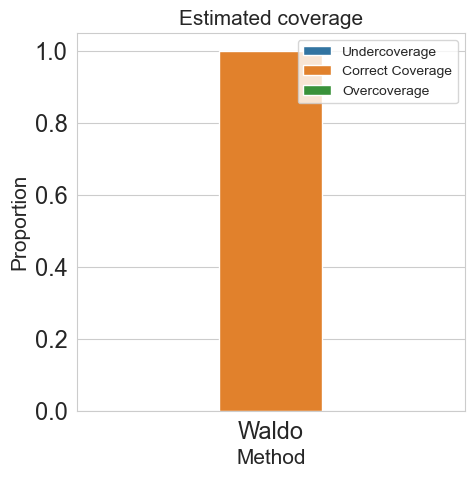

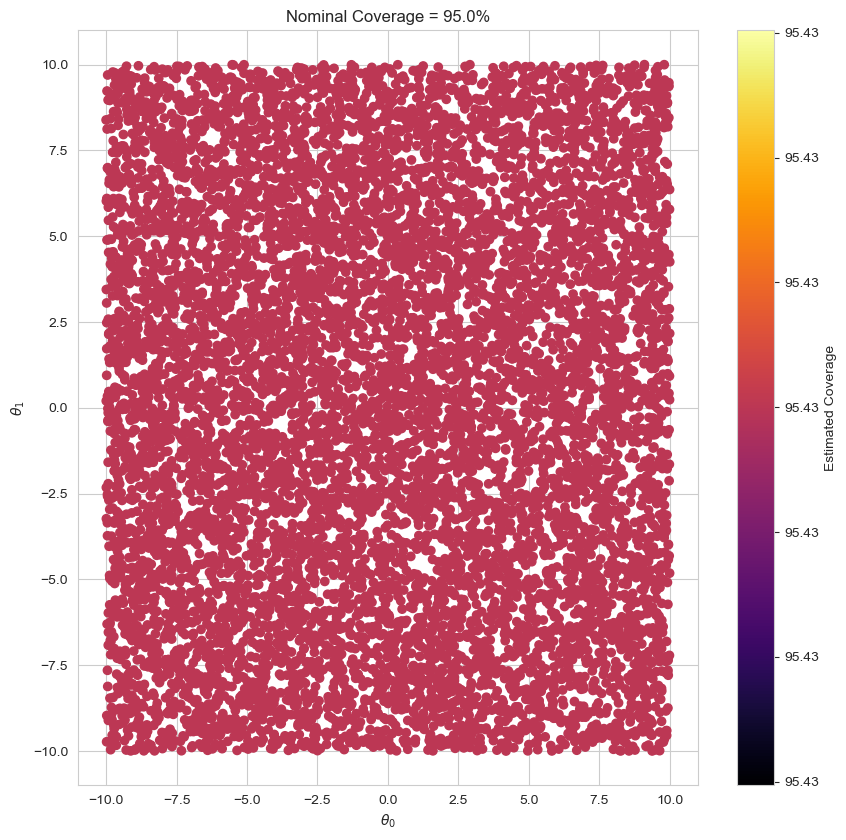

In [214]:
probabilities, upper, lower = coverage_diagnostics_branch(true_parameters=b_double_prime_theta, indicators=indicator, is_azure=False, d=2, c=3)
barplot_diagnostics(probabilities, upper, lower, 0.95, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/diagnostics95_barplot.pdf'))
diagnostics_2D(b_double_prime_theta, probabilities=probabilities, confidence_level=0.95, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/diagnostics95.pdf'))

##### 68.3% 

In [215]:
diagnostics_cutoffs68 = qr_nn68.predict(b_double_prime_theta.numpy())

In [216]:
indicator = np.zeros(shape=(B_DOUBLE_PRIME, ))
indicator[diagnostics_statistics <= diagnostics_cutoffs68.reshape(-1, )] = 1

fitting GAM


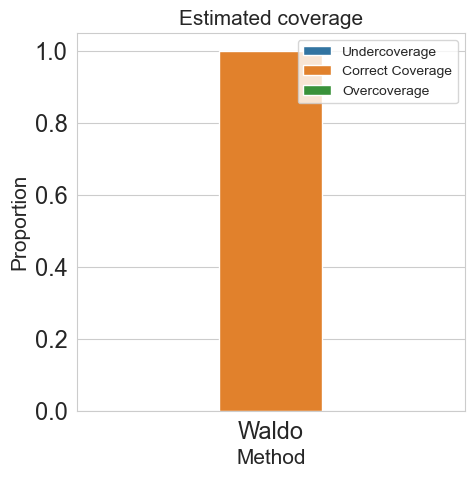

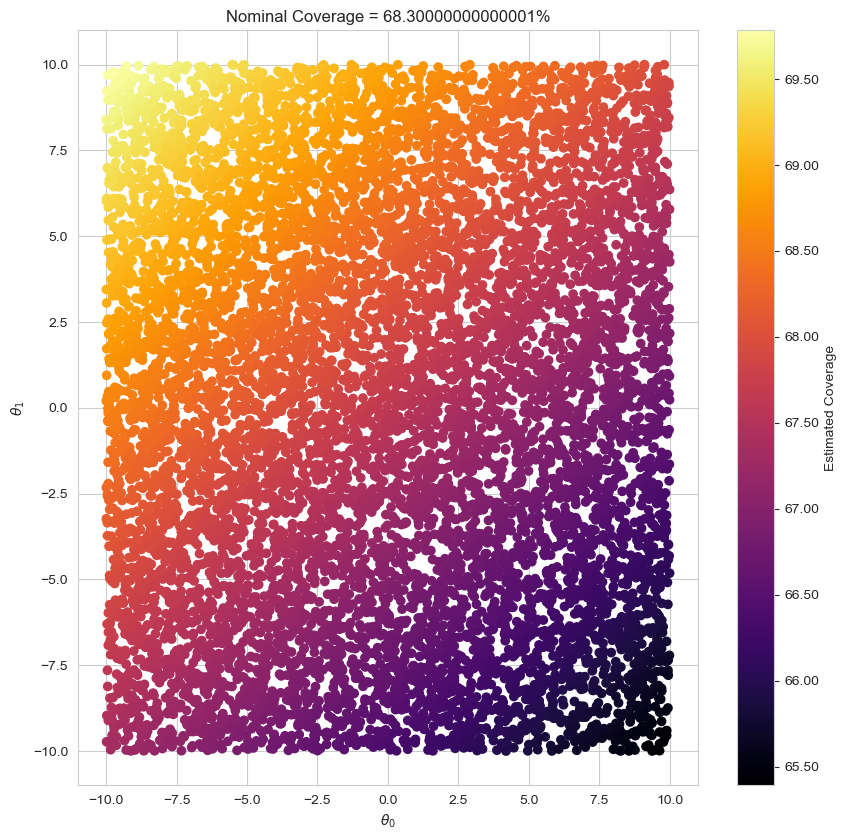

In [217]:
probabilities, upper, lower = coverage_diagnostics_branch(true_parameters=b_double_prime_theta, indicators=indicator, is_azure=False, d=2, c=3)
barplot_diagnostics(probabilities, upper, lower, 0.683, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/diagnostics68_barplot.pdf'))
diagnostics_2D(b_double_prime_theta, probabilities, confidence_level=0.683, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/diagnostics68.pdf'))

### Credible sets

##### 95%

In [218]:
indicator = np.zeros(shape=(B_DOUBLE_PRIME, ))
for i in tqdm(range(B_DOUBLE_PRIME), desc='Computing credible regions for diagnostics for diagnostics...'):
    _, credible_region, _ = hpd_region(posterior=posterior, 
                                       param_grid=np.concatenate((simulator_lf2i.param_grid.astype(np.float32), b_double_prime_theta[i, :].reshape(-1, 2).float().numpy())), 
                                       x=b_double_prime_x[i, :], 
                                       confidence_level=0.95, n_p_stars=10_000, tol=0.01)
    if b_double_prime_theta[i, :].float().numpy() in credible_region:
        indicator[i] = 1
np.sum(indicator)


Computing credible regions for diagnostics for diagnostics...:   0%|                                                                                                                                              | 0/10000 [00:00<?, ?it/s]
Computing credible regions for diagnostics for diagnostics...:   0%|                                                                                                                                      | 1/10000 [00:00<54:16,  3.07it/s]
Computing credible regions for diagnostics for diagnostics...:   0%|                                                                                                                                      | 2/10000 [00:00<53:44,  3.10it/s]
Computing credible regions for diagnostics for diagnostics...:   0%|                                                                                                                                      | 3/10000 [00:00<52:56,  3.15it/s]
Computing credible regions for diagnostics for diag

9300.0

fitting GAM


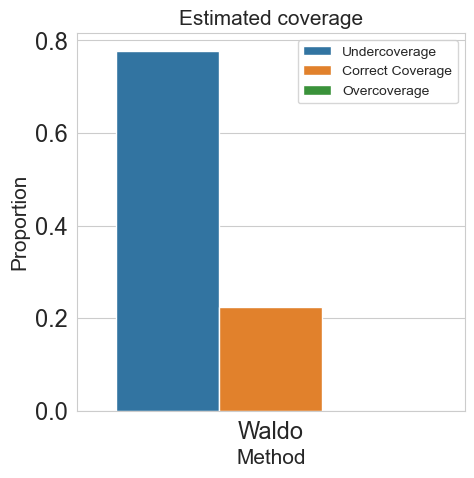

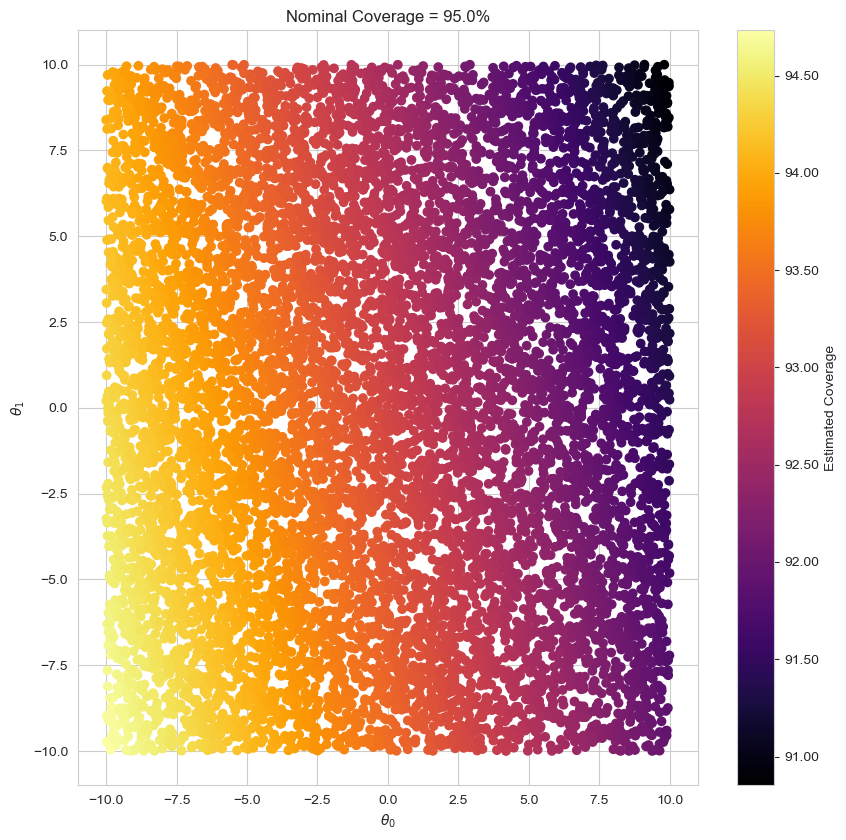

In [219]:
probabilities, upper, lower = coverage_diagnostics_branch(true_parameters=b_double_prime_theta, indicators=indicator, is_azure=False, d=2)
barplot_diagnostics(probabilities, upper, lower, 0.95, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/credible_region_diagnostics95_barplot.pdf'))
diagnostics_2D(b_double_prime_theta, probabilities, confidence_level=0.95, save_fig_path=os.path.join(PATH, 'waldo/results/bayesian_lfi/credible_region_diagnostics95.pdf'))

## Observations

### SBIBM observations

#### Confidence sets

##### 95%

In [20]:
confidence_sets = []
for i in tqdm(range(1, 11), desc='Computing confidence sets'):
    posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=task.get_observation(num_observation=i))
    posterior_mean_obs = torch.mean(posterior_samples_obs, dim=0)
    posterior_var_obs = torch.cov(torch.transpose(posterior_samples_obs, 0, 1))
    confidence_set_i = []
    for j in range(simulator_lf2i.grid_sample_size):
        obs_statistics = torch.matmul(torch.matmul(torch.t(torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(posterior_var_obs)),
                                      torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item()
        if obs_statistics <= predicted_cutoffs_nn[j]:
            confidence_set_i.append(simulator_lf2i.param_grid[j, :].reshape(1, 2))
    confidence_sets.append(np.vstack(confidence_set_i))

Computing confidence sets:   0%|                                                                                                                                                                                    | 0/10 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  10%|█████████████████▏                                                                                                                                                          | 1/10 [00:00<00:04,  1.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  20%|██████████████████████████████████▍                                                                                                                                         | 2/10 [00:01<00:04,  1.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  30%|███████████████████████████████████████████████████▌                                                                                                                        | 3/10 [00:01<00:03,  1.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  40%|████████████████████████████████████████████████████████████████████▊                                                                                                       | 4/10 [00:02<00:03,  1.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  50%|██████████████████████████████████████████████████████████████████████████████████████                                                                                      | 5/10 [00:02<00:02,  1.94it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 6/10 [00:03<00:02,  1.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 7/10 [00:03<00:01,  1.95it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 8/10 [00:04<00:01,  1.96it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 9/10 [00:04<00:00,  1.99it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:05<00:00,  1.97it/s]


###### Inspect test statistic

In [132]:
def stat_obs(num_obs):
    post_s = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=task.get_observation(num_observation=num_obs))
    post_mean_obs = torch.mean(post_s, dim=0)
    post_var_obs = torch.cov(torch.transpose(post_s, 0, 1))
    stat_obs = []
    for j in range(simulator_lf2i.grid_sample_size):
        stat_obs.append(torch.matmul(torch.matmul(torch.t(torch.subtract(post_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(post_var_obs)),
                                      torch.subtract(post_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item())
    return np.array(stat_obs)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

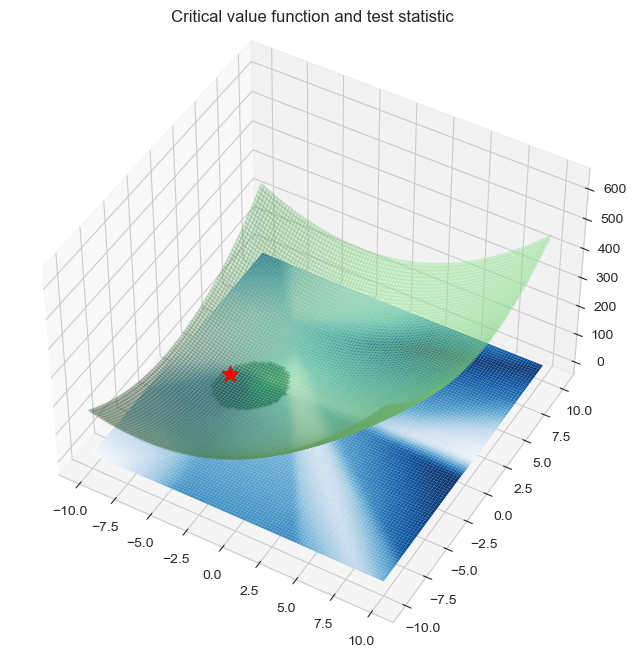

In [135]:
which_obs = 6

mpl.rcParams['figure.dpi'] = 100
X, Y = np.meshgrid(np.linspace(-10, 10, 100), np.linspace(-10, 10, 100))

fig = plt.figure(1, figsize=(12, 8))
ax = plt.axes(projection='3d', computed_zorder=False)

# cutoffs
ax.plot_surface(X, Y, predicted_cutoffs_nn.reshape(X.shape), rstride=1, cstride=1,
                cmap='Blues', edgecolor='none', zorder=1)

# test statistics
facecolors = np.array(['lightgreen']*simulator_lf2i.grid_sample_size)
facecolors[stat_obs(which_obs).reshape(-1, ) <= predicted_cutoffs_nn.reshape(-1,)] = 'green'
ax.plot_surface(X, Y, stat_obs(which_obs).reshape(X.shape), rstride=1, cstride=1,
                facecolors=facecolors.reshape(X.shape), edgecolor='none', alpha=0.2, zorder=2)

# projected confidence set
#cs = simulator_lf2i.param_grid[stat_obs(which_obs).reshape(-1, ) < predicted_cutoffs_xgb.reshape(-1,), :]
#ax.plot_surface(cs[:, 0].reshape(cs[:, 0].shape[0], -1), cs[:, 1].reshape(cs[:, 0].shape[0], -1), np.zeros(shape=(cs[:, 0].shape[0], cs[:, 0].shape[0])), rstride=1, cstride=1,
#                facecolors=np.full(shape=cs_x.shape, fill_value='silver'), edgecolor='none', alpha=0.5, zorder=3)

# true parameter
ax.scatter(task.get_true_parameters(which_obs)[0][0], task.get_true_parameters(which_obs)[0][1], 0, s=150, color='red', marker='*', zorder=4)

# settings
ax.set_title('Critical value function and test statistic')
#ax.set_zlim(0, 10)
ax.view_init(elev=45)#, azim=270)

##### 68.3%

In [136]:
confidence_sets_68 = []
for i in tqdm(range(1, 11), desc='Computing confidence sets'):
    posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=task.get_observation(num_observation=i))
    posterior_mean_obs = torch.mean(posterior_samples_obs, dim=0)
    posterior_var_obs = torch.cov(torch.transpose(posterior_samples_obs, 0, 1))
    confidence_set_i = []
    for j in range(simulator_lf2i.grid_sample_size):
        obs_statistics = torch.matmul(torch.matmul(torch.t(torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(posterior_var_obs)),
                                      torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item()
        if obs_statistics <= predicted_cutoffs_nn68[j]:
            confidence_set_i.append(simulator_lf2i.param_grid[j, :].reshape(1, 2))
    confidence_sets_68.append(np.vstack(confidence_set_i))

Computing confidence sets:   0%|                                                                                                                                                                                     | 0/10 [00:00<?, ?it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  10%|█████████████████▎                                                                                                                                                           | 1/10 [00:00<00:02,  3.57it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  20%|██████████████████████████████████▌                                                                                                                                          | 2/10 [00:00<00:02,  3.75it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  30%|███████████████████████████████████████████████████▉                                                                                                                         | 3/10 [00:00<00:01,  3.79it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  40%|█████████████████████████████████████████████████████████████████████▏                                                                                                       | 4/10 [00:01<00:01,  3.87it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  50%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 5/10 [00:01<00:01,  3.92it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 6/10 [00:01<00:01,  3.95it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 7/10 [00:01<00:00,  3.95it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 8/10 [00:02<00:00,  3.97it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 9/10 [00:02<00:00,  3.98it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Computing confidence sets: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:02<00:00,  3.92it/s]


#### Credible regions

##### 95%

In [22]:
credible_regions = []
actual_confidence_levels = []
for i in tqdm(range(1, 11)):
    current_confidence_level, credible_region, _ = hpd_region(posterior=posterior, 
                                                              prior=None,
                                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                                              x=task.get_observation(num_observation=i), 
                                                              confidence_level=0.95, n_p_stars=100_000, tol=0.01)
    credible_regions.append(credible_region)
    actual_confidence_levels.append(current_confidence_level)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [01:24<00:00,  8.44s/it]


##### 68.3%

In [158]:
credible_regions68 = []
actual_confidence_levels68 = []
for i in range(1, 11):
    current_confidence_level68, credible_region68, _ = hpd_region(posterior=posterior, 
                                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                                              x=task.get_observation(num_observation=i), 
                                                              confidence_level=0.683, n_p_stars=100_000, tol=0.01)
    credible_regions68.append(credible_region68)
    actual_confidence_levels68.append(current_confidence_level68)

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 99444/100000 [00:02<00:00, 45634.30it/s]


#### Plot one

In [91]:
plot_hull = True
plot_points = False
prior_credible_region = True
plot_posterior = False
plot_95 = True
plot_68 = False

which_obs = 8

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
if plot_95:
    which_conf_set = confidence_sets[which_obs-1]
    perimeter_conf_set = ConcaveHull(which_conf_set).calculate()
    which_credible_region = credible_regions[which_obs-1]
    perimeter_credible_region = ConcaveHull(which_credible_region).calculate()
if plot_68:
    which_conf_set68 = confidence_sets_68[which_obs-1]
    perimeter_conf_set68 = ConcaveHull(which_conf_set68).calculate()
    which_credible_region68 = credible_regions68[which_obs-1]
    perimeter_credible_region68 = ConcaveHull(which_credible_region68).calculate()
    
if plot_hull:
    if plot_95:
        perimeter_conf_set = np.vstack((perimeter_conf_set, perimeter_conf_set[0, :].reshape(-1, 2)))
        perimeter_credible_region = np.vstack((perimeter_credible_region, perimeter_credible_region[0, :].reshape(-1, 2)))
        ax.plot(perimeter_conf_set[:, 0], perimeter_conf_set[:, 1], linewidth=5, color='green', label=r"Waldo 95%", zorder=1)#
        plt.fill(perimeter_conf_set[:, 0], perimeter_conf_set[:, 1], color='green', alpha=0.2, zorder=1)
        ax.plot(perimeter_credible_region[:, 0], perimeter_credible_region[:, 1], linestyle='-', linewidth=5, color='blue', zorder=2, label=r"Credible Region 95%")
        plt.fill(perimeter_credible_region[:, 0], perimeter_credible_region[:, 1], color='blue', alpha=0.2, zorder=2)
    if plot_68:
        perimeter_conf_set68 = np.vstack((perimeter_conf_set68, perimeter_conf_set68[0, :].reshape(-1, 2)))
        perimeter_credible_region68 = np.vstack((perimeter_credible_region68, perimeter_credible_region68[0, :].reshape(-1, 2)))
        ax.plot(perimeter_conf_set68[:, 0], perimeter_conf_set68[:, 1], linewidth=4, color='orange', label=r"Waldo 68.3%", zorder=3)
        plt.fill(perimeter_conf_set68[:, 0], perimeter_conf_set68[:, 1], color='orange', alpha=0.2, zorder=3)
        ax.plot(perimeter_credible_region68[:, 0], perimeter_credible_region68[:, 1], linewidth=4, color='pink', label=r"Credible Region 68.3%", zorder=4)
        plt.fill(perimeter_credible_region68[:, 0], perimeter_credible_region68[:, 1], color='pink', alpha=0.2, zorder=4)

if plot_points:
    if plot_95:
        ax.scatter(x=which_conf_set.T[0], y=which_conf_set.T[1], s=3.5, c="green", zorder=1)#, label=r"Waldo 95% confidence set")
        ax.scatter(x=which_credible_region[:, 0], y=which_credible_region[:, 1], s=3.5, c="blue", zorder=2)#, label=r"95% credible region",)
    if plot_68:
        ax.scatter(x=which_conf_set68.T[0], y=which_conf_set68.T[1], s=3.5, c="orange", zorder=3)#, label=r"Waldo 68.3% confidence set")
        ax.scatter(x=which_credible_region68[:, 0], y=which_credible_region68[:, 1], s=3.5, c="pink", zorder=4)#, label=r"68.3% credible region")
        
if prior_credible_region:
    _, prior_credible_region, _ = hpd_region(prior=task.prior_dist, 
                                             posterior=None,
                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                              x=task.get_observation(num_observation=which_obs), 
                                              confidence_level=0.95, n_p_stars=100_000, tol=0.01)
    prior_credible_region = Polygon(prior_credible_region[ConvexHull(prior_credible_region).vertices,:], 
                                    fc=to_rgba("grey", 0.2), ec=to_rgba('grey', 1), lw=4, label=r"Prior Credible Region 95%", zorder=0, linestyle=':')
    ax.add_artist(prior_credible_region)

ax.scatter(x=task.get_true_parameters(num_observation=which_obs)[0][0], 
                     y=task.get_true_parameters(num_observation=which_obs)[0][1], alpha=1, 
                     c="red", marker="*", s=1000, label=r"True $\mathbf{\theta}^*$", zorder=5)#=$[{:.2f}, {:.2f}]".format(*task.get_true_parameters(num_observation=which_obs).reshape(-1, ).tolist()), zorder=5)
#ax.scatter(x=task.get_observation(num_observation=which_obs)[0][0], 
#                     y=task.get_observation(num_observation=which_obs)[0][1], alpha=1, 
#                     c="black", marker="x", s=500, label=r"$\mathbf{{x}}_o=$[{:.2f}, {:.2f}]".format(*task.get_observation(num_observation=which_obs).reshape(-1, ).tolist()), zorder=5)


ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_xlabel(r"$\theta_{{(1)}}$", fontsize=45)
# ax.set_ylabel(r"$\theta_{{(2)}}$", fontsize=45, rotation=0)
ax.tick_params(axis='both', which='major', labelsize=30, bottom=True, left=True, labelleft=True, labelbottom=False)
legend = ax.legend(loc=(0.255, 0.01), prop={'size': 40})
legend.get_frame().set_edgecolor('black')
ax.set_title('Prior: $U([-10, 10]^2)$', fontsize=45, pad=8)#N(0, 2)
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(3)
    ax.spines[axis].set_color('black')
which_obs += 1
        
mpl.rcParams['figure.dpi'] = 600
# plt.savefig(os.path.join(PATH, f'waldo/results/bayesian_lfi/confidence_credible_sets_unifPrior_nobs{which_obs-1}_LATEST.pdf'), bbox_inches='tight')
plt.show()
#mpl.rcParams['figure.dpi'] = 100

#### Plot all

In [16]:
plot_hull = False
plot_points = True
plot_posterior = False
plot_95 = True
plot_68 = False

fig, ax = plt.subplots(5, 2, figsize=(20, 50))
which_obs = 1
for row in range(5):
    for col in range(2):

        which_conf_set = confidence_sets[which_obs-1]
        #which_conf_set68 = confidence_sets_68[which_obs-1]
        which_credible_region = credible_regions[which_obs-1]
       # which_credible_region68 = credible_regions68[which_obs-1]

        ######## PLOT
        if plot_hull:
            # convex hulls
            if plot_95:
                waldo_region = Polygon(which_conf_set[ConvexHull(which_conf_set).vertices,:], 
                                       fc=to_rgba("green", 0.2), ec=to_rgba('green', 1), lw=2, label=r"Waldo 95% confidence set", zorder=2)
                credible_set = Polygon(which_credible_region[ConvexHull(which_credible_region).vertices,:], 
                                        fc=to_rgba("green", 0.2), ec=to_rgba('blue', 1), lw=2, label=r"95% Credible region", zorder=2)
                ax[row][col].add_artist(credible_set)
                ax[row][col].add_artist(waldo_region)
            if plot_68:
                waldo_region68 = Polygon(which_conf_set68[ConvexHull(which_conf_set68).vertices,:], 
                                       fc=to_rgba("orange", 0.2), ec=to_rgba('orange', 1), lw=2, label=r"Waldo 68.3% confidence set", zorder=2)
                #credible_set68 = Polygon(which_credible_region68[ConvexHull(which_credible_region68).vertices,:], 
                #                        fc=to_rgba("green", 0.2), ec=to_rgba('pink', 1), lw=2, label=r"68.3% Credible region", zorder=2)
            
                #ax[row][col].add_artist(credible_set68)
                ax[row][col].add_artist(waldo_region68)

        if plot_points:
            # points
            if plot_95:
                ax[row][col].scatter(x=which_conf_set.T[0], y=which_conf_set.T[1], s=3.5, c="green", label=r"Waldo 95% confidence set", zorder=2)
                ax[row][col].scatter(x=which_credible_region[:, 0], y=which_credible_region[:, 1], s=3.5, c="blue", label=r"95% credible region", zorder=2)
            if plot_68:
                #ax[row][col].scatter(x=which_conf_set68.T[0], y=which_conf_set68.T[1], s=3.5, c="orange", label=r"Waldo 68.3% confidence set", zorder=2)
                ax[row][col].scatter(x=which_credible_region68[:, 0], y=which_credible_region68[:, 1], s=3.5, c="pink", label=r"68.3% credible region", zorder=2)

        ax[row][col].scatter(x=task.get_true_parameters(num_observation=which_obs)[0][0], y=task.get_true_parameters(num_observation=which_obs)[0][1], alpha=1, 
                   c="red", marker="*", s=150, label=r"True $\theta$", zorder=3)


        if plot_posterior:
            which_posterior_samples = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=task.get_observation(num_observation=which_obs))
            #ax[row][col].hist2d(x=which_posterior_samples[:, 0].numpy(), y=which_posterior_samples[:, 1].numpy(), label='Estimated Posterior')
            sns.histplot(data=np_to_pd(which_posterior_samples, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', label='Estimated Posterior', 
                         ax=ax[row][col], stat='density', zorder=1, alpha=1)
            # TRUE
            #true_post_samples = task.get_reference_posterior_samples(num_observation=which_obs)

            #sns.histplot(data=np_to_pd(true_post_samples, ['theta_0', 'theta_1']), x='theta_0', y='theta_1', label='True Posterior', 
            #             ax=ax[row][col], zorder=1, alpha=1)
            #ax[row][col].scatter(x=which_posterior_samples[:, 0].numpy(), y=which_posterior_samples[:, 1].numpy(), label='Posterior Samples', zorder=1, alpha=0.5, s=10)


        # settings
        axis_lim = 2
        #ax.set_xlim(task.get_true_parameters(num_observation=which_obs)[0][0]-axis_lim, task.get_true_parameters(num_observation=which_obs)[0][0]+axis_lim)
        #ax.set_ylim(task.get_true_parameters(num_observation=which_obs)[0][1]-axis_lim, task.get_true_parameters(num_observation=which_obs)[0][1]+axis_lim)
        ax[row][col].set_xlim(-10, 10)
        ax[row][col].set_ylim(-10, 10)
        ax[row][col].set_xlabel(r"$\theta_0$", fontsize=15)
        ax[row][col].set_ylabel(r"$\theta_1$", fontsize=15, rotation=0)
        ax[row][col].legend()
        title1 = r"$\theta^*=$[{:.2f}, {:.2f}]".format(*task.get_true_parameters(num_observation=which_obs).reshape(-1, ).tolist())
        title2 = r"$x_o=$[{:.2f}, {:.2f}]".format(*task.get_observation(num_observation=which_obs).reshape(-1, ).tolist())
        ax[row][col].set_title(title1+', '+title2)
        which_obs += 1
        
mpl.rcParams['figure.dpi'] = 600
#plt.savefig(os.path.join(PATH, 'waldo/results/bayesian_lfi/confidence_sets68_corrected_QRnn.png'), bbox_inches='tight')
plt.show()
#mpl.rcParams['figure.dpi'] = 100

### When $\theta^* = [0, 0]$

In [29]:
new_observations = simulate_in_batches(simulator=simulator, theta=torch.Tensor([[0, 0]]).repeat_interleave(10, dim=0)).numpy()
new_observations.shape

Running 10 simulations.:   0%|          | 0/10 [00:00<?, ?it/s]

(10, 2)

In [30]:
new_observations = np.vstack((gauss_zero_obs.reshape(-1, 2), new_observations))
new_observations.shape

(11, 2)

In [31]:
new_observations

array([[ 0.10365822, -0.05019126],
       [-0.0192858 ,  0.11586642],
       [ 0.17292364, -0.05405305],
       [-0.08443923,  0.03946874],
       [ 0.09389778, -0.07467528],
       [ 0.02102564,  0.15617944],
       [ 0.90783894, -1.6399221 ],
       [-0.01157835, -0.03367838],
       [ 0.0583276 , -0.02505355],
       [ 0.02249168,  0.08378477],
       [ 0.115062  , -0.03512498]], dtype=float32)

#### Confidence sets

##### 95%

In [33]:
confidence_sets_new = []
for i in tqdm(range(0, 11), desc='Computing confidence sets'):
    posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=new_observations[i, :])
    posterior_mean_obs = torch.mean(posterior_samples_obs, dim=0)
    posterior_var_obs = torch.cov(torch.transpose(posterior_samples_obs, 0, 1))
    confidence_set_i = []
    for j in range(simulator_lf2i.grid_sample_size):
        obs_statistics = torch.matmul(torch.matmul(torch.t(torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(posterior_var_obs)),
                                      torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item()
        if obs_statistics <= predicted_cutoffs_nn[j]:
            confidence_set_i.append(simulator_lf2i.param_grid[j, :].reshape(1, 2))
    confidence_sets_new.append(np.vstack(confidence_set_i))

Computing confidence sets:   0%|                                                                                                                                                                                    | 0/11 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:   9%|███████████████▋                                                                                                                                                            | 1/11 [00:00<00:04,  2.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  18%|███████████████████████████████▎                                                                                                                                            | 2/11 [00:00<00:04,  2.13it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  27%|██████████████████████████████████████████████▉                                                                                                                             | 3/11 [00:01<00:03,  2.14it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  36%|██████████████████████████████████████████████████████████████▌                                                                                                             | 4/11 [00:01<00:03,  2.11it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  45%|██████████████████████████████████████████████████████████████████████████████▏                                                                                             | 5/11 [00:02<00:02,  2.09it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  55%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 6/11 [00:02<00:02,  2.08it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 7/11 [00:03<00:01,  2.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 8/11 [00:03<00:01,  2.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 9/11 [00:04<00:00,  2.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 10/11 [00:04<00:00,  2.07it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:05<00:00,  2.08it/s]


###### Inspect test statistic

In [132]:
def stat_obs(num_obs):
    post_s = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=task.get_observation(num_observation=num_obs))
    post_mean_obs = torch.mean(post_s, dim=0)
    post_var_obs = torch.cov(torch.transpose(post_s, 0, 1))
    stat_obs = []
    for j in range(simulator_lf2i.grid_sample_size):
        stat_obs.append(torch.matmul(torch.matmul(torch.t(torch.subtract(post_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(post_var_obs)),
                                      torch.subtract(post_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item())
    return np.array(stat_obs)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

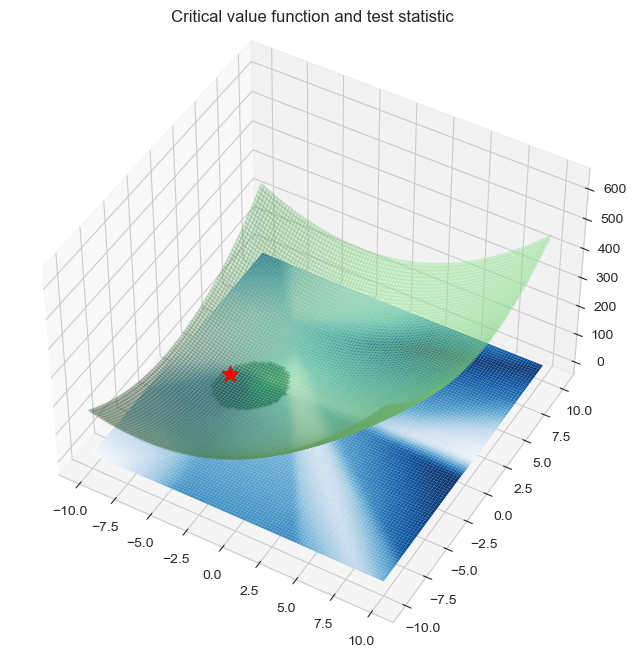

In [135]:
which_obs = 6

mpl.rcParams['figure.dpi'] = 100
X, Y = np.meshgrid(np.linspace(-10, 10, 100), np.linspace(-10, 10, 100))

fig = plt.figure(1, figsize=(12, 8))
ax = plt.axes(projection='3d', computed_zorder=False)

# cutoffs
ax.plot_surface(X, Y, predicted_cutoffs_nn.reshape(X.shape), rstride=1, cstride=1,
                cmap='Blues', edgecolor='none', zorder=1)

# test statistics
facecolors = np.array(['lightgreen']*simulator_lf2i.grid_sample_size)
facecolors[stat_obs(which_obs).reshape(-1, ) <= predicted_cutoffs_nn.reshape(-1,)] = 'green'
ax.plot_surface(X, Y, stat_obs(which_obs).reshape(X.shape), rstride=1, cstride=1,
                facecolors=facecolors.reshape(X.shape), edgecolor='none', alpha=0.2, zorder=2)

# projected confidence set
#cs = simulator_lf2i.param_grid[stat_obs(which_obs).reshape(-1, ) < predicted_cutoffs_xgb.reshape(-1,), :]
#ax.plot_surface(cs[:, 0].reshape(cs[:, 0].shape[0], -1), cs[:, 1].reshape(cs[:, 0].shape[0], -1), np.zeros(shape=(cs[:, 0].shape[0], cs[:, 0].shape[0])), rstride=1, cstride=1,
#                facecolors=np.full(shape=cs_x.shape, fill_value='silver'), edgecolor='none', alpha=0.5, zorder=3)

# true parameter
ax.scatter(task.get_true_parameters(which_obs)[0][0], task.get_true_parameters(which_obs)[0][1], 0, s=150, color='red', marker='*', zorder=4)

# settings
ax.set_title('Critical value function and test statistic')
#ax.set_zlim(0, 10)
ax.view_init(elev=45)#, azim=270)

##### 68.3%

In [86]:
confidence_sets_68_new = []
for i in tqdm(range(0, 10), desc='Computing confidence sets'):
    posterior_samples_obs = posterior.sample(sample_shape=(N_SAMPLES_POSTERIOR,), x=new_observations[i, :])
    posterior_mean_obs = torch.mean(posterior_samples_obs, dim=0)
    posterior_var_obs = torch.cov(torch.transpose(posterior_samples_obs, 0, 1))
    confidence_set_i = []
    for j in range(simulator_lf2i.grid_sample_size):
        obs_statistics = torch.matmul(torch.matmul(torch.t(torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))),
                                                   torch.linalg.inv(posterior_var_obs)),
                                      torch.subtract(posterior_mean_obs.reshape(-1, 1), torch.from_numpy(simulator_lf2i.param_grid[j, :]).float().reshape(-1, 1))).item()
        if obs_statistics <= predicted_cutoffs_nn68[j]:
            confidence_set_i.append(simulator_lf2i.param_grid[j, :].reshape(1, 2))
    confidence_sets_68_new.append(np.vstack(confidence_set_i))

Computing confidence sets:   0%|                                                                                                                                    | 0/10 [00:00<?, ?it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  10%|████████████▍                                                                                                               | 1/10 [00:00<00:04,  2.22it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  20%|████████████████████████▊                                                                                                   | 2/10 [00:00<00:03,  2.20it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  30%|█████████████████████████████████████▏                                                                                      | 3/10 [00:01<00:03,  2.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  40%|█████████████████████████████████████████████████▌                                                                          | 4/10 [00:01<00:02,  2.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  50%|██████████████████████████████████████████████████████████████                                                              | 5/10 [00:02<00:02,  2.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  60%|██████████████████████████████████████████████████████████████████████████▍                                                 | 6/10 [00:02<00:01,  2.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 7/10 [00:03<00:01,  2.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 8/10 [00:03<00:00,  2.23it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 9/10 [00:04<00:00,  2.24it/s]

Drawing 50000 posterior samples:   0%|          | 0/50000 [00:00<?, ?it/s]

Computing confidence sets: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:04<00:00,  2.24it/s]


#### Credible regions

##### 95%

In [66]:
credible_regions_new = []
actual_confidence_levels = []
for i in tqdm(range(0, 11)):
    current_confidence_level, credible_region, _ = hpd_region(posterior=posterior, 
                                                              prior=None,
                                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                                              x=new_observations[i, :], 
                                                              confidence_level=0.955, n_p_stars=100_000, tol=0.01)
    credible_regions_new.append(credible_region)
    actual_confidence_levels.append(current_confidence_level)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:49<00:00,  4.54s/it]


##### 68.3%

In [36]:
credible_regions68_new = []
actual_confidence_levels68 = []
for i in tqdm(range(0, 10)):
    current_confidence_level68, credible_region68, _ = hpd_region(posterior=posterior, 
                                                              param_grid=simulator_lf2i.param_grid.astype(np.float32), 
                                                              x=new_observations[i, :], 
                                                              confidence_level=0.683, n_p_stars=100_000, tol=0.01)
    credible_regions68_new.append(credible_region68)
    actual_confidence_levels68.append(current_confidence_level68)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:25<00:00,  2.56s/it]


#### Plot one

In [28]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/true_zero_credibleConfidence_forComparison.pickle'), 'rb') as f:
    gauss_zero_waldo, gauss_zero_credible = pickle.load(f)
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/true_zero_obs_forComparison.pickle'), 'rb') as f:
    gauss_zero_obs = pickle.load(f)

In [86]:
plot_hull = True
plot_points = False
plot_posterior = False
plot_95 = True
plot_68 = False

which_obs = 1

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
if plot_95:
    which_conf_set = confidence_sets_new[which_obs-1]
    perimeter_conf_set = ConcaveHull(which_conf_set).calculate()
    which_credible_region = credible_regions_new[which_obs-1]
    perimeter_credible_region = ConcaveHull(which_credible_region).calculate()
if plot_68:
    which_conf_set68 = confidence_sets_68[which_obs-1]
    perimeter_conf_set68 = ConcaveHull(which_conf_set68).calculate()
    which_credible_region68 = credible_regions68[which_obs-1]
    perimeter_credible_region68 = ConcaveHull(which_credible_region68).calculate()
    
    
waldo_region_gauss = Polygon(gauss_zero_waldo[ConvexHull(gauss_zero_waldo).vertices,:], label=r"Waldo 95% (Gaussian)",
                                     fc=to_rgba("crimson", 0.2), ec=to_rgba('crimson', 1), linestyle='--', lw=5, zorder=4)
ax.add_artist(waldo_region_gauss)
ax.plot(gauss_zero_credible[:, 0], gauss_zero_credible[:, 1], linestyle='--', linewidth=5, color='orange', zorder=3, label=r"Credible Region 95% (Gaussian)")
plt.fill(gauss_zero_credible[:, 0], gauss_zero_credible[:, 1], color='orange', alpha=0.2, zorder=3)
    
if plot_hull:
    if plot_95:
        perimeter_conf_set = np.vstack((perimeter_conf_set, perimeter_conf_set[0, :].reshape(-1, 2)))
        perimeter_credible_region = np.vstack((perimeter_credible_region, perimeter_credible_region[0, :].reshape(-1, 2)))
        ax.plot(perimeter_conf_set[:, 0], perimeter_conf_set[:, 1], linewidth=4, color='green', zorder=2, label=r"Waldo 95% (Uniform)")#label=r"Waldo 95%", 
        plt.fill(perimeter_conf_set[:, 0], perimeter_conf_set[:, 1], color='green', alpha=0.2, zorder=2)
        #waldo_region = Polygon(which_conf_set[ConvexHull(which_conf_set).vertices,:], 
                                       #fc=to_rgba("green", 0.2), ec=to_rgba('green', 1), lw=5, zorder=1)
        #ax.add_artist(waldo_region)
        #credible_region = Polygon(which_credible_region[ConvexHull(which_credible_region).vertices,:], 
                                       #fc=to_rgba("blue", 0.2), ec=to_rgba('blue', 1), linestyle='--', lw=5, zorder=2)
        #ax.add_artist(credible_region)
        ax.plot(perimeter_credible_region[:, 0], perimeter_credible_region[:, 1], linewidth=5, color='blue', zorder=1, label=r"Credible Region 95% (Uniform)", )#
        plt.fill(perimeter_credible_region[:, 0], perimeter_credible_region[:, 1], color='blue', alpha=0.2, zorder=1)
        
    if plot_68:
        perimeter_conf_set68 = np.vstack((perimeter_conf_set68, perimeter_conf_set68[0, :].reshape(-1, 2)))
        perimeter_credible_region68 = np.vstack((perimeter_credible_region68, perimeter_credible_region68[0, :].reshape(-1, 2)))
        ax.plot(perimeter_conf_set68[:, 0], perimeter_conf_set68[:, 1], linewidth=4, color='orange', label=r"Waldo 68.3%", zorder=3)
        plt.fill(perimeter_conf_set68[:, 0], perimeter_conf_set68[:, 1], color='orange', alpha=0.2, zorder=3)
        ax.plot(perimeter_credible_region68[:, 0], perimeter_credible_region68[:, 1], linewidth=4, color='pink', label=r"Credible Region 68.3%", zorder=4)
        plt.fill(perimeter_credible_region68[:, 0], perimeter_credible_region68[:, 1], color='pink', alpha=0.2, zorder=4)

if plot_points:
    if plot_95:
        #ax.scatter(x=which_conf_set.T[0], y=which_conf_set.T[1], s=3.5, c="green", zorder=1)#, label=r"Waldo 95% confidence set")
        ax.scatter(x=which_credible_region[:, 0], y=which_credible_region[:, 1], s=3.5, c="blue", zorder=2)#, label=r"95% credible region",)
    if plot_68:
        ax.scatter(x=which_conf_set68.T[0], y=which_conf_set68.T[1], s=3.5, c="orange", zorder=3)#, label=r"Waldo 68.3% confidence set")
        ax.scatter(x=which_credible_region68[:, 0], y=which_credible_region68[:, 1], s=3.5, c="pink", zorder=4)#, label=r"68.3% credible region")

ax.scatter(x=0, y=0, alpha=1, c="red", marker="*", s=1000, zorder=5)#, label=r"True $\theta^*=$[{:.2f}, {:.2f}]".format(*[0, 0]))
#ax.scatter(x=original_task.get_observation(num_observation=which_obs)[0][0], 
#                     y=original_task.get_observation(num_observation=which_obs)[0][1], alpha=1, 
#                     c="black", marker="x", s=500, label=r"$\mathbf{{x}}_o=$[{:.2f}, {:.2f}]".format(*original_task.get_observation(num_observation=which_obs).reshape(-1, ).tolist()), zorder=5)

ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_xlabel(r"$\theta_{{(1)}}$", fontsize=45)
ax.set_ylabel(r"$\theta_{{(2)}}$", fontsize=45, rotation=0)
ax.tick_params(axis='both', which='major', labelsize=30, bottom=True, left=True, labelleft=True, labelbottom=True)
legend = ax.legend(prop={'size': 40})
legend.get_frame().set_edgecolor('black')
ax.set_title(r'Prior: $N(\mathbf{0}, 2\mathbf{I})$ and $U([-10, 10]^2)$', fontsize=45, pad=8)#U(-10, 10)
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(3)
    ax.spines[axis].set_color('black')
which_obs += 1
        
mpl.rcParams['figure.dpi'] = 600
plt.savefig(os.path.join(PATH, f'waldo/results/bayesian_lfi/confidence_credible_sets_true0gauss&Unif_LATEST.pdf'), bbox_inches='tight')
plt.show()
#mpl.rcParams['figure.dpi'] = 100

## Save Results

In [274]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/gaussian_mixture.pickle'), 'wb') as f:
    pickle.dump({'b_prime_sample': (b_prime_theta, b_prime_x), 'b_double_prime_sample': (b_double_prime_theta, b_double_prime_x), 
                 'task': task, 'npe': posterior, 'qr_statistics_cutoffs_QR': (qr_statistics, predicted_cutoffs_xgb, qr_XGB),
                 'diagnostics_statistics_cutoffs': (diagnostics_statistics, diagnostics_cutoffs), 'confidence_sets': confidence_sets}, f)

## Load Results

In [8]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/gaussian_mixture.pickle'), 'rb') as f:
    saved_results = pickle.load(f)

In [5]:
with open(os.path.join(PATH, 'waldo/results/bayesian_lfi/gaussian_mixture_nosbibm.pickle'), 'rb') as f:
    saved_results = pickle.load(f)

In [9]:
task = saved_results['task']
posterior = saved_results['npe']
b_prime_theta, b_prime_x = saved_results['b_prime_sample']
b_double_prime_theta, b_double_prime_x = saved_results['b_double_prime_sample']
diagnostics_statistics, diagnostics_cutoffs = saved_results['diagnostics_statistics_cutoffs']
qr_statistics, predicted_cutoffs_xgb, qr_XGB = saved_results['qr_statistics_cutoffs_QR']
confidence_sets = saved_results['confidence_sets']